In [1]:
import tensorflow as tf
import numpy as np
import importlib
from train import provider

/opt/conda/lib/python2.7/site-packages/h5py/__init__.py:36: FutureWarning: Conversion of the second argument of issubdtype from `float` to `np.floating` is deprecated. In future, it will be treated as `np.float64 == np.dtype(float).type`.
  from ._conv import register_converters as _register_converters


In [2]:
import cPickle as cPickle
def demo(fname):
    #import mayavi.mlab as mlab
    #from viz_util import draw_lidar, draw_lidar_simple, draw_gt_boxes3d
    with open(fname, 'rb') as input_file:
        try:
            while True:
                yield cPickle.load(input_file)
        except EOFError:
            pass

In [3]:
h = list(demo("./kitti/frustum_carpedcyc_train.pickle"))

In [4]:
val = list(demo("./kitti/frustum_carpedcyc_val.pickle"))

In [5]:
NUM_POINT=2048
TRAIN_DATASET = provider.FrustumDataset(npoints=NUM_POINT, split='train',\
                            rotate_to_center=True, random_flip=False, random_shift=True, one_hot=True)

In [6]:
VAL_DATASET = provider.FrustumDataset(npoints=NUM_POINT, split='val',\
                            rotate_to_center=True, random_flip=False, random_shift=True, one_hot=True)

In [18]:

def indices(num, window_len, stride_len, key='train'):
    IOU = []
    start = []
    end = []
    labels = []
    point_set = []
    if key=='train':
        ind = np.argsort(TRAIN_DATASET.get_center_view_point_set(num)[:,2])
        point_set = (TRAIN_DATASET.get_center_view_point_set(num)[ind])[:,:3]
        labels = h[4][num]
        labels = labels[ind]
    elif key=='val':
        ind = np.argsort(VAL_DATASET.get_center_view_point_set(num)[:,2])
        point_set = (VAL_DATASET.get_center_view_point_set(num)[ind])[:,:3]
        labels = val[4][num]
        labels = labels[ind]
    j = np.min(point_set,0)[2]
    i = np.min(point_set,0)[2]+window_len
    idtuple=set()
    while i<=np.max(point_set,0)[2]:
            max_ind = np.searchsorted(point_set[:,2], i)
            min_ind = np.searchsorted(point_set[:,2], j)
            if (min_ind,max_ind) not in idtuple and max_ind-min_ind>5:
                #print('fgbd')
                idtuple.add((min_ind,max_ind))
                labels_window = np.zeros_like(point_set[:,0])
                labels_window[min_ind:max_ind] = 1.0
                union = np.sum(np.logical_or(labels, labels_window))
                inter = np.sum(np.logical_and(labels, labels_window))
                if (inter*1.0/union) < 0.3 or (inter*1.0/union) >0.7 :
                    end.append(max_ind)
                    start.append(min_ind)
                    IOU.append(inter*1.0/union)
            j = j+stride_len
            i = j+window_len
    IOU = np.array(IOU)>0.7
    return np.array(start),np.array(end), IOU

a,b,c = indices(0,1.0,0.1)
a.shape,b.shape,c.shape

((74,), (74,), (74,))

In [19]:
# points in each window:2048
# number of windows
#

def get_list(start_idx,end_idx,num_points=1024,ensure_all=True):
    """
    param:
    start_idx  : list of indexes of the starting point in each window
    end_idx    : list of indees of ending point in each window
    NOTES: we used two lists because we ran into issues with tensorflow when we used tuples,
           this is a quick hack to avoid that
    num_points : number of points to be sampled from i.e number of points in each window
    ensure_all : in the case that there are fewwer than required points ensures all points are picked atleast once if selected as True
    
    
    returns:
    out:  an array of size 
          
          num_windowsxnum_pointsx1
          
          this will be used inside tensorflow to divide into windows 
          after we pass the points trough pointnet
    """
    
    out= []
    for i in range(np.shape(start_idx)[0]):
        
        if end_idx[i]-start_idx[i]+1<num_points:
            indexes=np.arange(start_idx[i],end_idx[i]+1)
            indexes2=np.random.choice(indexes, num_points-np.shape(indexes)[0],replace=True)
            indexes=np.concatenate((indexes,indexes2))
        else:
            indexes=np.random.choice(np.arange(start_idx[i],end_idx[i]+1),num_points,replace=False)
        out.append(np.reshape(indexes,(-1,1)))
    
    return np.array(out)


In [20]:
#check
s,e,l=indices(0, 1.0, 0.1)

s1, e1, l1 = indices(0, 3.0, 0.3)

ind= get_list(s,e, num_points=512)

ind1 = get_list(s1,e1, num_points=1024)

In [21]:
print(ind.shape)
print(ind1.shape)

(74, 512, 1)
(31, 1024, 1)


In [22]:
import tf_util #for conv2d
from model_util import NUM_HEADING_BIN, NUM_SIZE_CLUSTER, NUM_OBJECT_POINT
from model_util import point_cloud_masking, get_center_regression_net
from model_util import placeholder_inputs, parse_output_to_tensors, get_loss


In [23]:
#def focal_loss(prediction,target,gamma,alpha):
    
    
    

In [24]:
# https://github.com/ailias/Focal-Loss-implement-on-Tensorflow/blob/master/focal_loss.py


from tensorflow.python.ops import array_ops

def focal_loss(sigmoid_p, target_tensor, weights=None, alpha=0.99, gamma=2):
    r"""Compute focal loss for predictions.
        Multi-labels Focal loss formula:
            FL = -alpha * (z-p)^gamma * log(p) -(1-alpha) * p^gamma * log
            (1-p)
                 ,which alpha = 0.25, gamma = 2, p = sigmoid(x), z = target_tensor.
    Args:
     prediction_tensor: A float tensor of shape [batch_size, num_anchors,
        num_classes] representing the predicted logits for each class
     target_tensor: A float tensor of shape [batch_size, num_anchors,
        num_classes] representing one-hot encoded classification targets
     weights: A float tensor of shape [batch_size, num_anchors]
     alpha: A scalar tensor for focal loss alpha hyper-parameter
     gamma: A scalar tensor for focal loss gamma hyper-parameter
    Returns:
        loss: A (scalar) tensor representing the value of the loss function
    """
    #sigmoid_p = tf.nn.sigmoid(prediction_tensor)
    zeros = array_ops.zeros_like(target_tensor, dtype=target_tensor.dtype)
    
    # For poitive prediction, only need consider front part loss, back part is 0;
    # target_tensor > zeros <=> z=1, so poitive coefficient = z - p.
    pos_p_sub = array_ops.where(target_tensor > zeros, target_tensor - sigmoid_p, zeros)
    
    # For negative prediction, only need consider back part loss, front part is 0;
    # target_tensor > zeros <=> z=1, so negative coefficient = 0.
    neg_p_sub = array_ops.where(target_tensor > zeros, zeros, sigmoid_p)
    per_entry_cross_ent = - alpha * (pos_p_sub ** gamma) * tf.log(tf.clip_by_value(sigmoid_p, 1e-8, 1.0)) \
                          - (1.0 - alpha) * (neg_p_sub ** gamma) * tf.log(tf.clip_by_value(1.0 - sigmoid_p, 1e-8, 1.0))
    return tf.reduce_sum(per_entry_cross_ent)

In [25]:
# def classification_net(point_cloud, label_out_5, label_out_1, label_out_2, label_out_3, label_out_4, idx5, idx1, idx2, idx3, idx4, 
#                             is_training=True, bn_decay=True):
def classification_net(point_cloud, label_out_5,  idx5, 
                            is_training=True, bn_decay=True):
    '''
    3D PointNet network.
    param:
    
    point_cloud: TF tensor in shape (1,N,4)
                 frustum point clouds with XYZ and intensity in point channels
                 XYZs are in frustum coordinate
    label_out: TF tensor in shape (1,1)
            length-1 vector indicating the classification as car or background
    
    ??????????????????????????????????????????????????????????????????????????????????????
    
    is_training: TF boolean scalar
    bn_decay: TF float scalar
    end_points: dict                 SHOULD CHANGE THIS
    Output:                                         
    logits: TF tensor in shape (B,N,2), scores for bkg/clutter and object
    end_points: dict
    ??????????????????????????????????????????????????????????????????????????????????????
    '''
    
    batch_size = point_cloud.get_shape()[0].value #1 in our case
    num_point = point_cloud.get_shape()[1].value  #N in our case
  
    net = tf.expand_dims(point_cloud, 2)
    #print(net.get_shape())

    net = tf_util.conv2d(net, 64, [1,1],
                         padding='VALID', stride=[1,1],
                         bn=True, is_training=is_training,
                         scope='conv1', bn_decay=bn_decay)
    net = tf_util.conv2d(net, 64, [1,1],
                         padding='VALID', stride=[1,1],
                         bn=True, is_training=is_training,
                         scope='conv2', bn_decay=bn_decay)
    point_feat = tf_util.conv2d(net, 64, [1,1],
                         padding='VALID', stride=[1,1],
                         bn=True, is_training=is_training,
                         scope='conv3', bn_decay=bn_decay)
    net = tf_util.conv2d(point_feat, 128, [1,1],
                         padding='VALID', stride=[1,1],
                         bn=True, is_training=is_training,
                         scope='conv4', bn_decay=bn_decay)
    features = tf_util.conv2d(net, 1024, [1,1],
                         padding='VALID', stride=[1,1],
                         bn=True, is_training=is_training,
                         scope='conv5', bn_decay=bn_decay)
    
    features=tf.squeeze(features,axis=2)
    features=tf.squeeze(features,axis=0)   

    #features=tf.placeholder(tf.float32,[1,1024,4])

    def fn(x):
        return tf.gather_nd(features,x)
    
    windows_5 =tf.map_fn(fn,idx5,dtype=tf.float32)
#     windows_1 = tf.map_fn(fn,idx1,dtype=tf.float32)
#     windows_2 = tf.map_fn(fn,idx2,dtype=tf.float32)
#     windows_3 = tf.map_fn(fn,idx3,dtype=tf.float32)
#     windows_4 = tf.map_fn(fn,idx4,dtype=tf.float32)
    
    windows_5_1024 = tf.reduce_max(windows_5,axis=1)
#     windows_1_1024 = tf.reduce_max(windows_1,axis=1)
#     windows_2_1024 = tf.reduce_max(windows_2,axis=1)
#     windows_3_1024 = tf.reduce_max(windows_3,axis=1)
#     windows_4_1024 = tf.reduce_max(windows_4,axis=1)
    
    
    winex_5 =  tf.reshape(windows_5_1024,shape=[-1,1,1,1024])
#     winex_1 =  tf.reshape(windows_1_1024,shape=[-1,1,1,1024])
#     winex_2 =  tf.reshape(windows_2_1024,shape=[-1,1,1,1024])
#     winex_3 =  tf.reshape(windows_3_1024,shape=[-1,1,1,1024])
#     winex_4 =  tf.reshape(windows_4_1024,shape=[-1,1,1,1024])
   
    winex = tf.concat([winex_5], axis=0)
    label_out = tf.concat([label_out_5],axis=0)

    
    
#     winex = tf.concat([winex_5, winex_1, winex_2, winex_3, winex_4], axis=0)
#     label_out = tf.concat([label_out_5,label_out_1, label_out_2, label_out_3, label_out_4],axis=0)

    #classification head
    d1 = tf_util.conv2d(winex, 512, [1,1],
                             padding='VALID', stride=[1,1],
                             bn=True, is_training=is_training,
                             scope='dense1', bn_decay=bn_decay)
    d2 = tf_util.conv2d(d1, 256, [1,1],
                             padding='VALID', stride=[1,1],
                             bn=True, is_training=is_training,
                             scope='dense2', bn_decay=bn_decay)
    d2=tf.layers.dropout(d2,rate=0.5, training=is_training, name='drop1')
    
    logits = tf_util.conv2d(d2, 1, [1,1],
                             padding='VALID', stride=[1,1],
                             bn=True, is_training=is_training,
                             scope='out', bn_decay=bn_decay, activation_fn=None)
    
    logits = tf.squeeze(logits)
    logits=tf.reshape(tf.squeeze(logits),(1,-1))
    sig = tf.sigmoid(logits)

    #sig = tf.reshape(tf.squeeze(sig),(-1,1))
    y=tf.reshape(sig,[-1])
    differentiable_round = tf.maximum(y-0.499,0)
    differentiable_round = differentiable_round * 10000
    y_pred = tf.minimum(differentiable_round, 1)
    #y_pred=tf.round(y)
    
    true_pos  = tf.reduce_sum(tf.cast(tf.logical_and(tf.cast(label_out,tf.bool),tf.cast(y_pred,tf.bool)),tf.float32))
    
    false_pos = tf.reduce_sum(tf.cast(tf.logical_and(tf.logical_not(tf.cast(label_out,tf.bool)),tf.cast(y_pred,tf.bool)),tf.float32))
    true_neg  = tf.reduce_sum(tf.cast(tf.logical_not(tf.logical_or(tf.cast(label_out, tf.bool),\
                                                                   tf.cast(y_pred, tf.bool))),tf.float32))
    false_neg = tf.reduce_sum(tf.cast(tf.logical_and(tf.logical_not\
                                                     (tf.cast(y_pred,tf.bool)),tf.cast(label_out,tf.bool)),tf.float32))
    return sig,logits, label_out,true_pos,false_pos,true_neg,false_neg

In [26]:
# ch=tf.reshape(sig,[-1])
# ch=tf.round(ch)

In [27]:
# ch.get_shape()

In [29]:
tf.reset_default_graph()
with tf.device('/device:GPU:0'):
    num_points_5 =512
#     num_points_1 = 512
#     num_points_2 = 512
#     num_points_3 = 512
#     num_points_4 = 512
    
    inputs=tf.placeholder(tf.float32,[None,2048,4])#put placeholder

    idx_5 =tf.placeholder(tf.int32,[None,num_points_5,1])

#     idx_1 = tf.placeholder(tf.int32,[None,num_points_1,1])
    
#     idx_2 = tf.placeholder(tf.int32,[None,num_points_2,1])

#     idx_3 = tf.placeholder(tf.int32,[None,num_points_3,1])
    
#     idx_4 = tf.placeholder(tf.int32,[None,num_points_4,1])

    is_training = tf.placeholder(tf.bool)
    

    label_out_5 = tf.placeholder(tf.int32, [None])
#     label_out_1 = tf.placeholder(tf.int32, [None])
#     label_out_2 = tf.placeholder(tf.int32, [None])
#     label_out_3 = tf.placeholder(tf.int32, [None])
#     label_out_4 = tf.placeholder(tf.int32, [None])

    sig,logits, label_out,tp,fp,tn,fn = classification_net(inputs, label_out_5, \
                                         idx_5, is_training)
    
    
#     sig,logits, label_out,tp,fp,tn,fn = classification_net(inputs, label_out_5, label_out_1,label_out_2, label_out_3, label_out_4, \
#                                          idx_5, idx_1, idx_2, idx_3, idx_4, is_training)
    
    func_fl = focal_loss(tf.squeeze(sig),tf.squeeze(tf.cast(label_out, tf.float32)), gamma=0.25, alpha=0.25)
    print(label_out.get_shape())
#     loss=tf.reduce_mean(tf.nn.sigmoid_cross_entropy_with_logits(
#     labels=tf.reshape(tf.cast(label_out,tf.float32),(-1,1)),
#     logits=tf.reshape(logits,(-1,1))))

    loss = tf.reduce_mean(func_fl)
#     tpr=tf.divide(tf.cast(tp,tf.float32),tf.add(tp,fp))
#     tnr=tf.divide(tf.cast(tn,tf.float32),tf.add(tn,fn))
#     loss=tf.reduce_sum(tf.constant(1.0)-tf.scalar_mul(0.5,tf.add(tpr,tnr)))
    
    
    optimizer = tf.train.AdamOptimizer(1e-5)
    #train_step=optimizer.minimize(loss)
    update_ops = tf.get_collection(tf.GraphKeys.UPDATE_OPS)
    with tf.control_dependencies(update_ops):
       train_op = optimizer.minimize(loss)
    
    

(?,)


In [30]:
from tensorflow.python import debug

In [31]:
from __future__ import division 
c=0
ratio=[]
ratiowin=[]
for i in trix:
    
    
    if h[5][i]=='Pedestrian':
        c+=1
        index = np.argsort(TRAIN_DATASET.get_center_view_point_set(i)[:,2])
        point_set = TRAIN_DATASET.get_center_view_point_set(i)[index]

        if point_set.shape[0]<2048:
                indexes=np.arange(np.shape(point_set)[0])
                indexes2=np.random.choice(indexes, 2048-np.shape(indexes)[0],replace=True)
                indexes=np.concatenate((indexes,indexes2))
        else:
                indexes=np.random.choice(np.arange(np.shape(point_set)[0]),2048,replace=False)
        point_set = np.reshape(point_set[indexes], (1, 2048, 4))

        
        if(c%100==0):
            print(c)
        s5,e5,l5 = indices(i, 0.9, 0.1)

        s1, e1, l1 = indices(i, 1.1, 0.2)

        s2, e2, l2 = indices(i, 1.3, 0.2)

        s3, e3, l3 = indices(i, 0.7, 0.1)

        s4, e4, l4 = indices(i, 0.5, 0.1)
        ratio+=[np.sum(l1)/(l1.size-np.sum(l1)),np.sum(l2)/(l2.size-np.sum(l2)),np.sum(l3)/(l3.size-np.sum(l3)),\
                np.sum(l4)/(l4.size-np.sum(l4)),np.sum(l5)/(l5.size-np.sum(l5))]
        ratiowin.append((np.sum(l1)+np.sum(l2)+np.sum(l3)+np.sum(l4)+np.sum(l5))/((l1.size+l2.size+l3.size+l4.size+l5.size)-(np.sum(l1)+np.sum(l2)+np.sum(l3)+np.sum(l4)+np.sum(l5))))

NameError: name 'trix' is not defined

In [46]:
ratio

[0.16666666666666666,
 0.15384615384615385,
 0.17647058823529413,
 0.2727272727272727,
 0.15789473684210525,
 0.05405405405405406,
 0.05714285714285714,
 0.05263157894736842,
 0.061224489795918366,
 0.05357142857142857,
 0.4,
 0.4,
 0.5,
 0.5,
 0.5,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 0.6,
 0.6,
 0.75,
 0.5,
 0.6666666666666666,
 0.07246376811594203,
 0.09230769230769231,
 0.05084745762711865,
 0.03773584905660377,
 0.06779661016949153,
 0.06,
 0.06,
 0.06944444444444445,
 0.046875,
 0.06329113924050633,
 0.2,
 0.16666666666666666,
 1.0,
 1.0,
 0.3333333333333333,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 0.2,
 0.18181818181818182,
 0.26666666666666666,
 0.36363636363636365,
 0.17647058823529413,
 0.04395604395604396,
 0.04081632653061224,
 0.04838709677419355,
 0.03636363636363636,
 0.045454545454545456,
 0.3333333333333333,
 0.3076923076923077,
 0.3157894736842105,
 0.21052631578947367,
 0.35,
 0.2,
 0.2,
 0.3333333333333333,
 0.5,
 0.21428571428571427,
 0.08163265306122448,
 0.0851063829787234,
 0.

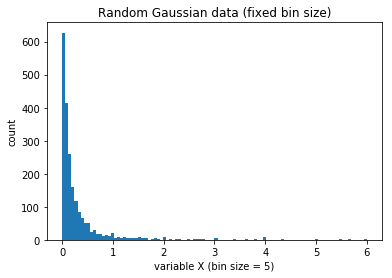

In [65]:
from matplotlib import pyplot as plt

# fixed bin size

ratio=filter(lambda x:x!=float('inf') and x!='nan',ratio)
plt.hist(np.array(ratiowin),bins=100,range=(min(ratio),max(ratio)))
plt.title('Random Gaussian data (fixed bin size)')
plt.xlabel('variable X (bin size = 5)')
plt.ylabel('count')

plt.show()

In [73]:
len(ratiowin)

2139

In [72]:
len(filter(lambda x:x>0.4,ratiowin))

422

In [64]:
len(filter(lambda x:x>0.2,ratio))

3484

In [61]:
len(filter(lambda x:x<0.1,ratio))

4656

In [31]:
l1.size

42

In [ ]:
import datetime
import logging
from random import shuffle
#logging.basicConfig(filename='run_1.log',level=logging.DEBUG)
from tensorflow.python import debug as tf_debug
print(datetime.datetime.now().strftime("%a, %d %B %Y %I:%M:%S"))

saver = tf.train.Saver()
trix=[cc for cc in range(len(h[5]))]
shuffle(trix)
prob = []
with tf.Session(config=tf.ConfigProto(allow_soft_placement=True, log_device_placement=True)) as sess:
    #sess=tf_debug.LocalCLIDebugWrapperSession(sess)
    sess.run(tf.global_variables_initializer())
    variables_names = [v.name for v in tf.trainable_variables()]
    values = sess.run(variables_names)
    for k, v in zip(variables_names, values):
        print "Variable: ", k
        print "Shape: ", v.shape
    # uncomment this when we want to load the checkpoint model
    #saver.restore(sess, "./checkpoints/model_0_0.ckpt")
    
    for j in range(15):   
        total_tp=0
        total_fp=0
        total_tn=0
        total_fn=0
        
        print(datetime.datetime.now().strftime("%a, %d %B %Y %I:%M:%S"))
        
        print('Epoch Number........................................',j)
        pedc=0
        
        for i in trix:
            
        #todo reformat code to have lists instead of many variable
            if h[5][i]=='Pedestrian':
                pedc+=1
                if pedc%500==0:
                    total_tp=0
                    total_fp=0
                    total_tn=0
                    total_fn=0
                index = np.argsort(TRAIN_DATASET.get_center_view_point_set(i)[:,2])
                point_set = TRAIN_DATASET.get_center_view_point_set(i)[index]

                if point_set.shape[0]<2048:
                        indexes=np.arange(np.shape(point_set)[0])
                        indexes2=np.random.choice(indexes, 2048-np.shape(indexes)[0],replace=True)
                        indexes=np.concatenate((indexes,indexes2))
                else:
                        indexes=np.random.choice(np.arange(np.shape(point_set)[0]),2048,replace=False)

                point_set = np.reshape(point_set[indexes], (1, 2048, 4))
                
                
                
                s5,e5,l5 = indices(i, 0.9, 0.1)

#                 s1, e1, l1 = indices(i, 1.1, 0.2)

#                 s2, e2, l2 = indices(i, 1.3, 0.2)

#                 s3, e3, l3 = indices(i, 0.7, 0.1)

#                 s4, e4, l4 = indices(i, 0.5, 0.1)
                
                if s5.size :#and s2.size and s3.size and s4.size and s1.size:

                    ind_5 = get_list(s5,e5, num_points=512)

#                     ind_1 = get_list(s1,e1, num_points=512)

#                     ind_2 = get_list(s2,e2, num_points=512)

#                     ind_3 = get_list(s3,e3, num_points=512)

#                     ind_4 = get_list(s4,e4, num_points=512)
#                     t_windows=s1.shape[0]+s2.shape[0]+s3.shape[0]+s4.shape[0]+s5.shape[0]
                        
                    _, x,tpos,fpos,tneg,fneg =sess.run([train_op, loss,tp,fp,tn,fn],feed_dict={idx_5:ind_5,\
                                                               label_out_5: l5.astype(np.int32),\
                                                               inputs:point_set, is_training: True})
                    total_tp+=tpos
                    total_fp+=fpos
                    total_tn+=tneg
                    total_fn+=fneg
                    print('----------------------------------------------------------------------------------')
                    print('Epoch ', j , 'Loss for the current example ',i,' = ', x,'pedc = ',pedc)
                    #logging.info('Loss for the current example ',i,' = ', x)
                    print('Metrics for current example: TP=',tpos,' FP=',fpos,' TN=',tneg,' FN=',fneg)
                    #logging.info('Metrics for current example: TP=',tpos,' FP=',fpos,' TN=',tneg,' FN=',fneg)  # will not print anything
                    #print('Cumulative metrics: TP=',total_tp,' FP=',total_fp,' TN=',total_tn,' FN=',total_fn)
                    print('Cumulative metrics: Precision = ',(total_tp*1.0)/(total_tp+total_fp),\
                          ' Recall = ',(total_tp*1.0)/(total_tp+total_fn))
                    #logging.info('Cumulative metrics: Precision = ',(total_tp*1.0)/(total_tp+total_fp),\
                    #      ' Recall = ',(total_tp*1.0)/(total_tp+total_fn))
                    print('----------------------------------------------------------------------------------')
                    
                    if(pedc%5000==0):
                        save_path = saver.save(sess, "./checkpoints/model_"+str(j)+'_'+str(i)+".ckpt")
                    if pedc%12000==11999:
                        print('***************************************************************************************************')
                        k = 0
                        print(len(val[5]))
                        Vtotal_tp=0
                        Vtotal_fp=0
                        Vtotal_tn=0
                        Vtotal_fn=0
                        while k<len(val[5]):
                        #todo reformat code to have lists instead of many variable
                            
                        
                            if val[5][k]=='Pedestrian':
                                
                                index = np.argsort(VAL_DATASET.get_center_view_point_set(k)[:,2])
                                point_set = VAL_DATASET.get_center_view_point_set(k)[index]
                                
                                if point_set.shape[0]<2048:
                                        indexes=np.arange(np.shape(point_set)[0])
                                        indexes2=np.random.choice(indexes, 2048-np.shape(indexes)[0],replace=True)
                                        indexes=np.concatenate((indexes,indexes2))
                                else:
                                        indexes=np.random.choice(np.arange(np.shape(point_set)[0]),2048,replace=False)
                                
                                point_set = np.reshape(point_set[indexes], (1, 2048, 4))

                                s5,e5,l5 = indices(k, 0.9, 0.1, 'val')

#                                 s1, e1, l1 = indices(k, 1.1, 0.2, 'val')

#                                 s2, e2, l2 = indices(k, 1.3, 0.2, 'val')

#                                 s3, e3, l3 = indices(k, 0.7, 0.1, 'val')

#                                 s4, e4, l4 = indices(k, 0.5, 0.1, 'val')
                                
                                if s5.size :#and s2.size and s3.size and s4.size and s1.size:
                                    
                                    ind_5 = get_list(s5,e5, num_points=512)

#                                     ind_1 = get_list(s1,e1, num_points=512)

#                                     ind_2 = get_list(s2,e2, num_points=512)

#                                     ind_3 = get_list(s3,e3, num_points=512)

#                                     ind_4 = get_list(s4,e4, num_points=512)

#                                     t_windows=s1.shape[0]+s2.shape[0]+s3.shape[0]+s4.shape[0]+s5.shape[0]
                                    
                                    print(Vtotal_tp)

                                    x,tpos,fpos,tneg,fneg =sess.run([loss,tp,fp,tn,fn],feed_dict={idx_5:ind_5, \
                                                                               label_out_5: l5.astype(np.int32), inputs:point_set, is_training : True})
                                    
                                    print(Vtotal_tp)
                                    Vtotal_tp +=tpos
                                    Vtotal_fp +=fpos
                                    Vtotal_tn +=tneg
                                    Vtotal_fn +=fneg
                                    print('***************************************************************************************************')
                                    print('Epoch ', j , 'Loss for the current example ',k,' = ', x)
                                    #logging.info('Loss for the current example ',i,' = ', x)
                                    print('Metrics for current example: TP=',tpos,' FP=',fpos,' TN=',tneg,' FN=',fneg)
                                    #logging.info('Metrics for current example: TP=',tpos,' FP=',fpos,' TN=',tneg,' FN=',fneg)  # will not print anything
                                    #print('Cumulative metrics: TP=',total_tp,' FP=',total_fp,' TN=',total_tn,' FN=',total_fn)
                                    print('Cumulative metrics: Precision = ',(Vtotal_tp*1.0)/(Vtotal_tp+Vtotal_fp),\
                                          ' Recall = ',(Vtotal_tp*1.0)/(Vtotal_tp+Vtotal_fn))
                                    #logging.info('Cumulative metrics: Precision = ',(Vtotal_tp*1.0)/(Vtotal_tp+Vtotal_fp),\
                                    #      ' Recall = ',(Vtotal_tp*1.0)/(Vtotal_tp+Vtotal_fn))
                                    print('***************************************************************************************************')
                                    
                            k += 1

                        
                        

                #print(c)
                #print(n)
            #i += 1
        #-----------------------------------------------------------------------------------------------#
        print('&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&')
        k = 0
        print(len(val[5]))
        Vtotal_tp=0
        Vtotal_fp=0
        Vtotal_tn=0
        Vtotal_fn=0
        while k<len(val[5]):
        #todo reformat code to have lists instead of many variable


            if val[5][k]=='Pedestrian':

                index = np.argsort(VAL_DATASET.get_center_view_point_set(k)[:,2])
                point_set = VAL_DATASET.get_center_view_point_set(k)[index]

                if point_set.shape[0]<2048:
                        indexes=np.arange(np.shape(point_set)[0])
                        indexes2=np.random.choice(indexes, 2048-np.shape(indexes)[0],replace=True)
                        indexes=np.concatenate((indexes,indexes2))
                else:
                        indexes=np.random.choice(np.arange(np.shape(point_set)[0]),2048,replace=False)

                point_set = np.reshape(point_set[indexes], (1, 2048, 4))

                s5,e5,l5 = indices(k, 0.9, 0.1, 'val')

#                 s1, e1, l1 = indices(k, 1.1, 0.2, 'val')

#                 s2, e2, l2 = indices(k, 1.3, 0.2, 'val')

#                 s3, e3, l3 = indices(k, 0.7, 0.1, 'val')

#                 s4, e4, l4 = indices(k, 0.5, 0.1, 'val')

                if s5.size :#and s2.size and s3.size and s4.size and s1.size:

                    ind_5 = get_list(s5,e5, num_points=512)

#                     ind_1 = get_list(s1,e1, num_points=512)

#                     ind_2 = get_list(s2,e2, num_points=512)

#                     ind_3 = get_list(s3,e3, num_points=512)

#                     ind_4 = get_list(s4,e4, num_points=512)

#                     t_windows=s1.shape[0]+s2.shape[0]+s3.shape[0]+s4.shape[0]+s5.shape[0]

                    print(Vtotal_tp)

                    x,tpos,fpos,tneg,fneg =sess.run([loss,tp,fp,tn,fn],feed_dict={idx_5:ind_5, \
                                                               label_out_5: l5.astype(np.int32), inputs:point_set, is_training: True})
                    print(Vtotal_tp)
                    Vtotal_tp +=tpos
                    Vtotal_fp +=fpos
                    Vtotal_tn +=tneg
                    Vtotal_fn +=fneg
                    print('&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&')
                    print('Epoch ', j , 'Loss for the current example ',k,' = ', x)
                    #logging.info('Loss for the current example ',i,' = ', x)
                    print('Metrics for current example: TP=',tpos,' FP=',fpos,' TN=',tneg,' FN=',fneg)
                    #logging.info('Metrics for current example: TP=',tpos,' FP=',fpos,' TN=',tneg,' FN=',fneg)  # will not print anything
                    #print('Cumulative metrics: TP=',total_tp,' FP=',total_fp,' TN=',total_tn,' FN=',total_fn)
                    print('Cumulative metrics: Precision = ',(Vtotal_tp*1.0)/(Vtotal_tp+Vtotal_fp),\
                          ' Recall = ',(Vtotal_tp*1.0)/(Vtotal_tp+Vtotal_fn))
                    #logging.info('Cumulative metrics: Precision = ',(Vtotal_tp*1.0)/(Vtotal_tp+Vtotal_fp),\
                    #      ' Recall = ',(Vtotal_tp*1.0)/(Vtotal_tp+Vtotal_fn))
                    print('&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&')

            k += 1

        #----------------------------------------------------------------------------------------------#
#         prob = sess.run([sig],feed_dict={idx_5:ind_5, idx_1:ind_1, idx_2:ind_2, idx_3:ind_3, idx_4:ind_4,\
#                                                        label_out_5: l5.astype(np.int32), label_out_1: l1.astype(np.int32),\
#                                                        label_out_2: l2.astype(np.int32), label_out_3: l3.astype(np.int32),\
#                                                        label_out_4: l4.astype(np.int32), inputs:point_set,  is_training: False})
#         print(prob)
        prob = sess.run([sig],feed_dict={idx_5:ind_5,  \
                                                       label_out_5: l5.astype(np.int32), inputs:point_set,  is_training: False})
        print(prob)
print(datetime.datetime.now().strftime("%a, %d %B %Y %I:%M:%S") )

Sat, 12 May 2018 12:20:22
Variable:  conv1/weights:0
Shape:  (1, 1, 4, 64)
Variable:  conv1/biases:0
Shape:  (64,)
Variable:  conv1/bn/beta:0
Shape:  (64,)
Variable:  conv1/bn/gamma:0
Shape:  (64,)
Variable:  conv2/weights:0
Shape:  (1, 1, 64, 64)
Variable:  conv2/biases:0
Shape:  (64,)
Variable:  conv2/bn/beta:0
Shape:  (64,)
Variable:  conv2/bn/gamma:0
Shape:  (64,)
Variable:  conv3/weights:0
Shape:  (1, 1, 64, 64)
Variable:  conv3/biases:0
Shape:  (64,)
Variable:  conv3/bn/beta:0
Shape:  (64,)
Variable:  conv3/bn/gamma:0
Shape:  (64,)
Variable:  conv4/weights:0
Shape:  (1, 1, 64, 128)
Variable:  conv4/biases:0
Shape:  (128,)
Variable:  conv4/bn/beta:0
Shape:  (128,)
Variable:  conv4/bn/gamma:0
Shape:  (128,)
Variable:  conv5/weights:0
Shape:  (1, 1, 128, 1024)
Variable:  conv5/biases:0
Shape:  (1024,)
Variable:  conv5/bn/beta:0
Shape:  (1024,)
Variable:  conv5/bn/gamma:0
Shape:  (1024,)
Variable:  dense1/weights:0
Shape:  (1, 1, 1024, 512)
Variable:  dense1/biases:0
Shape:  (512,)
V

----------------------------------------------------------------------------------
('Epoch ', 0, 'Loss for the current example ', 11072, ' = ', 3.4549317, 'pedc = ', 18)
('Metrics for current example: TP=', 1.0, ' FP=', 2.0, ' TN=', 3.0, ' FN=', 2.0)
('Cumulative metrics: Precision = ', 0.11174785100286533, ' Recall = ', 0.5909090909090909)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 0, 'Loss for the current example ', 1515, ' = ', 59.721886, 'pedc = ', 19)
('Metrics for current example: TP=', 5.0, ' FP=', 56.0, ' TN=', 62.0, ' FN=', 1.0)
('Cumulative metrics: Precision = ', 0.1073170731707317, ' Recall = ', 0.6111111111111112)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 0, 'Loss for the current example ', 653, ' = ', 9.5292

----------------------------------------------------------------------------------
('Epoch ', 0, 'Loss for the current example ', 10113, ' = ', 17.09215, 'pedc = ', 41)
('Metrics for current example: TP=', 8.0, ' FP=', 12.0, ' TN=', 26.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.10467479674796748, ' Recall = ', 0.6560509554140127)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 0, 'Loss for the current example ', 3508, ' = ', 81.92791, 'pedc = ', 42)
('Metrics for current example: TP=', 2.0, ' FP=', 78.0, ' TN=', 79.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.09868421052631579, ' Recall = ', 0.660377358490566)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 0, 'Loss for the current example ', 8805, ' = ', 89.73

----------------------------------------------------------------------------------
('Epoch ', 0, 'Loss for the current example ', 11389, ' = ', 6.2165823, 'pedc = ', 67)
('Metrics for current example: TP=', 2.0, ' FP=', 4.0, ' TN=', 5.0, ' FN=', 3.0)
('Cumulative metrics: Precision = ', 0.10986842105263157, ' Recall = ', 0.6844262295081968)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 0, 'Loss for the current example ', 2536, ' = ', 2.617805, 'pedc = ', 68)
('Metrics for current example: TP=', 4.0, ' FP=', 1.0, ' TN=', 3.0, ' FN=', 1.0)
('Cumulative metrics: Precision = ', 0.1121311475409836, ' Recall = ', 0.6867469879518072)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 0, 'Loss for the current example ', 3526, ' = ', 10.62124

----------------------------------------------------------------------------------
('Epoch ', 0, 'Loss for the current example ', 448, ' = ', 9.2422085, 'pedc = ', 89)
('Metrics for current example: TP=', 7.0, ' FP=', 6.0, ' TN=', 18.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.12198872373141978, ' Recall = ', 0.7300613496932515)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 0, 'Loss for the current example ', 2381, ' = ', 18.45724, 'pedc = ', 90)
('Metrics for current example: TP=', 7.0, ' FP=', 23.0, ' TN=', 18.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.12367491166077739, ' Recall = ', 0.7357357357357357)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 0, 'Loss for the current example ', 4859, ' = ', 15.349

----------------------------------------------------------------------------------
('Epoch ', 0, 'Loss for the current example ', 8331, ' = ', 64.73505, 'pedc = ', 114)
('Metrics for current example: TP=', 6.0, ' FP=', 47.0, ' TN=', 88.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.13473174667204518, ' Recall = ', 0.7822014051522248)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 0, 'Loss for the current example ', 1037, ' = ', 0.14580902, 'pedc = ', 115)
('Metrics for current example: TP=', 1.0, ' FP=', 0.0, ' TN=', 0.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.1350806451612903, ' Recall = ', 0.7827102803738317)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 0, 'Loss for the current example ', 14661, ' = ', 4.5

----------------------------------------------------------------------------------
('Epoch ', 0, 'Loss for the current example ', 7333, ' = ', 25.896135, 'pedc = ', 135)
('Metrics for current example: TP=', 5.0, ' FP=', 26.0, ' TN=', 35.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.13926232333678043, ' Recall = ', 0.8)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 0, 'Loss for the current example ', 13077, ' = ', 23.489033, 'pedc = ', 136)
('Metrics for current example: TP=', 6.0, ' FP=', 27.0, ' TN=', 24.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.13974096796182686, ' Recall = ', 0.8023483365949119)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 0, 'Loss for the current example ', 9949, ' = ', 4.061984, 'pedc

----------------------------------------------------------------------------------
('Epoch ', 0, 'Loss for the current example ', 7086, ' = ', 10.2845335, 'pedc = ', 155)
('Metrics for current example: TP=', 4.0, ' FP=', 7.0, ' TN=', 18.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.14583963691376703, ' Recall = ', 0.8169491525423729)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 0, 'Loss for the current example ', 13514, ' = ', 2.346282, 'pedc = ', 156)
('Metrics for current example: TP=', 3.0, ' FP=', 2.0, ' TN=', 5.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.14652567975830816, ' Recall = ', 0.8178752107925801)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 0, 'Loss for the current example ', 2716, ' = ', 42.

----------------------------------------------------------------------------------
('Epoch ', 0, 'Loss for the current example ', 8971, ' = ', 29.729813, 'pedc = ', 176)
('Metrics for current example: TP=', 4.0, ' FP=', 33.0, ' TN=', 34.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.14791946308724832, ' Recall = ', 0.8310708898944194)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 0, 'Loss for the current example ', 179, ' = ', 19.424955, 'pedc = ', 177)
('Metrics for current example: TP=', 2.0, ' FP=', 15.0, ' TN=', 29.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.1477819347942277, ' Recall = ', 0.8315789473684211)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 0, 'Loss for the current example ', 14219, ' = ', 31

----------------------------------------------------------------------------------
('Epoch ', 0, 'Loss for the current example ', 9763, ' = ', 6.56446, 'pedc = ', 197)
('Metrics for current example: TP=', 5.0, ' FP=', 5.0, ' TN=', 12.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.14565166156021683, ' Recall = ', 0.8419618528610354)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 0, 'Loss for the current example ', 7514, ' = ', 46.487152, 'pedc = ', 198)
('Metrics for current example: TP=', 2.0, ' FP=', 45.0, ' TN=', 48.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.1445221445221445, ' Recall = ', 0.842391304347826)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 0, 'Loss for the current example ', 2503, ' = ', 11.510

----------------------------------------------------------------------------------
('Epoch ', 0, 'Loss for the current example ', 3309, ' = ', 27.420004, 'pedc = ', 220)
('Metrics for current example: TP=', 2.0, ' FP=', 24.0, ' TN=', 32.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.1508404278541803, ' Recall = ', 0.8499384993849939)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 0, 'Loss for the current example ', 687, ' = ', 19.093685, 'pedc = ', 221)
('Metrics for current example: TP=', 7.0, ' FP=', 23.0, ' TN=', 23.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.1513771416178703, ' Recall = ', 0.8512195121951219)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 0, 'Loss for the current example ', 8522, ' = ', 1.85

----------------------------------------------------------------------------------
('Epoch ', 0, 'Loss for the current example ', 8480, ' = ', 28.7893, 'pedc = ', 242)
('Metrics for current example: TP=', 4.0, ' FP=', 20.0, ' TN=', 48.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.15174178311356032, ' Recall = ', 0.8538205980066446)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 0, 'Loss for the current example ', 11650, ' = ', 9.210686, 'pedc = ', 243)
('Metrics for current example: TP=', 4.0, ' FP=', 6.0, ' TN=', 18.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.15222942447456295, ' Recall = ', 0.8544652701212789)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 0, 'Loss for the current example ', 9318, ' = ', 9.67

----------------------------------------------------------------------------------
('Epoch ', 0, 'Loss for the current example ', 8304, ' = ', 34.847603, 'pedc = ', 264)
('Metrics for current example: TP=', 2.0, ' FP=', 31.0, ' TN=', 40.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.15605153329704227, ' Recall = ', 0.8660624370594159)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 0, 'Loss for the current example ', 10125, ' = ', 20.811287, 'pedc = ', 265)
('Metrics for current example: TP=', 1.0, ' FP=', 16.0, ' TN=', 27.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.15575253256150506, ' Recall = ', 0.8661971830985915)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 0, 'Loss for the current example ', 8563, ' = ', 

----------------------------------------------------------------------------------
('Epoch ', 0, 'Loss for the current example ', 12027, ' = ', 1.012059, 'pedc = ', 285)
('Metrics for current example: TP=', 2.0, ' FP=', 0.0, ' TN=', 2.0, ' FN=', 2.0)
('Cumulative metrics: Precision = ', 0.15745903024159486, ' Recall = ', 0.8661710037174721)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 0, 'Loss for the current example ', 6210, ' = ', 42.7731, 'pedc = ', 286)
('Metrics for current example: TP=', 1.0, ' FP=', 37.0, ' TN=', 47.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.15662246097028706, ' Recall = ', 0.8662952646239555)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 0, 'Loss for the current example ', 4784, ' = ', 19.39

----------------------------------------------------------------------------------
('Epoch ', 0, 'Loss for the current example ', 9980, ' = ', 48.041782, 'pedc = ', 308)
('Metrics for current example: TP=', 1.0, ' FP=', 35.0, ' TN=', 59.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.15810959334275396, ' Recall = ', 0.8711072664359861)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 0, 'Loss for the current example ', 2756, ' = ', 9.84251, 'pedc = ', 309)
('Metrics for current example: TP=', 3.0, ' FP=', 6.0, ' TN=', 18.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.1583568516776419, ' Recall = ', 0.8714408973252804)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 0, 'Loss for the current example ', 1686, ' = ', 10.80

----------------------------------------------------------------------------------
('Epoch ', 0, 'Loss for the current example ', 10175, ' = ', 10.238884, 'pedc = ', 329)
('Metrics for current example: TP=', 0.0, ' FP=', 10.0, ' TN=', 6.0, ' FN=', 2.0)
('Cumulative metrics: Precision = ', 0.16059479553903347, ' Recall = ', 0.8730800323362975)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 0, 'Loss for the current example ', 11195, ' = ', 9.380596, 'pedc = ', 330)
('Metrics for current example: TP=', 4.0, ' FP=', 6.0, ' TN=', 18.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.1609502598366741, ' Recall = ', 0.8734891216760677)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 0, 'Loss for the current example ', 11289, ' = ', 4.

----------------------------------------------------------------------------------
('Epoch ', 0, 'Loss for the current example ', 8790, ' = ', 14.340353, 'pedc = ', 351)
('Metrics for current example: TP=', 7.0, ' FP=', 12.0, ' TN=', 27.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.1617895329206528, ' Recall = ', 0.8751902587519026)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 0, 'Loss for the current example ', 5943, ' = ', 19.586792, 'pedc = ', 352)
('Metrics for current example: TP=', 2.0, ' FP=', 12.0, ' TN=', 35.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.16175231676495366, ' Recall = ', 0.8753799392097265)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 0, 'Loss for the current example ', 12932, ' = ', 3

----------------------------------------------------------------------------------
('Epoch ', 0, 'Loss for the current example ', 2691, ' = ', 63.416794, 'pedc = ', 374)
('Metrics for current example: TP=', 6.0, ' FP=', 50.0, ' TN=', 101.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.1630229419703104, ' Recall = ', 0.877906976744186)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 0, 'Loss for the current example ', 4013, ' = ', 7.126239, 'pedc = ', 375)
('Metrics for current example: TP=', 2.0, ' FP=', 5.0, ' TN=', 13.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.16313873533773762, ' Recall = ', 0.8780841799709724)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 0, 'Loss for the current example ', 10823, ' = ', 52.

----------------------------------------------------------------------------------
('Epoch ', 0, 'Loss for the current example ', 12591, ' = ', 5.5869837, 'pedc = ', 397)
('Metrics for current example: TP=', 3.0, ' FP=', 4.0, ' TN=', 5.0, ' FN=', 3.0)
('Cumulative metrics: Precision = ', 0.16552250190694126, ' Recall = ', 0.8809201623815968)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 0, 'Loss for the current example ', 10427, ' = ', 12.01248, 'pedc = ', 398)
('Metrics for current example: TP=', 5.0, ' FP=', 8.0, ' TN=', 26.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.16588399543089224, ' Recall = ', 0.8813216453135536)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 0, 'Loss for the current example ', 9167, ' = ', 25.

----------------------------------------------------------------------------------
('Epoch ', 0, 'Loss for the current example ', 3441, ' = ', 0.77383333, 'pedc = ', 419)
('Metrics for current example: TP=', 3.0, ' FP=', 0.0, ' TN=', 2.0, ' FN=', 1.0)
('Cumulative metrics: Precision = ', 0.16823918637421884, ' Recall = ', 0.8812580231065469)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 0, 'Loss for the current example ', 12155, ' = ', 0.36008054, 'pedc = ', 420)
('Metrics for current example: TP=', 1.0, ' FP=', 0.0, ' TN=', 0.0, ' FN=', 1.0)
('Cumulative metrics: Precision = ', 0.16834109286939475, ' Recall = ', 0.8807692307692307)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 0, 'Loss for the current example ', 118, ' = ', 40.

----------------------------------------------------------------------------------
('Epoch ', 0, 'Loss for the current example ', 1532, ' = ', 24.39093, 'pedc = ', 439)
('Metrics for current example: TP=', 7.0, ' FP=', 23.0, ' TN=', 38.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.16917605216360404, ' Recall = ', 0.881408276714021)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 0, 'Loss for the current example ', 4305, ' = ', 41.85481, 'pedc = ', 440)
('Metrics for current example: TP=', 3.0, ' FP=', 37.0, ' TN=', 61.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.1687315634218289, ' Recall = ', 0.8816276202219482)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 0, 'Loss for the current example ', 1854, ' = ', 5.711

----------------------------------------------------------------------------------
('Epoch ', 0, 'Loss for the current example ', 9760, ' = ', 20.884352, 'pedc = ', 460)
('Metrics for current example: TP=', 4.0, ' FP=', 18.0, ' TN=', 34.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.1674345432071019, ' Recall = ', 0.8769864626250736)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 0, 'Loss for the current example ', 12637, ' = ', 1.2114714, 'pedc = ', 461)
('Metrics for current example: TP=', 0.0, ' FP=', 1.0, ' TN=', 0.0, ' FN=', 1.0)
('Cumulative metrics: Precision = ', 0.16741573033707866, ' Recall = ', 0.8764705882352941)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 0, 'Loss for the current example ', 3017, ' = ', 7.4

----------------------------------------------------------------------------------
('Epoch ', 0, 'Loss for the current example ', 3014, ' = ', 19.469425, 'pedc = ', 481)
('Metrics for current example: TP=', 6.0, ' FP=', 18.0, ' TN=', 33.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.16670265601381992, ' Recall = ', 0.8747875354107649)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 0, 'Loss for the current example ', 7930, ' = ', 21.644058, 'pedc = ', 483)
('Metrics for current example: TP=', 8.0, ' FP=', 17.0, ' TN=', 31.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.16711532249380856, ' Recall = ', 0.8753525098702764)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 0, 'Loss for the current example ', 14632, ' = ', 

----------------------------------------------------------------------------------
('Epoch ', 0, 'Loss for the current example ', 111, ' = ', 18.793434, 'pedc = ', 504)
('Metrics for current example: TP=', 3.0, ' FP=', 10.0, ' TN=', 36.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.5142857142857142, ' Recall = ', 0.9)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 0, 'Loss for the current example ', 1946, ' = ', 11.928645, 'pedc = ', 505)
('Metrics for current example: TP=', 3.0, ' FP=', 10.0, ' TN=', 22.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.4375, ' Recall = ', 0.9130434782608695)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 0, 'Loss for the current example ', 12871, ' = ', 3.7549744, 'pedc = ', 506)
('M

----------------------------------------------------------------------------------
('Epoch ', 0, 'Loss for the current example ', 4919, ' = ', 61.986115, 'pedc = ', 524)
('Metrics for current example: TP=', 3.0, ' FP=', 48.0, ' TN=', 89.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.16770186335403728, ' Recall = ', 0.9529411764705882)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 0, 'Loss for the current example ', 3941, ' = ', 16.155418, 'pedc = ', 525)
('Metrics for current example: TP=', 8.0, ' FP=', 12.0, ' TN=', 30.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.17693836978131214, ' Recall = ', 0.956989247311828)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 0, 'Loss for the current example ', 2994, ' = ', 41

----------------------------------------------------------------------------------
('Epoch ', 0, 'Loss for the current example ', 754, ' = ', 55.30179, 'pedc = ', 546)
('Metrics for current example: TP=', 2.0, ' FP=', 41.0, ' TN=', 79.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.18306351183063513, ' Recall = ', 0.9423076923076923)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 0, 'Loss for the current example ', 919, ' = ', 42.99119, 'pedc = ', 547)
('Metrics for current example: TP=', 4.0, ' FP=', 41.0, ' TN=', 61.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.17806603773584906, ' Recall = ', 0.94375)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 0, 'Loss for the current example ', 9359, ' = ', 42.32889, 'pedc 

----------------------------------------------------------------------------------
('Epoch ', 0, 'Loss for the current example ', 13290, ' = ', 3.3440847, 'pedc = ', 567)
('Metrics for current example: TP=', 4.0, ' FP=', 4.0, ' TN=', 5.0, ' FN=', 1.0)
('Cumulative metrics: Precision = ', 0.17442778216258878, ' Recall = ', 0.9444444444444444)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 0, 'Loss for the current example ', 2559, ' = ', 67.401726, 'pedc = ', 568)
('Metrics for current example: TP=', 7.0, ' FP=', 30.0, ' TN=', 121.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.17484662576687116, ' Recall = ', 0.946058091286307)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 0, 'Loss for the current example ', 12334, ' = ', 2

----------------------------------------------------------------------------------
('Epoch ', 0, 'Loss for the current example ', 2023, ' = ', 23.175102, 'pedc = ', 589)
('Metrics for current example: TP=', 6.0, ' FP=', 11.0, ' TN=', 47.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.19000657462195925, ' Recall = ', 0.932258064516129)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 0, 'Loss for the current example ', 2530, ' = ', 7.8735704, 'pedc = ', 590)
('Metrics for current example: TP=', 1.0, ' FP=', 3.0, ' TN=', 10.0, ' FN=', 2.0)
('Cumulative metrics: Precision = ', 0.1901639344262295, ' Recall = ', 0.9265175718849841)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 0, 'Loss for the current example ', 9293, ' = ', 2.80

----------------------------------------------------------------------------------
('Epoch ', 0, 'Loss for the current example ', 3108, ' = ', 3.0650988, 'pedc = ', 611)
('Metrics for current example: TP=', 7.0, ' FP=', 0.0, ' TN=', 11.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.2009698275862069, ' Recall = ', 0.9255583126550868)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 0, 'Loss for the current example ', 8282, ' = ', 1.4473963, 'pedc = ', 612)
('Metrics for current example: TP=', 2.0, ' FP=', 0.0, ' TN=', 5.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.20182992465016147, ' Recall = ', 0.9259259259259259)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 0, 'Loss for the current example ', 14223, ' = ', 8.43

----------------------------------------------------------------------------------
('Epoch ', 0, 'Loss for the current example ', 4303, ' = ', 8.11532, 'pedc = ', 631)
('Metrics for current example: TP=', 6.0, ' FP=', 5.0, ' TN=', 14.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.19885613726352838, ' Recall = ', 0.9224489795918367)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 0, 'Loss for the current example ', 3008, ' = ', 80.64068, 'pedc = ', 632)
('Metrics for current example: TP=', 6.0, ' FP=', 60.0, ' TN=', 128.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.19581017528858485, ' Recall = ', 0.9233870967741935)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 0, 'Loss for the current example ', 10425, ' = ', 30.

----------------------------------------------------------------------------------
('Epoch ', 0, 'Loss for the current example ', 1512, ' = ', 46.909027, 'pedc = ', 653)
('Metrics for current example: TP=', 5.0, ' FP=', 25.0, ' TN=', 77.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.1972043823196071, ' Recall = ', 0.9046793760831889)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 0, 'Loss for the current example ', 6491, ' = ', 18.115974, 'pedc = ', 654)
('Metrics for current example: TP=', 6.0, ' FP=', 8.0, ' TN=', 40.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.1984216459977452, ' Recall = ', 0.9056603773584906)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 0, 'Loss for the current example ', 5959, ' = ', 41.6

----------------------------------------------------------------------------------
('Epoch ', 0, 'Loss for the current example ', 4930, ' = ', 26.84645, 'pedc = ', 674)
('Metrics for current example: TP=', 2.0, ' FP=', 23.0, ' TN=', 40.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.19593908629441625, ' Recall = ', 0.8948995363214838)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 0, 'Loss for the current example ', 6313, ' = ', 39.856197, 'pedc = ', 675)
('Metrics for current example: TP=', 2.0, ' FP=', 37.0, ' TN=', 57.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.19405477621910489, ' Recall = ', 0.8952234206471494)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 0, 'Loss for the current example ', 12727, ' = ', 1

----------------------------------------------------------------------------------
('Epoch ', 0, 'Loss for the current example ', 6726, ' = ', 35.71608, 'pedc = ', 695)
('Metrics for current example: TP=', 5.0, ' FP=', 20.0, ' TN=', 71.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.1960546282245827, ' Recall = ', 0.8947368421052632)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 0, 'Loss for the current example ', 2217, ' = ', 30.890596, 'pedc = ', 696)
('Metrics for current example: TP=', 2.0, ' FP=', 26.0, ' TN=', 45.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.19500451399337948, ' Recall = ', 0.8950276243093923)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 0, 'Loss for the current example ', 14095, ' = ', 5.

----------------------------------------------------------------------------------
('Epoch ', 0, 'Loss for the current example ', 11098, ' = ', 7.060693, 'pedc = ', 716)
('Metrics for current example: TP=', 1.0, ' FP=', 9.0, ' TN=', 6.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.19983461962513782, ' Recall = ', 0.8995037220843672)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 0, 'Loss for the current example ', 2810, ' = ', 17.393166, 'pedc = ', 717)
('Metrics for current example: TP=', 6.0, ' FP=', 11.0, ' TN=', 38.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.20054869684499313, ' Recall = ', 0.9002463054187192)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 0, 'Loss for the current example ', 2083, ' = ', 11.

----------------------------------------------------------------------------------
('Epoch ', 0, 'Loss for the current example ', 6421, ' = ', 46.650024, 'pedc = ', 736)
('Metrics for current example: TP=', 8.0, ' FP=', 23.0, ' TN=', 95.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.19904137235116046, ' Recall = ', 0.8945578231292517)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 0, 'Loss for the current example ', 12618, ' = ', 3.7312272, 'pedc = ', 737)
('Metrics for current example: TP=', 0.0, ' FP=', 3.0, ' TN=', 4.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.19889084950844466, ' Recall = ', 0.8945578231292517)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 0, 'Loss for the current example ', 8508, ' = ', 25

----------------------------------------------------------------------------------
('Epoch ', 0, 'Loss for the current example ', 11386, ' = ', 30.495821, 'pedc = ', 758)
('Metrics for current example: TP=', 4.0, ' FP=', 16.0, ' TN=', 58.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.2025586353944563, ' Recall = ', 0.8952879581151832)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 0, 'Loss for the current example ', 1852, ' = ', 0.22577746, 'pedc = ', 759)
('Metrics for current example: TP=', 1.0, ' FP=', 0.0, ' TN=', 1.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.20274751302700142, ' Recall = ', 0.895397489539749)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 0, 'Loss for the current example ', 2946, ' = ', 53.

----------------------------------------------------------------------------------
('Epoch ', 0, 'Loss for the current example ', 1899, ' = ', 11.5457325, 'pedc = ', 781)
('Metrics for current example: TP=', 3.0, ' FP=', 8.0, ' TN=', 13.0, ' FN=', 1.0)
('Cumulative metrics: Precision = ', 0.19965613582634859, ' Recall = ', 0.8924111431316042)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 0, 'Loss for the current example ', 11648, ' = ', 33.822018, 'pedc = ', 782)
('Metrics for current example: TP=', 2.0, ' FP=', 26.0, ' TN=', 51.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.1988891262550737, ' Recall = ', 0.8926174496644296)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 0, 'Loss for the current example ', 2636, ' = ', 0

----------------------------------------------------------------------------------
('Epoch ', 0, 'Loss for the current example ', 3737, ' = ', 31.968763, 'pedc = ', 802)
('Metrics for current example: TP=', 1.0, ' FP=', 24.0, ' TN=', 49.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.2047970479704797, ' Recall = ', 0.8943598925693823)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 0, 'Loss for the current example ', 13506, ' = ', 2.6662488, 'pedc = ', 803)
('Metrics for current example: TP=', 0.0, ' FP=', 2.0, ' TN=', 3.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.20471311475409837, ' Recall = ', 0.8943598925693823)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 0, 'Loss for the current example ', 8330, ' = ', 54.

----------------------------------------------------------------------------------
('Epoch ', 0, 'Loss for the current example ', 7970, ' = ', 27.276478, 'pedc = ', 824)
('Metrics for current example: TP=', 2.0, ' FP=', 12.0, ' TN=', 50.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.20738745671412082, ' Recall = ', 0.8960931005818786)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 0, 'Loss for the current example ', 12562, ' = ', 23.29411, 'pedc = ', 825)
('Metrics for current example: TP=', 4.0, ' FP=', 21.0, ' TN=', 38.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.20716063565000958, ' Recall = ', 0.8964374482187241)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 0, 'Loss for the current example ', 11364, ' = ', 

----------------------------------------------------------------------------------
('Epoch ', 0, 'Loss for the current example ', 5842, ' = ', 36.195004, 'pedc = ', 844)
('Metrics for current example: TP=', 2.0, ' FP=', 23.0, ' TN=', 55.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.21102592186929536, ' Recall = ', 0.8982128982128982)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 0, 'Loss for the current example ', 13204, ' = ', 11.530697, 'pedc = ', 845)
('Metrics for current example: TP=', 2.0, ' FP=', 10.0, ' TN=', 10.0, ' FN=', 2.0)
('Cumulative metrics: Precision = ', 0.21092896174863388, ' Recall = ', 0.8969790859798605)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 0, 'Loss for the current example ', 9070, ' = ', 

----------------------------------------------------------------------------------
('Epoch ', 0, 'Loss for the current example ', 9355, ' = ', 76.679634, 'pedc = ', 867)
('Metrics for current example: TP=', 4.0, ' FP=', 40.0, ' TN=', 124.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.2094105480868666, ' Recall = ', 0.8980044345898004)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 0, 'Loss for the current example ', 1197, ' = ', 10.746767, 'pedc = ', 868)
('Metrics for current example: TP=', 8.0, ' FP=', 0.0, ' TN=', 35.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.21049913941480206, ' Recall = ', 0.8986039676708303)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 0, 'Loss for the current example ', 9917, ' = ', 2.

----------------------------------------------------------------------------------
('Epoch ', 0, 'Loss for the current example ', 12527, ' = ', 8.637984, 'pedc = ', 888)
('Metrics for current example: TP=', 1.0, ' FP=', 4.0, ' TN=', 11.0, ' FN=', 2.0)
('Cumulative metrics: Precision = ', 0.21322314049586777, ' Recall = ', 0.8977035490605428)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 0, 'Loss for the current example ', 12479, ' = ', 3.199541, 'pedc = ', 889)
('Metrics for current example: TP=', 1.0, ' FP=', 1.0, ' TN=', 8.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.21331791143423662, ' Recall = ', 0.8977746870653686)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 0, 'Loss for the current example ', 727, ' = ', 17.43

----------------------------------------------------------------------------------
('Epoch ', 0, 'Loss for the current example ', 11324, ' = ', 24.40561, 'pedc = ', 913)
('Metrics for current example: TP=', 2.0, ' FP=', 12.0, ' TN=', 46.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.21571111815014254, ' Recall = ', 0.8978246539222149)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 0, 'Loss for the current example ', 13682, ' = ', 13.216832, 'pedc = ', 914)
('Metrics for current example: TP=', 2.0, ' FP=', 5.0, ' TN=', 26.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.21578864103781048, ' Recall = ', 0.8979591836734694)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 0, 'Loss for the current example ', 1513, ' = ', 3

----------------------------------------------------------------------------------
('Epoch ', 0, 'Loss for the current example ', 12319, ' = ', 28.527374, 'pedc = ', 934)
('Metrics for current example: TP=', 5.0, ' FP=', 14.0, ' TN=', 65.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.21618339152876878, ' Recall = ', 0.9012658227848102)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 0, 'Loss for the current example ', 13124, ' = ', 31.415974, 'pedc = ', 935)
('Metrics for current example: TP=', 8.0, ' FP=', 15.0, ' TN=', 68.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.21664145234493193, ' Recall = ', 0.9017632241813602)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 0, 'Loss for the current example ', 13048, ' = '

----------------------------------------------------------------------------------
('Epoch ', 0, 'Loss for the current example ', 13904, ' = ', 64.021454, 'pedc = ', 955)
('Metrics for current example: TP=', 6.0, ' FP=', 34.0, ' TN=', 122.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.22167056074766356, ' Recall = ', 0.9046483909415971)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 0, 'Loss for the current example ', 1374, ' = ', 28.73809, 'pedc = ', 956)
('Metrics for current example: TP=', 1.0, ' FP=', 20.0, ' TN=', 40.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.22113844810016015, ' Recall = ', 0.9047051816557474)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 0, 'Loss for the current example ', 4235, ' = ', 

----------------------------------------------------------------------------------
('Epoch ', 0, 'Loss for the current example ', 2881, ' = ', 46.965897, 'pedc = ', 975)
('Metrics for current example: TP=', 3.0, ' FP=', 34.0, ' TN=', 76.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.21962358151120953, ' Recall = ', 0.9037585421412301)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 0, 'Loss for the current example ', 13988, ' = ', 0.539132, 'pedc = ', 976)
('Metrics for current example: TP=', 1.0, ' FP=', 0.0, ' TN=', 0.0, ' FN=', 2.0)
('Cumulative metrics: Precision = ', 0.21973156219731563, ' Recall = ', 0.9027856736782263)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 0, 'Loss for the current example ', 10111, ' = ', 6.

----------------------------------------------------------------------------------
('Epoch ', 0, 'Loss for the current example ', 14474, ' = ', 10.189013, 'pedc = ', 1000)
('Metrics for current example: TP=', 6.0, ' FP=', 4.0, ' TN=', 27.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.6, ' Recall = ', 1.0)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 0, 'Loss for the current example ', 6469, ' = ', 16.970438, 'pedc = ', 1001)
('Metrics for current example: TP=', 7.0, ' FP=', 6.0, ' TN=', 42.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.5652173913043478, ' Recall = ', 1.0)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 0, 'Loss for the current example ', 612, ' = ', 7.6742563, 'pedc = ', 1002)
('Metrics for curren

----------------------------------------------------------------------------------
('Epoch ', 0, 'Loss for the current example ', 5149, ' = ', 37.641754, 'pedc = ', 1022)
('Metrics for current example: TP=', 2.0, ' FP=', 27.0, ' TN=', 58.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.2522255192878338, ' Recall = ', 0.9770114942528736)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 0, 'Loss for the current example ', 3745, ' = ', 15.795405, 'pedc = ', 1023)
('Metrics for current example: TP=', 2.0, ' FP=', 14.0, ' TN=', 25.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.24645892351274787, ' Recall = ', 0.9775280898876404)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 0, 'Loss for the current example ', 1340, ' = ', 

----------------------------------------------------------------------------------
('Epoch ', 0, 'Loss for the current example ', 13366, ' = ', 11.744825, 'pedc = ', 1047)
('Metrics for current example: TP=', 4.0, ' FP=', 7.0, ' TN=', 27.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.23959827833572453, ' Recall = ', 0.9175824175824175)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 0, 'Loss for the current example ', 13071, ' = ', 4.177927, 'pedc = ', 1048)
('Metrics for current example: TP=', 6.0, ' FP=', 1.0, ' TN=', 14.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.24573863636363635, ' Recall = ', 0.9202127659574468)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 0, 'Loss for the current example ', 2278, ' = ', 

----------------------------------------------------------------------------------
('Epoch ', 0, 'Loss for the current example ', 12588, ' = ', 87.132034, 'pedc = ', 1069)
('Metrics for current example: TP=', 1.0, ' FP=', 53.0, ' TN=', 129.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.21505376344086022, ' Recall = ', 0.8627450980392157)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 0, 'Loss for the current example ', 2746, ' = ', 16.18496, 'pedc = ', 1070)
('Metrics for current example: TP=', 6.0, ' FP=', 5.0, ' TN=', 42.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.218568665377176, ' Recall = ', 0.8659003831417624)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 0, 'Loss for the current example ', 12083, ' = ', 

----------------------------------------------------------------------------------
('Epoch ', 0, 'Loss for the current example ', 1523, ' = ', 3.4513705, 'pedc = ', 1089)
('Metrics for current example: TP=', 0.0, ' FP=', 2.0, ' TN=', 2.0, ' FN=', 2.0)
('Cumulative metrics: Precision = ', 0.2237871674491393, ' Recall = ', 0.8719512195121951)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 0, 'Loss for the current example ', 8215, ' = ', 2.4649243, 'pedc = ', 1090)
('Metrics for current example: TP=', 4.0, ' FP=', 0.0, ' TN=', 9.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.22620904836193448, ' Recall = ', 0.8734939759036144)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 0, 'Loss for the current example ', 1498, ' = ', 1.07

----------------------------------------------------------------------------------
('Epoch ', 0, 'Loss for the current example ', 2074, ' = ', 45.695305, 'pedc = ', 1109)
('Metrics for current example: TP=', 7.0, ' FP=', 17.0, ' TN=', 104.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.23036303630363036, ' Recall = ', 0.8813131313131313)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 0, 'Loss for the current example ', 10492, ' = ', 1.362945, 'pedc = ', 1110)
('Metrics for current example: TP=', 1.0, ' FP=', 1.0, ' TN=', 3.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.23071852340145024, ' Recall = ', 0.8816120906801007)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 0, 'Loss for the current example ', 11817, ' = ',

----------------------------------------------------------------------------------
('Epoch ', 0, 'Loss for the current example ', 4293, ' = ', 10.7542095, 'pedc = ', 1132)
('Metrics for current example: TP=', 6.0, ' FP=', 5.0, ' TN=', 27.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.23059866962305986, ' Recall = ', 0.896551724137931)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 0, 'Loss for the current example ', 3678, ' = ', 8.454781, 'pedc = ', 1133)
('Metrics for current example: TP=', 4.0, ' FP=', 2.0, ' TN=', 24.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.23204419889502761, ' Recall = ', 0.8974358974358975)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 0, 'Loss for the current example ', 12860, ' = ', 8

----------------------------------------------------------------------------------
('Epoch ', 0, 'Loss for the current example ', 8266, ' = ', 2.2173238, 'pedc = ', 1155)
('Metrics for current example: TP=', 0.0, ' FP=', 1.0, ' TN=', 1.0, ' FN=', 2.0)
('Cumulative metrics: Precision = ', 0.24296296296296296, ' Recall = ', 0.8817204301075269)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 0, 'Loss for the current example ', 6413, ' = ', 22.779428, 'pedc = ', 1156)
('Metrics for current example: TP=', 8.0, ' FP=', 8.0, ' TN=', 59.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.2449779519843214, ' Recall = ', 0.8833922261484098)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 0, 'Loss for the current example ', 5733, ' = ', 2.1

----------------------------------------------------------------------------------
('Epoch ', 0, 'Loss for the current example ', 9180, ' = ', 57.255196, 'pedc = ', 1176)
('Metrics for current example: TP=', 2.0, ' FP=', 46.0, ' TN=', 78.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.249442213297635, ' Recall = ', 0.8873015873015873)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 0, 'Loss for the current example ', 10316, ' = ', 0.6993743, 'pedc = ', 1177)
('Metrics for current example: TP=', 3.0, ' FP=', 0.0, ' TN=', 3.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.25044563279857396, ' Recall = ', 0.8878357030015798)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 0, 'Loss for the current example ', 2995, ' = ', 21

----------------------------------------------------------------------------------
('Epoch ', 0, 'Loss for the current example ', 6629, ' = ', 25.977264, 'pedc = ', 1198)
('Metrics for current example: TP=', 2.0, ' FP=', 12.0, ' TN=', 47.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.2601461038961039, ' Recall = ', 0.8965034965034965)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 0, 'Loss for the current example ', 6870, ' = ', 3.5114973, 'pedc = ', 1199)
('Metrics for current example: TP=', 3.0, ' FP=', 2.0, ' TN=', 9.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.2608343458890239, ' Recall = ', 0.8969359331476323)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 0, 'Loss for the current example ', 4913, ' = ', 1.5

----------------------------------------------------------------------------------
('Epoch ', 0, 'Loss for the current example ', 13743, ' = ', 63.433758, 'pedc = ', 1218)
('Metrics for current example: TP=', 2.0, ' FP=', 40.0, ' TN=', 98.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.26654205607476633, ' Recall = ', 0.9036755386565273)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 0, 'Loss for the current example ', 2807, ' = ', 27.388517, 'pedc = ', 1219)
('Metrics for current example: TP=', 2.0, ' FP=', 20.0, ' TN=', 38.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.26510938079347424, ' Recall = ', 0.9039190897597977)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 0, 'Loss for the current example ', 1510, ' = '

----------------------------------------------------------------------------------
('Epoch ', 0, 'Loss for the current example ', 5740, ' = ', 24.160206, 'pedc = ', 1240)
('Metrics for current example: TP=', 5.0, ' FP=', 9.0, ' TN=', 56.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.26605814739688977, ' Recall = ', 0.9108796296296297)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 0, 'Loss for the current example ', 12593, ' = ', 0.8493, 'pedc = ', 1241)
('Metrics for current example: TP=', 5.0, ' FP=', 0.0, ' TN=', 3.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.2672966587917651, ' Recall = ', 0.9113924050632911)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 0, 'Loss for the current example ', 3909, ' = ', 34.44

----------------------------------------------------------------------------------
('Epoch ', 0, 'Loss for the current example ', 12169, ' = ', 19.58925, 'pedc = ', 1263)
('Metrics for current example: TP=', 2.0, ' FP=', 14.0, ' TN=', 33.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.26807980049875313, ' Recall = ', 0.9081309398099261)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 0, 'Loss for the current example ', 2661, ' = ', 11.653118, 'pedc = ', 1264)
('Metrics for current example: TP=', 4.0, ' FP=', 3.0, ' TN=', 32.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.2687402799377916, ' Recall = ', 0.9085173501577287)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 0, 'Loss for the current example ', 5073, ' = ', 6

----------------------------------------------------------------------------------
('Epoch ', 0, 'Loss for the current example ', 551, ' = ', 2.5173461, 'pedc = ', 1283)
('Metrics for current example: TP=', 6.0, ' FP=', 0.0, ' TN=', 10.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.26934435912581217, ' Recall = ', 0.9074626865671642)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 0, 'Loss for the current example ', 6412, ' = ', 10.675461, 'pedc = ', 1284)
('Metrics for current example: TP=', 3.0, ' FP=', 7.0, ' TN=', 23.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.26943462897526504, ' Recall = ', 0.9077380952380952)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 0, 'Loss for the current example ', 7577, ' = ', 44

----------------------------------------------------------------------------------
('Epoch ', 0, 'Loss for the current example ', 46, ' = ', 22.048767, 'pedc = ', 1305)
('Metrics for current example: TP=', 7.0, ' FP=', 5.0, ' TN=', 58.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.27344818156959255, ' Recall = ', 0.9115770282588879)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 0, 'Loss for the current example ', 8340, ' = ', 1.2850026, 'pedc = ', 1306)
('Metrics for current example: TP=', 4.0, ' FP=', 0.0, ' TN=', 5.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.27424201037967766, ' Recall = ', 0.9118982742960945)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 0, 'Loss for the current example ', 8564, ' = ', 2.10

----------------------------------------------------------------------------------
('Epoch ', 0, 'Loss for the current example ', 8458, ' = ', 23.109203, 'pedc = ', 1329)
('Metrics for current example: TP=', 1.0, ' FP=', 15.0, ' TN=', 34.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.2777635291100282, ' Recall = ', 0.9100840336134454)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 0, 'Loss for the current example ', 5632, ' = ', 24.76442, 'pedc = ', 1330)
('Metrics for current example: TP=', 7.0, ' FP=', 5.0, ' TN=', 66.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.27870109946305294, ' Recall = ', 0.910609857978279)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 0, 'Loss for the current example ', 4747, ' = ', 33.

----------------------------------------------------------------------------------
('Epoch ', 0, 'Loss for the current example ', 49, ' = ', 7.835284, 'pedc = ', 1350)
('Metrics for current example: TP=', 5.0, ' FP=', 1.0, ' TN=', 23.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.28301429609886114, ' Recall = ', 0.9139280125195618)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 0, 'Loss for the current example ', 6851, ' = ', 2.3633409, 'pedc = ', 1351)
('Metrics for current example: TP=', 4.0, ' FP=', 0.0, ' TN=', 9.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.28370854514645366, ' Recall = ', 0.9141965678627145)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 0, 'Loss for the current example ', 616, ' = ', 31.975

----------------------------------------------------------------------------------
('Epoch ', 0, 'Loss for the current example ', 6869, ' = ', 66.95286, 'pedc = ', 1371)
('Metrics for current example: TP=', 7.0, ' FP=', 27.0, ' TN=', 139.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.28298017771701983, ' Recall = ', 0.9139072847682119)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 0, 'Loss for the current example ', 13662, ' = ', 10.282468, 'pedc = ', 1372)
('Metrics for current example: TP=', 5.0, ' FP=', 2.0, ' TN=', 30.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.28366696997270247, ' Recall = ', 0.9142228739002932)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 0, 'Loss for the current example ', 6007, ' = ',

----------------------------------------------------------------------------------
('Epoch ', 0, 'Loss for the current example ', 11399, ' = ', 7.4206567, 'pedc = ', 1393)
('Metrics for current example: TP=', 3.0, ' FP=', 5.0, ' TN=', 8.0, ' FN=', 1.0)
('Cumulative metrics: Precision = ', 0.2806608769328532, ' Recall = ', 0.9112792297111417)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 0, 'Loss for the current example ', 8828, ' = ', 2.8272884, 'pedc = ', 1394)
('Metrics for current example: TP=', 2.0, ' FP=', 1.0, ' TN=', 8.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.2809060118543607, ' Recall = ', 0.9114010989010989)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 0, 'Loss for the current example ', 11681, ' = ', 10.

----------------------------------------------------------------------------------
('Epoch ', 0, 'Loss for the current example ', 2279, ' = ', 8.79702, 'pedc = ', 1414)
('Metrics for current example: TP=', 1.0, ' FP=', 6.0, ' TN=', 13.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.2785013023442196, ' Recall = ', 0.9037711313394018)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 0, 'Loss for the current example ', 11244, ' = ', 25.279171, 'pedc = ', 1415)
('Metrics for current example: TP=', 3.0, ' FP=', 18.0, ' TN=', 42.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.2779329608938548, ' Recall = ', 0.9039584685269305)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 0, 'Loss for the current example ', 10980, ' = ', 1.

----------------------------------------------------------------------------------
('Epoch ', 0, 'Loss for the current example ', 304, ' = ', 1.946738, 'pedc = ', 1437)
('Metrics for current example: TP=', 1.0, ' FP=', 1.0, ' TN=', 1.0, ' FN=', 2.0)
('Cumulative metrics: Precision = ', 0.2767657992565056, ' Recall = ', 0.9046172539489672)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 0, 'Loss for the current example ', 9998, ' = ', 9.198619, 'pedc = ', 1438)
('Metrics for current example: TP=', 2.0, ' FP=', 6.0, ' TN=', 12.0, ' FN=', 1.0)
('Cumulative metrics: Precision = ', 0.2767260579064588, ' Recall = ', 0.9041843541540328)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 0, 'Loss for the current example ', 9119, ' = ', 26.3244

----------------------------------------------------------------------------------
('Epoch ', 0, 'Loss for the current example ', 6594, ' = ', 10.669127, 'pedc = ', 1460)
('Metrics for current example: TP=', 4.0, ' FP=', 6.0, ' TN=', 22.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.2767605633802817, ' Recall = ', 0.9065743944636678)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 0, 'Loss for the current example ', 8844, ' = ', 5.983365, 'pedc = ', 1461)
('Metrics for current example: TP=', 1.0, ' FP=', 6.0, ' TN=', 3.0, ' FN=', 3.0)
('Cumulative metrics: Precision = ', 0.2765957446808511, ' Recall = ', 0.9050632911392406)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 0, 'Loss for the current example ', 13954, ' = ', 0.22

----------------------------------------------------------------------------------
('Epoch ', 0, 'Loss for the current example ', 4916, ' = ', 58.016125, 'pedc = ', 1483)
('Metrics for current example: TP=', 3.0, ' FP=', 27.0, ' TN=', 88.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.2746079412746079, ' Recall = ', 0.9024122807017544)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 0, 'Loss for the current example ', 13443, ' = ', 10.449563, 'pedc = ', 1484)
('Metrics for current example: TP=', 5.0, ' FP=', 5.0, ' TN=', 23.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.274983344437042, ' Recall = ', 0.9026790595954073)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 0, 'Loss for the current example ', 9357, ' = ', 28

----------------------------------------------------------------------------------
('Epoch ', 0, 'Loss for the current example ', 13059, ' = ', 10.563417, 'pedc = ', 1504)
('Metrics for current example: TP=', 3.0, ' FP=', 4.0, ' TN=', 26.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.5238095238095238, ' Recall = ', 1.0)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 0, 'Loss for the current example ', 8549, ' = ', 4.193281, 'pedc = ', 1505)
('Metrics for current example: TP=', 2.0, ' FP=', 4.0, ' TN=', 5.0, ' FN=', 2.0)
('Cumulative metrics: Precision = ', 0.5, ' Recall = ', 0.9230769230769231)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 0, 'Loss for the current example ', 9197, ' = ', 57.63185, 'pedc = ', 1506)
('Metri

----------------------------------------------------------------------------------
('Epoch ', 0, 'Loss for the current example ', 1221, ' = ', 4.977244, 'pedc = ', 1525)
('Metrics for current example: TP=', 6.0, ' FP=', 5.0, ' TN=', 7.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.3888888888888889, ' Recall = ', 0.8974358974358975)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 0, 'Loss for the current example ', 13125, ' = ', 13.135676, 'pedc = ', 1526)
('Metrics for current example: TP=', 5.0, ' FP=', 11.0, ' TN=', 13.0, ' FN=', 2.0)
('Cumulative metrics: Precision = ', 0.38461538461538464, ' Recall = ', 0.8870967741935484)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 0, 'Loss for the current example ', 13564, ' = ', 2

----------------------------------------------------------------------------------
('Epoch ', 0, 'Loss for the current example ', 2975, ' = ', 18.157705, 'pedc = ', 1547)
('Metrics for current example: TP=', 3.0, ' FP=', 8.0, ' TN=', 41.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.3693516699410609, ' Recall = ', 0.8995215311004785)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 0, 'Loss for the current example ', 8214, ' = ', 3.7090611, 'pedc = ', 1548)
('Metrics for current example: TP=', 2.0, ' FP=', 3.0, ' TN=', 1.0, ' FN=', 4.0)
('Cumulative metrics: Precision = ', 0.36964980544747084, ' Recall = ', 0.8837209302325582)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 0, 'Loss for the current example ', 9335, ' = ', 21.

----------------------------------------------------------------------------------
('Epoch ', 0, 'Loss for the current example ', 9327, ' = ', 29.612564, 'pedc = ', 1569)
('Metrics for current example: TP=', 2.0, ' FP=', 16.0, ' TN=', 56.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.3058823529411765, ' Recall = ', 0.8934707903780069)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 0, 'Loss for the current example ', 8816, ' = ', 17.562212, 'pedc = ', 1570)
('Metrics for current example: TP=', 2.0, ' FP=', 9.0, ' TN=', 34.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.3042973286875726, ' Recall = ', 0.89419795221843)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 0, 'Loss for the current example ', 11352, ' = ', 3.6

----------------------------------------------------------------------------------
('Epoch ', 0, 'Loss for the current example ', 4911, ' = ', 10.411545, 'pedc = ', 1589)
('Metrics for current example: TP=', 3.0, ' FP=', 7.0, ' TN=', 23.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.2912885662431942, ' Recall = ', 0.8916666666666667)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 0, 'Loss for the current example ', 13497, ' = ', 29.78581, 'pedc = ', 1590)
('Metrics for current example: TP=', 3.0, ' FP=', 15.0, ' TN=', 57.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.2892857142857143, ' Recall = ', 0.8925619834710744)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 0, 'Loss for the current example ', 11401, ' = ', 1

----------------------------------------------------------------------------------
('Epoch ', 0, 'Loss for the current example ', 10825, ' = ', 48.002563, 'pedc = ', 1609)
('Metrics for current example: TP=', 2.0, ' FP=', 38.0, ' TN=', 71.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.28687916975537436, ' Recall = ', 0.8958333333333334)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 0, 'Loss for the current example ', 724, ' = ', 15.526125, 'pedc = ', 1610)
('Metrics for current example: TP=', 0.0, ' FP=', 11.0, ' TN=', 12.0, ' FN=', 7.0)
('Cumulative metrics: Precision = ', 0.28455882352941175, ' Recall = ', 0.8815489749430524)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 0, 'Loss for the current example ', 11303, ' = '

----------------------------------------------------------------------------------
('Epoch ', 0, 'Loss for the current example ', 9165, ' = ', 64.963005, 'pedc = ', 1629)
('Metrics for current example: TP=', 3.0, ' FP=', 53.0, ' TN=', 98.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.28111455108359135, ' Recall = ', 0.8798449612403101)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 0, 'Loss for the current example ', 3326, ' = ', 2.6816583, 'pedc = ', 1630)
('Metrics for current example: TP=', 4.0, ' FP=', 1.0, ' TN=', 9.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.28271604938271605, ' Recall = ', 0.8807692307692307)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 0, 'Loss for the current example ', 6006, ' = ', 6

----------------------------------------------------------------------------------
('Epoch ', 0, 'Loss for the current example ', 3372, ' = ', 2.717101, 'pedc = ', 1655)
('Metrics for current example: TP=', 3.0, ' FP=', 2.0, ' TN=', 6.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.3026172300981461, ' Recall = ', 0.8922829581993569)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 0, 'Loss for the current example ', 3219, ' = ', 16.829187, 'pedc = ', 1656)
('Metrics for current example: TP=', 4.0, ' FP=', 5.0, ' TN=', 39.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.30330982094411285, ' Recall = ', 0.8929712460063898)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 0, 'Loss for the current example ', 12427, ' = ', 1.6

----------------------------------------------------------------------------------
('Epoch ', 0, 'Loss for the current example ', 9208, ' = ', 0.63296753, 'pedc = ', 1676)
('Metrics for current example: TP=', 3.0, ' FP=', 0.0, ' TN=', 1.0, ' FN=', 1.0)
('Cumulative metrics: Precision = ', 0.28466144633809304, ' Recall = ', 0.8853868194842407)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 0, 'Loss for the current example ', 959, ' = ', 26.19279, 'pedc = ', 1677)
('Metrics for current example: TP=', 9.0, ' FP=', 3.0, ' TN=', 75.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.2872194228126432, ' Recall = ', 0.8868458274398868)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 0, 'Loss for the current example ', 13813, ' = ', 13.

----------------------------------------------------------------------------------
('Epoch ', 0, 'Loss for the current example ', 117, ' = ', 25.451363, 'pedc = ', 1696)
('Metrics for current example: TP=', 3.0, ' FP=', 11.0, ' TN=', 53.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.2821457821457821, ' Recall = ', 0.8833333333333333)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 0, 'Loss for the current example ', 5432, ' = ', 28.165821, 'pedc = ', 1697)
('Metrics for current example: TP=', 2.0, ' FP=', 21.0, ' TN=', 48.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.28032454361054765, ' Recall = ', 0.8836317135549873)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 0, 'Loss for the current example ', 7525, ' = ', 6

----------------------------------------------------------------------------------
('Epoch ', 0, 'Loss for the current example ', 8558, ' = ', 49.844707, 'pedc = ', 1718)
('Metrics for current example: TP=', 1.0, ' FP=', 46.0, ' TN=', 48.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.27900960827790094, ' Recall = ', 0.8830409356725146)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 0, 'Loss for the current example ', 13177, ' = ', 6.1172576, 'pedc = ', 1719)
('Metrics for current example: TP=', 1.0, ' FP=', 3.0, ' TN=', 7.0, ' FN=', 2.0)
('Cumulative metrics: Precision = ', 0.2789667896678967, ' Recall = ', 0.8811188811188811)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 0, 'Loss for the current example ', 10765, ' = ', 

----------------------------------------------------------------------------------
('Epoch ', 0, 'Loss for the current example ', 5483, ' = ', 4.990111, 'pedc = ', 1740)
('Metrics for current example: TP=', 6.0, ' FP=', 0.0, ' TN=', 18.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.2830832196452933, ' Recall = ', 0.8877005347593583)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 0, 'Loss for the current example ', 10810, ' = ', 5.392043, 'pedc = ', 1741)
('Metrics for current example: TP=', 2.0, ' FP=', 3.0, ' TN=', 9.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.2832822608103507, ' Recall = ', 0.887940234791889)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 0, 'Loss for the current example ', 14102, ' = ', 5.188

----------------------------------------------------------------------------------
('Epoch ', 0, 'Loss for the current example ', 13442, ' = ', 45.80367, 'pedc = ', 1760)
('Metrics for current example: TP=', 5.0, ' FP=', 34.0, ' TN=', 83.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.2835346471710108, ' Recall = ', 0.8928928928928929)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 0, 'Loss for the current example ', 11387, ' = ', 33.90598, 'pedc = ', 1761)
('Metrics for current example: TP=', 0.0, ' FP=', 29.0, ' TN=', 39.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.2809448818897638, ' Recall = ', 0.8928928928928929)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 0, 'Loss for the current example ', 2541, ' = ', 1

----------------------------------------------------------------------------------
('Epoch ', 0, 'Loss for the current example ', 3505, ' = ', 46.60143, 'pedc = ', 1783)
('Metrics for current example: TP=', 8.0, ' FP=', 11.0, ' TN=', 113.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.27602836879432624, ' Recall = ', 0.9009259259259259)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 0, 'Loss for the current example ', 5944, ' = ', 5.4706907, 'pedc = ', 1784)
('Metrics for current example: TP=', 1.0, ' FP=', 1.0, ' TN=', 14.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.27615537283810604, ' Recall = ', 0.9010175763182239)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 0, 'Loss for the current example ', 9302, ' = ', 

----------------------------------------------------------------------------------
('Epoch ', 0, 'Loss for the current example ', 10381, ' = ', 47.486378, 'pedc = ', 1804)
('Metrics for current example: TP=', 1.0, ' FP=', 36.0, ' TN=', 70.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.2725118483412322, ' Recall = ', 0.9007832898172323)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 0, 'Loss for the current example ', 2823, ' = ', 0.5412916, 'pedc = ', 1805)
('Metrics for current example: TP=', 1.0, ' FP=', 0.0, ' TN=', 0.0, ' FN=', 2.0)
('Cumulative metrics: Precision = ', 0.27270334298499604, ' Recall = ', 0.8993055555555556)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 0, 'Loss for the current example ', 10801, ' = ', 

----------------------------------------------------------------------------------
('Epoch ', 0, 'Loss for the current example ', 12696, ' = ', 31.19549, 'pedc = ', 1826)
('Metrics for current example: TP=', 4.0, ' FP=', 14.0, ' TN=', 67.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.2754330324469383, ' Recall = ', 0.906099518459069)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 0, 'Loss for the current example ', 11937, ' = ', 32.826286, 'pedc = ', 1827)
('Metrics for current example: TP=', 2.0, ' FP=', 29.0, ' TN=', 53.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.2738498789346247, ' Recall = ', 0.90625)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 0, 'Loss for the current example ', 12159, ' = ', 4.734358, '

----------------------------------------------------------------------------------
('Epoch ', 0, 'Loss for the current example ', 2322, ' = ', 35.527557, 'pedc = ', 1846)
('Metrics for current example: TP=', 2.0, ' FP=', 17.0, ' TN=', 59.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.271240345297592, ' Recall = ', 0.9072948328267477)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 0, 'Loss for the current example ', 6285, ' = ', 12.160476, 'pedc = ', 1847)
('Metrics for current example: TP=', 3.0, ' FP=', 9.0, ' TN=', 24.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.27118260081558676, ' Recall = ', 0.9075056861258529)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 0, 'Loss for the current example ', 1853, ' = ', 4.

----------------------------------------------------------------------------------
('Epoch ', 0, 'Loss for the current example ', 9404, ' = ', 8.930517, 'pedc = ', 1868)
('Metrics for current example: TP=', 0.0, ' FP=', 7.0, ' TN=', 7.0, ' FN=', 4.0)
('Cumulative metrics: Precision = ', 0.27541549751780703, ' Recall = ', 0.9068941009239516)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 0, 'Loss for the current example ', 9003, ' = ', 30.647034, 'pedc = ', 1869)
('Metrics for current example: TP=', 2.0, ' FP=', 27.0, ' TN=', 30.0, ' FN=', 3.0)
('Cumulative metrics: Precision = ', 0.27413127413127414, ' Recall = ', 0.9050991501416431)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 0, 'Loss for the current example ', 10802, ' = ', 3

----------------------------------------------------------------------------------
('Epoch ', 0, 'Loss for the current example ', 12567, ' = ', 22.99459, 'pedc = ', 1888)
('Metrics for current example: TP=', 2.0, ' FP=', 14.0, ' TN=', 40.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.2768115942028985, ' Recall = ', 0.9046008119079838)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 0, 'Loss for the current example ', 9093, ' = ', 1.2680818, 'pedc = ', 1889)
('Metrics for current example: TP=', 5.0, ' FP=', 0.0, ' TN=', 5.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.27755946225439504, ' Recall = ', 0.9049224544841538)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 0, 'Loss for the current example ', 2757, ' = ', 11

----------------------------------------------------------------------------------
('Epoch ', 0, 'Loss for the current example ', 8780, ' = ', 65.12515, 'pedc = ', 1910)
('Metrics for current example: TP=', 2.0, ' FP=', 49.0, ' TN=', 100.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.2755358177254296, ' Recall = ', 0.9048826886493342)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 0, 'Loss for the current example ', 14364, ' = ', 3.1433845, 'pedc = ', 1911)
('Metrics for current example: TP=', 7.0, ' FP=', 1.0, ' TN=', 10.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.2764603817235396, ' Recall = ', 0.9053030303030303)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 0, 'Loss for the current example ', 4172, ' = ', 1

----------------------------------------------------------------------------------
('Epoch ', 0, 'Loss for the current example ', 960, ' = ', 0.62924933, 'pedc = ', 1930)
('Metrics for current example: TP=', 3.0, ' FP=', 0.0, ' TN=', 2.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.27502750275027504, ' Recall = ', 0.9090909090909091)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 0, 'Loss for the current example ', 9278, ' = ', 30.172537, 'pedc = ', 1931)
('Metrics for current example: TP=', 2.0, ' FP=', 17.0, ' TN=', 57.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.2744381509227115, ' Recall = ', 0.9092009685230025)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 0, 'Loss for the current example ', 3908, ' = ', 15

----------------------------------------------------------------------------------
('Epoch ', 0, 'Loss for the current example ', 8276, ' = ', 79.89713, 'pedc = ', 1954)
('Metrics for current example: TP=', 2.0, ' FP=', 34.0, ' TN=', 139.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.27357352180658506, ' Recall = ', 0.9110218140068886)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 0, 'Loss for the current example ', 1061, ' = ', 0.92842823, 'pedc = ', 1955)
('Metrics for current example: TP=', 4.0, ' FP=', 0.0, ' TN=', 3.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.2740740740740741, ' Recall = ', 0.911225658648339)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 0, 'Loss for the current example ', 5679, ' = ', 7.

----------------------------------------------------------------------------------
('Epoch ', 0, 'Loss for the current example ', 4939, ' = ', 0.35674536, 'pedc = ', 1975)
('Metrics for current example: TP=', 3.0, ' FP=', 0.0, ' TN=', 1.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.27708019420726604, ' Recall = ', 0.9098405717427158)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 0, 'Loss for the current example ', 5782, ' = ', 3.6163762, 'pedc = ', 1976)
('Metrics for current example: TP=', 5.0, ' FP=', 1.0, ' TN=', 11.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.2776384010704131, ' Recall = ', 0.9100877192982456)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 0, 'Loss for the current example ', 9989, ' = ', 5.

----------------------------------------------------------------------------------
('Epoch ', 0, 'Loss for the current example ', 13530, ' = ', 18.035198, 'pedc = ', 1995)
('Metrics for current example: TP=', 2.0, ' FP=', 8.0, ' TN=', 37.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.2776880852437843, ' Recall = ', 0.9066947812335266)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 0, 'Loss for the current example ', 9548, ' = ', 0.5988008, 'pedc = ', 1996)
('Metrics for current example: TP=', 2.0, ' FP=', 0.0, ' TN=', 2.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.2779212395093609, ' Recall = ', 0.9067930489731437)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 0, 'Loss for the current example ', 3018, ' = ', 7.2

----------------------------------------------------------------------------------
('Epoch ', 0, 'Loss for the current example ', 1312, ' = ', 23.142761, 'pedc = ', 2016)
('Metrics for current example: TP=', 7.0, ' FP=', 6.0, ' TN=', 57.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.23333333333333334, ' Recall = ', 0.984375)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 0, 'Loss for the current example ', 3320, ' = ', 4.250135, 'pedc = ', 2017)
('Metrics for current example: TP=', 3.0, ' FP=', 1.0, ' TN=', 13.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.24087591240875914, ' Recall = ', 0.9850746268656716)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 0, 'Loss for the current example ', 11950, ' = ', 4.4286623, 

----------------------------------------------------------------------------------
('Epoch ', 0, 'Loss for the current example ', 7039, ' = ', 36.512833, 'pedc = ', 2036)
('Metrics for current example: TP=', 3.0, ' FP=', 24.0, ' TN=', 65.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.22638146167557932, ' Recall = ', 0.9548872180451128)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 0, 'Loss for the current example ', 13902, ' = ', 22.533627, 'pedc = ', 2037)
('Metrics for current example: TP=', 0.0, ' FP=', 17.0, ' TN=', 27.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.21972318339100347, ' Recall = ', 0.9548872180451128)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 0, 'Loss for the current example ', 3870, ' = '

----------------------------------------------------------------------------------
('Epoch ', 0, 'Loss for the current example ', 7558, ' = ', 39.921474, 'pedc = ', 2059)
('Metrics for current example: TP=', 4.0, ' FP=', 15.0, ' TN=', 84.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.2710997442455243, ' Recall = ', 0.9506726457399103)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 0, 'Loss for the current example ', 11627, ' = ', 14.755655, 'pedc = ', 2060)
('Metrics for current example: TP=', 6.0, ' FP=', 5.0, ' TN=', 34.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.27490542244640603, ' Recall = ', 0.9519650655021834)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 0, 'Loss for the current example ', 1525, ' = ', 

----------------------------------------------------------------------------------
('Epoch ', 0, 'Loss for the current example ', 2079, ' = ', 27.233486, 'pedc = ', 2080)
('Metrics for current example: TP=', 6.0, ' FP=', 4.0, ' TN=', 68.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.2710727969348659, ' Recall = ', 0.9278688524590164)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 0, 'Loss for the current example ', 4910, ' = ', 3.0742838, 'pedc = ', 2081)
('Metrics for current example: TP=', 1.0, ' FP=', 2.0, ' TN=', 6.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.271251193887297, ' Recall = ', 0.9281045751633987)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 0, 'Loss for the current example ', 12645, ' = ', 1.97

----------------------------------------------------------------------------------
('Epoch ', 0, 'Loss for the current example ', 10438, ' = ', 81.45178, 'pedc = ', 2102)
('Metrics for current example: TP=', 0.0, ' FP=', 69.0, ' TN=', 91.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.273667462211615, ' Recall = ', 0.9052631578947369)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 0, 'Loss for the current example ', 8964, ' = ', 21.856731, 'pedc = ', 2103)
('Metrics for current example: TP=', 2.0, ' FP=', 17.0, ' TN=', 37.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.2711598746081505, ' Recall = ', 0.9057591623036649)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 0, 'Loss for the current example ', 3113, ' = ', 20

----------------------------------------------------------------------------------
('Epoch ', 0, 'Loss for the current example ', 757, ' = ', 13.118744, 'pedc = ', 2122)
('Metrics for current example: TP=', 0.0, ' FP=', 4.0, ' TN=', 20.0, ' FN=', 2.0)
('Cumulative metrics: Precision = ', 0.28222523744911804, ' Recall = ', 0.9142857142857143)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 0, 'Loss for the current example ', 14618, ' = ', 16.37075, 'pedc = ', 2123)
('Metrics for current example: TP=', 1.0, ' FP=', 11.0, ' TN=', 27.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.28061911170928666, ' Recall = ', 0.9144736842105263)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 0, 'Loss for the current example ', 4008, ' = ', 6

29.0
29.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 0, 'Loss for the current example ', 66, ' = ', 14.365865)
('Metrics for current example: TP=', 3.0, ' FP=', 5.0, ' TN=', 32.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.5925925925925926, ' Recall = ', 0.9142857142857143)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
32.0
32.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 0, 'Loss for the current example ', 67, ' = ', 16.24432)
('Metrics for current example: TP=', 2.0, ' FP=', 10.0, ' TN=', 33.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.5151515151515151, ' Recall = ', 0.918918918918919)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
34.0
34.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

104.0
104.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 0, 'Loss for the current example ', 231, ' = ', 12.179302)
('Metrics for current example: TP=', 2.0, ' FP=', 6.0, ' TN=', 25.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.30903790087463556, ' Recall = ', 0.8983050847457628)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
106.0
106.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 0, 'Loss for the current example ', 283, ' = ', 0.78001165)
('Metrics for current example: TP=', 2.0, ' FP=', 0.0, ' TN=', 3.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.3130434782608696, ' Recall = ', 0.9)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
108.0
108.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

150.0
150.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 0, 'Loss for the current example ', 490, ' = ', 35.91548)
('Metrics for current example: TP=', 4.0, ' FP=', 18.0, ' TN=', 74.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.29902912621359223, ' Recall = ', 0.8651685393258427)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
154.0
154.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 0, 'Loss for the current example ', 513, ' = ', 0.36302426)
('Metrics for current example: TP=', 1.0, ' FP=', 0.0, ' TN=', 0.0, ' FN=', 1.0)
('Cumulative metrics: Precision = ', 0.3003875968992248, ' Recall = ', 0.8611111111111112)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
155.0
155.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

228.0
228.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 0, 'Loss for the current example ', 587, ' = ', 45.40813)
('Metrics for current example: TP=', 5.0, ' FP=', 24.0, ' TN=', 95.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.2964376590330789, ' Recall = ', 0.8859315589353612)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
233.0
233.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 0, 'Loss for the current example ', 588, ' = ', 36.53171)
('Metrics for current example: TP=', 6.0, ' FP=', 11.0, ' TN=', 88.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.29763387297633875, ' Recall = ', 0.8884758364312267)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
239.0
239.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

313.0
313.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 0, 'Loss for the current example ', 791, ' = ', 12.69532)
('Metrics for current example: TP=', 4.0, ' FP=', 13.0, ' TN=', 13.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.2795414462081129, ' Recall = ', 0.9031339031339032)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
317.0
317.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 0, 'Loss for the current example ', 794, ' = ', 12.951696)
('Metrics for current example: TP=', 5.0, ' FP=', 14.0, ' TN=', 16.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.2792714657415438, ' Recall = ', 0.9044943820224719)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
322.0
322.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

392.0
392.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 0, 'Loss for the current example ', 932, ' = ', 94.37792)
('Metrics for current example: TP=', 2.0, ' FP=', 92.0, ' TN=', 88.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.28263988522238165, ' Recall = ', 0.9057471264367816)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
394.0
394.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 0, 'Loss for the current example ', 933, ' = ', 91.33683)
('Metrics for current example: TP=', 5.0, ' FP=', 66.0, ' TN=', 109.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.27235494880546074, ' Recall = ', 0.9068181818181819)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
399.0
399.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

447.0
447.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 0, 'Loss for the current example ', 1109, ' = ', 55.747517)
('Metrics for current example: TP=', 3.0, ' FP=', 31.0, ' TN=', 101.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.25996533795493937, ' Recall = ', 0.907258064516129)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
450.0
450.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 0, 'Loss for the current example ', 1110, ' = ', 64.7335)
('Metrics for current example: TP=', 3.0, ' FP=', 44.0, ' TN=', 109.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.2547806524184477, ' Recall = ', 0.9078156312625251)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
453.0
453.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

524.0
524.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 0, 'Loss for the current example ', 1182, ' = ', 20.054798)
('Metrics for current example: TP=', 5.0, ' FP=', 12.0, ' TN=', 45.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.2560503388189739, ' Recall = ', 0.9136442141623489)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
529.0
529.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 0, 'Loss for the current example ', 1191, ' = ', 24.853277)
('Metrics for current example: TP=', 4.0, ' FP=', 11.0, ' TN=', 55.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.2561268620855358, ' Recall = ', 0.9142367066895368)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
533.0
533.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

597.0
597.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 0, 'Loss for the current example ', 1396, ' = ', 32.64332)
('Metrics for current example: TP=', 4.0, ' FP=', 11.0, ' TN=', 73.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.2656940760389036, ' Recall = ', 0.9161585365853658)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
601.0
601.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 0, 'Loss for the current example ', 1397, ' = ', 29.994635)
('Metrics for current example: TP=', 2.0, ' FP=', 10.0, ' TN=', 60.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.26517150395778366, ' Recall = ', 0.9164133738601824)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
603.0
603.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

661.0
661.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 0, 'Loss for the current example ', 1470, ' = ', 37.021088)
('Metrics for current example: TP=', 1.0, ' FP=', 19.0, ' TN=', 64.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.26511814177012416, ' Recall = ', 0.9168975069252078)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
662.0
662.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 0, 'Loss for the current example ', 1519, ' = ', 8.644678)
('Metrics for current example: TP=', 5.0, ' FP=', 1.0, ' TN=', 26.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.2664802237315222, ' Recall = ', 0.9174690508940853)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
667.0
667.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

739.0
739.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 0, 'Loss for the current example ', 1693, ' = ', 25.682919)
('Metrics for current example: TP=', 3.0, ' FP=', 8.0, ' TN=', 61.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.27309532572690465, ' Recall = ', 0.9205955334987593)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
742.0
742.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 0, 'Loss for the current example ', 1699, ' = ', 6.5603924)
('Metrics for current example: TP=', 4.0, ' FP=', 3.0, ' TN=', 9.0, ' FN=', 1.0)
('Cumulative metrics: Precision = ', 0.27386196769456683, ' Recall = ', 0.9198520345252774)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
746.0
746.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

812.0
812.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 0, 'Loss for the current example ', 1734, ' = ', 46.70429)
('Metrics for current example: TP=', 3.0, ' FP=', 26.0, ' TN=', 85.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.2760840108401084, ' Recall = ', 0.9219457013574661)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
815.0
815.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 0, 'Loss for the current example ', 1735, ' = ', 5.5034275)
('Metrics for current example: TP=', 7.0, ' FP=', 0.0, ' TN=', 20.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.2777965528894897, ' Recall = ', 0.9225589225589226)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
822.0
822.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

922.0
922.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 0, 'Loss for the current example ', 1865, ' = ', 72.361244)
('Metrics for current example: TP=', 1.0, ' FP=', 58.0, ' TN=', 79.0, ' FN=', 1.0)
('Cumulative metrics: Precision = ', 0.27734375, ' Recall = ', 0.9276381909547738)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
923.0
923.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 0, 'Loss for the current example ', 1866, ' = ', 23.677864)
('Metrics for current example: TP=', 2.0, ' FP=', 6.0, ' TN=', 47.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.27727817745803357, ' Recall = ', 0.9277833500501504)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
925.0
925.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

1014.0
1014.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 0, 'Loss for the current example ', 1886, ' = ', 31.728844)
('Metrics for current example: TP=', 4.0, ' FP=', 14.0, ' TN=', 67.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.27565664771188736, ' Recall = ', 0.9313815187557182)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
1018.0
1018.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 0, 'Loss for the current example ', 1887, ' = ', 22.43154)
('Metrics for current example: TP=', 4.0, ' FP=', 10.0, ' TN=', 49.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.27569463177771786, ' Recall = ', 0.9316317228805834)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
1022.0
1022.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

1109.0
1109.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 0, 'Loss for the current example ', 2004, ' = ', 9.462812)
('Metrics for current example: TP=', 0.0, ' FP=', 6.0, ' TN=', 10.0, ' FN=', 2.0)
('Cumulative metrics: Precision = ', 0.2789235412474849, ' Recall = ', 0.9311502938706969)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
1109.0
1109.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 0, 'Loss for the current example ', 2005, ' = ', 2.20499)
('Metrics for current example: TP=', 3.0, ' FP=', 1.0, ' TN=', 4.0, ' FN=', 1.0)
('Cumulative metrics: Precision = ', 0.2793969849246231, ' Recall = ', 0.9305439330543933)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
1112.0
1112.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

1188.0
1188.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 0, 'Loss for the current example ', 2111, ' = ', 55.886147)
('Metrics for current example: TP=', 4.0, ' FP=', 33.0, ' TN=', 106.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.27389705882352944, ' Recall = ', 0.9341692789968652)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
1192.0
1192.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 0, 'Loss for the current example ', 2112, ' = ', 37.20221)
('Metrics for current example: TP=', 4.0, ' FP=', 20.0, ' TN=', 71.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.273308957952468, ' Recall = ', 0.934375)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
1196.0
1196.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

1278.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 0, 'Loss for the current example ', 2195, ' = ', 49.350594)
('Metrics for current example: TP=', 4.0, ' FP=', 28.0, ' TN=', 75.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.271898197242842, ' Recall = ', 0.9385065885797951)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
1282.0
1282.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 0, 'Loss for the current example ', 2196, ' = ', 39.326294)
('Metrics for current example: TP=', 2.0, ' FP=', 21.0, ' TN=', 57.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.2710004221190376, ' Recall = ', 0.9385964912280702)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
1284.0
1284.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

1349.0
1349.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 0, 'Loss for the current example ', 2337, ' = ', 29.634672)
('Metrics for current example: TP=', 3.0, ' FP=', 23.0, ' TN=', 46.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.27429498884155, ' Recall = ', 0.9415041782729805)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
1352.0
1352.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 0, 'Loss for the current example ', 2374, ' = ', 1.9874599)
('Metrics for current example: TP=', 4.0, ' FP=', 1.0, ' TN=', 2.0, ' FN=', 2.0)
('Cumulative metrics: Precision = ', 0.2748277259829753, ' Recall = ', 0.9403606102635229)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
1356.0
1356.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

1395.0
1395.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 0, 'Loss for the current example ', 2507, ' = ', 22.107197)
('Metrics for current example: TP=', 2.0, ' FP=', 17.0, ' TN=', 35.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.26995169082125603, ' Recall = ', 0.9307128580946036)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
1397.0
1397.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 0, 'Loss for the current example ', 2514, ' = ', 16.617188)
('Metrics for current example: TP=', 6.0, ' FP=', 8.0, ' TN=', 41.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.27037964925804586, ' Recall = ', 0.9309887193098872)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
1403.0
1403.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

1451.0
1451.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 0, 'Loss for the current example ', 2700, ' = ', 19.539446)
('Metrics for current example: TP=', 4.0, ' FP=', 10.0, ' TN=', 27.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.2694943508057048, ' Recall = ', 0.9238095238095239)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
1455.0
1455.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 0, 'Loss for the current example ', 2705, ' = ', 23.222145)
('Metrics for current example: TP=', 1.0, ' FP=', 18.0, ' TN=', 37.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.268733850129199, ' Recall = ', 0.9238578680203046)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
1456.0
1456.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

1527.0
1527.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 0, 'Loss for the current example ', 2835, ' = ', 31.808756)
('Metrics for current example: TP=', 3.0, ' FP=', 7.0, ' TN=', 74.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.27079646017699116, ' Recall = ', 0.925589836660617)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
1530.0
1530.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 0, 'Loss for the current example ', 2837, ' = ', 0.72763497)
('Metrics for current example: TP=', 3.0, ' FP=', 0.0, ' TN=', 3.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.271183442419954, ' Recall = ', 0.9257246376811594)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
1533.0
1533.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

1593.0
1593.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 0, 'Loss for the current example ', 3061, ' = ', 13.454971)
('Metrics for current example: TP=', 8.0, ' FP=', 6.0, ' TN=', 36.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.26821913218294524, ' Recall = ', 0.9275782155272306)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
1601.0
1601.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 0, 'Loss for the current example ', 3062, ' = ', 13.208975)
('Metrics for current example: TP=', 6.0, ' FP=', 2.0, ' TN=', 39.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.2688639785845742, ' Recall = ', 0.9278290993071594)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
1607.0
1607.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

1673.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 0, 'Loss for the current example ', 3345, ' = ', 8.7480345)
('Metrics for current example: TP=', 4.0, ' FP=', 7.0, ' TN=', 18.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.2718871595330739, ' Recall = ', 0.9254966887417219)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
1677.0
1677.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 0, 'Loss for the current example ', 3354, ' = ', 32.435852)
('Metrics for current example: TP=', 1.0, ' FP=', 17.0, ' TN=', 56.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.2712576786291626, ' Recall = ', 0.9255377826806398)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
1678.0
1678.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

1756.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 0, 'Loss for the current example ', 3429, ' = ', 26.043509)
('Metrics for current example: TP=', 3.0, ' FP=', 14.0, ' TN=', 54.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.2713668620796051, ' Recall = ', 0.922875131164743)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
1759.0
1759.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 0, 'Loss for the current example ', 3430, ' = ', 10.816776)
('Metrics for current example: TP=', 7.0, ' FP=', 2.0, ' TN=', 32.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.2720690186411955, ' Recall = ', 0.9231573444851019)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
1766.0
1766.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

1830.0
1830.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 0, 'Loss for the current example ', 3656, ' = ', 19.865837)
('Metrics for current example: TP=', 4.0, ' FP=', 9.0, ' TN=', 44.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.27110125646711014, ' Recall = ', 0.9234642497482377)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
1834.0
1834.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 0, 'Loss for the current example ', 3661, ' = ', 9.136608)
('Metrics for current example: TP=', 1.0, ' FP=', 9.0, ' TN=', 13.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.27084870848708487, ' Recall = ', 0.9235027679919476)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
1835.0
1835.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

1891.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 0, 'Loss for the current example ', 4051, ' = ', 4.8630075)
('Metrics for current example: TP=', 2.0, ' FP=', 2.0, ' TN=', 12.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.26969653796837156, ' Recall = ', 0.9229644076060458)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
1893.0
1893.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 0, 'Loss for the current example ', 4052, ' = ', 1.9291964)
('Metrics for current example: TP=', 3.0, ' FP=', 1.0, ' TN=', 6.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.2699700982486117, ' Recall = ', 0.9230769230769231)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
1896.0
1896.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

1960.0
1960.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 0, 'Loss for the current example ', 4212, ' = ', 18.41652)
('Metrics for current example: TP=', 3.0, ' FP=', 3.0, ' TN=', 47.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.2712824765063571, ' Recall = ', 0.9198687910028116)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
1963.0
1963.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 0, 'Loss for the current example ', 4231, ' = ', 16.91719)
('Metrics for current example: TP=', 4.0, ' FP=', 9.0, ' TN=', 24.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.27134777210649746, ' Recall = ', 0.9200187090739008)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
1967.0
1967.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

2025.0
2025.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 0, 'Loss for the current example ', 4554, ' = ', 3.80303)
('Metrics for current example: TP=', 6.0, ' FP=', 1.0, ' TN=', 11.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.2718875502008032, ' Recall = ', 0.9202537381060263)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
2031.0
2031.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 0, 'Loss for the current example ', 4555, ' = ', 2.3141932)
('Metrics for current example: TP=', 3.0, ' FP=', 1.0, ' TN=', 4.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.27214343055927215, ' Recall = ', 0.9203619909502262)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
2034.0
2034.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

2087.0
2087.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 0, 'Loss for the current example ', 4648, ' = ', 45.420403)
('Metrics for current example: TP=', 3.0, ' FP=', 25.0, ' TN=', 81.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.27090084251458196, ' Recall = ', 0.920704845814978)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
2090.0
2090.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 0, 'Loss for the current example ', 4649, ' = ', 19.242252)
('Metrics for current example: TP=', 4.0, ' FP=', 5.0, ' TN=', 50.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.27110305541170376, ' Recall = ', 0.920844327176781)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
2094.0
2094.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

2155.0
2155.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 0, 'Loss for the current example ', 4737, ' = ', 51.304707)
('Metrics for current example: TP=', 4.0, ' FP=', 30.0, ' TN=', 94.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.268833271074586, ' Recall = ', 0.9230440359127833)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
2159.0
2159.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 0, 'Loss for the current example ', 4738, ' = ', 22.049595)
('Metrics for current example: TP=', 4.0, ' FP=', 5.0, ' TN=', 54.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.2690298507462687, ' Recall = ', 0.9231754161331626)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
2163.0
2163.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

2232.0
2232.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 0, 'Loss for the current example ', 4868, ' = ', 6.3286963)
('Metrics for current example: TP=', 4.0, ' FP=', 4.0, ' TN=', 15.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.2707677403729717, ' Recall = ', 0.9254966887417219)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
2236.0
2236.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 0, 'Loss for the current example ', 4871, ' = ', 10.155262)
('Metrics for current example: TP=', 3.0, ' FP=', 8.0, ' TN=', 14.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.27077034707945336, ' Recall = ', 0.9255890863993386)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
2239.0
2239.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

2300.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 0, 'Loss for the current example ', 5015, ' = ', 45.510967)
('Metrics for current example: TP=', 3.0, ' FP=', 25.0, ' TN=', 88.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.2720292936451689, ' Recall = ', 0.927133655394525)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
2303.0
2303.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 0, 'Loss for the current example ', 5016, ' = ', 21.649693)
('Metrics for current example: TP=', 8.0, ' FP=', 10.0, ' TN=', 51.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.2723950966525224, ' Recall = ', 0.9273675762439807)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
2311.0
2311.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

2365.0
2365.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 0, 'Loss for the current example ', 5112, ' = ', 32.197216)
('Metrics for current example: TP=', 3.0, ' FP=', 10.0, ' TN=', 71.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.2706904435299497, ' Recall = ', 0.9286274509803921)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
2368.0
2368.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 0, 'Loss for the current example ', 5121, ' = ', 2.7692666)
('Metrics for current example: TP=', 2.0, ' FP=', 2.0, ' TN=', 2.0, ' FN=', 1.0)
('Cumulative metrics: Precision = ', 0.27079524680073125, ' Recall = ', 0.9283196239717979)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
2370.0
2370.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

2408.0
2408.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 0, 'Loss for the current example ', 5222, ' = ', 41.331142)
('Metrics for current example: TP=', 1.0, ' FP=', 36.0, ' TN=', 49.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.26868168637073386, ' Recall = ', 0.9276087793608009)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
2409.0
2409.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 0, 'Loss for the current example ', 5223, ' = ', 6.971228)
('Metrics for current example: TP=', 2.0, ' FP=', 4.0, ' TN=', 15.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.26872492197949177, ' Recall = ', 0.9276644863409004)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
2411.0
2411.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

2492.0
2492.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 0, 'Loss for the current example ', 5351, ' = ', 3.1500335)
('Metrics for current example: TP=', 7.0, ' FP=', 1.0, ' TN=', 10.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.2700453857791225, ' Recall = ', 0.928996282527881)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
2499.0
2499.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 0, 'Loss for the current example ', 5352, ' = ', 17.33842)
('Metrics for current example: TP=', 1.0, ' FP=', 16.0, ' TN=', 28.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.2696580735627225, ' Recall = ', 0.929022668153103)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
2500.0
2500.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

2594.0
2594.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 0, 'Loss for the current example ', 5396, ' = ', 16.913925)
('Metrics for current example: TP=', 8.0, ' FP=', 8.0, ' TN=', 43.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.2710699031149078, ' Recall = ', 0.9302824454772971)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
2602.0
2602.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 0, 'Loss for the current example ', 5397, ' = ', 34.938957)
('Metrics for current example: TP=', 2.0, ' FP=', 17.0, ' TN=', 65.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.27074235807860264, ' Recall = ', 0.9303322615219721)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
2604.0
2604.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

2680.0
2680.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 0, 'Loss for the current example ', 5449, ' = ', 6.8406568)
('Metrics for current example: TP=', 2.0, ' FP=', 2.0, ' TN=', 18.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.2699003723457784, ' Recall = ', 0.9306037473976405)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
2682.0
2682.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 0, 'Loss for the current example ', 5454, ' = ', 28.65505)
('Metrics for current example: TP=', 3.0, ' FP=', 11.0, ' TN=', 64.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.2698221284293036, ' Recall = ', 0.9306759098786829)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
2685.0
2685.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

2758.0
2758.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 0, 'Loss for the current example ', 5487, ' = ', 13.085367)
('Metrics for current example: TP=', 7.0, ' FP=', 7.0, ' TN=', 28.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.2704950107611035, ' Recall = ', 0.929724277067922)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
2765.0
2765.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 0, 'Loss for the current example ', 5488, ' = ', 9.040443)
('Metrics for current example: TP=', 6.0, ' FP=', 3.0, ' TN=', 21.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.27084351480793667, ' Recall = ', 0.9298657718120805)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
2771.0
2771.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

2826.0
2826.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 0, 'Loss for the current example ', 5566, ' = ', 45.978058)
('Metrics for current example: TP=', 5.0, ' FP=', 32.0, ' TN=', 78.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.26831579945028905, ' Recall = ', 0.9288057742782152)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
2831.0
2831.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 0, 'Loss for the current example ', 5567, ' = ', 8.979694)
('Metrics for current example: TP=', 2.0, ' FP=', 3.0, ' TN=', 12.0, ' FN=', 2.0)
('Cumulative metrics: Precision = ', 0.26837817355058735, ' Recall = ', 0.9282437745740498)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
2833.0
2833.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

2901.0
2901.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 0, 'Loss for the current example ', 5652, ' = ', 22.360268)
('Metrics for current example: TP=', 2.0, ' FP=', 19.0, ' TN=', 33.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.2694199535962877, ' Recall = ', 0.92896)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
2903.0
2903.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 0, 'Loss for the current example ', 5653, ' = ', 11.868027)
('Metrics for current example: TP=', 4.0, ' FP=', 3.0, ' TN=', 32.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.2696160267111853, ' Recall = ', 0.9290508149568553)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
2907.0
2907.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

2964.0
2964.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 0, 'Loss for the current example ', 5873, ' = ', 25.387018)
('Metrics for current example: TP=', 8.0, ' FP=', 8.0, ' TN=', 65.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.2673383106953315, ' Recall = ', 0.92875)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
2972.0
2972.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 0, 'Loss for the current example ', 5874, ' = ', 26.198635)
('Metrics for current example: TP=', 4.0, ' FP=', 21.0, ' TN=', 43.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.26709746903607967, ' Recall = ', 0.9288389513108615)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
2976.0
2976.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

3045.0
3045.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 0, 'Loss for the current example ', 5992, ' = ', 50.697186)
('Metrics for current example: TP=', 2.0, ' FP=', 37.0, ' TN=', 78.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.26463435817265935, ' Recall = ', 0.9269850927897779)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
3047.0
3047.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 0, 'Loss for the current example ', 6021, ' = ', 34.311386)
('Metrics for current example: TP=', 0.0, ' FP=', 25.0, ' TN=', 40.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.2640610104861773, ' Recall = ', 0.9269850927897779)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
3047.0
3047.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

3117.0
3117.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 0, 'Loss for the current example ', 6087, ' = ', 81.99573)
('Metrics for current example: TP=', 5.0, ' FP=', 74.0, ' TN=', 83.0, ' FN=', 1.0)
('Cumulative metrics: Precision = ', 0.2621987066431511, ' Recall = ', 0.9275103980986333)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
3122.0
3122.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 0, 'Loss for the current example ', 6088, ' = ', 71.456566)
('Metrics for current example: TP=', 2.0, ' FP=', 63.0, ' TN=', 100.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.26094219846308053, ' Recall = ', 0.9275534441805225)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
3124.0
3124.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

3183.0
3183.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 0, 'Loss for the current example ', 6231, ' = ', 20.720692)
('Metrics for current example: TP=', 2.0, ' FP=', 8.0, ' TN=', 46.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.26068096251432316, ' Recall = ', 0.9283007869425823)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
3185.0
3185.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 0, 'Loss for the current example ', 6232, ' = ', 5.6221642)
('Metrics for current example: TP=', 3.0, ' FP=', 1.0, ' TN=', 15.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.26084110620193096, ' Recall = ', 0.9283634245777519)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
3188.0
3188.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

3238.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 0, 'Loss for the current example ', 6336, ' = ', 1.901931)
('Metrics for current example: TP=', 2.0, ' FP=', 2.0, ' TN=', 2.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.2627098029676478, ' Recall = ', 0.9275694245634125)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
3240.0
3240.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 0, 'Loss for the current example ', 6356, ' = ', 1.8416529)
('Metrics for current example: TP=', 3.0, ' FP=', 0.0, ' TN=', 7.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.26288910505836577, ' Recall = ', 0.9276315789473685)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
3243.0
3243.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

3309.0
3309.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 0, 'Loss for the current example ', 6441, ' = ', 35.06983)
('Metrics for current example: TP=', 4.0, ' FP=', 24.0, ' TN=', 62.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.2635850107407113, ' Recall = ', 0.9277513301596192)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
3313.0
3313.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 0, 'Loss for the current example ', 6448, ' = ', 29.774948)
('Metrics for current example: TP=', 3.0, ' FP=', 17.0, ' TN=', 58.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.2634045595361029, ' Recall = ', 0.9278119753777281)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
3316.0
3316.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

3386.0
3386.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 0, 'Loss for the current example ', 6535, ' = ', 10.23782)
('Metrics for current example: TP=', 8.0, ' FP=', 2.0, ' TN=', 31.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.2645156262177539, ' Recall = ', 0.9273224043715848)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
3394.0
3394.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 0, 'Loss for the current example ', 6576, ' = ', 18.685137)
('Metrics for current example: TP=', 8.0, ' FP=', 4.0, ' TN=', 53.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.2648913805185704, ' Recall = ', 0.9274809160305344)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
3402.0
3402.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

3464.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 0, 'Loss for the current example ', 6668, ' = ', 49.080494)
('Metrics for current example: TP=', 8.0, ' FP=', 15.0, ' TN=', 116.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.2628112936189539, ' Recall = ', 0.9275981832754475)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
3472.0
3472.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 0, 'Loss for the current example ', 6671, ' = ', 14.747555)
('Metrics for current example: TP=', 6.0, ' FP=', 7.0, ' TN=', 22.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.2630066545674531, ' Recall = ', 0.9277140570818885)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
3478.0
3478.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

3543.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 0, 'Loss for the current example ', 6912, ' = ', 1.0237006)
('Metrics for current example: TP=', 5.0, ' FP=', 0.0, ' TN=', 3.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.2630681396900719, ' Recall = ', 0.9283097854526426)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
3548.0
3548.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 0, 'Loss for the current example ', 6933, ' = ', 1.1230278)
('Metrics for current example: TP=', 3.0, ' FP=', 0.0, ' TN=', 1.0, ' FN=', 2.0)
('Cumulative metrics: Precision = ', 0.263232023721275, ' Recall = ', 0.9278808466161484)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
3551.0
3551.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

3617.0
3617.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 0, 'Loss for the current example ', 7040, ' = ', 21.205378)
('Metrics for current example: TP=', 5.0, ' FP=', 12.0, ' TN=', 29.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.25999569305864617, ' Recall = ', 0.9289561426006668)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
3622.0
3622.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 0, 'Loss for the current example ', 7042, ' = ', 21.532326)
('Metrics for current example: TP=', 3.0, ' FP=', 11.0, ' TN=', 44.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.2599498027967013, ' Recall = ', 0.9290107637109175)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
3625.0
3625.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

3689.0
3689.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 0, 'Loss for the current example ', 7115, ' = ', 84.11424)
('Metrics for current example: TP=', 3.0, ' FP=', 48.0, ' TN=', 150.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.25923325375649486, ' Recall = ', 0.9299748110831234)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
3692.0
3692.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 0, 'Loss for the current example ', 7116, ' = ', 59.16553)
('Metrics for current example: TP=', 6.0, ' FP=', 30.0, ' TN=', 107.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.25899985992435914, ' Recall = ', 0.9300804828973843)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
3698.0
3698.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

3765.0
3765.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 0, 'Loss for the current example ', 7146, ' = ', 40.42219)
('Metrics for current example: TP=', 7.0, ' FP=', 12.0, ' TN=', 100.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.25837386122337147, ' Recall = ', 0.9299802761341223)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
3772.0
3772.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 0, 'Loss for the current example ', 7147, ' = ', 24.887058)
('Metrics for current example: TP=', 2.0, ' FP=', 4.0, ' TN=', 56.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.25840465593974665, ' Recall = ', 0.9300147856086742)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
3774.0
3774.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

3822.0
3822.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 0, 'Loss for the current example ', 7380, ' = ', 38.205692)
('Metrics for current example: TP=', 4.0, ' FP=', 14.0, ' TN=', 86.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.257279268374689, ' Recall = ', 0.9297691373025516)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
3826.0
3826.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 0, 'Loss for the current example ', 7387, ' = ', 19.643476)
('Metrics for current example: TP=', 5.0, ' FP=', 6.0, ' TN=', 50.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.2574250772745599, ' Recall = ', 0.9298543689320389)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
3831.0
3831.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

3879.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 0, 'Loss for the current example ', 7480, ' = ', 27.030548)
('Metrics for current example: TP=', 4.0, ' FP=', 22.0, ' TN=', 30.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.25620216415940883, ' Recall = ', 0.930282702443699)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
3883.0
3883.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 0, 'Loss for the current example ', 7489, ' = ', 32.516766)
('Metrics for current example: TP=', 1.0, ' FP=', 19.0, ' TN=', 54.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.25593041644702164, ' Recall = ', 0.9302994011976048)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
3884.0
3884.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

3945.0
3945.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 0, 'Loss for the current example ', 7560, ' = ', 14.997127)
('Metrics for current example: TP=', 7.0, ' FP=', 10.0, ' TN=', 33.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.257795172863666, ' Recall = ', 0.9292264284034799)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
3952.0
3952.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 0, 'Loss for the current example ', 7561, ' = ', 0.5101191)
('Metrics for current example: TP=', 3.0, ' FP=', 0.0, ' TN=', 2.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.25794039000847846, ' Recall = ', 0.9292763157894737)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
3955.0
3955.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

4029.0
4029.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 0, 'Loss for the current example ', 7662, ' = ', 38.42083)
('Metrics for current example: TP=', 2.0, ' FP=', 23.0, ' TN=', 67.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.25881219903691816, ' Recall = ', 0.9288018433179723)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
4031.0
4031.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 0, 'Loss for the current example ', 7664, ' = ', 43.359325)
('Metrics for current example: TP=', 2.0, ' FP=', 44.0, ' TN=', 59.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.25817809359195953, ' Recall = ', 0.9288346384154768)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
4033.0
4033.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

4110.0
4110.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 0, 'Loss for the current example ', 7932, ' = ', 3.6753125)
('Metrics for current example: TP=', 7.0, ' FP=', 0.0, ' TN=', 14.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.258216256899147, ' Recall = ', 0.9289259927797834)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
4117.0
4117.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 0, 'Loss for the current example ', 7933, ' = ', 15.500732)
('Metrics for current example: TP=', 2.0, ' FP=', 15.0, ' TN=', 10.0, ' FN=', 4.0)
('Cumulative metrics: Precision = ', 0.25806653718438693, ' Recall = ', 0.9281207751239297)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
4119.0
4119.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

4183.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 0, 'Loss for the current example ', 8105, ' = ', 25.7341)
('Metrics for current example: TP=', 3.0, ' FP=', 8.0, ' TN=', 60.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.2582675222112537, ' Recall = ', 0.9283654912397428)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
4186.0
4186.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 0, 'Loss for the current example ', 8106, ' = ', 6.8440275)
('Metrics for current example: TP=', 2.0, ' FP=', 5.0, ' TN=', 14.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.25827937095282144, ' Recall = ', 0.9283972511638218)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
4188.0
4188.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

4238.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 0, 'Loss for the current example ', 8192, ' = ', 14.303007)
('Metrics for current example: TP=', 3.0, ' FP=', 10.0, ' TN=', 16.0, ' FN=', 1.0)
('Cumulative metrics: Precision = ', 0.2578272235394249, ' Recall = ', 0.927805731787355)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
4241.0
4241.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 0, 'Loss for the current example ', 8204, ' = ', 6.5718493)
('Metrics for current example: TP=', 0.0, ' FP=', 3.0, ' TN=', 7.0, ' FN=', 3.0)
('Cumulative metrics: Precision = ', 0.2577802090931194, ' Recall = ', 0.9271972015741146)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
4241.0
4241.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

4297.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 0, 'Loss for the current example ', 8351, ' = ', 17.005672)
('Metrics for current example: TP=', 7.0, ' FP=', 12.0, ' TN=', 32.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.2578017370470201, ' Recall = ', 0.9267872523686477)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
4304.0
4304.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 0, 'Loss for the current example ', 8352, ' = ', 5.251424)
('Metrics for current example: TP=', 7.0, ' FP=', 2.0, ' TN=', 16.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.25808189655172414, ' Recall = ', 0.9268974414104494)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
4311.0
4311.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

4358.0
4358.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 0, 'Loss for the current example ', 8597, ' = ', 1.7963434)
('Metrics for current example: TP=', 5.0, ' FP=', 1.0, ' TN=', 3.0, ' FN=', 1.0)
('Cumulative metrics: Precision = ', 0.25822679924242425, ' Recall = ', 0.9249523001907992)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
4363.0
4363.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 0, 'Loss for the current example ', 8601, ' = ', 0.84872866)
('Metrics for current example: TP=', 6.0, ' FP=', 0.0, ' TN=', 2.0, ' FN=', 1.0)
('Cumulative metrics: Precision = ', 0.25849011951248374, ' Recall = ', 0.9248518204911093)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
4369.0
4369.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

4430.0
4430.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 0, 'Loss for the current example ', 8781, ' = ', 39.114937)
('Metrics for current example: TP=', 2.0, ' FP=', 23.0, ' TN=', 70.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.2576594384047439, ' Recall = ', 0.9241034195162635)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
4432.0
4432.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 0, 'Loss for the current example ', 8783, ' = ', 34.357895)
('Metrics for current example: TP=', 3.0, ' FP=', 10.0, ' TN=', 73.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.2576391309399326, ' Recall = ', 0.9241508647634924)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
4435.0
4435.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

4497.0
4497.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 0, 'Loss for the current example ', 8943, ' = ', 0.71607196)
('Metrics for current example: TP=', 2.0, ' FP=', 0.0, ' TN=', 3.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.2575714203927406, ' Recall = ', 0.9226825266611977)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
4499.0
4499.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 0, 'Loss for the current example ', 8971, ' = ', 7.245613)
('Metrics for current example: TP=', 2.0, ' FP=', 2.0, ' TN=', 18.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.2576269246179383, ' Recall = ', 0.9227142271422715)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
4501.0
4501.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

4557.0
4557.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 0, 'Loss for the current example ', 9122, ' = ', 39.14791)
('Metrics for current example: TP=', 2.0, ' FP=', 36.0, ' TN=', 55.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.255406162464986, ' Recall = ', 0.9230613484511034)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
4559.0
4559.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 0, 'Loss for the current example ', 9123, ' = ', 30.752832)
('Metrics for current example: TP=', 6.0, ' FP=', 15.0, ' TN=', 51.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.2554417771809076, ' Recall = ', 0.923154701718908)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
4565.0
4565.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

4632.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 0, 'Loss for the current example ', 9243, ' = ', 18.24775)
('Metrics for current example: TP=', 4.0, ' FP=', 3.0, ' TN=', 49.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.2560194389220234, ' Recall = ', 0.9233220474009162)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
4636.0
4636.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 0, 'Loss for the current example ', 9244, ' = ', 32.151833)
('Metrics for current example: TP=', 2.0, ' FP=', 12.0, ' TN=', 63.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.255932016333738, ' Recall = ', 0.9233525781405535)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
4638.0
4638.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

4707.0
4707.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 0, 'Loss for the current example ', 9319, ' = ', 22.628736)
('Metrics for current example: TP=', 2.0, ' FP=', 18.0, ' TN=', 39.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.25757575757575757, ' Recall = ', 0.923695566888976)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
4709.0
4709.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 0, 'Loss for the current example ', 9320, ' = ', 22.764454)
('Metrics for current example: TP=', 2.0, ' FP=', 14.0, ' TN=', 44.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.25745983167559294, ' Recall = ', 0.9237254901960784)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
4711.0
4711.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

4783.0
4783.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 0, 'Loss for the current example ', 9494, ' = ', 11.641772)
('Metrics for current example: TP=', 6.0, ' FP=', 6.0, ' TN=', 30.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.2585434324893376, ' Recall = ', 0.923625843780135)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
4789.0
4789.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 0, 'Loss for the current example ', 9525, ' = ', 25.463352)
('Metrics for current example: TP=', 2.0, ' FP=', 16.0, ' TN=', 46.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.25840030203333153, ' Recall = ', 0.9236552920763447)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
4791.0
4791.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

4857.0
4857.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 0, 'Loss for the current example ', 9700, ' = ', 16.263157)
('Metrics for current example: TP=', 2.0, ' FP=', 11.0, ' TN=', 28.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.25932646635000267, ' Recall = ', 0.9237642585551331)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
4859.0
4859.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 0, 'Loss for the current example ', 9701, ' = ', 13.44372)
('Metrics for current example: TP=', 2.0, ' FP=', 7.0, ' TN=', 18.0, ' FN=', 1.0)
('Cumulative metrics: Precision = ', 0.259308652512536, ' Recall = ', 0.9236177085312559)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
4861.0
4861.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

4934.0
4934.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 0, 'Loss for the current example ', 9867, ' = ', 1.7289612)
('Metrics for current example: TP=', 3.0, ' FP=', 1.0, ' TN=', 1.0, ' FN=', 2.0)
('Cumulative metrics: Precision = ', 0.25944610857112826, ' Recall = ', 0.9238398203592815)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
4937.0
4937.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 0, 'Loss for the current example ', 9886, ' = ', 0.3629598)
('Metrics for current example: TP=', 1.0, ' FP=', 0.0, ' TN=', 0.0, ' FN=', 1.0)
('Cumulative metrics: Precision = ', 0.25948502364687337, ' Recall = ', 0.9236812570145904)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
4938.0
4938.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

5029.0
5029.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 0, 'Loss for the current example ', 10118, ' = ', 6.2865143)
('Metrics for current example: TP=', 7.0, ' FP=', 2.0, ' TN=', 17.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.26085154874132394, ' Recall = ', 0.9240366972477064)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
5036.0
5036.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 0, 'Loss for the current example ', 10119, ' = ', 7.77909)
('Metrics for current example: TP=', 4.0, ' FP=', 1.0, ' TN=', 24.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.26099114494329656, ' Recall = ', 0.9240924092409241)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
5040.0
5040.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

5113.0
5113.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 0, 'Loss for the current example ', 10201, ' = ', 5.7309046)
('Metrics for current example: TP=', 0.0, ' FP=', 4.0, ' TN=', 3.0, ' FN=', 4.0)
('Cumulative metrics: Precision = ', 0.26277109672114296, ' Recall = ', 0.9242588575560376)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
5113.0
5113.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 0, 'Loss for the current example ', 10204, ' = ', 8.097146)
('Metrics for current example: TP=', 4.0, ' FP=', 5.0, ' TN=', 10.0, ' FN=', 2.0)
('Cumulative metrics: Precision = ', 0.26285508809780656, ' Recall = ', 0.9239797760924522)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
5117.0
5117.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 0, 'Loss for the current example ', 10290, ' = ', 24.55132)
('Metrics for current example: TP=', 2.0, ' FP=', 15.0, ' TN=', 40.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.26252778339058397, ' Recall = ', 0.9245685821028287)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
5197.0
5197.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 0, 'Loss for the current example ', 10291, ' = ', 8.670564)
('Metrics for current example: TP=', 1.0, ' FP=', 6.0, ' TN=', 15.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.26248548199767713, ' Recall = ', 0.9245819992885095)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
5198.0
5198.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

5269.0
5269.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 0, 'Loss for the current example ', 10434, ' = ', 11.346499)
('Metrics for current example: TP=', 2.0, ' FP=', 4.0, ' TN=', 24.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.2629977048198783, ' Recall = ', 0.9247368421052632)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
5271.0
5271.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 0, 'Loss for the current example ', 10435, ' = ', 2.377786)
('Metrics for current example: TP=', 1.0, ' FP=', 2.0, ' TN=', 1.0, ' FN=', 2.0)
('Cumulative metrics: Precision = ', 0.26300823147917185, ' Recall = ', 0.9244257408381553)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
5272.0
5272.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

5342.0
5342.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 0, 'Loss for the current example ', 10578, ' = ', 9.489582)
('Metrics for current example: TP=', 6.0, ' FP=', 3.0, ' TN=', 26.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.2643859996045086, ' Recall = ', 0.9246196403872753)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
5348.0
5348.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 0, 'Loss for the current example ', 10579, ' = ', 10.476737)
('Metrics for current example: TP=', 6.0, ' FP=', 3.0, ' TN=', 20.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.2645649058654939, ' Recall = ', 0.9246977547495682)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
5354.0
5354.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

5417.0
5417.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 0, 'Loss for the current example ', 10665, ' = ', 14.213898)
('Metrics for current example: TP=', 7.0, ' FP=', 7.0, ' TN=', 33.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.2650249193784814, ' Recall = ', 0.9240204429301533)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
5424.0
5424.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 0, 'Loss for the current example ', 10666, ' = ', 10.743443)
('Metrics for current example: TP=', 6.0, ' FP=', 4.0, ' TN=', 29.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.26518851338151983, ' Recall = ', 0.9240980258679373)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
5430.0
5430.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

5519.0
5519.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 0, 'Loss for the current example ', 10909, ' = ', 6.333465)
('Metrics for current example: TP=', 1.0, ' FP=', 5.0, ' TN=', 10.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.2662807525325615, ' Recall = ', 0.9241587142139628)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
5520.0
5520.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 0, 'Loss for the current example ', 10910, ' = ', 10.521714)
('Metrics for current example: TP=', 4.0, ' FP=', 6.0, ' TN=', 23.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.26634522661523624, ' Recall = ', 0.9242094696335954)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
5524.0
5524.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

5581.0
5581.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 0, 'Loss for the current example ', 11160, ' = ', 65.142136)
('Metrics for current example: TP=', 2.0, ' FP=', 46.0, ' TN=', 106.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.26637721265327546, ' Recall = ', 0.9243377483443709)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
5583.0
5583.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 0, 'Loss for the current example ', 11169, ' = ', 3.0109186)
('Metrics for current example: TP=', 4.0, ' FP=', 0.0, ' TN=', 11.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.2665171969660831, ' Recall = ', 0.9243878226340172)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
5587.0
5587.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

5655.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 0, 'Loss for the current example ', 11336, ' = ', 42.374443)
('Metrics for current example: TP=', 3.0, ' FP=', 17.0, ' TN=', 90.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.26652221018418204, ' Recall = ', 0.9237551020408163)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
5658.0
5658.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 0, 'Loss for the current example ', 11337, ' = ', 62.090324)
('Metrics for current example: TP=', 2.0, ' FP=', 64.0, ' TN=', 56.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.26579009157079125, ' Recall = ', 0.9237799902072793)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
5660.0
5660.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

5722.0
5722.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 0, 'Loss for the current example ', 11401, ' = ', 35.51772)
('Metrics for current example: TP=', 0.0, ' FP=', 12.0, ' TN=', 58.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.2663997392802272, ' Recall = ', 0.9239463910867108)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
5722.0
5722.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 0, 'Loss for the current example ', 11415, ' = ', 39.03869)
('Metrics for current example: TP=', 6.0, ' FP=', 16.0, ' TN=', 89.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.2664062136644807, ' Recall = ', 0.9240200032263268)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
5728.0
5728.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

5784.0
5784.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 0, 'Loss for the current example ', 11453, ' = ', 10.16838)
('Metrics for current example: TP=', 7.0, ' FP=', 8.0, ' TN=', 22.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.26714951330903725, ' Recall = ', 0.9233099489795918)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
5791.0
5791.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 0, 'Loss for the current example ', 11454, ' = ', 15.6566925)
('Metrics for current example: TP=', 7.0, ' FP=', 4.0, ' TN=', 41.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.26733677609738105, ' Recall = ', 0.9233954451345756)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
5798.0
5798.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

5862.0
5862.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 0, 'Loss for the current example ', 11501, ' = ', 19.851215)
('Metrics for current example: TP=', 3.0, ' FP=', 18.0, ' TN=', 34.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.2683964854475563, ' Recall = ', 0.923331234256927)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
5865.0
5865.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 0, 'Loss for the current example ', 11504, ' = ', 9.493234)
('Metrics for current example: TP=', 2.0, ' FP=', 6.0, ' TN=', 10.0, ' FN=', 3.0)
('Cumulative metrics: Precision = ', 0.2683897529734675, ' Recall = ', 0.9229196161711499)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
5867.0
5867.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

5925.0
5925.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 0, 'Loss for the current example ', 11720, ' = ', 48.031315)
('Metrics for current example: TP=', 4.0, ' FP=', 30.0, ' TN=', 84.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.26801374197631317, ' Recall = ', 0.9226579520697168)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
5929.0
5929.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 0, 'Loss for the current example ', 11721, ' = ', 81.61079)
('Metrics for current example: TP=', 0.0, ' FP=', 47.0, ' TN=', 118.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.267445532049258, ' Recall = ', 0.9226579520697168)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
5929.0
5929.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

5990.0
5990.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 0, 'Loss for the current example ', 11907, ' = ', 35.250668)
('Metrics for current example: TP=', 2.0, ' FP=', 23.0, ' TN=', 60.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.26611005018430517, ' Recall = ', 0.9229821318545902)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
5992.0
5992.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 0, 'Loss for the current example ', 11916, ' = ', 5.097204)
('Metrics for current example: TP=', 4.0, ' FP=', 1.0, ' TN=', 16.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.2662285765029749, ' Recall = ', 0.9230295566502463)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
5996.0
5996.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

6048.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 0, 'Loss for the current example ', 12148, ' = ', 33.439304)
('Metrics for current example: TP=', 4.0, ' FP=', 20.0, ' TN=', 69.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.2649389309635337, ' Recall = ', 0.9225609756097561)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
6052.0
6052.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 0, 'Loss for the current example ', 12176, ' = ', 6.6756544)
('Metrics for current example: TP=', 2.0, ' FP=', 2.0, ' TN=', 18.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.26498008491268, ' Recall = ', 0.9225845778725998)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
6054.0
6054.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

6104.0
6104.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 0, 'Loss for the current example ', 12353, ' = ', 25.049593)
('Metrics for current example: TP=', 4.0, ' FP=', 12.0, ' TN=', 53.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.2652653522105446, ' Recall = ', 0.9221014492753623)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
6108.0
6108.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 0, 'Loss for the current example ', 12354, ' = ', 33.37903)
('Metrics for current example: TP=', 3.0, ' FP=', 20.0, ' TN=', 59.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.2651308082780164, ' Recall = ', 0.9221367134449977)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
6111.0
6111.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

6184.0
6184.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 0, 'Loss for the current example ', 12572, ' = ', 43.544395)
('Metrics for current example: TP=', 2.0, ' FP=', 32.0, ' TN=', 69.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.26525449165987736, ' Recall = ', 0.9221824686940966)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
6186.0
6186.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 0, 'Loss for the current example ', 12573, ' = ', 28.746746)
('Metrics for current example: TP=', 8.0, ' FP=', 9.0, ' TN=', 74.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.26540406204473393, ' Recall = ', 0.922275163787969)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
6194.0
6194.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

6267.0
6267.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 0, 'Loss for the current example ', 12649, ' = ', 13.874065)
('Metrics for current example: TP=', 2.0, ' FP=', 13.0, ' TN=', 20.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.2649955615674008, ' Recall = ', 0.9223186700014713)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
6269.0
6269.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 0, 'Loss for the current example ', 12693, ' = ', 1.5696394)
('Metrics for current example: TP=', 3.0, ' FP=', 0.0, ' TN=', 6.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.2650887573964497, ' Recall = ', 0.9223529411764706)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
6272.0
6272.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

6348.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 0, 'Loss for the current example ', 12710, ' = ', 27.365177)
('Metrics for current example: TP=', 4.0, ' FP=', 7.0, ' TN=', 67.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.2651638488833229, ' Recall = ', 0.9231216392966138)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
6352.0
6352.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 0, 'Loss for the current example ', 12713, ' = ', 1.8371093)
('Metrics for current example: TP=', 5.0, ' FP=', 0.0, ' TN=', 7.0, ' FN=', 1.0)
('Cumulative metrics: Precision = ', 0.2653171953255426, ' Recall = ', 0.923043415129955)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
6357.0
6357.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

6423.0
6423.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 0, 'Loss for the current example ', 12753, ' = ', 6.637205)
('Metrics for current example: TP=', 1.0, ' FP=', 4.0, ' TN=', 7.0, ' FN=', 1.0)
('Cumulative metrics: Precision = ', 0.26487444852183234, ' Recall = ', 0.9232538085656798)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
6424.0
6424.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 0, 'Loss for the current example ', 12754, ' = ', 23.250546)
('Metrics for current example: TP=', 4.0, ' FP=', 11.0, ' TN=', 52.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.26487555628811604, ' Recall = ', 0.9232979029014651)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
6428.0
6428.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

6503.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 0, 'Loss for the current example ', 12872, ' = ', 12.273251)
('Metrics for current example: TP=', 3.0, ' FP=', 6.0, ' TN=', 20.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.2649130664929354, ' Recall = ', 0.9230987514188422)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
6506.0
6506.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 0, 'Loss for the current example ', 12873, ' = ', 8.295713)
('Metrics for current example: TP=', 0.0, ' FP=', 6.0, ' TN=', 6.0, ' FN=', 3.0)
('Cumulative metrics: Precision = ', 0.2648483614899247, ' Recall = ', 0.9227059991490568)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
6506.0
6506.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

6586.0
6586.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 0, 'Loss for the current example ', 13208, ' = ', 10.499503)
('Metrics for current example: TP=', 2.0, ' FP=', 5.0, ' TN=', 21.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.26520671470552715, ' Recall = ', 0.9219143576826196)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
6588.0
6588.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 0, 'Loss for the current example ', 13209, ' = ', 29.77874)
('Metrics for current example: TP=', 3.0, ' FP=', 19.0, ' TN=', 59.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.2650927080400595, ' Recall = ', 0.921947125472094)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
6591.0
6591.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

6658.0
6658.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 0, 'Loss for the current example ', 13283, ' = ', 27.55587)
('Metrics for current example: TP=', 2.0, ' FP=', 17.0, ' TN=', 52.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.265275233012029, ' Recall = ', 0.9216717409355106)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
6660.0
6660.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 0, 'Loss for the current example ', 13284, ' = ', 38.16009)
('Metrics for current example: TP=', 6.0, ' FP=', 15.0, ' TN=', 89.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.2652923150395988, ' Recall = ', 0.9217367256637168)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
6666.0
6666.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

6727.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 0, 'Loss for the current example ', 13329, ' = ', 67.775665)
('Metrics for current example: TP=', 2.0, ' FP=', 36.0, ' TN=', 105.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.26419316843345114, ' Recall = ', 0.922412611377656)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
6729.0
6729.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 0, 'Loss for the current example ', 13330, ' = ', 6.790164)
('Metrics for current example: TP=', 3.0, ' FP=', 1.0, ' TN=', 20.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.26426945120515033, ' Recall = ', 0.9224445053439299)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
6732.0
6732.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

6790.0
6790.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 0, 'Loss for the current example ', 13390, ' = ', 23.06461)
('Metrics for current example: TP=', 8.0, ' FP=', 7.0, ' TN=', 46.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.26375417086986885, ' Recall = ', 0.9226384364820847)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
6798.0
6798.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 0, 'Loss for the current example ', 13391, ' = ', 45.231525)
('Metrics for current example: TP=', 3.0, ' FP=', 25.0, ' TN=', 64.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.2635842182776529, ' Recall = ', 0.9226699226699226)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
6801.0
6801.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

6875.0
6875.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 0, 'Loss for the current example ', 13424, ' = ', 27.492598)
('Metrics for current example: TP=', 6.0, ' FP=', 9.0, ' TN=', 65.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.263862259375719, ' Recall = ', 0.9235002013152597)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
6881.0
6881.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 0, 'Loss for the current example ', 13432, ' = ', 89.09429)
('Metrics for current example: TP=', 3.0, ' FP=', 29.0, ' TN=', 161.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.2636537725009575, ' Recall = ', 0.9235309900724443)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
6884.0
6884.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

6932.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 0, 'Loss for the current example ', 13600, ' = ', 13.973802)
('Metrics for current example: TP=', 7.0, ' FP=', 12.0, ' TN=', 27.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.26375004751225817, ' Recall = ', 0.9239680426098535)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
6939.0
6939.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 0, 'Loss for the current example ', 13601, ' = ', 28.297411)
('Metrics for current example: TP=', 2.0, ' FP=', 16.0, ' TN=', 56.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.2636456869373647, ' Recall = ', 0.9239882854100107)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
6941.0
6941.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

7012.0
7012.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 0, 'Loss for the current example ', 13623, ' = ', 35.942543)
('Metrics for current example: TP=', 0.0, ' FP=', 13.0, ' TN=', 56.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.2644640567247492, ' Recall = ', 0.9246999868126071)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
7012.0
7012.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 0, 'Loss for the current example ', 13624, ' = ', 5.843967)
('Metrics for current example: TP=', 9.0, ' FP=', 2.0, ' TN=', 19.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.26469368520263903, ' Recall = ', 0.9247892518440464)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
7021.0
7021.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

7069.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 0, 'Loss for the current example ', 13781, ' = ', 16.946634)
('Metrics for current example: TP=', 4.0, ' FP=', 7.0, ' TN=', 40.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.26520434945631793, ' Recall = ', 0.9243335075797178)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
7073.0
7073.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 0, 'Loss for the current example ', 13801, ' = ', 45.997116)
('Metrics for current example: TP=', 2.0, ' FP=', 24.0, ' TN=', 79.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.26502097692538207, ' Recall = ', 0.9243532793310687)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
7075.0
7075.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

7136.0
7136.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 0, 'Loss for the current example ', 13986, ' = ', 25.567257)
('Metrics for current example: TP=', 2.0, ' FP=', 18.0, ' TN=', 45.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.2651363197385038, ' Recall = ', 0.9231764097258148)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
7138.0
7138.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 0, 'Loss for the current example ', 13991, ' = ', 21.65041)
('Metrics for current example: TP=', 8.0, ' FP=', 7.0, ' TN=', 59.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.2652856665552957, ' Recall = ', 0.9232558139534883)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
7146.0
7146.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

7206.0
7206.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 0, 'Loss for the current example ', 14106, ' = ', 35.018185)
('Metrics for current example: TP=', 3.0, ' FP=', 18.0, ' TN=', 70.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.26430797433547204, ' Recall = ', 0.9231655781790242)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
7209.0
7209.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 0, 'Loss for the current example ', 14119, ' = ', 3.4400215)
('Metrics for current example: TP=', 3.0, ' FP=', 0.0, ' TN=', 12.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.2643888848156023, ' Recall = ', 0.9231950844854071)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
7212.0
7212.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

7298.0
7298.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 0, 'Loss for the current example ', 14255, ' = ', 18.629778)
('Metrics for current example: TP=', 1.0, ' FP=', 12.0, ' TN=', 33.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.265003812220891, ' Recall = ', 0.92275600505689)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
7299.0
7299.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 0, 'Loss for the current example ', 14267, ' = ', 42.652435)
('Metrics for current example: TP=', 5.0, ' FP=', 36.0, ' TN=', 68.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.26479118329466356, ' Recall = ', 0.9228048010107391)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
7304.0
7304.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

7374.0
7374.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 0, 'Loss for the current example ', 14379, ' = ', 55.6236)
('Metrics for current example: TP=', 3.0, ' FP=', 35.0, ' TN=', 101.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.26453186072363466, ' Recall = ', 0.9229325659952459)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
7377.0
7377.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 0, 'Loss for the current example ', 14380, ' = ', 72.79582)
('Metrics for current example: TP=', 3.0, ' FP=', 37.0, ' TN=', 122.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.264260393167902, ' Recall = ', 0.9229614807403702)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
7380.0
7380.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

7463.0
7463.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 0, 'Loss for the current example ', 14515, ' = ', 0.43803316)
('Metrics for current example: TP=', 1.0, ' FP=', 0.0, ' TN=', 1.0, ' FN=', 1.0)
('Cumulative metrics: Precision = ', 0.2641282423298772, ' Recall = ', 0.9235337787676318)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
7464.0
7464.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 0, 'Loss for the current example ', 14516, ' = ', 1.9444534)
('Metrics for current example: TP=', 2.0, ' FP=', 2.0, ' TN=', 4.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.26416162473905813, ' Recall = ', 0.9235526966848095)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
7466.0
7466.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

7546.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 0, 'Loss for the current example ', 14828, ' = ', 14.694095)
('Metrics for current example: TP=', 1.0, ' FP=', 14.0, ' TN=', 18.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.2639180304937754, ' Recall = ', 0.9235193343122858)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
7547.0
7547.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 0, 'Loss for the current example ', 14829, ' = ', 13.353195)
('Metrics for current example: TP=', 0.0, ' FP=', 7.0, ' TN=', 19.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.26385344194664895, ' Recall = ', 0.9235193343122858)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
7547.0
7547.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

7589.0
7589.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 0, 'Loss for the current example ', 14964, ' = ', 39.5464)
('Metrics for current example: TP=', 6.0, ' FP=', 35.0, ' TN=', 42.0, ' FN=', 1.0)
('Cumulative metrics: Precision = ', 0.263030303030303, ' Recall = ', 0.9230675741370928)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
7595.0
7595.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 0, 'Loss for the current example ', 14966, ' = ', 11.325015)
('Metrics for current example: TP=', 6.0, ' FP=', 3.0, ' TN=', 32.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.26315607256612655, ' Recall = ', 0.9231236337138693)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
7601.0
7601.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

7653.0
7653.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 0, 'Loss for the current example ', 15130, ' = ', 24.061146)
('Metrics for current example: TP=', 3.0, ' FP=', 13.0, ' TN=', 52.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.2633552337380895, ' Recall = ', 0.9234109275117598)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
7656.0
7656.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 0, 'Loss for the current example ', 15131, ' = ', 3.122462)
('Metrics for current example: TP=', 5.0, ' FP=', 2.0, ' TN=', 6.0, ' FN=', 1.0)
('Cumulative metrics: Precision = ', 0.2634637870555059, ' Recall = ', 0.9233457876340846)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
7661.0
7661.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

7730.0
7730.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 0, 'Loss for the current example ', 15281, ' = ', 28.022873)
('Metrics for current example: TP=', 3.0, ' FP=', 13.0, ' TN=', 60.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.2627858769157576, ' Recall = ', 0.9232330468003821)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
7733.0
7733.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 0, 'Loss for the current example ', 15309, ' = ', 16.287992)
('Metrics for current example: TP=', 7.0, ' FP=', 5.0, ' TN=', 45.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.26291653928462244, ' Recall = ', 0.9232971489920077)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
7740.0
7740.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

7824.0
7824.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 0, 'Loss for the current example ', 15499, ' = ', 34.33785)
('Metrics for current example: TP=', 2.0, ' FP=', 24.0, ' TN=', 56.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.26336866902237926, ' Recall = ', 0.9238578680203046)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
7826.0
7826.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 0, 'Loss for the current example ', 15540, ' = ', 13.743795)
('Metrics for current example: TP=', 3.0, ' FP=', 10.0, ' TN=', 28.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.26335441334768567, ' Recall = ', 0.9238848241680434)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
7829.0
7829.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

----------------------------------------------------------------------------------
('Epoch ', 1, 'Loss for the current example ', 5324, ' = ', 16.297974, 'pedc = ', 11)
('Metrics for current example: TP=', 7.0, ' FP=', 7.0, ' TN=', 41.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.3627450980392157, ' Recall = ', 1.0)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 1, 'Loss for the current example ', 8836, ' = ', 13.341509, 'pedc = ', 12)
('Metrics for current example: TP=', 5.0, ' FP=', 4.0, ' TN=', 35.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.3783783783783784, ' Recall = ', 1.0)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 1, 'Loss for the current example ', 2809, ' = ', 22.748707, 'pedc = ', 13)
('Metrics f

----------------------------------------------------------------------------------
('Epoch ', 1, 'Loss for the current example ', 5779, ' = ', 68.18271, 'pedc = ', 34)
('Metrics for current example: TP=', 2.0, ' FP=', 55.0, ' TN=', 96.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.3333333333333333, ' Recall = ', 0.9153846153846154)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 1, 'Loss for the current example ', 11582, ' = ', 17.495077, 'pedc = ', 35)
('Metrics for current example: TP=', 2.0, ' FP=', 12.0, ' TN=', 19.0, ' FN=', 3.0)
('Cumulative metrics: Precision = ', 0.3261455525606469, ' Recall = ', 0.8962962962962963)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 1, 'Loss for the current example ', 6651, ' = ', 6.973

----------------------------------------------------------------------------------
('Epoch ', 1, 'Loss for the current example ', 11059, ' = ', 46.855137, 'pedc = ', 55)
('Metrics for current example: TP=', 6.0, ' FP=', 17.0, ' TN=', 104.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.2550607287449393, ' Recall = ', 0.9086538461538461)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 1, 'Loss for the current example ', 3580, ' = ', 10.735077, 'pedc = ', 56)
('Metrics for current example: TP=', 2.0, ' FP=', 4.0, ' TN=', 26.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.2556894243641232, ' Recall = ', 0.9095238095238095)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 1, 'Loss for the current example ', 2357, ' = ', 6.72

----------------------------------------------------------------------------------
('Epoch ', 1, 'Loss for the current example ', 3068, ' = ', 46.944714, 'pedc = ', 78)
('Metrics for current example: TP=', 7.0, ' FP=', 20.0, ' TN=', 90.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.266597510373444, ' Recall = ', 0.9049295774647887)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 1, 'Loss for the current example ', 5734, ' = ', 25.81168, 'pedc = ', 79)
('Metrics for current example: TP=', 2.0, ' FP=', 14.0, ' TN=', 50.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.2642857142857143, ' Recall = ', 0.9055944055944056)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 1, 'Loss for the current example ', 2525, ' = ', 25.8531

----------------------------------------------------------------------------------
('Epoch ', 1, 'Loss for the current example ', 2093, ' = ', 22.991783, 'pedc = ', 101)
('Metrics for current example: TP=', 7.0, ' FP=', 6.0, ' TN=', 62.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.2920580700256191, ' Recall = ', 0.9071618037135278)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 1, 'Loss for the current example ', 4946, ' = ', 23.033623, 'pedc = ', 102)
('Metrics for current example: TP=', 4.0, ' FP=', 9.0, ' TN=', 54.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.2922297297297297, ' Recall = ', 0.9081364829396326)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 1, 'Loss for the current example ', 10244, ' = ', 4.52

----------------------------------------------------------------------------------
('Epoch ', 1, 'Loss for the current example ', 8789, ' = ', 29.904804, 'pedc = ', 122)
('Metrics for current example: TP=', 1.0, ' FP=', 23.0, ' TN=', 47.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.2874913614374568, ' Recall = ', 0.9122807017543859)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 1, 'Loss for the current example ', 13632, ' = ', 19.127308, 'pedc = ', 123)
('Metrics for current example: TP=', 7.0, ' FP=', 8.0, ' TN=', 48.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.2893296853625171, ' Recall = ', 0.9136069114470843)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 1, 'Loss for the current example ', 5801, ' = ', 26.

----------------------------------------------------------------------------------
('Epoch ', 1, 'Loss for the current example ', 7551, ' = ', 9.44799, 'pedc = ', 142)
('Metrics for current example: TP=', 4.0, ' FP=', 4.0, ' TN=', 22.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.2869770182675309, ' Recall = ', 0.9068901303538175)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 1, 'Loss for the current example ', 13570, ' = ', 3.539869, 'pedc = ', 143)
('Metrics for current example: TP=', 7.0, ' FP=', 2.0, ' TN=', 8.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.2895662368112544, ' Recall = ', 0.9080882352941176)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 1, 'Loss for the current example ', 2688, ' = ', 2.201658

----------------------------------------------------------------------------------
('Epoch ', 1, 'Loss for the current example ', 2313, ' = ', 11.392367, 'pedc = ', 164)
('Metrics for current example: TP=', 0.0, ' FP=', 5.0, ' TN=', 17.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.2907397827211588, ' Recall = ', 0.9153094462540716)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 1, 'Loss for the current example ', 11625, ' = ', 8.113395, 'pedc = ', 165)
('Metrics for current example: TP=', 7.0, ' FP=', 6.0, ' TN=', 18.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.29239465570400824, ' Recall = ', 0.9162640901771336)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 1, 'Loss for the current example ', 6871, ' = ', 0.55

----------------------------------------------------------------------------------
('Epoch ', 1, 'Loss for the current example ', 3169, ' = ', 52.537777, 'pedc = ', 185)
('Metrics for current example: TP=', 8.0, ' FP=', 24.0, ' TN=', 114.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.2864142538975501, ' Recall = ', 0.9251798561151079)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 1, 'Loss for the current example ', 4866, ' = ', 0.6757121, 'pedc = ', 186)
('Metrics for current example: TP=', 2.0, ' FP=', 0.0, ' TN=', 1.0, ' FN=', 1.0)
('Cumulative metrics: Precision = ', 0.2870493991989319, ' Recall = ', 0.9240687679083095)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 1, 'Loss for the current example ', 13078, ' = ', 25.

----------------------------------------------------------------------------------
('Epoch ', 1, 'Loss for the current example ', 14430, ' = ', 24.826508, 'pedc = ', 208)
('Metrics for current example: TP=', 3.0, ' FP=', 10.0, ' TN=', 53.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.2928221859706362, ' Recall = ', 0.9276485788113695)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 1, 'Loss for the current example ', 10387, ' = ', 13.937003, 'pedc = ', 209)
('Metrics for current example: TP=', 4.0, ' FP=', 10.0, ' TN=', 17.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.29278183292781834, ' Recall = ', 0.9280205655526992)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 1, 'Loss for the current example ', 14007, ' = ',

----------------------------------------------------------------------------------
('Epoch ', 1, 'Loss for the current example ', 68, ' = ', 70.84026, 'pedc = ', 228)
('Metrics for current example: TP=', 1.0, ' FP=', 52.0, ' TN=', 101.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.29252958579881655, ' Recall = ', 0.9305882352941176)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 1, 'Loss for the current example ', 5841, ' = ', 28.440294, 'pedc = ', 229)
('Metrics for current example: TP=', 7.0, ' FP=', 5.0, ' TN=', 75.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.29381443298969073, ' Recall = ', 0.9311551925320887)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 1, 'Loss for the current example ', 10376, ' = ', 0.4

----------------------------------------------------------------------------------
('Epoch ', 1, 'Loss for the current example ', 8559, ' = ', 90.908905, 'pedc = ', 249)
('Metrics for current example: TP=', 1.0, ' FP=', 72.0, ' TN=', 124.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.29064699966476704, ' Recall = ', 0.9302575107296137)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 1, 'Loss for the current example ', 3834, ' = ', 0.833421, 'pedc = ', 250)
('Metrics for current example: TP=', 3.0, ' FP=', 0.0, ' TN=', 3.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.2913596784996651, ' Recall = ', 0.93048128342246)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 1, 'Loss for the current example ', 9821, ' = ', 0.9960

----------------------------------------------------------------------------------
('Epoch ', 1, 'Loss for the current example ', 14548, ' = ', 25.695896, 'pedc = ', 271)
('Metrics for current example: TP=', 4.0, ' FP=', 7.0, ' TN=', 59.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.2985826771653543, ' Recall = ', 0.9285014691478942)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 1, 'Loss for the current example ', 9134, ' = ', 11.555216, 'pedc = ', 272)
('Metrics for current example: TP=', 5.0, ' FP=', 2.0, ' TN=', 34.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.29949717159019484, ' Recall = ', 0.928849902534113)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 1, 'Loss for the current example ', 11264, ' = ', 25.

----------------------------------------------------------------------------------
('Epoch ', 1, 'Loss for the current example ', 11744, ' = ', 50.480648, 'pedc = ', 293)
('Metrics for current example: TP=', 5.0, ' FP=', 20.0, ' TN=', 110.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.29624277456647397, ' Recall = ', 0.9309718437783833)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 1, 'Loss for the current example ', 3732, ' = ', 9.041454, 'pedc = ', 294)
('Metrics for current example: TP=', 5.0, ' FP=', 2.0, ' TN=', 27.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.297086818575137, ' Recall = ', 0.9312839059674503)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 1, 'Loss for the current example ', 4337, ' = ', 2.6

----------------------------------------------------------------------------------
('Epoch ', 1, 'Loss for the current example ', 14180, ' = ', 21.141348, 'pedc = ', 314)
('Metrics for current example: TP=', 7.0, ' FP=', 5.0, ' TN=', 58.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.3016045689420723, ' Recall = ', 0.9335016835016835)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 1, 'Loss for the current example ', 656, ' = ', 5.3888364, 'pedc = ', 315)
('Metrics for current example: TP=', 4.0, ' FP=', 1.0, ' TN=', 16.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.30228136882129275, ' Recall = ', 0.9337248322147651)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 1, 'Loss for the current example ', 2898, ' = ', 31.5

----------------------------------------------------------------------------------
('Epoch ', 1, 'Loss for the current example ', 6880, ' = ', 17.96351, 'pedc = ', 334)
('Metrics for current example: TP=', 2.0, ' FP=', 10.0, ' TN=', 23.0, ' FN=', 3.0)
('Cumulative metrics: Precision = ', 0.30416666666666664, ' Recall = ', 0.9284578696343402)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 1, 'Loss for the current example ', 7591, ' = ', 5.026247, 'pedc = ', 335)
('Metrics for current example: TP=', 3.0, ' FP=', 1.0, ' TN=', 15.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.304630593132154, ' Recall = ', 0.9286280729579699)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 1, 'Loss for the current example ', 6061, ' = ', 31.403

----------------------------------------------------------------------------------
('Epoch ', 1, 'Loss for the current example ', 2717, ' = ', 24.882357, 'pedc = ', 355)
('Metrics for current example: TP=', 5.0, ' FP=', 7.0, ' TN=', 63.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.301513671875, ' Recall = ', 0.9320754716981132)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 1, 'Loss for the current example ', 700, ' = ', 4.3159, 'pedc = ', 356)
('Metrics for current example: TP=', 2.0, ' FP=', 1.0, ' TN=', 11.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.3017809221761405, ' Recall = ', 0.9321778447626224)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 1, 'Loss for the current example ', 10925, ' = ', 2.328556, 'p

----------------------------------------------------------------------------------
('Epoch ', 1, 'Loss for the current example ', 11148, ' = ', 25.75233, 'pedc = ', 379)
('Metrics for current example: TP=', 4.0, ' FP=', 11.0, ' TN=', 47.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.3008337193144974, ' Recall = ', 0.9325197415649676)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 1, 'Loss for the current example ', 2590, ' = ', 44.45657, 'pedc = ', 380)
('Metrics for current example: TP=', 2.0, ' FP=', 26.0, ' TN=', 76.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.2993557294063507, ' Recall = ', 0.9326164874551971)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 1, 'Loss for the current example ', 11309, ' = ', 2.6

----------------------------------------------------------------------------------
('Epoch ', 1, 'Loss for the current example ', 11664, ' = ', 7.8553815, 'pedc = ', 400)
('Metrics for current example: TP=', 5.0, ' FP=', 3.0, ' TN=', 22.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.30896643109540634, ' Recall = ', 0.9357859531772575)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 1, 'Loss for the current example ', 13685, ' = ', 5.1159496, 'pedc = ', 401)
('Metrics for current example: TP=', 3.0, ' FP=', 2.0, ' TN=', 11.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.30928744760644167, ' Recall = ', 0.9359145527369827)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 1, 'Loss for the current example ', 14475, ' = ', 

----------------------------------------------------------------------------------
('Epoch ', 1, 'Loss for the current example ', 14112, ' = ', 25.519485, 'pedc = ', 423)
('Metrics for current example: TP=', 3.0, ' FP=', 19.0, ' TN=', 42.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.3084702907711757, ' Recall = ', 0.9342693044033185)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 1, 'Loss for the current example ', 4735, ' = ', 19.265587, 'pedc = ', 424)
('Metrics for current example: TP=', 2.0, ' FP=', 11.0, ' TN=', 40.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.30804790922462705, ' Recall = ', 0.9343530911408541)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 1, 'Loss for the current example ', 5748, ' = ', 2

----------------------------------------------------------------------------------
('Epoch ', 1, 'Loss for the current example ', 2299, ' = ', 19.682354, 'pedc = ', 445)
('Metrics for current example: TP=', 6.0, ' FP=', 5.0, ' TN=', 51.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.3114986818089637, ' Recall = ', 0.9348752282410225)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 1, 'Loss for the current example ', 8809, ' = ', 1.6840944, 'pedc = ', 446)
('Metrics for current example: TP=', 8.0, ' FP=', 0.0, ' TN=', 6.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.3126138894513059, ' Recall = ', 0.93519079345851)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 1, 'Loss for the current example ', 8386, ' = ', 3.339352

----------------------------------------------------------------------------------
('Epoch ', 1, 'Loss for the current example ', 11162, ' = ', 58.233566, 'pedc = ', 465)
('Metrics for current example: TP=', 3.0, ' FP=', 34.0, ' TN=', 111.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.3017225061518077, ' Recall = ', 0.9321637426900585)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 1, 'Loss for the current example ', 2077, ' = ', 8.339211, 'pedc = ', 466)
('Metrics for current example: TP=', 2.0, ' FP=', 3.0, ' TN=', 13.0, ' FN=', 1.0)
('Cumulative metrics: Precision = ', 0.30181543116490167, ' Recall = ', 0.9316987740805605)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 1, 'Loss for the current example ', 6828, ' = ', 2.

----------------------------------------------------------------------------------
('Epoch ', 1, 'Loss for the current example ', 7231, ' = ', 9.981754, 'pedc = ', 489)
('Metrics for current example: TP=', 2.0, ' FP=', 6.0, ' TN=', 17.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.30174743289497385, ' Recall = ', 0.9310728182323513)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 1, 'Loss for the current example ', 10205, ' = ', 24.98799, 'pedc = ', 490)
('Metrics for current example: TP=', 6.0, ' FP=', 7.0, ' TN=', 65.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.30212077641984186, ' Recall = ', 0.9313019390581717)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 1, 'Loss for the current example ', 6656, ' = ', 6.51

----------------------------------------------------------------------------------
('Epoch ', 1, 'Loss for the current example ', 5147, ' = ', 35.528267, 'pedc = ', 512)
('Metrics for current example: TP=', 3.0, ' FP=', 10.0, ' TN=', 78.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.2422360248447205, ' Recall = ', 0.9285714285714286)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 1, 'Loss for the current example ', 5480, ' = ', 2.6450005, 'pedc = ', 513)
('Metrics for current example: TP=', 2.0, ' FP=', 1.0, ' TN=', 7.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.25, ' Recall = ', 0.9318181818181818)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 1, 'Loss for the current example ', 3854, ' = ', 2.635872, 'pedc = '

----------------------------------------------------------------------------------
('Epoch ', 1, 'Loss for the current example ', 10803, ' = ', 4.20802, 'pedc = ', 537)
('Metrics for current example: TP=', 0.0, ' FP=', 6.0, ' TN=', 2.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.26744186046511625, ' Recall = ', 0.9426229508196722)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 1, 'Loss for the current example ', 13595, ' = ', 6.092989, 'pedc = ', 538)
('Metrics for current example: TP=', 2.0, ' FP=', 2.0, ' TN=', 16.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.2695852534562212, ' Recall = ', 0.9435483870967742)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 1, 'Loss for the current example ', 11294, ' = ', 65.54

----------------------------------------------------------------------------------
('Epoch ', 1, 'Loss for the current example ', 2560, ' = ', 49.82531, 'pedc = ', 558)
('Metrics for current example: TP=', 7.0, ' FP=', 9.0, ' TN=', 117.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.25925925925925924, ' Recall = ', 0.9310344827586207)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 1, 'Loss for the current example ', 3126, ' = ', 39.301044, 'pedc = ', 559)
('Metrics for current example: TP=', 2.0, ' FP=', 26.0, ' TN=', 67.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.2523117569352708, ' Recall = ', 0.9317073170731708)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 1, 'Loss for the current example ', 13058, ' = ', 18

----------------------------------------------------------------------------------
('Epoch ', 1, 'Loss for the current example ', 2645, ' = ', 13.249494, 'pedc = ', 579)
('Metrics for current example: TP=', 8.0, ' FP=', 2.0, ' TN=', 40.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.27063740856844304, ' Recall = ', 0.9487179487179487)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 1, 'Loss for the current example ', 6633, ' = ', 0.22435242, 'pedc = ', 580)
('Metrics for current example: TP=', 1.0, ' FP=', 0.0, ' TN=', 1.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.27139874739039666, ' Recall = ', 0.948905109489051)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 1, 'Loss for the current example ', 9438, ' = ', 3.99

----------------------------------------------------------------------------------
('Epoch ', 1, 'Loss for the current example ', 8926, ' = ', 3.6843987, 'pedc = ', 599)
('Metrics for current example: TP=', 0.0, ' FP=', 3.0, ' TN=', 4.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.2980072463768116, ' Recall = ', 0.9320113314447592)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 1, 'Loss for the current example ', 3832, ' = ', 8.23533, 'pedc = ', 600)
('Metrics for current example: TP=', 5.0, ' FP=', 5.0, ' TN=', 11.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.2998204667863555, ' Recall = ', 0.9329608938547486)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 1, 'Loss for the current example ', 7216, ' = ', 21.01643

----------------------------------------------------------------------------------
('Epoch ', 1, 'Loss for the current example ', 10176, ' = ', 88.41456, 'pedc = ', 619)
('Metrics for current example: TP=', 0.0, ' FP=', 65.0, ' TN=', 114.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.28169979437971215, ' Recall = ', 0.9383561643835616)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 1, 'Loss for the current example ', 8600, ' = ', 53.76438, 'pedc = ', 620)
('Metrics for current example: TP=', 6.0, ' FP=', 20.0, ' TN=', 108.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.2808080808080808, ' Recall = ', 0.9391891891891891)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 1, 'Loss for the current example ', 1418, ' = ', 1

----------------------------------------------------------------------------------
('Epoch ', 1, 'Loss for the current example ', 12137, ' = ', 21.073135, 'pedc = ', 639)
('Metrics for current example: TP=', 2.0, ' FP=', 10.0, ' TN=', 44.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.2853745541022592, ' Recall = ', 0.9284332688588007)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 1, 'Loss for the current example ', 6653, ' = ', 0.36400446, 'pedc = ', 640)
('Metrics for current example: TP=', 1.0, ' FP=', 0.0, ' TN=', 0.0, ' FN=', 1.0)
('Cumulative metrics: Precision = ', 0.2857991681521093, ' Recall = ', 0.9267822736030829)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 1, 'Loss for the current example ', 12638, ' = ', 21

----------------------------------------------------------------------------------
('Epoch ', 1, 'Loss for the current example ', 1379, ' = ', 49.01722, 'pedc = ', 660)
('Metrics for current example: TP=', 2.0, ' FP=', 36.0, ' TN=', 77.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.2831262939958592, ' Recall = ', 0.9086378737541528)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 1, 'Loss for the current example ', 2527, ' = ', 65.62119, 'pedc = ', 661)
('Metrics for current example: TP=', 1.0, ' FP=', 47.0, ' TN=', 96.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.2767676767676768, ' Recall = ', 0.9087893864013267)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 1, 'Loss for the current example ', 3446, ' = ', 4.773

----------------------------------------------------------------------------------
('Epoch ', 1, 'Loss for the current example ', 14200, ' = ', 23.225769, 'pedc = ', 683)
('Metrics for current example: TP=', 8.0, ' FP=', 3.0, ' TN=', 67.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.2825986078886311, ' Recall = ', 0.8995568685376661)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 1, 'Loss for the current example ', 8482, ' = ', 16.184238, 'pedc = ', 684)
('Metrics for current example: TP=', 7.0, ' FP=', 8.0, ' TN=', 39.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.2838709677419355, ' Recall = ', 0.9005847953216374)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 1, 'Loss for the current example ', 1975, ' = ', 17.1

----------------------------------------------------------------------------------
('Epoch ', 1, 'Loss for the current example ', 13410, ' = ', 6.683697, 'pedc = ', 705)
('Metrics for current example: TP=', 8.0, ' FP=', 0.0, ' TN=', 24.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.2864842454394693, ' Recall = ', 0.9068241469816273)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 1, 'Loss for the current example ', 5158, ' = ', 12.949461, 'pedc = ', 706)
('Metrics for current example: TP=', 2.0, ' FP=', 5.0, ' TN=', 29.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.2864820173625465, ' Recall = ', 0.9070680628272252)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 1, 'Loss for the current example ', 7162, ' = ', 16.05

----------------------------------------------------------------------------------
('Epoch ', 1, 'Loss for the current example ', 2949, ' = ', 17.684946, 'pedc = ', 727)
('Metrics for current example: TP=', 6.0, ' FP=', 16.0, ' TN=', 28.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.288268156424581, ' Recall = ', 0.9105882352941177)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 1, 'Loss for the current example ', 3072, ' = ', 7.695874, 'pedc = ', 728)
('Metrics for current example: TP=', 2.0, ' FP=', 1.0, ' TN=', 20.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.28869047619047616, ' Recall = ', 0.9107981220657277)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 1, 'Loss for the current example ', 7170, ' = ', 14.50

----------------------------------------------------------------------------------
('Epoch ', 1, 'Loss for the current example ', 7550, ' = ', 13.764552, 'pedc = ', 748)
('Metrics for current example: TP=', 2.0, ' FP=', 9.0, ' TN=', 25.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.28958333333333336, ' Recall = ', 0.9104803493449781)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 1, 'Loss for the current example ', 7083, ' = ', 55.02438, 'pedc = ', 749)
('Metrics for current example: TP=', 2.0, ' FP=', 42.0, ' TN=', 82.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.2859097127222982, ' Recall = ', 0.9106753812636166)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 1, 'Loss for the current example ', 6640, ' = ', 1.03

----------------------------------------------------------------------------------
('Epoch ', 1, 'Loss for the current example ', 1423, ' = ', 27.228785, 'pedc = ', 769)
('Metrics for current example: TP=', 2.0, ' FP=', 17.0, ' TN=', 53.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.29404228058936577, ' Recall = ', 0.9143426294820717)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 1, 'Loss for the current example ', 10828, ' = ', 3.8235626, 'pedc = ', 770)
('Metrics for current example: TP=', 0.0, ' FP=', 2.0, ' TN=', 2.0, ' FN=', 4.0)
('Cumulative metrics: Precision = ', 0.293854033290653, ' Recall = ', 0.9107142857142857)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 1, 'Loss for the current example ', 13995, ' = ', 12.

----------------------------------------------------------------------------------
('Epoch ', 1, 'Loss for the current example ', 13794, ' = ', 30.450815, 'pedc = ', 791)
('Metrics for current example: TP=', 6.0, ' FP=', 5.0, ' TN=', 78.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.29119905493207326, ' Recall = ', 0.9138090824837812)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 1, 'Loss for the current example ', 5276, ' = ', 9.681828, 'pedc = ', 792)
('Metrics for current example: TP=', 8.0, ' FP=', 1.0, ' TN=', 31.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.2927835051546392, ' Recall = ', 0.9144434222631095)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 1, 'Loss for the current example ', 3699, ' = ', 14.3

----------------------------------------------------------------------------------
('Epoch ', 1, 'Loss for the current example ', 3098, ' = ', 2.914401, 'pedc = ', 811)
('Metrics for current example: TP=', 5.0, ' FP=', 2.0, ' TN=', 7.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.29943820224719103, ' Recall = ', 0.9189655172413793)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 1, 'Loss for the current example ', 11145, ' = ', 25.398758, 'pedc = ', 812)
('Metrics for current example: TP=', 4.0, ' FP=', 6.0, ' TN=', 63.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.29971988795518206, ' Recall = ', 0.9192439862542955)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 1, 'Loss for the current example ', 6414, ' = ', 9.70

----------------------------------------------------------------------------------
('Epoch ', 1, 'Loss for the current example ', 9880, ' = ', 19.667778, 'pedc = ', 832)
('Metrics for current example: TP=', 4.0, ' FP=', 4.0, ' TN=', 50.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.2991225737835682, ' Recall = ', 0.9176182707993474)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 1, 'Loss for the current example ', 5942, ' = ', 60.36577, 'pedc = ', 833)
('Metrics for current example: TP=', 4.0, ' FP=', 44.0, ' TN=', 107.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.296403255447624, ' Recall = ', 0.9178861788617886)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 1, 'Loss for the current example ', 11663, ' = ', 14.4

----------------------------------------------------------------------------------
('Epoch ', 1, 'Loss for the current example ', 4745, ' = ', 25.1008, 'pedc = ', 856)
('Metrics for current example: TP=', 1.0, ' FP=', 17.0, ' TN=', 41.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.3011630784459292, ' Recall = ', 0.9184905660377358)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 1, 'Loss for the current example ', 13447, ' = ', 17.858953, 'pedc = ', 857)
('Metrics for current example: TP=', 0.0, ' FP=', 11.0, ' TN=', 23.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.30034550839091806, ' Recall = ', 0.9184905660377358)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 1, 'Loss for the current example ', 5026, ' = ', 27.

----------------------------------------------------------------------------------
('Epoch ', 1, 'Loss for the current example ', 4923, ' = ', 27.240837, 'pedc = ', 877)
('Metrics for current example: TP=', 2.0, ' FP=', 13.0, ' TN=', 50.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.30326704545454547, ' Recall = ', 0.9189383070301291)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 1, 'Loss for the current example ', 13368, ' = ', 3.7782984, 'pedc = ', 878)
('Metrics for current example: TP=', 5.0, ' FP=', 0.0, ' TN=', 13.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.30409080160794516, ' Recall = ', 0.9192280200142959)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 1, 'Loss for the current example ', 6873, ' = ', 8

----------------------------------------------------------------------------------
('Epoch ', 1, 'Loss for the current example ', 9140, ' = ', 21.63755, 'pedc = ', 897)
('Metrics for current example: TP=', 3.0, ' FP=', 16.0, ' TN=', 40.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.3062613430127042, ' Recall = ', 0.9196185286103542)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 1, 'Loss for the current example ', 3339, ' = ', 0.581264, 'pedc = ', 898)
('Metrics for current example: TP=', 1.0, ' FP=', 0.0, ' TN=', 2.0, ' FN=', 1.0)
('Cumulative metrics: Precision = ', 0.306418689045135, ' Recall = ', 0.919047619047619)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 1, 'Loss for the current example ', 3662, ' = ', 8.130308,

----------------------------------------------------------------------------------
('Epoch ', 1, 'Loss for the current example ', 10798, ' = ', 25.616951, 'pedc = ', 920)
('Metrics for current example: TP=', 3.0, ' FP=', 6.0, ' TN=', 61.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.3095030514385353, ' Recall = ', 0.9202851587815943)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 1, 'Loss for the current example ', 10996, ' = ', 26.26988, 'pedc = ', 921)
('Metrics for current example: TP=', 4.0, ' FP=', 5.0, ' TN=', 67.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.30976723950402435, ' Recall = ', 0.9204912734324499)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 1, 'Loss for the current example ', 13788, ' = ', 25

----------------------------------------------------------------------------------
('Epoch ', 1, 'Loss for the current example ', 6380, ' = ', 21.311903, 'pedc = ', 943)
('Metrics for current example: TP=', 2.0, ' FP=', 11.0, ' TN=', 45.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.31170456916336325, ' Recall = ', 0.9239332096474954)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 1, 'Loss for the current example ', 9631, ' = ', 2.3453066, 'pedc = ', 944)
('Metrics for current example: TP=', 2.0, ' FP=', 1.0, ' TN=', 7.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.3119266055045872, ' Recall = ', 0.9240271772699197)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 1, 'Loss for the current example ', 5208, ' = ', 16.5

----------------------------------------------------------------------------------
('Epoch ', 1, 'Loss for the current example ', 7160, ' = ', 16.093937, 'pedc = ', 964)
('Metrics for current example: TP=', 7.0, ' FP=', 1.0, ' TN=', 49.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.31497315569695766, ' Recall = ', 0.9279437609841827)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 1, 'Loss for the current example ', 3506, ' = ', 49.95041, 'pedc = ', 965)
('Metrics for current example: TP=', 6.0, ' FP=', 18.0, ' TN=', 114.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.31466455570947954, ' Recall = ', 0.9281961471103327)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 1, 'Loss for the current example ', 13286, ' = ', 1

----------------------------------------------------------------------------------
('Epoch ', 1, 'Loss for the current example ', 4213, ' = ', 2.854272, 'pedc = ', 985)
('Metrics for current example: TP=', 3.0, ' FP=', 0.0, ' TN=', 10.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.3157194449724387, ' Recall = ', 0.9263803680981595)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 1, 'Loss for the current example ', 3311, ' = ', 2.7770958, 'pedc = ', 986)
('Metrics for current example: TP=', 1.0, ' FP=', 2.0, ' TN=', 3.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.31572948328267475, ' Recall = ', 0.9264214046822743)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 1, 'Loss for the current example ', 1759, ' = ', 4.7180

----------------------------------------------------------------------------------
('Epoch ', 1, 'Loss for the current example ', 10178, ' = ', 38.868713, 'pedc = ', 1009)
('Metrics for current example: TP=', 7.0, ' FP=', 14.0, ' TN=', 93.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.5394736842105263, ' Recall = ', 1.0)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 1, 'Loss for the current example ', 3968, ' = ', 25.710972, 'pedc = ', 1010)
('Metrics for current example: TP=', 4.0, ' FP=', 7.0, ' TN=', 65.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.5172413793103449, ' Recall = ', 1.0)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 1, 'Loss for the current example ', 7955, ' = ', 22.574165, 'pedc = ', 1011)
('M

----------------------------------------------------------------------------------
('Epoch ', 1, 'Loss for the current example ', 2806, ' = ', 21.55795, 'pedc = ', 1033)
('Metrics for current example: TP=', 7.0, ' FP=', 3.0, ' TN=', 60.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.3188405797101449, ' Recall = ', 0.9821428571428571)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 1, 'Loss for the current example ', 8927, ' = ', 6.8196306, 'pedc = ', 1034)
('Metrics for current example: TP=', 1.0, ' FP=', 4.0, ' TN=', 6.0, ' FN=', 4.0)
('Cumulative metrics: Precision = ', 0.3171428571428571, ' Recall = ', 0.9487179487179487)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 1, 'Loss for the current example ', 5742, ' = ', 80.08

----------------------------------------------------------------------------------
('Epoch ', 1, 'Loss for the current example ', 7538, ' = ', 40.614563, 'pedc = ', 1054)
('Metrics for current example: TP=', 3.0, ' FP=', 15.0, ' TN=', 76.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.3406408094435076, ' Recall = ', 0.957345971563981)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 1, 'Loss for the current example ', 1027, ' = ', 39.475437, 'pedc = ', 1055)
('Metrics for current example: TP=', 2.0, ' FP=', 26.0, ' TN=', 66.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.3285024154589372, ' Recall = ', 0.9577464788732394)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 1, 'Loss for the current example ', 2080, ' = ', 18

----------------------------------------------------------------------------------
('Epoch ', 1, 'Loss for the current example ', 13661, ' = ', 20.3407, 'pedc = ', 1078)
('Metrics for current example: TP=', 2.0, ' FP=', 5.0, ' TN=', 49.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.30663615560640733, ' Recall = ', 0.9305555555555556)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 1, 'Loss for the current example ', 13892, ' = ', 12.454262, 'pedc = ', 1079)
('Metrics for current example: TP=', 2.0, ' FP=', 6.0, ' TN=', 18.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.30612244897959184, ' Recall = ', 0.9310344827586207)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 1, 'Loss for the current example ', 1064, ' = ', 1

----------------------------------------------------------------------------------
('Epoch ', 1, 'Loss for the current example ', 621, ' = ', 10.056807, 'pedc = ', 1098)
('Metrics for current example: TP=', 6.0, ' FP=', 2.0, ' TN=', 30.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.31976744186046513, ' Recall = ', 0.9401709401709402)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 1, 'Loss for the current example ', 1518, ' = ', 45.233597, 'pedc = ', 1099)
('Metrics for current example: TP=', 8.0, ' FP=', 16.0, ' TN=', 111.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.32007575757575757, ' Recall = ', 0.9415041782729805)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 1, 'Loss for the current example ', 3484, ' = ', 

----------------------------------------------------------------------------------
('Epoch ', 1, 'Loss for the current example ', 2483, ' = ', 10.428949, 'pedc = ', 1118)
('Metrics for current example: TP=', 6.0, ' FP=', 2.0, ' TN=', 32.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.31169871794871795, ' Recall = ', 0.9350961538461539)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 1, 'Loss for the current example ', 8529, ' = ', 6.047207, 'pedc = ', 1119)
('Metrics for current example: TP=', 3.0, ' FP=', 6.0, ' TN=', 5.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.3118536197295147, ' Recall = ', 0.9355608591885441)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 1, 'Loss for the current example ', 8968, ' = ', 13.2

----------------------------------------------------------------------------------
('Epoch ', 1, 'Loss for the current example ', 81, ' = ', 27.568804, 'pedc = ', 1138)
('Metrics for current example: TP=', 2.0, ' FP=', 15.0, ' TN=', 51.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.31714087439278277, ' Recall = ', 0.9403292181069959)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 1, 'Loss for the current example ', 13047, ' = ', 6.9185047, 'pedc = ', 1139)
('Metrics for current example: TP=', 8.0, ' FP=', 5.0, ' TN=', 17.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.31980742778541954, ' Recall = ', 0.9412955465587044)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 1, 'Loss for the current example ', 13439, ' = ', 

----------------------------------------------------------------------------------
('Epoch ', 1, 'Loss for the current example ', 7078, ' = ', 17.750956, 'pedc = ', 1160)
('Metrics for current example: TP=', 4.0, ' FP=', 2.0, ' TN=', 50.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.32839506172839505, ' Recall = ', 0.9220103986135182)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 1, 'Loss for the current example ', 1382, ' = ', 3.652421, 'pedc = ', 1161)
('Metrics for current example: TP=', 0.0, ' FP=', 2.0, ' TN=', 5.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.3279901356350185, ' Recall = ', 0.9220103986135182)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 1, 'Loss for the current example ', 3932, ' = ', 12.5

----------------------------------------------------------------------------------
('Epoch ', 1, 'Loss for the current example ', 5950, ' = ', 10.825338, 'pedc = ', 1187)
('Metrics for current example: TP=', 2.0, ' FP=', 3.0, ' TN=', 28.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.33919736118746563, ' Recall = ', 0.9250374812593704)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 1, 'Loss for the current example ', 14202, ' = ', 8.128105, 'pedc = ', 1188)
('Metrics for current example: TP=', 7.0, ' FP=', 1.0, ' TN=', 26.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.3415435139573071, ' Recall = ', 0.9258160237388724)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 1, 'Loss for the current example ', 3074, ' = ', 12

----------------------------------------------------------------------------------
('Epoch ', 1, 'Loss for the current example ', 5504, ' = ', 1.4428213, 'pedc = ', 1209)
('Metrics for current example: TP=', 3.0, ' FP=', 1.0, ' TN=', 3.0, ' FN=', 1.0)
('Cumulative metrics: Precision = ', 0.3538306451612903, ' Recall = ', 0.9322709163346613)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 1, 'Loss for the current example ', 14257, ' = ', 9.371671, 'pedc = ', 1210)
('Metrics for current example: TP=', 5.0, ' FP=', 1.0, ' TN=', 29.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.35527638190954774, ' Recall = ', 0.9327176781002638)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 1, 'Loss for the current example ', 11415, ' = ', 25

----------------------------------------------------------------------------------
('Epoch ', 1, 'Loss for the current example ', 6730, ' = ', 71.87732, 'pedc = ', 1230)
('Metrics for current example: TP=', 4.0, ' FP=', 26.0, ' TN=', 130.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.3501577287066246, ' Recall = ', 0.9384057971014492)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 1, 'Loss for the current example ', 7866, ' = ', 16.794262, 'pedc = ', 1231)
('Metrics for current example: TP=', 2.0, ' FP=', 10.0, ' TN=', 36.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.34917077543702374, ' Recall = ', 0.9385542168674699)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 1, 'Loss for the current example ', 9792, ' = ', 

----------------------------------------------------------------------------------
('Epoch ', 1, 'Loss for the current example ', 2323, ' = ', 19.488213, 'pedc = ', 1256)
('Metrics for current example: TP=', 1.0, ' FP=', 14.0, ' TN=', 21.0, ' FN=', 2.0)
('Cumulative metrics: Precision = ', 0.3459830440048446, ' Recall = ', 0.9366120218579235)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 1, 'Loss for the current example ', 2232, ' = ', 26.227661, 'pedc = ', 1257)
('Metrics for current example: TP=', 7.0, ' FP=', 3.0, ' TN=', 73.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.3474065138721351, ' Recall = ', 0.9370932754880694)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 1, 'Loss for the current example ', 7782, ' = ', 3.

----------------------------------------------------------------------------------
('Epoch ', 1, 'Loss for the current example ', 13580, ' = ', 22.539198, 'pedc = ', 1279)
('Metrics for current example: TP=', 3.0, ' FP=', 9.0, ' TN=', 52.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.3519006398193451, ' Recall = ', 0.9396984924623115)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 1, 'Loss for the current example ', 14460, ' = ', 28.162006, 'pedc = ', 1280)
('Metrics for current example: TP=', 2.0, ' FP=', 10.0, ' TN=', 62.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.35106781566129636, ' Recall = ', 0.9398194583751254)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 1, 'Loss for the current example ', 8523, ' = ',

----------------------------------------------------------------------------------
('Epoch ', 1, 'Loss for the current example ', 3657, ' = ', 27.359245, 'pedc = ', 1302)
('Metrics for current example: TP=', 2.0, ' FP=', 14.0, ' TN=', 50.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.35624123422159887, ' Recall = ', 0.938134810710988)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 1, 'Loss for the current example ', 4270, ' = ', 13.7310295, 'pedc = ', 1303)
('Metrics for current example: TP=', 2.0, ' FP=', 3.0, ' TN=', 35.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.35631781589079453, ' Recall = ', 0.9382488479262673)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 1, 'Loss for the current example ', 8403, ' = ', 

----------------------------------------------------------------------------------
('Epoch ', 1, 'Loss for the current example ', 11293, ' = ', 36.494205, 'pedc = ', 1324)
('Metrics for current example: TP=', 8.0, ' FP=', 8.0, ' TN=', 83.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.36387607119314436, ' Recall = ', 0.9379779099405268)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 1, 'Loss for the current example ', 11815, ' = ', 6.74627, 'pedc = ', 1325)
('Metrics for current example: TP=', 5.0, ' FP=', 3.0, ' TN=', 13.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.36456278763971073, ' Recall = ', 0.9382402707275804)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 1, 'Loss for the current example ', 12944, ' = ', 

----------------------------------------------------------------------------------
('Epoch ', 1, 'Loss for the current example ', 49, ' = ', 7.1819754, 'pedc = ', 1350)
('Metrics for current example: TP=', 5.0, ' FP=', 2.0, ' TN=', 22.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.3686635944700461, ' Recall = ', 0.9389671361502347)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 1, 'Loss for the current example ', 6851, ' = ', 2.4095185, 'pedc = ', 1351)
('Metrics for current example: TP=', 4.0, ' FP=', 0.0, ' TN=', 9.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.36943847806075486, ' Recall = ', 0.9391575663026521)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 1, 'Loss for the current example ', 616, ' = ', 31.182

----------------------------------------------------------------------------------
('Epoch ', 1, 'Loss for the current example ', 6869, ' = ', 64.9747, 'pedc = ', 1371)
('Metrics for current example: TP=', 7.0, ' FP=', 18.0, ' TN=', 148.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.3681635002878526, ' Recall = ', 0.9411331861662987)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 1, 'Loss for the current example ', 13662, ' = ', 9.890956, 'pedc = ', 1372)
('Metrics for current example: TP=', 5.0, ' FP=', 1.0, ' TN=', 31.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.3689655172413793, ' Recall = ', 0.9413489736070382)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 1, 'Loss for the current example ', 6007, ' = ', 1.0

----------------------------------------------------------------------------------
('Epoch ', 1, 'Loss for the current example ', 11399, ' = ', 5.249905, 'pedc = ', 1393)
('Metrics for current example: TP=', 4.0, ' FP=', 3.0, ' TN=', 10.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.36509207365892715, ' Recall = ', 0.9408528198074277)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 1, 'Loss for the current example ', 8828, ' = ', 2.6095505, 'pedc = ', 1394)
('Metrics for current example: TP=', 2.0, ' FP=', 0.0, ' TN=', 9.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.36543078154174446, ' Recall = ', 0.9409340659340659)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 1, 'Loss for the current example ', 11681, ' = ', 1

----------------------------------------------------------------------------------
('Epoch ', 1, 'Loss for the current example ', 2279, ' = ', 7.992017, 'pedc = ', 1414)
('Metrics for current example: TP=', 1.0, ' FP=', 5.0, ' TN=', 14.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.3634072580645161, ' Recall = ', 0.9375812743823146)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 1, 'Loss for the current example ', 11244, ' = ', 23.103392, 'pedc = ', 1415)
('Metrics for current example: TP=', 3.0, ' FP=', 15.0, ' TN=', 45.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.3625188158554942, ' Recall = ', 0.9377027903958468)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 1, 'Loss for the current example ', 10980, ' = ', 1

----------------------------------------------------------------------------------
('Epoch ', 1, 'Loss for the current example ', 9998, ' = ', 6.3829165, 'pedc = ', 1438)
('Metrics for current example: TP=', 3.0, ' FP=', 5.0, ' TN=', 13.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.35886722376973074, ' Recall = ', 0.9375379017586416)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 1, 'Loss for the current example ', 9119, ' = ', 24.775879, 'pedc = ', 1439)
('Metrics for current example: TP=', 8.0, ' FP=', 7.0, ' TN=', 67.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.35947258848022207, ' Recall = ', 0.9378394689197345)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 1, 'Loss for the current example ', 13446, ' = ', 

----------------------------------------------------------------------------------
('Epoch ', 1, 'Loss for the current example ', 6594, ' = ', 9.091656, 'pedc = ', 1460)
('Metrics for current example: TP=', 4.0, ' FP=', 2.0, ' TN=', 26.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.35901965113711637, ' Recall = ', 0.9377162629757786)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 1, 'Loss for the current example ', 8844, ' = ', 5.3456173, 'pedc = ', 1461)
('Metrics for current example: TP=', 3.0, ' FP=', 6.0, ' TN=', 3.0, ' FN=', 1.0)
('Cumulative metrics: Precision = ', 0.35896870868223885, ' Recall = ', 0.9372842347525892)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 1, 'Loss for the current example ', 13954, ' = ', 0.

----------------------------------------------------------------------------------
('Epoch ', 1, 'Loss for the current example ', 4916, ' = ', 55.261314, 'pedc = ', 1483)
('Metrics for current example: TP=', 3.0, ' FP=', 25.0, ' TN=', 90.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.35661995398452206, ' Recall = ', 0.9347587719298246)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 1, 'Loss for the current example ', 13443, ' = ', 8.817683, 'pedc = ', 1484)
('Metrics for current example: TP=', 5.0, ' FP=', 2.0, ' TN=', 26.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.35714285714285715, ' Recall = ', 0.9349371241115364)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 1, 'Loss for the current example ', 9357, ' = ', 

----------------------------------------------------------------------------------
('Epoch ', 1, 'Loss for the current example ', 9197, ' = ', 56.115337, 'pedc = ', 1506)
('Metrics for current example: TP=', 2.0, ' FP=', 30.0, ' TN=', 88.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.4, ' Recall = ', 1.0)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 1, 'Loss for the current example ', 4240, ' = ', 11.227867, 'pedc = ', 1507)
('Metrics for current example: TP=', 3.0, ' FP=', 8.0, ' TN=', 12.0, ' FN=', 1.0)
('Cumulative metrics: Precision = ', 0.38271604938271603, ' Recall = ', 0.96875)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 1, 'Loss for the current example ', 14531, ' = ', 8.194323, 'pedc = ', 1508)
('Metrics for 

----------------------------------------------------------------------------------
('Epoch ', 1, 'Loss for the current example ', 13564, ' = ', 24.419666, 'pedc = ', 1527)
('Metrics for current example: TP=', 7.0, ' FP=', 4.0, ' TN=', 68.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.5060240963855421, ' Recall = ', 0.9618320610687023)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 1, 'Loss for the current example ', 3521, ' = ', 38.964195, 'pedc = ', 1528)
('Metrics for current example: TP=', 8.0, ' FP=', 20.0, ' TN=', 89.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.48375451263537905, ' Recall = ', 0.9640287769784173)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 1, 'Loss for the current example ', 2521, ' = ', 

----------------------------------------------------------------------------------
('Epoch ', 1, 'Loss for the current example ', 9335, ' = ', 21.38755, 'pedc = ', 1549)
('Metrics for current example: TP=', 3.0, ' FP=', 5.0, ' TN=', 53.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.4696629213483146, ' Recall = ', 0.9587155963302753)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 1, 'Loss for the current example ', 8275, ' = ', 98.75279, 'pedc = ', 1550)
('Metrics for current example: TP=', 2.0, ' FP=', 74.0, ' TN=', 148.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.4049904030710173, ' Recall = ', 0.9590909090909091)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 1, 'Loss for the current example ', 8352, ' = ', 4.9

----------------------------------------------------------------------------------
('Epoch ', 1, 'Loss for the current example ', 9327, ' = ', 27.910069, 'pedc = ', 1569)
('Metrics for current example: TP=', 2.0, ' FP=', 15.0, ' TN=', 57.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.3926553672316384, ' Recall = ', 0.9553264604810997)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 1, 'Loss for the current example ', 8816, ' = ', 16.071991, 'pedc = ', 1570)
('Metrics for current example: TP=', 2.0, ' FP=', 7.0, ' TN=', 36.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.3905160390516039, ' Recall = ', 0.9556313993174061)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 1, 'Loss for the current example ', 11352, ' = ', 2

----------------------------------------------------------------------------------
('Epoch ', 1, 'Loss for the current example ', 13497, ' = ', 27.63877, 'pedc = ', 1590)
('Metrics for current example: TP=', 3.0, ' FP=', 12.0, ' TN=', 60.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.3663471778487753, ' Recall = ', 0.9476584022038568)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 1, 'Loss for the current example ', 11401, ' = ', 2.0223866, 'pedc = ', 1591)
('Metrics for current example: TP=', 4.0, ' FP=', 0.0, ' TN=', 7.0, ' FN=', 1.0)
('Cumulative metrics: Precision = ', 0.36903499469777307, ' Recall = ', 0.9456521739130435)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 1, 'Loss for the current example ', 11789, ' = ', 

----------------------------------------------------------------------------------
('Epoch ', 1, 'Loss for the current example ', 10134, ' = ', 25.869823, 'pedc = ', 1614)
('Metrics for current example: TP=', 2.0, ' FP=', 12.0, ' TN=', 52.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.35989717223650386, ' Recall = ', 0.9312638580931264)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 1, 'Loss for the current example ', 6107, ' = ', 8.713253, 'pedc = ', 1615)
('Metrics for current example: TP=', 4.0, ' FP=', 3.0, ' TN=', 24.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.36115843270868825, ' Recall = ', 0.9318681318681319)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 1, 'Loss for the current example ', 6774, ' = ', 

----------------------------------------------------------------------------------
('Epoch ', 1, 'Loss for the current example ', 8811, ' = ', 4.6808195, 'pedc = ', 1636)
('Metrics for current example: TP=', 5.0, ' FP=', 0.0, ' TN=', 17.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.3711566617862372, ' Recall = ', 0.9337016574585635)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 1, 'Loss for the current example ', 7087, ' = ', 4.5259657, 'pedc = ', 1637)
('Metrics for current example: TP=', 7.0, ' FP=', 0.0, ' TN=', 17.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.3743627093954843, ' Recall = ', 0.9345454545454546)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 1, 'Loss for the current example ', 3019, ' = ', 5.6

----------------------------------------------------------------------------------
('Epoch ', 1, 'Loss for the current example ', 11322, ' = ', 41.809372, 'pedc = ', 1658)
('Metrics for current example: TP=', 1.0, ' FP=', 33.0, ' TN=', 63.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.37707006369426754, ' Recall = ', 0.9411764705882353)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 1, 'Loss for the current example ', 12376, ' = ', 0.9201072, 'pedc = ', 1659)
('Metrics for current example: TP=', 1.0, ' FP=', 0.0, ' TN=', 3.0, ' FN=', 1.0)
('Cumulative metrics: Precision = ', 0.377466581795035, ' Recall = ', 0.9397781299524565)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 1, 'Loss for the current example ', 8565, ' = ', 6

----------------------------------------------------------------------------------
('Epoch ', 1, 'Loss for the current example ', 9756, ' = ', 12.589796, 'pedc = ', 1679)
('Metrics for current example: TP=', 7.0, ' FP=', 5.0, ' TN=', 33.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.3677844969763606, ' Recall = ', 0.9343575418994413)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 1, 'Loss for the current example ', 11599, ' = ', 29.66873, 'pedc = ', 1680)
('Metrics for current example: TP=', 4.0, ' FP=', 8.0, ' TN=', 70.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.3675587110868378, ' Recall = ', 0.9347222222222222)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 1, 'Loss for the current example ', 706, ' = ', 29.6

----------------------------------------------------------------------------------
('Epoch ', 1, 'Loss for the current example ', 7946, ' = ', 3.1403668, 'pedc = ', 1700)
('Metrics for current example: TP=', 7.0, ' FP=', 0.0, ' TN=', 11.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.3631937682570594, ' Recall = ', 0.9301745635910225)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 1, 'Loss for the current example ', 11618, ' = ', 48.4895, 'pedc = ', 1701)
('Metrics for current example: TP=', 8.0, ' FP=', 11.0, ' TN=', 124.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.36372407139411483, ' Recall = ', 0.9308641975308642)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 1, 'Loss for the current example ', 316, ' = ', 1.

----------------------------------------------------------------------------------
('Epoch ', 1, 'Loss for the current example ', 12616, ' = ', 15.830402, 'pedc = ', 1722)
('Metrics for current example: TP=', 7.0, ' FP=', 1.0, ' TN=', 49.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.3602318323673651, ' Recall = ', 0.9276693455797933)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 1, 'Loss for the current example ', 3218, ' = ', 35.02243, 'pedc = ', 1723)
('Metrics for current example: TP=', 4.0, ' FP=', 22.0, ' TN=', 67.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.35786690171881885, ' Recall = ', 0.928)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 1, 'Loss for the current example ', 3312, ' = ', 2.6506953, 'pe

----------------------------------------------------------------------------------
('Epoch ', 1, 'Loss for the current example ', 5964, ' = ', 25.597492, 'pedc = ', 1744)
('Metrics for current example: TP=', 4.0, ' FP=', 9.0, ' TN=', 60.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.3619631901840491, ' Recall = ', 0.9325605900948367)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 1, 'Loss for the current example ', 13680, ' = ', 22.542713, 'pedc = ', 1745)
('Metrics for current example: TP=', 6.0, ' FP=', 12.0, ' TN=', 51.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.3617539585870889, ' Recall = ', 0.9329842931937172)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 1, 'Loss for the current example ', 3661, ' = ', 9

----------------------------------------------------------------------------------
('Epoch ', 1, 'Loss for the current example ', 11299, ' = ', 45.219486, 'pedc = ', 1764)
('Metrics for current example: TP=', 5.0, ' FP=', 21.0, ' TN=', 83.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.35641701166729395, ' Recall = ', 0.9357707509881423)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 1, 'Loss for the current example ', 9525, ' = ', 12.260326, 'pedc = ', 1765)
('Metrics for current example: TP=', 6.0, ' FP=', 2.0, ' TN=', 37.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.3575984990619137, ' Recall = ', 0.9361493123772102)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 1, 'Loss for the current example ', 4005, ' = ', 

----------------------------------------------------------------------------------
('Epoch ', 1, 'Loss for the current example ', 9002, ' = ', 60.35172, 'pedc = ', 1786)
('Metrics for current example: TP=', 1.0, ' FP=', 44.0, ' TN=', 73.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.3412512546002007, ' Recall = ', 0.9392265193370166)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 1, 'Loss for the current example ', 288, ' = ', 2.247223, 'pedc = ', 1787)
('Metrics for current example: TP=', 1.0, ' FP=', 0.0, ' TN=', 7.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.3414715719063545, ' Recall = ', 0.9392824287028518)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 1, 'Loss for the current example ', 8599, ' = ', 58.443

----------------------------------------------------------------------------------
('Epoch ', 1, 'Loss for the current example ', 14512, ' = ', 42.129402, 'pedc = ', 1807)
('Metrics for current example: TP=', 2.0, ' FP=', 26.0, ' TN=', 79.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.3370716510903427, ' Recall = ', 0.9343696027633851)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 1, 'Loss for the current example ', 8212, ' = ', 20.103912, 'pedc = ', 1808)
('Metrics for current example: TP=', 6.0, ' FP=', 2.0, ' TN=', 59.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.33809819763828464, ' Recall = ', 0.9347079037800687)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 1, 'Loss for the current example ', 8099, ' = ', 

----------------------------------------------------------------------------------
('Epoch ', 1, 'Loss for the current example ', 10112, ' = ', 1.6816707, 'pedc = ', 1830)
('Metrics for current example: TP=', 6.0, ' FP=', 0.0, ' TN=', 7.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.34268363215731634, ' Recall = ', 0.938985736925515)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 1, 'Loss for the current example ', 8859, ' = ', 3.8486857, 'pedc = ', 1831)
('Metrics for current example: TP=', 4.0, ' FP=', 1.0, ' TN=', 6.0, ' FN=', 1.0)
('Cumulative metrics: Precision = ', 0.3433439214553855, ' Recall = ', 0.9384372533543804)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 1, 'Loss for the current example ', 5331, ' = ', 19.6

----------------------------------------------------------------------------------
('Epoch ', 1, 'Loss for the current example ', 725, ' = ', 5.3078604, 'pedc = ', 1852)
('Metrics for current example: TP=', 4.0, ' FP=', 1.0, ' TN=', 17.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.3407187246690084, ' Recall = ', 0.9403430275913497)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 1, 'Loss for the current example ', 9927, ' = ', 0.3663472, 'pedc = ', 1853)
('Metrics for current example: TP=', 1.0, ' FP=', 0.0, ' TN=', 0.0, ' FN=', 1.0)
('Cumulative metrics: Precision = ', 0.3408968125337655, ' Recall = ', 0.939687267311988)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 1, 'Loss for the current example ', 11790, ' = ', 2.227

----------------------------------------------------------------------------------
('Epoch ', 1, 'Loss for the current example ', 13837, ' = ', 20.390205, 'pedc = ', 1875)
('Metrics for current example: TP=', 5.0, ' FP=', 4.0, ' TN=', 55.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.34284258787570043, ' Recall = ', 0.9406009783368274)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 1, 'Loss for the current example ', 48, ' = ', 5.254076, 'pedc = ', 1876)
('Metrics for current example: TP=', 4.0, ' FP=', 0.0, ' TN=', 18.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.3435114503816794, ' Recall = ', 0.9407665505226481)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 1, 'Loss for the current example ', 3187, ' = ', 3.88

----------------------------------------------------------------------------------
('Epoch ', 1, 'Loss for the current example ', 1065, ' = ', 15.728723, 'pedc = ', 1895)
('Metrics for current example: TP=', 4.0, ' FP=', 4.0, ' TN=', 30.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.3468391505979985, ' Recall = ', 0.9391936549900859)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 1, 'Loss for the current example ', 12803, ' = ', 39.88891, 'pedc = ', 1896)
('Metrics for current example: TP=', 8.0, ' FP=', 12.0, ' TN=', 103.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.3470974010201603, ' Recall = ', 0.9395134779750164)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 1, 'Loss for the current example ', 7041, ' = ', 1

----------------------------------------------------------------------------------
('Epoch ', 1, 'Loss for the current example ', 4085, ' = ', 84.48003, 'pedc = ', 1915)
('Metrics for current example: TP=', 2.0, ' FP=', 43.0, ' TN=', 136.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.34340222575516693, ' Recall = ', 0.939714108141703)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 1, 'Loss for the current example ', 4922, ' = ', 26.563908, 'pedc = ', 1916)
('Metrics for current example: TP=', 5.0, ' FP=', 14.0, ' TN=', 51.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.34305744007236544, ' Recall = ', 0.9399008674101611)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 1, 'Loss for the current example ', 4173, ' = ', 

----------------------------------------------------------------------------------
('Epoch ', 1, 'Loss for the current example ', 11164, ' = ', 36.51937, 'pedc = ', 1936)
('Metrics for current example: TP=', 2.0, ' FP=', 13.0, ' TN=', 78.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.3407809110629067, ' Recall = ', 0.9412822049131216)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 1, 'Loss for the current example ', 442, ' = ', 36.05846, 'pedc = ', 1937)
('Metrics for current example: TP=', 0.0, ' FP=', 26.0, ' TN=', 44.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.338869715271786, ' Recall = ', 0.9412822049131216)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 1, 'Loss for the current example ', 4942, ' = ', 3.00

----------------------------------------------------------------------------------
('Epoch ', 1, 'Loss for the current example ', 4004, ' = ', 29.466135, 'pedc = ', 1958)
('Metrics for current example: TP=', 3.0, ' FP=', 14.0, ' TN=', 58.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.33933319697279607, ' Recall = ', 0.9426136363636364)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 1, 'Loss for the current example ', 12032, ' = ', 3.2941191, 'pedc = ', 1959)
('Metrics for current example: TP=', 7.0, ' FP=', 1.0, ' TN=', 11.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.34020829079027975, ' Recall = ', 0.9428409734012451)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 1, 'Loss for the current example ', 12945, ' = '

----------------------------------------------------------------------------------
('Epoch ', 1, 'Loss for the current example ', 1511, ' = ', 43.75952, 'pedc = ', 1981)
('Metrics for current example: TP=', 2.0, ' FP=', 23.0, ' TN=', 78.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.3411113308285545, ' Recall = ', 0.9369907658881043)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 1, 'Loss for the current example ', 9886, ' = ', 5.563192, 'pedc = ', 1982)
('Metrics for current example: TP=', 4.0, ' FP=', 6.0, ' TN=', 7.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.34122755081902506, ' Recall = ', 0.9371273712737127)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 1, 'Loss for the current example ', 2558, ' = ', 8.43

----------------------------------------------------------------------------------
('Epoch ', 1, 'Loss for the current example ', 2663, ' = ', 34.679993, 'pedc = ', 2003)
('Metrics for current example: TP=', 2.0, ' FP=', 21.0, ' TN=', 63.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.375, ' Recall = ', 1.0)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 1, 'Loss for the current example ', 6387, ' = ', 21.41017, 'pedc = ', 2004)
('Metrics for current example: TP=', 2.0, ' FP=', 9.0, ' TN=', 48.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.3389830508474576, ' Recall = ', 1.0)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 1, 'Loss for the current example ', 7468, ' = ', 25.343775, 'pedc = ', 2005)
('Metrics for curr

----------------------------------------------------------------------------------
('Epoch ', 1, 'Loss for the current example ', 7474, ' = ', 5.684188, 'pedc = ', 2027)
('Metrics for current example: TP=', 0.0, ' FP=', 4.0, ' TN=', 6.0, ' FN=', 1.0)
('Cumulative metrics: Precision = ', 0.28869047619047616, ' Recall = ', 0.9603960396039604)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 1, 'Loss for the current example ', 6449, ' = ', 4.508356, 'pedc = ', 2028)
('Metrics for current example: TP=', 1.0, ' FP=', 4.0, ' TN=', 6.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.2873900293255132, ' Recall = ', 0.9607843137254902)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 1, 'Loss for the current example ', 11134, ' = ', 11.80

----------------------------------------------------------------------------------
('Epoch ', 1, 'Loss for the current example ', 12563, ' = ', 18.676609, 'pedc = ', 2049)
('Metrics for current example: TP=', 7.0, ' FP=', 3.0, ' TN=', 54.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.27580372250423013, ' Recall = ', 0.9644970414201184)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 1, 'Loss for the current example ', 7661, ' = ', 13.668407, 'pedc = ', 2050)
('Metrics for current example: TP=', 2.0, ' FP=', 3.0, ' TN=', 34.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.27684563758389263, ' Recall = ', 0.9649122807017544)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 1, 'Loss for the current example ', 6400, ' = ', 

----------------------------------------------------------------------------------
('Epoch ', 1, 'Loss for the current example ', 341, ' = ', 25.76679, 'pedc = ', 2070)
('Metrics for current example: TP=', 1.0, ' FP=', 16.0, ' TN=', 31.0, ' FN=', 3.0)
('Cumulative metrics: Precision = ', 0.32947232947232946, ' Recall = ', 0.9552238805970149)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 1, 'Loss for the current example ', 2237, ' = ', 8.292735, 'pedc = ', 2071)
('Metrics for current example: TP=', 1.0, ' FP=', 6.0, ' TN=', 9.0, ' FN=', 2.0)
('Cumulative metrics: Precision = ', 0.3278061224489796, ' Recall = ', 0.948339483394834)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 1, 'Loss for the current example ', 752, ' = ', 57.2321

----------------------------------------------------------------------------------
('Epoch ', 1, 'Loss for the current example ', 10510, ' = ', 3.126628, 'pedc = ', 2093)
('Metrics for current example: TP=', 0.0, ' FP=', 2.0, ' TN=', 4.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.3288659793814433, ' Recall = ', 0.9246376811594202)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 1, 'Loss for the current example ', 14209, ' = ', 5.075431, 'pedc = ', 2094)
('Metrics for current example: TP=', 1.0, ' FP=', 5.0, ' TN=', 5.0, ' FN=', 1.0)
('Cumulative metrics: Precision = ', 0.32786885245901637, ' Recall = ', 0.9221902017291066)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 1, 'Loss for the current example ', 8835, ' = ', 6.25

----------------------------------------------------------------------------------
('Epoch ', 1, 'Loss for the current example ', 13905, ' = ', 66.17909, 'pedc = ', 2113)
('Metrics for current example: TP=', 6.0, ' FP=', 16.0, ' TN=', 144.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.31795716639209226, ' Recall = ', 0.9301204819277108)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 1, 'Loss for the current example ', 1220, ' = ', 5.0836267, 'pedc = ', 2114)
('Metrics for current example: TP=', 5.0, ' FP=', 0.0, ' TN=', 18.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.32075471698113206, ' Recall = ', 0.930952380952381)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 1, 'Loss for the current example ', 8542, ' = ', 

----------------------------------------------------------------------------------
('Epoch ', 1, 'Loss for the current example ', 9944, ' = ', 48.449215, 'pedc = ', 2133)
('Metrics for current example: TP=', 3.0, ' FP=', 16.0, ' TN=', 90.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.32469402447804174, ' Recall = ', 0.9298969072164949)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 1, 'Loss for the current example ', 5900, ' = ', 6.6980047, 'pedc = ', 2134)
('Metrics for current example: TP=', 4.0, ' FP=', 5.0, ' TN=', 10.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.32546494992846925, ' Recall = ', 0.9304703476482618)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 1, 'Loss for the current example ', 4997, ' = ', 

43.0
43.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 1, 'Loss for the current example ', 102, ' = ', 60.57413)
('Metrics for current example: TP=', 2.0, ' FP=', 47.0, ' TN=', 70.0, ' FN=', 1.0)
('Cumulative metrics: Precision = ', 0.28846153846153844, ' Recall = ', 0.8823529411764706)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
45.0
45.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 1, 'Loss for the current example ', 103, ' = ', 10.291412)
('Metrics for current example: TP=', 2.0, ' FP=', 3.0, ' TN=', 25.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.2919254658385093, ' Recall = ', 0.8867924528301887)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
47.0
47.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

103.0
103.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 1, 'Loss for the current example ', 212, ' = ', 24.19564)
('Metrics for current example: TP=', 2.0, ' FP=', 8.0, ' TN=', 57.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.36082474226804123, ' Recall = ', 0.9051724137931034)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
105.0
105.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 1, 'Loss for the current example ', 231, ' = ', 13.644682)
('Metrics for current example: TP=', 2.0, ' FP=', 9.0, ' TN=', 22.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.3543046357615894, ' Recall = ', 0.9067796610169492)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
107.0
107.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

166.0
166.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 1, 'Loss for the current example ', 551, ' = ', 43.804783)
('Metrics for current example: TP=', 2.0, ' FP=', 23.0, ' TN=', 83.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.340080971659919, ' Recall = ', 0.8704663212435233)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
168.0
168.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 1, 'Loss for the current example ', 552, ' = ', 26.434475)
('Metrics for current example: TP=', 2.0, ' FP=', 19.0, ' TN=', 49.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.3300970873786408, ' Recall = ', 0.8717948717948718)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
170.0
170.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

248.0
248.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 1, 'Loss for the current example ', 591, ' = ', 15.7649765)
('Metrics for current example: TP=', 5.0, ' FP=', 9.0, ' TN=', 36.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.34705075445816186, ' Recall = ', 0.9100719424460432)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
253.0
253.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 1, 'Loss for the current example ', 592, ' = ', 24.072649)
('Metrics for current example: TP=', 1.0, ' FP=', 16.0, ' TN=', 36.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.34048257372654156, ' Recall = ', 0.910394265232975)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
254.0
254.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

330.0
330.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 1, 'Loss for the current example ', 840, ' = ', 21.355427)
('Metrics for current example: TP=', 3.0, ' FP=', 12.0, ' TN=', 45.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.33035714285714285, ' Recall = ', 0.919889502762431)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
333.0
333.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 1, 'Loss for the current example ', 841, ' = ', 18.792934)
('Metrics for current example: TP=', 6.0, ' FP=', 6.0, ' TN=', 50.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.3323529411764706, ' Recall = ', 0.9211956521739131)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
339.0
339.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

412.0
412.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 1, 'Loss for the current example ', 935, ' = ', 64.91637)
('Metrics for current example: TP=', 3.0, ' FP=', 30.0, ' TN=', 132.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.3148710166919575, ' Recall = ', 0.9304932735426009)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
415.0
415.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 1, 'Loss for the current example ', 936, ' = ', 34.30494)
('Metrics for current example: TP=', 8.0, ' FP=', 6.0, ' TN=', 94.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.31756756756756754, ' Recall = ', 0.9317180616740088)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
423.0
423.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

484.0
484.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 1, 'Loss for the current example ', 1115, ' = ', 5.484276)
('Metrics for current example: TP=', 2.0, ' FP=', 4.0, ' TN=', 5.0, ' FN=', 2.0)
('Cumulative metrics: Precision = ', 0.3127413127413127, ' Recall = ', 0.9346153846153846)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
486.0
486.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 1, 'Loss for the current example ', 1116, ' = ', 6.6898947)
('Metrics for current example: TP=', 2.0, ' FP=', 4.0, ' TN=', 16.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.3128205128205128, ' Recall = ', 0.9348659003831418)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
488.0
488.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

552.0
552.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 1, 'Loss for the current example ', 1236, ' = ', 26.967651)
('Metrics for current example: TP=', 2.0, ' FP=', 4.0, ' TN=', 65.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.3098434004474273, ' Recall = ', 0.9421768707482994)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
554.0
554.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 1, 'Loss for the current example ', 1237, ' = ', 11.847768)
('Metrics for current example: TP=', 1.0, ' FP=', 4.0, ' TN=', 25.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.30953708867819296, ' Recall = ', 0.9422750424448217)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
555.0
555.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

640.0
640.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 1, 'Loss for the current example ', 1405, ' = ', 21.92077)
('Metrics for current example: TP=', 2.0, ' FP=', 4.0, ' TN=', 52.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.3237518910741301, ' Recall = ', 0.9441176470588235)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
642.0
642.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 1, 'Loss for the current example ', 1407, ' = ', 2.3382847)
('Metrics for current example: TP=', 8.0, ' FP=', 0.0, ' TN=', 9.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.3264691109994977, ' Recall = ', 0.9447674418604651)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
650.0
650.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

717.0
717.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 1, 'Loss for the current example ', 1609, ' = ', 9.983308)
('Metrics for current example: TP=', 2.0, ' FP=', 4.0, ' TN=', 24.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.3231460674157303, ' Recall = ', 0.9448094612352168)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
719.0
719.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 1, 'Loss for the current example ', 1614, ' = ', 14.95927)
('Metrics for current example: TP=', 2.0, ' FP=', 12.0, ' TN=', 26.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.32201875837427424, ' Recall = ', 0.944954128440367)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
721.0
721.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

784.0
784.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 1, 'Loss for the current example ', 1703, ' = ', 15.950421)
('Metrics for current example: TP=', 4.0, ' FP=', 7.0, ' TN=', 23.0, ' FN=', 1.0)
('Cumulative metrics: Precision = ', 0.328744263662912, ' Recall = ', 0.9482551143200962)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
788.0
788.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 1, 'Loss for the current example ', 1704, ' = ', 24.496975)
('Metrics for current example: TP=', 3.0, ' FP=', 11.0, ' TN=', 50.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.3280796350062215, ' Recall = ', 0.9484412470023981)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
791.0
791.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

870.0
870.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 1, 'Loss for the current example ', 1789, ' = ', 64.53796)
('Metrics for current example: TP=', 0.0, ' FP=', 37.0, ' TN=', 88.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.33079847908745247, ' Recall = ', 0.9466811751904244)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
870.0
870.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 1, 'Loss for the current example ', 1790, ' = ', 16.130915)
('Metrics for current example: TP=', 7.0, ' FP=', 2.0, ' TN=', 49.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.33232284956422886, ' Recall = ', 0.9470842332613391)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
877.0
877.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

943.0
943.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 1, 'Loss for the current example ', 1866, ' = ', 21.7541)
('Metrics for current example: TP=', 2.0, ' FP=', 7.0, ' TN=', 46.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.33007334963325186, ' Recall = ', 0.9478435305917753)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
945.0
945.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 1, 'Loss for the current example ', 1867, ' = ', 32.80879)
('Metrics for current example: TP=', 9.0, ' FP=', 3.0, ' TN=', 94.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.3318260869565217, ' Recall = ', 0.94831013916501)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
954.0
954.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

1035.0
1035.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 1, 'Loss for the current example ', 1886, ' = ', 29.801947)
('Metrics for current example: TP=', 4.0, ' FP=', 5.0, ' TN=', 76.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.32879746835443036, ' Recall = ', 0.9505946935041171)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
1039.0
1039.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 1, 'Loss for the current example ', 1887, ' = ', 21.314754)
('Metrics for current example: TP=', 4.0, ' FP=', 6.0, ' TN=', 53.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.32902208201892746, ' Recall = ', 0.95077484047402)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
1043.0
1043.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

1134.0
1134.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 1, 'Loss for the current example ', 2005, ' = ', 1.2262014)
('Metrics for current example: TP=', 4.0, ' FP=', 0.0, ' TN=', 5.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.33450911228689006, ' Recall = ', 0.9523012552301255)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
1138.0
1138.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 1, 'Loss for the current example ', 2008, ' = ', 8.358999)
('Metrics for current example: TP=', 2.0, ' FP=', 1.0, ' TN=', 22.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.33480176211453744, ' Recall = ', 0.9523809523809523)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
1140.0
1140.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

1214.0
1214.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 1, 'Loss for the current example ', 2111, ' = ', 53.918343)
('Metrics for current example: TP=', 4.0, ' FP=', 24.0, ' TN=', 115.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.325668449197861, ' Recall = ', 0.9545454545454546)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
1218.0
1218.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 1, 'Loss for the current example ', 2112, ' = ', 35.33513)
('Metrics for current example: TP=', 4.0, ' FP=', 18.0, ' TN=', 73.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.3248272195640617, ' Recall = ', 0.9546875)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
1222.0
1222.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

1304.0
1304.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 1, 'Loss for the current example ', 2195, ' = ', 47.880043)
('Metrics for current example: TP=', 4.0, ' FP=', 26.0, ' TN=', 77.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.32344213649851633, ' Recall = ', 0.9575402635431918)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
1308.0
1308.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 1, 'Loss for the current example ', 2196, ' = ', 37.73281)
('Metrics for current example: TP=', 2.0, ' FP=', 17.0, ' TN=', 61.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.3224218557715973, ' Recall = ', 0.9576023391812866)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
1310.0
1310.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

1375.0
1375.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 1, 'Loss for the current example ', 2337, ' = ', 29.873045)
('Metrics for current example: TP=', 3.0, ' FP=', 27.0, ' TN=', 42.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.3262310606060606, ' Recall = ', 0.9596100278551533)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
1378.0
1378.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 1, 'Loss for the current example ', 2374, ' = ', 1.4142076)
('Metrics for current example: TP=', 4.0, ' FP=', 0.0, ' TN=', 3.0, ' FN=', 2.0)
('Cumulative metrics: Precision = ', 0.3268684957426679, ' Recall = ', 0.9583911234396671)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
1382.0
1382.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

1428.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 1, 'Loss for the current example ', 2507, ' = ', 21.772093)
('Metrics for current example: TP=', 2.0, ' FP=', 14.0, ' TN=', 38.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.3225078935498421, ' Recall = ', 0.9526982011992006)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
1430.0
1430.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 1, 'Loss for the current example ', 2514, ' = ', 15.863683)
('Metrics for current example: TP=', 6.0, ' FP=', 2.0, ' TN=', 47.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.32327780279153534, ' Recall = ', 0.9528865295288653)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
1436.0
1436.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

1495.0
1495.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 1, 'Loss for the current example ', 2706, ' = ', 37.744934)
('Metrics for current example: TP=', 3.0, ' FP=', 13.0, ' TN=', 84.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.32139025960094403, ' Recall = ', 0.9487017099430018)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
1498.0
1498.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 1, 'Loss for the current example ', 2715, ' = ', 10.938314)
('Metrics for current example: TP=', 1.0, ' FP=', 9.0, ' TN=', 20.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.3209162920145579, ' Recall = ', 0.9487341772151898)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
1499.0
1499.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

1585.0
1585.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 1, 'Loss for the current example ', 2878, ' = ', 64.22698)
('Metrics for current example: TP=', 2.0, ' FP=', 43.0, ' TN=', 110.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.3195730970600081, ' Recall = ', 0.9514388489208633)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
1587.0
1587.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 1, 'Loss for the current example ', 2879, ' = ', 22.002546)
('Metrics for current example: TP=', 6.0, ' FP=', 12.0, ' TN=', 41.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.3196227929373997, ' Recall = ', 0.9516129032258065)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
1593.0
1593.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

('Cumulative metrics: Precision = ', 0.31924338930708357, ' Recall = ', 0.9516685845799769)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
1654.0
1654.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 1, 'Loss for the current example ', 3155, ' = ', 22.282719)
('Metrics for current example: TP=', 6.0, ' FP=', 9.0, ' TN=', 33.0, ' FN=', 2.0)
('Cumulative metrics: Precision = ', 0.31947652040030794, ' Recall = ', 0.9507445589919816)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
1660.0
1660.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 1, 'Loss for the current example ', 3156, ' = ', 20.43989)
('Metrics for current example: TP=', 3.0, ' FP=', 12.0, ' TN=', 41.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.31913260410669736, ' Recall = ', 0.95082904

1731.0
1731.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 1, 'Loss for the current example ', 3358, ' = ', 29.572004)
('Metrics for current example: TP=', 1.0, ' FP=', 15.0, ' TN=', 52.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.32301380082058934, ' Recall = ', 0.9485213581599123)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
1732.0
1732.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 1, 'Loss for the current example ', 3359, ' = ', 13.199349)
('Metrics for current example: TP=', 3.0, ' FP=', 3.0, ' TN=', 20.0, ' FN=', 4.0)
('Cumulative metrics: Precision = ', 0.32321162444113266, ' Recall = ', 0.9465357337697763)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
1735.0
1735.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

1816.0
1816.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 1, 'Loss for the current example ', 3546, ' = ', 2.819207)
('Metrics for current example: TP=', 3.0, ' FP=', 0.0, ' TN=', 10.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.32499553332142217, ' Recall = ', 0.9444444444444444)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
1819.0
1819.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 1, 'Loss for the current example ', 3547, ' = ', 6.315345)
('Metrics for current example: TP=', 5.0, ' FP=', 1.0, ' TN=', 20.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.3255398893449937, ' Recall = ', 0.9445882962195753)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
1824.0
1824.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

('Cumulative metrics: Precision = ', 0.3219761499148211, ' Recall = ', 0.9464196294441662)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
1890.0
1890.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 1, 'Loss for the current example ', 3831, ' = ', 41.926666)
('Metrics for current example: TP=', 1.0, ' FP=', 33.0, ' TN=', 67.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.32029132791327913, ' Recall = ', 0.9464464464464465)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
1891.0
1891.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 1, 'Loss for the current example ', 3832, ' = ', 35.17662)
('Metrics for current example: TP=', 3.0, ' FP=', 14.0, ' TN=', 77.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.3198783989191015, ' Recall = ', 0.946526736

1962.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 1, 'Loss for the current example ', 4106, ' = ', 33.645733)
('Metrics for current example: TP=', 2.0, ' FP=', 20.0, ' TN=', 65.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.3215981660389717, ' Recall = ', 0.9465060240963855)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
1964.0
1964.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 1, 'Loss for the current example ', 4118, ' = ', 5.4278)
('Metrics for current example: TP=', 4.0, ' FP=', 2.0, ' TN=', 16.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.32193685588090953, ' Recall = ', 0.9466089466089466)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
1968.0
1968.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

2025.0
2025.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 1, 'Loss for the current example ', 4316, ' = ', 42.691696)
('Metrics for current example: TP=', 1.0, ' FP=', 26.0, ' TN=', 73.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.322817080943276, ' Recall = ', 0.9432029795158287)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
2026.0
2026.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 1, 'Loss for the current example ', 4317, ' = ', 6.003566)
('Metrics for current example: TP=', 8.0, ' FP=', 1.0, ' TN=', 20.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.32362768496420047, ' Recall = ', 0.9434137291280148)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
2034.0
2034.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

2090.0
2090.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 1, 'Loss for the current example ', 4572, ' = ', 22.741076)
('Metrics for current example: TP=', 1.0, ' FP=', 11.0, ' TN=', 38.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.3241860465116279, ' Recall = ', 0.944018058690745)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
2091.0
2091.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 1, 'Loss for the current example ', 4573, ' = ', 41.195442)
('Metrics for current example: TP=', 4.0, ' FP=', 18.0, ' TN=', 88.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.32370210135970334, ' Recall = ', 0.9441189725101397)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
2095.0
2095.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

2160.0
2160.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 1, 'Loss for the current example ', 4653, ' = ', 5.083625)
('Metrics for current example: TP=', 6.0, ' FP=', 1.0, ' TN=', 17.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.3252740651749512, ' Recall = ', 0.9450261780104712)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
2166.0
2166.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 1, 'Loss for the current example ', 4654, ' = ', 48.498665)
('Metrics for current example: TP=', 0.0, ' FP=', 19.0, ' TN=', 79.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.3243486073674753, ' Recall = ', 0.9450261780104712)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
2166.0
2166.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

2243.0
2243.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 1, 'Loss for the current example ', 4807, ' = ', 40.4132)
('Metrics for current example: TP=', 1.0, ' FP=', 29.0, ' TN=', 64.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.32116788321167883, ' Recall = ', 0.9456384323640961)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
2244.0
2244.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 1, 'Loss for the current example ', 4809, ' = ', 13.604436)
('Metrics for current example: TP=', 3.0, ' FP=', 3.0, ' TN=', 37.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.3213213213213213, ' Recall = ', 0.9457070707070707)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
2247.0
2247.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

2303.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 1, 'Loss for the current example ', 4931, ' = ', 23.454346)
('Metrics for current example: TP=', 7.0, ' FP=', 11.0, ' TN=', 50.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.32380151387720774, ' Recall = ', 0.947109471094711)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
2310.0
2310.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 1, 'Loss for the current example ', 4932, ' = ', 36.05278)
('Metrics for current example: TP=', 3.0, ' FP=', 16.0, ' TN=', 70.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.3233608276247728, ' Recall = ', 0.9471744471744472)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
2313.0
2313.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

2372.0
2372.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 1, 'Loss for the current example ', 5020, ' = ', 14.47183)
('Metrics for current example: TP=', 6.0, ' FP=', 7.0, ' TN=', 34.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.32388994824298556, ' Recall = ', 0.9485440765855604)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
2378.0
2378.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 1, 'Loss for the current example ', 5021, ' = ', 30.895313)
('Metrics for current example: TP=', 5.0, ' FP=', 5.0, ' TN=', 76.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.32412948857453755, ' Recall = ', 0.9486464968152867)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
2383.0
2383.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

2436.0
2436.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 1, 'Loss for the current example ', 5166, ' = ', 1.2890365)
('Metrics for current example: TP=', 2.0, ' FP=', 0.0, ' TN=', 5.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.3225721090235512, ' Recall = ', 0.9493769470404985)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
2438.0
2438.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 1, 'Loss for the current example ', 5182, ' = ', 0.28689358)
('Metrics for current example: TP=', 2.0, ' FP=', 0.0, ' TN=', 1.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.32275132275132273, ' Recall = ', 0.9494163424124513)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
2440.0
2440.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

2507.0
2507.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 1, 'Loss for the current example ', 5263, ' = ', 9.905735)
('Metrics for current example: TP=', 4.0, ' FP=', 6.0, ' TN=', 16.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.320730616937029, ' Recall = ', 0.9504163512490538)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
2511.0
2511.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 1, 'Loss for the current example ', 5283, ' = ', 11.451784)
('Metrics for current example: TP=', 8.0, ' FP=', 2.0, ' TN=', 36.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.3213420079091721, ' Recall = ', 0.950566037735849)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
2519.0
2519.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

2595.0
2595.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 1, 'Loss for the current example ', 5375, ' = ', 31.975521)
('Metrics for current example: TP=', 2.0, ' FP=', 16.0, ' TN=', 68.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.3201429980276134, ' Recall = ', 0.9512820512820512)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
2597.0
2597.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 1, 'Loss for the current example ', 5381, ' = ', 2.060574)
('Metrics for current example: TP=', 6.0, ' FP=', 0.0, ' TN=', 8.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.32064547918206454, ' Recall = ', 0.9513888888888888)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
2603.0
2603.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

2665.0
2665.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 1, 'Loss for the current example ', 5398, ' = ', 36.296272)
('Metrics for current example: TP=', 3.0, ' FP=', 21.0, ' TN=', 72.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.3219111969111969, ' Recall = ', 0.9521770164168452)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
2668.0
2668.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 1, 'Loss for the current example ', 5399, ' = ', 62.362335)
('Metrics for current example: TP=', 2.0, ' FP=', 17.0, ' TN=', 124.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.3214156735283496, ' Recall = ', 0.9522111269614836)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
2670.0
2670.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

2740.0
2740.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 1, 'Loss for the current example ', 5449, ' = ', 6.611946)
('Metrics for current example: TP=', 2.0, ' FP=', 2.0, ' TN=', 18.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.3208143208143208, ' Recall = ', 0.9514226231783484)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
2742.0
2742.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 1, 'Loss for the current example ', 5454, ' = ', 27.971184)
('Metrics for current example: TP=', 3.0, ' FP=', 6.0, ' TN=', 69.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.32082748948106593, ' Recall = ', 0.951473136915078)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
2745.0
2745.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

2819.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 1, 'Loss for the current example ', 5486, ' = ', 13.471834)
('Metrics for current example: TP=', 5.0, ' FP=', 6.0, ' TN=', 18.0, ' FN=', 1.0)
('Cumulative metrics: Precision = ', 0.3215302288511898, ' Recall = ', 0.9518031681833502)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
2824.0
2824.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 1, 'Loss for the current example ', 5487, ' = ', 11.668391)
('Metrics for current example: TP=', 7.0, ' FP=', 5.0, ' TN=', 30.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.32188743604320635, ' Recall = ', 0.9519166106254203)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
2831.0
2831.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

2893.0
2893.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 1, 'Loss for the current example ', 5566, ' = ', 42.656246)
('Metrics for current example: TP=', 5.0, ' FP=', 22.0, ' TN=', 88.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.31976166832174774, ' Recall = ', 0.9507874015748031)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
2898.0
2898.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 1, 'Loss for the current example ', 5567, ' = ', 8.899579)
('Metrics for current example: TP=', 1.0, ' FP=', 6.0, ' TN=', 9.0, ' FN=', 3.0)
('Cumulative metrics: Precision = ', 0.31962513781697904, ' Recall = ', 0.9498689384010485)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
2899.0
2899.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

2981.0
2981.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 1, 'Loss for the current example ', 5696, ' = ', 12.003387)
('Metrics for current example: TP=', 6.0, ' FP=', 5.0, ' TN=', 32.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.3210792217564227, ' Recall = ', 0.9497615262321145)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
2987.0
2987.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 1, 'Loss for the current example ', 5697, ' = ', 0.48333323)
('Metrics for current example: TP=', 2.0, ' FP=', 0.0, ' TN=', 1.0, ' FN=', 1.0)
('Cumulative metrics: Precision = ', 0.3212251477700161, ' Recall = ', 0.9494917407878017)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
2989.0
2989.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

3055.0
3055.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 1, 'Loss for the current example ', 5878, ' = ', 20.25489)
('Metrics for current example: TP=', 6.0, ' FP=', 6.0, ' TN=', 48.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.31716920526370324, ' Recall = ', 0.9500310366232154)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
3061.0
3061.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 1, 'Loss for the current example ', 5879, ' = ', 27.961887)
('Metrics for current example: TP=', 7.0, ' FP=', 10.0, ' TN=', 70.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.3173355399255275, ' Recall = ', 0.9501393620315888)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
3068.0
3068.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

3113.0
3113.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 1, 'Loss for the current example ', 5992, ' = ', 53.36695)
('Metrics for current example: TP=', 2.0, ' FP=', 38.0, ' TN=', 77.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.31502831715210355, ' Recall = ', 0.9476726498326742)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
3115.0
3115.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 1, 'Loss for the current example ', 6021, ' = ', 34.09838)
('Metrics for current example: TP=', 0.0, ' FP=', 29.0, ' TN=', 36.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.31410708883735, ' Recall = ', 0.9476726498326742)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
3115.0
3115.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

3187.0
3187.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 1, 'Loss for the current example ', 6087, ' = ', 76.4039)
('Metrics for current example: TP=', 6.0, ' FP=', 71.0, ' TN=', 86.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.3115425895209289, ' Recall = ', 0.9486036838978016)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
3193.0
3193.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 1, 'Loss for the current example ', 6088, ' = ', 71.677345)
('Metrics for current example: TP=', 2.0, ' FP=', 55.0, ' TN=', 108.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.3100135843198137, ' Recall = ', 0.9486342042755345)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
3195.0
3195.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

3255.0
3255.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 1, 'Loss for the current example ', 6231, ' = ', 20.127892)
('Metrics for current example: TP=', 2.0, ' FP=', 7.0, ' TN=', 47.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.3092186461596886, ' Recall = ', 0.9492859224715826)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
3257.0
3257.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 1, 'Loss for the current example ', 6232, ' = ', 5.1924334)
('Metrics for current example: TP=', 3.0, ' FP=', 3.0, ' TN=', 13.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.30932726065091565, ' Recall = ', 0.9493302271403611)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
3260.0
3260.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

3314.0
3314.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 1, 'Loss for the current example ', 6356, ' = ', 1.9019833)
('Metrics for current example: TP=', 3.0, ' FP=', 0.0, ' TN=', 7.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.31163096580232996, ' Recall = ', 0.9487986270022883)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
3317.0
3317.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 1, 'Loss for the current example ', 6358, ' = ', 5.91222)
('Metrics for current example: TP=', 5.0, ' FP=', 4.0, ' TN=', 13.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.3118370412090491, ' Recall = ', 0.9488717509283062)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
3322.0
3322.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

3384.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 1, 'Loss for the current example ', 6441, ' = ', 32.891438)
('Metrics for current example: TP=', 4.0, ' FP=', 21.0, ' TN=', 65.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.3122868467139829, ' Recall = ', 0.9487538504620554)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
3388.0
3388.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 1, 'Loss for the current example ', 6448, ' = ', 28.503044)
('Metrics for current example: TP=', 3.0, ' FP=', 12.0, ' TN=', 63.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.3121318114874816, ' Recall = ', 0.9487968662562954)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
3391.0
3391.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

3478.0
3478.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 1, 'Loss for the current example ', 6603, ' = ', 2.8343666)
('Metrics for current example: TP=', 5.0, ' FP=', 3.0, ' TN=', 4.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.3142934488359502, ' Recall = ', 0.9482711679825756)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
3483.0
3483.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 1, 'Loss for the current example ', 6604, ' = ', 10.5337925)
('Metrics for current example: TP=', 2.0, ' FP=', 3.0, ' TN=', 26.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.3143321006584288, ' Recall = ', 0.9482993197278912)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
3485.0
3485.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

3538.0
3538.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 1, 'Loss for the current example ', 6668, ' = ', 47.29203)
('Metrics for current example: TP=', 8.0, ' FP=', 13.0, ' TN=', 118.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.31151717473425283, ' Recall = ', 0.9473684210526315)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
3546.0
3546.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 1, 'Loss for the current example ', 6671, ' = ', 12.926281)
('Metrics for current example: TP=', 6.0, ' FP=', 5.0, ' TN=', 24.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.31174302264349657, ' Recall = ', 0.9474526540410776)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
3552.0
3552.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

3614.0
3614.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 1, 'Loss for the current example ', 6908, ' = ', 26.85589)
('Metrics for current example: TP=', 2.0, ' FP=', 12.0, ' TN=', 55.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.31153614198328594, ' Recall = ', 0.9475890985324947)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
3616.0
3616.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 1, 'Loss for the current example ', 6909, ' = ', 23.761312)
('Metrics for current example: TP=', 1.0, ' FP=', 13.0, ' TN=', 44.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.3112468806471044, ' Recall = ', 0.9476028294472099)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
3617.0
3617.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

3677.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 1, 'Loss for the current example ', 7035, ' = ', 37.022392)
('Metrics for current example: TP=', 3.0, ' FP=', 10.0, ' TN=', 85.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.30963399242742956, ' Recall = ', 0.9479649665121072)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
3680.0
3680.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 1, 'Loss for the current example ', 7036, ' = ', 72.78631)
('Metrics for current example: TP=', 3.0, ' FP=', 61.0, ' TN=', 120.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.3082266298435015, ' Recall = ', 0.948005148005148)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
3683.0
3683.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

3760.0
3760.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 1, 'Loss for the current example ', 7102, ' = ', 22.161095)
('Metrics for current example: TP=', 2.0, ' FP=', 20.0, ' TN=', 34.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.30795677799607074, ' Recall = ', 0.9488020176544767)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
3762.0
3762.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 1, 'Loss for the current example ', 7103, ' = ', 40.56849)
('Metrics for current example: TP=', 2.0, ' FP=', 25.0, ' TN=', 79.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.3074409866862697, ' Recall = ', 0.9488278295941518)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
3764.0
3764.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

3846.0
3846.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 1, 'Loss for the current example ', 7146, ' = ', 39.604416)
('Metrics for current example: TP=', 7.0, ' FP=', 10.0, ' TN=', 102.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.3058421971741546, ' Recall = ', 0.9499506903353058)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
3853.0
3853.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 1, 'Loss for the current example ', 7147, ' = ', 23.208721)
('Metrics for current example: TP=', 2.0, ' FP=', 4.0, ' TN=', 56.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.3058552840368137, ' Recall = ', 0.9499753573188763)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
3855.0
3855.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

3905.0
3905.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 1, 'Loss for the current example ', 7380, ' = ', 37.02905)
('Metrics for current example: TP=', 4.0, ' FP=', 12.0, ' TN=', 88.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.3047477976144071, ' Recall = ', 0.9499392466585662)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
3909.0
3909.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 1, 'Loss for the current example ', 7387, ' = ', 19.118652)
('Metrics for current example: TP=', 5.0, ' FP=', 3.0, ' TN=', 53.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.3049474094273471, ' Recall = ', 0.95)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
3914.0
3914.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

3977.0
3977.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 1, 'Loss for the current example ', 7536, ' = ', 37.559536)
('Metrics for current example: TP=', 5.0, ' FP=', 18.0, ' TN=', 86.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.302491643877241, ' Recall = ', 0.9483210288163848)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
3982.0
3982.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 1, 'Loss for the current example ', 7537, ' = ', 3.9265804)
('Metrics for current example: TP=', 5.0, ' FP=', 1.0, ' TN=', 12.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.30273348519362187, ' Recall = ', 0.948382492863939)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
3987.0
3987.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

4050.0
4050.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 1, 'Loss for the current example ', 7580, ' = ', 20.301289)
('Metrics for current example: TP=', 3.0, ' FP=', 15.0, ' TN=', 31.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.30501204093919326, ' Recall = ', 0.9485139246431079)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
4053.0
4053.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 1, 'Loss for the current example ', 7594, ' = ', 11.462397)
('Metrics for current example: TP=', 0.0, ' FP=', 9.0, ' TN=', 13.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.3048055952470482, ' Recall = ', 0.9485139246431079)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
4053.0
4053.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

4112.0
4112.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 1, 'Loss for the current example ', 7662, ' = ', 35.794544)
('Metrics for current example: TP=', 2.0, ' FP=', 18.0, ' TN=', 72.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.3058736059479554, ' Recall = ', 0.947926267281106)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
4114.0
4114.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 1, 'Loss for the current example ', 7664, ' = ', 43.127274)
('Metrics for current example: TP=', 2.0, ' FP=', 35.0, ' TN=', 68.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.30518276859197746, ' Recall = ', 0.9479502533394749)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
4116.0
4116.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

4194.0
4194.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 1, 'Loss for the current example ', 7932, ' = ', 3.487948)
('Metrics for current example: TP=', 7.0, ' FP=', 0.0, ' TN=', 14.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.3048621190130624, ' Recall = ', 0.9478790613718412)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
4201.0
4201.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 1, 'Loss for the current example ', 7933, ' = ', 15.300977)
('Metrics for current example: TP=', 2.0, ' FP=', 12.0, ' TN=', 13.0, ' FN=', 4.0)
('Cumulative metrics: Precision = ', 0.30469769464984775, ' Recall = ', 0.9470482199188823)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
4203.0
4203.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

4271.0
4271.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 1, 'Loss for the current example ', 8106, ' = ', 6.2851744)
('Metrics for current example: TP=', 2.0, ' FP=', 2.0, ' TN=', 17.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.30519248625098205, ' Recall = ', 0.9472400798049213)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
4273.0
4273.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 1, 'Loss for the current example ', 8107, ' = ', 27.809496)
('Metrics for current example: TP=', 1.0, ' FP=', 9.0, ' TN=', 48.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.30504603525801155, ' Recall = ', 0.9472517730496454)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
4274.0
4274.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

4332.0
4332.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 1, 'Loss for the current example ', 8222, ' = ', 0.44960463)
('Metrics for current example: TP=', 2.0, ' FP=', 0.0, ' TN=', 2.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.3039483834771022, ' Recall = ', 0.9452562704471101)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
4334.0
4334.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 1, 'Loss for the current example ', 8252, ' = ', 5.271554)
('Metrics for current example: TP=', 3.0, ' FP=', 3.0, ' TN=', 13.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.30403084472485103, ' Recall = ', 0.9452920662598082)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
4337.0
4337.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

4383.0
4383.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 1, 'Loss for the current example ', 8351, ' = ', 16.418865)
('Metrics for current example: TP=', 7.0, ' FP=', 6.0, ' TN=', 38.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.3045438779049601, ' Recall = ', 0.9453057708871663)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
4390.0
4390.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 1, 'Loss for the current example ', 8352, ' = ', 4.9814587)
('Metrics for current example: TP=', 7.0, ' FP=', 2.0, ' TN=', 16.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.3048391569606212, ' Recall = ', 0.9453880885831004)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
4397.0
4397.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

4455.0
4455.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 1, 'Loss for the current example ', 8644, ' = ', 69.48949)
('Metrics for current example: TP=', 3.0, ' FP=', 63.0, ' TN=', 77.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.30432111406921974, ' Recall = ', 0.9430928707425429)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
4458.0
4458.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 1, 'Loss for the current example ', 8645, ' = ', 39.59059)
('Metrics for current example: TP=', 1.0, ' FP=', 18.0, ' TN=', 70.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.3039950913553313, ' Recall = ', 0.9431049069373942)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
4459.0
4459.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

4519.0
4519.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 1, 'Loss for the current example ', 8781, ' = ', 37.445)
('Metrics for current example: TP=', 2.0, ' FP=', 12.0, ' TN=', 81.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.3046906591184796, ' Recall = ', 0.9426605504587156)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
4521.0
4521.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 1, 'Loss for the current example ', 8783, ' = ', 32.702045)
('Metrics for current example: TP=', 3.0, ' FP=', 8.0, ' TN=', 75.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.30466698094147754, ' Recall = ', 0.9426963950823088)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
4524.0
4524.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

4593.0
4593.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 1, 'Loss for the current example ', 9027, ' = ', 15.521773)
('Metrics for current example: TP=', 3.0, ' FP=', 5.0, ' TN=', 39.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.30489584715404006, ' Recall = ', 0.9416103257529195)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
4596.0
4596.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 1, 'Loss for the current example ', 9029, ' = ', 10.551945)
('Metrics for current example: TP=', 2.0, ' FP=', 7.0, ' TN=', 15.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.30484651594510376, ' Recall = ', 0.9416342412451362)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
4598.0
4598.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

4671.0
4671.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 1, 'Loss for the current example ', 9126, ' = ', 44.190796)
('Metrics for current example: TP=', 5.0, ' FP=', 19.0, ' TN=', 90.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.3023601681215648, ' Recall = ', 0.9421720733427362)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
4676.0
4676.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 1, 'Loss for the current example ', 9129, ' = ', 6.7755957)
('Metrics for current example: TP=', 7.0, ' FP=', 0.0, ' TN=', 24.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.3026758014477766, ' Recall = ', 0.9422535211267605)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
4683.0
4683.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

4738.0
4738.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 1, 'Loss for the current example ', 9248, ' = ', 3.133206)
('Metrics for current example: TP=', 8.0, ' FP=', 0.0, ' TN=', 13.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.30339448954804066, ' Recall = ', 0.9411064842355741)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
4746.0
4746.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 1, 'Loss for the current example ', 9249, ' = ', 12.951221)
('Metrics for current example: TP=', 5.0, ' FP=', 7.0, ' TN=', 31.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.30348131587352284, ' Recall = ', 0.9411648177496038)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
4751.0
4751.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

4818.0
4818.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 1, 'Loss for the current example ', 9333, ' = ', 21.15146)
('Metrics for current example: TP=', 1.0, ' FP=', 16.0, ' TN=', 34.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.305, ' Recall = ', 0.9410271431361062)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
4819.0
4819.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 1, 'Loss for the current example ', 9357, ' = ', 12.664526)
('Metrics for current example: TP=', 7.0, ' FP=', 9.0, ' TN=', 21.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.3051340414769853, ' Recall = ', 0.9411076443057722)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
4826.0
4826.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

4899.0
4899.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 1, 'Loss for the current example ', 9651, ' = ', 55.836243)
('Metrics for current example: TP=', 1.0, ' FP=', 20.0, ' TN=', 101.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.30561965945237946, ' Recall = ', 0.9401381427475057)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
4900.0
4900.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 1, 'Loss for the current example ', 9653, ' = ', 8.822054)
('Metrics for current example: TP=', 5.0, ' FP=', 0.0, ' TN=', 29.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.3058361391694725, ' Recall = ', 0.9401955146635997)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
4905.0
4905.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

4966.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 1, 'Loss for the current example ', 9744, ' = ', 38.616657)
('Metrics for current example: TP=', 2.0, ' FP=', 20.0, ' TN=', 76.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.30606209955643177, ' Recall = ', 0.9403747870528109)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
4968.0
4968.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 1, 'Loss for the current example ', 9782, ' = ', 85.98059)
('Metrics for current example: TP=', 4.0, ' FP=', 54.0, ' TN=', 151.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.30521792510742785, ' Recall = ', 0.9404198978626821)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
4972.0
4972.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

5036.0
5036.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 1, 'Loss for the current example ', 9906, ' = ', 23.263012)
('Metrics for current example: TP=', 7.0, ' FP=', 3.0, ' TN=', 67.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.3064721969006381, ' Recall = ', 0.9408582089552239)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
5043.0
5043.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 1, 'Loss for the current example ', 9907, ' = ', 12.789855)
('Metrics for current example: TP=', 3.0, ' FP=', 5.0, ' TN=', 19.0, ' FN=', 1.0)
('Cumulative metrics: Precision = ', 0.3065054971754844, ' Recall = ', 0.9407158836689038)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
5046.0
5046.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

5146.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 1, 'Loss for the current example ', 10124, ' = ', 5.1881037)
('Metrics for current example: TP=', 6.0, ' FP=', 3.0, ' TN=', 14.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.3088358709986812, ' Recall = ', 0.9413484377854924)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
5152.0
5152.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 1, 'Loss for the current example ', 10136, ' = ', 2.7328029)
('Metrics for current example: TP=', 2.0, ' FP=', 1.0, ' TN=', 8.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.3089002097692538, ' Recall = ', 0.9413698630136986)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
5154.0
5154.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

5223.0
5223.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 1, 'Loss for the current example ', 10221, ' = ', 9.347502)
('Metrics for current example: TP=', 4.0, ' FP=', 2.0, ' TN=', 27.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.310502554354283, ' Recall = ', 0.9418018018018018)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
5227.0
5227.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 1, 'Loss for the current example ', 10230, ' = ', 42.347664)
('Metrics for current example: TP=', 3.0, ' FP=', 19.0, ' TN=', 91.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.3102752728998576, ' Recall = ', 0.9418332432919143)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
5230.0
5230.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

5315.0
5315.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 1, 'Loss for the current example ', 10296, ' = ', 17.417984)
('Metrics for current example: TP=', 2.0, ' FP=', 14.0, ' TN=', 30.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.3107357839985974, ' Recall = ', 0.9420623671155209)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
5317.0
5317.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 1, 'Loss for the current example ', 10297, ' = ', 12.015356)
('Metrics for current example: TP=', 6.0, ' FP=', 5.0, ' TN=', 33.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.31088657867071606, ' Recall = ', 0.9421238938053097)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
5323.0
5323.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

5386.0
5386.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 1, 'Loss for the current example ', 10516, ' = ', 24.586021)
('Metrics for current example: TP=', 0.0, ' FP=', 9.0, ' TN=', 39.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.31093407227802794, ' Recall = ', 0.9419377404686954)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
5386.0
5386.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 1, 'Loss for the current example ', 10518, ' = ', 9.281965)
('Metrics for current example: TP=', 8.0, ' FP=', 2.0, ' TN=', 29.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.31121624740364645, ' Recall = ', 0.9420188613342647)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
5394.0
5394.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

5441.0
5441.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 1, 'Loss for the current example ', 10578, ' = ', 8.671384)
('Metrics for current example: TP=', 6.0, ' FP=', 1.0, ' TN=', 28.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.3126147842056933, ' Recall = ', 0.9417358229598893)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
5447.0
5447.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 1, 'Loss for the current example ', 10579, ' = ', 10.218022)
('Metrics for current example: TP=', 6.0, ' FP=', 4.0, ' TN=', 19.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.3127796260181255, ' Recall = ', 0.9417962003454231)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
5453.0
5453.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

5540.0
5540.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 1, 'Loss for the current example ', 10779, ' = ', 47.85948)
('Metrics for current example: TP=', 3.0, ' FP=', 17.0, ' TN=', 82.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.31362453321262873, ' Recall = ', 0.9415661627314421)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
5543.0
5543.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 1, 'Loss for the current example ', 10780, ' = ', 34.422157)
('Metrics for current example: TP=', 4.0, ' FP=', 11.0, ' TN=', 80.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.31358471366385887, ' Recall = ', 0.9416058394160584)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
5547.0
5547.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

5624.0
5624.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 1, 'Loss for the current example ', 10910, ' = ', 9.868681)
('Metrics for current example: TP=', 4.0, ' FP=', 3.0, ' TN=', 26.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.31511758118701005, ' Recall = ', 0.9416095030951983)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
5628.0
5628.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 1, 'Loss for the current example ', 10911, ' = ', 3.591918)
('Metrics for current example: TP=', 4.0, ' FP=', 1.0, ' TN=', 11.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.31525328855303664, ' Recall = ', 0.9416485537535529)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
5632.0
5632.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

5673.0
5673.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 1, 'Loss for the current example ', 11118, ' = ', 11.8470125)
('Metrics for current example: TP=', 3.0, ' FP=', 6.0, ' TN=', 21.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.3156665369000612, ' Recall = ', 0.9417620706819313)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
5676.0
5676.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 1, 'Loss for the current example ', 11121, ' = ', 4.7363896)
('Metrics for current example: TP=', 3.0, ' FP=', 0.0, ' TN=', 16.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.31578069395017794, ' Recall = ', 0.9417910447761194)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
5679.0
5679.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

5756.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 1, 'Loss for the current example ', 11301, ' = ', 0.77081347)
('Metrics for current example: TP=', 2.0, ' FP=', 0.0, ' TN=', 2.0, ' FN=', 1.0)
('Cumulative metrics: Precision = ', 0.3157490677780215, ' Recall = ', 0.9417729800457966)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
5758.0
5758.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 1, 'Loss for the current example ', 11306, ' = ', 0.7979368)
('Metrics for current example: TP=', 3.0, ' FP=', 0.0, ' TN=', 2.0, ' FN=', 2.0)
('Cumulative metrics: Precision = ', 0.3158616152201327, ' Recall = ', 0.9414937081222422)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
5761.0
5761.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

5827.0
5827.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 1, 'Loss for the current example ', 11398, ' = ', 44.72617)
('Metrics for current example: TP=', 0.0, ' FP=', 22.0, ' TN=', 65.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.31570677791623775, ' Recall = ', 0.941661279896574)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
5827.0
5827.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 1, 'Loss for the current example ', 11400, ' = ', 4.7982206)
('Metrics for current example: TP=', 5.0, ' FP=', 0.0, ' TN=', 17.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.31589210269743256, ' Recall = ', 0.9417083804295172)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
5832.0
5832.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

5909.0
5909.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 1, 'Loss for the current example ', 11455, ' = ', 18.997864)
('Metrics for current example: TP=', 7.0, ' FP=', 4.0, ' TN=', 51.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.3166515013648772, ' Recall = ', 0.9411390391345847)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
5916.0
5916.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 1, 'Loss for the current example ', 11462, ' = ', 25.656528)
('Metrics for current example: TP=', 0.0, ' FP=', 17.0, ' TN=', 34.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.31636363636363635, ' Recall = ', 0.9411390391345847)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
5916.0
5916.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

5980.0
5980.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 1, 'Loss for the current example ', 11550, ' = ', 39.152447)
('Metrics for current example: TP=', 1.0, ' FP=', 28.0, ' TN=', 64.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.31709256706605876, ' Recall = ', 0.9407046240956276)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
5981.0
5981.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 1, 'Loss for the current example ', 11573, ' = ', 9.519852)
('Metrics for current example: TP=', 6.0, ' FP=', 4.0, ' TN=', 26.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.3172424756252649, ' Recall = ', 0.9407605279698303)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
5987.0
5987.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

6047.0
6047.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 1, 'Loss for the current example ', 11721, ' = ', 81.12044)
('Metrics for current example: TP=', 0.0, ' FP=', 46.0, ' TN=', 119.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.31596823074511443, ' Recall = ', 0.9410208527855587)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
6047.0
6047.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 1, 'Loss for the current example ', 11723, ' = ', 4.0717463)
('Metrics for current example: TP=', 7.0, ' FP=', 0.0, ' TN=', 16.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.316218333768608, ' Recall = ', 0.9410850303124514)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
6054.0
6054.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

6114.0
6114.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 1, 'Loss for the current example ', 11917, ' = ', 12.694275)
('Metrics for current example: TP=', 3.0, ' FP=', 2.0, ' TN=', 35.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.3146928696367939, ' Recall = ', 0.9412217264194491)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
6117.0
6117.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 1, 'Loss for the current example ', 11919, ' = ', 33.949318)
('Metrics for current example: TP=', 2.0, ' FP=', 15.0, ' TN=', 73.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.314520688768954, ' Recall = ', 0.9412398092601139)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
6119.0
6119.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

6168.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 1, 'Loss for the current example ', 12148, ' = ', 32.84865)
('Metrics for current example: TP=', 4.0, ' FP=', 17.0, ' TN=', 72.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.31304524244268617, ' Recall = ', 0.9408536585365853)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
6172.0
6172.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 1, 'Loss for the current example ', 12176, ' = ', 6.6474624)
('Metrics for current example: TP=', 2.0, ' FP=', 3.0, ' TN=', 17.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.31306728867704475, ' Recall = ', 0.9408716854617495)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
6174.0
6174.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

6223.0
6223.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 1, 'Loss for the current example ', 12353, ' = ', 23.41153)
('Metrics for current example: TP=', 4.0, ' FP=', 5.0, ' TN=', 60.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.3132766514061478, ' Recall = ', 0.940066425120773)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
6227.0
6227.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 1, 'Loss for the current example ', 12354, ' = ', 30.928925)
('Metrics for current example: TP=', 3.0, ' FP=', 11.0, ' TN=', 68.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.3132069780302649, ' Recall = ', 0.9400935566621398)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
6230.0
6230.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

6303.0
6303.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 1, 'Loss for the current example ', 12566, ' = ', 5.9198294)
('Metrics for current example: TP=', 2.0, ' FP=', 3.0, ' TN=', 15.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.31438544003989033, ' Recall = ', 0.9406236013725198)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
6305.0
6305.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 1, 'Loss for the current example ', 12571, ' = ', 55.881325)
('Metrics for current example: TP=', 3.0, ' FP=', 31.0, ' TN=', 104.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.3140026880382299, ' Recall = ', 0.9406501640322099)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
6308.0
6308.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

6385.0
6385.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 1, 'Loss for the current example ', 12629, ' = ', 39.677505)
('Metrics for current example: TP=', 4.0, ' FP=', 12.0, ' TN=', 94.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.3136167288435107, ' Recall = ', 0.9412197996464349)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
6389.0
6389.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 1, 'Loss for the current example ', 12634, ' = ', 20.01625)
('Metrics for current example: TP=', 5.0, ' FP=', 14.0, ' TN=', 24.0, ' FN=', 2.0)
('Cumulative metrics: Precision = ', 0.3135697121278996, ' Recall = ', 0.9409860191317145)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
6394.0
6394.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

6470.0
6470.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 1, 'Loss for the current example ', 12710, ' = ', 26.855812)
('Metrics for current example: TP=', 4.0, ' FP=', 9.0, ' TN=', 65.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.3136020151133501, ' Recall = ', 0.940851620404011)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
6474.0
6474.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 1, 'Loss for the current example ', 12713, ' = ', 1.7709317)
('Metrics for current example: TP=', 6.0, ' FP=', 0.0, ' TN=', 7.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.3138014527845036, ' Recall = ', 0.9409031508639466)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
6480.0
6480.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

6545.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 1, 'Loss for the current example ', 12753, ' = ', 6.5804567)
('Metrics for current example: TP=', 0.0, ' FP=', 4.0, ' TN=', 7.0, ' FN=', 2.0)
('Cumulative metrics: Precision = ', 0.3129333014582835, ' Recall = ', 0.9406438631790744)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
6545.0
6545.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 1, 'Loss for the current example ', 12754, ' = ', 22.56114)
('Metrics for current example: TP=', 4.0, ' FP=', 3.0, ' TN=', 60.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.3130197877831947, ' Recall = ', 0.940677966101695)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
6549.0
6549.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

6628.0
6628.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 1, 'Loss for the current example ', 12873, ' = ', 7.9475894)
('Metrics for current example: TP=', 0.0, ' FP=', 5.0, ' TN=', 7.0, ' FN=', 3.0)
('Cumulative metrics: Precision = ', 0.31315851641861564, ' Recall = ', 0.9400085094312863)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
6628.0
6628.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 1, 'Loss for the current example ', 12876, ' = ', 5.0956)
('Metrics for current example: TP=', 6.0, ' FP=', 3.0, ' TN=', 7.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.3133087749126287, ' Recall = ', 0.9400595153748051)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
6634.0
6634.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

6716.0
6716.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 1, 'Loss for the current example ', 13207, ' = ', 37.226826)
('Metrics for current example: TP=', 1.0, ' FP=', 22.0, ' TN=', 49.0, ' FN=', 1.0)
('Cumulative metrics: Precision = ', 0.3138198467576154, ' Recall = ', 0.9402295632698768)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
6717.0
6717.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 1, 'Loss for the current example ', 13208, ' = ', 9.501354)
('Metrics for current example: TP=', 2.0, ' FP=', 3.0, ' TN=', 23.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.3138399738427764, ' Recall = ', 0.940246291631682)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
6719.0
6719.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

6794.0
6794.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 1, 'Loss for the current example ', 13284, ' = ', 37.04182)
('Metrics for current example: TP=', 6.0, ' FP=', 11.0, ' TN=', 93.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.3143345814265243, ' Recall = ', 0.9402654867256637)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
6800.0
6800.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 1, 'Loss for the current example ', 13285, ' = ', 8.852228)
('Metrics for current example: TP=', 6.0, ' FP=', 2.0, ' TN=', 27.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.31449563328866503, ' Recall = ', 0.9403150041447914)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
6806.0
6806.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

6861.0
6861.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 1, 'Loss for the current example ', 13329, ' = ', 64.89918)
('Metrics for current example: TP=', 2.0, ' FP=', 31.0, ' TN=', 110.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.31249430835078773, ' Recall = ', 0.9407813570939)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
6863.0
6863.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 1, 'Loss for the current example ', 13330, ' = ', 6.587991)
('Metrics for current example: TP=', 3.0, ' FP=', 2.0, ' TN=', 19.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.31255974871398007, ' Recall = ', 0.9408057001918334)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
6866.0
6866.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

6921.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 1, 'Loss for the current example ', 13389, ' = ', 25.489887)
('Metrics for current example: TP=', 5.0, ' FP=', 5.0, ' TN=', 67.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.3122351456135605, ' Recall = ', 0.9410326086956522)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
6926.0
6926.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 1, 'Loss for the current example ', 13390, ' = ', 23.719473)
('Metrics for current example: TP=', 8.0, ' FP=', 10.0, ' TN=', 43.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.3123423423423423, ' Recall = ', 0.9410966340933767)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
6934.0
6934.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

6995.0
6995.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 1, 'Loss for the current example ', 13422, ' = ', 23.163689)
('Metrics for current example: TP=', 9.0, ' FP=', 7.0, ' TN=', 50.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.3122325249643367, ' Recall = ', 0.9413978494623656)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
7004.0
7004.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 1, 'Loss for the current example ', 13423, ' = ', 34.525394)
('Metrics for current example: TP=', 5.0, ' FP=', 14.0, ' TN=', 55.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.31219099371965614, ' Recall = ', 0.9414372061786433)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
7009.0
7009.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

7063.0
7063.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 1, 'Loss for the current example ', 13599, ' = ', 37.149315)
('Metrics for current example: TP=', 3.0, ' FP=', 17.0, ' TN=', 70.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.31207490504372404, ' Recall = ', 0.9417566306810609)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
7066.0
7066.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 1, 'Loss for the current example ', 13600, ' = ', 13.230397)
('Metrics for current example: TP=', 7.0, ' FP=', 10.0, ' TN=', 29.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.31214969769186635, ' Recall = ', 0.9418109187749667)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
7073.0
7073.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

7138.0
7138.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 1, 'Loss for the current example ', 13622, ' = ', 15.041451)
('Metrics for current example: TP=', 8.0, ' FP=', 9.0, ' TN=', 37.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.31309148264984227, ' Recall = ', 0.9423710932348675)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
7146.0
7146.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 1, 'Loss for the current example ', 13623, ' = ', 35.503246)
('Metrics for current example: TP=', 0.0, ' FP=', 12.0, ' TN=', 57.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.31292695743562793, ' Recall = ', 0.9423710932348675)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
7146.0
7146.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

7207.0
7207.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 1, 'Loss for the current example ', 13781, ' = ', 16.062263)
('Metrics for current example: TP=', 4.0, ' FP=', 3.0, ' TN=', 44.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.31376729614480897, ' Recall = ', 0.9423680083638265)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
7211.0
7211.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 1, 'Loss for the current example ', 13801, ' = ', 44.536312)
('Metrics for current example: TP=', 2.0, ' FP=', 14.0, ' TN=', 89.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.31363596834507346, ' Recall = ', 0.9423830676770316)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
7213.0
7213.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

7270.0
7270.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 1, 'Loss for the current example ', 13985, ' = ', 23.296719)
('Metrics for current example: TP=', 8.0, ' FP=', 2.0, ' TN=', 70.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.31385570744749663, ' Recall = ', 0.9415265200517464)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
7278.0
7278.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 1, 'Loss for the current example ', 13986, ' = ', 24.729853)
('Metrics for current example: TP=', 2.0, ' FP=', 14.0, ' TN=', 49.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.3137254901960784, ' Recall = ', 0.9415416451112261)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
7280.0
7280.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

7347.0
7347.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 1, 'Loss for the current example ', 14100, ' = ', 27.687208)
('Metrics for current example: TP=', 5.0, ' FP=', 11.0, ' TN=', 67.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.31283775158503896, ' Recall = ', 0.9420809841107125)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
7352.0
7352.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 1, 'Loss for the current example ', 14103, ' = ', 30.101797)
('Metrics for current example: TP=', 2.0, ' FP=', 10.0, ' TN=', 65.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.31276315229872836, ' Recall = ', 0.9420958237253395)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
7354.0
7354.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

7434.0
7434.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 1, 'Loss for the current example ', 14250, ' = ', 9.173291)
('Metrics for current example: TP=', 2.0, ' FP=', 3.0, ' TN=', 23.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.3133586177833965, ' Recall = ', 0.9418619379354022)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
7436.0
7436.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 1, 'Loss for the current example ', 14251, ' = ', 14.168315)
('Metrics for current example: TP=', 2.0, ' FP=', 11.0, ' TN=', 27.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.31327127995619763, ' Recall = ', 0.9418766620235532)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
7438.0
7438.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

7527.0
7527.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 1, 'Loss for the current example ', 14379, ' = ', 54.806393)
('Metrics for current example: TP=', 3.0, ' FP=', 35.0, ' TN=', 101.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.31298058938442996, ' Recall = ', 0.9420743150256474)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
7530.0
7530.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 1, 'Loss for the current example ', 14380, ' = ', 71.48585)
('Metrics for current example: TP=', 3.0, ' FP=', 33.0, ' TN=', 126.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.31263747665490765, ' Recall = ', 0.942096048024012)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
7533.0
7533.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

7623.0
7623.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 1, 'Loss for the current example ', 14519, ' = ', 69.23165)
('Metrics for current example: TP=', 2.0, ' FP=', 48.0, ' TN=', 118.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.3120268445390187, ' Recall = ', 0.9425216316440049)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
7625.0
7625.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 1, 'Loss for the current example ', 14582, ' = ', 18.310059)
('Metrics for current example: TP=', 8.0, ' FP=', 13.0, ' TN=', 38.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.31208602502248756, ' Recall = ', 0.9425784144233144)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
7633.0
7633.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

7696.0
7696.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 1, 'Loss for the current example ', 14786, ' = ', 32.3136)
('Metrics for current example: TP=', 2.0, ' FP=', 15.0, ' TN=', 66.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.3121021690654774, ' Recall = ', 0.9425737724990817)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
7698.0
7698.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 1, 'Loss for the current example ', 14788, ' = ', 0.4266168)
('Metrics for current example: TP=', 0.0, ' FP=', 0.0, ' TN=', 1.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.3121021690654774, ' Recall = ', 0.9425737724990817)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
7698.0
7698.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

7737.0
7737.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 1, 'Loss for the current example ', 14960, ' = ', 2.71635)
('Metrics for current example: TP=', 5.0, ' FP=', 0.0, ' TN=', 10.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.31203901495304504, ' Recall = ', 0.9427666829030686)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
7742.0
7742.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 1, 'Loss for the current example ', 14961, ' = ', 32.433697)
('Metrics for current example: TP=', 0.0, ' FP=', 10.0, ' TN=', 51.0, ' FN=', 3.0)
('Cumulative metrics: Precision = ', 0.3119132992224326, ' Recall = ', 0.9424223980523433)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
7742.0
7742.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

7804.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 1, 'Loss for the current example ', 15080, ' = ', 5.106622)
('Metrics for current example: TP=', 2.0, ' FP=', 0.0, ' TN=', 16.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.31187822126333453, ' Recall = ', 0.9428674960744051)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
7806.0
7806.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 1, 'Loss for the current example ', 15081, ' = ', 4.0637255)
('Metrics for current example: TP=', 1.0, ' FP=', 1.0, ' TN=', 11.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.31189325236706483, ' Recall = ', 0.9428743961352657)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
7807.0
7807.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

7858.0
7858.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 1, 'Loss for the current example ', 15195, ' = ', 55.92861)
('Metrics for current example: TP=', 3.0, ' FP=', 35.0, ' TN=', 104.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.31126509602059, ' Recall = ', 0.9423399664349077)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
7861.0
7861.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 1, 'Loss for the current example ', 15196, ' = ', 40.391666)
('Metrics for current example: TP=', 4.0, ' FP=', 24.0, ' TN=', 84.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.31107859035715696, ' Recall = ', 0.942367601246106)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
7865.0
7865.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

7932.0
7932.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 1, 'Loss for the current example ', 15391, ' = ', 23.230448)
('Metrics for current example: TP=', 3.0, ' FP=', 7.0, ' TN=', 57.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.3112374975485389, ' Recall = ', 0.9422871392946206)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
7935.0
7935.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 1, 'Loss for the current example ', 15392, ' = ', 23.195602)
('Metrics for current example: TP=', 8.0, ' FP=', 10.0, ' TN=', 47.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.31133147807000355, ' Recall = ', 0.9423419148178906)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
7943.0
7943.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

7998.0
7998.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 1, 'Loss for the current example ', 15553, ' = ', 15.220538)
('Metrics for current example: TP=', 3.0, ' FP=', 5.0, ' TN=', 36.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.31183256684075145, ' Recall = ', 0.9426248821866164)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
8001.0
8001.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 1, 'Loss for the current example ', 15556, ' = ', 14.867695)
('Metrics for current example: TP=', 3.0, ' FP=', 12.0, ' TN=', 25.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.31176722626884273, ' Recall = ', 0.9426451536921446)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
8004.0
8004.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

('Cumulative metrics: Precision = ', 0.4444444444444444, ' Recall = ', 0.9090909090909091)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 2, 'Loss for the current example ', 1515, ' = ', 45.457184, 'pedc = ', 19)
('Metrics for current example: TP=', 6.0, ' FP=', 18.0, ' TN=', 100.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.41509433962264153, ' Recall = ', 0.9166666666666666)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 2, 'Loss for the current example ', 653, ' = ', 6.9785757, 'pedc = ', 20)
('Metrics for current example: TP=', 2.0, ' FP=', 6.0, ' TN=', 11.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.40718562874251496, ' Recall = ', 0.918918918918919)
---------------------------------------------------------

----------------------------------------------------------------------------------
('Epoch ', 2, 'Loss for the current example ', 10113, ' = ', 12.185467, 'pedc = ', 41)
('Metrics for current example: TP=', 8.0, ' FP=', 7.0, ' TN=', 31.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.3137254901960784, ' Recall = ', 0.9171974522292994)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 2, 'Loss for the current example ', 3508, ' = ', 71.19813, 'pedc = ', 42)
('Metrics for current example: TP=', 2.0, ' FP=', 68.0, ' TN=', 89.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.27599243856332706, ' Recall = ', 0.9182389937106918)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 2, 'Loss for the current example ', 8805, ' = ', 85.02

----------------------------------------------------------------------------------
('Epoch ', 2, 'Loss for the current example ', 11389, ' = ', 2.5323443, 'pedc = ', 67)
('Metrics for current example: TP=', 5.0, ' FP=', 1.0, ' TN=', 8.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.28886010362694303, ' Recall = ', 0.9139344262295082)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 2, 'Loss for the current example ', 2536, ' = ', 1.0946076, 'pedc = ', 68)
('Metrics for current example: TP=', 5.0, ' FP=', 0.0, ' TN=', 4.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.29343629343629346, ' Recall = ', 0.9156626506024096)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 2, 'Loss for the current example ', 3526, ' = ', 10.197

----------------------------------------------------------------------------------
('Epoch ', 2, 'Loss for the current example ', 2381, ' = ', 12.544828, 'pedc = ', 90)
('Metrics for current example: TP=', 7.0, ' FP=', 0.0, ' TN=', 41.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.31611570247933884, ' Recall = ', 0.918918918918919)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 2, 'Loss for the current example ', 4859, ' = ', 11.165722, 'pedc = ', 91)
('Metrics for current example: TP=', 3.0, ' FP=', 2.0, ' TN=', 30.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.3175745118191161, ' Recall = ', 0.9196428571428571)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 2, 'Loss for the current example ', 3341, ' = ', 19.9541

----------------------------------------------------------------------------------
('Epoch ', 2, 'Loss for the current example ', 8331, ' = ', 50.34853, 'pedc = ', 114)
('Metrics for current example: TP=', 6.0, ' FP=', 15.0, ' TN=', 120.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.32839506172839505, ' Recall = ', 0.9344262295081968)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 2, 'Loss for the current example ', 1037, ' = ', 0.14938611, 'pedc = ', 115)
('Metrics for current example: TP=', 0.0, ' FP=', 0.0, ' TN=', 0.0, ' FN=', 1.0)
('Cumulative metrics: Precision = ', 0.32839506172839505, ' Recall = ', 0.9322429906542056)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 2, 'Loss for the current example ', 14661, ' = ', 3

----------------------------------------------------------------------------------
('Epoch ', 2, 'Loss for the current example ', 7333, ' = ', 20.681055, 'pedc = ', 135)
('Metrics for current example: TP=', 5.0, ' FP=', 3.0, ' TN=', 58.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.32432432432432434, ' Recall = ', 0.9267326732673268)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 2, 'Loss for the current example ', 13077, ' = ', 16.782438, 'pedc = ', 136)
('Metrics for current example: TP=', 6.0, ' FP=', 8.0, ' TN=', 43.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.32532601235415237, ' Recall = ', 0.9275929549902152)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 2, 'Loss for the current example ', 9949, ' = ', 3.

----------------------------------------------------------------------------------
('Epoch ', 2, 'Loss for the current example ', 13514, ' = ', 2.0224886, 'pedc = ', 156)
('Metrics for current example: TP=', 3.0, ' FP=', 0.0, ' TN=', 7.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.3411619283065513, ' Recall = ', 0.9308600337268128)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 2, 'Loss for the current example ', 2716, ' = ', 36.701874, 'pedc = ', 157)
('Metrics for current example: TP=', 2.0, ' FP=', 18.0, ' TN=', 72.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.33821733821733824, ' Recall = ', 0.9310924369747899)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 2, 'Loss for the current example ', 4291, ' = ', 18.

----------------------------------------------------------------------------------
('Epoch ', 2, 'Loss for the current example ', 8971, ' = ', 24.018602, 'pedc = ', 176)
('Metrics for current example: TP=', 4.0, ' FP=', 4.0, ' TN=', 63.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.343871325568497, ' Recall = ', 0.9351432880844646)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 2, 'Loss for the current example ', 179, ' = ', 16.173378, 'pedc = ', 177)
('Metrics for current example: TP=', 2.0, ' FP=', 4.0, ' TN=', 40.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.34383637368711994, ' Recall = ', 0.9353383458646617)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 2, 'Loss for the current example ', 14219, ' = ', 24.41

----------------------------------------------------------------------------------
('Epoch ', 2, 'Loss for the current example ', 9763, ' = ', 4.763834, 'pedc = ', 197)
('Metrics for current example: TP=', 5.0, ' FP=', 1.0, ' TN=', 16.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.33527980535279805, ' Recall = ', 0.9386920980926431)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 2, 'Loss for the current example ', 7514, ' = ', 38.937767, 'pedc = ', 198)
('Metrics for current example: TP=', 2.0, ' FP=', 15.0, ' TN=', 78.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.3334942084942085, ' Recall = ', 0.938858695652174)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 2, 'Loss for the current example ', 2503, ' = ', 9.185

----------------------------------------------------------------------------------
('Epoch ', 2, 'Loss for the current example ', 3309, ' = ', 22.800133, 'pedc = ', 220)
('Metrics for current example: TP=', 2.0, ' FP=', 7.0, ' TN=', 49.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.3416815742397138, ' Recall = ', 0.939729397293973)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 2, 'Loss for the current example ', 687, ' = ', 14.240019, 'pedc = ', 221)
('Metrics for current example: TP=', 7.0, ' FP=', 1.0, ' TN=', 45.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.34358288770053474, ' Recall = ', 0.9402439024390243)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 2, 'Loss for the current example ', 8522, ' = ', 2.3859

----------------------------------------------------------------------------------
('Epoch ', 2, 'Loss for the current example ', 14001, ' = ', 35.37475, 'pedc = ', 241)
('Metrics for current example: TP=', 4.0, ' FP=', 26.0, ' TN=', 65.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.34236054971705737, ' Recall = ', 0.9421579532814238)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 2, 'Loss for the current example ', 8480, ' = ', 24.809038, 'pedc = ', 242)
('Metrics for current example: TP=', 4.0, ' FP=', 5.0, ' TN=', 63.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.3427305678614579, ' Recall = ', 0.9424141749723145)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 2, 'Loss for the current example ', 11650, ' = ', 7.

----------------------------------------------------------------------------------
('Epoch ', 2, 'Loss for the current example ', 8304, ' = ', 27.272743, 'pedc = ', 264)
('Metrics for current example: TP=', 2.0, ' FP=', 10.0, ' TN=', 61.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.3484230055658627, ' Recall = ', 0.945619335347432)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 2, 'Loss for the current example ', 10125, ' = ', 18.493494, 'pedc = ', 265)
('Metrics for current example: TP=', 1.0, ' FP=', 7.0, ' TN=', 36.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.3477617462079171, ' Recall = ', 0.9456740442655935)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 2, 'Loss for the current example ', 8563, ' = ', 6.82

----------------------------------------------------------------------------------
('Epoch ', 2, 'Loss for the current example ', 12027, ' = ', 1.1504855, 'pedc = ', 285)
('Metrics for current example: TP=', 3.0, ' FP=', 0.0, ' TN=', 2.0, ' FN=', 1.0)
('Cumulative metrics: Precision = ', 0.3499308437067773, ' Recall = ', 0.9405204460966543)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 2, 'Loss for the current example ', 6210, ' = ', 37.27976, 'pedc = ', 286)
('Metrics for current example: TP=', 1.0, ' FP=', 21.0, ' TN=', 63.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.34763212079615646, ' Recall = ', 0.9405756731662024)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 2, 'Loss for the current example ', 4784, ' = ', 15.4

----------------------------------------------------------------------------------
('Epoch ', 2, 'Loss for the current example ', 9980, ' = ', 44.001896, 'pedc = ', 308)
('Metrics for current example: TP=', 1.0, ' FP=', 17.0, ' TN=', 77.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.34966378482228627, ' Recall = ', 0.9446366782006921)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 2, 'Loss for the current example ', 2756, ' = ', 8.132706, 'pedc = ', 309)
('Metrics for current example: TP=', 3.0, ' FP=', 2.0, ' TN=', 22.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.3500639386189258, ' Recall = ', 0.9447799827437446)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 2, 'Loss for the current example ', 1686, ' = ', 8.45

----------------------------------------------------------------------------------
('Epoch ', 2, 'Loss for the current example ', 10175, ' = ', 9.460934, 'pedc = ', 329)
('Metrics for current example: TP=', 0.0, ' FP=', 7.0, ' TN=', 9.0, ' FN=', 2.0)
('Cumulative metrics: Precision = ', 0.35397692774741957, ' Recall = ', 0.9426030719482619)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 2, 'Loss for the current example ', 11195, ' = ', 7.6193624, 'pedc = ', 330)
('Metrics for current example: TP=', 4.0, ' FP=', 1.0, ' TN=', 23.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.3546529251288269, ' Recall = ', 0.9427880741337631)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 2, 'Loss for the current example ', 11289, ' = ', 3.5

----------------------------------------------------------------------------------
('Epoch ', 2, 'Loss for the current example ', 8790, ' = ', 12.009523, 'pedc = ', 351)
('Metrics for current example: TP=', 7.0, ' FP=', 1.0, ' TN=', 38.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.3541310541310541, ' Recall = ', 0.9459665144596652)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 2, 'Loss for the current example ', 5943, ' = ', 17.807796, 'pedc = ', 352)
('Metrics for current example: TP=', 2.0, ' FP=', 4.0, ' TN=', 43.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.35409556313993173, ' Recall = ', 0.9460486322188449)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 2, 'Loss for the current example ', 12932, ' = ', 26.

----------------------------------------------------------------------------------
('Epoch ', 2, 'Loss for the current example ', 2691, ' = ', 56.808952, 'pedc = ', 374)
('Metrics for current example: TP=', 6.0, ' FP=', 30.0, ' TN=', 121.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.3542063708140485, ' Recall = ', 0.9454941860465116)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 2, 'Loss for the current example ', 4013, ' = ', 6.2933903, 'pedc = ', 375)
('Metrics for current example: TP=', 2.0, ' FP=', 1.0, ' TN=', 17.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.3544613710554951, ' Recall = ', 0.9455732946298984)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 2, 'Loss for the current example ', 10823, ' = ', 47

----------------------------------------------------------------------------------
('Epoch ', 2, 'Loss for the current example ', 12591, ' = ', 2.5130072, 'pedc = ', 397)
('Metrics for current example: TP=', 6.0, ' FP=', 0.0, ' TN=', 9.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.3608964451313756, ' Recall = ', 0.9479025710419485)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 2, 'Loss for the current example ', 10427, ' = ', 10.567106, 'pedc = ', 398)
('Metrics for current example: TP=', 5.0, ' FP=', 1.0, ' TN=', 33.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.36162551440329216, ' Recall = ', 0.9480782198246797)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 2, 'Loss for the current example ', 9167, ' = ', 23.

----------------------------------------------------------------------------------
('Epoch ', 2, 'Loss for the current example ', 3441, ' = ', 0.9667014, 'pedc = ', 419)
('Metrics for current example: TP=', 2.0, ' FP=', 0.0, ' TN=', 2.0, ' FN=', 2.0)
('Cumulative metrics: Precision = ', 0.36399506781750923, ' Recall = ', 0.9473684210526315)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 2, 'Loss for the current example ', 12155, ' = ', 0.3677321, 'pedc = ', 420)
('Metrics for current example: TP=', 1.0, ' FP=', 0.0, ' TN=', 0.0, ' FN=', 1.0)
('Cumulative metrics: Precision = ', 0.3641518737672584, ' Recall = ', 0.9467948717948718)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 2, 'Loss for the current example ', 118, ' = ', 37.157

----------------------------------------------------------------------------------
('Epoch ', 2, 'Loss for the current example ', 4305, ' = ', 36.81449, 'pedc = ', 440)
('Metrics for current example: TP=', 3.0, ' FP=', 17.0, ' TN=', 81.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.36264775413711586, ' Recall = ', 0.9457459926017263)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 2, 'Loss for the current example ', 1854, ' = ', 5.1906385, 'pedc = ', 441)
('Metrics for current example: TP=', 8.0, ' FP=', 0.0, ' TN=', 19.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.36385087305332703, ' Recall = ', 0.9460122699386503)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 2, 'Loss for the current example ', 10508, ' = ', 11

----------------------------------------------------------------------------------
('Epoch ', 2, 'Loss for the current example ', 9760, ' = ', 18.267662, 'pedc = ', 460)
('Metrics for current example: TP=', 4.0, ' FP=', 5.0, ' TN=', 47.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.35238513959111895, ' Recall = ', 0.9434961742201294)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 2, 'Loss for the current example ', 12637, ' = ', 1.1958328, 'pedc = ', 461)
('Metrics for current example: TP=', 0.0, ' FP=', 1.0, ' TN=', 0.0, ' FN=', 1.0)
('Cumulative metrics: Precision = ', 0.3523076923076923, ' Recall = ', 0.9429411764705883)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 2, 'Loss for the current example ', 3017, ' = ', 6.17

----------------------------------------------------------------------------------
('Epoch ', 2, 'Loss for the current example ', 3014, ' = ', 17.001888, 'pedc = ', 481)
('Metrics for current example: TP=', 6.0, ' FP=', 5.0, ' TN=', 46.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.348993288590604, ' Recall = ', 0.9427762039660057)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 2, 'Loss for the current example ', 7930, ' = ', 15.943851, 'pedc = ', 483)
('Metrics for current example: TP=', 8.0, ' FP=', 5.0, ' TN=', 43.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.34971763229449904, ' Recall = ', 0.943034404963339)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 2, 'Loss for the current example ', 14632, ' = ', 19.37

----------------------------------------------------------------------------------
('Epoch ', 2, 'Loss for the current example ', 111, ' = ', 16.808575, 'pedc = ', 504)
('Metrics for current example: TP=', 3.0, ' FP=', 5.0, ' TN=', 41.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.7307692307692307, ' Recall = ', 0.95)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 2, 'Loss for the current example ', 1946, ' = ', 11.091501, 'pedc = ', 505)
('Metrics for current example: TP=', 3.0, ' FP=', 2.0, ' TN=', 30.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.7096774193548387, ' Recall = ', 0.9565217391304348)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 2, 'Loss for the current example ', 12871, ' = ', 3.594177, 'pedc = '

----------------------------------------------------------------------------------
('Epoch ', 2, 'Loss for the current example ', 4919, ' = ', 60.53395, 'pedc = ', 524)
('Metrics for current example: TP=', 3.0, ' FP=', 27.0, ' TN=', 110.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.29577464788732394, ' Recall = ', 0.9882352941176471)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 2, 'Loss for the current example ', 3941, ' = ', 13.586847, 'pedc = ', 525)
('Metrics for current example: TP=', 8.0, ' FP=', 2.0, ' TN=', 40.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.3129251700680272, ' Recall = ', 0.989247311827957)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 2, 'Loss for the current example ', 2994, ' = ', 37.7

----------------------------------------------------------------------------------
('Epoch ', 2, 'Loss for the current example ', 754, ' = ', 49.99535, 'pedc = ', 546)
('Metrics for current example: TP=', 2.0, ' FP=', 22.0, ' TN=', 98.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.3247311827956989, ' Recall = ', 0.967948717948718)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 2, 'Loss for the current example ', 919, ' = ', 38.255024, 'pedc = ', 547)
('Metrics for current example: TP=', 4.0, ' FP=', 19.0, ' TN=', 83.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.3176229508196721, ' Recall = ', 0.96875)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 2, 'Loss for the current example ', 9359, ' = ', 34.992073, 'pedc =

----------------------------------------------------------------------------------
('Epoch ', 2, 'Loss for the current example ', 2559, ' = ', 61.101357, 'pedc = ', 568)
('Metrics for current example: TP=', 7.0, ' FP=', 12.0, ' TN=', 139.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.30668414154652685, ' Recall = ', 0.970954356846473)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 2, 'Loss for the current example ', 12334, ' = ', 1.9270272, 'pedc = ', 569)
('Metrics for current example: TP=', 2.0, ' FP=', 0.0, ' TN=', 7.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.3084967320261438, ' Recall = ', 0.9711934156378601)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 2, 'Loss for the current example ', 4865, ' = ', 1.0

----------------------------------------------------------------------------------
('Epoch ', 2, 'Loss for the current example ', 2023, ' = ', 20.249565, 'pedc = ', 589)
('Metrics for current example: TP=', 6.0, ' FP=', 3.0, ' TN=', 55.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.3348467650397276, ' Recall = ', 0.9516129032258065)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 2, 'Loss for the current example ', 2530, ' = ', 6.0390205, 'pedc = ', 590)
('Metrics for current example: TP=', 2.0, ' FP=', 5.0, ' TN=', 8.0, ' FN=', 1.0)
('Cumulative metrics: Precision = ', 0.3344594594594595, ' Recall = ', 0.9488817891373802)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 2, 'Loss for the current example ', 9293, ' = ', 2.4023

----------------------------------------------------------------------------------
('Epoch ', 2, 'Loss for the current example ', 8282, ' = ', 1.4092243, 'pedc = ', 612)
('Metrics for current example: TP=', 2.0, ' FP=', 0.0, ' TN=', 5.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.3470483005366726, ' Recall = ', 0.9580246913580247)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 2, 'Loss for the current example ', 14223, ' = ', 7.6380653, 'pedc = ', 613)
('Metrics for current example: TP=', 5.0, ' FP=', 1.0, ' TN=', 24.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.349644128113879, ' Recall = ', 0.9585365853658536)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 2, 'Loss for the current example ', 8484, ' = ', 12.063

----------------------------------------------------------------------------------
('Epoch ', 2, 'Loss for the current example ', 3008, ' = ', 73.47824, 'pedc = ', 632)
('Metrics for current example: TP=', 6.0, ' FP=', 25.0, ' TN=', 163.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.33216538192011213, ' Recall = ', 0.9556451612903226)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 2, 'Loss for the current example ', 10425, ' = ', 27.781782, 'pedc = ', 633)
('Metrics for current example: TP=', 6.0, ' FP=', 5.0, ' TN=', 76.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.3337969401947149, ' Recall = ', 0.9561752988047809)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 2, 'Loss for the current example ', 6427, ' = ', 0.

----------------------------------------------------------------------------------
('Epoch ', 2, 'Loss for the current example ', 1512, ' = ', 43.995384, 'pedc = ', 653)
('Metrics for current example: TP=', 5.0, ' FP=', 9.0, ' TN=', 93.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.3405707196029777, ' Recall = ', 0.951473136915078)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 2, 'Loss for the current example ', 6491, ' = ', 15.356332, 'pedc = ', 654)
('Metrics for current example: TP=', 6.0, ' FP=', 2.0, ' TN=', 46.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.3425925925925926, ' Recall = ', 0.9519725557461407)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 2, 'Loss for the current example ', 5959, ' = ', 35.032

----------------------------------------------------------------------------------
('Epoch ', 2, 'Loss for the current example ', 4930, ' = ', 24.531528, 'pedc = ', 674)
('Metrics for current example: TP=', 2.0, ' FP=', 8.0, ' TN=', 55.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.3320610687022901, ' Recall = ', 0.9412673879443586)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 2, 'Loss for the current example ', 6313, ' = ', 36.565086, 'pedc = ', 675)
('Metrics for current example: TP=', 2.0, ' FP=', 19.0, ' TN=', 75.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.3293800539083558, ' Recall = ', 0.9414483821263482)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 2, 'Loss for the current example ', 12727, ' = ', 1.8

----------------------------------------------------------------------------------
('Epoch ', 2, 'Loss for the current example ', 6726, ' = ', 32.388176, 'pedc = ', 695)
('Metrics for current example: TP=', 5.0, ' FP=', 4.0, ' TN=', 87.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.33564700049578583, ' Recall = ', 0.9376731301939059)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 2, 'Loss for the current example ', 2217, ' = ', 27.899559, 'pedc = ', 696)
('Metrics for current example: TP=', 2.0, ' FP=', 8.0, ' TN=', 63.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.33497779970399605, ' Recall = ', 0.9378453038674033)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 2, 'Loss for the current example ', 14095, ' = ', 4.

----------------------------------------------------------------------------------
('Epoch ', 2, 'Loss for the current example ', 11098, ' = ', 5.2798758, 'pedc = ', 716)
('Metrics for current example: TP=', 1.0, ' FP=', 3.0, ' TN=', 12.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.34156193895870735, ' Recall = ', 0.9441687344913151)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 2, 'Loss for the current example ', 2810, ' = ', 15.591768, 'pedc = ', 717)
('Metrics for current example: TP=', 6.0, ' FP=', 0.0, ' TN=', 49.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.3433303491495076, ' Recall = ', 0.9445812807881774)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 2, 'Loss for the current example ', 2083, ' = ', 8.7

----------------------------------------------------------------------------------
('Epoch ', 2, 'Loss for the current example ', 6421, ' = ', 41.330345, 'pedc = ', 736)
('Metrics for current example: TP=', 8.0, ' FP=', 6.0, ' TN=', 112.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.34039951080309827, ' Recall = ', 0.9467120181405896)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 2, 'Loss for the current example ', 12618, ' = ', 3.6571178, 'pedc = ', 737)
('Metrics for current example: TP=', 0.0, ' FP=', 4.0, ' TN=', 3.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.3398453398453398, ' Recall = ', 0.9467120181405896)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 2, 'Loss for the current example ', 8508, ' = ', 23.

----------------------------------------------------------------------------------
('Epoch ', 2, 'Loss for the current example ', 11386, ' = ', 26.722288, 'pedc = ', 758)
('Metrics for current example: TP=', 4.0, ' FP=', 8.0, ' TN=', 66.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.3436073059360731, ' Recall = ', 0.9455497382198953)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 2, 'Loss for the current example ', 1852, ' = ', 0.22181547, 'pedc = ', 759)
('Metrics for current example: TP=', 1.0, ' FP=', 0.0, ' TN=', 1.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.34385697984024344, ' Recall = ', 0.9456066945606695)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 2, 'Loss for the current example ', 2946, ' = ', 47.

----------------------------------------------------------------------------------
('Epoch ', 2, 'Loss for the current example ', 2082, ' = ', 8.912119, 'pedc = ', 778)
('Metrics for current example: TP=', 4.0, ' FP=', 3.0, ' TN=', 25.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.3419761737911703, ' Recall = ', 0.9457364341085271)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 2, 'Loss for the current example ', 296, ' = ', 8.364158, 'pedc = ', 779)
('Metrics for current example: TP=', 5.0, ' FP=', 3.0, ' TN=', 21.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.34276729559748426, ' Recall = ', 0.9459980713596914)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 2, 'Loss for the current example ', 12096, ' = ', 21.037

----------------------------------------------------------------------------------
('Epoch ', 2, 'Loss for the current example ', 6575, ' = ', 4.8176403, 'pedc = ', 800)
('Metrics for current example: TP=', 2.0, ' FP=', 0.0, ' TN=', 15.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.3501661129568106, ' Recall = ', 0.9461400359066428)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 2, 'Loss for the current example ', 7269, ' = ', 0.3683919, 'pedc = ', 801)
('Metrics for current example: TP=', 1.0, ' FP=', 0.0, ' TN=', 0.0, ' FN=', 1.0)
('Cumulative metrics: Precision = ', 0.3503819329126536, ' Recall = ', 0.9453405017921147)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 2, 'Loss for the current example ', 3737, ' = ', 29.972

----------------------------------------------------------------------------------
('Epoch ', 2, 'Loss for the current example ', 14657, ' = ', 1.8699553, 'pedc = ', 821)
('Metrics for current example: TP=', 3.0, ' FP=', 1.0, ' TN=', 3.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.35570258349086326, ' Recall = ', 0.9479429051217464)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 2, 'Loss for the current example ', 704, ' = ', 42.11401, 'pedc = ', 822)
('Metrics for current example: TP=', 8.0, ' FP=', 37.0, ' TN=', 55.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.353215284249767, ' Recall = ', 0.9482902418682235)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 2, 'Loss for the current example ', 3080, ' = ', 4.9128

----------------------------------------------------------------------------------
('Epoch ', 2, 'Loss for the current example ', 9593, ' = ', 13.907103, 'pedc = ', 843)
('Metrics for current example: TP=', 8.0, ' FP=', 1.0, ' TN=', 45.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.35834068843777583, ' Recall = ', 0.9478599221789883)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 2, 'Loss for the current example ', 5842, ' = ', 29.966726, 'pedc = ', 844)
('Metrics for current example: TP=', 2.0, ' FP=', 17.0, ' TN=', 61.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.3569338794616735, ' Recall = ', 0.947940947940948)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 2, 'Loss for the current example ', 13204, ' = ', 11.

----------------------------------------------------------------------------------
('Epoch ', 2, 'Loss for the current example ', 12697, ' = ', 21.123085, 'pedc = ', 866)
('Metrics for current example: TP=', 2.0, ' FP=', 2.0, ' TN=', 51.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.35377358490566035, ' Recall = ', 0.9451445515196442)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 2, 'Loss for the current example ', 9355, ' = ', 74.9554, 'pedc = ', 867)
('Metrics for current example: TP=', 4.0, ' FP=', 16.0, ' TN=', 148.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.35292494481236203, ' Recall = ', 0.9453067257945307)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 2, 'Loss for the current example ', 1197, ' = ', 10

----------------------------------------------------------------------------------
('Epoch ', 2, 'Loss for the current example ', 12527, ' = ', 7.7259126, 'pedc = ', 888)
('Metrics for current example: TP=', 3.0, ' FP=', 2.0, ' TN=', 13.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.35992578849721707, ' Recall = ', 0.9450243562978428)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 2, 'Loss for the current example ', 12479, ' = ', 2.8767498, 'pedc = ', 889)
('Metrics for current example: TP=', 1.0, ' FP=', 0.0, ' TN=', 9.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.3600953895071542, ' Recall = ', 0.9450625869262865)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 2, 'Loss for the current example ', 727, ' = ', 16.3

----------------------------------------------------------------------------------
('Epoch ', 2, 'Loss for the current example ', 11324, ' = ', 22.344696, 'pedc = ', 913)
('Metrics for current example: TP=', 2.0, ' FP=', 5.0, ' TN=', 53.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.3643981716607415, ' Recall = ', 0.9459459459459459)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 2, 'Loss for the current example ', 13682, ' = ', 11.782459, 'pedc = ', 914)
('Metrics for current example: TP=', 2.0, ' FP=', 5.0, ' TN=', 26.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.36425855513307986, ' Recall = ', 0.946017116524029)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 2, 'Loss for the current example ', 1513, ' = ', 30.

----------------------------------------------------------------------------------
('Epoch ', 2, 'Loss for the current example ', 12319, ' = ', 27.265827, 'pedc = ', 934)
('Metrics for current example: TP=', 5.0, ' FP=', 5.0, ' TN=', 74.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.36574639628634253, ' Recall = ', 0.9474683544303798)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 2, 'Loss for the current example ', 13124, ' = ', 27.649836, 'pedc = ', 935)
('Metrics for current example: TP=', 8.0, ' FP=', 2.0, ' TN=', 81.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.36680477699244457, ' Recall = ', 0.9477329974811083)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 2, 'Loss for the current example ', 13048, ' = ', 

----------------------------------------------------------------------------------
('Epoch ', 2, 'Loss for the current example ', 13904, ' = ', 60.039062, 'pedc = ', 955)
('Metrics for current example: TP=', 6.0, ' FP=', 7.0, ' TN=', 149.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.3750588235294118, ' Recall = ', 0.9499404052443385)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 2, 'Loss for the current example ', 1374, ' = ', 24.572937, 'pedc = ', 956)
('Metrics for current example: TP=', 1.0, ' FP=', 17.0, ' TN=', 43.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.37371134020618557, ' Recall = ', 0.9499702203692674)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 2, 'Loss for the current example ', 4235, ' = ', 7

----------------------------------------------------------------------------------
('Epoch ', 2, 'Loss for the current example ', 10111, ' = ', 2.596868, 'pedc = ', 977)
('Metrics for current example: TP=', 4.0, ' FP=', 0.0, ' TN=', 10.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.3701241134751773, ' Recall = ', 0.9472490073737947)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 2, 'Loss for the current example ', 14222, ' = ', 8.624186, 'pedc = ', 978)
('Metrics for current example: TP=', 7.0, ' FP=', 1.0, ' TN=', 29.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.37101769911504423, ' Recall = ', 0.9474576271186441)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 2, 'Loss for the current example ', 12808, ' = ', 0.7

----------------------------------------------------------------------------------
('Epoch ', 2, 'Loss for the current example ', 6469, ' = ', 15.874659, 'pedc = ', 1001)
('Metrics for current example: TP=', 7.0, ' FP=', 2.0, ' TN=', 46.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.8125, ' Recall = ', 1.0)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 2, 'Loss for the current example ', 612, ' = ', 6.585487, 'pedc = ', 1002)
('Metrics for current example: TP=', 7.0, ' FP=', 0.0, ' TN=', 24.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.8695652173913043, ' Recall = ', 1.0)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 2, 'Loss for the current example ', 4009, ' = ', 0.97692204, 'pedc = ', 1003)
('Metrics for curr

----------------------------------------------------------------------------------
('Epoch ', 2, 'Loss for the current example ', 5149, ' = ', 34.49059, 'pedc = ', 1022)
('Metrics for current example: TP=', 2.0, ' FP=', 13.0, ' TN=', 72.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.4056603773584906, ' Recall = ', 0.9885057471264368)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 2, 'Loss for the current example ', 3745, ' = ', 13.870575, 'pedc = ', 1023)
('Metrics for current example: TP=', 2.0, ' FP=', 4.0, ' TN=', 35.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.4036697247706422, ' Recall = ', 0.9887640449438202)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 2, 'Loss for the current example ', 1340, ' = ', 18.

----------------------------------------------------------------------------------
('Epoch ', 2, 'Loss for the current example ', 13366, ' = ', 11.064663, 'pedc = ', 1047)
('Metrics for current example: TP=', 4.0, ' FP=', 2.0, ' TN=', 32.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.3851203501094092, ' Recall = ', 0.967032967032967)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 2, 'Loss for the current example ', 13071, ' = ', 3.815075, 'pedc = ', 1048)
('Metrics for current example: TP=', 6.0, ' FP=', 0.0, ' TN=', 15.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.3930885529157667, ' Recall = ', 0.9680851063829787)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 2, 'Loss for the current example ', 2278, ' = ', 25.

----------------------------------------------------------------------------------
('Epoch ', 2, 'Loss for the current example ', 12588, ' = ', 82.69005, 'pedc = ', 1069)
('Metrics for current example: TP=', 1.0, ' FP=', 43.0, ' TN=', 139.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.3439767779390421, ' Recall = ', 0.9294117647058824)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 2, 'Loss for the current example ', 2746, ' = ', 14.998257, 'pedc = ', 1070)
('Metrics for current example: TP=', 6.0, ' FP=', 2.0, ' TN=', 45.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.3486370157819225, ' Recall = ', 0.9310344827586207)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 2, 'Loss for the current example ', 12083, ' = ', 

----------------------------------------------------------------------------------
('Epoch ', 2, 'Loss for the current example ', 1523, ' = ', 3.0959826, 'pedc = ', 1089)
('Metrics for current example: TP=', 0.0, ' FP=', 2.0, ' TN=', 2.0, ' FN=', 2.0)
('Cumulative metrics: Precision = ', 0.36023391812865496, ' Recall = ', 0.9390243902439024)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 2, 'Loss for the current example ', 8215, ' = ', 2.349292, 'pedc = ', 1090)
('Metrics for current example: TP=', 4.0, ' FP=', 0.0, ' TN=', 9.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.36321303841676367, ' Recall = ', 0.9397590361445783)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 2, 'Loss for the current example ', 1498, ' = ', 1.05

----------------------------------------------------------------------------------
('Epoch ', 2, 'Loss for the current example ', 2074, ' = ', 42.383312, 'pedc = ', 1109)
('Metrics for current example: TP=', 7.0, ' FP=', 8.0, ' TN=', 113.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.3717693836978131, ' Recall = ', 0.9444444444444444)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 2, 'Loss for the current example ', 10492, ' = ', 1.1544105, 'pedc = ', 1110)
('Metrics for current example: TP=', 1.0, ' FP=', 0.0, ' TN=', 4.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.3723932472691162, ' Recall = ', 0.9445843828715366)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 2, 'Loss for the current example ', 11817, ' = ', 0

----------------------------------------------------------------------------------
('Epoch ', 2, 'Loss for the current example ', 2693, ' = ', 12.639127, 'pedc = ', 1131)
('Metrics for current example: TP=', 6.0, ' FP=', 4.0, ' TN=', 35.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.36439966414777497, ' Recall = ', 0.9475982532751092)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 2, 'Loss for the current example ', 4293, ' = ', 9.864721, 'pedc = ', 1132)
('Metrics for current example: TP=', 6.0, ' FP=', 2.0, ' TN=', 30.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.3669724770642202, ' Recall = ', 0.9482758620689655)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 2, 'Loss for the current example ', 3678, ' = ', 8.3

----------------------------------------------------------------------------------
('Epoch ', 2, 'Loss for the current example ', 12589, ' = ', 50.546642, 'pedc = ', 1151)
('Metrics for current example: TP=', 0.0, ' FP=', 30.0, ' TN=', 69.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.3755522827687776, ' Recall = ', 0.9392265193370166)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 2, 'Loss for the current example ', 1025, ' = ', 22.185036, 'pedc = ', 1152)
('Metrics for current example: TP=', 8.0, ' FP=', 3.0, ' TN=', 62.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.3783783783783784, ' Recall = ', 0.9401088929219601)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 2, 'Loss for the current example ', 5831, ' = ', 8

----------------------------------------------------------------------------------
('Epoch ', 2, 'Loss for the current example ', 3399, ' = ', 9.646509, 'pedc = ', 1175)
('Metrics for current example: TP=', 4.0, ' FP=', 6.0, ' TN=', 23.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.392235609103079, ' Recall = ', 0.9331210191082803)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 2, 'Loss for the current example ', 9180, ' = ', 50.558037, 'pedc = ', 1176)
('Metrics for current example: TP=', 2.0, ' FP=', 34.0, ' TN=', 90.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.3843137254901961, ' Recall = ', 0.9333333333333333)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 2, 'Loss for the current example ', 10316, ' = ', 0.6

----------------------------------------------------------------------------------
('Epoch ', 2, 'Loss for the current example ', 2665, ' = ', 27.015451, 'pedc = ', 1197)
('Metrics for current example: TP=', 2.0, ' FP=', 15.0, ' TN=', 49.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.39796529024536204, ' Recall = ', 0.9326788218793829)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 2, 'Loss for the current example ', 6629, ' = ', 23.108406, 'pedc = ', 1198)
('Metrics for current example: TP=', 2.0, ' FP=', 8.0, ' TN=', 51.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.3967876264128495, ' Recall = ', 0.9328671328671329)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 2, 'Loss for the current example ', 6870, ' = ', 3

----------------------------------------------------------------------------------
('Epoch ', 2, 'Loss for the current example ', 13743, ' = ', 58.609756, 'pedc = ', 1218)
('Metrics for current example: TP=', 2.0, ' FP=', 29.0, ' TN=', 109.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.4051394204483324, ' Recall = ', 0.9391634980988594)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 2, 'Loss for the current example ', 2807, ' = ', 24.278759, 'pedc = ', 1219)
('Metrics for current example: TP=', 2.0, ' FP=', 16.0, ' TN=', 42.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.4022739577693557, ' Recall = ', 0.9393173198482933)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 2, 'Loss for the current example ', 1510, ' = ',

----------------------------------------------------------------------------------
('Epoch ', 2, 'Loss for the current example ', 5740, ' = ', 22.321173, 'pedc = ', 1240)
('Metrics for current example: TP=', 5.0, ' FP=', 3.0, ' TN=', 62.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.4011828486939379, ' Recall = ', 0.9421296296296297)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 2, 'Loss for the current example ', 12593, ' = ', 0.9016083, 'pedc = ', 1241)
('Metrics for current example: TP=', 5.0, ' FP=', 0.0, ' TN=', 3.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.4026548672566372, ' Recall = ', 0.9424626006904487)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 2, 'Loss for the current example ', 3909, ' = ', 31.

----------------------------------------------------------------------------------
('Epoch ', 2, 'Loss for the current example ', 2661, ' = ', 11.154695, 'pedc = ', 1264)
('Metrics for current example: TP=', 4.0, ' FP=', 0.0, ' TN=', 35.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.40717203812982294, ' Recall = ', 0.943217665615142)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 2, 'Loss for the current example ', 5073, ' = ', 5.604109, 'pedc = ', 1265)
('Metrics for current example: TP=', 1.0, ' FP=', 2.0, ' TN=', 14.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.4070716228467815, ' Recall = ', 0.9432773109243697)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 2, 'Loss for the current example ', 11802, ' = ', 23.

----------------------------------------------------------------------------------
('Epoch ', 2, 'Loss for the current example ', 7577, ' = ', 39.9361, 'pedc = ', 1285)
('Metrics for current example: TP=', 6.0, ' FP=', 12.0, ' TN=', 90.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.40887750746905677, ' Recall = ', 0.9447731755424064)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 2, 'Loss for the current example ', 3992, ' = ', 27.22438, 'pedc = ', 1286)
('Metrics for current example: TP=', 4.0, ' FP=', 5.0, ' TN=', 72.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.40901360544217685, ' Recall = ', 0.9449901768172888)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 2, 'Loss for the current example ', 3939, ' = ', 16.

----------------------------------------------------------------------------------
('Epoch ', 2, 'Loss for the current example ', 46, ' = ', 20.151949, 'pedc = ', 1305)
('Metrics for current example: TP=', 7.0, ' FP=', 1.0, ' TN=', 62.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.41750705929810406, ' Recall = ', 0.9434822242479489)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 2, 'Loss for the current example ', 8340, ' = ', 1.1959788, 'pedc = ', 1306)
('Metrics for current example: TP=', 4.0, ' FP=', 0.0, ' TN=', 5.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.4184454289166331, ' Recall = ', 0.9436875567665758)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 2, 'Loss for the current example ', 8564, ' = ', 1.651

----------------------------------------------------------------------------------
('Epoch ', 2, 'Loss for the current example ', 8458, ' = ', 20.04305, 'pedc = ', 1329)
('Metrics for current example: TP=', 1.0, ' FP=', 11.0, ' TN=', 38.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.4246885617214043, ' Recall = ', 0.9453781512605042)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 2, 'Loss for the current example ', 5632, ' = ', 23.309446, 'pedc = ', 1330)
('Metrics for current example: TP=', 7.0, ' FP=', 1.0, ' TN=', 70.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.42604441098983814, ' Recall = ', 0.9456975772765246)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 2, 'Loss for the current example ', 4747, ' = ', 30

----------------------------------------------------------------------------------
('Epoch ', 2, 'Loss for the current example ', 49, ' = ', 7.035214, 'pedc = ', 1350)
('Metrics for current example: TP=', 5.0, ' FP=', 0.0, ' TN=', 24.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.42984330484330485, ' Recall = ', 0.9444444444444444)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 2, 'Loss for the current example ', 6851, ' = ', 2.3213525, 'pedc = ', 1351)
('Metrics for current example: TP=', 4.0, ' FP=', 0.0, ' TN=', 9.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.43065433854907537, ' Recall = ', 0.9446177847113885)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 2, 'Loss for the current example ', 616, ' = ', 29.820

----------------------------------------------------------------------------------
('Epoch ', 2, 'Loss for the current example ', 6869, ' = ', 61.997864, 'pedc = ', 1371)
('Metrics for current example: TP=', 7.0, ' FP=', 11.0, ' TN=', 155.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.4290010023387905, ' Recall = ', 0.9448123620309051)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 2, 'Loss for the current example ', 13662, ' = ', 9.722698, 'pedc = ', 1372)
('Metrics for current example: TP=', 5.0, ' FP=', 0.0, ' TN=', 32.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.42995330220146766, ' Recall = ', 0.9450146627565983)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 2, 'Loss for the current example ', 6007, ' = ', 

----------------------------------------------------------------------------------
('Epoch ', 2, 'Loss for the current example ', 11399, ' = ', 3.9329872, 'pedc = ', 1393)
('Metrics for current example: TP=', 4.0, ' FP=', 1.0, ' TN=', 12.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.42745952677459526, ' Recall = ', 0.9442916093535075)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 2, 'Loss for the current example ', 8828, ' = ', 2.5508647, 'pedc = ', 1394)
('Metrics for current example: TP=', 2.0, ' FP=', 0.0, ' TN=', 9.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.4278158058494088, ' Recall = ', 0.9443681318681318)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 2, 'Loss for the current example ', 11681, ' = ', 1

----------------------------------------------------------------------------------
('Epoch ', 2, 'Loss for the current example ', 11244, ' = ', 23.096764, 'pedc = ', 1415)
('Metrics for current example: TP=', 3.0, ' FP=', 9.0, ' TN=', 51.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.42419825072886297, ' Recall = ', 0.9441920830629461)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 2, 'Loss for the current example ', 10980, ' = ', 1.6146843, 'pedc = ', 1416)
('Metrics for current example: TP=', 2.0, ' FP=', 0.0, ' TN=', 6.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.42453379953379955, ' Recall = ', 0.9442644199611148)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 2, 'Loss for the current example ', 2247, ' = ', 

----------------------------------------------------------------------------------
('Epoch ', 2, 'Loss for the current example ', 9998, ' = ', 5.846752, 'pedc = ', 1438)
('Metrics for current example: TP=', 3.0, ' FP=', 4.0, ' TN=', 14.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.4189733942488578, ' Recall = ', 0.9454214675560946)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 2, 'Loss for the current example ', 9119, ' = ', 24.292616, 'pedc = ', 1439)
('Metrics for current example: TP=', 8.0, ' FP=', 4.0, ' TN=', 70.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.41976962228770426, ' Recall = ', 0.9456849728424864)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 2, 'Loss for the current example ', 13446, ' = ', 24

----------------------------------------------------------------------------------
('Epoch ', 2, 'Loss for the current example ', 6594, ' = ', 9.023069, 'pedc = ', 1460)
('Metrics for current example: TP=', 4.0, ' FP=', 1.0, ' TN=', 27.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.421160760143811, ' Recall = ', 0.9457900807381776)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 2, 'Loss for the current example ', 8844, ' = ', 5.382693, 'pedc = ', 1461)
('Metrics for current example: TP=', 2.0, ' FP=', 5.0, ' TN=', 4.0, ' FN=', 2.0)
('Cumulative metrics: Precision = ', 0.42091771340681877, ' Recall = ', 0.9447640966628308)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 2, 'Loss for the current example ', 13954, ' = ', 0.220

----------------------------------------------------------------------------------
('Epoch ', 2, 'Loss for the current example ', 4916, ' = ', 54.092045, 'pedc = ', 1483)
('Metrics for current example: TP=', 3.0, ' FP=', 19.0, ' TN=', 96.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.4170915270696771, ' Recall = ', 0.9418859649122807)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 2, 'Loss for the current example ', 13443, ' = ', 8.451603, 'pedc = ', 1484)
('Metrics for current example: TP=', 5.0, ' FP=', 2.0, ' TN=', 26.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.4175957343674261, ' Recall = ', 0.9420448332422089)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 2, 'Loss for the current example ', 9357, ' = ', 25

----------------------------------------------------------------------------------
('Epoch ', 2, 'Loss for the current example ', 13365, ' = ', 8.64435, 'pedc = ', 1503)
('Metrics for current example: TP=', 3.0, ' FP=', 4.0, ' TN=', 22.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.7037037037037037, ' Recall = ', 1.0)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 2, 'Loss for the current example ', 13059, ' = ', 9.750597, 'pedc = ', 1504)
('Metrics for current example: TP=', 3.0, ' FP=', 0.0, ' TN=', 30.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.7333333333333333, ' Recall = ', 1.0)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 2, 'Loss for the current example ', 8549, ' = ', 2.2852726, 'pedc = ', 1505)
('Metr

----------------------------------------------------------------------------------
('Epoch ', 2, 'Loss for the current example ', 6533, ' = ', 21.534431, 'pedc = ', 1523)
('Metrics for current example: TP=', 1.0, ' FP=', 7.0, ' TN=', 44.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.5208333333333334, ' Recall = ', 0.970873786407767)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 2, 'Loss for the current example ', 4204, ' = ', 11.403313, 'pedc = ', 1524)
('Metrics for current example: TP=', 8.0, ' FP=', 1.0, ' TN=', 38.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.5373134328358209, ' Recall = ', 0.972972972972973)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 2, 'Loss for the current example ', 1221, ' = ', 3.334

----------------------------------------------------------------------------------
('Epoch ', 2, 'Loss for the current example ', 753, ' = ', 41.135475, 'pedc = ', 1545)
('Metrics for current example: TP=', 4.0, ' FP=', 10.0, ' TN=', 83.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.5300546448087432, ' Recall = ', 0.9797979797979798)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 2, 'Loss for the current example ', 8970, ' = ', 7.605653, 'pedc = ', 1546)
('Metrics for current example: TP=', 8.0, ' FP=', 1.0, ' TN=', 26.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.5386666666666666, ' Recall = ', 0.9805825242718447)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 2, 'Loss for the current example ', 2975, ' = ', 16.8

----------------------------------------------------------------------------------
('Epoch ', 2, 'Loss for the current example ', 8265, ' = ', 14.409359, 'pedc = ', 1565)
('Metrics for current example: TP=', 2.0, ' FP=', 7.0, ' TN=', 33.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.46495726495726497, ' Recall = ', 0.9784172661870504)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 2, 'Loss for the current example ', 1464, ' = ', 3.9621744, 'pedc = ', 1566)
('Metrics for current example: TP=', 2.0, ' FP=', 0.0, ' TN=', 13.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.46678023850085176, ' Recall = ', 0.9785714285714285)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 2, 'Loss for the current example ', 5671, ' = ', 2

----------------------------------------------------------------------------------
('Epoch ', 2, 'Loss for the current example ', 3220, ' = ', 9.148176, 'pedc = ', 1585)
('Metrics for current example: TP=', 5.0, ' FP=', 5.0, ' TN=', 16.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.42948717948717946, ' Recall = ', 0.9824046920821115)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 2, 'Loss for the current example ', 6768, ' = ', 1.4292066, 'pedc = ', 1586)
('Metrics for current example: TP=', 1.0, ' FP=', 0.0, ' TN=', 5.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.43021766965428937, ' Recall = ', 0.9824561403508771)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 2, 'Loss for the current example ', 6250, ' = ', 18.

----------------------------------------------------------------------------------
('Epoch ', 2, 'Loss for the current example ', 6139, ' = ', 5.7790446, 'pedc = ', 1606)
('Metrics for current example: TP=', 2.0, ' FP=', 1.0, ' TN=', 17.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.4364224137931034, ' Recall = ', 0.9642857142857143)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 2, 'Loss for the current example ', 12183, ' = ', 5.5131264, 'pedc = ', 1607)
('Metrics for current example: TP=', 3.0, ' FP=', 3.0, ' TN=', 14.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.43683083511777304, ' Recall = ', 0.9645390070921985)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 2, 'Loss for the current example ', 13838, ' = ', 

----------------------------------------------------------------------------------
('Epoch ', 2, 'Loss for the current example ', 4949, ' = ', 47.678375, 'pedc = ', 1627)
('Metrics for current example: TP=', 3.0, ' FP=', 28.0, ' TN=', 97.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.42528735632183906, ' Recall = ', 0.9524752475247524)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 2, 'Loss for the current example ', 10129, ' = ', 7.2629066, 'pedc = ', 1628)
('Metrics for current example: TP=', 8.0, ' FP=', 1.0, ' TN=', 25.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.42894736842105263, ' Recall = ', 0.9532163742690059)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 2, 'Loss for the current example ', 9165, ' = ',

----------------------------------------------------------------------------------
('Epoch ', 2, 'Loss for the current example ', 11987, ' = ', 29.110615, 'pedc = ', 1649)
('Metrics for current example: TP=', 8.0, ' FP=', 4.0, ' TN=', 84.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.4385026737967914, ' Recall = ', 0.9550748752079867)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 2, 'Loss for the current example ', 1855, ' = ', 1.2893019, 'pedc = ', 1650)
('Metrics for current example: TP=', 2.0, ' FP=', 0.0, ' TN=', 5.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.43935926773455375, ' Recall = ', 0.9552238805970149)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 2, 'Loss for the current example ', 11307, ' = ', 3

----------------------------------------------------------------------------------
('Epoch ', 2, 'Loss for the current example ', 3217, ' = ', 61.080887, 'pedc = ', 1669)
('Metrics for current example: TP=', 6.0, ' FP=', 18.0, ' TN=', 147.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.4206036745406824, ' Recall = ', 0.9567164179104478)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 2, 'Loss for the current example ', 4986, ' = ', 9.843817, 'pedc = ', 1670)
('Metrics for current example: TP=', 3.0, ' FP=', 6.0, ' TN=', 13.0, ' FN=', 1.0)
('Cumulative metrics: Precision = ', 0.4200913242009132, ' Recall = ', 0.9554896142433235)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 2, 'Loss for the current example ', 7722, ' = ', 25

----------------------------------------------------------------------------------
('Epoch ', 2, 'Loss for the current example ', 14363, ' = ', 0.8273192, 'pedc = ', 1689)
('Metrics for current example: TP=', 6.0, ' FP=', 0.0, ' TN=', 3.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.42555685814771393, ' Recall = ', 0.9552631578947368)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 2, 'Loss for the current example ', 8256, ' = ', 1.051271, 'pedc = ', 1690)
('Metrics for current example: TP=', 0.0, ' FP=', 1.0, ' TN=', 1.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.4253075571177504, ' Recall = ', 0.9552631578947368)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 2, 'Loss for the current example ', 6834, ' = ', 8.77

----------------------------------------------------------------------------------
('Epoch ', 2, 'Loss for the current example ', 9089, ' = ', 18.406815, 'pedc = ', 1709)
('Metrics for current example: TP=', 2.0, ' FP=', 4.0, ' TN=', 46.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.41477572559366754, ' Recall = ', 0.9481302774427021)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 2, 'Loss for the current example ', 10152, ' = ', 14.647035, 'pedc = ', 1710)
('Metrics for current example: TP=', 2.0, ' FP=', 6.0, ' TN=', 22.0, ' FN=', 2.0)
('Cumulative metrics: Precision = ', 0.4140830267997898, ' Recall = ', 0.9459783913565426)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 2, 'Loss for the current example ', 9168, ' = ', 1

----------------------------------------------------------------------------------
('Epoch ', 2, 'Loss for the current example ', 297, ' = ', 16.833275, 'pedc = ', 1731)
('Metrics for current example: TP=', 4.0, ' FP=', 8.0, ' TN=', 24.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.41346153846153844, ' Recall = ', 0.9492273730684326)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 2, 'Loss for the current example ', 3365, ' = ', 27.989187, 'pedc = ', 1732)
('Metrics for current example: TP=', 2.0, ' FP=', 12.0, ' TN=', 58.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.41165234001910217, ' Recall = ', 0.9493392070484582)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 2, 'Loss for the current example ', 3076, ' = ', 1

----------------------------------------------------------------------------------
('Epoch ', 2, 'Loss for the current example ', 12836, ' = ', 29.692646, 'pedc = ', 1753)
('Metrics for current example: TP=', 2.0, ' FP=', 22.0, ' TN=', 54.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.4121024734982332, ' Recall = ', 0.9520408163265306)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 2, 'Loss for the current example ', 2972, ' = ', 14.490065, 'pedc = ', 1754)
('Metrics for current example: TP=', 5.0, ' FP=', 3.0, ' TN=', 41.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.4128521126760563, ' Recall = ', 0.9522842639593908)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 2, 'Loss for the current example ', 11168, ' = ', 

----------------------------------------------------------------------------------
('Epoch ', 2, 'Loss for the current example ', 6728, ' = ', 48.384605, 'pedc = ', 1775)
('Metrics for current example: TP=', 7.0, ' FP=', 5.0, ' TN=', 115.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.3929549902152642, ' Recall = ', 0.9534662867996201)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 2, 'Loss for the current example ', 7079, ' = ', 14.56133, 'pedc = ', 1776)
('Metrics for current example: TP=', 0.0, ' FP=', 7.0, ' TN=', 21.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.3918813427010148, ' Recall = ', 0.9534662867996201)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 2, 'Loss for the current example ', 3307, ' = ', 29.

----------------------------------------------------------------------------------
('Epoch ', 2, 'Loss for the current example ', 1068, ' = ', 31.417372, 'pedc = ', 1795)
('Metrics for current example: TP=', 1.0, ' FP=', 6.0, ' TN=', 54.0, ' FN=', 4.0)
('Cumulative metrics: Precision = ', 0.3883460007238509, ' Recall = ', 0.9529307282415631)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 2, 'Loss for the current example ', 9919, ' = ', 16.723072, 'pedc = ', 1796)
('Metrics for current example: TP=', 2.0, ' FP=', 12.0, ' TN=', 26.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.3871083903492978, ' Recall = ', 0.9530141843971631)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 2, 'Loss for the current example ', 915, ' = ', 0.4

----------------------------------------------------------------------------------
('Epoch ', 2, 'Loss for the current example ', 4721, ' = ', 29.581997, 'pedc = ', 1817)
('Metrics for current example: TP=', 1.0, ' FP=', 17.0, ' TN=', 58.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.3824220060382422, ' Recall = ', 0.9539748953974896)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 2, 'Loss for the current example ', 14181, ' = ', 13.098959, 'pedc = ', 1818)
('Metrics for current example: TP=', 8.0, ' FP=', 3.0, ' TN=', 40.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.3836898395721925, ' Recall = ', 0.9542809642560266)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 2, 'Loss for the current example ', 3886, ' = ', 7

----------------------------------------------------------------------------------
('Epoch ', 2, 'Loss for the current example ', 6893, ' = ', 31.79707, 'pedc = ', 1840)
('Metrics for current example: TP=', 2.0, ' FP=', 21.0, ' TN=', 56.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.38728866624921726, ' Recall = ', 0.9574303405572755)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 2, 'Loss for the current example ', 6216, ' = ', 26.357275, 'pedc = ', 1841)
('Metrics for current example: TP=', 5.0, ' FP=', 5.0, ' TN=', 71.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.38764044943820225, ' Recall = ', 0.9575944487278335)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 2, 'Loss for the current example ', 4722, ' = ', 2

----------------------------------------------------------------------------------
('Epoch ', 2, 'Loss for the current example ', 6422, ' = ', 29.603653, 'pedc = ', 1861)
('Metrics for current example: TP=', 8.0, ' FP=', 1.0, ' TN=', 89.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.38926570333235033, ' Recall = ', 0.9572153734590283)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 2, 'Loss for the current example ', 1689, ' = ', 8.463863, 'pedc = ', 1862)
('Metrics for current example: TP=', 4.0, ' FP=', 1.0, ' TN=', 26.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.38987043580683156, ' Recall = ', 0.9573391178597253)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 2, 'Loss for the current example ', 3730, ' = ', 34

----------------------------------------------------------------------------------
('Epoch ', 2, 'Loss for the current example ', 10475, ' = ', 25.851728, 'pedc = ', 1882)
('Metrics for current example: TP=', 7.0, ' FP=', 4.0, ' TN=', 72.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.3928271224432614, ' Recall = ', 0.9583048530416951)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 2, 'Loss for the current example ', 3077, ' = ', 0.8333597, 'pedc = ', 1883)
('Metrics for current example: TP=', 3.0, ' FP=', 0.0, ' TN=', 1.0, ' FN=', 3.0)
('Cumulative metrics: Precision = ', 0.39333706606942886, ' Recall = ', 0.95643294758339)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 2, 'Loss for the current example ', 1267, ' = ', 7.29

----------------------------------------------------------------------------------
('Epoch ', 2, 'Loss for the current example ', 7415, ' = ', 7.876484, 'pedc = ', 1903)
('Metrics for current example: TP=', 4.0, ' FP=', 1.0, ' TN=', 24.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.3951271186440678, ' Recall = ', 0.9588688946015425)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 2, 'Loss for the current example ', 14022, ' = ', 17.525286, 'pedc = ', 1904)
('Metrics for current example: TP=', 0.0, ' FP=', 8.0, ' TN=', 22.0, ' FN=', 4.0)
('Cumulative metrics: Precision = ', 0.39429175475687106, ' Recall = ', 0.9564102564102565)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 2, 'Loss for the current example ', 8596, ' = ', 8.

----------------------------------------------------------------------------------
('Epoch ', 2, 'Loss for the current example ', 2976, ' = ', 29.4548, 'pedc = ', 1927)
('Metrics for current example: TP=', 2.0, ' FP=', 16.0, ' TN=', 59.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.38879289064428535, ' Recall = ', 0.9586122945830797)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 2, 'Loss for the current example ', 4274, ' = ', 2.1232834, 'pedc = ', 1928)
('Metrics for current example: TP=', 2.0, ' FP=', 0.0, ' TN=', 7.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.38909449790278805, ' Recall = ', 0.9586626139817629)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 2, 'Loss for the current example ', 2880, ' = ', 46.

----------------------------------------------------------------------------------
('Epoch ', 2, 'Loss for the current example ', 5148, ' = ', 29.615154, 'pedc = ', 1948)
('Metrics for current example: TP=', 4.0, ' FP=', 3.0, ' TN=', 76.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.38427334425462206, ' Recall = ', 0.9585522475189726)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 2, 'Loss for the current example ', 8278, ' = ', 3.4350202, 'pedc = ', 1949)
('Metrics for current example: TP=', 7.0, ' FP=', 1.0, ' TN=', 11.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.38519037608035506, ' Recall = ', 0.9587209302325581)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 2, 'Loss for the current example ', 3075, ' = ', 3

----------------------------------------------------------------------------------
('Epoch ', 2, 'Loss for the current example ', 11058, ' = ', 22.124756, 'pedc = ', 1969)
('Metrics for current example: TP=', 2.0, ' FP=', 12.0, ' TN=', 46.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.3861541919532479, ' Recall = ', 0.9544444444444444)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 2, 'Loss for the current example ', 9930, ' = ', 1.4001166, 'pedc = ', 1970)
('Metrics for current example: TP=', 8.0, ' FP=', 0.0, ' TN=', 4.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.3872560017949293, ' Recall = ', 0.9546460176991151)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 2, 'Loss for the current example ', 2884, ' = ', 1.

----------------------------------------------------------------------------------
('Epoch ', 2, 'Loss for the current example ', 3170, ' = ', 63.7992, 'pedc = ', 1991)
('Metrics for current example: TP=', 7.0, ' FP=', 20.0, ' TN=', 151.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.3875432525951557, ' Recall = ', 0.9521785334750266)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 2, 'Loss for the current example ', 5678, ' = ', 6.8335495, 'pedc = ', 1992)
('Metrics for current example: TP=', 4.0, ' FP=', 0.0, ' TN=', 23.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.38807260155574763, ' Recall = ', 0.9522799575821845)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 2, 'Loss for the current example ', 13226, ' = ', 3

----------------------------------------------------------------------------------
('Epoch ', 2, 'Loss for the current example ', 5941, ' = ', 87.68575, 'pedc = ', 2012)
('Metrics for current example: TP=', 0.0, ' FP=', 42.0, ' TN=', 128.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.2087912087912088, ' Recall = ', 0.9743589743589743)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 2, 'Loss for the current example ', 2694, ' = ', 17.879032, 'pedc = ', 2013)
('Metrics for current example: TP=', 8.0, ' FP=', 9.0, ' TN=', 46.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.23115577889447236, ' Recall = ', 0.9787234042553191)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 2, 'Loss for the current example ', 6679, ' = ', 9

----------------------------------------------------------------------------------
('Epoch ', 2, 'Loss for the current example ', 5786, ' = ', 6.1468563, 'pedc = ', 2034)
('Metrics for current example: TP=', 6.0, ' FP=', 0.0, ' TN=', 22.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.3153846153846154, ' Recall = ', 0.9761904761904762)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 2, 'Loss for the current example ', 3253, ' = ', 33.874752, 'pedc = ', 2035)
('Metrics for current example: TP=', 4.0, ' FP=', 20.0, ' TN=', 70.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.30676328502415456, ' Recall = ', 0.9769230769230769)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 2, 'Loss for the current example ', 7039, ' = ', 3

----------------------------------------------------------------------------------
('Epoch ', 2, 'Loss for the current example ', 8527, ' = ', 4.0097885, 'pedc = ', 2057)
('Metrics for current example: TP=', 7.0, ' FP=', 0.0, ' TN=', 16.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.36271186440677966, ' Recall = ', 0.9771689497716894)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 2, 'Loss for the current example ', 9066, ' = ', 1.0495884, 'pedc = ', 2058)
('Metrics for current example: TP=', 0.0, ' FP=', 1.0, ' TN=', 1.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.36209813874788493, ' Recall = ', 0.9771689497716894)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 2, 'Loss for the current example ', 7558, ' = ', 36

----------------------------------------------------------------------------------
('Epoch ', 2, 'Loss for the current example ', 2079, ' = ', 25.791306, 'pedc = ', 2080)
('Metrics for current example: TP=', 6.0, ' FP=', 4.0, ' TN=', 68.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.36724565756823824, ' Recall = ', 0.9704918032786886)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 2, 'Loss for the current example ', 4910, ' = ', 2.5246873, 'pedc = ', 2081)
('Metrics for current example: TP=', 1.0, ' FP=', 1.0, ' TN=', 7.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.36757425742574257, ' Recall = ', 0.9705882352941176)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 2, 'Loss for the current example ', 12645, ' = ', 1

----------------------------------------------------------------------------------
('Epoch ', 2, 'Loss for the current example ', 10438, ' = ', 79.98449, 'pedc = ', 2102)
('Metrics for current example: TP=', 0.0, ' FP=', 64.0, ' TN=', 96.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.3698770491803279, ' Recall = ', 0.95)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 2, 'Loss for the current example ', 8964, ' = ', 20.47048, 'pedc = ', 2103)
('Metrics for current example: TP=', 2.0, ' FP=', 6.0, ' TN=', 48.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.36890243902439024, ' Recall = ', 0.9502617801047121)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 2, 'Loss for the current example ', 3113, ' = ', 18.402077, 'pedc

----------------------------------------------------------------------------------
('Epoch ', 2, 'Loss for the current example ', 4720, ' = ', 33.059982, 'pedc = ', 2125)
('Metrics for current example: TP=', 7.0, ' FP=', 4.0, ' TN=', 94.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.3791018998272884, ' Recall = ', 0.9440860215053763)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 2, 'Loss for the current example ', 4510, ' = ', 32.55342, 'pedc = ', 2126)
('Metrics for current example: TP=', 8.0, ' FP=', 1.0, ' TN=', 97.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.38303341902313626, ' Recall = ', 0.945031712473573)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 2, 'Loss for the current example ', 4263, ' = ', 8.34

23.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 2, 'Loss for the current example ', 36, ' = ', 14.396452)
('Metrics for current example: TP=', 2.0, ' FP=', 2.0, ' TN=', 39.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.8620689655172413, ' Recall = ', 1.0)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
25.0
25.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 2, 'Loss for the current example ', 46, ' = ', 2.0284534)
('Metrics for current example: TP=', 0.0, ' FP=', 1.0, ' TN=', 0.0, ' FN=', 3.0)
('Cumulative metrics: Precision = ', 0.8333333333333334, ' Recall = ', 0.8928571428571429)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
25.0
25.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch

93.0
93.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 2, 'Loss for the current example ', 180, ' = ', 5.0148773)
('Metrics for current example: TP=', 4.0, ' FP=', 1.0, ' TN=', 16.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.4024896265560166, ' Recall = ', 0.9150943396226415)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
97.0
97.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 2, 'Loss for the current example ', 199, ' = ', 9.063045)
('Metrics for current example: TP=', 1.0, ' FP=', 5.0, ' TN=', 20.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.3967611336032389, ' Recall = ', 0.9158878504672897)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
98.0
98.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

162.0
162.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 2, 'Loss for the current example ', 522, ' = ', 8.130295)
('Metrics for current example: TP=', 3.0, ' FP=', 3.0, ' TN=', 20.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.40145985401459855, ' Recall = ', 0.9016393442622951)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
165.0
165.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 2, 'Loss for the current example ', 523, ' = ', 4.9652715)
('Metrics for current example: TP=', 2.0, ' FP=', 3.0, ' TN=', 8.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.4014423076923077, ' Recall = ', 0.9027027027027027)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
167.0
167.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

239.0
239.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 2, 'Loss for the current example ', 587, ' = ', 44.55493)
('Metrics for current example: TP=', 5.0, ' FP=', 15.0, ' TN=', 104.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.4059900166389351, ' Recall = ', 0.9277566539923955)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
244.0
244.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 2, 'Loss for the current example ', 588, ' = ', 34.27253)
('Metrics for current example: TP=', 6.0, ' FP=', 4.0, ' TN=', 95.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.40916530278232405, ' Recall = ', 0.929368029739777)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
250.0
250.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

304.0
304.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 2, 'Loss for the current example ', 738, ' = ', 8.482519)
('Metrics for current example: TP=', 3.0, ' FP=', 2.0, ' TN=', 24.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.38471177944862156, ' Recall = ', 0.9331306990881459)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
307.0
307.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 2, 'Loss for the current example ', 770, ' = ', 9.935804)
('Metrics for current example: TP=', 5.0, ' FP=', 4.0, ' TN=', 16.0, ' FN=', 2.0)
('Cumulative metrics: Precision = ', 0.38661710037174724, ' Recall = ', 0.9285714285714286)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
312.0
312.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

405.0
405.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 2, 'Loss for the current example ', 932, ' = ', 92.4245)
('Metrics for current example: TP=', 2.0, ' FP=', 73.0, ' TN=', 107.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.385781990521327, ' Recall = ', 0.9356321839080459)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
407.0
407.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 2, 'Loss for the current example ', 933, ' = ', 87.8697)
('Metrics for current example: TP=', 4.0, ' FP=', 50.0, ' TN=', 125.0, ' FN=', 1.0)
('Cumulative metrics: Precision = ', 0.37060414788097384, ' Recall = ', 0.9340909090909091)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
411.0
411.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

464.0
464.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 2, 'Loss for the current example ', 1110, ' = ', 59.543076)
('Metrics for current example: TP=', 3.0, ' FP=', 37.0, ' TN=', 116.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.34363502575423105, ' Recall = ', 0.935871743486974)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
467.0
467.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 2, 'Loss for the current example ', 1111, ' = ', 21.417713)
('Metrics for current example: TP=', 8.0, ' FP=', 1.0, ' TN=', 65.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.3472222222222222, ' Recall = ', 0.9368836291913215)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
475.0
475.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

552.0
552.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 2, 'Loss for the current example ', 1236, ' = ', 26.872658)
('Metrics for current example: TP=', 2.0, ' FP=', 6.0, ' TN=', 63.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.3464665415884928, ' Recall = ', 0.9421768707482994)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
554.0
554.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 2, 'Loss for the current example ', 1237, ' = ', 10.968988)
('Metrics for current example: TP=', 1.0, ' FP=', 4.0, ' TN=', 25.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.34600997506234416, ' Recall = ', 0.9422750424448217)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
555.0
555.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

638.0
638.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 2, 'Loss for the current example ', 1404, ' = ', 8.620287)
('Metrics for current example: TP=', 4.0, ' FP=', 7.0, ' TN=', 17.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.3633276740237691, ' Recall = ', 0.9469026548672567)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
642.0
642.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 2, 'Loss for the current example ', 1405, ' = ', 21.385302)
('Metrics for current example: TP=', 2.0, ' FP=', 1.0, ' TN=', 55.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.3638418079096045, ' Recall = ', 0.9470588235294117)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
644.0
644.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

705.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 2, 'Loss for the current example ', 1596, ' = ', 2.082662)
('Metrics for current example: TP=', 0.0, ' FP=', 2.0, ' TN=', 2.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.3607983623336745, ' Recall = ', 0.9463087248322147)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
705.0
705.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 2, 'Loss for the current example ', 1602, ' = ', 6.3567615)
('Metrics for current example: TP=', 4.0, ' FP=', 2.0, ' TN=', 19.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.36173469387755103, ' Recall = ', 0.9465954606141522)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
709.0
709.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

776.0
776.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 2, 'Loss for the current example ', 1701, ' = ', 39.441967)
('Metrics for current example: TP=', 2.0, ' FP=', 6.0, ' TN=', 94.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.3654297792390794, ' Recall = ', 0.9499389499389499)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
778.0
778.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 2, 'Loss for the current example ', 1702, ' = ', 43.629425)
('Metrics for current example: TP=', 7.0, ' FP=', 3.0, ' TN=', 120.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.36699392239364187, ' Recall = ', 0.950363196125908)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
785.0
785.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

853.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 2, 'Loss for the current example ', 1783, ' = ', 9.04895)
('Metrics for current example: TP=', 0.0, ' FP=', 2.0, ' TN=', 15.0, ' FN=', 1.0)
('Cumulative metrics: Precision = ', 0.3715156794425087, ' Recall = ', 0.9446290143964563)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
853.0
853.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 2, 'Loss for the current example ', 1786, ' = ', 1.572164)
('Metrics for current example: TP=', 2.0, ' FP=', 0.0, ' TN=', 6.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.3720626631853786, ' Recall = ', 0.9447513812154696)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
855.0
855.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

940.0
940.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 2, 'Loss for the current example ', 1860, ' = ', 3.7030158)
('Metrics for current example: TP=', 0.0, ' FP=', 3.0, ' TN=', 2.0, ' FN=', 2.0)
('Cumulative metrics: Precision = ', 0.3728679095596985, ' Recall = ', 0.94662638469285)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
940.0
940.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 2, 'Loss for the current example ', 1865, ' = ', 70.63998)
('Metrics for current example: TP=', 2.0, ' FP=', 62.0, ' TN=', 75.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.3644100580270793, ' Recall = ', 0.9467336683417086)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
942.0
942.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

1022.0
1022.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 2, 'Loss for the current example ', 1883, ' = ', 2.854062)
('Metrics for current example: TP=', 6.0, ' FP=', 0.0, ' TN=', 11.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.3645390070921986, ' Recall = ', 0.9492151431209603)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
1028.0
1028.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 2, 'Loss for the current example ', 1884, ' = ', 35.40405)
('Metrics for current example: TP=', 3.0, ' FP=', 22.0, ' TN=', 72.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.36239015817223197, ' Recall = ', 0.9493554327808471)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
1031.0
1031.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

1093.0
1093.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 2, 'Loss for the current example ', 1946, ' = ', 7.857133)
('Metrics for current example: TP=', 7.0, ' FP=', 1.0, ' TN=', 27.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.36447978793903246, ' Recall = ', 0.9490940465918896)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
1100.0
1100.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 2, 'Loss for the current example ', 1947, ' = ', 9.071218)
('Metrics for current example: TP=', 5.0, ' FP=', 2.0, ' TN=', 25.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.3652892561983471, ' Recall = ', 0.9493127147766323)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
1105.0
1105.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

1169.0
1169.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 2, 'Loss for the current example ', 2052, ' = ', 39.360233)
('Metrics for current example: TP=', 2.0, ' FP=', 16.0, ' TN=', 79.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.36186650185414093, ' Recall = ', 0.9520325203252032)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
1171.0
1171.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 2, 'Loss for the current example ', 2054, ' = ', 7.1719837)
('Metrics for current example: TP=', 5.0, ' FP=', 4.0, ' TN=', 19.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.36240369799691835, ' Recall = ', 0.9522267206477733)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
1176.0
1176.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

1249.0
1249.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 2, 'Loss for the current example ', 2119, ' = ', 4.5238347)
('Metrics for current example: TP=', 5.0, ' FP=', 1.0, ' TN=', 15.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.36221837088388215, ' Recall = ', 0.954337899543379)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
1254.0
1254.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 2, 'Loss for the current example ', 2166, ' = ', 18.58445)
('Metrics for current example: TP=', 4.0, ' FP=', 1.0, ' TN=', 54.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.3628497259878858, ' Recall = ', 0.9544764795144158)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
1258.0
1258.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

1336.0
1336.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 2, 'Loss for the current example ', 2234, ' = ', 25.375664)
('Metrics for current example: TP=', 3.0, ' FP=', 14.0, ' TN=', 53.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.3571619098426247, ' Recall = ', 0.9571122230164403)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
1339.0
1339.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 2, 'Loss for the current example ', 2235, ' = ', 34.38645)
('Metrics for current example: TP=', 4.0, ' FP=', 4.0, ' TN=', 90.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.3574660633484163, ' Recall = ', 0.9572344975053457)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
1343.0
1343.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

1407.0
1407.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 2, 'Loss for the current example ', 2459, ' = ', 31.994211)
('Metrics for current example: TP=', 3.0, ' FP=', 14.0, ' TN=', 69.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.3553427419354839, ' Recall = ', 0.9507754551584626)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
1410.0
1410.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 2, 'Loss for the current example ', 2460, ' = ', 31.562704)
('Metrics for current example: TP=', 3.0, ' FP=', 9.0, ' TN=', 76.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.3550251256281407, ' Recall = ', 0.9508748317631225)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
1413.0
1413.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

1473.0
1473.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 2, 'Loss for the current example ', 2618, ' = ', 0.47684738)
('Metrics for current example: TP=', 3.0, ' FP=', 0.0, ' TN=', 1.0, ' FN=', 1.0)
('Cumulative metrics: Precision = ', 0.35790494665373423, ' Recall = ', 0.9516441005802708)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
1476.0
1476.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 2, 'Loss for the current example ', 2630, ' = ', 44.159492)
('Metrics for current example: TP=', 1.0, ' FP=', 23.0, ' TN=', 79.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.3560752169720347, ' Recall = ', 0.9516752577319587)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
1477.0
1477.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

1552.0
1552.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 2, 'Loss for the current example ', 2771, ' = ', 30.559753)
('Metrics for current example: TP=', 3.0, ' FP=', 20.0, ' TN=', 45.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.35591668574044405, ' Recall = ', 0.9522351500306185)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
1555.0
1555.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 2, 'Loss for the current example ', 2772, ' = ', 6.0298634)
('Metrics for current example: TP=', 6.0, ' FP=', 0.0, ' TN=', 22.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.3568, ' Recall = ', 0.9524100061012812)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
1561.0
1561.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

1645.0
1645.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 2, 'Loss for the current example ', 3062, ' = ', 12.507562)
('Metrics for current example: TP=', 6.0, ' FP=', 1.0, ' TN=', 40.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.35497742420984735, ' Recall = ', 0.9532332563510393)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
1651.0
1651.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 2, 'Loss for the current example ', 3063, ' = ', 15.720867)
('Metrics for current example: TP=', 2.0, ' FP=', 11.0, ' TN=', 31.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.3544168096054888, ' Recall = ', 0.9532871972318339)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
1653.0
1653.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

1718.0
1718.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 2, 'Loss for the current example ', 3355, ' = ', 47.02417)
('Metrics for current example: TP=', 4.0, ' FP=', 23.0, ' TN=', 103.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.3547589616810878, ' Recall = ', 0.9477160154100165)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
1722.0
1722.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 2, 'Loss for the current example ', 3356, ' = ', 23.962234)
('Metrics for current example: TP=', 2.0, ' FP=', 6.0, ' TN=', 54.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.3545865898807075, ' Recall = ', 0.9477735019241341)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
1724.0
1724.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

1801.0
1801.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 2, 'Loss for the current example ', 3430, ' = ', 9.92089)
('Metrics for current example: TP=', 7.0, ' FP=', 2.0, ' TN=', 32.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.35745353894820087, ' Recall = ', 0.9451123889179299)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
1808.0
1808.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 2, 'Loss for the current example ', 3497, ' = ', 0.37080422)
('Metrics for current example: TP=', 1.0, ' FP=', 0.0, ' TN=', 0.0, ' FN=', 1.0)
('Cumulative metrics: Precision = ', 0.35758054951571455, ' Recall = ', 0.9446475195822455)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
1809.0
1809.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

1874.0
1874.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 2, 'Loss for the current example ', 3656, ' = ', 18.300537)
('Metrics for current example: TP=', 4.0, ' FP=', 5.0, ' TN=', 48.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.35689851767388825, ' Recall = ', 0.945619335347432)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
1878.0
1878.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 2, 'Loss for the current example ', 3661, ' = ', 7.981052)
('Metrics for current example: TP=', 1.0, ' FP=', 5.0, ' TN=', 17.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.3566818526955201, ' Recall = ', 0.945646703573226)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
1879.0
1879.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

1941.0
1941.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 2, 'Loss for the current example ', 4051, ' = ', 4.443239)
('Metrics for current example: TP=', 2.0, ' FP=', 1.0, ' TN=', 13.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.35657918884198936, ' Recall = ', 0.947342759629449)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
1943.0
1943.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 2, 'Loss for the current example ', 4052, ' = ', 1.8255807)
('Metrics for current example: TP=', 3.0, ' FP=', 0.0, ' TN=', 7.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.35693323550990463, ' Recall = ', 0.9474196689386563)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
1946.0
1946.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

2013.0
2013.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 2, 'Loss for the current example ', 4212, ' = ', 17.387726)
('Metrics for current example: TP=', 3.0, ' FP=', 3.0, ' TN=', 47.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.35833629576964093, ' Recall = ', 0.9447047797563262)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
2016.0
2016.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 2, 'Loss for the current example ', 4231, ' = ', 15.6384)
('Metrics for current example: TP=', 4.0, ' FP=', 6.0, ' TN=', 27.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.3584102200141945, ' Recall = ', 0.9448082319925164)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
2020.0
2020.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

2090.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 2, 'Loss for the current example ', 4556, ' = ', 1.5909287)
('Metrics for current example: TP=', 1.0, ' FP=', 2.0, ' TN=', 2.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.36014467791939375, ' Recall = ', 0.9457259158751696)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
2091.0
2091.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 2, 'Loss for the current example ', 4568, ' = ', 7.726861)
('Metrics for current example: TP=', 3.0, ' FP=', 1.0, ' TN=', 23.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.3604130808950086, ' Recall = ', 0.94579945799458)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
2094.0
2094.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

2158.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 2, 'Loss for the current example ', 4651, ' = ', 10.91263)
('Metrics for current example: TP=', 3.0, ' FP=', 2.0, ' TN=', 31.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.3607679465776294, ' Recall = ', 0.9465615418309242)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
2161.0
2161.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 2, 'Loss for the current example ', 4652, ' = ', 23.172808)
('Metrics for current example: TP=', 3.0, ' FP=', 4.0, ' TN=', 59.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.3608470902117725, ' Recall = ', 0.9466316710411199)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
2164.0
2164.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

2250.0
2250.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 2, 'Loss for the current example ', 4807, ' = ', 39.609173)
('Metrics for current example: TP=', 1.0, ' FP=', 22.0, ' TN=', 71.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.35809735921094493, ' Recall = ', 0.9485882848714707)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
2251.0
2251.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 2, 'Loss for the current example ', 4809, ' = ', 13.382541)
('Metrics for current example: TP=', 3.0, ' FP=', 3.0, ' TN=', 37.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.3582326764144946, ' Recall = ', 0.9486531986531986)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
2254.0
2254.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

2324.0
2324.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 2, 'Loss for the current example ', 4934, ' = ', 29.71268)
('Metrics for current example: TP=', 7.0, ' FP=', 3.0, ' TN=', 84.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.3607800650054171, ' Recall = ', 0.9502649816551162)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
2331.0
2331.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 2, 'Loss for the current example ', 4936, ' = ', 2.9017887)
('Metrics for current example: TP=', 2.0, ' FP=', 2.0, ' TN=', 7.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.3608662026295437, ' Recall = ', 0.95030549898167)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
2333.0
2333.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

2398.0
2398.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 2, 'Loss for the current example ', 5026, ' = ', 35.805542)
('Metrics for current example: TP=', 1.0, ' FP=', 16.0, ' TN=', 66.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.36134960084350054, ' Recall = ', 0.9516065053550179)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
2399.0
2399.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 2, 'Loss for the current example ', 5065, ' = ', 54.71324)
('Metrics for current example: TP=', 1.0, ' FP=', 41.0, ' TN=', 66.0, ' FN=', 1.0)
('Cumulative metrics: Precision = ', 0.3592276605298608, ' Recall = ', 0.9512485136741974)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
2400.0
2400.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

2446.0
2446.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 2, 'Loss for the current example ', 5184, ' = ', 34.075798)
('Metrics for current example: TP=', 4.0, ' FP=', 8.0, ' TN=', 85.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.3597122302158273, ' Recall = ', 0.9518259518259519)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
2450.0
2450.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 2, 'Loss for the current example ', 5186, ' = ', 52.854675)
('Metrics for current example: TP=', 1.0, ' FP=', 13.0, ' TN=', 99.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.35912087912087914, ' Recall = ', 0.9518446601941748)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
2451.0
2451.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

2530.0
2530.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 2, 'Loss for the current example ', 5310, ' = ', 31.8341)
('Metrics for current example: TP=', 4.0, ' FP=', 8.0, ' TN=', 81.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.358974358974359, ' Recall = ', 0.9526315789473684)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
2534.0
2534.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 2, 'Loss for the current example ', 5311, ' = ', 72.91237)
('Metrics for current example: TP=', 0.0, ' FP=', 22.0, ' TN=', 124.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.3578590594548793, ' Recall = ', 0.9526315789473684)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
2534.0
2534.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

2613.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 2, 'Loss for the current example ', 5383, ' = ', 23.708359)
('Metrics for current example: TP=', 4.0, ' FP=', 9.0, ' TN=', 50.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.3584931506849315, ' Recall = ', 0.9526756461594467)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
2617.0
2617.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 2, 'Loss for the current example ', 5384, ' = ', 23.2663)
('Metrics for current example: TP=', 4.0, ' FP=', 5.0, ' TN=', 48.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.3585989875495964, ' Recall = ', 0.9527444565612505)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
2621.0
2621.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

2679.0
2679.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 2, 'Loss for the current example ', 5403, ' = ', 29.241428)
('Metrics for current example: TP=', 7.0, ' FP=', 3.0, ' TN=', 81.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.35765645805592544, ' Recall = ', 0.9507964601769912)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
2686.0
2686.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 2, 'Loss for the current example ', 5404, ' = ', 36.527752)
('Metrics for current example: TP=', 5.0, ' FP=', 6.0, ' TN=', 96.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.3577981651376147, ' Recall = ', 0.9508833922261484)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
2691.0
2691.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

2753.0
2753.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 2, 'Loss for the current example ', 5464, ' = ', 60.304253)
('Metrics for current example: TP=', 3.0, ' FP=', 25.0, ' TN=', 101.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.35501739018420714, ' Recall = ', 0.9516574585635359)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
2756.0
2756.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 2, 'Loss for the current example ', 5471, ' = ', 7.5593843)
('Metrics for current example: TP=', 1.0, ' FP=', 4.0, ' TN=', 8.0, ' FN=', 3.0)
('Cumulative metrics: Precision = ', 0.3549176107106076, ' Recall = ', 0.9506896551724138)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
2757.0
2757.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

2853.0
2853.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 2, 'Loss for the current example ', 5523, ' = ', 47.92827)
('Metrics for current example: TP=', 3.0, ' FP=', 19.0, ' TN=', 108.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.35856873822975516, ' Recall = ', 0.952)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
2856.0
2856.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 2, 'Loss for the current example ', 5524, ' = ', 16.926239)
('Metrics for current example: TP=', 0.0, ' FP=', 5.0, ' TN=', 24.0, ' FN=', 6.0)
('Cumulative metrics: Precision = ', 0.35834378920953575, ' Recall = ', 0.9500998003992016)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
2856.0
2856.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

2910.0
2910.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 2, 'Loss for the current example ', 5572, ' = ', 15.742671)
('Metrics for current example: TP=', 1.0, ' FP=', 9.0, ' TN=', 32.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.3540501094624179, ' Recall = ', 0.9494455316373125)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
2911.0
2911.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 2, 'Loss for the current example ', 5573, ' = ', 5.1918535)
('Metrics for current example: TP=', 3.0, ' FP=', 1.0, ' TN=', 16.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.35424264527109167, ' Recall = ', 0.9494949494949495)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
2914.0
2914.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

2992.0
2992.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 2, 'Loss for the current example ', 5715, ' = ', 34.55633)
('Metrics for current example: TP=', 4.0, ' FP=', 10.0, ' TN=', 86.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.35645449137418206, ' Recall = ', 0.9478013286934515)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
2996.0
2996.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 2, 'Loss for the current example ', 5781, ' = ', 31.437366)
('Metrics for current example: TP=', 5.0, ' FP=', 16.0, ' TN=', 69.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.3561595062900546, ' Recall = ', 0.9478837650031585)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
3001.0
3001.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

3068.0
3068.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 2, 'Loss for the current example ', 5921, ' = ', 8.584047)
('Metrics for current example: TP=', 5.0, ' FP=', 7.0, ' TN=', 11.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.349800796812749, ' Recall = ', 0.9478716841455891)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
3073.0
3073.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 2, 'Loss for the current example ', 5922, ' = ', 6.745924)
('Metrics for current example: TP=', 0.0, ' FP=', 4.0, ' TN=', 9.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.34964159745135964, ' Recall = ', 0.9478716841455891)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
3073.0
3073.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

3154.0
3154.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 2, 'Loss for the current example ', 6081, ' = ', 12.256527)
('Metrics for current example: TP=', 8.0, ' FP=', 2.0, ' TN=', 39.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.34904514847113366, ' Recall = ', 0.9461400359066428)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
3162.0
3162.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 2, 'Loss for the current example ', 6082, ' = ', 11.128921)
('Metrics for current example: TP=', 6.0, ' FP=', 7.0, ' TN=', 27.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.3492063492063492, ' Recall = ', 0.946236559139785)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
3168.0
3168.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

3233.0
3233.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 2, 'Loss for the current example ', 6228, ' = ', 27.83275)
('Metrics for current example: TP=', 3.0, ' FP=', 16.0, ' TN=', 60.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.34138622217533493, ' Recall = ', 0.946752486834406)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
3236.0
3236.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 2, 'Loss for the current example ', 6229, ' = ', 17.992386)
('Metrics for current example: TP=', 8.0, ' FP=', 2.0, ' TN=', 55.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.34186953314364, ' Recall = ', 0.9468768242848803)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
3244.0
3244.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

('Epoch ', 2, 'Loss for the current example ', 6365, ' = ', 8.300203)
('Metrics for current example: TP=', 0.0, ' FP=', 6.0, ' TN=', 10.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.34425209909816523, ' Recall = ', 0.9450768355150825)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
3321.0
3321.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 2, 'Loss for the current example ', 6376, ' = ', 4.462515)
('Metrics for current example: TP=', 2.0, ' FP=', 3.0, ' TN=', 5.0, ' FN=', 1.0)
('Cumulative metrics: Precision = ', 0.3442809780356403, ' Recall = ', 0.944839351720216)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
3323.0
3323.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 2, 'Loss for the current example ', 6377, ' = ', 2.2162662)
('Metrics for cu

3386.0
3386.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 2, 'Loss for the current example ', 6512, ' = ', 13.88718)
('Metrics for current example: TP=', 7.0, ' FP=', 4.0, ' TN=', 40.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.34523809523809523, ' Recall = ', 0.9448621553884712)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
3393.0
3393.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 2, 'Loss for the current example ', 6513, ' = ', 66.849625)
('Metrics for current example: TP=', 2.0, ' FP=', 39.0, ' TN=', 114.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.3440064849528828, ' Recall = ', 0.9448928472028946)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
3395.0
3395.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

3483.0
3483.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 2, 'Loss for the current example ', 6609, ' = ', 12.302391)
('Metrics for current example: TP=', 3.0, ' FP=', 2.0, ' TN=', 34.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.34652087475149107, ' Recall = ', 0.9447154471544715)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
3486.0
3486.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 2, 'Loss for the current example ', 6610, ' = ', 11.92418)
('Metrics for current example: TP=', 0.0, ' FP=', 10.0, ' TN=', 13.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.34617676266137043, ' Recall = ', 0.9447154471544715)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
3486.0
3486.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

3556.0
3556.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 2, 'Loss for the current example ', 6760, ' = ', 13.277656)
('Metrics for current example: TP=', 4.0, ' FP=', 1.0, ' TN=', 39.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.34512845370819195, ' Recall = ', 0.9445476253648183)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
3560.0
3560.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 2, 'Loss for the current example ', 6761, ' = ', 16.044628)
('Metrics for current example: TP=', 4.0, ' FP=', 12.0, ' TN=', 28.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.3449811247701094, ' Recall = ', 0.9446064139941691)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
3564.0
3564.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

3628.0
3628.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 2, 'Loss for the current example ', 7009, ' = ', 21.223904)
('Metrics for current example: TP=', 5.0, ' FP=', 3.0, ' TN=', 59.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.3460659173175843, ' Recall = ', 0.9448634590377113)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
3633.0
3633.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 2, 'Loss for the current example ', 7026, ' = ', 2.6616054)
('Metrics for current example: TP=', 4.0, ' FP=', 1.0, ' TN=', 9.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.3462820146624774, ' Recall = ', 0.9449207586386075)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
3637.0
3637.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

3701.0
3701.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 2, 'Loss for the current example ', 7079, ' = ', 15.016682)
('Metrics for current example: TP=', 6.0, ' FP=', 6.0, ' TN=', 40.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.3415016121602948, ' Recall = ', 0.945904567491707)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
3707.0
3707.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 2, 'Loss for the current example ', 7080, ' = ', 10.376609)
('Metrics for current example: TP=', 3.0, ' FP=', 2.0, ' TN=', 29.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.3416206261510129, ' Recall = ', 0.9459459459459459)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
3710.0
3710.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

3795.0
3795.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 2, 'Loss for the current example ', 7137, ' = ', 48.592484)
('Metrics for current example: TP=', 3.0, ' FP=', 21.0, ' TN=', 102.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.3395922746781116, ' Recall = ', 0.9468960359012715)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
3798.0
3798.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 2, 'Loss for the current example ', 7138, ' = ', 49.111183)
('Metrics for current example: TP=', 3.0, ' FP=', 25.0, ' TN=', 104.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.3390117731002497, ' Recall = ', 0.9469357249626308)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
3801.0
3801.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

3882.0
3882.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 2, 'Loss for the current example ', 7304, ' = ', 49.562004)
('Metrics for current example: TP=', 2.0, ' FP=', 40.0, ' TN=', 80.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.33803307223672757, ' Recall = ', 0.9470860765666911)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
3884.0
3884.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 2, 'Loss for the current example ', 7305, ' = ', 4.6776533)
('Metrics for current example: TP=', 3.0, ' FP=', 2.0, ' TN=', 7.0, ' FN=', 1.0)
('Cumulative metrics: Precision = ', 0.3381470204436712, ' Recall = ', 0.9468940316686967)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
3887.0
3887.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
3934.0
3934.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 2, 'Loss for the current example ', 7477, ' = ', 16.61206)
('Metrics for current example: TP=', 7.0, ' FP=', 3.0, ' TN=', 50.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.33672248803827753, ' Recall = ', 0.9466730723036272)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
3941.0
3941.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 2, 'Loss for the current example ', 7478, ' = ', 35.362938)
('Metrics for current example: TP=', 0.0, ' FP=', 25.0, ' TN=', 47.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.3360047744905789, ' Recall = ', 0.9466730723036272)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

4001.0
4001.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 2, 'Loss for the current example ', 7545, ' = ', 10.780978)
('Metrics for current example: TP=', 5.0, ' FP=', 5.0, ' TN=', 21.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.33717700530258393, ' Recall = ', 0.9461502125649504)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
4006.0
4006.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 2, 'Loss for the current example ', 7546, ' = ', 3.2359571)
('Metrics for current example: TP=', 5.0, ' FP=', 1.0, ' TN=', 11.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.3374274417430807, ' Recall = ', 0.9462137296532201)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
4011.0
4011.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

4098.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 2, 'Loss for the current example ', 7630, ' = ', 0.3712002)
('Metrics for current example: TP=', 1.0, ' FP=', 0.0, ' TN=', 0.0, ' FN=', 1.0)
('Cumulative metrics: Precision = ', 0.3394616977225673, ' Recall = ', 0.9462142197599261)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
4099.0
4099.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 2, 'Loss for the current example ', 7631, ' = ', 22.760971)
('Metrics for current example: TP=', 6.0, ' FP=', 4.0, ' TN=', 65.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.3396772858916012, ' Recall = ', 0.946288612263716)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
4105.0
4105.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

4179.0
4179.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 2, 'Loss for the current example ', 7842, ' = ', 0.742002)
('Metrics for current example: TP=', 3.0, ' FP=', 0.0, ' TN=', 2.0, ' FN=', 1.0)
('Cumulative metrics: Precision = ', 0.3391452436947531, ' Recall = ', 0.9461538461538461)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
4182.0
4182.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 2, 'Loss for the current example ', 7843, ' = ', 8.595226)
('Metrics for current example: TP=', 3.0, ' FP=', 1.0, ' TN=', 25.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.3392784758816376, ' Recall = ', 0.9461903685281483)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
4185.0
4185.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

4248.0
4248.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 2, 'Loss for the current example ', 8100, ' = ', 2.0439649)
('Metrics for current example: TP=', 3.0, ' FP=', 0.0, ' TN=', 8.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.339022250578196, ' Recall = ', 0.9457174638487208)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
4251.0
4251.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 2, 'Loss for the current example ', 8101, ' = ', 9.497137)
('Metrics for current example: TP=', 3.0, ' FP=', 3.0, ' TN=', 26.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.33909924272618575, ' Recall = ', 0.9457536682970209)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
4254.0
4254.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

4298.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 2, 'Loss for the current example ', 8187, ' = ', 16.834953)
('Metrics for current example: TP=', 5.0, ' FP=', 4.0, ' TN=', 31.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.3385789597922732, ' Recall = ', 0.9450911486931693)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
4303.0
4303.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 2, 'Loss for the current example ', 8188, ' = ', 14.276531)
('Metrics for current example: TP=', 4.0, ' FP=', 3.0, ' TN=', 25.0, ' FN=', 1.0)
('Cumulative metrics: Precision = ', 0.3387071406102548, ' Recall = ', 0.9449319877139096)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
4307.0
4307.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

4354.0
4354.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 2, 'Loss for the current example ', 8344, ' = ', 48.787895)
('Metrics for current example: TP=', 2.0, ' FP=', 18.0, ' TN=', 85.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.3380150539303174, ' Recall = ', 0.9428571428571428)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
4356.0
4356.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 2, 'Loss for the current example ', 8345, ' = ', 10.422319)
('Metrics for current example: TP=', 4.0, ' FP=', 1.0, ' TN=', 31.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.3381942289792119, ' Recall = ', 0.9429065743944637)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
4360.0
4360.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

4426.0
4426.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 2, 'Loss for the current example ', 8544, ' = ', 39.039433)
('Metrics for current example: TP=', 7.0, ' FP=', 1.0, ' TN=', 112.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.34018878060010743, ' Recall = ', 0.9421891604675877)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
4433.0
4433.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 2, 'Loss for the current example ', 8558, ' = ', 19.087702)
('Metrics for current example: TP=', 2.0, ' FP=', 5.0, ' TN=', 48.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.3401595336708084, ' Recall = ', 0.9422137242404929)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
4435.0
4435.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

4486.0
4486.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 2, 'Loss for the current example ', 8774, ' = ', 2.9156044)
('Metrics for current example: TP=', 2.0, ' FP=', 0.0, ' TN=', 10.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.3387169811320755, ' Recall = ', 0.9404861693210393)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
4488.0
4488.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 2, 'Loss for the current example ', 8775, ' = ', 1.1633279)
('Metrics for current example: TP=', 3.0, ' FP=', 0.0, ' TN=', 5.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.33886667169697426, ' Recall = ', 0.9405235602094241)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
4491.0
4491.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

4558.0
4558.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 2, 'Loss for the current example ', 8840, ' = ', 10.697931)
('Metrics for current example: TP=', 8.0, ' FP=', 2.0, ' TN=', 35.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.33897550111358576, ' Recall = ', 0.9398929600658708)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
4566.0
4566.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 2, 'Loss for the current example ', 8845, ' = ', 38.85554)
('Metrics for current example: TP=', 2.0, ' FP=', 18.0, ' TN=', 77.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.33862120088954784, ' Recall = ', 0.939917695473251)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
4568.0
4568.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

4620.0
4620.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 2, 'Loss for the current example ', 9075, ' = ', 0.8153372)
('Metrics for current example: TP=', 3.0, ' FP=', 0.0, ' TN=', 2.0, ' FN=', 1.0)
('Cumulative metrics: Precision = ', 0.337199124726477, ' Recall = ', 0.9396341463414634)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
4623.0
4623.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 2, 'Loss for the current example ', 9112, ' = ', 23.358355)
('Metrics for current example: TP=', 3.0, ' FP=', 1.0, ' TN=', 64.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.33731952749015603, ' Recall = ', 0.9396709323583181)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
4626.0
4626.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

4689.0
4689.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 2, 'Loss for the current example ', 9185, ' = ', 26.882463)
('Metrics for current example: TP=', 3.0, ' FP=', 3.0, ' TN=', 68.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.33627176951193294, ' Recall = ', 0.9395274329195034)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
4692.0
4692.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 2, 'Loss for the current example ', 9235, ' = ', 28.535084)
('Metrics for current example: TP=', 2.0, ' FP=', 16.0, ' TN=', 60.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.33598167632953974, ' Recall = ', 0.9395516413130505)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
4694.0
4694.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

4768.0
4768.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 2, 'Loss for the current example ', 9265, ' = ', 3.8075073)
('Metrics for current example: TP=', 5.0, ' FP=', 1.0, ' TN=', 13.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.33810299638733443, ' Recall = ', 0.9397519196692262)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
4773.0
4773.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 2, 'Loss for the current example ', 9266, ' = ', 0.9059551)
('Metrics for current example: TP=', 6.0, ' FP=', 0.0, ' TN=', 3.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.3383841959923529, ' Recall = ', 0.9398230088495575)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
4779.0
4779.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

4832.0
4832.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 2, 'Loss for the current example ', 9480, ' = ', 18.217524)
('Metrics for current example: TP=', 8.0, ' FP=', 1.0, ' TN=', 58.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.33983991012498244, ' Recall = ', 0.938894277400582)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
4840.0
4840.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 2, 'Loss for the current example ', 9483, ' = ', 19.491642)
('Metrics for current example: TP=', 4.0, ' FP=', 13.0, ' TN=', 35.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.3397152675503191, ' Recall = ', 0.9389416553595658)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
4844.0
4844.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

4901.0
4901.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 2, 'Loss for the current example ', 9660, ' = ', 31.513678)
('Metrics for current example: TP=', 2.0, ' FP=', 12.0, ' TN=', 67.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.3397311529933481, ' Recall = ', 0.9389122941401762)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
4903.0
4903.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 2, 'Loss for the current example ', 9692, ' = ', 18.12405)
('Metrics for current example: TP=', 4.0, ' FP=', 10.0, ' TN=', 41.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.339678803821127, ' Recall = ', 0.9389590508993494)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
4907.0
4907.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

4981.0
4981.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 2, 'Loss for the current example ', 9811, ' = ', 27.987255)
('Metrics for current example: TP=', 7.0, ' FP=', 6.0, ' TN=', 74.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.3401295601772929, ' Recall = ', 0.9395366359012997)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
4988.0
4988.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 2, 'Loss for the current example ', 9817, ' = ', 19.891514)
('Metrics for current example: TP=', 3.0, ' FP=', 8.0, ' TN=', 48.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.3400790406105206, ' Recall = ', 0.9395707831325302)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
4991.0
4991.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

5057.0
5057.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 2, 'Loss for the current example ', 9950, ' = ', 14.305164)
('Metrics for current example: TP=', 7.0, ' FP=', 4.0, ' TN=', 41.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.34190804132064007, ' Recall = ', 0.9398663697104677)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
5064.0
5064.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 2, 'Loss for the current example ', 9951, ' = ', 3.746819)
('Metrics for current example: TP=', 8.0, ' FP=', 0.0, ' TN=', 15.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.34226331061475135, ' Recall = ', 0.9399555226093402)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
5072.0
5072.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

5148.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 2, 'Loss for the current example ', 10136, ' = ', 2.5386767)
('Metrics for current example: TP=', 2.0, ' FP=', 0.0, ' TN=', 9.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.34413631807550954, ' Recall = ', 0.9406392694063926)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
5150.0
5150.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 2, 'Loss for the current example ', 10137, ' = ', 15.074102)
('Metrics for current example: TP=', 6.0, ' FP=', 3.0, ' TN=', 42.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.344330172298651, ' Recall = ', 0.9407042510490786)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
5156.0
5156.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

5235.0
5235.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 2, 'Loss for the current example ', 10236, ' = ', 2.6976604)
('Metrics for current example: TP=', 5.0, ' FP=', 0.0, ' TN=', 10.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.3456236396016094, ' Recall = ', 0.9415992812219227)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
5240.0
5240.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 2, 'Loss for the current example ', 10256, ' = ', 46.71566)
('Metrics for current example: TP=', 3.0, ' FP=', 16.0, ' TN=', 103.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.3453886693017128, ' Recall = ', 0.9416307471264368)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
5243.0
5243.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

5336.0
5336.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 2, 'Loss for the current example ', 10318, ' = ', 4.9562078)
('Metrics for current example: TP=', 3.0, ' FP=', 2.0, ' TN=', 14.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.34653079768936196, ' Recall = ', 0.942121051702841)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
5339.0
5339.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 2, 'Loss for the current example ', 10319, ' = ', 18.785313)
('Metrics for current example: TP=', 1.0, ' FP=', 14.0, ' TN=', 33.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.34625859162235767, ' Recall = ', 0.9421312632321807)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
5340.0
5340.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

5404.0
5404.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 2, 'Loss for the current example ', 10521, ' = ', 6.4222083)
('Metrics for current example: TP=', 3.0, ' FP=', 0.0, ' TN=', 21.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.3476946820140184, ' Recall = ', 0.9424786473766777)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
5407.0
5407.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 2, 'Loss for the current example ', 10527, ' = ', 6.2182837)
('Metrics for current example: TP=', 0.0, ' FP=', 6.0, ' TN=', 6.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.3475605836600887, ' Recall = ', 0.9424786473766777)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
5407.0
5407.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

5477.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 2, 'Loss for the current example ', 10586, ' = ', 41.231903)
('Metrics for current example: TP=', 4.0, ' FP=', 11.0, ' TN=', 102.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.34897491404558767, ' Recall = ', 0.9424002751031637)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
5481.0
5481.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 2, 'Loss for the current example ', 10587, ' = ', 26.825323)
('Metrics for current example: TP=', 8.0, ' FP=', 4.0, ' TN=', 78.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.3492174576918183, ' Recall = ', 0.9424793956043956)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
5489.0
5489.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

5550.0
5550.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 2, 'Loss for the current example ', 10817, ' = ', 22.882456)
('Metrics for current example: TP=', 7.0, ' FP=', 7.0, ' TN=', 62.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.35042249968470174, ' Recall = ', 0.941864406779661)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
5557.0
5557.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 2, 'Loss for the current example ', 10820, ' = ', 12.876387)
('Metrics for current example: TP=', 8.0, ' FP=', 6.0, ' TN=', 20.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.35061743951612906, ' Recall = ', 0.9419431279620853)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
5565.0
5565.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

5644.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 2, 'Loss for the current example ', 11027, ' = ', 8.648439)
('Metrics for current example: TP=', 4.0, ' FP=', 3.0, ' TN=', 23.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.3523833291739456, ' Recall = ', 0.9416472157385796)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
5648.0
5648.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 2, 'Loss for the current example ', 11028, ' = ', 10.839208)
('Metrics for current example: TP=', 5.0, ' FP=', 6.0, ' TN=', 28.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.352453394850053, ' Recall = ', 0.941695818757288)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
5653.0
5653.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

5699.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 2, 'Loss for the current example ', 11212, ' = ', 9.790813)
('Metrics for current example: TP=', 6.0, ' FP=', 3.0, ' TN=', 28.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.3524433187125471, ' Recall = ', 0.9421965317919075)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
5705.0
5705.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 2, 'Loss for the current example ', 11214, ' = ', 17.63818)
('Metrics for current example: TP=', 4.0, ' FP=', 2.0, ' TN=', 49.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.35255974803927626, ' Recall = ', 0.9422346921934313)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
5709.0
5709.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

5779.0
5779.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 2, 'Loss for the current example ', 11343, ' = ', 2.0267859)
('Metrics for current example: TP=', 6.0, ' FP=', 0.0, ' TN=', 8.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.3519712825504989, ' Recall = ', 0.9414157851912124)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
5785.0
5785.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 2, 'Loss for the current example ', 11344, ' = ', 24.30467)
('Metrics for current example: TP=', 3.0, ' FP=', 4.0, ' TN=', 62.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.3520038922337773, ' Recall = ', 0.9414443721535458)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
5788.0
5788.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

5860.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 2, 'Loss for the current example ', 11423, ' = ', 6.326211)
('Metrics for current example: TP=', 7.0, ' FP=', 1.0, ' TN=', 21.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.3526053248392331, ' Recall = ', 0.9412802823680411)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
5867.0
5867.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 2, 'Loss for the current example ', 11425, ' = ', 22.146194)
('Metrics for current example: TP=', 2.0, ' FP=', 9.0, ' TN=', 35.0, ' FN=', 1.0)
('Cumulative metrics: Precision = ', 0.3524924924924925, ' Recall = ', 0.9411481719050674)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
5869.0
5869.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

5935.0
5935.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 2, 'Loss for the current example ', 11469, ' = ', 7.5243454)
('Metrics for current example: TP=', 5.0, ' FP=', 1.0, ' TN=', 23.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.3538241601143674, ' Recall = ', 0.9416613823715916)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
5940.0
5940.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 2, 'Loss for the current example ', 11470, ' = ', 6.068347)
('Metrics for current example: TP=', 2.0, ' FP=', 3.0, ' TN=', 7.0, ' FN=', 3.0)
('Cumulative metrics: Precision = ', 0.3538379086524147, ' Recall = ', 0.9412323776334548)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
5942.0
5942.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

6006.0
6006.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 2, 'Loss for the current example ', 11666, ' = ', 10.803515)
('Metrics for current example: TP=', 2.0, ' FP=', 1.0, ' TN=', 30.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.3537863620303851, ' Recall = ', 0.9405134627426425)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
6008.0
6008.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 2, 'Loss for the current example ', 11667, ' = ', 6.6515765)
('Metrics for current example: TP=', 2.0, ' FP=', 1.0, ' TN=', 18.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.3538416249632028, ' Recall = ', 0.9405320813771518)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
6010.0
6010.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

6063.0
6063.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 2, 'Loss for the current example ', 11865, ' = ', 16.994007)
('Metrics for current example: TP=', 6.0, ' FP=', 7.0, ' TN=', 30.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.3524799628295969, ' Recall = ', 0.940784374515579)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
6069.0
6069.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 2, 'Loss for the current example ', 11866, ' = ', 34.782818)
('Metrics for current example: TP=', 7.0, ' FP=', 6.0, ' TN=', 93.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.352620277406999, ' Recall = ', 0.9408485599256736)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
6076.0
6076.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

6141.0
6141.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 2, 'Loss for the current example ', 12061, ' = ', 37.468597)
('Metrics for current example: TP=', 6.0, ' FP=', 6.0, ' TN=', 102.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.35151827071538855, ' Recall = ', 0.9413476263399694)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
6147.0
6147.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 2, 'Loss for the current example ', 12062, ' = ', 95.27652)
('Metrics for current example: TP=', 0.0, ' FP=', 55.0, ' TN=', 147.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.3504161441112758, ' Recall = ', 0.9413476263399694)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
6147.0
6147.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

6200.0
6200.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 2, 'Loss for the current example ', 12296, ' = ', 18.255949)
('Metrics for current example: TP=', 2.0, ' FP=', 6.0, ' TN=', 43.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.3507521773555028, ' Recall = ', 0.9409801244120771)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
6202.0
6202.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 2, 'Loss for the current example ', 12310, ' = ', 0.22006163)
('Metrics for current example: TP=', 1.0, ' FP=', 0.0, ' TN=', 1.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.35078889328733814, ' Recall = ', 0.9409890776699029)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
6203.0
6203.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

6280.0
6280.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 2, 'Loss for the current example ', 12366, ' = ', 29.571857)
('Metrics for current example: TP=', 5.0, ' FP=', 2.0, ' TN=', 84.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.35196281570252563, ' Recall = ', 0.9408682634730539)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
6285.0
6285.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 2, 'Loss for the current example ', 12367, ' = ', 41.005535)
('Metrics for current example: TP=', 3.0, ' FP=', 12.0, ' TN=', 95.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.35183527305282003, ' Recall = ', 0.9408948077210834)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
6288.0
6288.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

6356.0
6356.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 2, 'Loss for the current example ', 12619, ' = ', 50.44133)
('Metrics for current example: TP=', 3.0, ' FP=', 23.0, ' TN=', 103.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.3516951496045573, ' Recall = ', 0.9413767579570689)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
6359.0
6359.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 2, 'Loss for the current example ', 12620, ' = ', 2.2258327)
('Metrics for current example: TP=', 5.0, ' FP=', 0.0, ' TN=', 9.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.35187437797191196, ' Recall = ', 0.9414201183431953)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
6364.0
6364.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

6457.0
6457.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 2, 'Loss for the current example ', 12706, ' = ', 5.026857)
('Metrics for current example: TP=', 3.0, ' FP=', 0.0, ' TN=', 17.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.35118238651807554, ' Recall = ', 0.9412793239108261)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
6460.0
6460.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 2, 'Loss for the current example ', 12707, ' = ', 14.327414)
('Metrics for current example: TP=', 3.0, ' FP=', 3.0, ' TN=', 22.0, ' FN=', 4.0)
('Cumulative metrics: Precision = ', 0.35123091136351287, ' Recall = ', 0.9407569141193596)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
6463.0
6463.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

6538.0
6538.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 2, 'Loss for the current example ', 12752, ' = ', 7.860138)
('Metrics for current example: TP=', 7.0, ' FP=', 1.0, ' TN=', 27.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.35005615874204415, ' Recall = ', 0.9409143185738931)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
6545.0
6545.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 2, 'Loss for the current example ', 12753, ' = ', 6.5185575)
('Metrics for current example: TP=', 0.0, ' FP=', 4.0, ' TN=', 7.0, ' FN=', 2.0)
('Cumulative metrics: Precision = ', 0.34998128442329285, ' Recall = ', 0.9406438631790744)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
6545.0
6545.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

6627.0
6627.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 2, 'Loss for the current example ', 12876, ' = ', 5.516297)
('Metrics for current example: TP=', 5.0, ' FP=', 3.0, ' TN=', 7.0, ' FN=', 1.0)
('Cumulative metrics: Precision = ', 0.3500844594594595, ' Recall = ', 0.9397761088281139)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
6632.0
6632.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 2, 'Loss for the current example ', 12896, ' = ', 38.256016)
('Metrics for current example: TP=', 7.0, ' FP=', 14.0, ' TN=', 75.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.35006591088847877, ' Recall = ', 0.9398357870894677)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
6639.0
6639.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

6712.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 2, 'Loss for the current example ', 13207, ' = ', 36.495857)
('Metrics for current example: TP=', 1.0, ' FP=', 22.0, ' TN=', 49.0, ' FN=', 1.0)
('Cumulative metrics: Precision = ', 0.35085977107615113, ' Recall = ', 0.9396696528555432)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
6713.0
6713.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 2, 'Loss for the current example ', 13208, ' = ', 9.090197)
('Metrics for current example: TP=', 2.0, ' FP=', 2.0, ' TN=', 24.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.3508909442441344, ' Recall = ', 0.9396865379233137)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
6715.0
6715.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

6791.0
6791.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 2, 'Loss for the current example ', 13283, ' = ', 26.003088)
('Metrics for current example: TP=', 2.0, ' FP=', 9.0, ' TN=', 60.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.3514226590791516, ' Recall = ', 0.9400774979241627)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
6793.0
6793.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 2, 'Loss for the current example ', 13284, ' = ', 36.52282)
('Metrics for current example: TP=', 6.0, ' FP=', 5.0, ' TN=', 99.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.3515330127707978, ' Recall = ', 0.9401272123893806)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
6799.0
6799.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

6859.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 2, 'Loss for the current example ', 13329, ' = ', 63.528053)
('Metrics for current example: TP=', 2.0, ' FP=', 24.0, ' TN=', 117.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.3498725140234574, ' Recall = ', 0.9405071967100754)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
6861.0
6861.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 2, 'Loss for the current example ', 13330, ' = ', 6.4850388)
('Metrics for current example: TP=', 3.0, ' FP=', 0.0, ' TN=', 21.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.3499719573752103, ' Recall = ', 0.9405316525075363)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
6864.0
6864.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

6920.0
6920.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 2, 'Loss for the current example ', 13389, ' = ', 24.832546)
('Metrics for current example: TP=', 5.0, ' FP=', 6.0, ' TN=', 66.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.3495709237758708, ' Recall = ', 0.9408967391304348)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
6925.0
6925.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 2, 'Loss for the current example ', 13390, ' = ', 24.099407)
('Metrics for current example: TP=', 8.0, ' FP=', 5.0, ' TN=', 48.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.34974524542198454, ' Recall = ', 0.9409609120521173)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
6933.0
6933.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

6995.0
6995.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 2, 'Loss for the current example ', 13422, ' = ', 21.08046)
('Metrics for current example: TP=', 9.0, ' FP=', 8.0, ' TN=', 49.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.3493963883068941, ' Recall = ', 0.9413978494623656)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
7004.0
7004.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 2, 'Loss for the current example ', 13423, ' = ', 34.209034)
('Metrics for current example: TP=', 5.0, ' FP=', 13.0, ' TN=', 56.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.3493321371610845, ' Recall = ', 0.9414372061786433)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
7009.0
7009.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

7064.0
7064.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 2, 'Loss for the current example ', 13599, ' = ', 36.62303)
('Metrics for current example: TP=', 3.0, ' FP=', 18.0, ' TN=', 69.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.3490910887176447, ' Recall = ', 0.9418899107023857)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
7067.0
7067.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 2, 'Loss for the current example ', 13600, ' = ', 12.432049)
('Metrics for current example: TP=', 7.0, ' FP=', 5.0, ' TN=', 34.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.34922985781990523, ' Recall = ', 0.9419440745672437)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
7074.0
7074.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

7147.0
7147.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 2, 'Loss for the current example ', 13623, ' = ', 35.220222)
('Metrics for current example: TP=', 0.0, ' FP=', 10.0, ' TN=', 59.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.3501543285483318, ' Recall = ', 0.9425029671633918)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
7147.0
7147.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 2, 'Loss for the current example ', 13624, ' = ', 5.5150566)
('Metrics for current example: TP=', 9.0, ' FP=', 1.0, ' TN=', 20.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.350423583565937, ' Recall = ', 0.9425711275026344)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
7156.0
7156.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

7213.0
7213.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 2, 'Loss for the current example ', 13801, ' = ', 42.828346)
('Metrics for current example: TP=', 2.0, ' FP=', 11.0, ' TN=', 92.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.35077057708201664, ' Recall = ', 0.9426443689574079)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
7215.0
7215.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 2, 'Loss for the current example ', 13816, ' = ', 31.900661)
('Metrics for current example: TP=', 2.0, ' FP=', 10.0, ' TN=', 67.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.3506632330790535, ' Recall = ', 0.9426593521421107)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
7217.0
7217.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

7280.0
7280.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 2, 'Loss for the current example ', 13986, ' = ', 23.97035)
('Metrics for current example: TP=', 2.0, ' FP=', 15.0, ' TN=', 48.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.35083831181345154, ' Recall = ', 0.9418003103983446)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
7282.0
7282.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 2, 'Loss for the current example ', 13991, ' = ', 20.728336)
('Metrics for current example: TP=', 8.0, ' FP=', 1.0, ' TN=', 65.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.35107151456778235, ' Recall = ', 0.9418604651162791)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
7290.0
7290.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

7353.0
7353.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 2, 'Loss for the current example ', 14103, ' = ', 29.92192)
('Metrics for current example: TP=', 2.0, ' FP=', 7.0, ' TN=', 68.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.3497551000998621, ' Recall = ', 0.9422239303100179)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
7355.0
7355.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 2, 'Loss for the current example ', 14106, ' = ', 34.066353)
('Metrics for current example: TP=', 3.0, ' FP=', 11.0, ' TN=', 77.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.349664971724564, ' Recall = ', 0.9422461262645665)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
7358.0
7358.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

7446.0
7446.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 2, 'Loss for the current example ', 14253, ' = ', 2.2850616)
('Metrics for current example: TP=', 2.0, ' FP=', 0.0, ' TN=', 8.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.35051061226410657, ' Recall = ', 0.9421884882985452)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
7448.0
7448.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 2, 'Loss for the current example ', 14254, ' = ', 2.5373323)
('Metrics for current example: TP=', 2.0, ' FP=', 2.0, ' TN=', 0.0, ' FN=', 2.0)
('Cumulative metrics: Precision = ', 0.35053874747094527, ' Recall = ', 0.9419648501706916)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
7450.0
7450.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

7531.0
7531.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 2, 'Loss for the current example ', 14380, ' = ', 70.914276)
('Metrics for current example: TP=', 3.0, ' FP=', 27.0, ' TN=', 132.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.3495893462020324, ' Recall = ', 0.9422211105552777)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
7534.0
7534.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 2, 'Loss for the current example ', 14381, ' = ', 56.651817)
('Metrics for current example: TP=', 3.0, ' FP=', 34.0, ' TN=', 114.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.3491291458217528, ' Recall = ', 0.9422427803475435)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
7537.0
7537.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

7615.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 2, 'Loss for the current example ', 14516, ' = ', 1.5667689)
('Metrics for current example: TP=', 2.0, ' FP=', 0.0, ' TN=', 6.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.34924346629986247, ' Recall = ', 0.9422315685304304)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
7617.0
7617.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 2, 'Loss for the current example ', 14517, ' = ', 0.8401281)
('Metrics for current example: TP=', 3.0, ' FP=', 0.0, ' TN=', 2.0, ' FN=', 1.0)
('Cumulative metrics: Precision = ', 0.34933296657956264, ' Recall = ', 0.9421364985163204)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
7620.0
7620.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

7696.0
7696.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 2, 'Loss for the current example ', 14823, ' = ', 22.073011)
('Metrics for current example: TP=', 3.0, ' FP=', 5.0, ' TN=', 57.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.3488445854100589, ' Recall = ', 0.9422347325908702)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
7699.0
7699.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 2, 'Loss for the current example ', 14828, ' = ', 12.931267)
('Metrics for current example: TP=', 1.0, ' FP=', 6.0, ' TN=', 26.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.3487792725460887, ' Recall = ', 0.9422418012726382)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
7700.0
7700.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

7743.0
7743.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 2, 'Loss for the current example ', 14964, ' = ', 41.212234)
('Metrics for current example: TP=', 4.0, ' FP=', 26.0, ' TN=', 51.0, ' FN=', 3.0)
('Cumulative metrics: Precision = ', 0.347601740925203, ' Recall = ', 0.941541079241614)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
7747.0
7747.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 2, 'Loss for the current example ', 14966, ' = ', 10.741377)
('Metrics for current example: TP=', 6.0, ' FP=', 4.0, ' TN=', 31.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.34771493922949276, ' Recall = ', 0.9415836774350255)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
7753.0
7753.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

7807.0
7807.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 2, 'Loss for the current example ', 15130, ' = ', 22.888393)
('Metrics for current example: TP=', 3.0, ' FP=', 4.0, ' TN=', 61.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.34842739237118003, ' Recall = ', 0.9419852852490652)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
7810.0
7810.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 2, 'Loss for the current example ', 15131, ' = ', 2.671921)
('Metrics for current example: TP=', 5.0, ' FP=', 1.0, ' TN=', 7.0, ' FN=', 1.0)
('Cumulative metrics: Precision = ', 0.348557156237456, ' Recall = ', 0.9419067132698565)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
7815.0
7815.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

7881.0
7881.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 2, 'Loss for the current example ', 15264, ' = ', 26.07803)
('Metrics for current example: TP=', 3.0, ' FP=', 7.0, ' TN=', 65.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.3477110346652554, ' Recall = ', 0.9417104634495939)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
7884.0
7884.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 2, 'Loss for the current example ', 15266, ' = ', 0.15111126)
('Metrics for current example: TP=', 0.0, ' FP=', 0.0, ' TN=', 0.0, ' FN=', 1.0)
('Cumulative metrics: Precision = ', 0.3477110346652554, ' Recall = ', 0.9415979935506986)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
7884.0
7884.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

7970.0
7970.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 2, 'Loss for the current example ', 15413, ' = ', 14.775129)
('Metrics for current example: TP=', 2.0, ' FP=', 4.0, ' TN=', 27.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.3486399020379603, ' Recall = ', 0.942094067596313)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
7972.0
7972.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 2, 'Loss for the current example ', 15414, ' = ', 4.3879185)
('Metrics for current example: TP=', 4.0, ' FP=', 2.0, ' TN=', 13.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.34872332983560683, ' Recall = ', 0.9421214268840066)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
7976.0
7976.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

----------------------------------------------------------------------------------
('Epoch ', 3, 'Loss for the current example ', 613, ' = ', 24.44697, 'pedc = ', 7)
('Metrics for current example: TP=', 2.0, ' FP=', 9.0, ' TN=', 55.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.41818181818181815, ' Recall = ', 1.0)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 3, 'Loss for the current example ', 1856, ' = ', 7.8835917, 'pedc = ', 8)
('Metrics for current example: TP=', 2.0, ' FP=', 2.0, ' TN=', 19.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.423728813559322, ' Recall = ', 1.0)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 3, 'Loss for the current example ', 3012, ' = ', 1.4853894, 'pedc = ', 9)
('Metrics for cu

----------------------------------------------------------------------------------
('Epoch ', 3, 'Loss for the current example ', 8755, ' = ', 2.9196723, 'pedc = ', 29)
('Metrics for current example: TP=', 6.0, ' FP=', 0.0, ' TN=', 12.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.5769230769230769, ' Recall = ', 0.9545454545454546)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 3, 'Loss for the current example ', 9354, ' = ', 77.422516, 'pedc = ', 30)
('Metrics for current example: TP=', 7.0, ' FP=', 18.0, ' TN=', 182.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.5410628019323671, ' Recall = ', 0.9572649572649573)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 3, 'Loss for the current example ', 2598, ' = ', 0.151

----------------------------------------------------------------------------------
('Epoch ', 3, 'Loss for the current example ', 2793, ' = ', 0.3713138, 'pedc = ', 54)
('Metrics for current example: TP=', 1.0, ' FP=', 0.0, ' TN=', 0.0, ' FN=', 1.0)
('Cumulative metrics: Precision = ', 0.34464285714285714, ' Recall = ', 0.9554455445544554)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 3, 'Loss for the current example ', 11059, ' = ', 44.375313, 'pedc = ', 55)
('Metrics for current example: TP=', 6.0, ' FP=', 7.0, ' TN=', 114.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.3472949389179756, ' Recall = ', 0.9567307692307693)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 3, 'Loss for the current example ', 3580, ' = ', 10.46

----------------------------------------------------------------------------------
('Epoch ', 3, 'Loss for the current example ', 3068, ' = ', 42.31466, 'pedc = ', 78)
('Metrics for current example: TP=', 7.0, ' FP=', 15.0, ' TN=', 95.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.35278514588859416, ' Recall = ', 0.9366197183098591)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 3, 'Loss for the current example ', 5734, ' = ', 24.613447, 'pedc = ', 79)
('Metrics for current example: TP=', 2.0, ' FP=', 6.0, ' TN=', 58.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.35170603674540685, ' Recall = ', 0.9370629370629371)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 3, 'Loss for the current example ', 2525, ' = ', 23.60

----------------------------------------------------------------------------------
('Epoch ', 3, 'Loss for the current example ', 4946, ' = ', 21.81209, 'pedc = ', 102)
('Metrics for current example: TP=', 4.0, ' FP=', 4.0, ' TN=', 59.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.39403973509933776, ' Recall = ', 0.937007874015748)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 3, 'Loss for the current example ', 10244, ' = ', 3.7116146, 'pedc = ', 103)
('Metrics for current example: TP=', 4.0, ' FP=', 1.0, ' TN=', 12.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.39626783754116357, ' Recall = ', 0.9376623376623376)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 3, 'Loss for the current example ', 2902, ' = ', 2.68

----------------------------------------------------------------------------------
('Epoch ', 3, 'Loss for the current example ', 8789, ' = ', 28.669788, 'pedc = ', 122)
('Metrics for current example: TP=', 1.0, ' FP=', 13.0, ' TN=', 57.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.38137869292748433, ' Recall = ', 0.9342105263157895)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 3, 'Loss for the current example ', 13632, ' = ', 17.682442, 'pedc = ', 123)
('Metrics for current example: TP=', 7.0, ' FP=', 0.0, ' TN=', 56.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.38523131672597866, ' Recall = ', 0.9352051835853131)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 3, 'Loss for the current example ', 5801, ' = ', 2

----------------------------------------------------------------------------------
('Epoch ', 3, 'Loss for the current example ', 7551, ' = ', 8.035645, 'pedc = ', 142)
('Metrics for current example: TP=', 4.0, ' FP=', 1.0, ' TN=', 25.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.37680060652009095, ' Recall = ', 0.925512104283054)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 3, 'Loss for the current example ', 13570, ' = ', 2.5076218, 'pedc = ', 143)
('Metrics for current example: TP=', 7.0, ' FP=', 1.0, ' TN=', 9.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.37980406932931426, ' Recall = ', 0.9264705882352942)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 3, 'Loss for the current example ', 2688, ' = ', 2.282

----------------------------------------------------------------------------------
('Epoch ', 3, 'Loss for the current example ', 2313, ' = ', 11.120843, 'pedc = ', 164)
('Metrics for current example: TP=', 0.0, ' FP=', 4.0, ' TN=', 18.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.3791500664010624, ' Recall = ', 0.9299674267100977)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 3, 'Loss for the current example ', 11625, ' = ', 6.723384, 'pedc = ', 165)
('Metrics for current example: TP=', 7.0, ' FP=', 0.0, ' TN=', 24.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.38202247191011235, ' Recall = ', 0.9307568438003221)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 3, 'Loss for the current example ', 6871, ' = ', 0.71

----------------------------------------------------------------------------------
('Epoch ', 3, 'Loss for the current example ', 3169, ' = ', 49.08304, 'pedc = ', 185)
('Metrics for current example: TP=', 8.0, ' FP=', 19.0, ' TN=', 119.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.37136337706788364, ' Recall = ', 0.9366906474820144)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 3, 'Loss for the current example ', 4866, ' = ', 1.0760348, 'pedc = ', 186)
('Metrics for current example: TP=', 1.0, ' FP=', 1.0, ' TN=', 0.0, ' FN=', 2.0)
('Cumulative metrics: Precision = ', 0.3715099715099715, ' Recall = ', 0.9340974212034384)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 3, 'Loss for the current example ', 13078, ' = ', 23.

----------------------------------------------------------------------------------
('Epoch ', 3, 'Loss for the current example ', 14430, ' = ', 22.932755, 'pedc = ', 208)
('Metrics for current example: TP=', 3.0, ' FP=', 6.0, ' TN=', 57.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.38170347003154576, ' Recall = ', 0.937984496124031)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 3, 'Loss for the current example ', 10387, ' = ', 13.230316, 'pedc = ', 209)
('Metrics for current example: TP=', 4.0, ' FP=', 9.0, ' TN=', 18.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.381201044386423, ' Recall = ', 0.9383033419023136)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 3, 'Loss for the current example ', 14007, ' = ', 7.0

----------------------------------------------------------------------------------
('Epoch ', 3, 'Loss for the current example ', 68, ' = ', 66.84465, 'pedc = ', 228)
('Metrics for current example: TP=', 1.0, ' FP=', 31.0, ' TN=', 122.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.38321342925659474, ' Recall = ', 0.94)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 3, 'Loss for the current example ', 5841, ' = ', 26.834164, 'pedc = ', 229)
('Metrics for current example: TP=', 7.0, ' FP=', 3.0, ' TN=', 77.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.3847255369928401, ' Recall = ', 0.94049008168028)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 3, 'Loss for the current example ', 10376, ' = ', 0.42080688, 'pedc = 

----------------------------------------------------------------------------------
('Epoch ', 3, 'Loss for the current example ', 8559, ' = ', 85.130325, 'pedc = ', 249)
('Metrics for current example: TP=', 1.0, ' FP=', 56.0, ' TN=', 140.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.38374125874125875, ' Recall = ', 0.9420600858369099)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 3, 'Loss for the current example ', 3834, ' = ', 0.6999605, 'pedc = ', 250)
('Metrics for current example: TP=', 3.0, ' FP=', 0.0, ' TN=', 3.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.38454823221300743, ' Recall = ', 0.9422459893048128)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 3, 'Loss for the current example ', 9821, ' = ', 0.

----------------------------------------------------------------------------------
('Epoch ', 3, 'Loss for the current example ', 6416, ' = ', 17.940882, 'pedc = ', 269)
('Metrics for current example: TP=', 3.0, ' FP=', 4.0, ' TN=', 48.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.3931376601901612, ' Recall = ', 0.9387956564659428)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 3, 'Loss for the current example ', 3933, ' = ', 11.4076805, 'pedc = ', 270)
('Metrics for current example: TP=', 4.0, ' FP=', 0.0, ' TN=', 36.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.3941394964919521, ' Recall = ', 0.9390363815142576)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 3, 'Loss for the current example ', 14548, ' = ', 23.

----------------------------------------------------------------------------------
('Epoch ', 3, 'Loss for the current example ', 13510, ' = ', 40.37701, 'pedc = ', 290)
('Metrics for current example: TP=', 2.0, ' FP=', 16.0, ' TN=', 84.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.3881503987846563, ' Recall = ', 0.9393382352941176)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 3, 'Loss for the current example ', 5022, ' = ', 0.27740917, 'pedc = ', 291)
('Metrics for current example: TP=', 2.0, ' FP=', 0.0, ' TN=', 1.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.3886148007590133, ' Recall = ', 0.9394495412844037)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 3, 'Loss for the current example ', 2507, ' = ', 28.2

----------------------------------------------------------------------------------
('Epoch ', 3, 'Loss for the current example ', 6096, ' = ', 9.881493, 'pedc = ', 312)
('Metrics for current example: TP=', 6.0, ' FP=', 1.0, ' TN=', 32.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.39735336194563664, ' Recall = ', 0.9423240033927057)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 3, 'Loss for the current example ', 6504, ' = ', 33.302208, 'pedc = ', 313)
('Metrics for current example: TP=', 2.0, ' FP=', 14.0, ' TN=', 74.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.3958036984352774, ' Recall = ', 0.9424216765453006)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 3, 'Loss for the current example ', 14180, ' = ', 20.

----------------------------------------------------------------------------------
('Epoch ', 3, 'Loss for the current example ', 6880, ' = ', 16.820808, 'pedc = ', 334)
('Metrics for current example: TP=', 5.0, ' FP=', 5.0, ' TN=', 28.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.4020373514431239, ' Recall = ', 0.9411764705882353)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 3, 'Loss for the current example ', 7591, ' = ', 4.705847, 'pedc = ', 335)
('Metrics for current example: TP=', 3.0, ' FP=', 0.0, ' TN=', 16.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.4026458616010855, ' Recall = ', 0.9413164155432197)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 3, 'Loss for the current example ', 6061, ' = ', 28.178

----------------------------------------------------------------------------------
('Epoch ', 3, 'Loss for the current example ', 700, ' = ', 3.8197412, 'pedc = ', 356)
('Metrics for current example: TP=', 2.0, ' FP=', 2.0, ' TN=', 10.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.3996810207336523, ' Recall = ', 0.9442351168048229)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 3, 'Loss for the current example ', 10925, ' = ', 2.3920808, 'pedc = ', 357)
('Metrics for current example: TP=', 5.0, ' FP=', 0.0, ' TN=', 9.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.40063694267515926, ' Recall = ', 0.9444444444444444)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 3, 'Loss for the current example ', 1718, ' = ', 1.088

----------------------------------------------------------------------------------
('Epoch ', 3, 'Loss for the current example ', 11148, ' = ', 25.025036, 'pedc = ', 379)
('Metrics for current example: TP=', 4.0, ' FP=', 7.0, ' TN=', 51.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.40006084575600853, ' Recall = ', 0.9440057430007178)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 3, 'Loss for the current example ', 2590, ' = ', 41.376476, 'pedc = ', 380)
('Metrics for current example: TP=', 2.0, ' FP=', 19.0, ' TN=', 83.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.3981257557436518, ' Recall = ', 0.9440860215053763)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 3, 'Loss for the current example ', 11309, ' = ', 2

----------------------------------------------------------------------------------
('Epoch ', 3, 'Loss for the current example ', 14475, ' = ', 13.970444, 'pedc = ', 402)
('Metrics for current example: TP=', 7.0, ' FP=', 1.0, ' TN=', 45.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.41167967620699625, ' Recall = ', 0.9461794019933555)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 3, 'Loss for the current example ', 10758, ' = ', 42.67359, 'pedc = ', 403)
('Metrics for current example: TP=', 3.0, ' FP=', 20.0, ' TN=', 91.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.40982194141298106, ' Recall = ', 0.9462864721485411)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 3, 'Loss for the current example ', 13751, ' = ', 

----------------------------------------------------------------------------------
('Epoch ', 3, 'Loss for the current example ', 4735, ' = ', 18.22386, 'pedc = ', 424)
('Metrics for current example: TP=', 2.0, ' FP=', 2.0, ' TN=', 49.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.4096185737976783, ' Recall = ', 0.9445506692160612)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 3, 'Loss for the current example ', 5748, ' = ', 2.2295609, 'pedc = ', 425)
('Metrics for current example: TP=', 1.0, ' FP=', 2.0, ' TN=', 4.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.4095553714443524, ' Recall = ', 0.9445859872611465)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 3, 'Loss for the current example ', 705, ' = ', 12.05937

----------------------------------------------------------------------------------
('Epoch ', 3, 'Loss for the current example ', 2299, ' = ', 18.699137, 'pedc = ', 445)
('Metrics for current example: TP=', 6.0, ' FP=', 2.0, ' TN=', 54.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.4131592967501332, ' Recall = ', 0.9440048691418138)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 3, 'Loss for the current example ', 8809, ' = ', 1.6216526, 'pedc = ', 446)
('Metrics for current example: TP=', 8.0, ' FP=', 0.0, ' TN=', 6.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.4144072301967039, ' Recall = ', 0.9442761962447002)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 3, 'Loss for the current example ', 8386, ' = ', 3.3469

----------------------------------------------------------------------------------
('Epoch ', 3, 'Loss for the current example ', 11162, ' = ', 55.820564, 'pedc = ', 465)
('Metrics for current example: TP=', 3.0, ' FP=', 19.0, ' TN=', 126.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.3972400197141449, ' Recall = ', 0.9426900584795321)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 3, 'Loss for the current example ', 2077, ' = ', 7.9949603, 'pedc = ', 466)
('Metrics for current example: TP=', 2.0, ' FP=', 5.0, ' TN=', 11.0, ' FN=', 1.0)
('Cumulative metrics: Precision = ', 0.3970479704797048, ' Recall = ', 0.9422066549912435)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 3, 'Loss for the current example ', 6828, ' = ', 1.

('Cumulative metrics: Precision = ', 0.39589169000933705, ' Recall = ', 0.942745969983324)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 3, 'Loss for the current example ', 10205, ' = ', 23.596354, 'pedc = ', 490)
('Metrics for current example: TP=', 6.0, ' FP=', 0.0, ' TN=', 72.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.3967365967365967, ' Recall = ', 0.9429362880886426)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 3, 'Loss for the current example ', 6656, ' = ', 6.152254, 'pedc = ', 491)
('Metrics for current example: TP=', 4.0, ' FP=', 0.0, ' TN=', 21.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.39729855612482534, ' Recall = ', 0.9430624654505252)
--------------------------------------------------------

----------------------------------------------------------------------------------
('Epoch ', 3, 'Loss for the current example ', 5147, ' = ', 33.124825, 'pedc = ', 512)
('Metrics for current example: TP=', 3.0, ' FP=', 7.0, ' TN=', 81.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.32061068702290074, ' Recall = ', 1.0)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 3, 'Loss for the current example ', 5480, ' = ', 2.224886, 'pedc = ', 513)
('Metrics for current example: TP=', 2.0, ' FP=', 0.0, ' TN=', 8.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.3308270676691729, ' Recall = ', 1.0)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 3, 'Loss for the current example ', 3854, ' = ', 2.5907173, 'pedc = ', 514)
('Metrics

----------------------------------------------------------------------------------
('Epoch ', 3, 'Loss for the current example ', 13595, ' = ', 5.795292, 'pedc = ', 538)
('Metrics for current example: TP=', 2.0, ' FP=', 1.0, ' TN=', 17.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.3684210526315789, ' Recall = ', 0.9596774193548387)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 3, 'Loss for the current example ', 11294, ' = ', 65.96648, 'pedc = ', 539)
('Metrics for current example: TP=', 5.0, ' FP=', 13.0, ' TN=', 140.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.36363636363636365, ' Recall = ', 0.9612403100775194)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 3, 'Loss for the current example ', 5169, ' = ', 16

----------------------------------------------------------------------------------
('Epoch ', 3, 'Loss for the current example ', 2560, ' = ', 50.57117, 'pedc = ', 558)
('Metrics for current example: TP=', 7.0, ' FP=', 5.0, ' TN=', 121.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.34587813620071683, ' Recall = ', 0.9507389162561576)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 3, 'Loss for the current example ', 3126, ' = ', 36.61954, 'pedc = ', 559)
('Metrics for current example: TP=', 2.0, ' FP=', 10.0, ' TN=', 83.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.34210526315789475, ' Recall = ', 0.9512195121951219)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 3, 'Loss for the current example ', 13058, ' = ', 17

----------------------------------------------------------------------------------
('Epoch ', 3, 'Loss for the current example ', 2645, ' = ', 12.321543, 'pedc = ', 579)
('Metrics for current example: TP=', 8.0, ' FP=', 1.0, ' TN=', 41.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.37252124645892354, ' Recall = ', 0.9633699633699634)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 3, 'Loss for the current example ', 6633, ' = ', 0.21927363, 'pedc = ', 580)
('Metrics for current example: TP=', 1.0, ' FP=', 0.0, ' TN=', 1.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.3734087694483734, ' Recall = ', 0.9635036496350365)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 3, 'Loss for the current example ', 9438, ' = ', 2.15

----------------------------------------------------------------------------------
('Epoch ', 3, 'Loss for the current example ', 9747, ' = ', 1.416405, 'pedc = ', 603)
('Metrics for current example: TP=', 4.0, ' FP=', 0.0, ' TN=', 6.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.41100702576112413, ' Recall = ', 0.9460916442048517)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 3, 'Loss for the current example ', 9097, ' = ', 4.6551323, 'pedc = ', 604)
('Metrics for current example: TP=', 4.0, ' FP=', 3.0, ' TN=', 10.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.41231126596980255, ' Recall = ', 0.9466666666666667)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 3, 'Loss for the current example ', 10471, ' = ', 11.8

----------------------------------------------------------------------------------
('Epoch ', 3, 'Loss for the current example ', 3731, ' = ', 18.071394, 'pedc = ', 625)
('Metrics for current example: TP=', 7.0, ' FP=', 2.0, ' TN=', 55.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.38197424892703863, ' Recall = ', 0.956989247311828)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 3, 'Loss for the current example ', 10619, ' = ', 53.866043, 'pedc = ', 626)
('Metrics for current example: TP=', 2.0, ' FP=', 19.0, ' TN=', 115.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.3768971332209106, ' Recall = ', 0.9571734475374732)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 3, 'Loss for the current example ', 12438, ' = ', 7

----------------------------------------------------------------------------------
('Epoch ', 3, 'Loss for the current example ', 9334, ' = ', 35.070236, 'pedc = ', 646)
('Metrics for current example: TP=', 2.0, ' FP=', 7.0, ' TN=', 80.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.3799705449189985, ' Recall = ', 0.9520295202952029)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 3, 'Loss for the current example ', 9947, ' = ', 5.4691715, 'pedc = ', 647)
('Metrics for current example: TP=', 4.0, ' FP=', 6.0, ' TN=', 8.0, ' FN=', 1.0)
('Cumulative metrics: Precision = ', 0.38011695906432746, ' Recall = ', 0.9506398537477148)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 3, 'Loss for the current example ', 13203, ' = ', 5.00

----------------------------------------------------------------------------------
('Epoch ', 3, 'Loss for the current example ', 11603, ' = ', 36.70673, 'pedc = ', 667)
('Metrics for current example: TP=', 1.0, ' FP=', 25.0, ' TN=', 56.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.3719165085388994, ' Recall = ', 0.9363057324840764)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 3, 'Loss for the current example ', 13009, ' = ', 0.55647725, 'pedc = ', 668)
('Metrics for current example: TP=', 1.0, ' FP=', 0.0, ' TN=', 0.0, ' FN=', 2.0)
('Cumulative metrics: Precision = ', 0.3723135271807838, ' Recall = ', 0.9334389857369255)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 3, 'Loss for the current example ', 2734, ' = ', 8.2

----------------------------------------------------------------------------------
('Epoch ', 3, 'Loss for the current example ', 8456, ' = ', 48.059715, 'pedc = ', 688)
('Metrics for current example: TP=', 7.0, ' FP=', 10.0, ' TN=', 127.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.3767361111111111, ' Recall = ', 0.93)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 3, 'Loss for the current example ', 13076, ' = ', 21.839708, 'pedc = ', 689)
('Metrics for current example: TP=', 2.0, ' FP=', 10.0, ' TN=', 50.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.37528735632183907, ' Recall = ', 0.9301994301994302)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 3, 'Loss for the current example ', 7553, ' = ', 16.437382, 'pe

----------------------------------------------------------------------------------
('Epoch ', 3, 'Loss for the current example ', 13582, ' = ', 11.561432, 'pedc = ', 710)
('Metrics for current example: TP=', 4.0, ' FP=', 3.0, ' TN=', 24.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.38161993769470404, ' Recall = ', 0.9351145038167938)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 3, 'Loss for the current example ', 10107, ' = ', 0.731545, 'pedc = ', 711)
('Metrics for current example: TP=', 2.0, ' FP=', 0.0, ' TN=', 3.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.3822614107883817, ' Recall = ', 0.9352791878172588)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 3, 'Loss for the current example ', 12863, ' = ', 6.9

----------------------------------------------------------------------------------
('Epoch ', 3, 'Loss for the current example ', 6004, ' = ', 42.59406, 'pedc = ', 732)
('Metrics for current example: TP=', 2.0, ' FP=', 15.0, ' TN=', 94.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.38055165965404397, ' Recall = ', 0.9410404624277456)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 3, 'Loss for the current example ', 7088, ' = ', 6.0129046, 'pedc = ', 733)
('Metrics for current example: TP=', 6.0, ' FP=', 4.0, ' TN=', 14.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.38157282456956726, ' Recall = ', 0.9414466130884042)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 3, 'Loss for the current example ', 2819, ' = ', 24.

----------------------------------------------------------------------------------
('Epoch ', 3, 'Loss for the current example ', 9753, ' = ', 12.1589775, 'pedc = ', 752)
('Metrics for current example: TP=', 2.0, ' FP=', 3.0, ' TN=', 31.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.3823657791357486, ' Recall = ', 0.9409237379162191)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 3, 'Loss for the current example ', 12152, ' = ', 2.7158146, 'pedc = ', 753)
('Metrics for current example: TP=', 2.0, ' FP=', 1.0, ' TN=', 8.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.3827375762859634, ' Recall = ', 0.9410503751339764)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 3, 'Loss for the current example ', 10666, ' = ', 4.9

----------------------------------------------------------------------------------
('Epoch ', 3, 'Loss for the current example ', 4234, ' = ', 78.94906, 'pedc = ', 772)
('Metrics for current example: TP=', 2.0, ' FP=', 62.0, ' TN=', 99.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.38242375601926165, ' Recall = ', 0.9398422090729783)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 3, 'Loss for the current example ', 10401, ' = ', 9.273407, 'pedc = ', 773)
('Metrics for current example: TP=', 3.0, ' FP=', 0.0, ' TN=', 29.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.3831663326653307, ' Recall = ', 0.9400196656833825)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 3, 'Loss for the current example ', 6595, ' = ', 35.8

----------------------------------------------------------------------------------
('Epoch ', 3, 'Loss for the current example ', 14390, ' = ', 19.848545, 'pedc = ', 794)
('Metrics for current example: TP=', 2.0, ' FP=', 5.0, ' TN=', 50.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.3880709701774254, ' Recall = ', 0.9422548120989918)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 3, 'Loss for the current example ', 13815, ' = ', 2.218888, 'pedc = ', 795)
('Metrics for current example: TP=', 5.0, ' FP=', 0.0, ' TN=', 9.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.3892238131122833, ' Recall = ', 0.9425182481751825)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 3, 'Loss for the current example ', 5137, ' = ', 0.538

----------------------------------------------------------------------------------
('Epoch ', 3, 'Loss for the current example ', 7617, ' = ', 10.536237, 'pedc = ', 815)
('Metrics for current example: TP=', 2.0, ' FP=', 2.0, ' TN=', 29.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.39790764790764793, ' Recall = ', 0.9443493150684932)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 3, 'Loss for the current example ', 8228, ' = ', 10.911829, 'pedc = ', 816)
('Metrics for current example: TP=', 7.0, ' FP=', 1.0, ' TN=', 35.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.39928057553956836, ' Recall = ', 0.9446808510638298)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 3, 'Loss for the current example ', 7158, ' = ', 0.5

----------------------------------------------------------------------------------
('Epoch ', 3, 'Loss for the current example ', 7411, ' = ', 8.232629, 'pedc = ', 836)
('Metrics for current example: TP=', 6.0, ' FP=', 0.0, ' TN=', 29.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.4000674081563869, ' Recall = ', 0.9480830670926518)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 3, 'Loss for the current example ', 5777, ' = ', 32.305264, 'pedc = ', 837)
('Metrics for current example: TP=', 2.0, ' FP=', 16.0, ' TN=', 68.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.3983249581239531, ' Recall = ', 0.9481658692185008)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 3, 'Loss for the current example ', 3892, ' = ', 8.469

----------------------------------------------------------------------------------
('Epoch ', 3, 'Loss for the current example ', 4745, ' = ', 22.743923, 'pedc = ', 856)
('Metrics for current example: TP=', 1.0, ' FP=', 17.0, ' TN=', 41.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.3989818644607063, ' Recall = ', 0.9464150943396227)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 3, 'Loss for the current example ', 13447, ' = ', 17.429794, 'pedc = ', 857)
('Metrics for current example: TP=', 0.0, ' FP=', 11.0, ' TN=', 23.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.39759036144578314, ' Recall = ', 0.9464150943396227)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 3, 'Loss for the current example ', 5026, ' = ', 2

----------------------------------------------------------------------------------
('Epoch ', 3, 'Loss for the current example ', 4923, ' = ', 24.671621, 'pedc = ', 877)
('Metrics for current example: TP=', 2.0, ' FP=', 12.0, ' TN=', 51.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.4, ' Recall = ', 0.9469153515064562)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 3, 'Loss for the current example ', 13368, ' = ', 3.8597074, 'pedc = ', 878)
('Metrics for current example: TP=', 5.0, ' FP=', 2.0, ' TN=', 11.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.40066525551859694, ' Recall = ', 0.9471050750536097)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 3, 'Loss for the current example ', 6873, ' = ', 8.239129, 'pedc =

----------------------------------------------------------------------------------
('Epoch ', 3, 'Loss for the current example ', 9140, ' = ', 20.229748, 'pedc = ', 897)
('Metrics for current example: TP=', 3.0, ' FP=', 4.0, ' TN=', 52.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.4059029807130333, ' Recall = ', 0.9461852861035422)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 3, 'Loss for the current example ', 3339, ' = ', 0.6628158, 'pedc = ', 898)
('Metrics for current example: TP=', 1.0, ' FP=', 0.0, ' TN=', 2.0, ' FN=', 1.0)
('Cumulative metrics: Precision = ', 0.4060765410458662, ' Recall = ', 0.9455782312925171)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 3, 'Loss for the current example ', 3662, ' = ', 7.7967

----------------------------------------------------------------------------------
('Epoch ', 3, 'Loss for the current example ', 10798, ' = ', 24.517473, 'pedc = ', 920)
('Metrics for current example: TP=', 3.0, ' FP=', 6.0, ' TN=', 61.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.4093583636873074, ' Recall = ', 0.9468567725210628)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 3, 'Loss for the current example ', 10996, ' = ', 25.334824, 'pedc = ', 921)
('Metrics for current example: TP=', 4.0, ' FP=', 3.0, ' TN=', 69.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.409675615212528, ' Recall = ', 0.9469941822882999)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 3, 'Loss for the current example ', 13788, ' = ', 24.

----------------------------------------------------------------------------------
('Epoch ', 3, 'Loss for the current example ', 6380, ' = ', 20.10667, 'pedc = ', 943)
('Metrics for current example: TP=', 2.0, ' FP=', 6.0, ' TN=', 50.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.41280947255113026, ' Recall = ', 0.9486703772418058)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 3, 'Loss for the current example ', 9631, ' = ', 2.2308264, 'pedc = ', 944)
('Metrics for current example: TP=', 2.0, ' FP=', 0.0, ' TN=', 8.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.4131253362022593, ' Recall = ', 0.948733786287832)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 3, 'Loss for the current example ', 5208, ' = ', 15.9445

----------------------------------------------------------------------------------
('Epoch ', 3, 'Loss for the current example ', 7160, ' = ', 15.18404, 'pedc = ', 964)
('Metrics for current example: TP=', 7.0, ' FP=', 0.0, ' TN=', 50.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.41604716739297615, ' Recall = ', 0.9507908611599297)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 3, 'Loss for the current example ', 3506, ' = ', 48.276943, 'pedc = ', 965)
('Metrics for current example: TP=', 6.0, ' FP=', 9.0, ' TN=', 123.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.41598569969356486, ' Recall = ', 0.9509632224168126)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 3, 'Loss for the current example ', 13286, ' = ', 14

----------------------------------------------------------------------------------
('Epoch ', 3, 'Loss for the current example ', 4213, ' = ', 2.7758892, 'pedc = ', 985)
('Metrics for current example: TP=', 3.0, ' FP=', 0.0, ' TN=', 10.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.41738276454701695, ' Recall = ', 0.9481316229782487)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 3, 'Loss for the current example ', 3311, ' = ', 2.8507867, 'pedc = ', 986)
('Metrics for current example: TP=', 0.0, ' FP=', 3.0, ' TN=', 2.0, ' FN=', 1.0)
('Cumulative metrics: Precision = ', 0.4170755642787046, ' Recall = ', 0.947603121516165)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 3, 'Loss for the current example ', 1759, ' = ', 4.6473

----------------------------------------------------------------------------------
('Epoch ', 3, 'Loss for the current example ', 10178, ' = ', 37.46678, 'pedc = ', 1009)
('Metrics for current example: TP=', 7.0, ' FP=', 11.0, ' TN=', 96.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.5942028985507246, ' Recall = ', 1.0)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 3, 'Loss for the current example ', 3968, ' = ', 24.877354, 'pedc = ', 1010)
('Metrics for current example: TP=', 4.0, ' FP=', 5.0, ' TN=', 67.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.5769230769230769, ' Recall = ', 1.0)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 3, 'Loss for the current example ', 7955, ' = ', 20.239464, 'pedc = ', 1011)
('Me

----------------------------------------------------------------------------------
('Epoch ', 3, 'Loss for the current example ', 2806, ' = ', 20.737669, 'pedc = ', 1033)
('Metrics for current example: TP=', 7.0, ' FP=', 2.0, ' TN=', 61.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.3962962962962963, ' Recall = ', 0.9553571428571429)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 3, 'Loss for the current example ', 8927, ' = ', 5.8824415, 'pedc = ', 1034)
('Metrics for current example: TP=', 2.0, ' FP=', 3.0, ' TN=', 7.0, ' FN=', 3.0)
('Cumulative metrics: Precision = ', 0.39636363636363636, ' Recall = ', 0.9316239316239316)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 3, 'Loss for the current example ', 5742, ' = ', 76.

----------------------------------------------------------------------------------
('Epoch ', 3, 'Loss for the current example ', 6650, ' = ', 5.5617094, 'pedc = ', 1053)
('Metrics for current example: TP=', 6.0, ' FP=', 4.0, ' TN=', 13.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.4316702819956616, ' Recall = ', 0.9567307692307693)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 3, 'Loss for the current example ', 7538, ' = ', 38.59683, 'pedc = ', 1054)
('Metrics for current example: TP=', 3.0, ' FP=', 11.0, ' TN=', 80.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.42526315789473684, ' Recall = ', 0.957345971563981)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 3, 'Loss for the current example ', 1027, ' = ', 36.

('Cumulative metrics: Precision = ', 0.3844984802431611, ' Recall = ', 0.937037037037037)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 3, 'Loss for the current example ', 2660, ' = ', 8.221836, 'pedc = ', 1073)
('Metrics for current example: TP=', 2.0, ' FP=', 1.0, ' TN=', 23.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.3857791225416036, ' Recall = ', 0.9375)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 3, 'Loss for the current example ', 958, ' = ', 1.1424493, 'pedc = ', 1074)
('Metrics for current example: TP=', 2.0, ' FP=', 0.0, ' TN=', 4.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.38763197586727, ' Recall = ', 0.9379562043795621)
-------------------------------------------------------------------------

----------------------------------------------------------------------------------
('Epoch ', 3, 'Loss for the current example ', 6415, ' = ', 14.9664, 'pedc = ', 1095)
('Metrics for current example: TP=', 4.0, ' FP=', 3.0, ' TN=', 43.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.40075853350189633, ' Recall = ', 0.9434523809523809)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 3, 'Loss for the current example ', 9292, ' = ', 8.865449, 'pedc = ', 1096)
('Metrics for current example: TP=', 4.0, ' FP=', 0.0, ' TN=', 29.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.4037735849056604, ' Recall = ', 0.9441176470588235)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 3, 'Loss for the current example ', 7948, ' = ', 24.78

----------------------------------------------------------------------------------
('Epoch ', 3, 'Loss for the current example ', 14530, ' = ', 15.043718, 'pedc = ', 1115)
('Metrics for current example: TP=', 2.0, ' FP=', 2.0, ' TN=', 41.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.40870488322717624, ' Recall = ', 0.9436274509803921)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 3, 'Loss for the current example ', 6619, ' = ', 20.656763, 'pedc = ', 1116)
('Metrics for current example: TP=', 2.0, ' FP=', 2.0, ' TN=', 54.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.4090909090909091, ' Recall = ', 0.9439024390243902)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 3, 'Loss for the current example ', 13193, ' = ', 

----------------------------------------------------------------------------------
('Epoch ', 3, 'Loss for the current example ', 5171, ' = ', 4.8102975, 'pedc = ', 1135)
('Metrics for current example: TP=', 4.0, ' FP=', 0.0, ' TN=', 17.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.4064748201438849, ' Recall = ', 0.9515789473684211)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 3, 'Loss for the current example ', 576, ' = ', 0.86835706, 'pedc = ', 1136)
('Metrics for current example: TP=', 5.0, ' FP=', 0.0, ' TN=', 3.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.40913160250671443, ' Recall = ', 0.9520833333333333)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 3, 'Loss for the current example ', 6988, ' = ', 2.9

----------------------------------------------------------------------------------
('Epoch ', 3, 'Loss for the current example ', 8266, ' = ', 2.113165, 'pedc = ', 1155)
('Metrics for current example: TP=', 0.0, ' FP=', 1.0, ' TN=', 1.0, ' FN=', 2.0)
('Cumulative metrics: Precision = ', 0.41181102362204725, ' Recall = ', 0.9372759856630825)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 3, 'Loss for the current example ', 6413, ' = ', 21.043756, 'pedc = ', 1156)
('Metrics for current example: TP=', 8.0, ' FP=', 2.0, ' TN=', 65.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.41484375, ' Recall = ', 0.9381625441696113)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 3, 'Loss for the current example ', 5733, ' = ', 2.0833998, '

----------------------------------------------------------------------------------
('Epoch ', 3, 'Loss for the current example ', 9180, ' = ', 49.708923, 'pedc = ', 1176)
('Metrics for current example: TP=', 2.0, ' FP=', 36.0, ' TN=', 88.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.4167257264351524, ' Recall = ', 0.9333333333333333)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 3, 'Loss for the current example ', 10316, ' = ', 0.71267486, 'pedc = ', 1177)
('Metrics for current example: TP=', 3.0, ' FP=', 0.0, ' TN=', 3.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.41796322489391796, ' Recall = ', 0.933649289099526)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 3, 'Loss for the current example ', 2995, ' = ', 1

----------------------------------------------------------------------------------
('Epoch ', 3, 'Loss for the current example ', 6629, ' = ', 22.348711, 'pedc = ', 1198)
('Metrics for current example: TP=', 2.0, ' FP=', 2.0, ' TN=', 57.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.43087855297157623, ' Recall = ', 0.9328671328671329)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 3, 'Loss for the current example ', 6870, ' = ', 3.1723142, 'pedc = ', 1199)
('Metrics for current example: TP=', 3.0, ' FP=', 0.0, ' TN=', 11.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.43197936814958093, ' Recall = ', 0.9331476323119777)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 3, 'Loss for the current example ', 4913, ' = ', 1

----------------------------------------------------------------------------------
('Epoch ', 3, 'Loss for the current example ', 13743, ' = ', 58.04919, 'pedc = ', 1218)
('Metrics for current example: TP=', 2.0, ' FP=', 23.0, ' TN=', 115.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.44133412745681955, ' Recall = ', 0.9391634980988594)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 3, 'Loss for the current example ', 2807, ' = ', 22.554379, 'pedc = ', 1219)
('Metrics for current example: TP=', 2.0, ' FP=', 21.0, ' TN=', 37.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.43654524089306695, ' Recall = ', 0.9393173198482933)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 3, 'Loss for the current example ', 1510, ' = '

----------------------------------------------------------------------------------
('Epoch ', 3, 'Loss for the current example ', 5740, ' = ', 21.86682, 'pedc = ', 1240)
('Metrics for current example: TP=', 5.0, ' FP=', 3.0, ' TN=', 62.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.4374664519592056, ' Recall = ', 0.9432870370370371)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 3, 'Loss for the current example ', 12593, ' = ', 0.9068322, 'pedc = ', 1241)
('Metrics for current example: TP=', 4.0, ' FP=', 0.0, ' TN=', 3.0, ' FN=', 1.0)
('Cumulative metrics: Precision = ', 0.43867166577396893, ' Recall = ', 0.9424626006904487)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 3, 'Loss for the current example ', 3909, ' = ', 31.

----------------------------------------------------------------------------------
('Epoch ', 3, 'Loss for the current example ', 12169, ' = ', 17.077618, 'pedc = ', 1263)
('Metrics for current example: TP=', 2.0, ' FP=', 8.0, ' TN=', 39.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.4392523364485981, ' Recall = ', 0.9429778247096093)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 3, 'Loss for the current example ', 2661, ' = ', 10.975624, 'pedc = ', 1264)
('Metrics for current example: TP=', 4.0, ' FP=', 0.0, ' TN=', 35.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.44035346097201766, ' Recall = ', 0.943217665615142)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 3, 'Loss for the current example ', 5073, ' = ', 5.

----------------------------------------------------------------------------------
('Epoch ', 3, 'Loss for the current example ', 7577, ' = ', 38.44175, 'pedc = ', 1285)
('Metrics for current example: TP=', 6.0, ' FP=', 11.0, ' TN=', 91.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.444187123668365, ' Recall = ', 0.9457593688362919)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 3, 'Loss for the current example ', 3992, ' = ', 26.556664, 'pedc = ', 1286)
('Metrics for current example: TP=', 4.0, ' FP=', 3.0, ' TN=', 74.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.4445983379501385, ' Recall = ', 0.9459724950884086)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 3, 'Loss for the current example ', 3939, ' = ', 16.4

----------------------------------------------------------------------------------
('Epoch ', 3, 'Loss for the current example ', 46, ' = ', 19.988228, 'pedc = ', 1305)
('Metrics for current example: TP=', 7.0, ' FP=', 1.0, ' TN=', 62.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.4525579361609095, ' Recall = ', 0.9434822242479489)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 3, 'Loss for the current example ', 8340, ' = ', 1.197196, 'pedc = ', 1306)
('Metrics for current example: TP=', 4.0, ' FP=', 0.0, ' TN=', 5.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.4535137494543867, ' Recall = ', 0.9436875567665758)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 3, 'Loss for the current example ', 8564, ' = ', 1.75525

----------------------------------------------------------------------------------
('Epoch ', 3, 'Loss for the current example ', 7040, ' = ', 5.3302145, 'pedc = ', 1328)
('Metrics for current example: TP=', 1.0, ' FP=', 1.0, ' TN=', 14.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.4635352286773795, ' Recall = ', 0.9461732548359967)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 3, 'Loss for the current example ', 8458, ' = ', 18.976885, 'pedc = ', 1329)
('Metrics for current example: TP=', 1.0, ' FP=', 9.0, ' TN=', 40.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.4620434961017645, ' Recall = ', 0.946218487394958)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 3, 'Loss for the current example ', 5632, ' = ', 22.7

----------------------------------------------------------------------------------
('Epoch ', 3, 'Loss for the current example ', 6695, ' = ', 8.579033, 'pedc = ', 1349)
('Metrics for current example: TP=', 2.0, ' FP=', 0.0, ' TN=', 26.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.46848249027237354, ' Recall = ', 0.9457973291437549)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 3, 'Loss for the current example ', 49, ' = ', 6.8745146, 'pedc = ', 1350)
('Metrics for current example: TP=', 5.0, ' FP=', 0.0, ' TN=', 24.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.4695145631067961, ' Recall = ', 0.9460093896713615)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 3, 'Loss for the current example ', 6851, ' = ', 2.207

----------------------------------------------------------------------------------
('Epoch ', 3, 'Loss for the current example ', 3067, ' = ', 43.075066, 'pedc = ', 1369)
('Metrics for current example: TP=', 6.0, ' FP=', 10.0, ' TN=', 109.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.4684287812041116, ' Recall = ', 0.947290274684484)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 3, 'Loss for the current example ', 9305, ' = ', 4.872163, 'pedc = ', 1370)
('Metrics for current example: TP=', 5.0, ' FP=', 0.0, ' TN=', 18.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.4694027116159766, ' Recall = ', 0.9474852071005917)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 3, 'Loss for the current example ', 6869, ' = ', 60.

----------------------------------------------------------------------------------
('Epoch ', 3, 'Loss for the current example ', 12309, ' = ', 9.064575, 'pedc = ', 1391)
('Metrics for current example: TP=', 4.0, ' FP=', 2.0, ' TN=', 27.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.46673455532926, ' Recall = ', 0.949585635359116)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 3, 'Loss for the current example ', 2754, ' = ', 2.9143763, 'pedc = ', 1392)
('Metrics for current example: TP=', 2.0, ' FP=', 0.0, ' TN=', 10.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.4670963364993216, ' Recall = ', 0.9496551724137932)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 3, 'Loss for the current example ', 11399, ' = ', 4.023

----------------------------------------------------------------------------------
('Epoch ', 3, 'Loss for the current example ', 8834, ' = ', 0.6476393, 'pedc = ', 1411)
('Metrics for current example: TP=', 4.0, ' FP=', 0.0, ' TN=', 1.0, ' FN=', 1.0)
('Cumulative metrics: Precision = ', 0.46956521739130436, ' Recall = ', 0.9498371335504886)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 3, 'Loss for the current example ', 5087, ' = ', 9.319515, 'pedc = ', 1412)
('Metrics for current example: TP=', 1.0, ' FP=', 5.0, ' TN=', 20.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.4689810350369656, ' Recall = ', 0.9498697916666666)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 3, 'Loss for the current example ', 8631, ' = ', 20.4

----------------------------------------------------------------------------------
('Epoch ', 3, 'Loss for the current example ', 5940, ' = ', 69.78888, 'pedc = ', 1433)
('Metrics for current example: TP=', 2.0, ' FP=', 55.0, ' TN=', 90.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.45677190911773385, ' Recall = ', 0.9514443761524278)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 3, 'Loss for the current example ', 582, ' = ', 11.828786, 'pedc = ', 1434)
('Metrics for current example: TP=', 3.0, ' FP=', 4.0, ' TN=', 31.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.45671378091872794, ' Recall = ', 0.9515337423312883)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 3, 'Loss for the current example ', 14400, ' = ', 1

----------------------------------------------------------------------------------
('Epoch ', 3, 'Loss for the current example ', 1764, ' = ', 11.987491, 'pedc = ', 1454)
('Metrics for current example: TP=', 2.0, ' FP=', 7.0, ' TN=', 26.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.458579050828419, ' Recall = ', 0.9510774606872452)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 3, 'Loss for the current example ', 4323, ' = ', 1.9421084, 'pedc = ', 1455)
('Metrics for current example: TP=', 2.0, ' FP=', 0.0, ' TN=', 7.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.4588829637945552, ' Recall = ', 0.9511343804537522)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 3, 'Loss for the current example ', 8695, ' = ', 9.969

----------------------------------------------------------------------------------
('Epoch ', 3, 'Loss for the current example ', 8459, ' = ', 1.3756313, 'pedc = ', 1477)
('Metrics for current example: TP=', 6.0, ' FP=', 0.0, ' TN=', 5.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.4604026845637584, ' Recall = ', 0.9501385041551247)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 3, 'Loss for the current example ', 7409, ' = ', 61.774315, 'pedc = ', 1478)
('Metrics for current example: TP=', 3.0, ' FP=', 41.0, ' TN=', 114.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.45582382594852744, ' Recall = ', 0.9502212389380531)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 3, 'Loss for the current example ', 11169, ' = ', 

----------------------------------------------------------------------------------
('Epoch ', 3, 'Loss for the current example ', 8129, ' = ', 32.972267, 'pedc = ', 1497)
('Metrics for current example: TP=', 6.0, ' FP=', 3.0, ' TN=', 92.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.4573703133025167, ' Recall = ', 0.9478445981905269)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 3, 'Loss for the current example ', 4914, ' = ', 6.307713, 'pedc = ', 1498)
('Metrics for current example: TP=', 2.0, ' FP=', 2.0, ' TN=', 15.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.4574140584915341, ' Recall = ', 0.947900053163211)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 3, 'Loss for the current example ', 5424, ' = ', 14.96

----------------------------------------------------------------------------------
('Epoch ', 3, 'Loss for the current example ', 2477, ' = ', 12.345018, 'pedc = ', 1521)
('Metrics for current example: TP=', 2.0, ' FP=', 1.0, ' TN=', 35.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.5822784810126582, ' Recall = ', 0.9484536082474226)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 3, 'Loss for the current example ', 1070, ' = ', 34.88199, 'pedc = ', 1522)
('Metrics for current example: TP=', 5.0, ' FP=', 5.0, ' TN=', 92.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.5773809523809523, ' Recall = ', 0.9509803921568627)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 3, 'Loss for the current example ', 6533, ' = ', 21.0

----------------------------------------------------------------------------------
('Epoch ', 3, 'Loss for the current example ', 14, ' = ', 23.775518, 'pedc = ', 1542)
('Metrics for current example: TP=', 7.0, ' FP=', 2.0, ' TN=', 71.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.5718849840255591, ' Recall = ', 0.9521276595744681)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 3, 'Loss for the current example ', 12837, ' = ', 4.9452896, 'pedc = ', 1543)
('Metrics for current example: TP=', 2.0, ' FP=', 0.0, ' TN=', 16.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.5746031746031746, ' Recall = ', 0.9526315789473684)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 3, 'Loss for the current example ', 3109, ' = ', 5.33

----------------------------------------------------------------------------------
('Epoch ', 3, 'Loss for the current example ', 8265, ' = ', 14.004177, 'pedc = ', 1565)
('Metrics for current example: TP=', 2.0, ' FP=', 5.0, ' TN=', 35.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.5056603773584906, ' Recall = ', 0.9640287769784173)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 3, 'Loss for the current example ', 1464, ' = ', 3.8596876, 'pedc = ', 1566)
('Metrics for current example: TP=', 2.0, ' FP=', 0.0, ' TN=', 13.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.5075187969924813, ' Recall = ', 0.9642857142857143)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 3, 'Loss for the current example ', 5671, ' = ', 26.

----------------------------------------------------------------------------------
('Epoch ', 3, 'Loss for the current example ', 6768, ' = ', 1.4153056, 'pedc = ', 1586)
('Metrics for current example: TP=', 1.0, ' FP=', 0.0, ' TN=', 5.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.4681753889674682, ' Recall = ', 0.9678362573099415)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 3, 'Loss for the current example ', 6250, ' = ', 15.314987, 'pedc = ', 1587)
('Metrics for current example: TP=', 7.0, ' FP=', 12.0, ' TN=', 26.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.465564738292011, ' Recall = ', 0.9684813753581661)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 3, 'Loss for the current example ', 13196, ' = ', 2.1

----------------------------------------------------------------------------------
('Epoch ', 3, 'Loss for the current example ', 10825, ' = ', 44.54306, 'pedc = ', 1609)
('Metrics for current example: TP=', 2.0, ' FP=', 23.0, ' TN=', 86.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.4713804713804714, ' Recall = ', 0.9722222222222222)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 3, 'Loss for the current example ', 724, ' = ', 12.584981, 'pedc = ', 1610)
('Metrics for current example: TP=', 6.0, ' FP=', 10.0, ' TN=', 13.0, ' FN=', 1.0)
('Cumulative metrics: Precision = ', 0.4696802646085998, ' Recall = ', 0.9703872437357631)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 3, 'Loss for the current example ', 11303, ' = ', 4

----------------------------------------------------------------------------------
('Epoch ', 3, 'Loss for the current example ', 9165, ' = ', 59.431976, 'pedc = ', 1629)
('Metrics for current example: TP=', 3.0, ' FP=', 27.0, ' TN=', 124.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.4637546468401487, ' Recall = ', 0.9670542635658915)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 3, 'Loss for the current example ', 3326, ' = ', 2.5041108, 'pedc = ', 1630)
('Metrics for current example: TP=', 4.0, ' FP=', 0.0, ' TN=', 10.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.46574074074074073, ' Recall = ', 0.9673076923076923)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 3, 'Loss for the current example ', 6006, ' = ', 

----------------------------------------------------------------------------------
('Epoch ', 3, 'Loss for the current example ', 3372, ' = ', 2.2662644, 'pedc = ', 1655)
('Metrics for current example: TP=', 3.0, ' FP=', 0.0, ' TN=', 8.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.48657445077298617, ' Recall = ', 0.9614147909967846)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 3, 'Loss for the current example ', 3219, ' = ', 14.301403, 'pedc = ', 1656)
('Metrics for current example: TP=', 4.0, ' FP=', 1.0, ' TN=', 43.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.4878444084278768, ' Recall = ', 0.9616613418530351)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 3, 'Loss for the current example ', 12427, ' = ', 1.

----------------------------------------------------------------------------------
('Epoch ', 3, 'Loss for the current example ', 3912, ' = ', 7.133461, 'pedc = ', 1675)
('Metrics for current example: TP=', 7.0, ' FP=', 1.0, ' TN=', 25.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.46615491974877876, ' Recall = ', 0.962536023054755)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 3, 'Loss for the current example ', 9208, ' = ', 1.0509742, 'pedc = ', 1676)
('Metrics for current example: TP=', 1.0, ' FP=', 0.0, ' TN=', 1.0, ' FN=', 3.0)
('Cumulative metrics: Precision = ', 0.4665271966527197, ' Recall = ', 0.9584527220630372)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 3, 'Loss for the current example ', 959, ' = ', 24.352

----------------------------------------------------------------------------------
('Epoch ', 3, 'Loss for the current example ', 117, ' = ', 23.861252, 'pedc = ', 1696)
('Metrics for current example: TP=', 3.0, ' FP=', 2.0, ' TN=', 62.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.46253869969040246, ' Recall = ', 0.9576923076923077)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 3, 'Loss for the current example ', 5432, ' = ', 26.513477, 'pedc = ', 1697)
('Metrics for current example: TP=', 2.0, ' FP=', 13.0, ' TN=', 56.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.45950920245398774, ' Recall = ', 0.9578005115089514)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 3, 'Loss for the current example ', 7525, ' = ', 5

----------------------------------------------------------------------------------
('Epoch ', 3, 'Loss for the current example ', 8558, ' = ', 47.736824, 'pedc = ', 1718)
('Metrics for current example: TP=', 1.0, ' FP=', 30.0, ' TN=', 64.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.4574944071588367, ' Recall = ', 0.9567251461988304)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 3, 'Loss for the current example ', 13177, ' = ', 4.580179, 'pedc = ', 1719)
('Metrics for current example: TP=', 2.0, ' FP=', 3.0, ' TN=', 7.0, ' FN=', 1.0)
('Cumulative metrics: Precision = ', 0.45733407696597883, ' Recall = ', 0.9557109557109557)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 3, 'Loss for the current example ', 10765, ' = ', 1

----------------------------------------------------------------------------------
('Epoch ', 3, 'Loss for the current example ', 5483, ' = ', 4.9355755, 'pedc = ', 1740)
('Metrics for current example: TP=', 6.0, ' FP=', 1.0, ' TN=', 17.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.45878136200716846, ' Recall = ', 0.9582887700534759)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 3, 'Loss for the current example ', 10810, ' = ', 4.2519426, 'pedc = ', 1741)
('Metrics for current example: TP=', 2.0, ' FP=', 2.0, ' TN=', 10.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.45886561062851305, ' Recall = ', 0.9583778014941302)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 3, 'Loss for the current example ', 14102, ' = ',

----------------------------------------------------------------------------------
('Epoch ', 3, 'Loss for the current example ', 13442, ' = ', 42.033627, 'pedc = ', 1760)
('Metrics for current example: TP=', 5.0, ' FP=', 13.0, ' TN=', 104.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.45859262805169937, ' Recall = ', 0.958958958958959)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 3, 'Loss for the current example ', 11387, ' = ', 33.31768, 'pedc = ', 1761)
('Metrics for current example: TP=', 0.0, ' FP=', 24.0, ' TN=', 44.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.45338381448177945, ' Recall = ', 0.958958958958959)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 3, 'Loss for the current example ', 2541, ' = ',

----------------------------------------------------------------------------------
('Epoch ', 3, 'Loss for the current example ', 3505, ' = ', 42.520115, 'pedc = ', 1783)
('Metrics for current example: TP=', 8.0, ' FP=', 4.0, ' TN=', 120.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.43705263157894736, ' Recall = ', 0.9611111111111111)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 3, 'Loss for the current example ', 5944, ' = ', 5.1560936, 'pedc = ', 1784)
('Metrics for current example: TP=', 1.0, ' FP=', 2.0, ' TN=', 13.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.43692178301093354, ' Recall = ', 0.9611470860314524)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 3, 'Loss for the current example ', 9302, ' = ', 

----------------------------------------------------------------------------------
('Epoch ', 3, 'Loss for the current example ', 10381, ' = ', 45.218426, 'pedc = ', 1804)
('Metrics for current example: TP=', 1.0, ' FP=', 25.0, ' TN=', 81.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.42962962962962964, ' Recall = ', 0.959094865100087)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 3, 'Loss for the current example ', 2823, ' = ', 0.56020826, 'pedc = ', 1805)
('Metrics for current example: TP=', 1.0, ' FP=', 0.0, ' TN=', 0.0, ' FN=', 2.0)
('Cumulative metrics: Precision = ', 0.42985190958690567, ' Recall = ', 0.9574652777777778)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 3, 'Loss for the current example ', 10801, ' = ',

----------------------------------------------------------------------------------
('Epoch ', 3, 'Loss for the current example ', 12696, ' = ', 29.59725, 'pedc = ', 1826)
('Metrics for current example: TP=', 4.0, ' FP=', 2.0, ' TN=', 79.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.43322475570032576, ' Recall = ', 0.9606741573033708)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 3, 'Loss for the current example ', 11937, ' = ', 30.080202, 'pedc = ', 1827)
('Metrics for current example: TP=', 2.0, ' FP=', 9.0, ' TN=', 73.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.4322278298485941, ' Recall = ', 0.9607371794871795)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 3, 'Loss for the current example ', 12159, ' = ', 

----------------------------------------------------------------------------------
('Epoch ', 3, 'Loss for the current example ', 2322, ' = ', 30.200584, 'pedc = ', 1846)
('Metrics for current example: TP=', 2.0, ' FP=', 12.0, ' TN=', 64.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.4282814614343708, ' Recall = ', 0.9620060790273556)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 3, 'Loss for the current example ', 6285, ' = ', 11.490445, 'pedc = ', 1847)
('Metrics for current example: TP=', 3.0, ' FP=', 7.0, ' TN=', 26.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.42784895482130814, ' Recall = ', 0.9620924943138741)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 3, 'Loss for the current example ', 1853, ' = ', 4

----------------------------------------------------------------------------------
('Epoch ', 3, 'Loss for the current example ', 6731, ' = ', 37.51812, 'pedc = ', 1866)
('Metrics for current example: TP=', 6.0, ' FP=', 20.0, ' TN=', 71.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.43321532024460896, ' Recall = ', 0.9607423269093505)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 3, 'Loss for the current example ', 302, ' = ', 2.2795596, 'pedc = ', 1867)
('Metrics for current example: TP=', 2.0, ' FP=', 0.0, ' TN=', 8.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.433579929237697, ' Recall = ', 0.9607982893799002)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 3, 'Loss for the current example ', 9404, ' = ', 4.433

----------------------------------------------------------------------------------
('Epoch ', 3, 'Loss for the current example ', 10179, ' = ', 16.941269, 'pedc = ', 1886)
('Metrics for current example: TP=', 2.0, ' FP=', 2.0, ' TN=', 44.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.437403400309119, ' Recall = ', 0.9599728629579376)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 3, 'Loss for the current example ', 14481, ' = ', 7.519372, 'pedc = ', 1887)
('Metrics for current example: TP=', 2.0, ' FP=', 1.0, ' TN=', 22.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.4376158122297715, ' Recall = ', 0.9600271002710027)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 3, 'Loss for the current example ', 12567, ' = ', 20

----------------------------------------------------------------------------------
('Epoch ', 3, 'Loss for the current example ', 5741, ' = ', 34.9832, 'pedc = ', 1907)
('Metrics for current example: TP=', 7.0, ' FP=', 5.0, ' TN=', 97.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.4377545084351367, ' Recall = ', 0.9585987261146497)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 3, 'Loss for the current example ', 3227, ' = ', 11.300838, 'pedc = ', 1908)
('Metrics for current example: TP=', 3.0, ' FP=', 8.0, ' TN=', 23.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.43722818208176284, ' Recall = ', 0.9586776859504132)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 3, 'Loss for the current example ', 1235, ' = ', 1.82

----------------------------------------------------------------------------------
('Epoch ', 3, 'Loss for the current example ', 2976, ' = ', 28.374184, 'pedc = ', 1927)
('Metrics for current example: TP=', 2.0, ' FP=', 18.0, ' TN=', 57.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.4307944307944308, ' Recall = ', 0.960438222763238)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 3, 'Loss for the current example ', 4274, ' = ', 1.9400201, 'pedc = ', 1928)
('Metrics for current example: TP=', 2.0, ' FP=', 0.0, ' TN=', 7.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.4311050477489768, ' Recall = ', 0.9604863221884499)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 3, 'Loss for the current example ', 2880, ' = ', 44.8

----------------------------------------------------------------------------------
('Epoch ', 3, 'Loss for the current example ', 5148, ' = ', 29.238964, 'pedc = ', 1948)
('Metrics for current example: TP=', 4.0, ' FP=', 2.0, ' TN=', 77.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.42444559051057246, ' Recall = ', 0.960887332165791)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 3, 'Loss for the current example ', 8278, ' = ', 3.3393536, 'pedc = ', 1949)
('Metrics for current example: TP=', 7.0, ' FP=', 0.0, ' TN=', 12.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.4254826254826255, ' Recall = ', 0.961046511627907)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 3, 'Loss for the current example ', 3075, ' = ', 3.54

----------------------------------------------------------------------------------
('Epoch ', 3, 'Loss for the current example ', 11058, ' = ', 22.279285, 'pedc = ', 1969)
('Metrics for current example: TP=', 2.0, ' FP=', 8.0, ' TN=', 50.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.4263470093919921, ' Recall = ', 0.9583333333333334)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 3, 'Loss for the current example ', 9930, ' = ', 1.4519289, 'pedc = ', 1970)
('Metrics for current example: TP=', 5.0, ' FP=', 0.0, ' TN=', 4.0, ' FN=', 3.0)
('Cumulative metrics: Precision = ', 0.42705504813626266, ' Recall = ', 0.956858407079646)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 3, 'Loss for the current example ', 2884, ' = ', 1.4

----------------------------------------------------------------------------------
('Epoch ', 3, 'Loss for the current example ', 3170, ' = ', 62.2356, 'pedc = ', 1991)
('Metrics for current example: TP=', 7.0, ' FP=', 11.0, ' TN=', 160.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.4274500475737393, ' Recall = ', 0.9548352816153028)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 3, 'Loss for the current example ', 5678, ' = ', 6.7301836, 'pedc = ', 1992)
('Metrics for current example: TP=', 4.0, ' FP=', 0.0, ' TN=', 23.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.42799429657794674, ' Recall = ', 0.954931071049841)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 3, 'Loss for the current example ', 13226, ' = ', 30

----------------------------------------------------------------------------------
('Epoch ', 3, 'Loss for the current example ', 13440, ' = ', 42.354362, 'pedc = ', 2011)
('Metrics for current example: TP=', 0.0, ' FP=', 33.0, ' TN=', 53.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.31092436974789917, ' Recall = ', 0.9487179487179487)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 3, 'Loss for the current example ', 5941, ' = ', 86.7648, 'pedc = ', 2012)
('Metrics for current example: TP=', 0.0, ' FP=', 40.0, ' TN=', 130.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.23270440251572327, ' Recall = ', 0.9487179487179487)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 3, 'Loss for the current example ', 2694, ' = ',

----------------------------------------------------------------------------------
('Epoch ', 3, 'Loss for the current example ', 5786, ' = ', 5.9056764, 'pedc = ', 2034)
('Metrics for current example: TP=', 6.0, ' FP=', 0.0, ' TN=', 22.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.36176470588235293, ' Recall = ', 0.9761904761904762)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 3, 'Loss for the current example ', 3253, ' = ', 32.074703, 'pedc = ', 2035)
('Metrics for current example: TP=', 4.0, ' FP=', 12.0, ' TN=', 78.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.35674157303370785, ' Recall = ', 0.9769230769230769)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 3, 'Loss for the current example ', 7039, ' = ', 

----------------------------------------------------------------------------------
('Epoch ', 3, 'Loss for the current example ', 8527, ' = ', 3.9555395, 'pedc = ', 2057)
('Metrics for current example: TP=', 7.0, ' FP=', 0.0, ' TN=', 16.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.40804597701149425, ' Recall = ', 0.9726027397260274)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 3, 'Loss for the current example ', 9066, ' = ', 1.0414188, 'pedc = ', 2058)
('Metrics for current example: TP=', 0.0, ' FP=', 1.0, ' TN=', 1.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.4072657743785851, ' Recall = ', 0.9726027397260274)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 3, 'Loss for the current example ', 7558, ' = ', 36.

----------------------------------------------------------------------------------
('Epoch ', 3, 'Loss for the current example ', 2079, ' = ', 25.17703, 'pedc = ', 2080)
('Metrics for current example: TP=', 6.0, ' FP=', 3.0, ' TN=', 69.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.4143258426966292, ' Recall = ', 0.9672131147540983)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 3, 'Loss for the current example ', 4910, ' = ', 2.7362604, 'pedc = ', 2081)
('Metrics for current example: TP=', 1.0, ' FP=', 1.0, ' TN=', 7.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.41456582633053224, ' Recall = ', 0.9673202614379085)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 3, 'Loss for the current example ', 12645, ' = ', 1.5

----------------------------------------------------------------------------------
('Epoch ', 3, 'Loss for the current example ', 10438, ' = ', 80.0496, 'pedc = ', 2102)
('Metrics for current example: TP=', 0.0, ' FP=', 61.0, ' TN=', 99.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.41695303550973656, ' Recall = ', 0.9578947368421052)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 3, 'Loss for the current example ', 8964, ' = ', 19.948101, 'pedc = ', 2103)
('Metrics for current example: TP=', 2.0, ' FP=', 4.0, ' TN=', 50.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.41638225255972694, ' Recall = ', 0.9581151832460733)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 3, 'Loss for the current example ', 3113, ' = ', 1

----------------------------------------------------------------------------------
('Epoch ', 3, 'Loss for the current example ', 4720, ' = ', 32.60461, 'pedc = ', 2125)
('Metrics for current example: TP=', 7.0, ' FP=', 4.0, ' TN=', 94.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.4320388349514563, ' Recall = ', 0.956989247311828)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 3, 'Loss for the current example ', 4510, ' = ', 32.003662, 'pedc = ', 2126)
('Metrics for current example: TP=', 8.0, ' FP=', 2.0, ' TN=', 96.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.4355769230769231, ' Recall = ', 0.9577167019027484)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 3, 'Loss for the current example ', 4263, ' = ', 8.258

23.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 3, 'Loss for the current example ', 36, ' = ', 14.12745)
('Metrics for current example: TP=', 2.0, ' FP=', 1.0, ' TN=', 40.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.8620689655172413, ' Recall = ', 1.0)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
25.0
25.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 3, 'Loss for the current example ', 46, ' = ', 0.6743022)
('Metrics for current example: TP=', 1.0, ' FP=', 0.0, ' TN=', 1.0, ' FN=', 2.0)
('Cumulative metrics: Precision = ', 0.8666666666666667, ' Recall = ', 0.9285714285714286)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
26.0
26.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch 

76.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 3, 'Loss for the current example ', 173, ' = ', 4.1075363)
('Metrics for current example: TP=', 3.0, ' FP=', 4.0, ' TN=', 6.0, ' FN=', 2.0)
('Cumulative metrics: Precision = ', 0.43169398907103823, ' Recall = ', 0.9294117647058824)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
79.0
79.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 3, 'Loss for the current example ', 175, ' = ', 11.644045)
('Metrics for current example: TP=', 5.0, ' FP=', 6.0, ' TN=', 25.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.4329896907216495, ' Recall = ', 0.9333333333333333)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
84.0
84.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
143.0
143.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 3, 'Loss for the current example ', 443, ' = ', 0.7257031)
('Metrics for current example: TP=', 2.0, ' FP=', 0.0, ' TN=', 1.0, ' FN=', 1.0)
('Cumulative metrics: Precision = ', 0.4277286135693215, ' Recall = ', 0.9119496855345912)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
145.0
145.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 3, 'Loss for the current example ', 444, ' = ', 1.5090532)
('Metrics for current example: TP=', 4.0, ' FP=', 0.0, ' TN=', 6.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.43440233236151604, ' Recall = ', 0.9141104294478528)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

214.0
214.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 3, 'Loss for the current example ', 571, ' = ', 13.30851)
('Metrics for current example: TP=', 7.0, ' FP=', 5.0, ' TN=', 35.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.44646464646464645, ' Recall = ', 0.9094650205761317)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
221.0
221.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 3, 'Loss for the current example ', 572, ' = ', 19.350578)
('Metrics for current example: TP=', 6.0, ' FP=', 10.0, ' TN=', 46.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.44422700587084146, ' Recall = ', 0.9116465863453815)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
227.0
227.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

286.0
286.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 3, 'Loss for the current example ', 732, ' = ', 82.29851)
('Metrics for current example: TP=', 1.0, ' FP=', 21.0, ' TN=', 144.0, ' FN=', 1.0)
('Cumulative metrics: Precision = ', 0.41294964028776976, ' Recall = ', 0.9169329073482428)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
287.0
287.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 3, 'Loss for the current example ', 733, ' = ', 30.500778)
('Metrics for current example: TP=', 2.0, ' FP=', 15.0, ' TN=', 60.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.4058988764044944, ' Recall = ', 0.9174603174603174)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
289.0
289.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

364.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 3, 'Loss for the current example ', 855, ' = ', 9.633929)
('Metrics for current example: TP=', 3.0, ' FP=', 1.0, ' TN=', 29.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.43431952662721895, ' Recall = ', 0.9338422391857506)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
367.0
367.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 3, 'Loss for the current example ', 856, ' = ', 1.8262156)
('Metrics for current example: TP=', 5.0, ' FP=', 1.0, ' TN=', 5.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.4371327849588719, ' Recall = ', 0.9346733668341709)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
372.0
372.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

445.0
445.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 3, 'Loss for the current example ', 1007, ' = ', 20.094585)
('Metrics for current example: TP=', 3.0, ' FP=', 4.0, ' TN=', 54.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.3838903170522708, ' Recall = ', 0.927536231884058)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
448.0
448.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 3, 'Loss for the current example ', 1016, ' = ', 19.606276)
('Metrics for current example: TP=', 3.0, ' FP=', 3.0, ' TN=', 51.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.38448422847399827, ' Recall = ', 0.9279835390946503)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
451.0
451.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

527.0
527.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 3, 'Loss for the current example ', 1141, ' = ', 12.242548)
('Metrics for current example: TP=', 7.0, ' FP=', 7.0, ' TN=', 31.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.3841726618705036, ' Recall = ', 0.9352014010507881)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
534.0
534.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 3, 'Loss for the current example ', 1142, ' = ', 24.461155)
('Metrics for current example: TP=', 2.0, ' FP=', 12.0, ' TN=', 37.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.3817663817663818, ' Recall = ', 0.9354275741710296)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
536.0
536.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

613.0
613.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 3, 'Loss for the current example ', 1396, ' = ', 29.925644)
('Metrics for current example: TP=', 4.0, ' FP=', 2.0, ' TN=', 82.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.39124920735573876, ' Recall = ', 0.9405487804878049)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
617.0
617.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 3, 'Loss for the current example ', 1397, ' = ', 25.80053)
('Metrics for current example: TP=', 2.0, ' FP=', 8.0, ' TN=', 62.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.39004410838059234, ' Recall = ', 0.9407294832826748)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
619.0
619.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

672.0
672.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 3, 'Loss for the current example ', 1440, ' = ', 26.337616)
('Metrics for current example: TP=', 4.0, ' FP=', 18.0, ' TN=', 38.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.3845278725824801, ' Recall = ', 0.9375866851595007)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
676.0
676.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 3, 'Loss for the current example ', 1470, ' = ', 34.30465)
('Metrics for current example: TP=', 1.0, ' FP=', 11.0, ' TN=', 72.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.3824858757062147, ' Recall = ', 0.9376731301939059)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
677.0
677.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

756.0
756.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 3, 'Loss for the current example ', 1693, ' = ', 24.293428)
('Metrics for current example: TP=', 3.0, ' FP=', 4.0, ' TN=', 65.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.39346811819595645, ' Recall = ', 0.9416873449131513)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
759.0
759.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 3, 'Loss for the current example ', 1699, ' = ', 4.7816014)
('Metrics for current example: TP=', 4.0, ' FP=', 2.0, ' TN=', 10.0, ' FN=', 1.0)
('Cumulative metrics: Precision = ', 0.3943152454780362, ' Recall = ', 0.9408138101109741)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
763.0
763.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

826.0
826.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 3, 'Loss for the current example ', 1734, ' = ', 42.413292)
('Metrics for current example: TP=', 3.0, ' FP=', 12.0, ' TN=', 99.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.39798367738838214, ' Recall = ', 0.9377828054298643)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
829.0
829.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 3, 'Loss for the current example ', 1735, ' = ', 5.12146)
('Metrics for current example: TP=', 7.0, ' FP=', 0.0, ' TN=', 20.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.4, ' Recall = ', 0.9382716049382716)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
836.0
836.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

929.0
929.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 3, 'Loss for the current example ', 1858, ' = ', 7.262993)
('Metrics for current example: TP=', 2.0, ' FP=', 4.0, ' TN=', 18.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.40372940156114484, ' Recall = ', 0.9404040404040404)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
931.0
931.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 3, 'Loss for the current example ', 1859, ' = ', 5.7884903)
('Metrics for current example: TP=', 1.0, ' FP=', 1.0, ' TN=', 16.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.4038128249566724, ' Recall = ', 0.9404641775983855)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
932.0
932.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

1009.0
1009.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 3, 'Loss for the current example ', 1882, ' = ', 36.657684)
('Metrics for current example: TP=', 4.0, ' FP=', 5.0, ' TN=', 95.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.3924835335141418, ' Recall = ', 0.9405756731662024)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
1013.0
1013.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 3, 'Loss for the current example ', 1883, ' = ', 2.731217)
('Metrics for current example: TP=', 6.0, ' FP=', 0.0, ' TN=', 11.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.3938925396211828, ' Recall = ', 0.9409048938134811)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
1019.0
1019.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

1080.0
1080.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 3, 'Loss for the current example ', 1945, ' = ', 13.726594)
('Metrics for current example: TP=', 4.0, ' FP=', 1.0, ' TN=', 41.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.39461230433199856, ' Recall = ', 0.9409722222222222)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
1084.0
1084.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 3, 'Loss for the current example ', 1946, ' = ', 7.6982217)
('Metrics for current example: TP=', 7.0, ' FP=', 1.0, ' TN=', 27.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.39600725952813065, ' Recall = ', 0.9413287316652287)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
1091.0
1091.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

1159.0
1159.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 3, 'Loss for the current example ', 2052, ' = ', 37.857166)
('Metrics for current example: TP=', 2.0, ' FP=', 11.0, ' TN=', 84.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.3947636858211493, ' Recall = ', 0.9439024390243902)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
1161.0
1161.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 3, 'Loss for the current example ', 2054, ' = ', 7.6069174)
('Metrics for current example: TP=', 5.0, ' FP=', 4.0, ' TN=', 19.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.3952542372881356, ' Recall = ', 0.9441295546558705)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
1166.0
1166.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

1249.0
1249.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 3, 'Loss for the current example ', 2187, ' = ', 57.313805)
('Metrics for current example: TP=', 3.0, ' FP=', 46.0, ' TN=', 76.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.39173967459324155, ' Recall = ', 0.9477668433005298)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
1252.0
1252.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 3, 'Loss for the current example ', 2188, ' = ', 35.33631)
('Metrics for current example: TP=', 4.0, ' FP=', 11.0, ' TN=', 88.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.3911554033011523, ' Recall = ', 0.9479245283018868)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
1256.0
1256.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

1330.0
1330.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 3, 'Loss for the current example ', 2235, ' = ', 33.59073)
('Metrics for current example: TP=', 4.0, ' FP=', 2.0, ' TN=', 92.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.3918918918918919, ' Recall = ', 0.9508196721311475)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
1334.0
1334.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 3, 'Loss for the current example ', 2275, ' = ', 17.419146)
('Metrics for current example: TP=', 3.0, ' FP=', 1.0, ' TN=', 47.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.39231220657276994, ' Recall = ', 0.9509246088193457)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
1337.0
1337.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

1400.0
1400.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 3, 'Loss for the current example ', 2459, ' = ', 30.555614)
('Metrics for current example: TP=', 3.0, ' FP=', 12.0, ' TN=', 71.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.39037284362826935, ' Recall = ', 0.9460552933243426)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
1403.0
1403.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 3, 'Loss for the current example ', 2460, ' = ', 30.79538)
('Metrics for current example: TP=', 3.0, ' FP=', 9.0, ' TN=', 76.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.3899057127010538, ' Recall = ', 0.946164199192463)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
1406.0
1406.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

1467.0
1467.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 3, 'Loss for the current example ', 2630, ' = ', 43.68119)
('Metrics for current example: TP=', 1.0, ' FP=', 23.0, ' TN=', 79.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.3893899204244032, ' Recall = ', 0.9458762886597938)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
1468.0
1468.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 3, 'Loss for the current example ', 2651, ' = ', 15.15126)
('Metrics for current example: TP=', 7.0, ' FP=', 6.0, ' TN=', 25.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.38990219402590537, ' Recall = ', 0.946119307248236)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
1475.0
1475.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

1542.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 3, 'Loss for the current example ', 2771, ' = ', 27.238262)
('Metrics for current example: TP=', 3.0, ' FP=', 23.0, ' TN=', 42.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.38809344385832706, ' Recall = ', 0.9461114513165952)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
1545.0
1545.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 3, 'Loss for the current example ', 2772, ' = ', 5.938074)
('Metrics for current example: TP=', 6.0, ' FP=', 0.0, ' TN=', 22.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.3890142964635064, ' Recall = ', 0.9463087248322147)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
1551.0
1551.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

1634.0
1634.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 3, 'Loss for the current example ', 3062, ' = ', 12.406296)
('Metrics for current example: TP=', 6.0, ' FP=', 1.0, ' TN=', 40.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.3867012497052582, ' Recall = ', 0.9468822170900693)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
1640.0
1640.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 3, 'Loss for the current example ', 3063, ' = ', 15.103268)
('Metrics for current example: TP=', 2.0, ' FP=', 10.0, ' TN=', 32.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.38608041382553493, ' Recall = ', 0.9469434832756632)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
1642.0
1642.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

1710.0
1710.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 3, 'Loss for the current example ', 3355, ' = ', 46.908203)
('Metrics for current example: TP=', 4.0, ' FP=', 11.0, ' TN=', 115.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.38760741745816374, ' Recall = ', 0.9433131535498074)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
1714.0
1714.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 3, 'Loss for the current example ', 3356, ' = ', 23.96532)
('Metrics for current example: TP=', 2.0, ' FP=', 4.0, ' TN=', 56.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.3875338753387534, ' Recall = ', 0.9433754810335349)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
1716.0
1716.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

1792.0
1792.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 3, 'Loss for the current example ', 3429, ' = ', 24.703627)
('Metrics for current example: TP=', 3.0, ' FP=', 11.0, ' TN=', 57.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.3900478053020426, ' Recall = ', 0.9417628541448059)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
1795.0
1795.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 3, 'Loss for the current example ', 3430, ' = ', 9.876768)
('Metrics for current example: TP=', 7.0, ' FP=', 2.0, ' TN=', 32.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.39080459770114945, ' Recall = ', 0.9419759539989545)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
1802.0
1802.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

1870.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 3, 'Loss for the current example ', 3661, ' = ', 7.8157835)
('Metrics for current example: TP=', 1.0, ' FP=', 3.0, ' TN=', 19.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.3898728901854553, ' Recall = ', 0.941620533467539)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
1871.0
1871.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 3, 'Loss for the current example ', 3673, ' = ', 45.896156)
('Metrics for current example: TP=', 2.0, ' FP=', 14.0, ' TN=', 101.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.38899273104880583, ' Recall = ', 0.9416792357968828)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
1873.0
1873.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

1928.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 3, 'Loss for the current example ', 4050, ' = ', 1.9167479)
('Metrics for current example: TP=', 4.0, ' FP=', 0.0, ' TN=', 8.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.38928067700987307, ' Recall = ', 0.9428989751098097)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
1932.0
1932.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 3, 'Loss for the current example ', 4051, ' = ', 4.3159842)
('Metrics for current example: TP=', 2.0, ' FP=', 1.0, ' TN=', 13.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.3894482480869915, ' Recall = ', 0.9429546562652364)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
1934.0
1934.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

1991.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 3, 'Loss for the current example ', 4179, ' = ', 17.050207)
('Metrics for current example: TP=', 2.0, ' FP=', 15.0, ' TN=', 30.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.38986697965571204, ' Recall = ', 0.9400943396226416)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
1993.0
1993.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 3, 'Loss for the current example ', 4184, ' = ', 0.9623595)
('Metrics for current example: TP=', 4.0, ' FP=', 0.0, ' TN=', 4.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.3903440187646599, ' Recall = ', 0.9402071563088512)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
1997.0
1997.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

2056.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 3, 'Loss for the current example ', 4421, ' = ', 40.881145)
('Metrics for current example: TP=', 3.0, ' FP=', 9.0, ' TN=', 99.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.3928639572600649, ' Recall = ', 0.9410420475319927)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
2059.0
2059.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 3, 'Loss for the current example ', 4422, ' = ', 30.016068)
('Metrics for current example: TP=', 3.0, ' FP=', 9.0, ' TN=', 75.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.39253759756329715, ' Recall = ', 0.9411227749885896)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
2062.0
2062.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

2115.0
2115.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 3, 'Loss for the current example ', 4605, ' = ', 13.074161)
('Metrics for current example: TP=', 5.0, ' FP=', 0.0, ' TN=', 42.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.39215686274509803, ' Recall = ', 0.9422222222222222)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
2120.0
2120.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 3, 'Loss for the current example ', 4607, ' = ', 10.670803)
('Metrics for current example: TP=', 5.0, ' FP=', 7.0, ' TN=', 18.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.3922111480251015, ' Recall = ', 0.9423503325942351)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
2125.0
2125.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

2193.0
2193.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 3, 'Loss for the current example ', 4712, ' = ', 8.283888)
('Metrics for current example: TP=', 4.0, ' FP=', 5.0, ' TN=', 19.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.394151417294582, ' Recall = ', 0.9433233147273508)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
2197.0
2197.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 3, 'Loss for the current example ', 4718, ' = ', 71.5693)
('Metrics for current example: TP=', 2.0, ' FP=', 60.0, ' TN=', 80.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.3901703335699077, ' Recall = ', 0.9433719433719434)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
2199.0
2199.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

2262.0
2262.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 3, 'Loss for the current example ', 4827, ' = ', 17.44338)
('Metrics for current example: TP=', 6.0, ' FP=', 11.0, ' TN=', 36.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.390832328106152, ' Recall = ', 0.9446064139941691)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
2268.0
2268.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 3, 'Loss for the current example ', 4828, ' = ', 5.420799)
('Metrics for current example: TP=', 2.0, ' FP=', 2.0, ' TN=', 15.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.3909075254003789, ' Recall = ', 0.9446525176862256)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
2270.0
2270.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

2346.0
2346.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 3, 'Loss for the current example ', 5014, ' = ', 56.860054)
('Metrics for current example: TP=', 2.0, ' FP=', 21.0, ' TN=', 112.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.39343163538873993, ' Recall = ', 0.9463925836356308)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
2348.0
2348.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 3, 'Loss for the current example ', 5015, ' = ', 42.227837)
('Metrics for current example: TP=', 3.0, ' FP=', 15.0, ' TN=', 98.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.3927497494153024, ' Recall = ', 0.9464573268921095)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
2351.0
2351.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

2434.0
2434.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 3, 'Loss for the current example ', 5182, ' = ', 0.27813333)
('Metrics for current example: TP=', 2.0, ' FP=', 0.0, ' TN=', 1.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.3919549477071601, ' Recall = ', 0.9478599221789883)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
2436.0
2436.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 3, 'Loss for the current example ', 5184, ' = ', 33.295223)
('Metrics for current example: TP=', 4.0, ' FP=', 2.0, ' TN=', 91.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.3922199003375663, ' Recall = ', 0.947940947940948)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
2440.0
2440.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

2499.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 3, 'Loss for the current example ', 5248, ' = ', 1.1937929)
('Metrics for current example: TP=', 3.0, ' FP=', 0.0, ' TN=', 4.0, ' FN=', 1.0)
('Cumulative metrics: Precision = ', 0.3892951610393652, ' Recall = ', 0.9484457922668689)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
2502.0
2502.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 3, 'Loss for the current example ', 5263, ' = ', 8.346457)
('Metrics for current example: TP=', 4.0, ' FP=', 9.0, ' TN=', 13.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.38913043478260867, ' Recall = ', 0.9485238455715367)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
2506.0
2506.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

2596.0
2596.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 3, 'Loss for the current example ', 5382, ' = ', 12.946793)
('Metrics for current example: TP=', 7.0, ' FP=', 1.0, ' TN=', 42.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.38961233348301155, ' Recall = ', 0.94896099161502)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
2603.0
2603.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 3, 'Loss for the current example ', 5383, ' = ', 22.147858)
('Metrics for current example: TP=', 4.0, ' FP=', 9.0, ' TN=', 50.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.38945324170899315, ' Recall = ', 0.9490353112486348)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
2607.0
2607.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

2662.0
2662.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 3, 'Loss for the current example ', 5400, ' = ', 36.377533)
('Metrics for current example: TP=', 2.0, ' FP=', 16.0, ' TN=', 64.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.38828159160472236, ' Recall = ', 0.9493941553813258)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
2664.0
2664.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 3, 'Loss for the current example ', 5401, ' = ', 9.584269)
('Metrics for current example: TP=', 6.0, ' FP=', 6.0, ' TN=', 11.0, ' FN=', 1.0)
('Cumulative metrics: Precision = ', 0.38847664775207336, ' Recall = ', 0.9491645929612513)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
2670.0
2670.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

2743.0
2743.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 3, 'Loss for the current example ', 5462, ' = ', 1.4820592)
('Metrics for current example: TP=', 4.0, ' FP=', 0.0, ' TN=', 6.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.38975595913734395, ' Recall = ', 0.9501902455897613)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
2747.0
2747.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 3, 'Loss for the current example ', 5463, ' = ', 61.021564)
('Metrics for current example: TP=', 2.0, ' FP=', 46.0, ' TN=', 75.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.38740135287485905, ' Recall = ', 0.9502246802627031)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
2749.0
2749.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

2825.0
2825.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 3, 'Loss for the current example ', 5488, ' = ', 6.667845)
('Metrics for current example: TP=', 6.0, ' FP=', 1.0, ' TN=', 23.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.3887668223015655, ' Recall = ', 0.95)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
2831.0
2831.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 3, 'Loss for the current example ', 5490, ' = ', 8.196754)
('Metrics for current example: TP=', 8.0, ' FP=', 1.0, ' TN=', 29.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.3893841722671787, ' Recall = ', 0.9501338688085676)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
2839.0
2839.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

2883.0
2883.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 3, 'Loss for the current example ', 5566, ' = ', 40.35925)
('Metrics for current example: TP=', 5.0, ' FP=', 22.0, ' TN=', 88.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.3851180157354314, ' Recall = ', 0.94750656167979)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
2888.0
2888.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 3, 'Loss for the current example ', 5567, ' = ', 6.7854204)
('Metrics for current example: TP=', 3.0, ' FP=', 2.0, ' TN=', 13.0, ' FN=', 1.0)
('Cumulative metrics: Precision = ', 0.38526119402985076, ' Recall = ', 0.9472477064220184)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
2891.0
2891.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

2968.0
2968.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 3, 'Loss for the current example ', 5670, ' = ', 1.0644011)
('Metrics for current example: TP=', 2.0, ' FP=', 1.0, ' TN=', 0.0, ' FN=', 1.0)
('Cumulative metrics: Precision = ', 0.3858646225802261, ' Recall = ', 0.946161197833705)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
2970.0
2970.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 3, 'Loss for the current example ', 5696, ' = ', 11.01543)
('Metrics for current example: TP=', 6.0, ' FP=', 1.0, ' TN=', 36.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.3862928348909657, ' Recall = ', 0.9462639109697933)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
2976.0
2976.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

3030.0
3030.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 3, 'Loss for the current example ', 5875, ' = ', 52.182903)
('Metrics for current example: TP=', 4.0, ' FP=', 14.0, ' TN=', 121.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.38144329896907214, ' Recall = ', 0.9457605985037406)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
3034.0
3034.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 3, 'Loss for the current example ', 5876, ' = ', 49.803303)
('Metrics for current example: TP=', 7.0, ' FP=', 15.0, ' TN=', 117.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.38126880641925776, ' Recall = ', 0.9458786936236392)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
3041.0
3041.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

3095.0
3095.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 3, 'Loss for the current example ', 5975, ' = ', 9.639682)
('Metrics for current example: TP=', 3.0, ' FP=', 5.0, ' TN=', 24.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.378682312675712, ' Recall = ', 0.9430745814307459)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
3098.0
3098.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 3, 'Loss for the current example ', 5992, ' = ', 52.01766)
('Metrics for current example: TP=', 2.0, ' FP=', 31.0, ' TN=', 84.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.3774044314584855, ' Recall = ', 0.9431092181320353)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
3100.0
3100.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

3171.0
3171.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 3, 'Loss for the current example ', 6087, ' = ', 72.20205)
('Metrics for current example: TP=', 6.0, ' FP=', 61.0, ' TN=', 96.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.3721883786316776, ' Recall = ', 0.9438502673796791)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
3177.0
3177.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 3, 'Loss for the current example ', 6088, ' = ', 65.834366)
('Metrics for current example: TP=', 2.0, ' FP=', 37.0, ' TN=', 126.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.37072886297376095, ' Recall = ', 0.9438836104513064)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
3179.0
3179.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

3239.0
3239.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 3, 'Loss for the current example ', 6231, ' = ', 19.419186)
('Metrics for current example: TP=', 2.0, ' FP=', 5.0, ' TN=', 49.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.36993493893391166, ' Recall = ', 0.9446225590206937)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
3241.0
3241.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 3, 'Loss for the current example ', 6232, ' = ', 4.611961)
('Metrics for current example: TP=', 3.0, ' FP=', 0.0, ' TN=', 16.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.37015061615700595, ' Recall = ', 0.9446709376820035)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
3244.0
3244.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

3317.0
3317.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 3, 'Loss for the current example ', 6377, ' = ', 0.57292986)
('Metrics for current example: TP=', 2.0, ' FP=', 0.0, ' TN=', 2.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.3730890287769784, ' Recall = ', 0.9431656720659278)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
3319.0
3319.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 3, 'Loss for the current example ', 6378, ' = ', 1.2830478)
('Metrics for current example: TP=', 2.0, ' FP=', 0.0, ' TN=', 5.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.373229939312205, ' Recall = ', 0.9431979551263846)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
3321.0
3321.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

3389.0
3389.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 3, 'Loss for the current example ', 6513, ' = ', 66.03537)
('Metrics for current example: TP=', 2.0, ' FP=', 35.0, ' TN=', 118.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.373293703214443, ' Recall = ', 0.9437795713888116)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
3391.0
3391.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 3, 'Loss for the current example ', 6514, ' = ', 19.387432)
('Metrics for current example: TP=', 2.0, ' FP=', 2.0, ' TN=', 52.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.37334947183098594, ' Recall = ', 0.9438108484005563)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
3393.0
3393.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

3478.0
3478.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 3, 'Loss for the current example ', 6608, ' = ', 31.0947)
('Metrics for current example: TP=', 2.0, ' FP=', 13.0, ' TN=', 71.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.37593172734147134, ' Recall = ', 0.9438567941415785)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
3480.0
3480.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 3, 'Loss for the current example ', 6609, ' = ', 12.109678)
('Metrics for current example: TP=', 3.0, ' FP=', 2.0, ' TN=', 34.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.37605268840423234, ' Recall = ', 0.9439024390243902)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
3483.0
3483.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

3562.0
3562.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 3, 'Loss for the current example ', 6785, ' = ', 18.110264)
('Metrics for current example: TP=', 3.0, ' FP=', 3.0, ' TN=', 50.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.3745928338762215, ' Recall = ', 0.9441207627118644)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
3565.0
3565.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 3, 'Loss for the current example ', 6799, ' = ', 3.3856614)
('Metrics for current example: TP=', 4.0, ' FP=', 1.0, ' TN=', 11.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.3748162150808654, ' Recall = ', 0.9441798941798942)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
3569.0
3569.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

3621.0
3621.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 3, 'Loss for the current example ', 6991, ' = ', 13.724366)
('Metrics for current example: TP=', 4.0, ' FP=', 0.0, ' TN=', 43.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.37545313309166234, ' Recall = ', 0.9440104166666666)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
3625.0
3625.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 3, 'Loss for the current example ', 6992, ' = ', 19.530931)
('Metrics for current example: TP=', 0.0, ' FP=', 6.0, ' TN=', 34.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.3752199565262395, ' Recall = ', 0.9440104166666666)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
3625.0
3625.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

3687.0
3687.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 3, 'Loss for the current example ', 7047, ' = ', 10.650306)
('Metrics for current example: TP=', 3.0, ' FP=', 1.0, ' TN=', 31.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.37033319951826577, ' Recall = ', 0.9449423815620999)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
3690.0
3690.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 3, 'Loss for the current example ', 7049, ' = ', 13.538172)
('Metrics for current example: TP=', 2.0, ' FP=', 6.0, ' TN=', 24.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.3702366626554352, ' Recall = ', 0.9449705656513949)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
3692.0
3692.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

3759.0
3759.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 3, 'Loss for the current example ', 7117, ' = ', 47.34626)
('Metrics for current example: TP=', 2.0, ' FP=', 14.0, ' TN=', 103.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.36847261683158616, ' Recall = ', 0.9454499748617395)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
3761.0
3761.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 3, 'Loss for the current example ', 7119, ' = ', 11.059438)
('Metrics for current example: TP=', 3.0, ' FP=', 4.0, ' TN=', 27.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.3685138045819463, ' Recall = ', 0.9454910826425521)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
3764.0
3764.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

3841.0
3841.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 3, 'Loss for the current example ', 7148, ' = ', 21.689726)
('Metrics for current example: TP=', 6.0, ' FP=', 10.0, ' TN=', 41.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.3683807335056976, ' Recall = ', 0.9466043307086615)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
3847.0
3847.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 3, 'Loss for the current example ', 7149, ' = ', 14.16135)
('Metrics for current example: TP=', 7.0, ' FP=', 7.0, ' TN=', 38.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.36855694749928275, ' Recall = ', 0.9466961434536969)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
3854.0
3854.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

3906.0
3906.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 3, 'Loss for the current example ', 7439, ' = ', 68.85742)
('Metrics for current example: TP=', 0.0, ' FP=', 30.0, ' TN=', 116.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.3668983655833177, ' Recall = ', 0.9462209302325582)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
3906.0
3906.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 3, 'Loss for the current example ', 7440, ' = ', 32.555508)
('Metrics for current example: TP=', 1.0, ' FP=', 6.0, ' TN=', 67.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.36675114991082325, ' Recall = ', 0.9462339549527731)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
3907.0
3907.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

3981.0
3981.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 3, 'Loss for the current example ', 7539, ' = ', 7.3414555)
('Metrics for current example: TP=', 3.0, ' FP=', 0.0, ' TN=', 24.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.3663448275862069, ' Recall = ', 0.9454200284765069)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
3984.0
3984.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 3, 'Loss for the current example ', 7540, ' = ', 3.3814244)
('Metrics for current example: TP=', 3.0, ' FP=', 0.0, ' TN=', 12.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.36651958080529506, ' Recall = ', 0.9454588570073512)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
3987.0
3987.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

4063.0
4063.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 3, 'Loss for the current example ', 7602, ' = ', 3.6357107)
('Metrics for current example: TP=', 4.0, ' FP=', 3.0, ' TN=', 6.0, ' FN=', 1.0)
('Cumulative metrics: Precision = ', 0.3680542986425339, ' Recall = ', 0.946033961386369)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
4067.0
4067.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 3, 'Loss for the current example ', 7603, ' = ', 3.9528894)
('Metrics for current example: TP=', 3.0, ' FP=', 0.0, ' TN=', 14.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.36822582104406043, ' Recall = ', 0.9460715946071595)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
4070.0
4070.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

4144.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 3, 'Loss for the current example ', 7699, ' = ', 25.538641)
('Metrics for current example: TP=', 7.0, ' FP=', 1.0, ' TN=', 78.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.36851917613636365, ' Recall = ', 0.9462046956918168)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
4151.0
4151.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 3, 'Loss for the current example ', 7700, ' = ', 22.705992)
('Metrics for current example: TP=', 3.0, ' FP=', 9.0, ' TN=', 39.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.368393047179851, ' Recall = ', 0.9462414578587699)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
4154.0
4154.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

4218.0
4218.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 3, 'Loss for the current example ', 7996, ' = ', 2.0307612)
('Metrics for current example: TP=', 3.0, ' FP=', 0.0, ' TN=', 8.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.3671392537183613, ' Recall = ', 0.9453527435610303)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
4221.0
4221.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 3, 'Loss for the current example ', 8002, ' = ', 1.2250876)
('Metrics for current example: TP=', 2.0, ' FP=', 0.0, ' TN=', 5.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.3672493260283503, ' Recall = ', 0.9453772106559212)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
4223.0
4223.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

4275.0
4275.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 3, 'Loss for the current example ', 8111, ' = ', 21.912973)
('Metrics for current example: TP=', 1.0, ' FP=', 9.0, ' TN=', 47.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.3677330581355349, ' Recall = ', 0.9453902277249613)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
4276.0
4276.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 3, 'Loss for the current example ', 8136, ' = ', 0.5614276)
('Metrics for current example: TP=', 1.0, ' FP=', 0.0, ' TN=', 0.0, ' FN=', 2.0)
('Cumulative metrics: Precision = ', 0.3677874279817697, ' Recall = ', 0.9449845338046841)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
4277.0
4277.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

4339.0
4339.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 3, 'Loss for the current example ', 8282, ' = ', 3.5969546)
('Metrics for current example: TP=', 3.0, ' FP=', 0.0, ' TN=', 13.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.36784140969163, ' Recall = ', 0.9426834563612679)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
4342.0
4342.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 3, 'Loss for the current example ', 8284, ' = ', 37.55822)
('Metrics for current example: TP=', 3.0, ' FP=', 17.0, ' TN=', 85.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.3674729364005413, ' Recall = ', 0.9427207637231504)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
4345.0
4345.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

4425.0
4425.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 3, 'Loss for the current example ', 8537, ' = ', 33.186928)
('Metrics for current example: TP=', 2.0, ' FP=', 11.0, ' TN=', 70.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.3691935618380452, ' Recall = ', 0.9423158790974883)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
4427.0
4427.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 3, 'Loss for the current example ', 8544, ' = ', 38.722153)
('Metrics for current example: TP=', 7.0, ' FP=', 1.0, ' TN=', 112.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.36953079423285273, ' Recall = ', 0.9424017003188098)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
4434.0
4434.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

4494.0
4494.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 3, 'Loss for the current example ', 8776, ' = ', 54.837807)
('Metrics for current example: TP=', 2.0, ' FP=', 14.0, ' TN=', 114.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.3680720425706099, ' Recall = ', 0.9411764705882353)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
4496.0
4496.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 3, 'Loss for the current example ', 8777, ' = ', 10.034847)
('Metrics for current example: TP=', 4.0, ' FP=', 1.0, ' TN=', 31.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.36824877250409166, ' Recall = ', 0.9412256850031374)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
4500.0
4500.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

4562.0
4562.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 3, 'Loss for the current example ', 8840, ' = ', 10.680155)
('Metrics for current example: TP=', 8.0, ' FP=', 1.0, ' TN=', 36.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.3686970552642194, ' Recall = ', 0.9407163441745574)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
4570.0
4570.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 3, 'Loss for the current example ', 8845, ' = ', 36.327885)
('Metrics for current example: TP=', 2.0, ' FP=', 18.0, ' TN=', 77.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.3682641965364478, ' Recall = ', 0.9407407407407408)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
4572.0
4572.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

4626.0
4626.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 3, 'Loss for the current example ', 9112, ' = ', 22.643026)
('Metrics for current example: TP=', 3.0, ' FP=', 2.0, ' TN=', 63.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.3668277993501862, ' Recall = ', 0.9402803168799513)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
4629.0
4629.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 3, 'Loss for the current example ', 9113, ' = ', 17.879103)
('Metrics for current example: TP=', 2.0, ' FP=', 3.0, ' TN=', 46.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.366840937896071, ' Recall = ', 0.9403045685279188)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
4631.0
4631.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

4700.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 3, 'Loss for the current example ', 9240, ' = ', 16.036747)
('Metrics for current example: TP=', 7.0, ' FP=', 2.0, ' TN=', 49.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.3659332970535645, ' Recall = ', 0.9400838825644098)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
4707.0
4707.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 3, 'Loss for the current example ', 9241, ' = ', 26.728546)
('Metrics for current example: TP=', 4.0, ' FP=', 9.0, ' TN=', 61.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.36587449518484, ' Recall = ', 0.9401317102374775)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
4711.0
4711.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

4795.0
4795.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 3, 'Loss for the current example ', 9321, ' = ', 6.7437353)
('Metrics for current example: TP=', 7.0, ' FP=', 0.0, ' TN=', 25.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.36861902203116603, ' Recall = ', 0.940278049735657)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
4802.0
4802.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 3, 'Loss for the current example ', 9322, ' = ', 2.856987)
('Metrics for current example: TP=', 3.0, ' FP=', 1.0, ' TN=', 9.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.3687360908602563, ' Recall = ', 0.9403131115459883)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
4805.0
4805.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

4874.0
4874.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 3, 'Loss for the current example ', 9525, ' = ', 23.004822)
('Metrics for current example: TP=', 2.0, ' FP=', 5.0, ' TN=', 57.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.3697861368117701, ' Recall = ', 0.9400424137266242)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
4876.0
4876.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 3, 'Loss for the current example ', 9578, ' = ', 0.15294945)
('Metrics for current example: TP=', 0.0, ' FP=', 0.0, ' TN=', 0.0, ' FN=', 1.0)
('Cumulative metrics: Precision = ', 0.3697861368117701, ' Recall = ', 0.9398612181958366)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
4876.0
4876.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

4956.0
4956.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 3, 'Loss for the current example ', 9731, ' = ', 0.37567955)
('Metrics for current example: TP=', 1.0, ' FP=', 0.0, ' TN=', 0.0, ' FN=', 1.0)
('Cumulative metrics: Precision = ', 0.37045063896569763, ' Recall = ', 0.9390035991665088)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
4957.0
4957.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 3, 'Loss for the current example ', 9733, ' = ', 6.5328774)
('Metrics for current example: TP=', 2.0, ' FP=', 1.0, ' TN=', 18.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.3705170352659892, ' Recall = ', 0.9390266994887332)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
4959.0
4959.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

----------------------------------------------------------------------------------
('Epoch ', 4, 'Loss for the current example ', 8790, ' = ', 11.354122, 'pedc = ', 351)
('Metrics for current example: TP=', 7.0, ' FP=', 0.0, ' TN=', 39.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.43846694796061886, ' Recall = ', 0.9490106544901066)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 4, 'Loss for the current example ', 5943, ' = ', 16.48643, 'pedc = ', 352)
('Metrics for current example: TP=', 2.0, ' FP=', 2.0, ' TN=', 45.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.43855337078651685, ' Recall = ', 0.9490881458966566)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 4, 'Loss for the current example ', 12932, ' = ', 25.

----------------------------------------------------------------------------------
('Epoch ', 4, 'Loss for the current example ', 2691, ' = ', 53.82857, 'pedc = ', 374)
('Metrics for current example: TP=', 6.0, ' FP=', 15.0, ' TN=', 136.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.4388029589778077, ' Recall = ', 0.9484011627906976)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 4, 'Loss for the current example ', 4013, ' = ', 5.6450667, 'pedc = ', 375)
('Metrics for current example: TP=', 2.0, ' FP=', 0.0, ' TN=', 18.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.43918010752688175, ' Recall = ', 0.9484760522496372)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 4, 'Loss for the current example ', 10823, ' = ', 45

----------------------------------------------------------------------------------
('Epoch ', 4, 'Loss for the current example ', 2300, ' = ', 23.29356, 'pedc = ', 396)
('Metrics for current example: TP=', 6.0, ' FP=', 1.0, ' TN=', 71.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.4444444444444444, ' Recall = ', 0.9483695652173914)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 4, 'Loss for the current example ', 12591, ' = ', 2.2859635, 'pedc = ', 397)
('Metrics for current example: TP=', 6.0, ' FP=', 0.0, ' TN=', 9.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.44550365427391164, ' Recall = ', 0.9485791610284168)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 4, 'Loss for the current example ', 10427, ' = ', 10.1

----------------------------------------------------------------------------------
('Epoch ', 4, 'Loss for the current example ', 14004, ' = ', 3.1663399, 'pedc = ', 418)
('Metrics for current example: TP=', 7.0, ' FP=', 0.0, ' TN=', 13.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.44835965978128794, ' Recall = ', 0.9498069498069498)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 4, 'Loss for the current example ', 3441, ' = ', 0.77218384, 'pedc = ', 419)
('Metrics for current example: TP=', 3.0, ' FP=', 0.0, ' TN=', 2.0, ' FN=', 1.0)
('Cumulative metrics: Precision = ', 0.4488619119878604, ' Recall = ', 0.9492939666238768)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 4, 'Loss for the current example ', 12155, ' = ', 0.

----------------------------------------------------------------------------------
('Epoch ', 4, 'Loss for the current example ', 4305, ' = ', 35.725018, 'pedc = ', 440)
('Metrics for current example: TP=', 3.0, ' FP=', 9.0, ' TN=', 89.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.44768289128533956, ' Recall = ', 0.9469790382244143)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 4, 'Loss for the current example ', 1854, ' = ', 4.784499, 'pedc = ', 441)
('Metrics for current example: TP=', 8.0, ' FP=', 0.0, ' TN=', 19.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.44896772317534167, ' Recall = ', 0.947239263803681)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 4, 'Loss for the current example ', 10508, ' = ', 10.6

----------------------------------------------------------------------------------
('Epoch ', 4, 'Loss for the current example ', 9760, ' = ', 17.708252, 'pedc = ', 460)
('Metrics for current example: TP=', 4.0, ' FP=', 5.0, ' TN=', 47.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.434430652995143, ' Recall = ', 0.9476162448499117)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 4, 'Loss for the current example ', 12637, ' = ', 0.21646582, 'pedc = ', 461)
('Metrics for current example: TP=', 1.0, ' FP=', 0.0, ' TN=', 1.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.4345832209333693, ' Recall = ', 0.9476470588235294)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 4, 'Loss for the current example ', 3017, ' = ', 5.953

----------------------------------------------------------------------------------
('Epoch ', 4, 'Loss for the current example ', 3014, ' = ', 16.029629, 'pedc = ', 481)
('Metrics for current example: TP=', 6.0, ' FP=', 2.0, ' TN=', 49.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.43078112915699923, ' Recall = ', 0.9467422096317281)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 4, 'Loss for the current example ', 7930, ' = ', 15.582235, 'pedc = ', 483)
('Metrics for current example: TP=', 8.0, ' FP=', 3.0, ' TN=', 45.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.43161953727506425, ' Recall = ', 0.9469825155104343)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 4, 'Loss for the current example ', 14632, ' = ', 18

----------------------------------------------------------------------------------
('Epoch ', 4, 'Loss for the current example ', 111, ' = ', 15.359978, 'pedc = ', 504)
('Metrics for current example: TP=', 3.0, ' FP=', 2.0, ' TN=', 44.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.9047619047619048, ' Recall = ', 0.95)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 4, 'Loss for the current example ', 1946, ' = ', 10.619125, 'pedc = ', 505)
('Metrics for current example: TP=', 3.0, ' FP=', 1.0, ' TN=', 31.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.88, ' Recall = ', 0.9565217391304348)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 4, 'Loss for the current example ', 12871, ' = ', 3.6148448, 'pedc = ', 506)
('Metr

----------------------------------------------------------------------------------
('Epoch ', 4, 'Loss for the current example ', 4919, ' = ', 59.634247, 'pedc = ', 524)
('Metrics for current example: TP=', 3.0, ' FP=', 22.0, ' TN=', 115.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.3305084745762712, ' Recall = ', 0.9176470588235294)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 4, 'Loss for the current example ', 3941, ' = ', 12.812043, 'pedc = ', 525)
('Metrics for current example: TP=', 8.0, ' FP=', 2.0, ' TN=', 40.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.34959349593495936, ' Recall = ', 0.9247311827956989)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 4, 'Loss for the current example ', 2994, ' = ', 36

----------------------------------------------------------------------------------
('Epoch ', 4, 'Loss for the current example ', 754, ' = ', 47.666298, 'pedc = ', 546)
('Metrics for current example: TP=', 2.0, ' FP=', 16.0, ' TN=', 104.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.38666666666666666, ' Recall = ', 0.9294871794871795)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 4, 'Loss for the current example ', 919, ' = ', 37.401768, 'pedc = ', 547)
('Metrics for current example: TP=', 4.0, ' FP=', 10.0, ' TN=', 92.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.38303341902313626, ' Recall = ', 0.93125)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 4, 'Loss for the current example ', 9359, ' = ', 31.400892, 'p

----------------------------------------------------------------------------------
('Epoch ', 4, 'Loss for the current example ', 2559, ' = ', 57.364105, 'pedc = ', 568)
('Metrics for current example: TP=', 7.0, ' FP=', 9.0, ' TN=', 142.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.39347079037800686, ' Recall = ', 0.950207468879668)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 4, 'Loss for the current example ', 12334, ' = ', 1.8910861, 'pedc = ', 569)
('Metrics for current example: TP=', 2.0, ' FP=', 0.0, ' TN=', 7.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.3955479452054795, ' Recall = ', 0.9506172839506173)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 4, 'Loss for the current example ', 4865, ' = ', 1.03

----------------------------------------------------------------------------------
('Epoch ', 4, 'Loss for the current example ', 2530, ' = ', 4.0274544, 'pedc = ', 590)
('Metrics for current example: TP=', 3.0, ' FP=', 2.0, ' TN=', 11.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.42318840579710143, ' Recall = ', 0.9329073482428115)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 4, 'Loss for the current example ', 9293, ' = ', 2.192452, 'pedc = ', 591)
('Metrics for current example: TP=', 4.0, ' FP=', 0.0, ' TN=', 9.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.4265129682997118, ' Recall = ', 0.9337539432176656)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 4, 'Loss for the current example ', 7273, ' = ', 17.913

----------------------------------------------------------------------------------
('Epoch ', 4, 'Loss for the current example ', 3108, ' = ', 2.6505587, 'pedc = ', 611)
('Metrics for current example: TP=', 7.0, ' FP=', 0.0, ' TN=', 11.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.43115124153498874, ' Recall = ', 0.9478908188585607)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 4, 'Loss for the current example ', 8282, ' = ', 1.2556136, 'pedc = ', 612)
('Metrics for current example: TP=', 2.0, ' FP=', 0.0, ' TN=', 5.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.43243243243243246, ' Recall = ', 0.9481481481481482)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 4, 'Loss for the current example ', 14223, ' = ', 7.2

----------------------------------------------------------------------------------
('Epoch ', 4, 'Loss for the current example ', 4303, ' = ', 5.030191, 'pedc = ', 631)
('Metrics for current example: TP=', 6.0, ' FP=', 0.0, ' TN=', 19.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.4117647058823529, ' Recall = ', 0.9428571428571428)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 4, 'Loss for the current example ', 3008, ' = ', 70.016624, 'pedc = ', 632)
('Metrics for current example: TP=', 6.0, ' FP=', 11.0, ' TN=', 177.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.4108867427568042, ' Recall = ', 0.9435483870967742)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 4, 'Loss for the current example ', 10425, ' = ', 26.

----------------------------------------------------------------------------------
('Epoch ', 4, 'Loss for the current example ', 1512, ' = ', 43.25142, 'pedc = ', 653)
('Metrics for current example: TP=', 5.0, ' FP=', 7.0, ' TN=', 95.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.42289719626168226, ' Recall = ', 0.9410745233968805)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 4, 'Loss for the current example ', 6491, ' = ', 14.708297, 'pedc = ', 654)
('Metrics for current example: TP=', 6.0, ' FP=', 0.0, ' TN=', 48.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.4255813953488372, ' Recall = ', 0.9416809605488851)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 4, 'Loss for the current example ', 5959, ' = ', 33.64

----------------------------------------------------------------------------------
('Epoch ', 4, 'Loss for the current example ', 4930, ' = ', 24.135208, 'pedc = ', 674)
('Metrics for current example: TP=', 2.0, ' FP=', 2.0, ' TN=', 61.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.4126113776559287, ' Recall = ', 0.9304482225656878)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 4, 'Loss for the current example ', 6313, ' = ', 34.995113, 'pedc = ', 675)
('Metrics for current example: TP=', 2.0, ' FP=', 12.0, ' TN=', 82.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.41004752206381534, ' Recall = ', 0.9306625577812019)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 4, 'Loss for the current example ', 12727, ' = ', 0.

----------------------------------------------------------------------------------
('Epoch ', 4, 'Loss for the current example ', 6726, ' = ', 31.245745, 'pedc = ', 695)
('Metrics for current example: TP=', 5.0, ' FP=', 2.0, ' TN=', 89.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.41594022415940224, ' Recall = ', 0.925207756232687)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 4, 'Loss for the current example ', 2217, ' = ', 26.59301, 'pedc = ', 696)
('Metrics for current example: TP=', 2.0, ' FP=', 6.0, ' TN=', 65.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.41511771995043373, ' Recall = ', 0.925414364640884)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 4, 'Loss for the current example ', 14095, ' = ', 2.735

----------------------------------------------------------------------------------
('Epoch ', 4, 'Loss for the current example ', 11098, ' = ', 4.991453, 'pedc = ', 716)
('Metrics for current example: TP=', 1.0, ' FP=', 1.0, ' TN=', 14.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.4255800792303339, ' Recall = ', 0.9330024813895782)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 4, 'Loss for the current example ', 2810, ' = ', 14.949987, 'pedc = ', 717)
('Metrics for current example: TP=', 6.0, ' FP=', 0.0, ' TN=', 49.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.4275239706711788, ' Recall = ', 0.9334975369458128)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 4, 'Loss for the current example ', 2083, ' = ', 8.039

----------------------------------------------------------------------------------
('Epoch ', 4, 'Loss for the current example ', 6421, ' = ', 39.694622, 'pedc = ', 736)
('Metrics for current example: TP=', 8.0, ' FP=', 3.0, ' TN=', 115.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.4223697650663943, ' Recall = ', 0.937641723356009)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 4, 'Loss for the current example ', 12618, ' = ', 3.563029, 'pedc = ', 737)
('Metrics for current example: TP=', 0.0, ' FP=', 1.0, ' TN=', 6.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.4221541602858601, ' Recall = ', 0.937641723356009)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 4, 'Loss for the current example ', 8508, ' = ', 21.7483

----------------------------------------------------------------------------------
('Epoch ', 4, 'Loss for the current example ', 11386, ' = ', 25.725336, 'pedc = ', 758)
('Metrics for current example: TP=', 4.0, ' FP=', 7.0, ' TN=', 67.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.42523809523809525, ' Recall = ', 0.9350785340314136)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 4, 'Loss for the current example ', 1852, ' = ', 0.21600145, 'pedc = ', 759)
('Metrics for current example: TP=', 1.0, ' FP=', 0.0, ' TN=', 1.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.4255116611137554, ' Recall = ', 0.9351464435146444)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 4, 'Loss for the current example ', 2946, ' = ', 45.

----------------------------------------------------------------------------------
('Epoch ', 4, 'Loss for the current example ', 1899, ' = ', 6.3285437, 'pedc = ', 781)
('Metrics for current example: TP=', 4.0, ' FP=', 2.0, ' TN=', 19.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.42166594734570567, ' Recall = ', 0.9385206532180596)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 4, 'Loss for the current example ', 11648, ' = ', 29.008009, 'pedc = ', 782)
('Metrics for current example: TP=', 2.0, ' FP=', 5.0, ' TN=', 72.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.4212564543889845, ' Recall = ', 0.9386385426653883)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 4, 'Loss for the current example ', 2636, ' = ', 0.7

----------------------------------------------------------------------------------
('Epoch ', 4, 'Loss for the current example ', 7269, ' = ', 0.37680036, 'pedc = ', 801)
('Metrics for current example: TP=', 1.0, ' FP=', 0.0, ' TN=', 0.0, ' FN=', 1.0)
('Cumulative metrics: Precision = ', 0.43216494845360826, ' Recall = ', 0.9390681003584229)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 4, 'Loss for the current example ', 3737, ' = ', 28.355837, 'pedc = ', 802)
('Metrics for current example: TP=', 1.0, ' FP=', 11.0, ' TN=', 62.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.43044727123512516, ' Recall = ', 0.9391226499552372)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 4, 'Loss for the current example ', 13506, ' = ', 2

----------------------------------------------------------------------------------
('Epoch ', 4, 'Loss for the current example ', 7970, ' = ', 23.574406, 'pedc = ', 824)
('Metrics for current example: TP=', 2.0, ' FP=', 3.0, ' TN=', 59.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.4366576819407008, ' Recall = ', 0.942643391521197)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 4, 'Loss for the current example ', 12562, ' = ', 19.870432, 'pedc = ', 825)
('Metrics for current example: TP=', 4.0, ' FP=', 5.0, ' TN=', 54.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.43668457405986183, ' Recall = ', 0.9428334714167357)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 4, 'Loss for the current example ', 11364, ' = ', 2.7

----------------------------------------------------------------------------------
('Epoch ', 4, 'Loss for the current example ', 5842, ' = ', 28.709652, 'pedc = ', 844)
('Metrics for current example: TP=', 2.0, ' FP=', 16.0, ' TN=', 62.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.44073939833272924, ' Recall = ', 0.9448329448329449)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 4, 'Loss for the current example ', 13204, ' = ', 11.031681, 'pedc = ', 845)
('Metrics for current example: TP=', 3.0, ' FP=', 8.0, ' TN=', 12.0, ' FN=', 1.0)
('Cumulative metrics: Precision = ', 0.44007220216606496, ' Recall = ', 0.9442292796281953)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 4, 'Loss for the current example ', 9070, ' = ', 1

----------------------------------------------------------------------------------
('Epoch ', 4, 'Loss for the current example ', 6769, ' = ', 15.481066, 'pedc = ', 865)
('Metrics for current example: TP=', 0.0, ' FP=', 3.0, ' TN=', 28.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.43696324287186533, ' Recall = ', 0.9443207126948775)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 4, 'Loss for the current example ', 12697, ' = ', 19.825016, 'pedc = ', 866)
('Metrics for current example: TP=', 2.0, ' FP=', 4.0, ' TN=', 49.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.4367500857044909, ' Recall = ', 0.9444032616753151)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 4, 'Loss for the current example ', 9355, ' = ', 72.

----------------------------------------------------------------------------------
('Epoch ', 4, 'Loss for the current example ', 8597, ' = ', 41.763847, 'pedc = ', 885)
('Metrics for current example: TP=', 7.0, ' FP=', 4.0, ' TN=', 115.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.4422950819672131, ' Recall = ', 0.9466666666666667)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 4, 'Loss for the current example ', 14401, ' = ', 5.2066536, 'pedc = ', 886)
('Metrics for current example: TP=', 5.0, ' FP=', 0.0, ' TN=', 19.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.4432078559738134, ' Recall = ', 0.9468531468531468)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 4, 'Loss for the current example ', 703, ' = ', 35.0

----------------------------------------------------------------------------------
('Epoch ', 4, 'Loss for the current example ', 10741, ' = ', 4.79356, 'pedc = ', 905)
('Metrics for current example: TP=', 3.0, ' FP=', 1.0, ' TN=', 15.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.44546027742749056, ' Recall = ', 0.9470509383378016)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 4, 'Loss for the current example ', 7018, ' = ', 2.3991208, 'pedc = ', 906)
('Metrics for current example: TP=', 6.0, ' FP=', 0.0, ' TN=', 10.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.44650723725613595, ' Recall = ', 0.9472630173564753)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 4, 'Loss for the current example ', 6803, ' = ', 0.15

----------------------------------------------------------------------------------
('Epoch ', 4, 'Loss for the current example ', 4744, ' = ', 32.50434, 'pedc = ', 926)
('Metrics for current example: TP=', 1.0, ' FP=', 16.0, ' TN=', 69.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.449650136902951, ' Recall = ', 0.9474358974358974)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 4, 'Loss for the current example ', 6671, ' = ', 0.9684259, 'pedc = ', 927)
('Metrics for current example: TP=', 2.0, ' FP=', 0.0, ' TN=', 4.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.44998479781088474, ' Recall = ', 0.9475032010243278)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 4, 'Loss for the current example ', 13565, ' = ', 0.751

----------------------------------------------------------------------------------
('Epoch ', 4, 'Loss for the current example ', 2353, ' = ', 15.1024475, 'pedc = ', 947)
('Metrics for current example: TP=', 6.0, ' FP=', 0.0, ' TN=', 49.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.45827189619581243, ' Recall = ', 0.9492974954184484)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 4, 'Loss for the current example ', 11536, ' = ', 6.451471, 'pedc = ', 948)
('Metrics for current example: TP=', 6.0, ' FP=', 2.0, ' TN=', 19.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.4589585172109444, ' Recall = ', 0.9494826536822885)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 4, 'Loss for the current example ', 8074, ' = ', 12.

----------------------------------------------------------------------------------
('Epoch ', 4, 'Loss for the current example ', 9356, ' = ', 70.98112, 'pedc = ', 968)
('Metrics for current example: TP=', 4.0, ' FP=', 18.0, ' TN=', 157.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.4569757727652464, ' Recall = ', 0.951304347826087)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 4, 'Loss for the current example ', 1063, ' = ', 2.6183066, 'pedc = ', 969)
('Metrics for current example: TP=', 7.0, ' FP=', 0.0, ' TN=', 11.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.45803224013340743, ' Recall = ', 0.9515011547344111)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 4, 'Loss for the current example ', 1687, ' = ', 3.16

----------------------------------------------------------------------------------
('Epoch ', 4, 'Loss for the current example ', 14300, ' = ', 9.99511, 'pedc = ', 990)
('Metrics for current example: TP=', 2.0, ' FP=', 1.0, ' TN=', 29.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.4591262396140445, ' Recall = ', 0.9485049833887044)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 4, 'Loss for the current example ', 9981, ' = ', 18.930126, 'pedc = ', 991)
('Metrics for current example: TP=', 6.0, ' FP=', 1.0, ' TN=', 52.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.45987158908507225, ' Recall = ', 0.9486754966887417)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 4, 'Loss for the current example ', 5498, ' = ', 7.426

----------------------------------------------------------------------------------
('Epoch ', 4, 'Loss for the current example ', 7578, ' = ', 48.122807, 'pedc = ', 1012)
('Metrics for current example: TP=', 4.0, ' FP=', 11.0, ' TN=', 84.0, ' FN=', 2.0)
('Cumulative metrics: Precision = ', 0.5930232558139535, ' Recall = ', 0.9622641509433962)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 4, 'Loss for the current example ', 13230, ' = ', 3.2994134, 'pedc = ', 1013)
('Metrics for current example: TP=', 5.0, ' FP=', 0.0, ' TN=', 13.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.6153846153846154, ' Recall = ', 0.9655172413793104)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 4, 'Loss for the current example ', 5500, ' = ', 1

----------------------------------------------------------------------------------
('Epoch ', 4, 'Loss for the current example ', 2806, ' = ', 20.10373, 'pedc = ', 1033)
('Metrics for current example: TP=', 7.0, ' FP=', 2.0, ' TN=', 61.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.44537815126050423, ' Recall = ', 0.9464285714285714)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 4, 'Loss for the current example ', 8927, ' = ', 4.534501, 'pedc = ', 1034)
('Metrics for current example: TP=', 5.0, ' FP=', 2.0, ' TN=', 8.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.4530612244897959, ' Recall = ', 0.9487179487179487)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 4, 'Loss for the current example ', 5742, ' = ', 73.75

----------------------------------------------------------------------------------
('Epoch ', 4, 'Loss for the current example ', 7538, ' = ', 38.606213, 'pedc = ', 1054)
('Metrics for current example: TP=', 3.0, ' FP=', 10.0, ' TN=', 81.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.4892086330935252, ' Recall = ', 0.966824644549763)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 4, 'Loss for the current example ', 1027, ' = ', 36.316757, 'pedc = ', 1055)
('Metrics for current example: TP=', 2.0, ' FP=', 16.0, ' TN=', 76.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.4735632183908046, ' Recall = ', 0.9671361502347418)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 4, 'Loss for the current example ', 2080, ' = ', 16

----------------------------------------------------------------------------------
('Epoch ', 4, 'Loss for the current example ', 13661, ' = ', 18.923647, 'pedc = ', 1078)
('Metrics for current example: TP=', 2.0, ' FP=', 0.0, ' TN=', 54.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.43057722308892354, ' Recall = ', 0.9583333333333334)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 4, 'Loss for the current example ', 13892, ' = ', 12.932533, 'pedc = ', 1079)
('Metrics for current example: TP=', 0.0, ' FP=', 6.0, ' TN=', 18.0, ' FN=', 2.0)
('Cumulative metrics: Precision = ', 0.4265842349304482, ' Recall = ', 0.9517241379310345)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 4, 'Loss for the current example ', 1064, ' = ', 

----------------------------------------------------------------------------------
('Epoch ', 4, 'Loss for the current example ', 621, ' = ', 9.287329, 'pedc = ', 1098)
('Metrics for current example: TP=', 6.0, ' FP=', 1.0, ' TN=', 31.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.4445927903871829, ' Recall = ', 0.9487179487179487)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 4, 'Loss for the current example ', 1518, ' = ', 42.688587, 'pedc = ', 1099)
('Metrics for current example: TP=', 8.0, ' FP=', 3.0, ' TN=', 124.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.4486842105263158, ' Recall = ', 0.9498607242339833)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 4, 'Loss for the current example ', 3484, ' = ', 12.0

----------------------------------------------------------------------------------
('Epoch ', 4, 'Loss for the current example ', 3744, ' = ', 19.561455, 'pedc = ', 1122)
('Metrics for current example: TP=', 4.0, ' FP=', 2.0, ' TN=', 56.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.44021739130434784, ' Recall = ', 0.9484777517564403)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 4, 'Loss for the current example ', 2811, ' = ', 28.691238, 'pedc = ', 1123)
('Metrics for current example: TP=', 3.0, ' FP=', 5.0, ' TN=', 76.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.4396551724137931, ' Recall = ', 0.9488372093023256)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 4, 'Loss for the current example ', 5590, ' = ', 5.

----------------------------------------------------------------------------------
('Epoch ', 4, 'Loss for the current example ', 13663, ' = ', 7.9630947, 'pedc = ', 1145)
('Metrics for current example: TP=', 5.0, ' FP=', 1.0, ' TN=', 25.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.45735707591377694, ' Recall = ', 0.953125)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 4, 'Loss for the current example ', 14461, ' = ', 9.578896, 'pedc = ', 1146)
('Metrics for current example: TP=', 6.0, ' FP=', 1.0, ' TN=', 32.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.45996275605214154, ' Recall = ', 0.9536679536679536)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 4, 'Loss for the current example ', 8718, ' = ', 12.92267, 

----------------------------------------------------------------------------------
('Epoch ', 4, 'Loss for the current example ', 11166, ' = ', 9.999102, 'pedc = ', 1170)
('Metrics for current example: TP=', 8.0, ' FP=', 0.0, ' TN=', 36.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.4669887278582931, ' Recall = ', 0.9508196721311475)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 4, 'Loss for the current example ', 226, ' = ', 14.821529, 'pedc = ', 1171)
('Metrics for current example: TP=', 2.0, ' FP=', 1.0, ' TN=', 42.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.4674698795180723, ' Recall = ', 0.9509803921568627)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 4, 'Loss for the current example ', 3667, ' = ', 2.64

----------------------------------------------------------------------------------
('Epoch ', 4, 'Loss for the current example ', 12124, ' = ', 16.139378, 'pedc = ', 1191)
('Metrics for current example: TP=', 0.0, ' FP=', 10.0, ' TN=', 19.0, ' FN=', 3.0)
('Cumulative metrics: Precision = ', 0.46464646464646464, ' Recall = ', 0.9374090247452693)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 4, 'Loss for the current example ', 3935, ' = ', 1.15276, 'pedc = ', 1192)
('Metrics for current example: TP=', 4.0, ' FP=', 1.0, ' TN=', 2.0, ' FN=', 1.0)
('Cumulative metrics: Precision = ', 0.46585190510424157, ' Recall = ', 0.9364161849710982)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 4, 'Loss for the current example ', 10396, ' = ', 5

----------------------------------------------------------------------------------
('Epoch ', 4, 'Loss for the current example ', 11415, ' = ', 23.589888, 'pedc = ', 1211)
('Metrics for current example: TP=', 2.0, ' FP=', 3.0, ' TN=', 63.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.4785522788203753, ' Recall = ', 0.9394736842105263)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 4, 'Loss for the current example ', 12695, ' = ', 29.077013, 'pedc = ', 1212)
('Metrics for current example: TP=', 3.0, ' FP=', 9.0, ' TN=', 70.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.4767287234042553, ' Recall = ', 0.9397116644823067)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 4, 'Loss for the current example ', 9764, ' = ', 3

----------------------------------------------------------------------------------
('Epoch ', 4, 'Loss for the current example ', 7588, ' = ', 10.535599, 'pedc = ', 1234)
('Metrics for current example: TP=', 3.0, ' FP=', 0.0, ' TN=', 33.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.4654867256637168, ' Recall = ', 0.9449101796407186)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 4, 'Loss for the current example ', 4238, ' = ', 9.645588, 'pedc = ', 1235)
('Metrics for current example: TP=', 6.0, ' FP=', 1.0, ' TN=', 32.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.4670975323149236, ' Recall = ', 0.9453032104637337)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 4, 'Loss for the current example ', 2934, ' = ', 31.5

----------------------------------------------------------------------------------
('Epoch ', 4, 'Loss for the current example ', 2323, ' = ', 17.117615, 'pedc = ', 1256)
('Metrics for current example: TP=', 3.0, ' FP=', 6.0, ' TN=', 29.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.46822379141770776, ' Recall = ', 0.9420765027322404)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 4, 'Loss for the current example ', 2232, ' = ', 24.592876, 'pedc = ', 1257)
('Metrics for current example: TP=', 7.0, ' FP=', 2.0, ' TN=', 74.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.4697297297297297, ' Recall = ', 0.9425162689804772)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 4, 'Loss for the current example ', 7782, ' = ', 3.

----------------------------------------------------------------------------------
('Epoch ', 4, 'Loss for the current example ', 13580, ' = ', 21.142883, 'pedc = ', 1279)
('Metrics for current example: TP=', 3.0, ' FP=', 6.0, ' TN=', 55.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.48057259713701433, ' Recall = ', 0.9447236180904522)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 4, 'Loss for the current example ', 14460, ' = ', 25.961763, 'pedc = ', 1280)
('Metrics for current example: TP=', 2.0, ' FP=', 8.0, ' TN=', 64.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.47914547304170907, ' Recall = ', 0.9448345035105316)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 4, 'Loss for the current example ', 8523, ' = ',

----------------------------------------------------------------------------------
('Epoch ', 4, 'Loss for the current example ', 3657, ' = ', 23.8418, 'pedc = ', 1302)
('Metrics for current example: TP=', 2.0, ' FP=', 8.0, ' TN=', 56.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.4866920152091255, ' Recall = ', 0.9455216989843028)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 4, 'Loss for the current example ', 4270, ' = ', 12.9043045, 'pedc = ', 1303)
('Metrics for current example: TP=', 2.0, ' FP=', 1.0, ' TN=', 37.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.4869482676791647, ' Recall = ', 0.9456221198156682)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 4, 'Loss for the current example ', 8403, ' = ', 9.84

----------------------------------------------------------------------------------
('Epoch ', 4, 'Loss for the current example ', 4294, ' = ', 6.0962653, 'pedc = ', 1322)
('Metrics for current example: TP=', 1.0, ' FP=', 0.0, ' TN=', 18.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.4977457168620379, ' Recall = ', 0.9484536082474226)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 4, 'Loss for the current example ', 1685, ' = ', 0.83769333, 'pedc = ', 1323)
('Metrics for current example: TP=', 3.0, ' FP=', 0.0, ' TN=', 1.0, ' FN=', 2.0)
('Cumulative metrics: Precision = ', 0.4984241332733003, ' Recall = ', 0.9469632164242943)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 4, 'Loss for the current example ', 11293, ' = ', 33

----------------------------------------------------------------------------------
('Epoch ', 4, 'Loss for the current example ', 8694, ' = ', 17.19395, 'pedc = ', 1343)
('Metrics for current example: TP=', 5.0, ' FP=', 2.0, ' TN=', 50.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.5023196963306622, ' Recall = ', 0.9482484076433121)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 4, 'Loss for the current example ', 6411, ' = ', 7.8016834, 'pedc = ', 1344)
('Metrics for current example: TP=', 6.0, ' FP=', 0.0, ' TN=', 28.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.5035759360538494, ' Recall = ', 0.9484944532488114)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 4, 'Loss for the current example ', 10665, ' = ', 1.5

----------------------------------------------------------------------------------
('Epoch ', 4, 'Loss for the current example ', 6875, ' = ', 41.73938, 'pedc = ', 1363)
('Metrics for current example: TP=', 4.0, ' FP=', 17.0, ' TN=', 98.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.505844417573559, ' Recall = ', 0.9478851963746223)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 4, 'Loss for the current example ', 7959, ' = ', 1.4028299, 'pedc = ', 1364)
('Metrics for current example: TP=', 5.0, ' FP=', 0.0, ' TN=', 5.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.5068382944489139, ' Recall = ', 0.9480812641083521)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 4, 'Loss for the current example ', 5961, ' = ', 7.373

----------------------------------------------------------------------------------
('Epoch ', 4, 'Loss for the current example ', 2518, ' = ', 99.21985, 'pedc = ', 1383)
('Metrics for current example: TP=', 2.0, ' FP=', 49.0, ' TN=', 154.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.5046974821495678, ' Recall = ', 0.9504600141542817)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 4, 'Loss for the current example ', 11600, ' = ', 19.01133, 'pedc = ', 1384)
('Metrics for current example: TP=', 7.0, ' FP=', 1.0, ' TN=', 60.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.5058074185088048, ' Recall = ', 0.9507042253521126)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 4, 'Loss for the current example ', 6668, ' = ', 5.

----------------------------------------------------------------------------------
('Epoch ', 4, 'Loss for the current example ', 1183, ' = ', 15.433924, 'pedc = ', 1404)
('Metrics for current example: TP=', 1.0, ' FP=', 7.0, ' TN=', 35.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.508348134991119, ' Recall = ', 0.9520958083832335)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 4, 'Loss for the current example ', 8840, ' = ', 1.870393, 'pedc = ', 1405)
('Metrics for current example: TP=', 5.0, ' FP=', 0.0, ' TN=', 7.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.5092198581560283, ' Recall = ', 0.9522546419098143)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 4, 'Loss for the current example ', 1066, ' = ', 23.867

----------------------------------------------------------------------------------
('Epoch ', 4, 'Loss for the current example ', 2879, ' = ', 22.874598, 'pedc = ', 1424)
('Metrics for current example: TP=', 6.0, ' FP=', 4.0, ' TN=', 66.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.5036642238507661, ' Recall = ', 0.9533417402269861)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 4, 'Loss for the current example ', 450, ' = ', 21.118137, 'pedc = ', 1425)
('Metrics for current example: TP=', 2.0, ' FP=', 4.0, ' TN=', 53.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.5033244680851063, ' Recall = ', 0.9534005037783375)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 4, 'Loss for the current example ', 4237, ' = ', 66.0

----------------------------------------------------------------------------------
('Epoch ', 4, 'Loss for the current example ', 3507, ' = ', 123.62383, 'pedc = ', 1445)
('Metrics for current example: TP=', 0.0, ' FP=', 32.0, ' TN=', 225.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.4906182713011381, ' Recall = ', 0.9528076463560334)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 4, 'Loss for the current example ', 3736, ' = ', 29.671728, 'pedc = ', 1446)
('Metrics for current example: TP=', 3.0, ' FP=', 7.0, ' TN=', 77.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.490033731984054, ' Recall = ', 0.9528920691711389)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 4, 'Loss for the current example ', 8451, ' = ', 28

----------------------------------------------------------------------------------
('Epoch ', 4, 'Loss for the current example ', 4509, ' = ', 52.537052, 'pedc = ', 1466)
('Metrics for current example: TP=', 2.0, ' FP=', 23.0, ' TN=', 110.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.4923258559622196, ' Recall = ', 0.9515116942384484)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 4, 'Loss for the current example ', 3371, ' = ', 1.495147, 'pedc = ', 1467)
('Metrics for current example: TP=', 5.0, ' FP=', 0.0, ' TN=', 5.0, ' FN=', 1.0)
('Cumulative metrics: Precision = ', 0.49307397583259654, ' Recall = ', 0.9511085844229676)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 4, 'Loss for the current example ', 2234, ' = ', 20

----------------------------------------------------------------------------------
('Epoch ', 4, 'Loss for the current example ', 4558, ' = ', 12.864927, 'pedc = ', 1486)
('Metrics for current example: TP=', 2.0, ' FP=', 1.0, ' TN=', 37.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.4915445321307779, ' Recall = ', 0.9504087193460491)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 4, 'Loss for the current example ', 10430, ' = ', 11.324377, 'pedc = ', 1487)
('Metrics for current example: TP=', 1.0, ' FP=', 4.0, ' TN=', 26.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.49113425274415984, ' Recall = ', 0.9504357298474946)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 4, 'Loss for the current example ', 10110, ' = ', 

----------------------------------------------------------------------------------
('Epoch ', 4, 'Loss for the current example ', 4240, ' = ', 11.049568, 'pedc = ', 1507)
('Metrics for current example: TP=', 2.0, ' FP=', 7.0, ' TN=', 13.0, ' FN=', 2.0)
('Cumulative metrics: Precision = ', 0.4, ' Recall = ', 0.9375)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 4, 'Loss for the current example ', 14531, ' = ', 7.6564903, 'pedc = ', 1508)
('Metrics for current example: TP=', 5.0, ' FP=', 0.0, ' TN=', 27.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.4375, ' Recall = ', 0.9459459459459459)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 4, 'Loss for the current example ', 12335, ' = ', 1.5585828, 'pedc = ', 1509)
('Metrics fo

----------------------------------------------------------------------------------
('Epoch ', 4, 'Loss for the current example ', 13564, ' = ', 23.018166, 'pedc = ', 1527)
('Metrics for current example: TP=', 7.0, ' FP=', 3.0, ' TN=', 69.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.5971563981042654, ' Recall = ', 0.9618320610687023)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 4, 'Loss for the current example ', 3521, ' = ', 36.299072, 'pedc = ', 1528)
('Metrics for current example: TP=', 8.0, ' FP=', 2.0, ' TN=', 107.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.6063348416289592, ' Recall = ', 0.9640287769784173)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 4, 'Loss for the current example ', 2521, ' = ', 8

----------------------------------------------------------------------------------
('Epoch ', 4, 'Loss for the current example ', 9335, ' = ', 19.65967, 'pedc = ', 1549)
('Metrics for current example: TP=', 3.0, ' FP=', 2.0, ' TN=', 56.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.6144927536231884, ' Recall = ', 0.9724770642201835)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 4, 'Loss for the current example ', 8275, ' = ', 90.4227, 'pedc = ', 1550)
('Metrics for current example: TP=', 2.0, ' FP=', 60.0, ' TN=', 162.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.5257985257985258, ' Recall = ', 0.9727272727272728)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 4, 'Loss for the current example ', 8352, ' = ', 4.70

----------------------------------------------------------------------------------
('Epoch ', 4, 'Loss for the current example ', 9327, ' = ', 26.302658, 'pedc = ', 1569)
('Metrics for current example: TP=', 2.0, ' FP=', 8.0, ' TN=', 64.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.5211009174311927, ' Recall = ', 0.9759450171821306)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 4, 'Loss for the current example ', 8816, ' = ', 14.830104, 'pedc = ', 1570)
('Metrics for current example: TP=', 2.0, ' FP=', 1.0, ' TN=', 42.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.5218978102189781, ' Recall = ', 0.9761092150170648)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 4, 'Loss for the current example ', 11352, ' = ', 1.

----------------------------------------------------------------------------------
('Epoch ', 4, 'Loss for the current example ', 13497, ' = ', 25.457167, 'pedc = ', 1590)
('Metrics for current example: TP=', 3.0, ' FP=', 5.0, ' TN=', 67.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.5137880986937591, ' Recall = ', 0.9752066115702479)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 4, 'Loss for the current example ', 11401, ' = ', 1.8117115, 'pedc = ', 1591)
('Metrics for current example: TP=', 5.0, ' FP=', 0.0, ' TN=', 7.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.5172910662824207, ' Recall = ', 0.9755434782608695)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 4, 'Loss for the current example ', 11789, ' = ', 6

----------------------------------------------------------------------------------
('Epoch ', 4, 'Loss for the current example ', 10134, ' = ', 23.360895, 'pedc = ', 1614)
('Metrics for current example: TP=', 2.0, ' FP=', 6.0, ' TN=', 58.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.5105386416861827, ' Recall = ', 0.9667405764966741)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 4, 'Loss for the current example ', 6107, ' = ', 8.003384, 'pedc = ', 1615)
('Metrics for current example: TP=', 4.0, ' FP=', 1.0, ' TN=', 26.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.5122235157159488, ' Recall = ', 0.967032967032967)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 4, 'Loss for the current example ', 6774, ' = ', 8.48

----------------------------------------------------------------------------------
('Epoch ', 4, 'Loss for the current example ', 8811, ' = ', 4.5759845, 'pedc = ', 1636)
('Metrics for current example: TP=', 5.0, ' FP=', 1.0, ' TN=', 16.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.5182987141444114, ' Recall = ', 0.9650092081031307)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 4, 'Loss for the current example ', 7087, ' = ', 4.279763, 'pedc = ', 1637)
('Metrics for current example: TP=', 7.0, ' FP=', 0.0, ' TN=', 17.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.5216110019646365, ' Recall = ', 0.9654545454545455)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 4, 'Loss for the current example ', 3019, ' = ', 5.64

----------------------------------------------------------------------------------
('Epoch ', 4, 'Loss for the current example ', 11322, ' = ', 39.772667, 'pedc = ', 1658)
('Metrics for current example: TP=', 1.0, ' FP=', 21.0, ' TN=', 75.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.5246326707000865, ' Recall = ', 0.9650238473767886)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 4, 'Loss for the current example ', 12376, ' = ', 0.748766, 'pedc = ', 1659)
('Metrics for current example: TP=', 2.0, ' FP=', 0.0, ' TN=', 3.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.5254529767040552, ' Recall = ', 0.96513470681458)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 4, 'Loss for the current example ', 8565, ' = ', 6.25

----------------------------------------------------------------------------------
('Epoch ', 4, 'Loss for the current example ', 9756, ' = ', 11.167722, 'pedc = ', 1679)
('Metrics for current example: TP=', 7.0, ' FP=', 1.0, ' TN=', 37.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.5149476831091181, ' Recall = ', 0.9622905027932961)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 4, 'Loss for the current example ', 11599, ' = ', 28.01223, 'pedc = ', 1680)
('Metrics for current example: TP=', 4.0, ' FP=', 3.0, ' TN=', 75.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.5152416356877323, ' Recall = ', 0.9625)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 4, 'Loss for the current example ', 706, ' = ', 28.265224, 'pedc

----------------------------------------------------------------------------------
('Epoch ', 4, 'Loss for the current example ', 7946, ' = ', 2.6822255, 'pedc = ', 1700)
('Metrics for current example: TP=', 6.0, ' FP=', 0.0, ' TN=', 11.0, ' FN=', 1.0)
('Cumulative metrics: Precision = ', 0.5099601593625498, ' Recall = ', 0.9576059850374065)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 4, 'Loss for the current example ', 11618, ' = ', 45.420826, 'pedc = ', 1701)
('Metrics for current example: TP=', 8.0, ' FP=', 5.0, ' TN=', 130.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.510862409479921, ' Recall = ', 0.9580246913580247)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 4, 'Loss for the current example ', 316, ' = ', 0.8

----------------------------------------------------------------------------------
('Epoch ', 4, 'Loss for the current example ', 3218, ' = ', 32.73419, 'pedc = ', 1723)
('Metrics for current example: TP=', 4.0, ' FP=', 9.0, ' TN=', 80.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.5017985611510791, ' Recall = ', 0.9565714285714285)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 4, 'Loss for the current example ', 3312, ' = ', 2.5802555, 'pedc = ', 1724)
('Metrics for current example: TP=', 5.0, ' FP=', 1.0, ' TN=', 9.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.5029868578255675, ' Recall = ', 0.9568181818181818)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 4, 'Loss for the current example ', 2318, ' = ', 57.28

----------------------------------------------------------------------------------
('Epoch ', 4, 'Loss for the current example ', 5964, ' = ', 23.386814, 'pedc = ', 1744)
('Metrics for current example: TP=', 4.0, ' FP=', 5.0, ' TN=', 64.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.5019305019305019, ' Recall = ', 0.958904109589041)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 4, 'Loss for the current example ', 13680, ' = ', 20.124006, 'pedc = ', 1745)
('Metrics for current example: TP=', 6.0, ' FP=', 4.0, ' TN=', 59.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.5024684585847504, ' Recall = ', 0.9591623036649215)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 4, 'Loss for the current example ', 3661, ' = ', 8.9

----------------------------------------------------------------------------------
('Epoch ', 4, 'Loss for the current example ', 11299, ' = ', 40.185005, 'pedc = ', 1764)
('Metrics for current example: TP=', 5.0, ' FP=', 13.0, ' TN=', 91.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.4984599589322382, ' Recall = ', 0.9594861660079052)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 4, 'Loss for the current example ', 9525, ' = ', 11.590498, 'pedc = ', 1765)
('Metrics for current example: TP=', 6.0, ' FP=', 0.0, ' TN=', 39.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.5, ' Recall = ', 0.9597249508840865)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 4, 'Loss for the current example ', 4005, ' = ', 57.870186, 'pedc

----------------------------------------------------------------------------------
('Epoch ', 4, 'Loss for the current example ', 9002, ' = ', 58.346188, 'pedc = ', 1786)
('Metrics for current example: TP=', 1.0, ' FP=', 38.0, ' TN=', 79.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.4740673339399454, ' Recall = ', 0.9594843462246777)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 4, 'Loss for the current example ', 288, ' = ', 3.2593231, 'pedc = ', 1787)
('Metrics for current example: TP=', 1.0, ' FP=', 4.0, ' TN=', 3.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.4734453018610985, ' Recall = ', 0.9595216191352346)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 4, 'Loss for the current example ', 8599, ' = ', 55.0

----------------------------------------------------------------------------------
('Epoch ', 4, 'Loss for the current example ', 14512, ' = ', 40.45649, 'pedc = ', 1807)
('Metrics for current example: TP=', 2.0, ' FP=', 10.0, ' TN=', 95.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.46924056003394143, ' Recall = ', 0.9550949913644214)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 4, 'Loss for the current example ', 8212, ' = ', 19.397373, 'pedc = ', 1808)
('Metrics for current example: TP=', 6.0, ' FP=', 1.0, ' TN=', 60.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.4703891708967851, ' Recall = ', 0.9553264604810997)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 4, 'Loss for the current example ', 8099, ' = ', 5

----------------------------------------------------------------------------------
('Epoch ', 4, 'Loss for the current example ', 10112, ' = ', 1.6173238, 'pedc = ', 1830)
('Metrics for current example: TP=', 6.0, ' FP=', 0.0, ' TN=', 7.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.4752553024351925, ' Recall = ', 0.9587955625990491)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 4, 'Loss for the current example ', 8859, ' = ', 3.8488326, 'pedc = ', 1831)
('Metrics for current example: TP=', 4.0, ' FP=', 1.0, ' TN=', 6.0, ' FN=', 1.0)
('Cumulative metrics: Precision = ', 0.47589180713445706, ' Recall = ', 0.9581689029202841)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 4, 'Loss for the current example ', 5331, ' = ', 16.

----------------------------------------------------------------------------------
('Epoch ', 4, 'Loss for the current example ', 725, ' = ', 4.9687867, 'pedc = ', 1852)
('Metrics for current example: TP=', 4.0, ' FP=', 0.0, ' TN=', 18.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.46917183509668003, ' Recall = ', 0.9589858314690529)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 4, 'Loss for the current example ', 9927, ' = ', 0.37961447, 'pedc = ', 1853)
('Metrics for current example: TP=', 1.0, ' FP=', 0.0, ' TN=', 0.0, ' FN=', 1.0)
('Cumulative metrics: Precision = ', 0.46936542669584247, ' Recall = ', 0.9583023082650782)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 4, 'Loss for the current example ', 11790, ' = ', 1

----------------------------------------------------------------------------------
('Epoch ', 4, 'Loss for the current example ', 13996, ' = ', 5.752818, 'pedc = ', 1874)
('Metrics for current example: TP=', 6.0, ' FP=', 0.0, ' TN=', 21.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.47172413793103446, ' Recall = ', 0.9593267882187938)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 4, 'Loss for the current example ', 13837, ' = ', 19.205975, 'pedc = ', 1875)
('Metrics for current example: TP=', 5.0, ' FP=', 5.0, ' TN=', 54.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.4718213058419244, ' Recall = ', 0.9594689028651293)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 4, 'Loss for the current example ', 48, ' = ', 4.9

----------------------------------------------------------------------------------
('Epoch ', 4, 'Loss for the current example ', 1065, ' = ', 18.38817, 'pedc = ', 1895)
('Metrics for current example: TP=', 1.0, ' FP=', 5.0, ' TN=', 29.0, ' FN=', 3.0)
('Cumulative metrics: Precision = ', 0.47619047619047616, ' Recall = ', 0.9583608724388631)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 4, 'Loss for the current example ', 12803, ' = ', 37.99925, 'pedc = ', 1896)
('Metrics for current example: TP=', 8.0, ' FP=', 6.0, ' TN=', 109.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.4766263484798954, ' Recall = ', 0.9585798816568047)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 4, 'Loss for the current example ', 7041, ' = ', 12

----------------------------------------------------------------------------------
('Epoch ', 4, 'Loss for the current example ', 4085, ' = ', 79.99643, 'pedc = ', 1915)
('Metrics for current example: TP=', 2.0, ' FP=', 27.0, ' TN=', 152.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.47387830362630606, ' Recall = ', 0.9583592293349906)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 4, 'Loss for the current example ', 4922, ' = ', 25.390882, 'pedc = ', 1916)
('Metrics for current example: TP=', 5.0, ' FP=', 14.0, ' TN=', 51.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.4726550565230675, ' Recall = ', 0.9584882280049566)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 4, 'Loss for the current example ', 4173, ' = ', 

----------------------------------------------------------------------------------
('Epoch ', 4, 'Loss for the current example ', 11164, ' = ', 33.95923, 'pedc = ', 1936)
('Metrics for current example: TP=', 2.0, ' FP=', 9.0, ' TN=', 82.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.4700352526439483, ' Recall = ', 0.9586578789694428)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 4, 'Loss for the current example ', 442, ' = ', 35.0254, 'pedc = ', 1937)
('Metrics for current example: TP=', 0.0, ' FP=', 25.0, ' TN=', 45.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.4666083406240887, ' Recall = ', 0.9586578789694428)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 4, 'Loss for the current example ', 4942, ' = ', 2.797

----------------------------------------------------------------------------------
('Epoch ', 4, 'Loss for the current example ', 4004, ' = ', 26.314306, 'pedc = ', 1958)
('Metrics for current example: TP=', 3.0, ' FP=', 8.0, ' TN=', 64.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.46580253723110865, ' Recall = ', 0.959659090909091)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 4, 'Loss for the current example ', 12032, ' = ', 2.9512873, 'pedc = ', 1959)
('Metrics for current example: TP=', 7.0, ' FP=', 1.0, ' TN=', 11.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.46670335718216843, ' Recall = ', 0.9598189020939445)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 4, 'Loss for the current example ', 12945, ' = ', 

----------------------------------------------------------------------------------
('Epoch ', 4, 'Loss for the current example ', 5210, ' = ', 3.0511975, 'pedc = ', 1978)
('Metrics for current example: TP=', 3.0, ' FP=', 0.0, ' TN=', 11.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.46823907799517556, ' Recall = ', 0.9546448087431694)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 4, 'Loss for the current example ', 9918, ' = ', 6.807657, 'pedc = ', 1979)
('Metrics for current example: TP=', 3.0, ' FP=', 2.0, ' TN=', 20.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.4684154175588865, ' Recall = ', 0.9547190398254228)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 4, 'Loss for the current example ', 2076, ' = ', 19.

----------------------------------------------------------------------------------
('Epoch ', 4, 'Loss for the current example ', 10177, ' = ', 45.237858, 'pedc = ', 1999)
('Metrics for current example: TP=', 7.0, ' FP=', 3.0, ' TN=', 130.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.4696774193548387, ' Recall = ', 0.9503916449086162)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 4, 'Loss for the current example ', 9304, ' = ', 1.4121068, 'pedc = ', 2000)
('Metrics for current example: TP=', 4.0, ' FP=', 0.0, ' TN=', 5.0, ' FN=', 1.0)
('Cumulative metrics: Precision = ', 1.0, ' Recall = ', 0.8)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 4, 'Loss for the current example ', 3445, ' = ', 9.907268, 'pedc = ', 2001)
('Met

----------------------------------------------------------------------------------
('Epoch ', 4, 'Loss for the current example ', 8332, ' = ', 50.34893, 'pedc = ', 2021)
('Metrics for current example: TP=', 8.0, ' FP=', 6.0, ' TN=', 142.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.4083769633507853, ' Recall = ', 0.975)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 4, 'Loss for the current example ', 8807, ' = ', 52.130924, 'pedc = ', 2022)
('Metrics for current example: TP=', 4.0, ' FP=', 8.0, ' TN=', 134.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.4039408866995074, ' Recall = ', 0.9761904761904762)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 4, 'Loss for the current example ', 13225, ' = ', 11.915523, 'pe

----------------------------------------------------------------------------------
('Epoch ', 4, 'Loss for the current example ', 2720, ' = ', 1.2756824, 'pedc = ', 2045)
('Metrics for current example: TP=', 2.0, ' FP=', 0.0, ' TN=', 5.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.39945652173913043, ' Recall = ', 0.9735099337748344)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 4, 'Loss for the current example ', 13187, ' = ', 0.5680533, 'pedc = ', 2046)
('Metrics for current example: TP=', 1.0, ' FP=', 0.0, ' TN=', 0.0, ' FN=', 2.0)
('Cumulative metrics: Precision = ', 0.4010840108401084, ' Recall = ', 0.961038961038961)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 4, 'Loss for the current example ', 1690, ' = ', 7.11

----------------------------------------------------------------------------------
('Epoch ', 4, 'Loss for the current example ', 1341, ' = ', 4.581126, 'pedc = ', 2066)
('Metrics for current example: TP=', 2.0, ' FP=', 1.0, ' TN=', 12.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.482421875, ' Recall = ', 0.9686274509803922)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 4, 'Loss for the current example ', 9942, ' = ', 22.821354, 'pedc = ', 2067)
('Metrics for current example: TP=', 2.0, ' FP=', 10.0, ' TN=', 54.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.4751908396946565, ' Recall = ', 0.9688715953307393)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 4, 'Loss for the current example ', 8206, ' = ', 2.0400026,

----------------------------------------------------------------------------------
('Epoch ', 4, 'Loss for the current example ', 4290, ' = ', 16.943968, 'pedc = ', 2086)
('Metrics for current example: TP=', 4.0, ' FP=', 1.0, ' TN=', 51.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.4662668665667166, ' Recall = ', 0.9569230769230769)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 4, 'Loss for the current example ', 7864, ' = ', 11.322039, 'pedc = ', 2087)
('Metrics for current example: TP=', 2.0, ' FP=', 6.0, ' TN=', 26.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.46370370370370373, ' Recall = ', 0.9571865443425076)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 4, 'Loss for the current example ', 10853, ' = ', 2

----------------------------------------------------------------------------------
('Epoch ', 4, 'Loss for the current example ', 4966, ' = ', 10.927503, 'pedc = ', 2109)
('Metrics for current example: TP=', 5.0, ' FP=', 4.0, ' TN=', 32.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.43941109852774635, ' Recall = ', 0.9627791563275434)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 4, 'Loss for the current example ', 3116, ' = ', 15.637986, 'pedc = ', 2110)
('Metrics for current example: TP=', 2.0, ' FP=', 6.0, ' TN=', 39.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.4377104377104377, ' Recall = ', 0.9629629629629629)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 4, 'Loss for the current example ', 4088, ' = ', 0.

----------------------------------------------------------------------------------
('Epoch ', 4, 'Loss for the current example ', 1509, ' = ', 51.913563, 'pedc = ', 2131)
('Metrics for current example: TP=', 1.0, ' FP=', 11.0, ' TN=', 99.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.4481409001956947, ' Recall = ', 0.9581589958158996)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 4, 'Loss for the current example ', 8462, ' = ', 7.332285, 'pedc = ', 2132)
('Metrics for current example: TP=', 4.0, ' FP=', 3.0, ' TN=', 20.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.4489795918367347, ' Recall = ', 0.9585062240663901)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 4, 'Loss for the current example ', 9944, ' = ', 45.

43.0
43.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 4, 'Loss for the current example ', 99, ' = ', 8.920197)
('Metrics for current example: TP=', 2.0, ' FP=', 9.0, ' TN=', 15.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.5555555555555556, ' Recall = ', 0.9375)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
45.0
45.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 4, 'Loss for the current example ', 102, ' = ', 59.41391)
('Metrics for current example: TP=', 3.0, ' FP=', 40.0, ' TN=', 77.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.3870967741935484, ' Recall = ', 0.9411764705882353)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
48.0
48.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

115.0
115.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 4, 'Loss for the current example ', 286, ' = ', 18.222954)
('Metrics for current example: TP=', 3.0, ' FP=', 3.0, ' TN=', 51.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.4796747967479675, ' Recall = ', 0.959349593495935)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
118.0
118.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 4, 'Loss for the current example ', 291, ' = ', 20.484383)
('Metrics for current example: TP=', 1.0, ' FP=', 17.0, ' TN=', 21.0, ' FN=', 4.0)
('Cumulative metrics: Precision = ', 0.45075757575757575, ' Recall = ', 0.9296875)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
119.0
119.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

166.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 4, 'Loss for the current example ', 523, ' = ', 5.8574824)
('Metrics for current example: TP=', 2.0, ' FP=', 2.0, ' TN=', 9.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.46537396121883656, ' Recall = ', 0.9081081081081082)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
168.0
168.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 4, 'Loss for the current example ', 526, ' = ', 5.8961387)
('Metrics for current example: TP=', 3.0, ' FP=', 4.0, ' TN=', 12.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.46467391304347827, ' Recall = ', 0.9095744680851063)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
171.0
171.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

245.0
245.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 4, 'Loss for the current example ', 588, ' = ', 32.8884)
('Metrics for current example: TP=', 6.0, ' FP=', 3.0, ' TN=', 96.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.4718045112781955, ' Recall = ', 0.9330855018587361)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
251.0
251.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 4, 'Loss for the current example ', 589, ' = ', 11.416454)
('Metrics for current example: TP=', 2.0, ' FP=', 2.0, ' TN=', 29.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.47201492537313433, ' Recall = ', 0.933579335793358)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
253.0
253.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

325.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 4, 'Loss for the current example ', 791, ' = ', 10.031033)
('Metrics for current example: TP=', 4.0, ' FP=', 5.0, ' TN=', 21.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.4404283801874163, ' Recall = ', 0.9373219373219374)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
329.0
329.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 4, 'Loss for the current example ', 794, ' = ', 9.892647)
('Metrics for current example: TP=', 5.0, ' FP=', 4.0, ' TN=', 26.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.4417989417989418, ' Recall = ', 0.9382022471910112)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
334.0
334.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

407.0
407.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 4, 'Loss for the current example ', 932, ' = ', 90.088104)
('Metrics for current example: TP=', 2.0, ' FP=', 60.0, ' TN=', 120.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.4436008676789588, ' Recall = ', 0.9402298850574713)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
409.0
409.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 4, 'Loss for the current example ', 933, ' = ', 88.76961)
('Metrics for current example: TP=', 0.0, ' FP=', 38.0, ' TN=', 137.0, ' FN=', 5.0)
('Cumulative metrics: Precision = ', 0.42604166666666665, ' Recall = ', 0.9295454545454546)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
409.0
409.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

461.0
461.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 4, 'Loss for the current example ', 1109, ' = ', 49.065765)
('Metrics for current example: TP=', 3.0, ' FP=', 16.0, ' TN=', 116.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.41098317094774134, ' Recall = ', 0.9354838709677419)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
464.0
464.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 4, 'Loss for the current example ', 1110, ' = ', 56.898746)
('Metrics for current example: TP=', 3.0, ' FP=', 25.0, ' TN=', 128.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.40363007778738114, ' Recall = ', 0.935871743486974)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
467.0
467.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

540.0
540.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 4, 'Loss for the current example ', 1182, ' = ', 18.432608)
('Metrics for current example: TP=', 5.0, ' FP=', 5.0, ' TN=', 52.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.39985326485693323, ' Recall = ', 0.9412780656303973)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
545.0
545.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 4, 'Loss for the current example ', 1191, ' = ', 22.393799)
('Metrics for current example: TP=', 4.0, ' FP=', 6.0, ' TN=', 60.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.3998543335761107, ' Recall = ', 0.9416809605488851)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
549.0
549.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

620.0
620.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 4, 'Loss for the current example ', 1397, ' = ', 25.196373)
('Metrics for current example: TP=', 2.0, ' FP=', 5.0, ' TN=', 65.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.4160535117056856, ' Recall = ', 0.9452887537993921)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
622.0
622.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 4, 'Loss for the current example ', 1398, ' = ', 9.925971)
('Metrics for current example: TP=', 2.0, ' FP=', 1.0, ' TN=', 29.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.4165554072096128, ' Recall = ', 0.9454545454545454)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
624.0
624.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

678.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 4, 'Loss for the current example ', 1470, ' = ', 32.824512)
('Metrics for current example: TP=', 1.0, ' FP=', 12.0, ' TN=', 71.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.4085439229843562, ' Recall = ', 0.9404432132963989)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
679.0
679.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 4, 'Loss for the current example ', 1519, ' = ', 7.823351)
('Metrics for current example: TP=', 5.0, ' FP=', 1.0, ' TN=', 26.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.41007194244604317, ' Recall = ', 0.9408528198074277)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
684.0
684.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

766.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 4, 'Loss for the current example ', 1700, ' = ', 14.332966)
('Metrics for current example: TP=', 6.0, ' FP=', 3.0, ' TN=', 43.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.420479302832244, ' Recall = ', 0.944920440636475)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
772.0
772.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 4, 'Loss for the current example ', 1701, ' = ', 37.14153)
('Metrics for current example: TP=', 2.0, ' FP=', 7.0, ' TN=', 93.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.4195121951219512, ' Recall = ', 0.945054945054945)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
774.0
774.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

861.0
861.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 4, 'Loss for the current example ', 1788, ' = ', 17.100708)
('Metrics for current example: TP=', 6.0, ' FP=', 13.0, ' TN=', 36.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.4292079207920792, ' Recall = ', 0.9434167573449401)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
867.0
867.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 4, 'Loss for the current example ', 1789, ' = ', 62.44)
('Metrics for current example: TP=', 0.0, ' FP=', 37.0, ' TN=', 88.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.4214876033057851, ' Recall = ', 0.9434167573449401)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
867.0
867.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

938.0
938.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 4, 'Loss for the current example ', 1865, ' = ', 68.808266)
('Metrics for current example: TP=', 2.0, ' FP=', 52.0, ' TN=', 85.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.42001787310098304, ' Recall = ', 0.9447236180904522)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
940.0
940.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 4, 'Loss for the current example ', 1866, ' = ', 20.22261)
('Metrics for current example: TP=', 2.0, ' FP=', 3.0, ' TN=', 50.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.41997325011145786, ' Recall = ', 0.9448345035105316)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
942.0
942.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

1032.0
1032.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 4, 'Loss for the current example ', 1886, ' = ', 28.12319)
('Metrics for current example: TP=', 4.0, ' FP=', 4.0, ' TN=', 77.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.4184168012924071, ' Recall = ', 0.9478499542543458)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
1036.0
1036.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 4, 'Loss for the current example ', 1887, ' = ', 19.427877)
('Metrics for current example: TP=', 4.0, ' FP=', 2.0, ' TN=', 57.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.41901692183722805, ' Recall = ', 0.9480401093892434)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
1040.0
1040.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

1130.0
1130.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 4, 'Loss for the current example ', 2005, ' = ', 1.1627923)
('Metrics for current example: TP=', 4.0, ' FP=', 0.0, ' TN=', 5.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.4269578313253012, ' Recall = ', 0.9489539748953975)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
1134.0
1134.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 4, 'Loss for the current example ', 2008, ' = ', 7.4560933)
('Metrics for current example: TP=', 2.0, ' FP=', 1.0, ' TN=', 22.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.42722828130876267, ' Recall = ', 0.9490392648287385)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
1136.0
1136.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

1194.0
1194.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 4, 'Loss for the current example ', 2099, ' = ', 11.848318)
('Metrics for current example: TP=', 4.0, ' FP=', 3.0, ' TN=', 34.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.416695652173913, ' Recall = ', 0.9515488482922955)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
1198.0
1198.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 4, 'Loss for the current example ', 2100, ' = ', 1.967154)
('Metrics for current example: TP=', 3.0, ' FP=', 0.0, ' TN=', 8.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.4173036831132731, ' Recall = ', 0.9516640253565769)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
1201.0
1201.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

1275.0
1275.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 4, 'Loss for the current example ', 2191, ' = ', 51.41883)
('Metrics for current example: TP=', 3.0, ' FP=', 15.0, ' TN=', 123.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.4154746423927178, ' Recall = ', 0.9544436146377894)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
1278.0
1278.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 4, 'Loss for the current example ', 2192, ' = ', 28.886072)
('Metrics for current example: TP=', 8.0, ' FP=', 1.0, ' TN=', 87.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.4168557536466775, ' Recall = ', 0.9547141796585004)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
1286.0
1286.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

1372.0
1372.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 4, 'Loss for the current example ', 2337, ' = ', 26.902227)
('Metrics for current example: TP=', 3.0, ' FP=', 17.0, ' TN=', 52.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.41997556505803296, ' Recall = ', 0.9575208913649025)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
1375.0
1375.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 4, 'Loss for the current example ', 2374, ' = ', 1.8275234)
('Metrics for current example: TP=', 2.0, ' FP=', 1.0, ' TN=', 2.0, ' FN=', 4.0)
('Cumulative metrics: Precision = ', 0.4202014037229173, ' Recall = ', 0.9549237170596394)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
1377.0
1377.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

1438.0
1438.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 4, 'Loss for the current example ', 2581, ' = ', 32.245422)
('Metrics for current example: TP=', 3.0, ' FP=', 9.0, ' TN=', 81.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.41647398843930633, ' Recall = ', 0.9499011206328279)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
1441.0
1441.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 4, 'Loss for the current example ', 2582, ' = ', 25.191406)
('Metrics for current example: TP=', 4.0, ' FP=', 4.0, ' TN=', 68.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.4166666666666667, ' Recall = ', 0.9500328731097962)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
1445.0
1445.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

1504.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 4, 'Loss for the current example ', 2733, ' = ', 7.7890797)
('Metrics for current example: TP=', 2.0, ' FP=', 1.0, ' TN=', 23.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.41648230088495575, ' Recall = ', 0.9477658904971681)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
1506.0
1506.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 4, 'Loss for the current example ', 2761, ' = ', 61.24767)
('Metrics for current example: TP=', 5.0, ' FP=', 39.0, ' TN=', 89.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.4128415300546448, ' Recall = ', 0.9479297365119197)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
1511.0
1511.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

1583.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 4, 'Loss for the current example ', 2878, ' = ', 59.50281)
('Metrics for current example: TP=', 2.0, ' FP=', 34.0, ' TN=', 119.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.41126102750389204, ' Recall = ', 0.9502398081534772)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
1585.0
1585.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 4, 'Loss for the current example ', 2879, ' = ', 19.984734)
('Metrics for current example: TP=', 6.0, ' FP=', 6.0, ' TN=', 47.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.4115364718054837, ' Recall = ', 0.9504181600955794)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
1591.0
1591.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

1652.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 4, 'Loss for the current example ', 3155, ' = ', 20.434843)
('Metrics for current example: TP=', 8.0, ' FP=', 6.0, ' TN=', 36.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.4115022310361924, ' Recall = ', 0.9507445589919816)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
1660.0
1660.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 4, 'Loss for the current example ', 3156, ' = ', 20.18415)
('Metrics for current example: TP=', 3.0, ' FP=', 14.0, ' TN=', 39.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.41051592199456927, ' Recall = ', 0.9508290451686678)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
1663.0
1663.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

1727.0
1727.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 4, 'Loss for the current example ', 3360, ' = ', 22.09534)
('Metrics for current example: TP=', 2.0, ' FP=', 10.0, ' TN=', 51.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.4135374312365463, ' Recall = ', 0.9422343324250682)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
1729.0
1729.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 4, 'Loss for the current example ', 3361, ' = ', 8.736294)
('Metrics for current example: TP=', 7.0, ' FP=', 1.0, ' TN=', 30.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.4144187156839341, ' Recall = ', 0.9424538545059717)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
1736.0
1736.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

1816.0
1816.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 4, 'Loss for the current example ', 3548, ' = ', 33.631233)
('Metrics for current example: TP=', 5.0, ' FP=', 2.0, ' TN=', 96.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.4191988950276243, ' Recall = ', 0.940599173553719)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
1821.0
1821.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 4, 'Loss for the current example ', 3549, ' = ', 30.90004)
('Metrics for current example: TP=', 2.0, ' FP=', 19.0, ' TN=', 63.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.41764032073310425, ' Recall = ', 0.9406604747162023)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
1823.0
1823.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

1872.0
1872.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 4, 'Loss for the current example ', 3673, ' = ', 44.961227)
('Metrics for current example: TP=', 2.0, ' FP=', 11.0, ' TN=', 104.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.4173719376391982, ' Recall = ', 0.9421820010055304)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
1874.0
1874.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 4, 'Loss for the current example ', 3792, ' = ', 21.524445)
('Metrics for current example: TP=', 2.0, ' FP=', 3.0, ' TN=', 58.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.41735261401557283, ' Recall = ', 0.9422400803616273)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
1876.0
1876.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

1938.0
1938.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 4, 'Loss for the current example ', 4053, ' = ', 5.299528)
('Metrics for current example: TP=', 6.0, ' FP=', 3.0, ' TN=', 15.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.4191461836998706, ' Recall = ', 0.9436893203883495)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
1944.0
1944.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 4, 'Loss for the current example ', 4065, ' = ', 10.619736)
('Metrics for current example: TP=', 1.0, ' FP=', 2.0, ' TN=', 28.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.4190907132083603, ' Recall = ', 0.9437166424065987)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
1945.0
1945.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

2006.0
2006.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 4, 'Loss for the current example ', 4231, ' = ', 15.877616)
('Metrics for current example: TP=', 4.0, ' FP=', 4.0, ' TN=', 29.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.4200626959247649, ' Recall = ', 0.9401309635173059)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
2010.0
2010.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 4, 'Loss for the current example ', 4232, ' = ', 8.79452)
('Metrics for current example: TP=', 8.0, ' FP=', 1.0, ' TN=', 31.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.42094284522319564, ' Recall = ', 0.940354147250699)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
2018.0
2018.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

2080.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 4, 'Loss for the current example ', 4556, ' = ', 1.3672457)
('Metrics for current example: TP=', 1.0, ' FP=', 1.0, ' TN=', 3.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.4215964343598055, ' Recall = ', 0.9412030755314338)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
2081.0
2081.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 4, 'Loss for the current example ', 4568, ' = ', 7.2882786)
('Metrics for current example: TP=', 3.0, ' FP=', 0.0, ' TN=', 24.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.421947762705001, ' Recall = ', 0.941282746160795)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
2084.0
2084.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

2142.0
2142.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 4, 'Loss for the current example ', 4650, ' = ', 5.9506607)
('Metrics for current example: TP=', 6.0, ' FP=', 2.0, ' TN=', 18.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.4216725559481743, ' Recall = ', 0.9421052631578948)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
2148.0
2148.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 4, 'Loss for the current example ', 4651, ' = ', 10.4757595)
('Metrics for current example: TP=', 3.0, ' FP=', 1.0, ' TN=', 32.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.42193016869360533, ' Recall = ', 0.9421813403416557)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
2151.0
2151.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

2239.0
2239.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 4, 'Loss for the current example ', 4807, ' = ', 38.616962)
('Metrics for current example: TP=', 1.0, ' FP=', 22.0, ' TN=', 71.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.4164342814649563, ' Recall = ', 0.943952802359882)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
2240.0
2240.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 4, 'Loss for the current example ', 4809, ' = ', 12.960609)
('Metrics for current example: TP=', 3.0, ' FP=', 0.0, ' TN=', 40.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.416759568933482, ' Recall = ', 0.944023569023569)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
2243.0
2243.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

2299.0
2299.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 4, 'Loss for the current example ', 4931, ' = ', 19.844156)
('Metrics for current example: TP=', 7.0, ' FP=', 8.0, ' TN=', 53.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.4198070271254324, ' Recall = ', 0.9454694546945469)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
2306.0
2306.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 4, 'Loss for the current example ', 4932, ' = ', 33.644753)
('Metrics for current example: TP=', 3.0, ' FP=', 14.0, ' TN=', 72.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.4190562613430127, ' Recall = ', 0.9455364455364456)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
2309.0
2309.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

2368.0
2368.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 4, 'Loss for the current example ', 5020, ' = ', 13.198249)
('Metrics for current example: TP=', 6.0, ' FP=', 6.0, ' TN=', 35.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.419138418079096, ' Recall = ', 0.9469485440765856)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
2374.0
2374.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 4, 'Loss for the current example ', 5021, ' = ', 28.397758)
('Metrics for current example: TP=', 5.0, ' FP=', 4.0, ' TN=', 77.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.41935483870967744, ' Recall = ', 0.9470541401273885)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
2379.0
2379.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

2435.0
2435.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 4, 'Loss for the current example ', 5184, ' = ', 32.77511)
('Metrics for current example: TP=', 4.0, ' FP=', 2.0, ' TN=', 91.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.4174225569056991, ' Recall = ', 0.9475524475524476)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
2439.0
2439.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 4, 'Loss for the current example ', 5186, ' = ', 52.217533)
('Metrics for current example: TP=', 1.0, ' FP=', 10.0, ' TN=', 102.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.416809019473864, ' Recall = ', 0.9475728155339805)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
2440.0
2440.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

2518.0
2518.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 4, 'Loss for the current example ', 5310, ' = ', 31.26307)
('Metrics for current example: TP=', 4.0, ' FP=', 10.0, ' TN=', 79.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.41555445707694844, ' Recall = ', 0.9481203007518797)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
2522.0
2522.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 4, 'Loss for the current example ', 5311, ' = ', 70.89227)
('Metrics for current example: TP=', 0.0, ' FP=', 23.0, ' TN=', 123.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.4139855548260013, ' Recall = ', 0.9481203007518797)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
2522.0
2522.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

2595.0
2595.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 4, 'Loss for the current example ', 5382, ' = ', 12.915096)
('Metrics for current example: TP=', 7.0, ' FP=', 3.0, ' TN=', 40.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.4146613545816733, ' Recall = ', 0.9485964272694131)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
2602.0
2602.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 4, 'Loss for the current example ', 5383, ' = ', 20.90362)
('Metrics for current example: TP=', 4.0, ' FP=', 9.0, ' TN=', 50.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.41444020356234096, ' Recall = ', 0.9486712777575537)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
2606.0
2606.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

2660.0
2660.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 4, 'Loss for the current example ', 5400, ' = ', 36.126404)
('Metrics for current example: TP=', 2.0, ' FP=', 11.0, ' TN=', 69.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.4139968895800933, ' Recall = ', 0.9486813970064149)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
2662.0
2662.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 4, 'Loss for the current example ', 5401, ' = ', 10.302296)
('Metrics for current example: TP=', 2.0, ' FP=', 5.0, ' TN=', 12.0, ' FN=', 5.0)
('Cumulative metrics: Precision = ', 0.41385738698151314, ' Recall = ', 0.9470316388197654)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
2664.0
2664.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

2740.0
2740.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 4, 'Loss for the current example ', 5463, ' = ', 60.169846)
('Metrics for current example: TP=', 2.0, ' FP=', 46.0, ' TN=', 75.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.41257899488414085, ' Recall = ', 0.9478050466643623)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
2742.0
2742.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 4, 'Loss for the current example ', 5464, ' = ', 60.529312)
('Metrics for current example: TP=', 3.0, ' FP=', 25.0, ' TN=', 101.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.41129757267006295, ' Recall = ', 0.9478591160220995)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
2745.0
2745.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

2837.0
2837.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 4, 'Loss for the current example ', 5523, ' = ', 46.815884)
('Metrics for current example: TP=', 3.0, ' FP=', 11.0, ' TN=', 116.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.4154476301930954, ' Recall = ', 0.9466666666666667)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
2840.0
2840.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 4, 'Loss for the current example ', 5524, ' = ', 16.745386)
('Metrics for current example: TP=', 0.0, ' FP=', 4.0, ' TN=', 25.0, ' FN=', 6.0)
('Cumulative metrics: Precision = ', 0.4152046783625731, ' Recall = ', 0.9447771124417831)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
2840.0
2840.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

2900.0
2900.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 4, 'Loss for the current example ', 5574, ' = ', 10.274153)
('Metrics for current example: TP=', 0.0, ' FP=', 3.0, ' TN=', 13.0, ' FN=', 7.0)
('Cumulative metrics: Precision = ', 0.41099773242630383, ' Recall = ', 0.9427828348504551)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
2900.0
2900.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 4, 'Loss for the current example ', 5575, ' = ', 8.623893)
('Metrics for current example: TP=', 3.0, ' FP=', 0.0, ' TN=', 28.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.41124805213203003, ' Recall = ', 0.9428385839558299)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
2903.0
2903.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

2962.0
2962.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 4, 'Loss for the current example ', 5696, ' = ', 10.994282)
('Metrics for current example: TP=', 6.0, ' FP=', 1.0, ' TN=', 36.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.4130253270247704, ' Recall = ', 0.9437201907790143)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
2968.0
2968.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 4, 'Loss for the current example ', 5697, ' = ', 0.43180665)
('Metrics for current example: TP=', 2.0, ' FP=', 0.0, ' TN=', 1.0, ' FN=', 1.0)
('Cumulative metrics: Precision = ', 0.41318864774624375, ' Recall = ', 0.9434561626429478)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
2970.0
2970.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

3035.0
3035.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 4, 'Loss for the current example ', 5878, ' = ', 18.722279)
('Metrics for current example: TP=', 6.0, ' FP=', 5.0, ' TN=', 49.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.40807836822329574, ' Recall = ', 0.9438237119801366)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
3041.0
3041.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 4, 'Loss for the current example ', 5879, ' = ', 26.518015)
('Metrics for current example: TP=', 7.0, ' FP=', 7.0, ' TN=', 73.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.4082507366729172, ' Recall = ', 0.9439454939609786)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
3048.0
3048.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

3097.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 4, 'Loss for the current example ', 6043, ' = ', 1.0165226)
('Metrics for current example: TP=', 6.0, ' FP=', 0.0, ' TN=', 4.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.40403645833333335, ' Recall = ', 0.9414441747572816)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
3103.0
3103.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 4, 'Loss for the current example ', 6044, ' = ', 31.72085)
('Metrics for current example: TP=', 8.0, ' FP=', 13.0, ' TN=', 77.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.40397350993377484, ' Recall = ', 0.9415859564164649)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
3111.0
3111.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

3187.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 4, 'Loss for the current example ', 6092, ' = ', 21.490225)
('Metrics for current example: TP=', 8.0, ' FP=', 1.0, ' TN=', 68.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.39488320355951056, ' Recall = ', 0.942199941020348)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
3195.0
3195.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 4, 'Loss for the current example ', 6093, ' = ', 11.214905)
('Metrics for current example: TP=', 4.0, ' FP=', 2.0, ' TN=', 33.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.3950845992342843, ' Recall = ', 0.9422680412371134)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
3199.0
3199.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

3257.0
3257.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 4, 'Loss for the current example ', 6259, ' = ', 10.929961)
('Metrics for current example: TP=', 3.0, ' FP=', 1.0, ' TN=', 32.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.3973187081048141, ' Recall = ', 0.9416522241478914)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
3260.0
3260.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 4, 'Loss for the current example ', 6283, ' = ', 11.9322)
('Metrics for current example: TP=', 2.0, ' FP=', 1.0, ' TN=', 33.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.3974171539961014, ' Recall = ', 0.9416859122401847)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
3262.0
3262.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

3318.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 4, 'Loss for the current example ', 6401, ' = ', 58.368774)
('Metrics for current example: TP=', 2.0, ' FP=', 20.0, ' TN=', 126.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.39817702086831375, ' Recall = ', 0.9418439716312057)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
3320.0
3320.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 4, 'Loss for the current example ', 6402, ' = ', 29.481304)
('Metrics for current example: TP=', 7.0, ' FP=', 2.0, ' TN=', 89.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.39858631843776204, ' Recall = ', 0.9419592298980748)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
3327.0
3327.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

3409.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 4, 'Loss for the current example ', 6519, ' = ', 8.466884)
('Metrics for current example: TP=', 0.0, ' FP=', 3.0, ' TN=', 12.0, ' FN=', 3.0)
('Cumulative metrics: Precision = ', 0.3994141769185706, ' Recall = ', 0.941972920696325)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
3409.0
3409.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 4, 'Loss for the current example ', 6520, ' = ', 13.674482)
('Metrics for current example: TP=', 7.0, ' FP=', 1.0, ' TN=', 44.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.399859534121503, ' Recall = ', 0.9420849420849421)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
3416.0
3416.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

3480.0
3480.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 4, 'Loss for the current example ', 6620, ' = ', 17.627401)
('Metrics for current example: TP=', 8.0, ' FP=', 4.0, ' TN=', 52.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.4009195402298851, ' Recall = ', 0.9419389684039967)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
3488.0
3488.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 4, 'Loss for the current example ', 6621, ' = ', 12.203901)
('Metrics for current example: TP=', 0.0, ' FP=', 6.0, ' TN=', 15.0, ' FN=', 4.0)
('Cumulative metrics: Precision = ', 0.40064323455088446, ' Recall = ', 0.9409225789047747)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
3488.0
3488.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

3566.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 4, 'Loss for the current example ', 6803, ' = ', 0.74897397)
('Metrics for current example: TP=', 1.0, ' FP=', 0.0, ' TN=', 3.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.3995295698924731, ' Recall = ', 0.9416578669482577)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
3567.0
3567.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 4, 'Loss for the current example ', 6808, ' = ', 25.401297)
('Metrics for current example: TP=', 1.0, ' FP=', 7.0, ' TN=', 57.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.39928379588182633, ' Recall = ', 0.9416732647136448)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
3568.0
3568.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

3623.0
3623.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 4, 'Loss for the current example ', 7027, ' = ', 7.961151)
('Metrics for current example: TP=', 8.0, ' FP=', 2.0, ' TN=', 27.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.4002866277146952, ' Recall = ', 0.9414052372310086)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
3631.0
3631.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 4, 'Loss for the current example ', 7028, ' = ', 101.38368)
('Metrics for current example: TP=', 3.0, ' FP=', 53.0, ' TN=', 161.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.39815930754903034, ' Recall = ', 0.9414507772020725)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
3634.0
3634.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

3684.0
3684.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 4, 'Loss for the current example ', 7078, ' = ', 13.747971)
('Metrics for current example: TP=', 3.0, ' FP=', 1.0, ' TN=', 41.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.39462699347104785, ' Recall = ', 0.9422438027089189)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
3687.0
3687.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 4, 'Loss for the current example ', 7079, ' = ', 14.249733)
('Metrics for current example: TP=', 6.0, ' FP=', 5.0, ' TN=', 41.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.3948043617703656, ' Recall = ', 0.942332227609084)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
3693.0
3693.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

3769.0
3769.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 4, 'Loss for the current example ', 7135, ' = ', 9.406075)
('Metrics for current example: TP=', 3.0, ' FP=', 7.0, ' TN=', 13.0, ' FN=', 1.0)
('Cumulative metrics: Precision = ', 0.3929166666666667, ' Recall = ', 0.943)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
3772.0
3772.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 4, 'Loss for the current example ', 7136, ' = ', 10.215224)
('Metrics for current example: TP=', 8.0, ' FP=', 2.0, ' TN=', 34.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.39334027055150883, ' Recall = ', 0.9431137724550899)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
3780.0
3780.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

3859.0
3859.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 4, 'Loss for the current example ', 7233, ' = ', 21.792404)
('Metrics for current example: TP=', 3.0, ' FP=', 13.0, ' TN=', 41.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.3923999187157082, ' Recall = ', 0.9440234661451967)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
3862.0
3862.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 4, 'Loss for the current example ', 7235, ' = ', 17.705347)
('Metrics for current example: TP=', 0.0, ' FP=', 11.0, ' TN=', 22.0, ' FN=', 2.0)
('Cumulative metrics: Precision = ', 0.39196183903379683, ' Recall = ', 0.9435621793305644)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
3862.0
3862.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

3918.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 4, 'Loss for the current example ', 7476, ' = ', 16.027138)
('Metrics for current example: TP=', 3.0, ' FP=', 7.0, ' TN=', 39.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.3900716275368086, ' Recall = ', 0.9434552454282964)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
3921.0
3921.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 4, 'Loss for the current example ', 7477, ' = ', 16.074818)
('Metrics for current example: TP=', 7.0, ' FP=', 2.0, ' TN=', 51.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.39041844747043036, ' Recall = ', 0.9435503242853711)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
3928.0
3928.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

4004.0
4004.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 4, 'Loss for the current example ', 7560, ' = ', 13.450529)
('Metrics for current example: TP=', 7.0, ' FP=', 2.0, ' TN=', 41.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.39238896497749953, ' Recall = ', 0.9430989889489771)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
4011.0
4011.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 4, 'Loss for the current example ', 7561, ' = ', 0.49928445)
('Metrics for current example: TP=', 3.0, ' FP=', 0.0, ' TN=', 2.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.3925672371638142, ' Recall = ', 0.9431390977443609)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
4014.0
4014.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

4067.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 4, 'Loss for the current example ', 7617, ' = ', 10.724648)
('Metrics for current example: TP=', 1.0, ' FP=', 6.0, ' TN=', 22.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.39315743693824295, ' Recall = ', 0.9431949918849989)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
4068.0
4068.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 4, 'Loss for the current example ', 7618, ' = ', 0.6744255)
('Metrics for current example: TP=', 5.0, ' FP=', 0.0, ' TN=', 2.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.3934505409582689, ' Recall = ', 0.943260768874479)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
4073.0
4073.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

4134.0
4134.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 4, 'Loss for the current example ', 7699, ' = ', 25.12727)
('Metrics for current example: TP=', 7.0, ' FP=', 1.0, ' TN=', 78.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.39378090528718146, ' Recall = ', 0.9439252336448598)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
4141.0
4141.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 4, 'Loss for the current example ', 7700, ' = ', 22.317184)
('Metrics for current example: TP=', 3.0, ' FP=', 7.0, ' TN=', 41.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.39369181075432264, ' Recall = ', 0.9439635535307517)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
4144.0
4144.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

4194.0
4194.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 4, 'Loss for the current example ', 7936, ' = ', 10.914501)
('Metrics for current example: TP=', 5.0, ' FP=', 5.0, ' TN=', 29.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.3933489461358314, ' Recall = ', 0.9429598023804177)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
4199.0
4199.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 4, 'Loss for the current example ', 7937, ' = ', 15.62451)
('Metrics for current example: TP=', 4.0, ' FP=', 13.0, ' TN=', 17.0, ' FN=', 1.0)
('Cumulative metrics: Precision = ', 0.3930976430976431, ' Recall = ', 0.9427994616419919)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
4203.0
4203.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

4253.0
4253.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 4, 'Loss for the current example ', 8107, ' = ', 26.518665)
('Metrics for current example: TP=', 1.0, ' FP=', 8.0, ' TN=', 49.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.39392536345957957, ' Recall = ', 0.9428191489361702)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
4254.0
4254.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 4, 'Loss for the current example ', 8108, ' = ', 52.225197)
('Metrics for current example: TP=', 2.0, ' FP=', 24.0, ' TN=', 114.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.3931639722863741, ' Recall = ', 0.9428444838280904)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
4256.0
4256.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

4310.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 4, 'Loss for the current example ', 8219, ' = ', 26.772936)
('Metrics for current example: TP=', 2.0, ' FP=', 20.0, ' TN=', 44.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.3926425059187762, ' Recall = ', 0.9412791966819472)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
4312.0
4312.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 4, 'Loss for the current example ', 8221, ' = ', 0.31346834)
('Metrics for current example: TP=', 1.0, ' FP=', 0.0, ' TN=', 1.0, ' FN=', 1.0)
('Cumulative metrics: Precision = ', 0.39269780569971774, ' Recall = ', 0.9410866244817805)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
4313.0
4313.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

4377.0
4377.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 4, 'Loss for the current example ', 8353, ' = ', 12.426206)
('Metrics for current example: TP=', 5.0, ' FP=', 7.0, ' TN=', 20.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.3935339021104625, ' Recall = ', 0.9411512027491409)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
4382.0
4382.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 4, 'Loss for the current example ', 8354, ' = ', 8.660471)
('Metrics for current example: TP=', 7.0, ' FP=', 1.0, ' TN=', 30.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.39387956564659427, ' Recall = ', 0.9412395453570662)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
4389.0
4389.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

4436.0
4436.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 4, 'Loss for the current example ', 8644, ' = ', 69.117386)
('Metrics for current example: TP=', 3.0, ' FP=', 59.0, ' TN=', 81.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.39272759444395294, ' Recall = ', 0.9390734080812354)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
4439.0
4439.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 4, 'Loss for the current example ', 8645, ' = ', 35.25084)
('Metrics for current example: TP=', 1.0, ' FP=', 12.0, ' TN=', 76.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.39236479321314954, ' Recall = ', 0.9390862944162437)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
4440.0
4440.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

4501.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 4, 'Loss for the current example ', 8781, ' = ', 34.46875)
('Metrics for current example: TP=', 2.0, ' FP=', 7.0, ' TN=', 86.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.3929662274194956, ' Recall = ', 0.9389074228523769)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
4503.0
4503.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 4, 'Loss for the current example ', 8783, ' = ', 31.367207)
('Metrics for current example: TP=', 3.0, ' FP=', 3.0, ' TN=', 80.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.3930222416048844, ' Recall = ', 0.9389456136695145)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
4506.0
4506.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

4578.0
4578.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 4, 'Loss for the current example ', 9048, ' = ', 1.1007822)
('Metrics for current example: TP=', 1.0, ' FP=', 0.0, ' TN=', 4.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.3929797459663577, ' Recall = ', 0.9375511875511876)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
4579.0
4579.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 4, 'Loss for the current example ', 9066, ' = ', 113.35857)
('Metrics for current example: TP=', 1.0, ' FP=', 65.0, ' TN=', 161.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.39085168117426183, ' Recall = ', 0.9375639713408394)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
4580.0
4580.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

4666.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 4, 'Loss for the current example ', 9131, ' = ', 0.5374337)
('Metrics for current example: TP=', 2.0, ' FP=', 0.0, ' TN=', 1.0, ' FN=', 2.0)
('Cumulative metrics: Precision = ', 0.3906930030130566, ' Recall = ', 0.9379144062688366)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
4668.0
4668.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 4, 'Loss for the current example ', 9141, ' = ', 33.709892)
('Metrics for current example: TP=', 2.0, ' FP=', 5.0, ' TN=', 87.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.39063153492262653, ' Recall = ', 0.9379393452500502)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
4670.0
4670.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

4733.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 4, 'Loss for the current example ', 9250, ' = ', 4.6089153)
('Metrics for current example: TP=', 5.0, ' FP=', 0.0, ' TN=', 17.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.3923159725097292, ' Recall = ', 0.9376607955669899)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
4738.0
4738.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 4, 'Loss for the current example ', 9251, ' = ', 8.883156)
('Metrics for current example: TP=', 3.0, ' FP=', 3.0, ' TN=', 25.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.3923694446743358, ' Recall = ', 0.9376977848101266)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
4741.0
4741.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

4807.0
4807.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 4, 'Loss for the current example ', 9358, ' = ', 7.2556877)
('Metrics for current example: TP=', 3.0, ' FP=', 0.0, ' TN=', 24.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.3941653691715152, ' Recall = ', 0.9374390956928474)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
4810.0
4810.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 4, 'Loss for the current example ', 9433, ' = ', 21.183577)
('Metrics for current example: TP=', 3.0, ' FP=', 1.0, ' TN=', 61.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.39428196936184157, ' Recall = ', 0.9374756525126607)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
4813.0
4813.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

4884.0
4884.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 4, 'Loss for the current example ', 9651, ' = ', 53.31768)
('Metrics for current example: TP=', 1.0, ' FP=', 16.0, ' TN=', 105.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.3951945635466386, ' Recall = ', 0.9372601688411358)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
4885.0
4885.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 4, 'Loss for the current example ', 9653, ' = ', 8.432632)
('Metrics for current example: TP=', 5.0, ' FP=', 0.0, ' TN=', 29.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.39543910722950026, ' Recall = ', 0.9373202990224266)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
4890.0
4890.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

4951.0
4951.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 4, 'Loss for the current example ', 9744, ' = ', 36.21061)
('Metrics for current example: TP=', 2.0, ' FP=', 11.0, ' TN=', 85.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.3957967076873901, ' Recall = ', 0.9375354911981828)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
4953.0
4953.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 4, 'Loss for the current example ', 9782, ' = ', 79.47459)
('Metrics for current example: TP=', 4.0, ' FP=', 40.0, ' TN=', 165.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.39472845994585126, ' Recall = ', 0.9375827501418574)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
4957.0
4957.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

5036.0
5036.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 4, 'Loss for the current example ', 9910, ' = ', 1.5876275)
('Metrics for current example: TP=', 5.0, ' FP=', 0.0, ' TN=', 6.0, ' FN=', 1.0)
('Cumulative metrics: Precision = ', 0.3973671764149456, ' Recall = ', 0.9378604651162791)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
5041.0
5041.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 4, 'Loss for the current example ', 9911, ' = ', 5.069359)
('Metrics for current example: TP=', 6.0, ' FP=', 1.0, ' TN=', 17.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.3976207358386512, ' Recall = ', 0.9379297528340457)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
5047.0
5047.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

5143.0
5143.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 4, 'Loss for the current example ', 10138, ' = ', 20.440872)
('Metrics for current example: TP=', 2.0, ' FP=', 2.0, ' TN=', 54.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.40029565082082, ' Recall = ', 0.9383549151924129)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
5145.0
5145.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 4, 'Loss for the current example ', 10139, ' = ', 26.75269)
('Metrics for current example: TP=', 3.0, ' FP=', 3.0, ' TN=', 74.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.40034217279726264, ' Recall = ', 0.9383886255924171)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
5148.0
5148.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

5230.0
5230.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 4, 'Loss for the current example ', 10257, ' = ', 21.664513)
('Metrics for current example: TP=', 2.0, ' FP=', 11.0, ' TN=', 48.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.4019976949673454, ' Recall = ', 0.9393177737881508)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
5232.0
5232.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 4, 'Loss for the current example ', 10258, ' = ', 18.154116)
('Metrics for current example: TP=', 7.0, ' FP=', 1.0, ' TN=', 57.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.4022882592336635, ' Recall = ', 0.9393939393939394)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
5239.0
5239.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

5308.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 4, 'Loss for the current example ', 10298, ' = ', 17.73768)
('Metrics for current example: TP=', 8.0, ' FP=', 8.0, ' TN=', 46.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.4034608378870674, ' Recall = ', 0.9395546129374337)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
5316.0
5316.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 4, 'Loss for the current example ', 10300, ' = ', 31.318636)
('Metrics for current example: TP=', 4.0, ' FP=', 15.0, ' TN=', 52.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.40318302387267907, ' Recall = ', 0.9395973154362416)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
5320.0
5320.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

5372.0
5372.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 4, 'Loss for the current example ', 10518, ' = ', 8.538571)
('Metrics for current example: TP=', 8.0, ' FP=', 1.0, ' TN=', 30.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.40372204712591925, ' Recall = ', 0.9395738735592036)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
5380.0
5380.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 4, 'Loss for the current example ', 10519, ' = ', 0.7054484)
('Metrics for current example: TP=', 3.0, ' FP=', 0.0, ' TN=', 3.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.4038562532823168, ' Recall = ', 0.9396055157968232)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
5383.0
5383.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

5441.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 4, 'Loss for the current example ', 10580, ' = ', 24.175262)
('Metrics for current example: TP=', 5.0, ' FP=', 4.0, ' TN=', 46.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.40544967242406194, ' Recall = ', 0.9397756686798965)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
5446.0
5446.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 4, 'Loss for the current example ', 10581, ' = ', 10.915454)
('Metrics for current example: TP=', 6.0, ' FP=', 9.0, ' TN=', 24.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.40544359336655017, ' Recall = ', 0.9398379589725909)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
5452.0
5452.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

5524.0
5524.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 4, 'Loss for the current example ', 10779, ' = ', 47.20475)
('Metrics for current example: TP=', 3.0, ' FP=', 17.0, ' TN=', 82.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.40651662253604, ' Recall = ', 0.9388483098352302)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
5527.0
5527.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 4, 'Loss for the current example ', 10780, ' = ', 32.541355)
('Metrics for current example: TP=', 4.0, ' FP=', 6.0, ' TN=', 85.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.4065118330148464, ' Recall = ', 0.9388898319470379)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
5531.0
5531.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

5607.0
5607.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 4, 'Loss for the current example ', 10908, ' = ', 3.2101665)
('Metrics for current example: TP=', 1.0, ' FP=', 1.0, ' TN=', 3.0, ' FN=', 3.0)
('Cumulative metrics: Precision = ', 0.40835942619966503, ' Recall = ', 0.9390488948425988)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
5608.0
5608.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 4, 'Loss for the current example ', 10909, ' = ', 4.9918094)
('Metrics for current example: TP=', 1.0, ' FP=', 2.0, ' TN=', 13.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.4083430401863716, ' Recall = ', 0.9390590992800938)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
5609.0
5609.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

5671.0
5671.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 4, 'Loss for the current example ', 11160, ' = ', 60.179363)
('Metrics for current example: TP=', 2.0, ' FP=', 15.0, ' TN=', 137.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.40939597315436244, ' Recall = ', 0.9392384105960265)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
5673.0
5673.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 4, 'Loss for the current example ', 11169, ' = ', 2.7701979)
('Metrics for current example: TP=', 4.0, ' FP=', 0.0, ' TN=', 11.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.40956640934997474, ' Recall = ', 0.9392786234281932)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
5677.0
5677.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

5741.0
5741.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 4, 'Loss for the current example ', 11306, ' = ', 0.9260377)
('Metrics for current example: TP=', 4.0, ' FP=', 0.0, ' TN=', 2.0, ' FN=', 1.0)
('Cumulative metrics: Precision = ', 0.41000570939194975, ' Recall = ', 0.9388789017813368)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
5745.0
5745.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 4, 'Loss for the current example ', 11334, ' = ', 4.2965117)
('Metrics for current example: TP=', 0.0, ' FP=', 4.0, ' TN=', 3.0, ' FN=', 1.0)
('Cumulative metrics: Precision = ', 0.409888698630137, ' Recall = ', 0.9387254901960784)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
5745.0
5745.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

5806.0
5806.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 4, 'Loss for the current example ', 11396, ' = ', 15.303453)
('Metrics for current example: TP=', 7.0, ' FP=', 5.0, ' TN=', 29.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.4098857706952475, ' Recall = ', 0.93939883645766)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
5813.0
5813.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 4, 'Loss for the current example ', 11398, ' = ', 43.908524)
('Metrics for current example: TP=', 0.0, ' FP=', 25.0, ' TN=', 62.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.4091644963750264, ' Recall = ', 0.93939883645766)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
5813.0
5813.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

5896.0
5896.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 4, 'Loss for the current example ', 11455, ' = ', 17.66904)
('Metrics for current example: TP=', 7.0, ' FP=', 1.0, ' TN=', 54.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.4103865406006674, ' Recall = ', 0.9390709513203945)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
5903.0
5903.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 4, 'Loss for the current example ', 11462, ' = ', 25.118351)
('Metrics for current example: TP=', 0.0, ' FP=', 15.0, ' TN=', 36.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.409959024932287, ' Recall = ', 0.9390709513203945)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
5903.0
5903.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

5962.0
5962.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 4, 'Loss for the current example ', 11550, ' = ', 36.99662)
('Metrics for current example: TP=', 1.0, ' FP=', 25.0, ' TN=', 67.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.410335810624828, ' Recall = ', 0.9378735451399811)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
5963.0
5963.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 4, 'Loss for the current example ', 11573, ' = ', 8.619844)
('Metrics for current example: TP=', 6.0, ' FP=', 0.0, ' TN=', 30.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.4105791718255606, ' Recall = ', 0.9379321181646763)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
5969.0
5969.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

6029.0
6029.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 4, 'Loss for the current example ', 11721, ' = ', 76.48028)
('Metrics for current example: TP=', 0.0, ' FP=', 41.0, ' TN=', 124.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.4087457627118644, ' Recall = ', 0.9382197323373794)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
6029.0
6029.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 4, 'Loss for the current example ', 11723, ' = ', 3.927715)
('Metrics for current example: TP=', 7.0, ' FP=', 0.0, ' TN=', 16.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.40902622484244766, ' Recall = ', 0.9382869578734649)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
6036.0
6036.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

6096.0
6096.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 4, 'Loss for the current example ', 11917, ' = ', 12.005352)
('Metrics for current example: TP=', 3.0, ' FP=', 1.0, ' TN=', 36.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.40771441941306236, ' Recall = ', 0.9384520695491614)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
6099.0
6099.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 4, 'Loss for the current example ', 11919, ' = ', 32.2789)
('Metrics for current example: TP=', 2.0, ' FP=', 11.0, ' TN=', 77.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.40749398877905424, ' Recall = ', 0.9384710044608522)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
6101.0
6101.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

6148.0
6148.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 4, 'Loss for the current example ', 12117, ' = ', 8.179843)
('Metrics for current example: TP=', 0.0, ' FP=', 5.0, ' TN=', 8.0, ' FN=', 3.0)
('Cumulative metrics: Precision = ', 0.4063987308302485, ' Recall = ', 0.9381962459942012)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
6148.0
6148.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 4, 'Loss for the current example ', 12120, ' = ', 2.8425183)
('Metrics for current example: TP=', 3.0, ' FP=', 1.0, ' TN=', 7.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.4064895585514142, ' Recall = ', 0.9382245271507016)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
6151.0
6151.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

6197.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 4, 'Loss for the current example ', 12350, ' = ', 15.574314)
('Metrics for current example: TP=', 7.0, ' FP=', 2.0, ' TN=', 49.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.4069530993768449, ' Recall = ', 0.9378684807256236)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
6204.0
6204.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 4, 'Loss for the current example ', 12351, ' = ', 31.811495)
('Metrics for current example: TP=', 2.0, ' FP=', 9.0, ' TN=', 77.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.406790770844258, ' Recall = ', 0.937887260087653)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
6206.0
6206.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

6279.0
6279.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 4, 'Loss for the current example ', 12432, ' = ', 21.118805)
('Metrics for current example: TP=', 4.0, ' FP=', 1.0, ' TN=', 62.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.4083582477577018, ' Recall = ', 0.9386017328951299)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
6283.0
6283.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 4, 'Loss for the current example ', 12433, ' = ', 19.13107)
('Metrics for current example: TP=', 0.0, ' FP=', 8.0, ' TN=', 32.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.4081460309211381, ' Recall = ', 0.9386017328951299)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
6283.0
6283.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

6337.0
6337.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 4, 'Loss for the current example ', 12618, ' = ', 21.228542)
('Metrics for current example: TP=', 4.0, ' FP=', 5.0, ' TN=', 58.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.4086749162155195, ' Recall = ', 0.9391291469194313)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
6341.0
6341.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 4, 'Loss for the current example ', 12619, ' = ', 47.92644)
('Metrics for current example: TP=', 3.0, ' FP=', 14.0, ' TN=', 112.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.4084207815618361, ' Recall = ', 0.9391561806069578)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
6344.0
6344.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

6419.0
6419.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 4, 'Loss for the current example ', 12702, ' = ', 15.1737175)
('Metrics for current example: TP=', 7.0, ' FP=', 1.0, ' TN=', 50.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.40730176839703364, ' Recall = ', 0.9390618149934239)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
6426.0
6426.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 4, 'Loss for the current example ', 12703, ' = ', 20.200592)
('Metrics for current example: TP=', 5.0, ' FP=', 3.0, ' TN=', 38.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.40741210009502693, ' Recall = ', 0.939106308411215)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
6431.0
6431.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

6503.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 4, 'Loss for the current example ', 12746, ' = ', 13.416552)
('Metrics for current example: TP=', 8.0, ' FP=', 1.0, ' TN=', 43.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.4086487165003452, ' Recall = ', 0.9388608507570295)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
6511.0
6511.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 4, 'Loss for the current example ', 12747, ' = ', 74.56088)
('Metrics for current example: TP=', 0.0, ' FP=', 42.0, ' TN=', 106.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.40757433489827855, ' Recall = ', 0.9388608507570295)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
6511.0
6511.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

6588.0
6588.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 4, 'Loss for the current example ', 12824, ' = ', 52.604473)
('Metrics for current example: TP=', 1.0, ' FP=', 28.0, ' TN=', 96.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.406929347826087, ' Recall = ', 0.939139110604333)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
6589.0
6589.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 4, 'Loss for the current example ', 12825, ' = ', 28.6018)
('Metrics for current example: TP=', 8.0, ' FP=', 6.0, ' TN=', 82.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.4070714550166605, ' Recall = ', 0.9392084282460137)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
6597.0
6597.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

6659.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 4, 'Loss for the current example ', 12912, ' = ', 3.359733)
('Metrics for current example: TP=', 6.0, ' FP=', 1.0, ' TN=', 12.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.4083195491024934, ' Recall = ', 0.9386001971553303)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
6665.0
6665.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 4, 'Loss for the current example ', 12913, ' = ', 1.4888389)
('Metrics for current example: TP=', 5.0, ' FP=', 0.0, ' TN=', 6.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.40850073493385597, ' Recall = ', 0.9386433999437095)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
6670.0
6670.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
6729.0
6729.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 4, 'Loss for the current example ', 13218, ' = ', 11.00077)
('Metrics for current example: TP=', 2.0, ' FP=', 1.0, ' TN=', 32.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.4087817320539293, ' Recall = ', 0.9385108756274401)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
6731.0
6731.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 4, 'Loss for the current example ', 13220, ' = ', 5.543256)
('Metrics for current example: TP=', 4.0, ' FP=', 2.0, ' TN=', 16.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.40887566779990286, ' Recall = ', 0.9385451505016722)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

6795.0
6795.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 4, 'Loss for the current example ', 13302, ' = ', 77.85973)
('Metrics for current example: TP=', 2.0, ' FP=', 37.0, ' TN=', 135.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.407713994361466, ' Recall = ', 0.938293760353396)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
6797.0
6797.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 4, 'Loss for the current example ', 13303, ' = ', 28.385868)
('Metrics for current example: TP=', 5.0, ' FP=', 12.0, ' TN=', 65.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.40759827420901246, ' Recall = ', 0.938336322251345)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
6802.0
6802.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

6870.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 4, 'Loss for the current example ', 13348, ' = ', 4.237998)
('Metrics for current example: TP=', 2.0, ' FP=', 1.0, ' TN=', 13.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.40751942121805135, ' Recall = ', 0.9387978142076503)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
6872.0
6872.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 4, 'Loss for the current example ', 13349, ' = ', 2.1249917)
('Metrics for current example: TP=', 2.0, ' FP=', 0.0, ' TN=', 8.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.40758968277497776, ' Recall = ', 0.9388145315487572)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
6874.0
6874.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

6940.0
6940.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 4, 'Loss for the current example ', 13403, ' = ', 1.5093273)
('Metrics for current example: TP=', 2.0, ' FP=', 0.0, ' TN=', 6.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.4075378654455794, ' Recall = ', 0.9392504397239886)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
6942.0
6942.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 4, 'Loss for the current example ', 13414, ' = ', 13.875128)
('Metrics for current example: TP=', 7.0, ' FP=', 1.0, ' TN=', 46.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.40775730548057737, ' Recall = ', 0.9393079210597459)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
6949.0
6949.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

7029.0
7029.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 4, 'Loss for the current example ', 13487, ' = ', 11.581436)
('Metrics for current example: TP=', 2.0, ' FP=', 11.0, ' TN=', 11.0, ' FN=', 1.0)
('Cumulative metrics: Precision = ', 0.40672181407994445, ' Recall = ', 0.9395964185487105)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
7031.0
7031.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 4, 'Loss for the current example ', 13490, ' = ', 3.9162755)
('Metrics for current example: TP=', 4.0, ' FP=', 1.0, ' TN=', 12.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.4068355308813324, ' Recall = ', 0.9396286897288634)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
7035.0
7035.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

7096.0
7096.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 4, 'Loss for the current example ', 13615, ' = ', 21.55083)
('Metrics for current example: TP=', 5.0, ' FP=', 2.0, ' TN=', 64.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.40784561484119236, ' Recall = ', 0.9401562293128558)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
7101.0
7101.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 4, 'Loss for the current example ', 13616, ' = ', 27.538689)
('Metrics for current example: TP=', 0.0, ' FP=', 8.0, ' TN=', 48.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.4076583041506401, ' Recall = ', 0.9401562293128558)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
7101.0
7101.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

7187.0
7187.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 4, 'Loss for the current example ', 13767, ' = ', 33.74184)
('Metrics for current example: TP=', 0.0, ' FP=', 30.0, ' TN=', 36.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.40853797180536605, ' Recall = ', 0.9405836932338699)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
7187.0
7187.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 4, 'Loss for the current example ', 13768, ' = ', 1.2495755)
('Metrics for current example: TP=', 7.0, ' FP=', 0.0, ' TN=', 5.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.40877322575146313, ' Recall = ', 0.9406380753138075)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
7194.0
7194.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

7255.0
7255.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 4, 'Loss for the current example ', 13984, ' = ', 15.055122)
('Metrics for current example: TP=', 7.0, ' FP=', 5.0, ' TN=', 43.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.40894244847392724, ' Recall = ', 0.9404299404299404)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
7262.0
7262.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 4, 'Loss for the current example ', 13985, ' = ', 22.122173)
('Metrics for current example: TP=', 8.0, ' FP=', 0.0, ' TN=', 72.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.4092086006979624, ' Recall = ', 0.9404915912031048)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
7270.0
7270.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

7335.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 4, 'Loss for the current example ', 14099, ' = ', 52.18198)
('Metrics for current example: TP=', 3.0, ' FP=', 47.0, ' TN=', 65.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.4079613053872241, ' Recall = ', 0.9408898576740607)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
7338.0
7338.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 4, 'Loss for the current example ', 14100, ' = ', 25.858015)
('Metrics for current example: TP=', 5.0, ' FP=', 6.0, ' TN=', 72.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.4079897766418491, ' Recall = ', 0.940927729369554)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
7343.0
7343.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

7420.0
7420.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 4, 'Loss for the current example ', 14250, ' = ', 8.584412)
('Metrics for current example: TP=', 2.0, ' FP=', 4.0, ' TN=', 22.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.40811613328934343, ' Recall = ', 0.9400886637112096)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
7422.0
7422.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 4, 'Loss for the current example ', 14251, ' = ', 13.285039)
('Metrics for current example: TP=', 2.0, ' FP=', 9.0, ' TN=', 29.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.4079793372533934, ' Recall = ', 0.9401038369000887)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
7424.0
7424.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

7486.0
7486.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 4, 'Loss for the current example ', 14358, ' = ', 28.25361)
('Metrics for current example: TP=', 2.0, ' FP=', 11.0, ' TN=', 67.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.40719995649573115, ' Recall = ', 0.9398769925944521)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
7488.0
7488.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 4, 'Loss for the current example ', 14359, ' = ', 0.5899123)
('Metrics for current example: TP=', 3.0, ' FP=', 0.0, ' TN=', 2.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.4072966507177033, ' Recall = ', 0.9398996235884567)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
7491.0
7491.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

7555.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 4, 'Loss for the current example ', 14473, ' = ', 55.776207)
('Metrics for current example: TP=', 4.0, ' FP=', 18.0, ' TN=', 136.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.4064415528551457, ' Recall = ', 0.939473030077057)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
7559.0
7559.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 4, 'Loss for the current example ', 14474, ' = ', 48.663513)
('Metrics for current example: TP=', 6.0, ' FP=', 26.0, ' TN=', 80.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.40606548577563073, ' Recall = ', 0.9395181321410829)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
7565.0
7565.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

7642.0
7642.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 4, 'Loss for the current example ', 14777, ' = ', 17.762268)
('Metrics for current example: TP=', 2.0, ' FP=', 2.0, ' TN=', 48.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.40607734806629836, ' Recall = ', 0.9396435156730178)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
7644.0
7644.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 4, 'Loss for the current example ', 14778, ' = ', 18.345432)
('Metrics for current example: TP=', 1.0, ' FP=', 8.0, ' TN=', 41.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.4059363882546594, ' Recall = ', 0.9396509341199607)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
7645.0
7645.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

7716.0
7716.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 4, 'Loss for the current example ', 14961, ' = ', 31.552557)
('Metrics for current example: TP=', 0.0, ' FP=', 9.0, ' TN=', 52.0, ' FN=', 3.0)
('Cumulative metrics: Precision = ', 0.4056995635943004, ' Recall = ', 0.9392574558734023)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
7716.0
7716.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 4, 'Loss for the current example ', 14962, ' = ', 55.432316)
('Metrics for current example: TP=', 3.0, ' FP=', 24.0, ' TN=', 117.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.4052819489656621, ' Recall = ', 0.9392796300803115)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
7719.0
7719.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

7786.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 4, 'Loss for the current example ', 15112, ' = ', 36.85104)
('Metrics for current example: TP=', 2.0, ' FP=', 8.0, ' TN=', 86.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.4056038747981876, ' Recall = ', 0.9396718146718147)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
7788.0
7788.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 4, 'Loss for the current example ', 15130, ' = ', 22.16767)
('Metrics for current example: TP=', 3.0, ' FP=', 0.0, ' TN=', 65.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.40569672984794836, ' Recall = ', 0.939693643710047)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
7791.0
7791.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

7858.0
7858.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 4, 'Loss for the current example ', 15281, ' = ', 25.42715)
('Metrics for current example: TP=', 3.0, ' FP=', 4.0, ' TN=', 69.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.40562435500516, ' Recall = ', 0.9385148042024832)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
7861.0
7861.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 4, 'Loss for the current example ', 15309, ' = ', 14.889385)
('Metrics for current example: TP=', 7.0, ' FP=', 1.0, ' TN=', 49.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.40581803177223025, ' Recall = ', 0.9385661457712037)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
7868.0
7868.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

7941.0
7941.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 4, 'Loss for the current example ', 15412, ' = ', 5.9220133)
('Metrics for current example: TP=', 4.0, ' FP=', 3.0, ' TN=', 17.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.40674755541903446, ' Recall = ', 0.9391252955082743)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
7945.0
7945.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 4, 'Loss for the current example ', 15413, ' = ', 14.244499)
('Metrics for current example: TP=', 2.0, ' FP=', 3.0, ' TN=', 28.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.40674582864162145, ' Recall = ', 0.9391396832900024)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
7947.0
7947.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

----------------------------------------------------------------------------------
('Epoch ', 5, 'Loss for the current example ', 9793, ' = ', 3.1179428, 'pedc = ', 6)
('Metrics for current example: TP=', 6.0, ' FP=', 0.0, ' TN=', 13.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.6774193548387096, ' Recall = ', 1.0)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 5, 'Loss for the current example ', 613, ' = ', 23.45018, 'pedc = ', 7)
('Metrics for current example: TP=', 2.0, ' FP=', 4.0, ' TN=', 60.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.6216216216216216, ' Recall = ', 1.0)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 5, 'Loss for the current example ', 1856, ' = ', 7.2596493, 'pedc = ', 8)
('Metrics for cu

----------------------------------------------------------------------------------
('Epoch ', 5, 'Loss for the current example ', 8755, ' = ', 2.8238344, 'pedc = ', 29)
('Metrics for current example: TP=', 6.0, ' FP=', 0.0, ' TN=', 12.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.6838709677419355, ' Recall = ', 0.9636363636363636)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 5, 'Loss for the current example ', 9354, ' = ', 72.8106, 'pedc = ', 30)
('Metrics for current example: TP=', 7.0, ' FP=', 13.0, ' TN=', 187.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.6457142857142857, ' Recall = ', 0.9658119658119658)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 5, 'Loss for the current example ', 2598, ' = ', 0.15482

----------------------------------------------------------------------------------
('Epoch ', 5, 'Loss for the current example ', 7956, ' = ', 2.0323117, 'pedc = ', 53)
('Metrics for current example: TP=', 7.0, ' FP=', 0.0, ' TN=', 9.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.39630390143737165, ' Recall = ', 0.965)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 5, 'Loss for the current example ', 2793, ' = ', 0.38043985, 'pedc = ', 54)
('Metrics for current example: TP=', 1.0, ' FP=', 0.0, ' TN=', 0.0, ' FN=', 1.0)
('Cumulative metrics: Precision = ', 0.3975409836065574, ' Recall = ', 0.9603960396039604)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 5, 'Loss for the current example ', 11059, ' = ', 41.633064, 'pedc = 

----------------------------------------------------------------------------------
('Epoch ', 5, 'Loss for the current example ', 3068, ' = ', 38.403667, 'pedc = ', 78)
('Metrics for current example: TP=', 7.0, ' FP=', 15.0, ' TN=', 95.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.4095826893353941, ' Recall = ', 0.9330985915492958)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 5, 'Loss for the current example ', 5734, ' = ', 23.272331, 'pedc = ', 79)
('Metrics for current example: TP=', 2.0, ' FP=', 5.0, ' TN=', 59.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.40825688073394495, ' Recall = ', 0.9335664335664335)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 5, 'Loss for the current example ', 2525, ' = ', 22.72

----------------------------------------------------------------------------------
('Epoch ', 5, 'Loss for the current example ', 2093, ' = ', 21.175861, 'pedc = ', 101)
('Metrics for current example: TP=', 7.0, ' FP=', 1.0, ' TN=', 67.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.45302445302445304, ' Recall = ', 0.9336870026525199)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 5, 'Loss for the current example ', 4946, ' = ', 21.058254, 'pedc = ', 102)
('Metrics for current example: TP=', 4.0, ' FP=', 1.0, ' TN=', 62.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.45524296675191817, ' Recall = ', 0.9343832020997376)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 5, 'Loss for the current example ', 10244, ' = ', 3.

----------------------------------------------------------------------------------
('Epoch ', 5, 'Loss for the current example ', 8789, ' = ', 27.25354, 'pedc = ', 122)
('Metrics for current example: TP=', 1.0, ' FP=', 16.0, ' TN=', 54.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.43660531697341515, ' Recall = ', 0.9364035087719298)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 5, 'Loss for the current example ', 13632, ' = ', 17.040894, 'pedc = ', 123)
('Metrics for current example: TP=', 7.0, ' FP=', 1.0, ' TN=', 55.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.44016227180527384, ' Recall = ', 0.937365010799136)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 5, 'Loss for the current example ', 5801, ' = ', 24.

----------------------------------------------------------------------------------
('Epoch ', 5, 'Loss for the current example ', 7551, ' = ', 7.8634334, 'pedc = ', 142)
('Metrics for current example: TP=', 4.0, ' FP=', 1.0, ' TN=', 25.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.43203463203463205, ' Recall = ', 0.9292364990689013)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 5, 'Loss for the current example ', 13570, ' = ', 2.371073, 'pedc = ', 143)
('Metrics for current example: TP=', 7.0, ' FP=', 0.0, ' TN=', 10.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.4354561101549053, ' Recall = ', 0.9301470588235294)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 5, 'Loss for the current example ', 2688, ' = ', 2.18

----------------------------------------------------------------------------------
('Epoch ', 5, 'Loss for the current example ', 2313, ' = ', 10.941107, 'pedc = ', 164)
('Metrics for current example: TP=', 0.0, ' FP=', 3.0, ' TN=', 19.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.4325546345139412, ' Recall = ', 0.9348534201954397)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 5, 'Loss for the current example ', 11625, ' = ', 6.440793, 'pedc = ', 165)
('Metrics for current example: TP=', 7.0, ' FP=', 1.0, ' TN=', 23.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.4352059925093633, ' Recall = ', 0.9355877616747182)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 5, 'Loss for the current example ', 6871, ' = ', 0.728

----------------------------------------------------------------------------------
('Epoch ', 5, 'Loss for the current example ', 3169, ' = ', 47.25302, 'pedc = ', 185)
('Metrics for current example: TP=', 8.0, ' FP=', 7.0, ' TN=', 131.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.426981008513425, ' Recall = ', 0.9381294964028777)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 5, 'Loss for the current example ', 4866, ' = ', 0.48971203, 'pedc = ', 186)
('Metrics for current example: TP=', 2.0, ' FP=', 0.0, ' TN=', 1.0, ' FN=', 1.0)
('Cumulative metrics: Precision = ', 0.4277305428384565, ' Recall = ', 0.9369627507163324)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 5, 'Loss for the current example ', 13078, ' = ', 22.36

----------------------------------------------------------------------------------
('Epoch ', 5, 'Loss for the current example ', 14007, ' = ', 6.7046375, 'pedc = ', 210)
('Metrics for current example: TP=', 5.0, ' FP=', 0.0, ' TN=', 24.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.44198564593301437, ' Recall = ', 0.9438058748403576)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 5, 'Loss for the current example ', 4080, ' = ', 1.8958212, 'pedc = ', 211)
('Metrics for current example: TP=', 4.0, ' FP=', 0.0, ' TN=', 8.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.44331742243436756, ' Recall = ', 0.9440914866581956)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 5, 'Loss for the current example ', 4250, ' = ', 8.7

----------------------------------------------------------------------------------
('Epoch ', 5, 'Loss for the current example ', 3117, ' = ', 14.261783, 'pedc = ', 233)
('Metrics for current example: TP=', 7.0, ' FP=', 1.0, ' TN=', 47.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.4523940561364887, ' Recall = ', 0.9470046082949308)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 5, 'Loss for the current example ', 2238, ' = ', 2.1453094, 'pedc = ', 234)
('Metrics for current example: TP=', 3.0, ' FP=', 1.0, ' TN=', 4.0, ' FN=', 2.0)
('Cumulative metrics: Precision = ', 0.45304777594728174, ' Recall = ', 0.9450171821305842)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 5, 'Loss for the current example ', 2885, ' = ', 1.852

----------------------------------------------------------------------------------
('Epoch ', 5, 'Loss for the current example ', 4917, ' = ', 36.396385, 'pedc = ', 254)
('Metrics for current example: TP=', 7.0, ' FP=', 2.0, ' TN=', 103.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.4588175846387064, ' Recall = ', 0.9497907949790795)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 5, 'Loss for the current example ', 12725, ' = ', 8.670969, 'pedc = ', 255)
('Metrics for current example: TP=', 1.0, ' FP=', 3.0, ' TN=', 22.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.4583963691376702, ' Recall = ', 0.9498432601880877)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 5, 'Loss for the current example ', 11614, ' = ', 15.

----------------------------------------------------------------------------------
('Epoch ', 5, 'Loss for the current example ', 6395, ' = ', 6.8791175, 'pedc = ', 276)
('Metrics for current example: TP=', 7.0, ' FP=', 0.0, ' TN=', 26.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.46688741721854304, ' Recall = ', 0.9481268011527377)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 5, 'Loss for the current example ', 11368, ' = ', 8.406132, 'pedc = ', 277)
('Metrics for current example: TP=', 1.0, ' FP=', 5.0, ' TN=', 18.0, ' FN=', 1.0)
('Cumulative metrics: Precision = ', 0.4660377358490566, ' Recall = ', 0.947267497603068)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 5, 'Loss for the current example ', 4918, ' = ', 62.41

----------------------------------------------------------------------------------
('Epoch ', 5, 'Loss for the current example ', 9446, ' = ', 2.3722475, 'pedc = ', 298)
('Metrics for current example: TP=', 6.0, ' FP=', 0.0, ' TN=', 10.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.46444058976582825, ' Recall = ', 0.9486271036315324)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 5, 'Loss for the current example ', 9128, ' = ', 11.067492, 'pedc = ', 299)
('Metrics for current example: TP=', 4.0, ' FP=', 0.0, ' TN=', 36.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.4653679653679654, ' Recall = ', 0.9488084730803178)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 5, 'Loss for the current example ', 11858, ' = ', 23.

----------------------------------------------------------------------------------
('Epoch ', 5, 'Loss for the current example ', 7367, ' = ', 15.867088, 'pedc = ', 321)
('Metrics for current example: TP=', 1.0, ' FP=', 7.0, ' TN=', 35.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.4672330097087379, ' Recall = ', 0.9521846661170651)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 5, 'Loss for the current example ', 4268, ' = ', 0.81323713, 'pedc = ', 322)
('Metrics for current example: TP=', 3.0, ' FP=', 0.0, ' TN=', 2.0, ' FN=', 1.0)
('Cumulative metrics: Precision = ', 0.4678787878787879, ' Recall = ', 0.9515201314708299)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 5, 'Loss for the current example ', 11292, ' = ', 26.4

----------------------------------------------------------------------------------
('Epoch ', 5, 'Loss for the current example ', 9435, ' = ', 57.249836, 'pedc = ', 344)
('Metrics for current example: TP=', 5.0, ' FP=', 13.0, ' TN=', 145.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.4672006102212052, ' Recall = ', 0.9510869565217391)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 5, 'Loss for the current example ', 13250, ' = ', 12.439068, 'pedc = ', 345)
('Metrics for current example: TP=', 6.0, ' FP=', 1.0, ' TN=', 40.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.4682388740966147, ' Recall = ', 0.9513137557959814)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 5, 'Loss for the current example ', 6677, ' = ', 16

----------------------------------------------------------------------------------
('Epoch ', 5, 'Loss for the current example ', 6001, ' = ', 19.541012, 'pedc = ', 367)
('Metrics for current example: TP=', 0.0, ' FP=', 13.0, ' TN=', 25.0, ' FN=', 1.0)
('Cumulative metrics: Precision = ', 0.46911337209302323, ' Recall = ', 0.9506627393225331)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 5, 'Loss for the current example ', 3015, ' = ', 1.8949056, 'pedc = ', 368)
('Metrics for current example: TP=', 4.0, ' FP=', 0.0, ' TN=', 8.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.46988388969521044, ' Recall = ', 0.9508076358296622)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 5, 'Loss for the current example ', 11325, ' = ', 16

----------------------------------------------------------------------------------
('Epoch ', 5, 'Loss for the current example ', 4134, ' = ', 19.003311, 'pedc = ', 389)
('Metrics for current example: TP=', 5.0, ' FP=', 4.0, ' TN=', 54.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.4720882150241213, ' Recall = ', 0.9500693481276006)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 5, 'Loss for the current example ', 4292, ' = ', 15.504704, 'pedc = ', 390)
('Metrics for current example: TP=', 3.0, ' FP=', 1.0, ' TN=', 45.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.4724707501720578, ' Recall = ', 0.9501730103806229)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 5, 'Loss for the current example ', 5499, ' = ', 11.39

----------------------------------------------------------------------------------
('Epoch ', 5, 'Loss for the current example ', 6773, ' = ', 15.800224, 'pedc = ', 410)
('Metrics for current example: TP=', 2.0, ' FP=', 2.0, ' TN=', 44.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.48194766478966544, ' Recall = ', 0.9509803921568627)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 5, 'Loss for the current example ', 10098, ' = ', 3.7066174, 'pedc = ', 411)
('Metrics for current example: TP=', 3.0, ' FP=', 2.0, ' TN=', 10.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.48214285714285715, ' Recall = ', 0.9510763209393346)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 5, 'Loss for the current example ', 2996, ' = ', 23

----------------------------------------------------------------------------------
('Epoch ', 5, 'Loss for the current example ', 865, ' = ', 2.9149308, 'pedc = ', 430)
('Metrics for current example: TP=', 2.0, ' FP=', 2.0, ' TN=', 3.0, ' FN=', 2.0)
('Cumulative metrics: Precision = ', 0.47929936305732485, ' Recall = ', 0.9477329974811083)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 5, 'Loss for the current example ', 11542, ' = ', 2.2906156, 'pedc = ', 431)
('Metrics for current example: TP=', 6.0, ' FP=', 0.0, ' TN=', 9.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.48029243483788936, ' Recall = ', 0.9479297365119197)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 5, 'Loss for the current example ', 9928, ' = ', 6.539

----------------------------------------------------------------------------------
('Epoch ', 5, 'Loss for the current example ', 11361, ' = ', 36.94748, 'pedc = ', 450)
('Metrics for current example: TP=', 8.0, ' FP=', 11.0, ' TN=', 95.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.48215919487648673, ' Recall = ', 0.9484103179364127)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 5, 'Loss for the current example ', 11381, ' = ', 77.21737, 'pedc = ', 451)
('Metrics for current example: TP=', 2.0, ' FP=', 56.0, ' TN=', 106.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.4743781839976026, ' Recall = ', 0.9484721390053924)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 5, 'Loss for the current example ', 4236, ' = ', 1

----------------------------------------------------------------------------------
('Epoch ', 5, 'Loss for the current example ', 6877, ' = ', 9.644533, 'pedc = ', 470)
('Metrics for current example: TP=', 6.0, ' FP=', 0.0, ' TN=', 34.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.46623155505107833, ' Recall = ', 0.948066935949221)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 5, 'Loss for the current example ', 10826, ' = ', 49.05022, 'pedc = ', 471)
('Metrics for current example: TP=', 0.0, ' FP=', 25.0, ' TN=', 78.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.4629473091011553, ' Recall = ', 0.948066935949221)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 5, 'Loss for the current example ', 7163, ' = ', 26.472

----------------------------------------------------------------------------------
('Epoch ', 5, 'Loss for the current example ', 1711, ' = ', 0.36052862, 'pedc = ', 493)
('Metrics for current example: TP=', 1.0, ' FP=', 0.0, ' TN=', 1.0, ' FN=', 1.0)
('Cumulative metrics: Precision = ', 0.46319762739282827, ' Recall = ', 0.946556473829201)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 5, 'Loss for the current example ', 5226, ' = ', 1.9758683, 'pedc = ', 494)
('Metrics for current example: TP=', 3.0, ' FP=', 0.0, ' TN=', 8.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.4636314655172414, ' Recall = ', 0.9466446644664467)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 5, 'Loss for the current example ', 4214, ' = ', 0.5692

----------------------------------------------------------------------------------
('Epoch ', 5, 'Loss for the current example ', 1514, ' = ', 42.862312, 'pedc = ', 515)
('Metrics for current example: TP=', 5.0, ' FP=', 8.0, ' TN=', 114.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.44537815126050423, ' Recall = ', 0.9814814814814815)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 5, 'Loss for the current example ', 3164, ' = ', 28.484106, 'pedc = ', 516)
('Metrics for current example: TP=', 5.0, ' FP=', 11.0, ' TN=', 73.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.42962962962962964, ' Recall = ', 0.9830508474576272)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 5, 'Loss for the current example ', 10761, ' = ', 

----------------------------------------------------------------------------------
('Epoch ', 5, 'Loss for the current example ', 13595, ' = ', 5.645417, 'pedc = ', 538)
('Metrics for current example: TP=', 2.0, ' FP=', 1.0, ' TN=', 17.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.43703703703703706, ' Recall = ', 0.9516129032258065)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 5, 'Loss for the current example ', 11294, ' = ', 64.980515, 'pedc = ', 539)
('Metrics for current example: TP=', 5.0, ' FP=', 13.0, ' TN=', 140.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.4270833333333333, ' Recall = ', 0.9534883720930233)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 5, 'Loss for the current example ', 5169, ' = ', 1

----------------------------------------------------------------------------------
('Epoch ', 5, 'Loss for the current example ', 2560, ' = ', 50.9014, 'pedc = ', 558)
('Metrics for current example: TP=', 7.0, ' FP=', 4.0, ' TN=', 122.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.41830065359477125, ' Recall = ', 0.9458128078817734)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 5, 'Loss for the current example ', 3126, ' = ', 35.798294, 'pedc = ', 559)
('Metrics for current example: TP=', 2.0, ' FP=', 9.0, ' TN=', 84.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.4127659574468085, ' Recall = ', 0.9463414634146341)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 5, 'Loss for the current example ', 13058, ' = ', 16.8

----------------------------------------------------------------------------------
('Epoch ', 5, 'Loss for the current example ', 2645, ' = ', 11.853866, 'pedc = ', 579)
('Metrics for current example: TP=', 8.0, ' FP=', 0.0, ' TN=', 42.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.4628975265017668, ' Recall = ', 0.9597069597069597)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 5, 'Loss for the current example ', 6633, ' = ', 0.21314943, 'pedc = ', 580)
('Metrics for current example: TP=', 1.0, ' FP=', 0.0, ' TN=', 1.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.4638447971781305, ' Recall = ', 0.9598540145985401)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 5, 'Loss for the current example ', 9438, ' = ', 2.371

----------------------------------------------------------------------------------
('Epoch ', 5, 'Loss for the current example ', 9747, ' = ', 1.3928905, 'pedc = ', 603)
('Metrics for current example: TP=', 4.0, ' FP=', 0.0, ' TN=', 6.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.5086705202312138, ' Recall = ', 0.9487870619946092)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 5, 'Loss for the current example ', 9097, ' = ', 4.0370893, 'pedc = ', 604)
('Metrics for current example: TP=', 4.0, ' FP=', 2.0, ' TN=', 11.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.5100286532951289, ' Recall = ', 0.9493333333333334)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 5, 'Loss for the current example ', 10471, ' = ', 11.44

----------------------------------------------------------------------------------
('Epoch ', 5, 'Loss for the current example ', 3731, ' = ', 17.28556, 'pedc = ', 625)
('Metrics for current example: TP=', 7.0, ' FP=', 1.0, ' TN=', 56.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.46891464699683877, ' Recall = ', 0.956989247311828)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 5, 'Loss for the current example ', 10619, ' = ', 51.40785, 'pedc = ', 626)
('Metrics for current example: TP=', 2.0, ' FP=', 15.0, ' TN=', 119.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.46273291925465837, ' Recall = ', 0.9571734475374732)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 5, 'Loss for the current example ', 12438, ' = ', 6.

----------------------------------------------------------------------------------
('Epoch ', 5, 'Loss for the current example ', 9334, ' = ', 32.470814, 'pedc = ', 646)
('Metrics for current example: TP=', 2.0, ' FP=', 5.0, ' TN=', 82.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.4725776965265082, ' Recall = ', 0.9538745387453874)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 5, 'Loss for the current example ', 9947, ' = ', 4.297488, 'pedc = ', 647)
('Metrics for current example: TP=', 4.0, ' FP=', 1.0, ' TN=', 13.0, ' FN=', 1.0)
('Cumulative metrics: Precision = ', 0.4740673339399454, ' Recall = ', 0.9524680073126143)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 5, 'Loss for the current example ', 13203, ' = ', 4.784

----------------------------------------------------------------------------------
('Epoch ', 5, 'Loss for the current example ', 11603, ' = ', 32.153973, 'pedc = ', 667)
('Metrics for current example: TP=', 1.0, ' FP=', 25.0, ' TN=', 56.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.4574961360123648, ' Recall = ', 0.9426751592356688)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 5, 'Loss for the current example ', 13009, ' = ', 0.56991285, 'pedc = ', 668)
('Metrics for current example: TP=', 2.0, ' FP=', 0.0, ' TN=', 0.0, ' FN=', 1.0)
('Cumulative metrics: Precision = ', 0.4583333333333333, ' Recall = ', 0.9413629160063391)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 5, 'Loss for the current example ', 2734, ' = ', 7.

----------------------------------------------------------------------------------
('Epoch ', 5, 'Loss for the current example ', 8456, ' = ', 46.469498, 'pedc = ', 688)
('Metrics for current example: TP=', 7.0, ' FP=', 4.0, ' TN=', 133.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.4590049053959355, ' Recall = ', 0.9357142857142857)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 5, 'Loss for the current example ', 13076, ' = ', 21.037292, 'pedc = ', 689)
('Metrics for current example: TP=', 2.0, ' FP=', 3.0, ' TN=', 57.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.45879888268156427, ' Recall = ', 0.9358974358974359)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 5, 'Loss for the current example ', 7553, ' = ', 15

----------------------------------------------------------------------------------
('Epoch ', 5, 'Loss for the current example ', 13582, ' = ', 10.549084, 'pedc = ', 710)
('Metrics for current example: TP=', 4.0, ' FP=', 3.0, ' TN=', 24.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.46894803548795944, ' Recall = ', 0.9414758269720102)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 5, 'Loss for the current example ', 10107, ' = ', 0.66545, 'pedc = ', 711)
('Metrics for current example: TP=', 2.0, ' FP=', 0.0, ' TN=', 3.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.46962025316455697, ' Recall = ', 0.9416243654822335)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 5, 'Loss for the current example ', 12863, ' = ', 6.7

----------------------------------------------------------------------------------
('Epoch ', 5, 'Loss for the current example ', 6004, ' = ', 40.791916, 'pedc = ', 732)
('Metrics for current example: TP=', 2.0, ' FP=', 15.0, ' TN=', 94.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.46826758147512865, ' Recall = ', 0.9468208092485549)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 5, 'Loss for the current example ', 7088, ' = ', 5.656563, 'pedc = ', 733)
('Metrics for current example: TP=', 6.0, ' FP=', 3.0, ' TN=', 15.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.46928327645051193, ' Recall = ', 0.947187141216992)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 5, 'Loss for the current example ', 2819, ' = ', 22.9

----------------------------------------------------------------------------------
('Epoch ', 5, 'Loss for the current example ', 9753, ' = ', 11.271412, 'pedc = ', 752)
('Metrics for current example: TP=', 2.0, ' FP=', 1.0, ' TN=', 33.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.46585494970884067, ' Recall = ', 0.9452201933404941)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 5, 'Loss for the current example ', 12152, ' = ', 2.6169121, 'pedc = ', 753)
('Metrics for current example: TP=', 2.0, ' FP=', 0.0, ' TN=', 9.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.4664198836594394, ' Recall = ', 0.9453376205787781)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 5, 'Loss for the current example ', 10666, ' = ', 4.9

----------------------------------------------------------------------------------
('Epoch ', 5, 'Loss for the current example ', 4234, ' = ', 78.99159, 'pedc = ', 772)
('Metrics for current example: TP=', 2.0, ' FP=', 66.0, ' TN=', 95.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.4638030888030888, ' Recall = ', 0.9477317554240631)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 5, 'Loss for the current example ', 10401, ' = ', 9.05096, 'pedc = ', 773)
('Metrics for current example: TP=', 3.0, ' FP=', 1.0, ' TN=', 28.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.464354527938343, ' Recall = ', 0.9478859390363815)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 5, 'Loss for the current example ', 6595, ' = ', 34.6116

----------------------------------------------------------------------------------
('Epoch ', 5, 'Loss for the current example ', 14390, ' = ', 19.25473, 'pedc = ', 794)
('Metrics for current example: TP=', 2.0, ' FP=', 4.0, ' TN=', 51.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.4692028985507246, ' Recall = ', 0.9495875343721356)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 5, 'Loss for the current example ', 13815, ' = ', 2.2761838, 'pedc = ', 795)
('Metrics for current example: TP=', 5.0, ' FP=', 0.0, ' TN=', 9.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.4704021690013556, ' Recall = ', 0.9498175182481752)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 5, 'Loss for the current example ', 5137, ' = ', 0.351

----------------------------------------------------------------------------------
('Epoch ', 5, 'Loss for the current example ', 7617, ' = ', 10.162815, 'pedc = ', 815)
('Metrics for current example: TP=', 2.0, ' FP=', 0.0, ' TN=', 31.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.4801210025929127, ' Recall = ', 0.9511986301369864)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 5, 'Loss for the current example ', 8228, ' = ', 10.382719, 'pedc = ', 816)
('Metrics for current example: TP=', 7.0, ' FP=', 1.0, ' TN=', 35.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.48148148148148145, ' Recall = ', 0.9514893617021276)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 5, 'Loss for the current example ', 7158, ' = ', 0.74

----------------------------------------------------------------------------------
('Epoch ', 5, 'Loss for the current example ', 7411, ' = ', 8.064089, 'pedc = ', 836)
('Metrics for current example: TP=', 6.0, ' FP=', 0.0, ' TN=', 29.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.48282828282828283, ' Recall = ', 0.9544728434504792)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 5, 'Loss for the current example ', 5777, ' = ', 31.404049, 'pedc = ', 837)
('Metrics for current example: TP=', 2.0, ' FP=', 11.0, ' TN=', 73.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.48110932475884244, ' Recall = ', 0.9545454545454546)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 5, 'Loss for the current example ', 3892, ' = ', 7.7

----------------------------------------------------------------------------------
('Epoch ', 5, 'Loss for the current example ', 4745, ' = ', 21.918083, 'pedc = ', 856)
('Metrics for current example: TP=', 1.0, ' FP=', 9.0, ' TN=', 49.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.4831932773109244, ' Recall = ', 0.9547169811320755)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 5, 'Loss for the current example ', 13447, ' = ', 17.200459, 'pedc = ', 857)
('Metrics for current example: TP=', 0.0, ' FP=', 11.0, ' TN=', 23.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.4811715481171548, ' Recall = ', 0.9547169811320755)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 5, 'Loss for the current example ', 5026, ' = ', 27.

----------------------------------------------------------------------------------
('Epoch ', 5, 'Loss for the current example ', 4923, ' = ', 23.162779, 'pedc = ', 877)
('Metrics for current example: TP=', 2.0, ' FP=', 12.0, ' TN=', 51.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.48172276511038725, ' Recall = ', 0.9548063127690101)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 5, 'Loss for the current example ', 13368, ' = ', 3.5247874, 'pedc = ', 878)
('Metrics for current example: TP=', 5.0, ' FP=', 0.0, ' TN=', 13.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.48265895953757226, ' Recall = ', 0.9549678341672623)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 5, 'Loss for the current example ', 6873, ' = ', 7

----------------------------------------------------------------------------------
('Epoch ', 5, 'Loss for the current example ', 3662, ' = ', 7.5300694, 'pedc = ', 899)
('Metrics for current example: TP=', 3.0, ' FP=', 0.0, ' TN=', 25.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.4881862404447533, ' Recall = ', 0.9538357094365241)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 5, 'Loss for the current example ', 2692, ' = ', 14.589267, 'pedc = ', 900)
('Metrics for current example: TP=', 2.0, ' FP=', 2.0, ' TN=', 40.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.48820263705759886, ' Recall = ', 0.9538983050847457)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 5, 'Loss for the current example ', 2707, ' = ', 55.4

----------------------------------------------------------------------------------
('Epoch ', 5, 'Loss for the current example ', 10798, ' = ', 22.990658, 'pedc = ', 920)
('Metrics for current example: TP=', 3.0, ' FP=', 5.0, ' TN=', 62.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.49001331557922767, ' Recall = ', 0.9539857420609202)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 5, 'Loss for the current example ', 10996, ' = ', 24.199255, 'pedc = ', 921)
('Metrics for current example: TP=', 4.0, ' FP=', 1.0, ' TN=', 71.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.4905284147557328, ' Recall = ', 0.9541047188106012)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 5, 'Loss for the current example ', 13788, ' = ', 2

----------------------------------------------------------------------------------
('Epoch ', 5, 'Loss for the current example ', 6380, ' = ', 19.547737, 'pedc = ', 943)
('Metrics for current example: TP=', 2.0, ' FP=', 4.0, ' TN=', 52.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.4942418426103647, ' Recall = ', 0.9554730983302412)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 5, 'Loss for the current example ', 9631, ' = ', 2.1648023, 'pedc = ', 944)
('Metrics for current example: TP=', 2.0, ' FP=', 0.0, ' TN=', 8.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.4945652173913043, ' Recall = ', 0.9555281037677579)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 5, 'Loss for the current example ', 5208, ' = ', 15.387

----------------------------------------------------------------------------------
('Epoch ', 5, 'Loss for the current example ', 7160, ' = ', 14.667486, 'pedc = ', 964)
('Metrics for current example: TP=', 7.0, ' FP=', 0.0, ' TN=', 50.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.4987789987789988, ' Recall = ', 0.9572349150556532)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 5, 'Loss for the current example ', 3506, ' = ', 45.87497, 'pedc = ', 965)
('Metrics for current example: TP=', 6.0, ' FP=', 7.0, ' TN=', 125.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.49863180297962906, ' Recall = ', 0.9573847051955633)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 5, 'Loss for the current example ', 13286, ' = ', 13.

----------------------------------------------------------------------------------
('Epoch ', 5, 'Loss for the current example ', 4213, ' = ', 2.6099253, 'pedc = ', 985)
('Metrics for current example: TP=', 3.0, ' FP=', 0.0, ' TN=', 10.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.49883313885647607, ' Recall = ', 0.9537088678192973)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 5, 'Loss for the current example ', 3311, ' = ', 2.3876882, 'pedc = ', 986)
('Metrics for current example: TP=', 1.0, ' FP=', 2.0, ' TN=', 3.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.4986884290294375, ' Recall = ', 0.9537346711259754)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 5, 'Loss for the current example ', 1759, ' = ', 4.598

----------------------------------------------------------------------------------
('Epoch ', 5, 'Loss for the current example ', 9996, ' = ', 4.517533, 'pedc = ', 1005)
('Metrics for current example: TP=', 7.0, ' FP=', 1.0, ' TN=', 15.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.8157894736842105, ' Recall = ', 1.0)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 5, 'Loss for the current example ', 8024, ' = ', 9.744735, 'pedc = ', 1006)
('Metrics for current example: TP=', 0.0, ' FP=', 7.0, ' TN=', 12.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.6888888888888889, ' Recall = ', 1.0)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 5, 'Loss for the current example ', 3936, ' = ', 3.5382602, 'pedc = ', 1007)
('Metri

----------------------------------------------------------------------------------
('Epoch ', 5, 'Loss for the current example ', 9683, ' = ', 23.238277, 'pedc = ', 1025)
('Metrics for current example: TP=', 3.0, ' FP=', 1.0, ' TN=', 67.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.5294117647058824, ' Recall = ', 0.9375)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 5, 'Loss for the current example ', 8264, ' = ', 0.1556942, 'pedc = ', 1026)
('Metrics for current example: TP=', 0.0, ' FP=', 0.0, ' TN=', 0.0, ' FN=', 1.0)
('Cumulative metrics: Precision = ', 0.5294117647058824, ' Recall = ', 0.9278350515463918)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 5, 'Loss for the current example ', 13571, ' = ', 33.02388, 'pedc

----------------------------------------------------------------------------------
('Epoch ', 5, 'Loss for the current example ', 13071, ' = ', 3.682651, 'pedc = ', 1048)
('Metrics for current example: TP=', 6.0, ' FP=', 0.0, ' TN=', 15.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.5171428571428571, ' Recall = ', 0.9627659574468085)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 5, 'Loss for the current example ', 2278, ' = ', 24.132643, 'pedc = ', 1049)
('Metrics for current example: TP=', 8.0, ' FP=', 1.0, ' TN=', 77.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.5264623955431755, ' Recall = ', 0.9642857142857143)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 5, 'Loss for the current example ', 8839, ' = ', 0.3

----------------------------------------------------------------------------------
('Epoch ', 5, 'Loss for the current example ', 12588, ' = ', 75.89946, 'pedc = ', 1069)
('Metrics for current example: TP=', 1.0, ' FP=', 48.0, ' TN=', 134.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.43478260869565216, ' Recall = ', 0.9411764705882353)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 5, 'Loss for the current example ', 2746, ' = ', 14.048659, 'pedc = ', 1070)
('Metrics for current example: TP=', 6.0, ' FP=', 0.0, ' TN=', 47.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.44086021505376344, ' Recall = ', 0.9425287356321839)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 5, 'Loss for the current example ', 12083, ' = '

----------------------------------------------------------------------------------
('Epoch ', 5, 'Loss for the current example ', 1523, ' = ', 2.801203, 'pedc = ', 1089)
('Metrics for current example: TP=', 1.0, ' FP=', 2.0, ' TN=', 2.0, ' FN=', 1.0)
('Cumulative metrics: Precision = ', 0.4712121212121212, ' Recall = ', 0.948170731707317)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 5, 'Loss for the current example ', 8215, ' = ', 2.1550756, 'pedc = ', 1090)
('Metrics for current example: TP=', 4.0, ' FP=', 0.0, ' TN=', 9.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.4743975903614458, ' Recall = ', 0.9487951807228916)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 5, 'Loss for the current example ', 1498, ' = ', 1.02956

----------------------------------------------------------------------------------
('Epoch ', 5, 'Loss for the current example ', 2074, ' = ', 40.015553, 'pedc = ', 1109)
('Metrics for current example: TP=', 7.0, ' FP=', 1.0, ' TN=', 120.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.48030495552731894, ' Recall = ', 0.9545454545454546)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 5, 'Loss for the current example ', 10492, ' = ', 1.0438181, 'pedc = ', 1110)
('Metrics for current example: TP=', 1.0, ' FP=', 0.0, ' TN=', 4.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.48096446700507617, ' Recall = ', 0.9546599496221663)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 5, 'Loss for the current example ', 11817, ' = ',

----------------------------------------------------------------------------------
('Epoch ', 5, 'Loss for the current example ', 2693, ' = ', 11.787596, 'pedc = ', 1131)
('Metrics for current example: TP=', 6.0, ' FP=', 2.0, ' TN=', 37.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.46455026455026455, ' Recall = ', 0.9585152838427947)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 5, 'Loss for the current example ', 4293, ' = ', 9.120859, 'pedc = ', 1132)
('Metrics for current example: TP=', 6.0, ' FP=', 0.0, ' TN=', 32.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.4679284963196635, ' Recall = ', 0.959051724137931)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 5, 'Loss for the current example ', 3678, ' = ', 7.72

----------------------------------------------------------------------------------
('Epoch ', 5, 'Loss for the current example ', 12589, ' = ', 49.399487, 'pedc = ', 1151)
('Metrics for current example: TP=', 0.0, ' FP=', 29.0, ' TN=', 70.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.4726775956284153, ' Recall = ', 0.9558011049723757)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 5, 'Loss for the current example ', 1025, ' = ', 20.366503, 'pedc = ', 1152)
('Metrics for current example: TP=', 8.0, ' FP=', 2.0, ' TN=', 63.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.4756317689530686, ' Recall = ', 0.956442831215971)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 5, 'Loss for the current example ', 5831, ' = ', 7.

----------------------------------------------------------------------------------
('Epoch ', 5, 'Loss for the current example ', 3399, ' = ', 9.431044, 'pedc = ', 1175)
('Metrics for current example: TP=', 4.0, ' FP=', 2.0, ' TN=', 27.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.48930921052631576, ' Recall = ', 0.947452229299363)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 5, 'Loss for the current example ', 9180, ' = ', 46.675262, 'pedc = ', 1176)
('Metrics for current example: TP=', 2.0, ' FP=', 32.0, ' TN=', 92.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.4776, ' Recall = ', 0.9476190476190476)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 5, 'Loss for the current example ', 10316, ' = ', 0.7320562, 'pe

----------------------------------------------------------------------------------
('Epoch ', 5, 'Loss for the current example ', 9101, ' = ', 7.0319004, 'pedc = ', 1196)
('Metrics for current example: TP=', 6.0, ' FP=', 1.0, ' TN=', 24.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.49231894659839065, ' Recall = ', 0.9465541490857946)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 5, 'Loss for the current example ', 2665, ' = ', 24.660593, 'pedc = ', 1197)
('Metrics for current example: TP=', 2.0, ' FP=', 6.0, ' TN=', 58.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.4909090909090909, ' Recall = ', 0.9467040673211781)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 5, 'Loss for the current example ', 6629, ' = ', 20

----------------------------------------------------------------------------------
('Epoch ', 5, 'Loss for the current example ', 13743, ' = ', 53.245808, 'pedc = ', 1218)
('Metrics for current example: TP=', 2.0, ' FP=', 19.0, ' TN=', 119.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.5023411371237458, ' Recall = ', 0.9518377693282636)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 5, 'Loss for the current example ', 2807, ' = ', 21.576042, 'pedc = ', 1219)
('Metrics for current example: TP=', 2.0, ' FP=', 16.0, ' TN=', 42.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.4976867151354924, ' Recall = ', 0.9519595448798989)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 5, 'Loss for the current example ', 1510, ' = ',

----------------------------------------------------------------------------------
('Epoch ', 5, 'Loss for the current example ', 5740, ' = ', 20.892262, 'pedc = ', 1240)
('Metrics for current example: TP=', 5.0, ' FP=', 1.0, ' TN=', 64.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.49788519637462236, ' Recall = ', 0.9537037037037037)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 5, 'Loss for the current example ', 12593, ' = ', 1.037958, 'pedc = ', 1241)
('Metrics for current example: TP=', 3.0, ' FP=', 0.0, ' TN=', 3.0, ' FN=', 2.0)
('Cumulative metrics: Precision = ', 0.4987937273823884, ' Recall = ', 0.9516685845799769)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 5, 'Loss for the current example ', 3909, ' = ', 30.

----------------------------------------------------------------------------------
('Epoch ', 5, 'Loss for the current example ', 12169, ' = ', 16.688147, 'pedc = ', 1263)
('Metrics for current example: TP=', 2.0, ' FP=', 6.0, ' TN=', 41.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.4994438264738598, ' Recall = ', 0.9482576557550159)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 5, 'Loss for the current example ', 2661, ' = ', 10.608085, 'pedc = ', 1264)
('Metrics for current example: TP=', 4.0, ' FP=', 0.0, ' TN=', 35.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.5005549389567148, ' Recall = ', 0.9484752891692955)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 5, 'Loss for the current example ', 5073, ' = ', 5.

----------------------------------------------------------------------------------
('Epoch ', 5, 'Loss for the current example ', 7577, ' = ', 37.175453, 'pedc = ', 1285)
('Metrics for current example: TP=', 6.0, ' FP=', 11.0, ' TN=', 91.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.50130005200208, ' Recall = ', 0.9506903353057199)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 5, 'Loss for the current example ', 3992, ' = ', 25.833351, 'pedc = ', 1286)
('Metrics for current example: TP=', 4.0, ' FP=', 1.0, ' TN=', 76.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.5020746887966805, ' Recall = ', 0.9508840864440079)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 5, 'Loss for the current example ', 3939, ' = ', 15.6

----------------------------------------------------------------------------------
('Epoch ', 5, 'Loss for the current example ', 46, ' = ', 19.204842, 'pedc = ', 1305)
('Metrics for current example: TP=', 7.0, ' FP=', 0.0, ' TN=', 63.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.5110456553755522, ' Recall = ', 0.9489516864175023)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 5, 'Loss for the current example ', 8340, ' = ', 1.1129506, 'pedc = ', 1306)
('Metrics for current example: TP=', 4.0, ' FP=', 0.0, ' TN=', 5.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.5120039196472318, ' Recall = ', 0.9491371480472298)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 5, 'Loss for the current example ', 8564, ' = ', 1.3959

----------------------------------------------------------------------------------
('Epoch ', 5, 'Loss for the current example ', 7040, ' = ', 5.1546364, 'pedc = ', 1328)
('Metrics for current example: TP=', 1.0, ' FP=', 1.0, ' TN=', 14.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.5231053604436229, ' Recall = ', 0.9520605550883096)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 5, 'Loss for the current example ', 8458, ' = ', 18.371286, 'pedc = ', 1329)
('Metrics for current example: TP=', 1.0, ' FP=', 8.0, ' TN=', 41.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.5213989875747814, ' Recall = ', 0.9521008403361344)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 5, 'Loss for the current example ', 5632, ' = ', 22.

----------------------------------------------------------------------------------
('Epoch ', 5, 'Loss for the current example ', 6695, ' = ', 8.315031, 'pedc = ', 1349)
('Metrics for current example: TP=', 2.0, ' FP=', 0.0, ' TN=', 26.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.529951902055094, ' Recall = ', 0.9520816967792616)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 5, 'Loss for the current example ', 49, ' = ', 6.5868454, 'pedc = ', 1350)
('Metrics for current example: TP=', 5.0, ' FP=', 0.0, ' TN=', 24.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.5309773123909249, ' Recall = ', 0.9522691705790297)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 5, 'Loss for the current example ', 6851, ' = ', 2.19039

----------------------------------------------------------------------------------
('Epoch ', 5, 'Loss for the current example ', 3067, ' = ', 40.793312, 'pedc = ', 1369)
('Metrics for current example: TP=', 6.0, ' FP=', 5.0, ' TN=', 114.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.531650806785271, ' Recall = ', 0.9539717891610987)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 5, 'Loss for the current example ', 9305, ' = ', 4.6608863, 'pedc = ', 1370)
('Metrics for current example: TP=', 5.0, ' FP=', 0.0, ' TN=', 18.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.532617671345995, ' Recall = ', 0.9541420118343196)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 5, 'Loss for the current example ', 6869, ' = ', 58.4

----------------------------------------------------------------------------------
('Epoch ', 5, 'Loss for the current example ', 4171, ' = ', 2.6971345, 'pedc = ', 1389)
('Metrics for current example: TP=', 4.0, ' FP=', 0.0, ' TN=', 11.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.5318902203324314, ' Recall = ', 0.9568845618915159)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 5, 'Loss for the current example ', 3342, ' = ', 17.995079, 'pedc = ', 1390)
('Metrics for current example: TP=', 6.0, ' FP=', 9.0, ' TN=', 36.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.531129900076864, ' Recall = ', 0.9570637119113573)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 5, 'Loss for the current example ', 12309, ' = ', 8.6

----------------------------------------------------------------------------------
('Epoch ', 5, 'Loss for the current example ', 2470, ' = ', 16.35798, 'pedc = ', 1410)
('Metrics for current example: TP=', 4.0, ' FP=', 6.0, ' TN=', 30.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.5355709595038307, ' Recall = ', 0.9594771241830066)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 5, 'Loss for the current example ', 8834, ' = ', 0.7020617, 'pedc = ', 1411)
('Metrics for current example: TP=', 3.0, ' FP=', 0.0, ' TN=', 1.0, ' FN=', 2.0)
('Cumulative metrics: Precision = ', 0.5360787172011662, ' Recall = ', 0.9583061889250815)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 5, 'Loss for the current example ', 5087, ' = ', 8.873

----------------------------------------------------------------------------------
('Epoch ', 5, 'Loss for the current example ', 2539, ' = ', 3.609191, 'pedc = ', 1432)
('Metrics for current example: TP=', 5.0, ' FP=', 1.0, ' TN=', 10.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.531175468483816, ' Recall = ', 0.9593846153846154)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 5, 'Loss for the current example ', 5940, ' = ', 68.97979, 'pedc = ', 1433)
('Metrics for current example: TP=', 2.0, ' FP=', 47.0, ' TN=', 98.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.5231233243967829, ' Recall = ', 0.9594345421020283)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 5, 'Loss for the current example ', 582, ' = ', 11.809

----------------------------------------------------------------------------------
('Epoch ', 5, 'Loss for the current example ', 1508, ' = ', 13.943296, 'pedc = ', 1453)
('Metrics for current example: TP=', 7.0, ' FP=', 0.0, ' TN=', 48.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.5237336731443135, ' Recall = ', 0.958600583090379)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 5, 'Loss for the current example ', 1764, ' = ', 11.149279, 'pedc = ', 1454)
('Metrics for current example: TP=', 2.0, ' FP=', 5.0, ' TN=', 28.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.5232040686586141, ' Recall = ', 0.9586488060570763)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 5, 'Loss for the current example ', 4323, ' = ', 1.80

----------------------------------------------------------------------------------
('Epoch ', 5, 'Loss for the current example ', 8335, ' = ', 14.448727, 'pedc = ', 1473)
('Metrics for current example: TP=', 6.0, ' FP=', 0.0, ' TN=', 48.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.5243790248390064, ' Recall = ', 0.9569110240626749)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 5, 'Loss for the current example ', 10431, ' = ', 12.8393, 'pedc = ', 1474)
('Metrics for current example: TP=', 1.0, ' FP=', 3.0, ' TN=', 23.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.5240428790199081, ' Recall = ', 0.9569351230425056)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 5, 'Loss for the current example ', 12949, ' = ', 2.9

----------------------------------------------------------------------------------
('Epoch ', 5, 'Loss for the current example ', 1067, ' = ', 32.944077, 'pedc = ', 1494)
('Metrics for current example: TP=', 5.0, ' FP=', 2.0, ' TN=', 95.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.5214598540145985, ' Recall = ', 0.9555912252541466)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 5, 'Loss for the current example ', 10760, ' = ', 7.996443, 'pedc = ', 1495)
('Metrics for current example: TP=', 2.0, ' FP=', 0.0, ' TN=', 25.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.5217391304347826, ' Recall = ', 0.9556386958845537)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 5, 'Loss for the current example ', 14107, ' = ', 17

----------------------------------------------------------------------------------
('Epoch ', 5, 'Loss for the current example ', 10368, ' = ', 14.770842, 'pedc = ', 1516)
('Metrics for current example: TP=', 6.0, ' FP=', 1.0, ' TN=', 48.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.5725806451612904, ' Recall = ', 0.9594594594594594)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 5, 'Loss for the current example ', 4215, ' = ', 1.6206712, 'pedc = ', 1517)
('Metrics for current example: TP=', 3.0, ' FP=', 0.0, ' TN=', 6.0, ' FN=', 2.0)
('Cumulative metrics: Precision = ', 0.5826771653543307, ' Recall = ', 0.9367088607594937)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 5, 'Loss for the current example ', 8925, ' = ', 7.7

----------------------------------------------------------------------------------
('Epoch ', 5, 'Loss for the current example ', 5778, ' = ', 31.573956, 'pedc = ', 1539)
('Metrics for current example: TP=', 3.0, ' FP=', 7.0, ' TN=', 83.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.6028880866425993, ' Recall = ', 0.9542857142857143)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 5, 'Loss for the current example ', 2632, ' = ', 16.922989, 'pedc = ', 1540)
('Metrics for current example: TP=', 5.0, ' FP=', 1.0, ' TN=', 53.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.607773851590106, ' Recall = ', 0.9555555555555556)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 5, 'Loss for the current example ', 14575, ' = ', 6.7

----------------------------------------------------------------------------------
('Epoch ', 5, 'Loss for the current example ', 11814, ' = ', 3.5441306, 'pedc = ', 1560)
('Metrics for current example: TP=', 5.0, ' FP=', 2.0, ' TN=', 10.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.5480984340044742, ' Recall = ', 0.9645669291338582)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 5, 'Loss for the current example ', 11619, ' = ', 49.813526, 'pedc = ', 1561)
('Metrics for current example: TP=', 8.0, ' FP=', 5.0, ' TN=', 143.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.55, ' Recall = ', 0.9656488549618321)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 5, 'Loss for the current example ', 13766, ' = ', 0.87555975, '

----------------------------------------------------------------------------------
('Epoch ', 5, 'Loss for the current example ', 6300, ' = ', 25.076744, 'pedc = ', 1581)
('Metrics for current example: TP=', 3.0, ' FP=', 3.0, ' TN=', 70.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.5471698113207547, ' Recall = ', 0.9696048632218845)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 5, 'Loss for the current example ', 1031, ' = ', 24.120346, 'pedc = ', 1582)
('Metrics for current example: TP=', 2.0, ' FP=', 6.0, ' TN=', 59.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.5431472081218274, ' Recall = ', 0.9697885196374623)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 5, 'Loss for the current example ', 3664, ' = ', 15.

----------------------------------------------------------------------------------
('Epoch ', 5, 'Loss for the current example ', 3224, ' = ', 4.4010277, 'pedc = ', 1601)
('Metrics for current example: TP=', 7.0, ' FP=', 0.0, ' TN=', 18.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.5378151260504201, ' Recall = ', 0.9696969696969697)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 5, 'Loss for the current example ', 435, ' = ', 7.488672, 'pedc = ', 1602)
('Metrics for current example: TP=', 6.0, ' FP=', 2.0, ' TN=', 13.0, ' FN=', 1.0)
('Cumulative metrics: Precision = ', 0.5401662049861495, ' Recall = ', 0.967741935483871)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 5, 'Loss for the current example ', 8110, ' = ', 43.231

----------------------------------------------------------------------------------
('Epoch ', 5, 'Loss for the current example ', 11709, ' = ', 25.457466, 'pedc = ', 1621)
('Metrics for current example: TP=', 2.0, ' FP=', 14.0, ' TN=', 54.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.5376470588235294, ' Recall = ', 0.9641350210970464)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 5, 'Loss for the current example ', 6381, ' = ', 16.005821, 'pedc = ', 1622)
('Metrics for current example: TP=', 6.0, ' FP=', 0.0, ' TN=', 53.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.5408878504672897, ' Recall = ', 0.9645833333333333)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 5, 'Loss for the current example ', 9424, ' = ', 1

----------------------------------------------------------------------------------
('Epoch ', 5, 'Loss for the current example ', 2239, ' = ', 7.3904963, 'pedc = ', 1647)
('Metrics for current example: TP=', 6.0, ' FP=', 2.0, ' TN=', 23.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.5467695274831244, ' Recall = ', 0.9626485568760611)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 5, 'Loss for the current example ', 8216, ' = ', 1.2107627, 'pedc = ', 1648)
('Metrics for current example: TP=', 4.0, ' FP=', 0.0, ' TN=', 5.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.5485110470701249, ' Recall = ', 0.9629005059021922)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 5, 'Loss for the current example ', 11987, ' = ', 27.

----------------------------------------------------------------------------------
('Epoch ', 5, 'Loss for the current example ', 3217, ' = ', 57.359646, 'pedc = ', 1669)
('Metrics for current example: TP=', 6.0, ' FP=', 5.0, ' TN=', 160.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.5352112676056338, ' Recall = ', 0.9641791044776119)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 5, 'Loss for the current example ', 4986, ' = ', 7.126897, 'pedc = ', 1670)
('Metrics for current example: TP=', 4.0, ' FP=', 4.0, ' TN=', 15.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.5349794238683128, ' Recall = ', 0.9643916913946587)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 5, 'Loss for the current example ', 7722, ' = ', 24.

----------------------------------------------------------------------------------
('Epoch ', 5, 'Loss for the current example ', 7011, ' = ', 45.136543, 'pedc = ', 1692)
('Metrics for current example: TP=', 2.0, ' FP=', 23.0, ' TN=', 99.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.5334302325581395, ' Recall = ', 0.963254593175853)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 5, 'Loss for the current example ', 2325, ' = ', 8.241352, 'pedc = ', 1693)
('Metrics for current example: TP=', 5.0, ' FP=', 4.0, ' TN=', 23.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.5335740072202166, ' Recall = ', 0.9634941329856584)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 5, 'Loss for the current example ', 10079, ' = ', 12.

----------------------------------------------------------------------------------
('Epoch ', 5, 'Loss for the current example ', 7539, ' = ', 16.192377, 'pedc = ', 1713)
('Metrics for current example: TP=', 8.0, ' FP=', 1.0, ' TN=', 54.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.5296833773087071, ' Recall = ', 0.9548156956004756)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 5, 'Loss for the current example ', 10830, ' = ', 1.1103458, 'pedc = ', 1714)
('Metrics for current example: TP=', 1.0, ' FP=', 0.0, ' TN=', 4.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.5299934080421885, ' Recall = ', 0.9548693586698337)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 5, 'Loss for the current example ', 7581, ' = ', 5.1

----------------------------------------------------------------------------------
('Epoch ', 5, 'Loss for the current example ', 5501, ' = ', 6.5210614, 'pedc = ', 1735)
('Metrics for current example: TP=', 3.0, ' FP=', 1.0, ' TN=', 21.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.5270432692307693, ' Recall = ', 0.9563794983642312)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 5, 'Loss for the current example ', 7208, ' = ', 5.0142255, 'pedc = ', 1736)
('Metrics for current example: TP=', 3.0, ' FP=', 3.0, ' TN=', 13.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.5269461077844312, ' Recall = ', 0.9565217391304348)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 5, 'Loss for the current example ', 8481, ' = ', 23.

----------------------------------------------------------------------------------
('Epoch ', 5, 'Loss for the current example ', 13891, ' = ', 13.430309, 'pedc = ', 1758)
('Metrics for current example: TP=', 1.0, ' FP=', 7.0, ' TN=', 30.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.5274847307051638, ' Recall = ', 0.958627648839556)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 5, 'Loss for the current example ', 5598, ' = ', 0.472288, 'pedc = ', 1759)
('Metrics for current example: TP=', 3.0, ' FP=', 0.0, ' TN=', 2.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.5282705099778271, ' Recall = ', 0.9587525150905433)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 5, 'Loss for the current example ', 13442, ' = ', 40.2

----------------------------------------------------------------------------------
('Epoch ', 5, 'Loss for the current example ', 6723, ' = ', 10.257338, 'pedc = ', 1779)
('Metrics for current example: TP=', 2.0, ' FP=', 2.0, ' TN=', 29.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.49466019417475726, ' Recall = ', 0.9586077140169332)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 5, 'Loss for the current example ', 4327, ' = ', 7.6012897, 'pedc = ', 1780)
('Metrics for current example: TP=', 5.0, ' FP=', 0.0, ' TN=', 27.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.49588377723970944, ' Recall = ', 0.9588014981273408)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 5, 'Loss for the current example ', 301, ' = ', 6.

----------------------------------------------------------------------------------
('Epoch ', 5, 'Loss for the current example ', 13272, ' = ', 7.574898, 'pedc = ', 1802)
('Metrics for current example: TP=', 3.0, ' FP=', 0.0, ' TN=', 25.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.4907865168539326, ' Recall = ', 0.9553805774278216)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 5, 'Loss for the current example ', 10245, ' = ', 2.8873463, 'pedc = ', 1803)
('Metrics for current example: TP=', 5.0, ' FP=', 0.0, ' TN=', 12.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.49192825112107624, ' Recall = ', 0.955574912891986)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 5, 'Loss for the current example ', 10381, ' = ', 4

----------------------------------------------------------------------------------
('Epoch ', 5, 'Loss for the current example ', 4082, ' = ', 47.160088, 'pedc = ', 1823)
('Metrics for current example: TP=', 7.0, ' FP=', 13.0, ' TN=', 119.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.4910379324718633, ' Recall = ', 0.9569455727051178)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 5, 'Loss for the current example ', 9732, ' = ', 8.002783, 'pedc = ', 1824)
('Metrics for current example: TP=', 7.0, ' FP=', 0.0, ' TN=', 30.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.4925187032418953, ' Recall = ', 0.9571890145395799)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 5, 'Loss for the current example ', 1036, ' = ', 1.

----------------------------------------------------------------------------------
('Epoch ', 5, 'Loss for the current example ', 6566, ' = ', 35.724213, 'pedc = ', 1844)
('Metrics for current example: TP=', 6.0, ' FP=', 1.0, ' TN=', 107.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.4931291715744013, ' Recall = ', 0.9587786259541985)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 5, 'Loss for the current example ', 810, ' = ', 16.014862, 'pedc = ', 1845)
('Metrics for current example: TP=', 4.0, ' FP=', 5.0, ' TN=', 43.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.49295774647887325, ' Recall = ', 0.958904109589041)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 5, 'Loss for the current example ', 2322, ' = ', 28.

----------------------------------------------------------------------------------
('Epoch ', 5, 'Loss for the current example ', 1108, ' = ', 2.5769188, 'pedc = ', 1864)
('Metrics for current example: TP=', 2.0, ' FP=', 1.0, ' TN=', 8.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.49868667917448406, ' Recall = ', 0.957492795389049)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 5, 'Loss for the current example ', 12561, ' = ', 5.7955666, 'pedc = ', 1865)
('Metrics for current example: TP=', 7.0, ' FP=', 0.0, ' TN=', 23.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.5, ' Recall = ', 0.9577060931899641)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 5, 'Loss for the current example ', 6731, ' = ', 35.742073, 'pedc =

----------------------------------------------------------------------------------
('Epoch ', 5, 'Loss for the current example ', 10179, ' = ', 16.494022, 'pedc = ', 1886)
('Metrics for current example: TP=', 2.0, ' FP=', 2.0, ' TN=', 44.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.4985875706214689, ' Recall = ', 0.9579375848032564)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 5, 'Loss for the current example ', 14481, ' = ', 7.2037916, 'pedc = ', 1887)
('Metrics for current example: TP=', 2.0, ' FP=', 0.0, ' TN=', 23.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.49894142554693016, ' Recall = ', 0.9579945799457995)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 5, 'Loss for the current example ', 12567, ' = ',

----------------------------------------------------------------------------------
('Epoch ', 5, 'Loss for the current example ', 5741, ' = ', 33.839195, 'pedc = ', 1907)
('Metrics for current example: TP=', 7.0, ' FP=', 2.0, ' TN=', 100.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.5031868500503187, ' Recall = ', 0.9554140127388535)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 5, 'Loss for the current example ', 3227, ' = ', 10.363547, 'pedc = ', 1908)
('Metrics for current example: TP=', 3.0, ' FP=', 3.0, ' TN=', 28.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.5031804486106461, ' Recall = ', 0.9554990464081373)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 5, 'Loss for the current example ', 1235, ' = ', 1.

----------------------------------------------------------------------------------
('Epoch ', 5, 'Loss for the current example ', 2976, ' = ', 26.806602, 'pedc = ', 1927)
('Metrics for current example: TP=', 2.0, ' FP=', 8.0, ' TN=', 67.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.4969965222889662, ' Recall = ', 0.9567863664029215)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 5, 'Loss for the current example ', 4274, ' = ', 1.9303839, 'pedc = ', 1928)
('Metrics for current example: TP=', 2.0, ' FP=', 1.0, ' TN=', 6.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.49715729627289956, ' Recall = ', 0.956838905775076)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 5, 'Loss for the current example ', 2880, ' = ', 43.3

----------------------------------------------------------------------------------
('Epoch ', 5, 'Loss for the current example ', 5148, ' = ', 28.241562, 'pedc = ', 1948)
('Metrics for current example: TP=', 4.0, ' FP=', 2.0, ' TN=', 77.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.48894862604540024, ' Recall = ', 0.9556333917104495)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 5, 'Loss for the current example ', 8278, ' = ', 3.027542, 'pedc = ', 1949)
('Metrics for current example: TP=', 7.0, ' FP=', 0.0, ' TN=', 12.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.49001490312965723, ' Recall = ', 0.9558139534883721)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 5, 'Loss for the current example ', 3075, ' = ', 3.

----------------------------------------------------------------------------------
('Epoch ', 5, 'Loss for the current example ', 11058, ' = ', 20.457205, 'pedc = ', 1969)
('Metrics for current example: TP=', 2.0, ' FP=', 3.0, ' TN=', 55.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.4925373134328358, ' Recall = ', 0.9533333333333334)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 5, 'Loss for the current example ', 9930, ' = ', 1.3824823, 'pedc = ', 1970)
('Metrics for current example: TP=', 8.0, ' FP=', 0.0, ' TN=', 4.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.4936998854524628, ' Recall = ', 0.9535398230088495)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 5, 'Loss for the current example ', 2884, ' = ', 1.4

----------------------------------------------------------------------------------
('Epoch ', 5, 'Loss for the current example ', 9008, ' = ', 16.322496, 'pedc = ', 1990)
('Metrics for current example: TP=', 7.0, ' FP=', 7.0, ' TN=', 44.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.4961067853170189, ' Recall = ', 0.9514666666666667)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 5, 'Loss for the current example ', 3170, ' = ', 59.826805, 'pedc = ', 1991)
('Metrics for current example: TP=', 7.0, ' FP=', 10.0, ' TN=', 161.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.49570993634099086, ' Recall = ', 0.9516471838469713)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 5, 'Loss for the current example ', 5678, ' = ', 

----------------------------------------------------------------------------------
('Epoch ', 5, 'Loss for the current example ', 5941, ' = ', 85.84398, 'pedc = ', 2012)
('Metrics for current example: TP=', 0.0, ' FP=', 40.0, ' TN=', 130.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.27007299270072993, ' Recall = ', 0.9487179487179487)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 5, 'Loss for the current example ', 2694, ' = ', 16.39642, 'pedc = ', 2013)
('Metrics for current example: TP=', 8.0, ' FP=', 3.0, ' TN=', 52.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.30405405405405406, ' Recall = ', 0.9574468085106383)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 5, 'Loss for the current example ', 6679, ' = ', 8

----------------------------------------------------------------------------------
('Epoch ', 5, 'Loss for the current example ', 7470, ' = ', 29.949535, 'pedc = ', 2033)
('Metrics for current example: TP=', 2.0, ' FP=', 8.0, ' TN=', 75.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.4249084249084249, ' Recall = ', 0.9666666666666667)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 5, 'Loss for the current example ', 5786, ' = ', 5.721946, 'pedc = ', 2034)
('Metrics for current example: TP=', 6.0, ' FP=', 0.0, ' TN=', 22.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.43727598566308246, ' Recall = ', 0.9682539682539683)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 5, 'Loss for the current example ', 3253, ' = ', 31.

----------------------------------------------------------------------------------
('Epoch ', 5, 'Loss for the current example ', 9066, ' = ', 1.0265435, 'pedc = ', 2058)
('Metrics for current example: TP=', 0.0, ' FP=', 1.0, ' TN=', 1.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.4819004524886878, ' Recall = ', 0.9726027397260274)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 5, 'Loss for the current example ', 7558, ' = ', 35.319233, 'pedc = ', 2059)
('Metrics for current example: TP=', 4.0, ' FP=', 4.0, ' TN=', 95.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.4822222222222222, ' Recall = ', 0.9730941704035875)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 5, 'Loss for the current example ', 11627, ' = ', 12.

----------------------------------------------------------------------------------
('Epoch ', 5, 'Loss for the current example ', 2079, ' = ', 24.466053, 'pedc = ', 2080)
('Metrics for current example: TP=', 6.0, ' FP=', 3.0, ' TN=', 69.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.47342995169082125, ' Recall = ', 0.9639344262295082)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 5, 'Loss for the current example ', 4910, ' = ', 2.4144795, 'pedc = ', 2081)
('Metrics for current example: TP=', 1.0, ' FP=', 1.0, ' TN=', 7.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.47351524879614765, ' Recall = ', 0.9640522875816994)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 5, 'Loss for the current example ', 12645, ' = ', 1

----------------------------------------------------------------------------------
('Epoch ', 5, 'Loss for the current example ', 10438, ' = ', 75.64416, 'pedc = ', 2102)
('Metrics for current example: TP=', 0.0, ' FP=', 55.0, ' TN=', 105.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.4713541666666667, ' Recall = ', 0.9526315789473684)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 5, 'Loss for the current example ', 8964, ' = ', 18.954803, 'pedc = ', 2103)
('Metrics for current example: TP=', 2.0, ' FP=', 1.0, ' TN=', 53.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.4721141374837873, ' Recall = ', 0.9528795811518325)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 5, 'Loss for the current example ', 3113, ' = ', 1

----------------------------------------------------------------------------------
('Epoch ', 5, 'Loss for the current example ', 4008, ' = ', 4.35649, 'pedc = ', 2124)
('Metrics for current example: TP=', 2.0, ' FP=', 3.0, ' TN=', 8.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.4811946902654867, ' Recall = ', 0.9497816593886463)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 5, 'Loss for the current example ', 4720, ' = ', 31.605381, 'pedc = ', 2125)
('Metrics for current example: TP=', 7.0, ' FP=', 2.0, ' TN=', 96.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.484118291347207, ' Recall = ', 0.9505376344086022)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 5, 'Loss for the current example ', 4510, ' = ', 30.8660

('Metrics for current example: TP=', 1.0, ' FP=', 0.0, ' TN=', 1.0, ' FN=', 2.0)
('Cumulative metrics: Precision = ', 0.9285714285714286, ' Recall = ', 0.9285714285714286)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
26.0
26.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 5, 'Loss for the current example ', 55, ' = ', 0.38504842)
('Metrics for current example: TP=', 1.0, ' FP=', 0.0, ' TN=', 0.0, ' FN=', 1.0)
('Cumulative metrics: Precision = ', 0.9310344827586207, ' Recall = ', 0.9)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
27.0
27.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 5, 'Loss for the current example ', 65, ' = ', 5.995463)
('Metrics for current example: TP=', 2.0, ' FP=', 1.0, ' TN=', 18.0, ' FN=', 0.0)
('Cumulative metrics: Precision

106.0
106.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 5, 'Loss for the current example ', 212, ' = ', 22.826971)
('Metrics for current example: TP=', 2.0, ' FP=', 3.0, ' TN=', 62.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.5320197044334976, ' Recall = ', 0.9310344827586207)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
108.0
108.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 5, 'Loss for the current example ', 231, ' = ', 11.776363)
('Metrics for current example: TP=', 2.0, ' FP=', 6.0, ' TN=', 25.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.5213270142180095, ' Recall = ', 0.9322033898305084)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
110.0
110.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

168.0
168.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 5, 'Loss for the current example ', 551, ' = ', 39.69288)
('Metrics for current example: TP=', 2.0, ' FP=', 9.0, ' TN=', 97.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.4871060171919771, ' Recall = ', 0.8808290155440415)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
170.0
170.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 5, 'Loss for the current example ', 552, ' = ', 24.049595)
('Metrics for current example: TP=', 2.0, ' FP=', 8.0, ' TN=', 60.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.479108635097493, ' Recall = ', 0.882051282051282)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
172.0
172.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

277.0
277.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 5, 'Loss for the current example ', 681, ' = ', 33.13786)
('Metrics for current example: TP=', 1.0, ' FP=', 14.0, ' TN=', 67.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.4868651488616462, ' Recall = ', 0.9205298013245033)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
278.0
278.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 5, 'Loss for the current example ', 686, ' = ', 0.65551436)
('Metrics for current example: TP=', 2.0, ' FP=', 0.0, ' TN=', 2.0, ' FN=', 1.0)
('Cumulative metrics: Precision = ', 0.4886561954624782, ' Recall = ', 0.9180327868852459)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
280.0
280.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

360.0
360.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 5, 'Loss for the current example ', 854, ' = ', 0.42258424)
('Metrics for current example: TP=', 2.0, ' FP=', 0.0, ' TN=', 2.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.48721399730820997, ' Recall = ', 0.9282051282051282)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
362.0
362.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 5, 'Loss for the current example ', 855, ' = ', 9.274407)
('Metrics for current example: TP=', 3.0, ' FP=', 1.0, ' TN=', 29.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.4886211512717537, ' Recall = ', 0.9287531806615776)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
365.0
365.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

441.0
441.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 5, 'Loss for the current example ', 1006, ' = ', 10.469832)
('Metrics for current example: TP=', 3.0, ' FP=', 6.0, ' TN=', 26.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.42366412213740456, ' Recall = ', 0.925)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
444.0
444.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 5, 'Loss for the current example ', 1007, ' = ', 19.526468)
('Metrics for current example: TP=', 3.0, ' FP=', 5.0, ' TN=', 53.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.42329545454545453, ' Recall = ', 0.9254658385093167)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
447.0
447.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

512.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 5, 'Loss for the current example ', 1138, ' = ', 25.648434)
('Metrics for current example: TP=', 3.0, ' FP=', 16.0, ' TN=', 54.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.4242174629324547, ' Recall = ', 0.9346642468239564)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
515.0
515.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 5, 'Loss for the current example ', 1139, ' = ', 11.727087)
('Metrics for current example: TP=', 6.0, ' FP=', 2.0, ' TN=', 35.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.42635024549918166, ' Recall = ', 0.9353680430879713)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
521.0
521.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

585.0
585.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 5, 'Loss for the current example ', 1317, ' = ', 6.011534)
('Metrics for current example: TP=', 7.0, ' FP=', 2.0, ' TN=', 18.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.4314868804664723, ' Recall = ', 0.9411764705882353)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
592.0
592.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 5, 'Loss for the current example ', 1318, ' = ', 5.199278)
('Metrics for current example: TP=', 5.0, ' FP=', 2.0, ' TN=', 16.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.43292240754169686, ' Recall = ', 0.9416403785488959)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
597.0
597.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

652.0
652.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 5, 'Loss for the current example ', 1420, ' = ', 49.318005)
('Metrics for current example: TP=', 2.0, ' FP=', 22.0, ' TN=', 78.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.4294156270518713, ' Recall = ', 0.9329529243937232)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
654.0
654.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 5, 'Loss for the current example ', 1421, ' = ', 17.490421)
('Metrics for current example: TP=', 2.0, ' FP=', 2.0, ' TN=', 49.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.42960052390307796, ' Recall = ', 0.9331436699857752)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
656.0
656.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

732.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 5, 'Loss for the current example ', 1655, ' = ', 13.321917)
('Metrics for current example: TP=', 7.0, ' FP=', 4.0, ' TN=', 41.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.43521790341578326, ' Recall = ', 0.9378172588832487)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
739.0
739.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 5, 'Loss for the current example ', 1656, ' = ', 7.5008698)
('Metrics for current example: TP=', 7.0, ' FP=', 0.0, ' TN=', 28.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.4375366568914956, ' Recall = ', 0.9383647798742139)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
746.0
746.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

824.0
824.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 5, 'Loss for the current example ', 1733, ' = ', 41.342045)
('Metrics for current example: TP=', 2.0, ' FP=', 15.0, ' TN=', 94.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.44624527282549975, ' Recall = ', 0.9375709421112373)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
826.0
826.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 5, 'Loss for the current example ', 1734, ' = ', 40.918694)
('Metrics for current example: TP=', 3.0, ' FP=', 9.0, ' TN=', 102.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.4449812130971551, ' Recall = ', 0.9377828054298643)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
829.0
829.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

899.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 5, 'Loss for the current example ', 1799, ' = ', 9.398775)
('Metrics for current example: TP=', 2.0, ' FP=', 0.0, ' TN=', 29.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.4455984174085064, ' Recall = ', 0.9405010438413361)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
901.0
901.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 5, 'Loss for the current example ', 1800, ' = ', 5.18093)
('Metrics for current example: TP=', 4.0, ' FP=', 3.0, ' TN=', 11.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.4460325283390833, ' Recall = ', 0.9407484407484408)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
905.0
905.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

981.0
981.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 5, 'Loss for the current example ', 1874, ' = ', 21.021812)
('Metrics for current example: TP=', 8.0, ' FP=', 10.0, ' TN=', 52.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.44329896907216493, ' Recall = ', 0.9419047619047619)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
989.0
989.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 5, 'Loss for the current example ', 1876, ' = ', 8.950919)
('Metrics for current example: TP=', 0.0, ' FP=', 9.0, ' TN=', 5.0, ' FN=', 2.0)
('Cumulative metrics: Precision = ', 0.44151785714285713, ' Recall = ', 0.9401140684410646)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
989.0
989.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

1074.0
1074.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 5, 'Loss for the current example ', 1942, ' = ', 26.657732)
('Metrics for current example: TP=', 2.0, ' FP=', 4.0, ' TN=', 71.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.44098360655737706, ' Recall = ', 0.9422066549912435)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
1076.0
1076.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 5, 'Loss for the current example ', 1943, ' = ', 13.90766)
('Metrics for current example: TP=', 5.0, ' FP=', 0.0, ' TN=', 46.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.44212678936605315, ' Recall = ', 0.942458587619878)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
1081.0
1081.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

1148.0
1148.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 5, 'Loss for the current example ', 2049, ' = ', 56.614803)
('Metrics for current example: TP=', 0.0, ' FP=', 17.0, ' TN=', 101.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.4400153315446531, ' Recall = ', 0.9456342668863262)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
1148.0
1148.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 5, 'Loss for the current example ', 2050, ' = ', 30.067059)
('Metrics for current example: TP=', 8.0, ' FP=', 5.0, ' TN=', 73.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.440884820747521, ' Recall = ', 0.9459901800327333)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
1156.0
1156.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

1248.0
1248.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 5, 'Loss for the current example ', 2166, ' = ', 17.66372)
('Metrics for current example: TP=', 4.0, ' FP=', 1.0, ' TN=', 54.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.4441291238027669, ' Recall = ', 0.9499241274658573)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
1252.0
1252.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 5, 'Loss for the current example ', 2187, ' = ', 59.12609)
('Metrics for current example: TP=', 3.0, ' FP=', 39.0, ' TN=', 83.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.4386578119538623, ' Recall = ', 0.9500378501135504)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
1255.0
1255.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

1326.0
1326.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 5, 'Loss for the current example ', 2217, ' = ', 3.4338892)
('Metrics for current example: TP=', 4.0, ' FP=', 0.0, ' TN=', 13.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.44039735099337746, ' Recall = ', 0.9527220630372493)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
1330.0
1330.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 5, 'Loss for the current example ', 2234, ' = ', 23.319735)
('Metrics for current example: TP=', 3.0, ' FP=', 9.0, ' TN=', 58.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.43964379947229554, ' Recall = ', 0.9528234453180844)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
1333.0
1333.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

1402.0
1402.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 5, 'Loss for the current example ', 2438, ' = ', 14.577787)
('Metrics for current example: TP=', 1.0, ' FP=', 6.0, ' TN=', 33.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.43898623279098875, ' Recall = ', 0.9486139283299526)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
1403.0
1403.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 5, 'Loss for the current example ', 2439, ' = ', 10.159141)
('Metrics for current example: TP=', 0.0, ' FP=', 3.0, ' TN=', 17.0, ' FN=', 1.0)
('Cumulative metrics: Precision = ', 0.43857455454829636, ' Recall = ', 0.947972972972973)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
1403.0
1403.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

1480.0
1480.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 5, 'Loss for the current example ', 2679, ' = ', 1.2368842)
('Metrics for current example: TP=', 5.0, ' FP=', 0.0, ' TN=', 4.0, ' FN=', 2.0)
('Cumulative metrics: Precision = ', 0.44183278786075575, ' Recall = ', 0.9476707083599234)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
1485.0
1485.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 5, 'Loss for the current example ', 2698, ' = ', 5.270389)
('Metrics for current example: TP=', 4.0, ' FP=', 6.0, ' TN=', 9.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.44170869178285377, ' Recall = ', 0.9478039465308721)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
1489.0
1489.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

1550.0
1550.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 5, 'Loss for the current example ', 2772, ' = ', 5.6749334)
('Metrics for current example: TP=', 6.0, ' FP=', 0.0, ' TN=', 22.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.4370786516853933, ' Recall = ', 0.949359365466748)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
1556.0
1556.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 5, 'Loss for the current example ', 2787, ' = ', 26.042826)
('Metrics for current example: TP=', 2.0, ' FP=', 2.0, ' TN=', 71.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.4371492704826038, ' Recall = ', 0.9494210847044485)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
1558.0
1558.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

1640.0
1640.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 5, 'Loss for the current example ', 3062, ' = ', 11.949209)
('Metrics for current example: TP=', 6.0, ' FP=', 1.0, ' TN=', 40.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.43718459495351925, ' Recall = ', 0.9503464203233256)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
1646.0
1646.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 5, 'Loss for the current example ', 3063, ' = ', 14.411933)
('Metrics for current example: TP=', 2.0, ' FP=', 5.0, ' TN=', 37.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.4369034994697773, ' Recall = ', 0.9504036908881199)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
1648.0
1648.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

1713.0
1713.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 5, 'Loss for the current example ', 3355, ' = ', 45.099033)
('Metrics for current example: TP=', 4.0, ' FP=', 5.0, ' TN=', 121.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.43834567270870567, ' Recall = ', 0.9449642267473858)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
1717.0
1717.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 5, 'Loss for the current example ', 3356, ' = ', 21.875221)
('Metrics for current example: TP=', 2.0, ' FP=', 7.0, ' TN=', 53.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.43785022924095773, ' Recall = ', 0.9450247388675096)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
1719.0
1719.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

1793.0
1793.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 5, 'Loss for the current example ', 3429, ' = ', 23.3383)
('Metrics for current example: TP=', 3.0, ' FP=', 8.0, ' TN=', 60.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.4404119666503188, ' Recall = ', 0.9422875131164743)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
1796.0
1796.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 5, 'Loss for the current example ', 3430, ' = ', 9.486886)
('Metrics for current example: TP=', 7.0, ' FP=', 2.0, ' TN=', 32.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.4411548813310497, ' Recall = ', 0.9424986931521171)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
1803.0
1803.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

1867.0
1867.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 5, 'Loss for the current example ', 3656, ' = ', 17.256908)
('Metrics for current example: TP=', 4.0, ' FP=', 3.0, ' TN=', 50.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.4404425612052731, ' Recall = ', 0.9420946626384693)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
1871.0
1871.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 5, 'Loss for the current example ', 3661, ' = ', 7.5269113)
('Metrics for current example: TP=', 1.0, ' FP=', 3.0, ' TN=', 19.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.44026340545625586, ' Recall = ', 0.9421238047307499)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
1872.0
1872.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

1936.0
1936.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 5, 'Loss for the current example ', 4052, ' = ', 1.8076293)
('Metrics for current example: TP=', 3.0, ' FP=', 0.0, ' TN=', 7.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.44239105635409537, ' Recall = ', 0.9440116845180136)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
1939.0
1939.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 5, 'Loss for the current example ', 4053, ' = ', 5.2860646)
('Metrics for current example: TP=', 6.0, ' FP=', 1.0, ' TN=', 17.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.4430523917995444, ' Recall = ', 0.9441747572815534)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
1945.0
1945.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

2006.0
2006.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 5, 'Loss for the current example ', 4212, ' = ', 16.452972)
('Metrics for current example: TP=', 3.0, ' FP=', 3.0, ' TN=', 47.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.4440760389036251, ' Recall = ', 0.9414245548266167)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
2009.0
2009.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 5, 'Loss for the current example ', 4231, ' = ', 15.474379)
('Metrics for current example: TP=', 4.0, ' FP=', 5.0, ' TN=', 28.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.4440767703507611, ' Recall = ', 0.941534144059869)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
2013.0
2013.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

2072.0
2072.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 5, 'Loss for the current example ', 4496, ' = ', 48.755863)
('Metrics for current example: TP=', 2.0, ' FP=', 17.0, ' TN=', 81.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.4456381607219596, ' Recall = ', 0.9422989550204453)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
2074.0
2074.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 5, 'Loss for the current example ', 4554, ' = ', 2.8341267)
('Metrics for current example: TP=', 6.0, ' FP=', 0.0, ' TN=', 12.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.44635193133047213, ' Recall = ', 0.9424558223833258)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
2080.0
2080.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

2138.0
2138.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 5, 'Loss for the current example ', 4648, ' = ', 38.83688)
('Metrics for current example: TP=', 3.0, ' FP=', 13.0, ' TN=', 93.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.4459487606748594, ' Recall = ', 0.9431718061674009)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
2141.0
2141.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 5, 'Loss for the current example ', 4649, ' = ', 17.599981)
('Metrics for current example: TP=', 4.0, ' FP=', 0.0, ' TN=', 55.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.4464099895941727, ' Recall = ', 0.9432717678100264)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
2145.0
2145.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

2209.0
2209.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 5, 'Loss for the current example ', 4738, ' = ', 19.462027)
('Metrics for current example: TP=', 4.0, ' FP=', 1.0, ' TN=', 58.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.4406610911987256, ' Recall = ', 0.9445155783183952)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
2213.0
2213.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 5, 'Loss for the current example ', 4742, ' = ', 15.945678)
('Metrics for current example: TP=', 1.0, ' FP=', 8.0, ' TN=', 22.0, ' FN=', 3.0)
('Cumulative metrics: Precision = ', 0.4400715563506261, ' Recall = ', 0.9433319130805283)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
2214.0
2214.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

2306.0
2306.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 5, 'Loss for the current example ', 4932, ' = ', 32.978035)
('Metrics for current example: TP=', 3.0, ' FP=', 12.0, ' TN=', 74.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.4434415210293835, ' Recall = ', 0.9455364455364456)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
2309.0
2309.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 5, 'Loss for the current example ', 4933, ' = ', 27.45739)
('Metrics for current example: TP=', 4.0, ' FP=', 3.0, ' TN=', 79.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.4436133486766398, ' Recall = ', 0.9456255110384301)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
2313.0
2313.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

2374.0
2374.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 5, 'Loss for the current example ', 5021, ' = ', 28.060362)
('Metrics for current example: TP=', 5.0, ' FP=', 3.0, ' TN=', 78.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.444423687651784, ' Recall = ', 0.9470541401273885)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
2379.0
2379.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 5, 'Loss for the current example ', 5022, ' = ', 15.445883)
('Metrics for current example: TP=', 6.0, ' FP=', 3.0, ' TN=', 46.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.44479671764267065, ' Recall = ', 0.9471803018268466)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
2385.0
2385.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

2434.0
2434.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 5, 'Loss for the current example ', 5184, ' = ', 32.53845)
('Metrics for current example: TP=', 4.0, ' FP=', 1.0, ' TN=', 92.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.4420670897552131, ' Recall = ', 0.9471639471639471)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
2438.0
2438.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 5, 'Loss for the current example ', 5186, ' = ', 51.821358)
('Metrics for current example: TP=', 1.0, ' FP=', 5.0, ' TN=', 107.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.4417677956891867, ' Recall = ', 0.9471844660194175)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
2439.0
2439.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

2517.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 5, 'Loss for the current example ', 5310, ' = ', 30.499287)
('Metrics for current example: TP=', 4.0, ' FP=', 9.0, ' TN=', 80.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.4401187150837989, ' Recall = ', 0.9477443609022557)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
2521.0
2521.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 5, 'Loss for the current example ', 5311, ' = ', 70.8326)
('Metrics for current example: TP=', 0.0, ' FP=', 19.0, ' TN=', 127.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.4386636506003132, ' Recall = ', 0.9477443609022557)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
2521.0
2521.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

2605.0
2605.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 5, 'Loss for the current example ', 5384, ' = ', 23.662083)
('Metrics for current example: TP=', 4.0, ' FP=', 4.0, ' TN=', 49.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.4385611027063372, ' Recall = ', 0.9483824063976736)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
2609.0
2609.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 5, 'Loss for the current example ', 5385, ' = ', 58.698128)
('Metrics for current example: TP=', 0.0, ' FP=', 16.0, ' TN=', 107.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.437384744341995, ' Recall = ', 0.9483824063976736)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
2609.0
2609.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

2669.0
2669.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 5, 'Loss for the current example ', 5403, ' = ', 27.400143)
('Metrics for current example: TP=', 7.0, ' FP=', 1.0, ' TN=', 83.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.4383292383292383, ' Recall = ', 0.9472566371681416)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
2676.0
2676.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 5, 'Loss for the current example ', 5404, ' = ', 34.592213)
('Metrics for current example: TP=', 5.0, ' FP=', 2.0, ' TN=', 100.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.4386452879581152, ' Recall = ', 0.9473498233215548)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
2681.0
2681.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

2743.0
2743.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 5, 'Loss for the current example ', 5464, ' = ', 60.914074)
('Metrics for current example: TP=', 2.0, ' FP=', 25.0, ' TN=', 101.0, ' FN=', 1.0)
('Cumulative metrics: Precision = ', 0.4348170441945192, ' Recall = ', 0.9478591160220995)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
2745.0
2745.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 5, 'Loss for the current example ', 5471, ' = ', 7.540641)
('Metrics for current example: TP=', 0.0, ' FP=', 5.0, ' TN=', 7.0, ' FN=', 4.0)
('Cumulative metrics: Precision = ', 0.43447293447293445, ' Recall = ', 0.946551724137931)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
2745.0
2745.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

2815.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 5, 'Loss for the current example ', 5488, ' = ', 6.3546696)
('Metrics for current example: TP=', 6.0, ' FP=', 0.0, ' TN=', 24.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.4375, ' Recall = ', 0.9466442953020134)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
2821.0
2821.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 5, 'Loss for the current example ', 5490, ' = ', 7.9707656)
('Metrics for current example: TP=', 8.0, ' FP=', 0.0, ' TN=', 30.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.4381970260223048, ' Recall = ', 0.9467871485943775)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
2829.0
2829.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

2873.0
2873.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 5, 'Loss for the current example ', 5566, ' = ', 38.803467)
('Metrics for current example: TP=', 5.0, ' FP=', 12.0, ' TN=', 98.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.4336949969861362, ' Recall = ', 0.9442257217847769)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
2878.0
2878.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 5, 'Loss for the current example ', 5567, ' = ', 6.4501276)
('Metrics for current example: TP=', 4.0, ' FP=', 2.0, ' TN=', 13.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.43390545016561277, ' Recall = ', 0.9442988204456094)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
2882.0
2882.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

2947.0
2947.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 5, 'Loss for the current example ', 5652, ' = ', 22.587336)
('Metrics for current example: TP=', 2.0, ' FP=', 14.0, ' TN=', 38.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.4352767527675277, ' Recall = ', 0.94368)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
2949.0
2949.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 5, 'Loss for the current example ', 5653, ' = ', 10.663918)
('Metrics for current example: TP=', 4.0, ' FP=', 1.0, ' TN=', 34.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.4355457227138643, ' Recall = ', 0.9437519974432726)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
2953.0
2953.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

3003.0
3003.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 5, 'Loss for the current example ', 5872, ' = ', 22.340036)
('Metrics for current example: TP=', 7.0, ' FP=', 1.0, ' TN=', 71.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.4306767777936758, ' Recall = ', 0.9429824561403509)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
3010.0
3010.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 5, 'Loss for the current example ', 5873, ' = ', 22.571098)
('Metrics for current example: TP=', 8.0, ' FP=', 5.0, ' TN=', 68.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.4310197086546701, ' Recall = ', 0.943125)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
3018.0
3018.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

3087.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 5, 'Loss for the current example ', 5992, ' = ', 54.32381)
('Metrics for current example: TP=', 2.0, ' FP=', 32.0, ' TN=', 83.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.4255993386607881, ' Recall = ', 0.9397627015515668)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
3089.0
3089.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 5, 'Loss for the current example ', 6021, ' = ', 32.92734)
('Metrics for current example: TP=', 0.0, ' FP=', 20.0, ' TN=', 45.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.4244297884034075, ' Recall = ', 0.9397627015515668)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
3089.0
3089.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

3161.0
3161.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 5, 'Loss for the current example ', 6087, ' = ', 72.30751)
('Metrics for current example: TP=', 6.0, ' FP=', 58.0, ' TN=', 99.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.4178100263852243, ' Recall = ', 0.9408793820558526)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
3167.0
3167.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 5, 'Loss for the current example ', 6088, ' = ', 63.811523)
('Metrics for current example: TP=', 2.0, ' FP=', 40.0, ' TN=', 123.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.41577013907110993, ' Recall = ', 0.940914489311164)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
3169.0
3169.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

3226.0
3226.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 5, 'Loss for the current example ', 6230, ' = ', 20.745665)
('Metrics for current example: TP=', 3.0, ' FP=', 4.0, ' TN=', 57.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.4153054662379421, ' Recall = ', 0.9416739574219889)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
3229.0
3229.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 5, 'Loss for the current example ', 6231, ' = ', 18.556366)
('Metrics for current example: TP=', 2.0, ' FP=', 0.0, ' TN=', 54.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.4154558312974155, ' Recall = ', 0.9417079568638881)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
3231.0
3231.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

3303.0
3303.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 5, 'Loss for the current example ', 6364, ' = ', 7.158703)
('Metrics for current example: TP=', 4.0, ' FP=', 5.0, ' TN=', 17.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.41855461334008354, ' Recall = ', 0.9410927717700626)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
3307.0
3307.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 5, 'Loss for the current example ', 6365, ' = ', 8.153613)
('Metrics for current example: TP=', 0.0, ' FP=', 6.0, ' TN=', 10.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.41823700518527884, ' Recall = ', 0.9410927717700626)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
3307.0
3307.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

3374.0
3374.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 5, 'Loss for the current example ', 6512, ' = ', 12.967541)
('Metrics for current example: TP=', 7.0, ' FP=', 3.0, ' TN=', 41.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.42026103169670603, ' Recall = ', 0.9415204678362573)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
3381.0
3381.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 5, 'Loss for the current example ', 6513, ' = ', 63.590473)
('Metrics for current example: TP=', 2.0, ' FP=', 37.0, ' TN=', 116.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.41848095002474023, ' Recall = ', 0.9415530197606456)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
3383.0
3383.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

3470.0
3470.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 5, 'Loss for the current example ', 6608, ' = ', 30.34573)
('Metrics for current example: TP=', 2.0, ' FP=', 10.0, ' TN=', 74.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.42115477923338185, ' Recall = ', 0.9416870084079197)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
3472.0
3472.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 5, 'Loss for the current example ', 6609, ' = ', 11.776844)
('Metrics for current example: TP=', 3.0, ' FP=', 1.0, ' TN=', 35.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.4213142580019399, ' Recall = ', 0.9417344173441734)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
3475.0
3475.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

3545.0
3545.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 5, 'Loss for the current example ', 6760, ' = ', 12.587145)
('Metrics for current example: TP=', 4.0, ' FP=', 1.0, ' TN=', 39.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.4199006152389967, ' Recall = ', 0.9416290793313876)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
3549.0
3549.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 5, 'Loss for the current example ', 6761, ' = ', 15.690724)
('Metrics for current example: TP=', 4.0, ' FP=', 8.0, ' TN=', 32.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.4197778827977316, ' Recall = ', 0.9416909620991254)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
3553.0
3553.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

3603.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 5, 'Loss for the current example ', 6984, ' = ', 8.739748)
('Metrics for current example: TP=', 7.0, ' FP=', 2.0, ' TN=', 29.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.4217289719626168, ' Recall = ', 0.9415753781950965)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
3610.0
3610.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 5, 'Loss for the current example ', 6986, ' = ', 31.942474)
('Metrics for current example: TP=', 2.0, ' FP=', 5.0, ' TN=', 82.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.4216178358818723, ' Recall = ', 0.9416058394160584)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
3612.0
3612.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

3670.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 5, 'Loss for the current example ', 7039, ' = ', 25.87025)
('Metrics for current example: TP=', 0.0, ' FP=', 19.0, ' TN=', 33.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.41661936655693044, ' Recall = ', 0.9424756034925527)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
3670.0
3670.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 5, 'Loss for the current example ', 7040, ' = ', 19.121468)
('Metrics for current example: TP=', 5.0, ' FP=', 11.0, ' TN=', 30.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.4164305949008499, ' Recall = ', 0.9425493716337523)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
3675.0
3675.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

3739.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 5, 'Loss for the current example ', 7115, ' = ', 74.38435)
('Metrics for current example: TP=', 3.0, ' FP=', 24.0, ' TN=', 174.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.4148558758314856, ' Recall = ', 0.9425692695214106)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
3742.0
3742.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 5, 'Loss for the current example ', 7116, ' = ', 59.435833)
('Metrics for current example: TP=', 6.0, ' FP=', 6.0, ' TN=', 131.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.4149689991142604, ' Recall = ', 0.9426559356136821)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
3748.0
3748.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

3815.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 5, 'Loss for the current example ', 7145, ' = ', 9.807821)
('Metrics for current example: TP=', 6.0, ' FP=', 0.0, ' TN=', 35.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.41474004124606534, ' Recall = ', 0.9436897999506051)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
3821.0
3821.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 5, 'Loss for the current example ', 7146, ' = ', 36.71085)
('Metrics for current example: TP=', 7.0, ' FP=', 1.0, ' TN=', 111.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.41513935581824096, ' Recall = ', 0.9437869822485208)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
3828.0
3828.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

3889.0
3889.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 5, 'Loss for the current example ', 7434, ' = ', 19.774889)
('Metrics for current example: TP=', 3.0, ' FP=', 2.0, ' TN=', 57.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.41496961296513485, ' Recall = ', 0.9439728353140917)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
3892.0
3892.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 5, 'Loss for the current example ', 7435, ' = ', 15.758094)
('Metrics for current example: TP=', 2.0, ' FP=', 2.0, ' TN=', 44.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.41500586166471276, ' Recall = ', 0.944)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
3894.0
3894.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

3952.0
3952.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 5, 'Loss for the current example ', 7536, ' = ', 35.081314)
('Metrics for current example: TP=', 5.0, ' FP=', 6.0, ' TN=', 98.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.4132637075718016, ' Recall = ', 0.9423672302929269)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
3957.0
3957.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 5, 'Loss for the current example ', 7537, ' = ', 3.5208223)
('Metrics for current example: TP=', 5.0, ' FP=', 1.0, ' TN=', 12.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.41352677173572694, ' Recall = ', 0.9424357754519506)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
3962.0
3962.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

4028.0
4028.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 5, 'Loss for the current example ', 7580, ' = ', 16.710167)
('Metrics for current example: TP=', 3.0, ' FP=', 9.0, ' TN=', 37.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.4162966022926779, ' Recall = ', 0.9433653171074187)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
4031.0
4031.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 5, 'Loss for the current example ', 7594, ' = ', 11.166147)
('Metrics for current example: TP=', 0.0, ' FP=', 9.0, ' TN=', 13.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.41591002888980605, ' Recall = ', 0.9433653171074187)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
4031.0
4031.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

4094.0
4094.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 5, 'Loss for the current example ', 7662, ' = ', 34.294815)
('Metrics for current example: TP=', 2.0, ' FP=', 6.0, ' TN=', 84.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.4181298489179257, ' Recall = ', 0.943778801843318)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
4096.0
4096.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 5, 'Loss for the current example ', 7664, ' = ', 38.001766)
('Metrics for current example: TP=', 2.0, ' FP=', 25.0, ' TN=', 78.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.41718415962536903, ' Recall = ', 0.9438046982957162)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
4098.0
4098.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

4175.0
4175.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 5, 'Loss for the current example ', 7901, ' = ', 29.106445)
('Metrics for current example: TP=', 2.0, ' FP=', 4.0, ' TN=', 76.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.4176582341765823, ' Recall = ', 0.943954802259887)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
4177.0
4177.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 5, 'Loss for the current example ', 7932, ' = ', 3.2686818)
('Metrics for current example: TP=', 7.0, ' FP=', 0.0, ' TN=', 14.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.4180655475619504, ' Recall = ', 0.944043321299639)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
4184.0
4184.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

4249.0
4249.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 5, 'Loss for the current example ', 8105, ' = ', 23.342617)
('Metrics for current example: TP=', 3.0, ' FP=', 4.0, ' TN=', 64.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.41759968571989786, ' Recall = ', 0.9430028831226436)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
4252.0
4252.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 5, 'Loss for the current example ', 8106, ' = ', 5.9256363)
('Metrics for current example: TP=', 2.0, ' FP=', 1.0, ' TN=', 18.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.41767304860088367, ' Recall = ', 0.9430281534027932)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
4254.0
4254.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

4320.0
4320.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 5, 'Loss for the current example ', 8253, ' = ', 5.259014)
('Metrics for current example: TP=', 4.0, ' FP=', 1.0, ' TN=', 16.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.4161293427004138, ' Recall = ', 0.9416376306620209)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
4324.0
4324.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 5, 'Loss for the current example ', 8276, ' = ', 11.914531)
('Metrics for current example: TP=', 4.0, ' FP=', 0.0, ' TN=', 39.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.41635401635401637, ' Recall = ', 0.9416884247171453)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
4328.0
4328.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

4408.0
4408.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 5, 'Loss for the current example ', 8517, ' = ', 7.187341)
('Metrics for current example: TP=', 3.0, ' FP=', 4.0, ' TN=', 8.0, ' FN=', 3.0)
('Cumulative metrics: Precision = ', 0.4183025130393551, ' Recall = ', 0.9405117270788913)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
4411.0
4411.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 5, 'Loss for the current example ', 8518, ' = ', 0.51364934)
('Metrics for current example: TP=', 1.0, ' FP=', 0.0, ' TN=', 2.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.41835767115494027, ' Recall = ', 0.9405244084416968)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
4412.0
4412.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

4486.0
4486.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 5, 'Loss for the current example ', 8776, ' = ', 52.767895)
('Metrics for current example: TP=', 2.0, ' FP=', 17.0, ' TN=', 111.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.4171003717472119, ' Recall = ', 0.9395017793594306)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
4488.0
4488.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 5, 'Loss for the current example ', 8777, ' = ', 9.675137)
('Metrics for current example: TP=', 4.0, ' FP=', 1.0, ' TN=', 31.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.4172782164421737, ' Recall = ', 0.9395523948964651)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
4492.0
4492.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

4554.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 5, 'Loss for the current example ', 8839, ' = ', 8.442218)
('Metrics for current example: TP=', 0.0, ' FP=', 7.0, ' TN=', 6.0, ' FN=', 3.0)
('Cumulative metrics: Precision = ', 0.41753002658842947, ' Recall = ', 0.9389690721649484)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
4554.0
4554.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 5, 'Loss for the current example ', 8840, ' = ', 10.143164)
('Metrics for current example: TP=', 8.0, ' FP=', 0.0, ' TN=', 37.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.41795693999083827, ' Recall = ', 0.939069575957184)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
4562.0
4562.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

4614.0
4614.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 5, 'Loss for the current example ', 9075, ' = ', 0.8497007)
('Metrics for current example: TP=', 3.0, ' FP=', 0.0, ' TN=', 2.0, ' FN=', 1.0)
('Cumulative metrics: Precision = ', 0.41493664060393637, ' Recall = ', 0.9384146341463414)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
4617.0
4617.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 5, 'Loss for the current example ', 9112, ' = ', 22.072027)
('Metrics for current example: TP=', 3.0, ' FP=', 1.0, ' TN=', 64.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.4150570478842871, ' Recall = ', 0.9384521633150518)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
4620.0
4620.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

4688.0
4688.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 5, 'Loss for the current example ', 9235, ' = ', 26.816122)
('Metrics for current example: TP=', 2.0, ' FP=', 2.0, ' TN=', 74.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.4145673119420136, ' Recall = ', 0.9387510008006406)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
4690.0
4690.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 5, 'Loss for the current example ', 9239, ' = ', 8.16044)
('Metrics for current example: TP=', 0.0, ' FP=', 7.0, ' TN=', 5.0, ' FN=', 4.0)
('Cumulative metrics: Precision = ', 0.41431095406360424, ' Recall = ', 0.938)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
4690.0
4690.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

4778.0
4778.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 5, 'Loss for the current example ', 9318, ' = ', 6.7553215)
('Metrics for current example: TP=', 2.0, ' FP=', 2.0, ' TN=', 19.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.4172121846905822, ' Recall = ', 0.9379905808477237)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
4780.0
4780.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 5, 'Loss for the current example ', 9319, ' = ', 19.900518)
('Metrics for current example: TP=', 2.0, ' FP=', 5.0, ' TN=', 52.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.41713189113747384, ' Recall = ', 0.9380149078069832)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
4782.0
4782.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

4851.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 5, 'Loss for the current example ', 9493, ' = ', 2.0229394)
('Metrics for current example: TP=', 5.0, ' FP=', 1.0, ' TN=', 6.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.4184042736515595, ' Recall = ', 0.9376327476346785)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
4856.0
4856.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 5, 'Loss for the current example ', 9494, ' = ', 10.360746)
('Metrics for current example: TP=', 6.0, ' FP=', 1.0, ' TN=', 35.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.41866873331611126, ' Recall = ', 0.9377049180327869)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
4862.0
4862.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 5, 'Loss for the current example ', 9700, ' = ', 13.588093)
('Metrics for current example: TP=', 2.0, ' FP=', 5.0, ' TN=', 34.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.41953876265849716, ' Recall = ', 0.9372623574144486)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
4930.0
4930.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 5, 'Loss for the current example ', 9701, ' = ', 12.69657)
('Metrics for current example: TP=', 3.0, ' FP=', 7.0, ' TN=', 18.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.4194371226936485, ' Recall = ', 0.9372981189435683)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
4933.0
4933.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

4998.0
4998.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 5, 'Loss for the current example ', 9845, ' = ', 17.4825)
('Metrics for current example: TP=', 2.0, ' FP=', 5.0, ' TN=', 45.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.4198505332101772, ' Recall = ', 0.9377344336084021)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
5000.0
5000.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 5, 'Loss for the current example ', 9846, ' = ', 9.2098675)
('Metrics for current example: TP=', 7.0, ' FP=', 3.0, ' TN=', 29.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.4200855776491316, ' Recall = ', 0.9378160704251732)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
5007.0
5007.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

5069.0
5069.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 5, 'Loss for the current example ', 10077, ' = ', 32.57509)
('Metrics for current example: TP=', 4.0, ' FP=', 6.0, ' TN=', 89.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.421625664893617, ' Recall = ', 0.9371882505080362)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
5073.0
5073.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 5, 'Loss for the current example ', 10102, ' = ', 1.174446)
('Metrics for current example: TP=', 2.0, ' FP=', 0.0, ' TN=', 5.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.421721788266578, ' Recall = ', 0.9372114496768237)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
5075.0
5075.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

5166.0
5166.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 5, 'Loss for the current example ', 10144, ' = ', 9.546239)
('Metrics for current example: TP=', 7.0, ' FP=', 1.0, ' TN=', 33.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.42523633374434855, ' Recall = ', 0.9381574174827711)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
5173.0
5173.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 5, 'Loss for the current example ', 10145, ' = ', 3.0736904)
('Metrics for current example: TP=', 5.0, ' FP=', 2.0, ' TN=', 8.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.42540256325994086, ' Recall = ', 0.9382134444645769)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
5178.0
5178.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

5238.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 5, 'Loss for the current example ', 10260, ' = ', 24.460964)
('Metrics for current example: TP=', 8.0, ' FP=', 7.0, ' TN=', 71.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.4260883690708252, ' Recall = ', 0.9389654555217469)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
5246.0
5246.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 5, 'Loss for the current example ', 10261, ' = ', 19.461721)
('Metrics for current example: TP=', 4.0, ' FP=', 1.0, ' TN=', 59.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.42624015588211417, ' Recall = ', 0.9390091218028975)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
5250.0
5250.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

5319.0
5319.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 5, 'Loss for the current example ', 10318, ' = ', 4.4401093)
('Metrics for current example: TP=', 3.0, ' FP=', 0.0, ' TN=', 16.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.4267500601395237, ' Recall = ', 0.9391212281630492)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
5322.0
5322.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 5, 'Loss for the current example ', 10319, ' = ', 17.319626)
('Metrics for current example: TP=', 1.0, ' FP=', 7.0, ' TN=', 40.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.4265566151133905, ' Recall = ', 0.9391319689484827)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
5323.0
5323.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

5388.0
5388.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 5, 'Loss for the current example ', 10527, ' = ', 6.0458894)
('Metrics for current example: TP=', 0.0, ' FP=', 4.0, ' TN=', 8.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.42785674581116495, ' Recall = ', 0.9391668119226076)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
5388.0
5388.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 5, 'Loss for the current example ', 10557, ' = ', 8.233268)
('Metrics for current example: TP=', 3.0, ' FP=', 5.0, ' TN=', 20.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.4278231886358225, ' Recall = ', 0.939198606271777)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
5391.0
5391.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

5460.0
5460.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 5, 'Loss for the current example ', 10586, ' = ', 39.132008)
('Metrics for current example: TP=', 4.0, ' FP=', 1.0, ' TN=', 112.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.42959352150326285, ' Recall = ', 0.9394773039889959)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
5464.0
5464.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 5, 'Loss for the current example ', 10587, ' = ', 25.586834)
('Metrics for current example: TP=', 8.0, ' FP=', 1.0, ' TN=', 81.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.4299182903834067, ' Recall = ', 0.9395604395604396)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
5472.0
5472.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

5534.0
5534.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 5, 'Loss for the current example ', 10817, ' = ', 21.247486)
('Metrics for current example: TP=', 7.0, ' FP=', 1.0, ' TN=', 68.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.4313069199034794, ' Recall = ', 0.9391525423728814)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
5541.0
5541.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 5, 'Loss for the current example ', 10820, ' = ', 11.161982)
('Metrics for current example: TP=', 7.0, ' FP=', 5.0, ' TN=', 21.0, ' FN=', 1.0)
('Cumulative metrics: Precision = ', 0.43144879073022785, ' Recall = ', 0.9390656736628301)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
5548.0
5548.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

5623.0
5623.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 5, 'Loss for the current example ', 10922, ' = ', 8.142681)
('Metrics for current example: TP=', 3.0, ' FP=', 0.0, ' TN=', 27.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.4336699298543128, ' Recall = ', 0.9392320534223706)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
5626.0
5626.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 5, 'Loss for the current example ', 10926, ' = ', 6.91508)
('Metrics for current example: TP=', 2.0, ' FP=', 1.0, ' TN=', 21.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.4337237977805179, ' Recall = ', 0.9392523364485982)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
5628.0
5628.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

5664.0
5664.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 5, 'Loss for the current example ', 11122, ' = ', 15.830883)
('Metrics for current example: TP=', 6.0, ' FP=', 3.0, ' TN=', 49.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.4342498276786398, ' Recall = ', 0.9393638170974155)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
5670.0
5670.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 5, 'Loss for the current example ', 11146, ' = ', 0.33696994)
('Metrics for current example: TP=', 1.0, ' FP=', 0.0, ' TN=', 1.0, ' FN=', 1.0)
('Cumulative metrics: Precision = ', 0.43429315362230053, ' Recall = ', 0.9392182842000663)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
5671.0
5671.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

5742.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 5, 'Loss for the current example ', 11306, ' = ', 0.87204206)
('Metrics for current example: TP=', 3.0, ' FP=', 0.0, ' TN=', 2.0, ' FN=', 2.0)
('Cumulative metrics: Precision = ', 0.4345359655094168, ' Recall = ', 0.9388789017813368)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
5745.0
5745.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 5, 'Loss for the current example ', 11334, ' = ', 4.1673555)
('Metrics for current example: TP=', 0.0, ' FP=', 3.0, ' TN=', 4.0, ' FN=', 1.0)
('Cumulative metrics: Precision = ', 0.43443738656987296, ' Recall = ', 0.9387254901960784)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
5745.0
5745.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

5813.0
5813.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 5, 'Loss for the current example ', 11400, ' = ', 4.362748)
('Metrics for current example: TP=', 5.0, ' FP=', 0.0, ' TN=', 17.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.4332092330603127, ' Recall = ', 0.9394477636040691)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
5818.0
5818.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 5, 'Loss for the current example ', 11401, ' = ', 33.173332)
('Metrics for current example: TP=', 0.0, ' FP=', 6.0, ' TN=', 64.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.4330157785055076, ' Recall = ', 0.9394477636040691)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
5818.0
5818.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

5906.0
5906.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 5, 'Loss for the current example ', 11462, ' = ', 24.645523)
('Metrics for current example: TP=', 0.0, ' FP=', 12.0, ' TN=', 39.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.43432857773201944, ' Recall = ', 0.9395482023544385)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
5906.0
5906.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 5, 'Loss for the current example ', 11463, ' = ', 9.583922)
('Metrics for current example: TP=', 2.0, ' FP=', 5.0, ' TN=', 24.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.4342521131936788, ' Recall = ', 0.9395674300254453)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
5908.0
5908.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

5979.0
5979.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 5, 'Loss for the current example ', 11575, ' = ', 1.1264112)
('Metrics for current example: TP=', 2.0, ' FP=', 0.0, ' TN=', 4.0, ' FN=', 1.0)
('Cumulative metrics: Precision = ', 0.43552027961843737, ' Recall = ', 0.9384905068256708)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
5981.0
5981.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 5, 'Loss for the current example ', 11609, ' = ', 0.5804035)
('Metrics for current example: TP=', 4.0, ' FP=', 0.0, ' TN=', 2.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.43568464730290457, ' Recall = ', 0.9385290889132821)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
5985.0
5985.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

6048.0
6048.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 5, 'Loss for the current example ', 11864, ' = ', 49.81655)
('Metrics for current example: TP=', 3.0, ' FP=', 15.0, ' TN=', 117.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.4324305009647681, ' Recall = ', 0.9388673390224981)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
6051.0
6051.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 5, 'Loss for the current example ', 11865, ' = ', 15.515566)
('Metrics for current example: TP=', 6.0, ' FP=', 7.0, ' TN=', 30.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.4324575182064829, ' Recall = ', 0.9389241977987909)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
6057.0
6057.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

6127.0
6127.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 5, 'Loss for the current example ', 12061, ' = ', 35.6499)
('Metrics for current example: TP=', 6.0, ' FP=', 2.0, ' TN=', 106.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.43272419388979044, ' Recall = ', 0.9392036753445635)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
6133.0
6133.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 5, 'Loss for the current example ', 12062, ' = ', 92.25516)
('Metrics for current example: TP=', 0.0, ' FP=', 57.0, ' TN=', 145.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.4309908643710471, ' Recall = ', 0.9392036753445635)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
6133.0
6133.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

6187.0
6187.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 5, 'Loss for the current example ', 12296, ' = ', 16.838585)
('Metrics for current example: TP=', 2.0, ' FP=', 2.0, ' TN=', 47.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.4317404952912452, ' Recall = ', 0.9390077378243059)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
6189.0
6189.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 5, 'Loss for the current example ', 12310, ' = ', 0.21082255)
('Metrics for current example: TP=', 1.0, ' FP=', 0.0, ' TN=', 1.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.43178013392857145, ' Recall = ', 0.9390169902912622)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
6190.0
6190.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

6260.0
6260.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 5, 'Loss for the current example ', 12363, ' = ', 2.7021914)
('Metrics for current example: TP=', 7.0, ' FP=', 1.0, ' TN=', 10.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.4325648812810602, ' Recall = ', 0.9390170812106683)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
6267.0
6267.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 5, 'Loss for the current example ', 12364, ' = ', 5.5580864)
('Metrics for current example: TP=', 1.0, ' FP=', 3.0, ' TN=', 8.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.43251449075351917, ' Recall = ', 0.9390262172284645)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
6268.0
6268.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

6341.0
6341.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 5, 'Loss for the current example ', 12618, ' = ', 20.733246)
('Metrics for current example: TP=', 4.0, ' FP=', 2.0, ' TN=', 61.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.43357933579335795, ' Recall = ', 0.9397215639810427)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
6345.0
6345.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 5, 'Loss for the current example ', 12619, ' = ', 46.89865)
('Metrics for current example: TP=', 3.0, ' FP=', 9.0, ' TN=', 117.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.4334289225727161, ' Recall = ', 0.9397483345669874)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
6348.0
6348.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

6422.0
6422.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 5, 'Loss for the current example ', 12702, ' = ', 14.914385)
('Metrics for current example: TP=', 7.0, ' FP=', 0.0, ' TN=', 51.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.4324342503531311, ' Recall = ', 0.9395002192021044)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
6429.0
6429.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 5, 'Loss for the current example ', 12703, ' = ', 19.75069)
('Metrics for current example: TP=', 5.0, ' FP=', 4.0, ' TN=', 37.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.4325087389083087, ' Recall = ', 0.9395443925233645)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
6434.0
6434.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

6514.0
6514.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 5, 'Loss for the current example ', 12747, ' = ', 74.813995)
('Metrics for current example: TP=', 0.0, ' FP=', 40.0, ' TN=', 108.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.4328526812412785, ' Recall = ', 0.9392934390771449)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
6514.0
6514.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 5, 'Loss for the current example ', 12748, ' = ', 77.47136)
('Metrics for current example: TP=', 5.0, ' FP=', 38.0, ' TN=', 154.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.4319507023588656, ' Recall = ', 0.9393371757925072)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
6519.0
6519.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

6588.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 5, 'Loss for the current example ', 12823, ' = ', 46.1208)
('Metrics for current example: TP=', 3.0, ' FP=', 15.0, ' TN=', 110.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.4325938566552901, ' Recall = ', 0.9395580898075553)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
6591.0
6591.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 5, 'Loss for the current example ', 12824, ' = ', 50.403137)
('Metrics for current example: TP=', 1.0, ' FP=', 26.0, ' TN=', 98.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.4318941230426522, ' Recall = ', 0.9395667046750285)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
6592.0
6592.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

6657.0
6657.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 5, 'Loss for the current example ', 12910, ' = ', 21.043962)
('Metrics for current example: TP=', 4.0, ' FP=', 2.0, ' TN=', 62.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.43312308992782367, ' Recall = ', 0.938830162085976)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
6661.0
6661.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 5, 'Loss for the current example ', 12912, ' = ', 3.2028928)
('Metrics for current example: TP=', 6.0, ' FP=', 0.0, ' TN=', 13.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.4333441663958401, ' Recall = ', 0.9388818476270948)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
6667.0
6667.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

6732.0
6732.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 5, 'Loss for the current example ', 13218, ' = ', 10.788584)
('Metrics for current example: TP=', 2.0, ' FP=', 0.0, ' TN=', 33.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.433779953620201, ' Recall = ', 0.9389291689905187)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
6734.0
6734.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 5, 'Loss for the current example ', 13220, ' = ', 5.5087113)
('Metrics for current example: TP=', 4.0, ' FP=', 3.0, ' TN=', 15.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.43384199343248986, ' Recall = ', 0.9389632107023411)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
6738.0
6738.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

6802.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 5, 'Loss for the current example ', 13302, ' = ', 76.244385)
('Metrics for current example: TP=', 2.0, ' FP=', 28.0, ' TN=', 144.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.4327143220554566, ' Recall = ', 0.9392600773053562)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
6804.0
6804.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 5, 'Loss for the current example ', 13303, ' = ', 27.611904)
('Metrics for current example: TP=', 5.0, ' FP=', 11.0, ' TN=', 66.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.4325921219822109, ' Recall = ', 0.9393019726858877)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
6809.0
6809.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

6874.0
6874.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 5, 'Loss for the current example ', 13346, ' = ', 17.519402)
('Metrics for current example: TP=', 3.0, ' FP=', 0.0, ' TN=', 53.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.4328151551387753, ' Recall = ', 0.9397376332331238)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
6877.0
6877.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 5, 'Loss for the current example ', 13348, ' = ', 4.0915875)
('Metrics for current example: TP=', 2.0, ' FP=', 0.0, ' TN=', 14.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.43288653955068906, ' Recall = ', 0.9397540983606557)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
6879.0
6879.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

6957.0
6957.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 5, 'Loss for the current example ', 13416, ' = ', 66.969986)
('Metrics for current example: TP=', 2.0, ' FP=', 35.0, ' TN=', 142.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.4316997518610422, ' Recall = ', 0.9401513104566334)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
6959.0
6959.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 5, 'Loss for the current example ', 13417, ' = ', 41.141167)
('Metrics for current example: TP=', 7.0, ' FP=', 2.0, ' TN=', 120.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.43189286378572755, ' Recall = ', 0.9402078553111081)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
6966.0
6966.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

7038.0
7038.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 5, 'Loss for the current example ', 13490, ' = ', 4.557127)
('Metrics for current example: TP=', 4.0, ' FP=', 4.0, ' TN=', 9.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.4318655709554765, ' Recall = ', 0.9405636436489916)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
7042.0
7042.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 5, 'Loss for the current example ', 13506, ' = ', 10.465483)
('Metrics for current example: TP=', 1.0, ' FP=', 5.0, ' TN=', 22.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.43176802354095145, ' Recall = ', 0.9405715811965812)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
7043.0
7043.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

7120.0
7120.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 5, 'Loss for the current example ', 13620, ' = ', 6.9825077)
('Metrics for current example: TP=', 6.0, ' FP=', 1.0, ' TN=', 17.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.43305986022485565, ' Recall = ', 0.9412230880993264)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
7126.0
7126.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 5, 'Loss for the current example ', 13621, ' = ', 14.803152)
('Metrics for current example: TP=', 4.0, ' FP=', 0.0, ' TN=', 47.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.4331976426271341, ' Recall = ', 0.9412541254125413)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
7130.0
7130.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

7194.0
7194.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 5, 'Loss for the current example ', 13767, ' = ', 33.51065)
('Metrics for current example: TP=', 0.0, ' FP=', 27.0, ' TN=', 39.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.4335301916355309, ' Recall = ', 0.9414998036906164)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
7194.0
7194.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 5, 'Loss for the current example ', 13768, ' = ', 1.2757845)
('Metrics for current example: TP=', 6.0, ' FP=', 0.0, ' TN=', 5.0, ' FN=', 1.0)
('Cumulative metrics: Precision = ', 0.43373493975903615, ' Recall = ', 0.9414225941422594)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
7200.0
7200.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

7266.0
7266.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 5, 'Loss for the current example ', 13985, ' = ', 21.755621)
('Metrics for current example: TP=', 8.0, ' FP=', 0.0, ' TN=', 72.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.4338283533130554, ' Recall = ', 0.9410090556274257)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
7274.0
7274.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 5, 'Loss for the current example ', 13986, ' = ', 22.436596)
('Metrics for current example: TP=', 2.0, ' FP=', 9.0, ' TN=', 54.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.433663130289665, ' Recall = ', 0.9410243145369891)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
7276.0
7276.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

7347.0
7347.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 5, 'Loss for the current example ', 14103, ' = ', 27.92124)
('Metrics for current example: TP=', 2.0, ' FP=', 3.0, ' TN=', 72.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.4329817946149767, ' Recall = ', 0.9414552908019472)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
7349.0
7349.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 5, 'Loss for the current example ', 14106, ' = ', 31.583378)
('Metrics for current example: TP=', 3.0, ' FP=', 5.0, ' TN=', 83.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.43295447853483304, ' Recall = ', 0.9414777820463568)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
7352.0
7352.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

7435.0
7435.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 5, 'Loss for the current example ', 14253, ' = ', 2.1246066)
('Metrics for current example: TP=', 2.0, ' FP=', 0.0, ' TN=', 8.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.43316442425301416, ' Recall = ', 0.9407969639468691)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
7437.0
7437.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 5, 'Loss for the current example ', 14254, ' = ', 1.4821844)
('Metrics for current example: TP=', 2.0, ' FP=', 1.0, ' TN=', 1.0, ' FN=', 2.0)
('Cumulative metrics: Precision = ', 0.43320521779641274, ' Recall = ', 0.940574029586547)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
7439.0
7439.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

7514.0
7514.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 5, 'Loss for the current example ', 14380, ' = ', 67.11655)
('Metrics for current example: TP=', 3.0, ' FP=', 16.0, ' TN=', 143.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.43238423928674147, ' Recall = ', 0.9400950475237618)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
7517.0
7517.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 5, 'Loss for the current example ', 14381, ' = ', 53.693516)
('Metrics for current example: TP=', 3.0, ' FP=', 17.0, ' TN=', 131.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.4320597529445562, ' Recall = ', 0.9401175146893361)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
7520.0
7520.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

7600.0
7600.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 5, 'Loss for the current example ', 14515, ' = ', 0.27566543)
('Metrics for current example: TP=', 2.0, ' FP=', 0.0, ' TN=', 1.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.43239861213810366, ' Recall = ', 0.9406087602078693)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
7602.0
7602.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 5, 'Loss for the current example ', 14516, ' = ', 1.4850373)
('Metrics for current example: TP=', 2.0, ' FP=', 0.0, ' TN=', 6.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.43246317465733947, ' Recall = ', 0.9406234537357744)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
7604.0
7604.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

7663.0
7663.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 5, 'Loss for the current example ', 14781, ' = ', 4.5064335)
('Metrics for current example: TP=', 1.0, ' FP=', 0.0, ' TN=', 14.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.43179897459011773, ' Recall = ', 0.9405989199803633)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
7664.0
7664.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 5, 'Loss for the current example ', 14782, ' = ', 16.381634)
('Metrics for current example: TP=', 5.0, ' FP=', 12.0, ' TN=', 35.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.43166722953957, ' Recall = ', 0.9406353489513063)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
7669.0
7669.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

7724.0
7724.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 5, 'Loss for the current example ', 14961, ' = ', 31.00813)
('Metrics for current example: TP=', 0.0, ' FP=', 9.0, ' TN=', 52.0, ' FN=', 3.0)
('Cumulative metrics: Precision = ', 0.4309065550906555, ' Recall = ', 0.9402312842361534)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
7724.0
7724.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 5, 'Loss for the current example ', 14962, ' = ', 55.556053)
('Metrics for current example: TP=', 3.0, ' FP=', 25.0, ' TN=', 116.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.430401604188715, ' Recall = ', 0.9402531029447554)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
7727.0
7727.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

7796.0
7796.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 5, 'Loss for the current example ', 15130, ' = ', 21.838346)
('Metrics for current example: TP=', 3.0, ' FP=', 1.0, ' TN=', 64.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.43086017347107897, ' Recall = ', 0.9406585454106863)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
7799.0
7799.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 5, 'Loss for the current example ', 15131, ' = ', 3.7038336)
('Metrics for current example: TP=', 5.0, ' FP=', 1.0, ' TN=', 7.0, ' FN=', 1.0)
('Cumulative metrics: Precision = ', 0.43099353841055943, ' Recall = ', 0.9405809328673015)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
7804.0
7804.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

7867.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 5, 'Loss for the current example ', 15264, ' = ', 24.51401)
('Metrics for current example: TP=', 3.0, ' FP=', 1.0, ' TN=', 71.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.4311147630786086, ' Recall = ', 0.9400382226469183)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
7870.0
7870.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 5, 'Loss for the current example ', 15266, ' = ', 0.15666474)
('Metrics for current example: TP=', 0.0, ' FP=', 0.0, ' TN=', 0.0, ' FN=', 1.0)
('Cumulative metrics: Precision = ', 0.4311147630786086, ' Recall = ', 0.9399259524662607)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
7870.0
7870.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

7937.0
7937.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 5, 'Loss for the current example ', 15407, ' = ', 13.112059)
('Metrics for current example: TP=', 3.0, ' FP=', 0.0, ' TN=', 41.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.4320383066710197, ' Recall = ', 0.9403126480341071)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
7940.0
7940.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 5, 'Loss for the current example ', 15408, ' = ', 7.9119043)
('Metrics for current example: TP=', 1.0, ' FP=', 4.0, ' TN=', 19.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.4319751944731545, ' Recall = ', 0.9403197158081705)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
7941.0
7941.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

----------------------------------------------------------------------------------
('Epoch ', 6, 'Loss for the current example ', 1755, ' = ', 24.901917, 'pedc = ', 1)
('Metrics for current example: TP=', 3.0, ' FP=', 1.0, ' TN=', 71.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.75, ' Recall = ', 1.0)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 6, 'Loss for the current example ', 1504, ' = ', 4.1023045, 'pedc = ', 2)
('Metrics for current example: TP=', 2.0, ' FP=', 0.0, ' TN=', 14.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.8333333333333334, ' Recall = ', 1.0)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 6, 'Loss for the current example ', 3869, ' = ', 22.232899, 'pedc = ', 3)
('Metrics for current exampl

----------------------------------------------------------------------------------
('Epoch ', 6, 'Loss for the current example ', 116, ' = ', 38.451183, 'pedc = ', 23)
('Metrics for current example: TP=', 4.0, ' FP=', 3.0, ' TN=', 108.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.6982758620689655, ' Recall = ', 0.9878048780487805)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 6, 'Loss for the current example ', 4633, ' = ', 3.3991778, 'pedc = ', 24)
('Metrics for current example: TP=', 4.0, ' FP=', 1.0, ' TN=', 12.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.7024793388429752, ' Recall = ', 0.9883720930232558)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 6, 'Loss for the current example ', 1953, ' = ', 0.95831

----------------------------------------------------------------------------------
('Epoch ', 6, 'Loss for the current example ', 8805, ' = ', 78.2351, 'pedc = ', 43)
('Metrics for current example: TP=', 2.0, ' FP=', 47.0, ' TN=', 121.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.3865336658354115, ' Recall = ', 0.9627329192546584)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 6, 'Loss for the current example ', 1572, ' = ', 21.86113, 'pedc = ', 44)
('Metrics for current example: TP=', 1.0, ' FP=', 6.0, ' TN=', 51.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.38235294117647056, ' Recall = ', 0.9629629629629629)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 6, 'Loss for the current example ', 5744, ' = ', 3.81818

----------------------------------------------------------------------------------
('Epoch ', 6, 'Loss for the current example ', 11389, ' = ', 2.3624368, 'pedc = ', 67)
('Metrics for current example: TP=', 5.0, ' FP=', 0.0, ' TN=', 9.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.4339622641509434, ' Recall = ', 0.9426229508196722)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 6, 'Loss for the current example ', 2536, ' = ', 1.0478783, 'pedc = ', 68)
('Metrics for current example: TP=', 5.0, ' FP=', 0.0, ' TN=', 4.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.4392523364485981, ' Recall = ', 0.9437751004016064)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 6, 'Loss for the current example ', 3526, ' = ', 9.982115

----------------------------------------------------------------------------------
('Epoch ', 6, 'Loss for the current example ', 448, ' = ', 6.0998015, 'pedc = ', 89)
('Metrics for current example: TP=', 7.0, ' FP=', 0.0, ' TN=', 24.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.4635258358662614, ' Recall = ', 0.9355828220858896)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 6, 'Loss for the current example ', 2381, ' = ', 11.657552, 'pedc = ', 90)
('Metrics for current example: TP=', 7.0, ' FP=', 0.0, ' TN=', 41.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.4691729323308271, ' Recall = ', 0.9369369369369369)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 6, 'Loss for the current example ', 4859, ' = ', 10.06823

----------------------------------------------------------------------------------
('Epoch ', 6, 'Loss for the current example ', 8331, ' = ', 45.685898, 'pedc = ', 114)
('Metrics for current example: TP=', 6.0, ' FP=', 5.0, ' TN=', 130.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.47038327526132406, ' Recall = ', 0.9484777517564403)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 6, 'Loss for the current example ', 1037, ' = ', 0.1567674, 'pedc = ', 115)
('Metrics for current example: TP=', 0.0, ' FP=', 0.0, ' TN=', 0.0, ' FN=', 1.0)
('Cumulative metrics: Precision = ', 0.47038327526132406, ' Recall = ', 0.9462616822429907)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 6, 'Loss for the current example ', 14661, ' = ', 3.

----------------------------------------------------------------------------------
('Epoch ', 6, 'Loss for the current example ', 7333, ' = ', 19.213837, 'pedc = ', 135)
('Metrics for current example: TP=', 5.0, ' FP=', 1.0, ' TN=', 60.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.4601941747572815, ' Recall = ', 0.9386138613861386)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 6, 'Loss for the current example ', 13077, ' = ', 15.425917, 'pedc = ', 136)
('Metrics for current example: TP=', 6.0, ' FP=', 2.0, ' TN=', 49.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.4624277456647399, ' Recall = ', 0.9393346379647749)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 6, 'Loss for the current example ', 9949, ' = ', 3.12

----------------------------------------------------------------------------------
('Epoch ', 6, 'Loss for the current example ', 13514, ' = ', 1.6771656, 'pedc = ', 156)
('Metrics for current example: TP=', 3.0, ' FP=', 0.0, ' TN=', 7.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.4818965517241379, ' Recall = ', 0.9426644182124789)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 6, 'Loss for the current example ', 2716, ' = ', 33.145897, 'pedc = ', 157)
('Metrics for current example: TP=', 2.0, ' FP=', 5.0, ' TN=', 85.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.480719794344473, ' Recall = ', 0.9428571428571428)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 6, 'Loss for the current example ', 4291, ' = ', 16.578

----------------------------------------------------------------------------------
('Epoch ', 6, 'Loss for the current example ', 8971, ' = ', 21.98295, 'pedc = ', 176)
('Metrics for current example: TP=', 4.0, ' FP=', 1.0, ' TN=', 66.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.48791893998441155, ' Recall = ', 0.9441930618401206)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 6, 'Loss for the current example ', 179, ' = ', 14.793582, 'pedc = ', 177)
('Metrics for current example: TP=', 2.0, ' FP=', 0.0, ' TN=', 44.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.488715953307393, ' Recall = ', 0.9443609022556391)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 6, 'Loss for the current example ', 14219, ' = ', 22.200

----------------------------------------------------------------------------------
('Epoch ', 6, 'Loss for the current example ', 9763, ' = ', 4.4065704, 'pedc = ', 197)
('Metrics for current example: TP=', 5.0, ' FP=', 0.0, ' TN=', 17.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.47730398899587345, ' Recall = ', 0.9455040871934605)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 6, 'Loss for the current example ', 7514, ' = ', 34.4216, 'pedc = ', 198)
('Metrics for current example: TP=', 2.0, ' FP=', 12.0, ' TN=', 81.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.47411444141689374, ' Recall = ', 0.9456521739130435)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 6, 'Loss for the current example ', 2503, ' = ', 8.58

----------------------------------------------------------------------------------
('Epoch ', 6, 'Loss for the current example ', 14472, ' = ', 15.283693, 'pedc = ', 218)
('Metrics for current example: TP=', 2.0, ' FP=', 2.0, ' TN=', 43.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.4866581956797967, ' Recall = ', 0.9468479604449939)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 6, 'Loss for the current example ', 9441, ' = ', 0.38508907, 'pedc = ', 219)
('Metrics for current example: TP=', 1.0, ' FP=', 0.0, ' TN=', 0.0, ' FN=', 1.0)
('Cumulative metrics: Precision = ', 0.48698412698412696, ' Recall = ', 0.9457459926017263)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 6, 'Loss for the current example ', 3309, ' = ', 20.

----------------------------------------------------------------------------------
('Epoch ', 6, 'Loss for the current example ', 4309, ' = ', 2.0128376, 'pedc = ', 239)
('Metrics for current example: TP=', 3.0, ' FP=', 0.0, ' TN=', 8.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.4930151338766007, ' Recall = ', 0.948488241881299)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 6, 'Loss for the current example ', 11849, ' = ', 7.8723216, 'pedc = ', 240)
('Metrics for current example: TP=', 2.0, ' FP=', 0.0, ' TN=', 25.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.4936046511627907, ' Recall = ', 0.9486033519553073)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 6, 'Loss for the current example ', 14001, ' = ', 31.44

----------------------------------------------------------------------------------
('Epoch ', 6, 'Loss for the current example ', 8304, ' = ', 25.504103, 'pedc = ', 264)
('Metrics for current example: TP=', 2.0, ' FP=', 3.0, ' TN=', 68.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.49973614775725594, ' Recall = ', 0.9536757301107754)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 6, 'Loss for the current example ', 10125, ' = ', 16.45613, 'pedc = ', 265)
('Metrics for current example: TP=', 1.0, ' FP=', 4.0, ' TN=', 39.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.49894736842105264, ' Recall = ', 0.9537223340040242)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 6, 'Loss for the current example ', 8563, ' = ', 5.6

----------------------------------------------------------------------------------
('Epoch ', 6, 'Loss for the current example ', 6210, ' = ', 32.593185, 'pedc = ', 286)
('Metrics for current example: TP=', 1.0, ' FP=', 12.0, ' TN=', 72.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.4965986394557823, ' Recall = ', 0.9489322191272052)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 6, 'Loss for the current example ', 4784, ' = ', 11.738166, 'pedc = ', 287)
('Metrics for current example: TP=', 4.0, ' FP=', 5.0, ' TN=', 31.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.49637155297532654, ' Recall = ', 0.9491211840888066)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 6, 'Loss for the current example ', 5644, ' = ', 20.

----------------------------------------------------------------------------------
('Epoch ', 6, 'Loss for the current example ', 9980, ' = ', 40.246643, 'pedc = ', 308)
('Metrics for current example: TP=', 1.0, ' FP=', 17.0, ' TN=', 77.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.497289972899729, ' Recall = ', 0.9524221453287197)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 6, 'Loss for the current example ', 2756, ' = ', 7.4011116, 'pedc = ', 309)
('Metrics for current example: TP=', 3.0, ' FP=', 2.0, ' TN=', 22.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.4975214060387562, ' Recall = ', 0.9525452976704055)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 6, 'Loss for the current example ', 1686, ' = ', 7.749

----------------------------------------------------------------------------------
('Epoch ', 6, 'Loss for the current example ', 9670, ' = ', 8.235174, 'pedc = ', 328)
('Metrics for current example: TP=', 2.0, ' FP=', 0.0, ' TN=', 26.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.504075504075504, ' Recall = ', 0.951417004048583)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 6, 'Loss for the current example ', 10175, ' = ', 8.851582, 'pedc = ', 329)
('Metrics for current example: TP=', 0.0, ' FP=', 7.0, ' TN=', 9.0, ' FN=', 2.0)
('Cumulative metrics: Precision = ', 0.5025662959794697, ' Recall = ', 0.9498787388843978)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 6, 'Loss for the current example ', 11195, ' = ', 6.937933

----------------------------------------------------------------------------------
('Epoch ', 6, 'Loss for the current example ', 6879, ' = ', 6.7761955, 'pedc = ', 350)
('Metrics for current example: TP=', 3.0, ' FP=', 0.0, ' TN=', 23.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.502827140549273, ' Recall = ', 0.9525631216526397)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 6, 'Loss for the current example ', 8790, ' = ', 10.833705, 'pedc = ', 351)
('Metrics for current example: TP=', 7.0, ' FP=', 0.0, ' TN=', 39.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.5042287555376561, ' Recall = ', 0.9528158295281582)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 6, 'Loss for the current example ', 5943, ' = ', 16.097

----------------------------------------------------------------------------------
('Epoch ', 6, 'Loss for the current example ', 5653, ' = ', 15.681551, 'pedc = ', 372)
('Metrics for current example: TP=', 4.0, ' FP=', 1.0, ' TN=', 48.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.5038610038610039, ' Recall = ', 0.9532505478451424)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 6, 'Loss for the current example ', 115, ' = ', 0.44999588, 'pedc = ', 373)
('Metrics for current example: TP=', 1.0, ' FP=', 0.0, ' TN=', 2.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.5040524893863373, ' Recall = ', 0.9532846715328467)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 6, 'Loss for the current example ', 2691, ' = ', 52.370

----------------------------------------------------------------------------------
('Epoch ', 6, 'Loss for the current example ', 8175, ' = ', 21.562122, 'pedc = ', 393)
('Metrics for current example: TP=', 6.0, ' FP=', 1.0, ' TN=', 67.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.5063520871143375, ' Recall = ', 0.9548254620123203)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 6, 'Loss for the current example ', 4239, ' = ', 2.2382627, 'pedc = ', 394)
('Metrics for current example: TP=', 0.0, ' FP=', 2.0, ' TN=', 1.0, ' FN=', 2.0)
('Cumulative metrics: Precision = ', 0.5059847660500544, ' Recall = ', 0.9535201640464799)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 6, 'Loss for the current example ', 1846, ' = ', 6.3915

----------------------------------------------------------------------------------
('Epoch ', 6, 'Loss for the current example ', 9772, ' = ', 13.335058, 'pedc = ', 413)
('Metrics for current example: TP=', 1.0, ' FP=', 6.0, ' TN=', 31.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.5104602510460251, ' Recall = ', 0.954367666232073)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 6, 'Loss for the current example ', 12722, ' = ', 19.003395, 'pedc = ', 414)
('Metrics for current example: TP=', 2.0, ' FP=', 14.0, ' TN=', 37.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.5083217753120666, ' Recall = ', 0.9544270833333334)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 6, 'Loss for the current example ', 3147, ' = ', 4.36

----------------------------------------------------------------------------------
('Epoch ', 6, 'Loss for the current example ', 13359, ' = ', 0.89649, 'pedc = ', 433)
('Metrics for current example: TP=', 3.0, ' FP=', 0.0, ' TN=', 4.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.5100671140939598, ' Recall = ', 0.9517845961177207)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 6, 'Loss for the current example ', 1604, ' = ', 0.38602182, 'pedc = ', 434)
('Metrics for current example: TP=', 1.0, ' FP=', 0.0, ' TN=', 0.0, ' FN=', 1.0)
('Cumulative metrics: Precision = ', 0.5102314659510232, ' Recall = ', 0.9512195121951219)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 6, 'Loss for the current example ', 13007, ' = ', 2.5697

----------------------------------------------------------------------------------
('Epoch ', 6, 'Loss for the current example ', 4670, ' = ', 13.026905, 'pedc = ', 455)
('Metrics for current example: TP=', 6.0, ' FP=', 5.0, ' TN=', 34.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.4926515615431721, ' Recall = ', 0.9537640782454061)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 6, 'Loss for the current example ', 755, ' = ', 10.140343, 'pedc = ', 456)
('Metrics for current example: TP=', 0.0, ' FP=', 10.0, ' TN=', 7.0, ' FN=', 3.0)
('Cumulative metrics: Precision = ', 0.4911477411477411, ' Recall = ', 0.9520710059171598)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 6, 'Loss for the current example ', 6725, ' = ', 7.8908

----------------------------------------------------------------------------------
('Epoch ', 6, 'Loss for the current example ', 2532, ' = ', 46.181324, 'pedc = ', 477)
('Metrics for current example: TP=', 3.0, ' FP=', 13.0, ' TN=', 115.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.49102148954960256, ' Recall = ', 0.9504273504273504)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 6, 'Loss for the current example ', 12680, ' = ', 3.339099, 'pedc = ', 478)
('Metrics for current example: TP=', 3.0, ' FP=', 0.0, ' TN=', 12.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.4914705882352941, ' Recall = ', 0.9505119453924915)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 6, 'Loss for the current example ', 8785, ' = ', 14

----------------------------------------------------------------------------------
('Epoch ', 6, 'Loss for the current example ', 8560, ' = ', 58.83621, 'pedc = ', 498)
('Metrics for current example: TP=', 3.0, ' FP=', 23.0, ' TN=', 136.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.49042792792792794, ' Recall = ', 0.950354609929078)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 6, 'Loss for the current example ', 6237, ' = ', 2.6418898, 'pedc = ', 499)
('Metrics for current example: TP=', 6.0, ' FP=', 0.0, ' TN=', 11.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.49128724002248453, ' Recall = ', 0.9505165851005981)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 6, 'Loss for the current example ', 1520, ' = ', 8.7

----------------------------------------------------------------------------------
('Epoch ', 6, 'Loss for the current example ', 9932, ' = ', 2.418396, 'pedc = ', 518)
('Metrics for current example: TP=', 3.0, ' FP=', 1.0, ' TN=', 8.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.4166666666666667, ' Recall = ', 0.9420289855072463)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 6, 'Loss for the current example ', 5823, ' = ', 6.6118164, 'pedc = ', 519)
('Metrics for current example: TP=', 0.0, ' FP=', 5.0, ' TN=', 8.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.40372670807453415, ' Recall = ', 0.9420289855072463)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 6, 'Loss for the current example ', 12947, ' = ', 27.918

----------------------------------------------------------------------------------
('Epoch ', 6, 'Loss for the current example ', 11294, ' = ', 64.11708, 'pedc = ', 539)
('Metrics for current example: TP=', 5.0, ' FP=', 10.0, ' TN=', 143.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.43661971830985913, ' Recall = ', 0.9612403100775194)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 6, 'Loss for the current example ', 5169, ' = ', 15.54859, 'pedc = ', 540)
('Metrics for current example: TP=', 7.0, ' FP=', 1.0, ' TN=', 52.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.4486301369863014, ' Recall = ', 0.9632352941176471)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 6, 'Loss for the current example ', 8460, ' = ', 5.1

----------------------------------------------------------------------------------
('Epoch ', 6, 'Loss for the current example ', 3126, ' = ', 35.4451, 'pedc = ', 559)
('Metrics for current example: TP=', 2.0, ' FP=', 7.0, ' TN=', 86.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.42701525054466233, ' Recall = ', 0.9560975609756097)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 6, 'Loss for the current example ', 13058, ' = ', 16.624653, 'pedc = ', 560)
('Metrics for current example: TP=', 2.0, ' FP=', 1.0, ' TN=', 48.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.42857142857142855, ' Recall = ', 0.9565217391304348)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 6, 'Loss for the current example ', 9028, ' = ', 27.8

----------------------------------------------------------------------------------
('Epoch ', 6, 'Loss for the current example ', 2645, ' = ', 11.689159, 'pedc = ', 579)
('Metrics for current example: TP=', 8.0, ' FP=', 0.0, ' TN=', 42.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.47058823529411764, ' Recall = ', 0.967032967032967)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 6, 'Loss for the current example ', 6633, ' = ', 0.20995894, 'pedc = ', 580)
('Metrics for current example: TP=', 1.0, ' FP=', 0.0, ' TN=', 1.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.47153024911032027, ' Recall = ', 0.9671532846715328)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 6, 'Loss for the current example ', 9438, ' = ', 2.13

----------------------------------------------------------------------------------
('Epoch ', 6, 'Loss for the current example ', 9747, ' = ', 1.4043415, 'pedc = ', 603)
('Metrics for current example: TP=', 4.0, ' FP=', 0.0, ' TN=', 6.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.5094066570188133, ' Recall = ', 0.9487870619946092)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 6, 'Loss for the current example ', 9097, ' = ', 3.9063575, 'pedc = ', 604)
('Metrics for current example: TP=', 4.0, ' FP=', 2.0, ' TN=', 11.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.5107604017216643, ' Recall = ', 0.9493333333333334)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 6, 'Loss for the current example ', 10471, ' = ', 11.30

----------------------------------------------------------------------------------
('Epoch ', 6, 'Loss for the current example ', 10619, ' = ', 51.21969, 'pedc = ', 626)
('Metrics for current example: TP=', 2.0, ' FP=', 21.0, ' TN=', 113.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.4628099173553719, ' Recall = ', 0.9593147751605996)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 6, 'Loss for the current example ', 12438, ' = ', 6.723053, 'pedc = ', 627)
('Metrics for current example: TP=', 7.0, ' FP=', 1.0, ' TN=', 24.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.4661885245901639, ' Recall = ', 0.959915611814346)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 6, 'Loss for the current example ', 6829, ' = ', 4.75

----------------------------------------------------------------------------------
('Epoch ', 6, 'Loss for the current example ', 9334, ' = ', 32.944508, 'pedc = ', 646)
('Metrics for current example: TP=', 2.0, ' FP=', 3.0, ' TN=', 84.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.47746090156393745, ' Recall = ', 0.9575645756457565)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 6, 'Loss for the current example ', 9947, ' = ', 4.6358433, 'pedc = ', 647)
('Metrics for current example: TP=', 4.0, ' FP=', 4.0, ' TN=', 10.0, ' FN=', 1.0)
('Cumulative metrics: Precision = ', 0.4776255707762557, ' Recall = ', 0.9561243144424132)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 6, 'Loss for the current example ', 13203, ' = ', 4.6

----------------------------------------------------------------------------------
('Epoch ', 6, 'Loss for the current example ', 2917, ' = ', 12.408478, 'pedc = ', 666)
('Metrics for current example: TP=', 3.0, ' FP=', 1.0, ' TN=', 38.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.4770716009654063, ' Recall = ', 0.9457735247208932)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 6, 'Loss for the current example ', 11603, ' = ', 31.806269, 'pedc = ', 667)
('Metrics for current example: TP=', 1.0, ' FP=', 26.0, ' TN=', 55.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.46771653543307085, ' Recall = ', 0.945859872611465)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 6, 'Loss for the current example ', 13009, ' = ', 0.

----------------------------------------------------------------------------------
('Epoch ', 6, 'Loss for the current example ', 6732, ' = ', 41.549194, 'pedc = ', 686)
('Metrics for current example: TP=', 2.0, ' FP=', 15.0, ' TN=', 98.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.47368421052631576, ' Recall = ', 0.9377713458755427)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 6, 'Loss for the current example ', 9546, ' = ', 0.25927907, 'pedc = ', 687)
('Metrics for current example: TP=', 2.0, ' FP=', 0.0, ' TN=', 1.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.4744525547445255, ' Recall = ', 0.937950937950938)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 6, 'Loss for the current example ', 8456, ' = ', 45.5

----------------------------------------------------------------------------------
('Epoch ', 6, 'Loss for the current example ', 10995, ' = ', 2.4037323, 'pedc = ', 709)
('Metrics for current example: TP=', 7.0, ' FP=', 0.0, ' TN=', 10.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.48454963839579224, ' Recall = ', 0.9424552429667519)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 6, 'Loss for the current example ', 13582, ' = ', 10.132478, 'pedc = ', 710)
('Metrics for current example: TP=', 4.0, ' FP=', 3.0, ' TN=', 24.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.4849476439790576, ' Recall = ', 0.9427480916030534)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 6, 'Loss for the current example ', 10107, ' = ', 0

----------------------------------------------------------------------------------
('Epoch ', 6, 'Loss for the current example ', 6004, ' = ', 40.206696, 'pedc = ', 732)
('Metrics for current example: TP=', 2.0, ' FP=', 15.0, ' TN=', 94.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.4834905660377358, ' Recall = ', 0.9479768786127167)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 6, 'Loss for the current example ', 7088, ' = ', 6.019518, 'pedc = ', 733)
('Metrics for current example: TP=', 5.0, ' FP=', 4.0, ' TN=', 14.0, ' FN=', 1.0)
('Cumulative metrics: Precision = ', 0.4838709677419355, ' Recall = ', 0.947187141216992)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 6, 'Loss for the current example ', 2819, ' = ', 22.642

----------------------------------------------------------------------------------
('Epoch ', 6, 'Loss for the current example ', 9753, ' = ', 11.198697, 'pedc = ', 752)
('Metrics for current example: TP=', 2.0, ' FP=', 3.0, ' TN=', 31.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.4819277108433735, ' Recall = ', 0.9452201933404941)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 6, 'Loss for the current example ', 12152, ' = ', 2.7570856, 'pedc = ', 753)
('Metrics for current example: TP=', 2.0, ' FP=', 2.0, ' TN=', 7.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.4819672131147541, ' Recall = ', 0.9453376205787781)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 6, 'Loss for the current example ', 10666, ' = ', 4.87

----------------------------------------------------------------------------------
('Epoch ', 6, 'Loss for the current example ', 4234, ' = ', 79.92631, 'pedc = ', 772)
('Metrics for current example: TP=', 2.0, ' FP=', 60.0, ' TN=', 101.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.4793017456359102, ' Recall = ', 0.9477317554240631)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 6, 'Loss for the current example ', 10401, ' = ', 8.835067, 'pedc = ', 773)
('Metrics for current example: TP=', 3.0, ' FP=', 0.0, ' TN=', 29.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.4800796812749004, ' Recall = ', 0.9478859390363815)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 6, 'Loss for the current example ', 6595, ' = ', 34.0

----------------------------------------------------------------------------------
('Epoch ', 6, 'Loss for the current example ', 14390, ' = ', 19.007378, 'pedc = ', 794)
('Metrics for current example: TP=', 2.0, ' FP=', 6.0, ' TN=', 49.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.4843238184370613, ' Recall = ', 0.9486709440879927)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 6, 'Loss for the current example ', 13815, ' = ', 2.175712, 'pedc = ', 795)
('Metrics for current example: TP=', 5.0, ' FP=', 0.0, ' TN=', 9.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.48552754435107376, ' Recall = ', 0.948905109489051)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 6, 'Loss for the current example ', 5137, ' = ', 0.314

----------------------------------------------------------------------------------
('Epoch ', 6, 'Loss for the current example ', 7617, ' = ', 10.144731, 'pedc = ', 815)
('Metrics for current example: TP=', 2.0, ' FP=', 0.0, ' TN=', 31.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.4959785522788204, ' Recall = ', 0.9503424657534246)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 6, 'Loss for the current example ', 8228, ' = ', 10.404655, 'pedc = ', 816)
('Metrics for current example: TP=', 7.0, ' FP=', 1.0, ' TN=', 35.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.4973285841495993, ' Recall = ', 0.9506382978723404)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 6, 'Loss for the current example ', 7158, ' = ', 0.644

----------------------------------------------------------------------------------
('Epoch ', 6, 'Loss for the current example ', 7411, ' = ', 7.850823, 'pedc = ', 836)
('Metrics for current example: TP=', 6.0, ' FP=', 0.0, ' TN=', 29.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.497292794668888, ' Recall = ', 0.9536741214057508)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 6, 'Loss for the current example ', 5777, ' = ', 30.236866, 'pedc = ', 837)
('Metrics for current example: TP=', 2.0, ' FP=', 12.0, ' TN=', 72.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.49523809523809526, ' Recall = ', 0.9537480063795853)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 6, 'Loss for the current example ', 3892, ' = ', 7.102

----------------------------------------------------------------------------------
('Epoch ', 6, 'Loss for the current example ', 4745, ' = ', 22.414623, 'pedc = ', 856)
('Metrics for current example: TP=', 1.0, ' FP=', 14.0, ' TN=', 44.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.4974439638222572, ' Recall = ', 0.9547169811320755)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 6, 'Loss for the current example ', 13447, ' = ', 17.079952, 'pedc = ', 857)
('Metrics for current example: TP=', 0.0, ' FP=', 12.0, ' TN=', 22.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.49510763209393344, ' Recall = ', 0.9547169811320755)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 6, 'Loss for the current example ', 5026, ' = ', 2

----------------------------------------------------------------------------------
('Epoch ', 6, 'Loss for the current example ', 4923, ' = ', 22.288193, 'pedc = ', 877)
('Metrics for current example: TP=', 2.0, ' FP=', 9.0, ' TN=', 54.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.49517087667161963, ' Recall = ', 0.9562410329985653)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 6, 'Loss for the current example ', 13368, ' = ', 3.4888182, 'pedc = ', 878)
('Metrics for current example: TP=', 5.0, ' FP=', 0.0, ' TN=', 13.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.4961067853170189, ' Recall = ', 0.956397426733381)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 6, 'Loss for the current example ', 6873, ' = ', 7.00

----------------------------------------------------------------------------------
('Epoch ', 6, 'Loss for the current example ', 9140, ' = ', 18.824463, 'pedc = ', 897)
('Metrics for current example: TP=', 3.0, ' FP=', 2.0, ' TN=', 54.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.5023239184840901, ' Recall = ', 0.9570844686648501)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 6, 'Loss for the current example ', 3339, ' = ', 0.5314102, 'pedc = ', 898)
('Metrics for current example: TP=', 2.0, ' FP=', 0.0, ' TN=', 2.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.5026795284030011, ' Recall = ', 0.9571428571428572)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 6, 'Loss for the current example ', 3662, ' = ', 7.4753

----------------------------------------------------------------------------------
('Epoch ', 6, 'Loss for the current example ', 10798, ' = ', 22.620544, 'pedc = ', 920)
('Metrics for current example: TP=', 3.0, ' FP=', 2.0, ' TN=', 65.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.5061686086360521, ' Recall = ', 0.9572261827608555)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 6, 'Loss for the current example ', 10996, ' = ', 23.92389, 'pedc = ', 921)
('Metrics for current example: TP=', 4.0, ' FP=', 1.0, ' TN=', 71.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.5066712281902155, ' Recall = ', 0.9573367808661927)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 6, 'Loss for the current example ', 13788, ' = ', 22.

----------------------------------------------------------------------------------
('Epoch ', 6, 'Loss for the current example ', 6380, ' = ', 19.18964, 'pedc = ', 943)
('Metrics for current example: TP=', 2.0, ' FP=', 0.0, ' TN=', 56.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.5120581433762802, ' Recall = ', 0.95856524427953)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 6, 'Loss for the current example ', 9631, ' = ', 2.0819547, 'pedc = ', 944)
('Metrics for current example: TP=', 2.0, ' FP=', 0.0, ' TN=', 8.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.5123803235391218, ' Recall = ', 0.958616429894997)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 6, 'Loss for the current example ', 5208, ' = ', 15.11973, 

----------------------------------------------------------------------------------
('Epoch ', 6, 'Loss for the current example ', 7160, ' = ', 14.447275, 'pedc = ', 964)
('Metrics for current example: TP=', 7.0, ' FP=', 0.0, ' TN=', 50.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.5157232704402516, ' Recall = ', 0.9607498535442296)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 6, 'Loss for the current example ', 3506, ' = ', 45.33302, 'pedc = ', 965)
('Metrics for current example: TP=', 6.0, ' FP=', 2.0, ' TN=', 130.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.5163111668757842, ' Recall = ', 0.960887332165791)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 6, 'Loss for the current example ', 13286, ' = ', 13.78

----------------------------------------------------------------------------------
('Epoch ', 6, 'Loss for the current example ', 4213, ' = ', 2.6097622, 'pedc = ', 985)
('Metrics for current example: TP=', 3.0, ' FP=', 0.0, ' TN=', 10.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.5170231997589635, ' Recall = ', 0.9570552147239264)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 6, 'Loss for the current example ', 3311, ' = ', 2.4216604, 'pedc = ', 986)
('Metrics for current example: TP=', 1.0, ' FP=', 2.0, ' TN=', 3.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.5168573148705599, ' Recall = ', 0.9570791527313266)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 6, 'Loss for the current example ', 1759, ' = ', 4.5264

----------------------------------------------------------------------------------
('Epoch ', 6, 'Loss for the current example ', 10178, ' = ', 35.07952, 'pedc = ', 1009)
('Metrics for current example: TP=', 7.0, ' FP=', 2.0, ' TN=', 105.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.7321428571428571, ' Recall = ', 1.0)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 6, 'Loss for the current example ', 3968, ' = ', 23.775242, 'pedc = ', 1010)
('Metrics for current example: TP=', 4.0, ' FP=', 0.0, ' TN=', 72.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.75, ' Recall = ', 1.0)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 6, 'Loss for the current example ', 7955, ' = ', 19.202227, 'pedc = ', 1011)
('Metrics for curr

----------------------------------------------------------------------------------
('Epoch ', 6, 'Loss for the current example ', 2806, ' = ', 19.192743, 'pedc = ', 1033)
('Metrics for current example: TP=', 7.0, ' FP=', 1.0, ' TN=', 62.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.4581497797356828, ' Recall = ', 0.9285714285714286)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 6, 'Loss for the current example ', 8927, ' = ', 3.346425, 'pedc = ', 1034)
('Metrics for current example: TP=', 5.0, ' FP=', 1.0, ' TN=', 9.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.4678111587982833, ' Recall = ', 0.9316239316239316)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 6, 'Loss for the current example ', 5742, ' = ', 72.07

----------------------------------------------------------------------------------
('Epoch ', 6, 'Loss for the current example ', 6650, ' = ', 5.556937, 'pedc = ', 1053)
('Metrics for current example: TP=', 6.0, ' FP=', 4.0, ' TN=', 13.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.5407608695652174, ' Recall = ', 0.9567307692307693)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 6, 'Loss for the current example ', 7538, ' = ', 36.588898, 'pedc = ', 1054)
('Metrics for current example: TP=', 3.0, ' FP=', 10.0, ' TN=', 81.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.5301837270341208, ' Recall = ', 0.957345971563981)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 6, 'Loss for the current example ', 1027, ' = ', 35.0

----------------------------------------------------------------------------------
('Epoch ', 6, 'Loss for the current example ', 445, ' = ', 3.9295652, 'pedc = ', 1077)
('Metrics for current example: TP=', 4.0, ' FP=', 0.0, ' TN=', 15.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.4883303411131059, ' Recall = ', 0.951048951048951)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 6, 'Loss for the current example ', 13661, ' = ', 18.367542, 'pedc = ', 1078)
('Metrics for current example: TP=', 2.0, ' FP=', 0.0, ' TN=', 54.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.49016100178890876, ' Recall = ', 0.9513888888888888)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 6, 'Loss for the current example ', 13892, ' = ', 12

----------------------------------------------------------------------------------
('Epoch ', 6, 'Loss for the current example ', 1518, ' = ', 41.116524, 'pedc = ', 1099)
('Metrics for current example: TP=', 8.0, ' FP=', 1.0, ' TN=', 126.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.5150602409638554, ' Recall = ', 0.9526462395543176)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 6, 'Loss for the current example ', 3484, ' = ', 11.789526, 'pedc = ', 1100)
('Metrics for current example: TP=', 2.0, ' FP=', 3.0, ' TN=', 31.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.5142002989536621, ' Recall = ', 0.9529085872576177)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 6, 'Loss for the current example ', 8507, ' = ', 25

----------------------------------------------------------------------------------
('Epoch ', 6, 'Loss for the current example ', 8968, ' = ', 11.765408, 'pedc = ', 1120)
('Metrics for current example: TP=', 2.0, ' FP=', 0.0, ' TN=', 36.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.5062814070351759, ' Recall = ', 0.9572446555819477)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 6, 'Loss for the current example ', 4275, ' = ', 0.25796592, 'pedc = ', 1121)
('Metrics for current example: TP=', 2.0, ' FP=', 0.0, ' TN=', 1.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.5075187969924813, ' Recall = ', 0.9574468085106383)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 6, 'Loss for the current example ', 3744, ' = ', 18.

----------------------------------------------------------------------------------
('Epoch ', 6, 'Loss for the current example ', 13663, ' = ', 7.6552696, 'pedc = ', 1145)
('Metrics for current example: TP=', 5.0, ' FP=', 1.0, ' TN=', 25.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.5239616613418531, ' Recall = ', 0.9609375)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 6, 'Loss for the current example ', 14461, ' = ', 9.248846, 'pedc = ', 1146)
('Metrics for current example: TP=', 6.0, ' FP=', 1.0, ' TN=', 32.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.5264270613107822, ' Recall = ', 0.9613899613899614)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 6, 'Loss for the current example ', 8718, ' = ', 11.981173, 

----------------------------------------------------------------------------------
('Epoch ', 6, 'Loss for the current example ', 3196, ' = ', 1.4295843, 'pedc = ', 1167)
('Metrics for current example: TP=', 5.0, ' FP=', 0.0, ' TN=', 6.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.5277264325323475, ' Recall = ', 0.9596638655462185)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 6, 'Loss for the current example ', 12861, ' = ', 1.6889558, 'pedc = ', 1168)
('Metrics for current example: TP=', 2.0, ' FP=', 1.0, ' TN=', 5.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.528110599078341, ' Recall = ', 0.9597989949748744)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 6, 'Loss for the current example ', 11144, ' = ', 6.07

----------------------------------------------------------------------------------
('Epoch ', 6, 'Loss for the current example ', 14202, ' = ', 7.0882, 'pedc = ', 1188)
('Metrics for current example: TP=', 7.0, ' FP=', 0.0, ' TN=', 27.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.535, ' Recall = ', 0.9525222551928784)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 6, 'Loss for the current example ', 3074, ' = ', 8.326641, 'pedc = ', 1189)
('Metrics for current example: TP=', 7.0, ' FP=', 3.0, ' TN=', 25.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.5363636363636364, ' Recall = ', 0.9530102790014684)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 6, 'Loss for the current example ', 9715, ' = ', 16.888607, 'pedc = 

----------------------------------------------------------------------------------
('Epoch ', 6, 'Loss for the current example ', 11415, ' = ', 23.072783, 'pedc = ', 1211)
('Metrics for current example: TP=', 2.0, ' FP=', 3.0, ' TN=', 63.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.5474563401670464, ' Recall = ', 0.9486842105263158)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 6, 'Loss for the current example ', 12695, ' = ', 27.829906, 'pedc = ', 1212)
('Metrics for current example: TP=', 3.0, ' FP=', 7.0, ' TN=', 72.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.5455915599095704, ' Recall = ', 0.9488859764089121)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 6, 'Loss for the current example ', 9764, ' = ', 3

----------------------------------------------------------------------------------
('Epoch ', 6, 'Loss for the current example ', 7588, ' = ', 10.213797, 'pedc = ', 1234)
('Metrics for current example: TP=', 3.0, ' FP=', 0.0, ' TN=', 33.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.5389302640487474, ' Recall = ', 0.9532934131736527)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 6, 'Loss for the current example ', 4238, ' = ', 9.151293, 'pedc = ', 1235)
('Metrics for current example: TP=', 6.0, ' FP=', 0.0, ' TN=', 33.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.5407956844234659, ' Recall = ', 0.9536266349583828)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 6, 'Loss for the current example ', 2934, ' = ', 30.0

----------------------------------------------------------------------------------
('Epoch ', 6, 'Loss for the current example ', 2323, ' = ', 16.669228, 'pedc = ', 1256)
('Metrics for current example: TP=', 3.0, ' FP=', 4.0, ' TN=', 31.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.5400870105655686, ' Recall = ', 0.9497267759562842)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 6, 'Loss for the current example ', 2232, ' = ', 23.62808, 'pedc = ', 1257)
('Metrics for current example: TP=', 7.0, ' FP=', 1.0, ' TN=', 75.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.5417439703153989, ' Recall = ', 0.9501084598698482)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 6, 'Loss for the current example ', 7782, ' = ', 3.04

----------------------------------------------------------------------------------
('Epoch ', 6, 'Loss for the current example ', 13513, ' = ', 0.15776469, 'pedc = ', 1277)
('Metrics for current example: TP=', 0.0, ' FP=', 0.0, ' TN=', 0.0, ' FN=', 1.0)
('Cumulative metrics: Precision = ', 0.5543797766019988, ' Recall = ', 0.9525252525252526)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 6, 'Loss for the current example ', 11620, ' = ', 1.5297571, 'pedc = ', 1278)
('Metrics for current example: TP=', 2.0, ' FP=', 0.0, ' TN=', 6.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.5549031121550205, ' Recall = ', 0.9526209677419355)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 6, 'Loss for the current example ', 13580, ' = ', 2

----------------------------------------------------------------------------------
('Epoch ', 6, 'Loss for the current example ', 4892, ' = ', 32.79859, 'pedc = ', 1297)
('Metrics for current example: TP=', 4.0, ' FP=', 2.0, ' TN=', 95.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.5557998900494777, ' Recall = ', 0.9510818438381938)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 6, 'Loss for the current example ', 10827, ' = ', 5.0395017, 'pedc = ', 1298)
('Metrics for current example: TP=', 0.0, ' FP=', 5.0, ' TN=', 5.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.5542763157894737, ' Recall = ', 0.9510818438381938)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 6, 'Loss for the current example ', 8022, ' = ', 10.0

----------------------------------------------------------------------------------
('Epoch ', 6, 'Loss for the current example ', 14471, ' = ', 5.120761, 'pedc = ', 1321)
('Metrics for current example: TP=', 4.0, ' FP=', 0.0, ' TN=', 19.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.5692307692307692, ' Recall = ', 0.9544282029234737)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 6, 'Loss for the current example ', 4294, ' = ', 5.937702, 'pedc = ', 1322)
('Metrics for current example: TP=', 1.0, ' FP=', 1.0, ' TN=', 17.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.5691598360655737, ' Recall = ', 0.9544673539518901)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 6, 'Loss for the current example ', 1685, ' = ', 0.70

----------------------------------------------------------------------------------
('Epoch ', 6, 'Loss for the current example ', 8694, ' = ', 16.097431, 'pedc = ', 1343)
('Metrics for current example: TP=', 5.0, ' FP=', 2.0, ' TN=', 50.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.5745088643986583, ' Recall = ', 0.9546178343949044)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 6, 'Loss for the current example ', 6411, ' = ', 7.45005, 'pedc = ', 1344)
('Metrics for current example: TP=', 6.0, ' FP=', 0.0, ' TN=', 28.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.5757286192068801, ' Recall = ', 0.9548335974643423)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 6, 'Loss for the current example ', 10665, ' = ', 1.47

----------------------------------------------------------------------------------
('Epoch ', 6, 'Loss for the current example ', 6875, ' = ', 39.81736, 'pedc = ', 1363)
('Metrics for current example: TP=', 4.0, ' FP=', 11.0, ' TN=', 104.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.5763097949886105, ' Recall = ', 0.9554380664652568)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 6, 'Loss for the current example ', 7959, ' = ', 1.2465178, 'pedc = ', 1364)
('Metrics for current example: TP=', 5.0, ' FP=', 0.0, ' TN=', 5.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.5772727272727273, ' Recall = ', 0.9556057185854026)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 6, 'Loss for the current example ', 5961, ' = ', 7.2

----------------------------------------------------------------------------------
('Epoch ', 6, 'Loss for the current example ', 2518, ' = ', 94.1304, 'pedc = ', 1383)
('Metrics for current example: TP=', 2.0, ' FP=', 38.0, ' TN=', 165.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.5745222929936306, ' Recall = ', 0.9575371549893843)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 6, 'Loss for the current example ', 11600, ' = ', 18.261738, 'pedc = ', 1384)
('Metrics for current example: TP=', 7.0, ' FP=', 1.0, ' TN=', 60.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.5755395683453237, ' Recall = ', 0.9577464788732394)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 6, 'Loss for the current example ', 6668, ' = ', 5.

----------------------------------------------------------------------------------
('Epoch ', 6, 'Loss for the current example ', 8840, ' = ', 1.633625, 'pedc = ', 1405)
('Metrics for current example: TP=', 5.0, ' FP=', 0.0, ' TN=', 7.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.5775827682489031, ' Recall = ', 0.9602122015915119)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 6, 'Loss for the current example ', 1066, ' = ', 22.625029, 'pedc = ', 1406)
('Metrics for current example: TP=', 7.0, ' FP=', 4.0, ' TN=', 56.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.5778395552025417, ' Recall = ', 0.9603960396039604)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 6, 'Loss for the current example ', 1549, ' = ', 21.72

----------------------------------------------------------------------------------
('Epoch ', 6, 'Loss for the current example ', 450, ' = ', 20.829655, 'pedc = ', 1425)
('Metrics for current example: TP=', 2.0, ' FP=', 1.0, ' TN=', 56.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.5735238811583302, ' Recall = ', 0.9603274559193955)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 6, 'Loss for the current example ', 4237, ' = ', 63.704716, 'pedc = ', 1426)
('Metrics for current example: TP=', 4.0, ' FP=', 20.0, ' TN=', 158.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.5698844576966082, ' Recall = ', 0.960427135678392)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 6, 'Loss for the current example ', 4921, ' = ', 44.

----------------------------------------------------------------------------------
('Epoch ', 6, 'Loss for the current example ', 3507, ' = ', 121.19038, 'pedc = ', 1445)
('Metrics for current example: TP=', 0.0, ' FP=', 18.0, ' TN=', 239.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.5607541899441341, ' Recall = ', 0.959378733572282)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 6, 'Loss for the current example ', 3736, ' = ', 28.901644, 'pedc = ', 1446)
('Metrics for current example: TP=', 3.0, ' FP=', 6.0, ' TN=', 78.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.5600417681865646, ' Recall = ', 0.9594514013118665)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 6, 'Loss for the current example ', 8451, ' = ', 27

----------------------------------------------------------------------------------
('Epoch ', 6, 'Loss for the current example ', 4509, ' = ', 50.642017, 'pedc = ', 1466)
('Metrics for current example: TP=', 2.0, ' FP=', 16.0, ' TN=', 117.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.5631490787269682, ' Recall = ', 0.9589275527666857)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 6, 'Loss for the current example ', 3371, ' = ', 1.270619, 'pedc = ', 1467)
('Metrics for current example: TP=', 6.0, ' FP=', 0.0, ' TN=', 5.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.5640254095620194, ' Recall = ', 0.9590676520750426)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 6, 'Loss for the current example ', 2234, ' = ', 19.

----------------------------------------------------------------------------------
('Epoch ', 6, 'Loss for the current example ', 4558, ' = ', 12.521361, 'pedc = ', 1486)
('Metrics for current example: TP=', 2.0, ' FP=', 0.0, ' TN=', 38.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.5645886889460154, ' Recall = ', 0.9574931880108992)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 6, 'Loss for the current example ', 10430, ' = ', 11.2341175, 'pedc = ', 1487)
('Metrics for current example: TP=', 1.0, ' FP=', 3.0, ' TN=', 27.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.5641848523748395, ' Recall = ', 0.9575163398692811)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 6, 'Loss for the current example ', 10110, ' = ', 

----------------------------------------------------------------------------------
('Epoch ', 6, 'Loss for the current example ', 9197, ' = ', 54.723648, 'pedc = ', 1506)
('Metrics for current example: TP=', 2.0, ' FP=', 36.0, ' TN=', 82.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.417910447761194, ' Recall = ', 1.0)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 6, 'Loss for the current example ', 4240, ' = ', 11.226116, 'pedc = ', 1507)
('Metrics for current example: TP=', 2.0, ' FP=', 7.0, ' TN=', 13.0, ' FN=', 2.0)
('Cumulative metrics: Precision = ', 0.39473684210526316, ' Recall = ', 0.9375)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 6, 'Loss for the current example ', 14531, ' = ', 7.4170227, 'pedc = ', 1508)


----------------------------------------------------------------------------------
('Epoch ', 6, 'Loss for the current example ', 13564, ' = ', 22.045765, 'pedc = ', 1527)
('Metrics for current example: TP=', 7.0, ' FP=', 1.0, ' TN=', 71.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.6432160804020101, ' Recall = ', 0.9770992366412213)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 6, 'Loss for the current example ', 3521, ' = ', 35.354572, 'pedc = ', 1528)
('Metrics for current example: TP=', 8.0, ' FP=', 1.0, ' TN=', 108.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.6538461538461539, ' Recall = ', 0.9784172661870504)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 6, 'Loss for the current example ', 2521, ' = ', 7

----------------------------------------------------------------------------------
('Epoch ', 6, 'Loss for the current example ', 9335, ' = ', 19.030472, 'pedc = ', 1549)
('Metrics for current example: TP=', 3.0, ' FP=', 0.0, ' TN=', 58.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.6793650793650794, ' Recall = ', 0.981651376146789)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 6, 'Loss for the current example ', 8275, ' = ', 87.61519, 'pedc = ', 1550)
('Metrics for current example: TP=', 2.0, ' FP=', 44.0, ' TN=', 178.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.5983379501385041, ' Recall = ', 0.9818181818181818)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 6, 'Loss for the current example ', 8352, ' = ', 4.5

----------------------------------------------------------------------------------
('Epoch ', 6, 'Loss for the current example ', 9327, ' = ', 25.447605, 'pedc = ', 1569)
('Metrics for current example: TP=', 2.0, ' FP=', 6.0, ' TN=', 66.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.6021052631578947, ' Recall = ', 0.9828178694158075)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 6, 'Loss for the current example ', 8816, ' = ', 14.387562, 'pedc = ', 1570)
('Metrics for current example: TP=', 2.0, ' FP=', 2.0, ' TN=', 41.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.6012526096033403, ' Recall = ', 0.9829351535836177)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 6, 'Loss for the current example ', 11352, ' = ', 1.

----------------------------------------------------------------------------------
('Epoch ', 6, 'Loss for the current example ', 13497, ' = ', 24.247438, 'pedc = ', 1590)
('Metrics for current example: TP=', 3.0, ' FP=', 2.0, ' TN=', 70.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.5920398009950248, ' Recall = ', 0.9834710743801653)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 6, 'Loss for the current example ', 11401, ' = ', 1.6966791, 'pedc = ', 1591)
('Metrics for current example: TP=', 5.0, ' FP=', 0.0, ' TN=', 7.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.5953947368421053, ' Recall = ', 0.9836956521739131)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 6, 'Loss for the current example ', 11789, ' = ', 6

----------------------------------------------------------------------------------
('Epoch ', 6, 'Loss for the current example ', 10134, ' = ', 22.38639, 'pedc = ', 1614)
('Metrics for current example: TP=', 2.0, ' FP=', 6.0, ' TN=', 58.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.5888594164456233, ' Recall = ', 0.9844789356984479)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 6, 'Loss for the current example ', 6107, ' = ', 7.8601055, 'pedc = ', 1615)
('Metrics for current example: TP=', 4.0, ' FP=', 1.0, ' TN=', 26.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.5902503293807642, ' Recall = ', 0.9846153846153847)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 6, 'Loss for the current example ', 6774, ' = ', 8.0

----------------------------------------------------------------------------------
('Epoch ', 6, 'Loss for the current example ', 8811, ' = ', 4.53695, 'pedc = ', 1636)
('Metrics for current example: TP=', 5.0, ' FP=', 1.0, ' TN=', 16.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.5988764044943821, ' Recall = ', 0.9815837937384899)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 6, 'Loss for the current example ', 7087, ' = ', 4.096356, 'pedc = ', 1637)
('Metrics for current example: TP=', 7.0, ' FP=', 0.0, ' TN=', 17.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.6020066889632107, ' Recall = ', 0.9818181818181818)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 6, 'Loss for the current example ', 3019, ' = ', 5.5628

----------------------------------------------------------------------------------
('Epoch ', 6, 'Loss for the current example ', 3219, ' = ', 13.507053, 'pedc = ', 1656)
('Metrics for current example: TP=', 4.0, ' FP=', 1.0, ' TN=', 43.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.6079601990049751, ' Recall = ', 0.9760383386581469)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 6, 'Loss for the current example ', 12427, ' = ', 1.555471, 'pedc = ', 1657)
('Metrics for current example: TP=', 2.0, ' FP=', 0.0, ' TN=', 6.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.608738828202582, ' Recall = ', 0.9761146496815286)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 6, 'Loss for the current example ', 11322, ' = ', 37.3

('Metrics for current example: TP=', 7.0, ' FP=', 0.0, ' TN=', 26.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.5823986194995686, ' Recall = ', 0.9726224783861671)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 6, 'Loss for the current example ', 9208, ' = ', 0.49686733, 'pedc = ', 1676)
('Metrics for current example: TP=', 3.0, ' FP=', 0.0, ' TN=', 1.0, ' FN=', 1.0)
('Cumulative metrics: Precision = ', 0.5834767641996558, ' Recall = ', 0.9713467048710601)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 6, 'Loss for the current example ', 959, ' = ', 23.12788, 'pedc = ', 1677)
('Metrics for current example: TP=', 9.0, ' FP=', 0.0, ' TN=', 78.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.5866780529461998, ' Recall 

----------------------------------------------------------------------------------
('Epoch ', 6, 'Loss for the current example ', 117, ' = ', 23.060167, 'pedc = ', 1696)
('Metrics for current example: TP=', 3.0, ' FP=', 1.0, ' TN=', 63.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.5749049429657794, ' Recall = ', 0.9692307692307692)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 6, 'Loss for the current example ', 5432, ' = ', 25.44602, 'pedc = ', 1697)
('Metrics for current example: TP=', 2.0, ' FP=', 7.0, ' TN=', 62.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.5725075528700906, ' Recall = ', 0.969309462915601)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 6, 'Loss for the current example ', 7525, ' = ', 5.3981

----------------------------------------------------------------------------------
('Epoch ', 6, 'Loss for the current example ', 8558, ' = ', 44.623795, 'pedc = ', 1718)
('Metrics for current example: TP=', 1.0, ' FP=', 30.0, ' TN=', 64.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.5645051194539249, ' Recall = ', 0.9672514619883041)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 6, 'Loss for the current example ', 13177, ' = ', 2.6435888, 'pedc = ', 1719)
('Metrics for current example: TP=', 3.0, ' FP=', 1.0, ' TN=', 9.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.5650102110279102, ' Recall = ', 0.9673659673659674)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 6, 'Loss for the current example ', 10765, ' = ', 1

----------------------------------------------------------------------------------
('Epoch ', 6, 'Loss for the current example ', 5483, ' = ', 4.5058355, 'pedc = ', 1740)
('Metrics for current example: TP=', 6.0, ' FP=', 0.0, ' TN=', 18.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.56625, ' Recall = ', 0.9689839572192513)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 6, 'Loss for the current example ', 10810, ' = ', 3.4199643, 'pedc = ', 1741)
('Metrics for current example: TP=', 2.0, ' FP=', 0.0, ' TN=', 12.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.5667915106117354, ' Recall = ', 0.9690501600853789)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 6, 'Loss for the current example ', 14102, ' = ', 4.555722, 'p

----------------------------------------------------------------------------------
('Epoch ', 6, 'Loss for the current example ', 11387, ' = ', 33.007515, 'pedc = ', 1761)
('Metrics for current example: TP=', 0.0, ' FP=', 26.0, ' TN=', 42.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.5618107951247824, ' Recall = ', 0.968968968968969)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 6, 'Loss for the current example ', 2541, ' = ', 1.4957975, 'pedc = ', 1762)
('Metrics for current example: TP=', 4.0, ' FP=', 0.0, ' TN=', 6.0, ' FN=', 1.0)
('Cumulative metrics: Precision = ', 0.5628257093225246, ' Recall = ', 0.9681274900398407)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 6, 'Loss for the current example ', 3423, ' = ', 6.5

----------------------------------------------------------------------------------
('Epoch ', 6, 'Loss for the current example ', 3505, ' = ', 40.46833, 'pedc = ', 1783)
('Metrics for current example: TP=', 8.0, ' FP=', 2.0, ' TN=', 122.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.5367609254498714, ' Recall = ', 0.9666666666666667)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 6, 'Loss for the current example ', 5944, ' = ', 4.7713695, 'pedc = ', 1784)
('Metrics for current example: TP=', 1.0, ' FP=', 0.0, ' TN=', 15.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.5369989722507709, ' Recall = ', 0.9666975023126735)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 6, 'Loss for the current example ', 9302, ' = ', 1.9

----------------------------------------------------------------------------------
('Epoch ', 6, 'Loss for the current example ', 10381, ' = ', 41.72104, 'pedc = ', 1804)
('Metrics for current example: TP=', 1.0, ' FP=', 21.0, ' TN=', 85.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.5239449976292082, ' Recall = ', 0.9617058311575283)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 6, 'Loss for the current example ', 2823, ' = ', 0.5808201, 'pedc = ', 1805)
('Metrics for current example: TP=', 1.0, ' FP=', 0.0, ' TN=', 0.0, ' FN=', 2.0)
('Cumulative metrics: Precision = ', 0.524170616113744, ' Recall = ', 0.9600694444444444)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 6, 'Loss for the current example ', 10801, ' = ', 2.9

----------------------------------------------------------------------------------
('Epoch ', 6, 'Loss for the current example ', 12696, ' = ', 27.851261, 'pedc = ', 1826)
('Metrics for current example: TP=', 4.0, ' FP=', 1.0, ' TN=', 80.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.5274967003959525, ' Recall = ', 0.9622792937399679)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 6, 'Loss for the current example ', 11937, ' = ', 28.715902, 'pedc = ', 1827)
('Metrics for current example: TP=', 2.0, ' FP=', 2.0, ' TN=', 80.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.5274483970136145, ' Recall = ', 0.9623397435897436)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 6, 'Loss for the current example ', 12159, ' = ', 

----------------------------------------------------------------------------------
('Epoch ', 6, 'Loss for the current example ', 2322, ' = ', 27.463158, 'pedc = ', 1846)
('Metrics for current example: TP=', 2.0, ' FP=', 6.0, ' TN=', 70.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.524183546920215, ' Recall = ', 0.9635258358662614)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 6, 'Loss for the current example ', 6285, ' = ', 10.828107, 'pedc = ', 1847)
('Metrics for current example: TP=', 3.0, ' FP=', 5.0, ' TN=', 28.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.5236918005768438, ' Recall = ', 0.9636087945413192)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 6, 'Loss for the current example ', 1853, ' = ', 4.20

----------------------------------------------------------------------------------
('Epoch ', 6, 'Loss for the current example ', 6731, ' = ', 34.147797, 'pedc = ', 1866)
('Metrics for current example: TP=', 6.0, ' FP=', 15.0, ' TN=', 76.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.5300589390962672, ' Recall = ', 0.9628836545324768)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 6, 'Loss for the current example ', 302, ' = ', 2.1513357, 'pedc = ', 1867)
('Metrics for current example: TP=', 2.0, ' FP=', 0.0, ' TN=', 8.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.530427954456223, ' Recall = ', 0.9629365645046329)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 6, 'Loss for the current example ', 9404, ' = ', 3.552

----------------------------------------------------------------------------------
('Epoch ', 6, 'Loss for the current example ', 10179, ' = ', 16.232918, 'pedc = ', 1886)
('Metrics for current example: TP=', 2.0, ' FP=', 3.0, ' TN=', 43.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.5325065764750094, ' Recall = ', 0.9613297150610584)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 6, 'Loss for the current example ', 14481, ' = ', 7.1220255, 'pedc = ', 1887)
('Metrics for current example: TP=', 2.0, ' FP=', 0.0, ' TN=', 23.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.5328576793090499, ' Recall = ', 0.9613821138211383)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 6, 'Loss for the current example ', 12567, ' = ', 

----------------------------------------------------------------------------------
('Epoch ', 6, 'Loss for the current example ', 5741, ' = ', 32.853447, 'pedc = ', 1907)
('Metrics for current example: TP=', 7.0, ' FP=', 1.0, ' TN=', 101.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.5370898716119828, ' Recall = ', 0.9592356687898089)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 6, 'Loss for the current example ', 3227, ' = ', 9.943354, 'pedc = ', 1908)
('Metrics for current example: TP=', 3.0, ' FP=', 3.0, ' TN=', 28.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.5370106761565836, ' Recall = ', 0.9593134138588684)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 6, 'Loss for the current example ', 1235, ' = ', 1.7

----------------------------------------------------------------------------------
('Epoch ', 6, 'Loss for the current example ', 2976, ' = ', 26.200024, 'pedc = ', 1927)
('Metrics for current example: TP=', 2.0, ' FP=', 2.0, ' TN=', 73.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.5325683428957138, ' Recall = ', 0.960438222763238)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 6, 'Loss for the current example ', 4274, ' = ', 1.8453572, 'pedc = ', 1928)
('Metrics for current example: TP=', 2.0, ' FP=', 0.0, ' TN=', 7.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.5328836424957841, ' Recall = ', 0.9604863221884499)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 6, 'Loss for the current example ', 2880, ' = ', 42.57

----------------------------------------------------------------------------------
('Epoch ', 6, 'Loss for the current example ', 5148, ' = ', 27.615622, 'pedc = ', 1948)
('Metrics for current example: TP=', 4.0, ' FP=', 2.0, ' TN=', 77.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.5220985691573927, ' Recall = ', 0.9585522475189726)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 6, 'Loss for the current example ', 8278, ' = ', 3.2303867, 'pedc = ', 1949)
('Metrics for current example: TP=', 7.0, ' FP=', 1.0, ' TN=', 11.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.5229939739930225, ' Recall = ', 0.9587209302325581)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 6, 'Loss for the current example ', 3075, ' = ', 3.1

----------------------------------------------------------------------------------
('Epoch ', 6, 'Loss for the current example ', 10953, ' = ', 14.422625, 'pedc = ', 1968)
('Metrics for current example: TP=', 3.0, ' FP=', 2.0, ' TN=', 43.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.5253512522907758, ' Recall = ', 0.9566184649610678)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 6, 'Loss for the current example ', 11058, ' = ', 20.569359, 'pedc = ', 1969)
('Metrics for current example: TP=', 2.0, ' FP=', 4.0, ' TN=', 54.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.525, ' Recall = ', 0.9566666666666667)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 6, 'Loss for the current example ', 9930, ' = ', 1.2750279, 'pe

----------------------------------------------------------------------------------
('Epoch ', 6, 'Loss for the current example ', 3344, ' = ', 26.207012, 'pedc = ', 1988)
('Metrics for current example: TP=', 6.0, ' FP=', 1.0, ' TN=', 81.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.5281899109792285, ' Recall = ', 0.9544235924932976)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 6, 'Loss for the current example ', 12853, ' = ', 1.8843746, 'pedc = ', 1989)
('Metrics for current example: TP=', 3.0, ' FP=', 0.0, ' TN=', 7.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.5286095463978654, ' Recall = ', 0.9544967880085653)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 6, 'Loss for the current example ', 9008, ' = ', 16.

----------------------------------------------------------------------------------
('Epoch ', 6, 'Loss for the current example ', 4431, ' = ', 17.33505, 'pedc = ', 2009)
('Metrics for current example: TP=', 4.0, ' FP=', 0.0, ' TN=', 55.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.5538461538461539, ' Recall = ', 0.972972972972973)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 6, 'Loss for the current example ', 6669, ' = ', 9.164911, 'pedc = ', 2010)
('Metrics for current example: TP=', 2.0, ' FP=', 1.0, ' TN=', 27.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.5588235294117647, ' Recall = ', 0.9743589743589743)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 6, 'Loss for the current example ', 13440, ' = ', 40.72

----------------------------------------------------------------------------------
('Epoch ', 6, 'Loss for the current example ', 6764, ' = ', 51.461823, 'pedc = ', 2030)
('Metrics for current example: TP=', 3.0, ' FP=', 18.0, ' TN=', 125.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.44081632653061226, ' Recall = ', 0.9908256880733946)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 6, 'Loss for the current example ', 11402, ' = ', 3.869059, 'pedc = ', 2031)
('Metrics for current example: TP=', 4.0, ' FP=', 1.0, ' TN=', 13.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.448, ' Recall = ', 0.9911504424778761)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 6, 'Loss for the current example ', 10258, ' = ', 1.6786156, '

('Metrics for current example: TP=', 2.0, ' FP=', 1.0, ' TN=', 36.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.4602739726027397, ' Recall = ', 0.9824561403508771)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 6, 'Loss for the current example ', 6400, ' = ', 6.9116898, 'pedc = ', 2051)
('Metrics for current example: TP=', 6.0, ' FP=', 1.0, ' TN=', 25.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.46774193548387094, ' Recall = ', 0.9830508474576272)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 6, 'Loss for the current example ', 4284, ' = ', 36.6998, 'pedc = ', 2052)
('Metrics for current example: TP=', 8.0, ' FP=', 8.0, ' TN=', 103.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.4690721649484536, ' Recal

----------------------------------------------------------------------------------
('Epoch ', 6, 'Loss for the current example ', 341, ' = ', 19.935268, 'pedc = ', 2070)
('Metrics for current example: TP=', 3.0, ' FP=', 10.0, ' TN=', 37.0, ' FN=', 1.0)
('Cumulative metrics: Precision = ', 0.5168316831683168, ' Recall = ', 0.9738805970149254)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 6, 'Loss for the current example ', 2237, ' = ', 5.192794, 'pedc = ', 2071)
('Metrics for current example: TP=', 2.0, ' FP=', 3.0, ' TN=', 12.0, ' FN=', 1.0)
('Cumulative metrics: Precision = ', 0.515686274509804, ' Recall = ', 0.9704797047970479)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 6, 'Loss for the current example ', 752, ' = ', 49.101

----------------------------------------------------------------------------------
('Epoch ', 6, 'Loss for the current example ', 10510, ' = ', 3.0302238, 'pedc = ', 2093)
('Metrics for current example: TP=', 0.0, ' FP=', 2.0, ' TN=', 4.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.5162790697674419, ' Recall = ', 0.9652173913043478)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 6, 'Loss for the current example ', 14209, ' = ', 2.7370372, 'pedc = ', 2094)
('Metrics for current example: TP=', 2.0, ' FP=', 0.0, ' TN=', 10.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.517774343122102, ' Recall = ', 0.9654178674351584)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 6, 'Loss for the current example ', 8835, ' = ', 5.6

----------------------------------------------------------------------------------
('Epoch ', 6, 'Loss for the current example ', 13905, ' = ', 57.15787, 'pedc = ', 2113)
('Metrics for current example: TP=', 6.0, ' FP=', 5.0, ' TN=', 155.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.5006226650062267, ' Recall = ', 0.9686746987951808)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 6, 'Loss for the current example ', 1220, ' = ', 4.629475, 'pedc = ', 2114)
('Metrics for current example: TP=', 5.0, ' FP=', 0.0, ' TN=', 18.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.5037128712871287, ' Recall = ', 0.969047619047619)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 6, 'Loss for the current example ', 8542, ' = ', 3.70

----------------------------------------------------------------------------------
('Epoch ', 6, 'Loss for the current example ', 9944, ' = ', 44.591274, 'pedc = ', 2133)
('Metrics for current example: TP=', 3.0, ' FP=', 15.0, ' TN=', 91.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.5, ' Recall = ', 0.9608247422680413)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 6, 'Loss for the current example ', 5900, ' = ', 4.6665072, 'pedc = ', 2134)
('Metrics for current example: TP=', 4.0, ' FP=', 2.0, ' TN=', 13.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.5010660980810234, ' Recall = ', 0.9611451942740287)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 6, 'Loss for the current example ', 4997, ' = ', 7.9944963, 'pedc 

37.0
37.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 6, 'Loss for the current example ', 98, ' = ', 16.596195)
('Metrics for current example: TP=', 7.0, ' FP=', 14.0, ' TN=', 23.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.6470588235294118, ' Recall = ', 0.9565217391304348)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
44.0
44.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 6, 'Loss for the current example ', 99, ' = ', 8.677444)
('Metrics for current example: TP=', 2.0, ' FP=', 8.0, ' TN=', 16.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.5897435897435898, ' Recall = ', 0.9583333333333334)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
46.0
46.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

119.0
119.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 6, 'Loss for the current example ', 291, ' = ', 20.04744)
('Metrics for current example: TP=', 3.0, ' FP=', 15.0, ' TN=', 23.0, ' FN=', 2.0)
('Cumulative metrics: Precision = ', 0.4899598393574297, ' Recall = ', 0.953125)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
122.0
122.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 6, 'Loss for the current example ', 293, ' = ', 17.091377)
('Metrics for current example: TP=', 5.0, ' FP=', 5.0, ' TN=', 48.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.49034749034749037, ' Recall = ', 0.9548872180451128)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
127.0
127.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

171.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 6, 'Loss for the current example ', 526, ' = ', 5.855162)
('Metrics for current example: TP=', 3.0, ' FP=', 4.0, ' TN=', 12.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.5102639296187683, ' Recall = ', 0.925531914893617)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
174.0
174.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 6, 'Loss for the current example ', 530, ' = ', 0.5816396)
('Metrics for current example: TP=', 2.0, ' FP=', 0.0, ' TN=', 0.0, ' FN=', 1.0)
('Cumulative metrics: Precision = ', 0.5131195335276968, ' Recall = ', 0.9214659685863874)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
176.0
176.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

286.0
286.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 6, 'Loss for the current example ', 681, ' = ', 32.563023)
('Metrics for current example: TP=', 1.0, ' FP=', 6.0, ' TN=', 75.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.519927536231884, ' Recall = ', 0.9503311258278145)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
287.0
287.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 6, 'Loss for the current example ', 686, ' = ', 0.5136311)
('Metrics for current example: TP=', 3.0, ' FP=', 0.0, ' TN=', 2.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.5225225225225225, ' Recall = ', 0.9508196721311475)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
290.0
290.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

370.0
370.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 6, 'Loss for the current example ', 855, ' = ', 9.114386)
('Metrics for current example: TP=', 3.0, ' FP=', 1.0, ' TN=', 29.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.5130674002751031, ' Recall = ', 0.9491094147582697)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
373.0
373.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 6, 'Loss for the current example ', 856, ' = ', 1.4061799)
('Metrics for current example: TP=', 5.0, ' FP=', 0.0, ' TN=', 6.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.5163934426229508, ' Recall = ', 0.949748743718593)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
378.0
378.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

453.0
453.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 6, 'Loss for the current example ', 1007, ' = ', 19.11526)
('Metrics for current example: TP=', 3.0, ' FP=', 1.0, ' TN=', 57.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.4541832669322709, ' Recall = ', 0.9440993788819876)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
456.0
456.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 6, 'Loss for the current example ', 1016, ' = ', 18.238321)
('Metrics for current example: TP=', 3.0, ' FP=', 1.0, ' TN=', 53.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.45535714285714285, ' Recall = ', 0.9444444444444444)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
459.0
459.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

530.0
530.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 6, 'Loss for the current example ', 1140, ' = ', 36.93299)
('Metrics for current example: TP=', 7.0, ' FP=', 10.0, ' TN=', 67.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.45585738539898135, ' Recall = ', 0.9521276595744681)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
537.0
537.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 6, 'Loss for the current example ', 1141, ' = ', 11.496853)
('Metrics for current example: TP=', 7.0, ' FP=', 8.0, ' TN=', 30.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.4559932942162615, ' Recall = ', 0.9527145359019265)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
544.0
544.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

617.0
617.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 6, 'Loss for the current example ', 1395, ' = ', 14.467223)
('Metrics for current example: TP=', 7.0, ' FP=', 2.0, ' TN=', 47.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.46153846153846156, ' Recall = ', 0.9570552147239264)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
624.0
624.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 6, 'Loss for the current example ', 1396, ' = ', 28.834345)
('Metrics for current example: TP=', 4.0, ' FP=', 2.0, ' TN=', 82.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.46244477172312226, ' Recall = ', 0.9573170731707317)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
628.0
628.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

684.0
684.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 6, 'Loss for the current example ', 1440, ' = ', 26.08736)
('Metrics for current example: TP=', 3.0, ' FP=', 16.0, ' TN=', 40.0, ' FN=', 1.0)
('Cumulative metrics: Precision = ', 0.4540647719762062, ' Recall = ', 0.9528432732316228)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
687.0
687.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 6, 'Loss for the current example ', 1470, ' = ', 33.497604)
('Metrics for current example: TP=', 1.0, ' FP=', 10.0, ' TN=', 73.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.45144356955380577, ' Recall = ', 0.9529085872576177)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
688.0
688.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

763.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 6, 'Loss for the current example ', 1659, ' = ', 23.360008)
('Metrics for current example: TP=', 2.0, ' FP=', 3.0, ' TN=', 63.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.4627949183303085, ' Recall = ', 0.9550561797752809)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
765.0
765.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 6, 'Loss for the current example ', 1692, ' = ', 11.669418)
('Metrics for current example: TP=', 2.0, ' FP=', 1.0, ' TN=', 34.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.46316425120772947, ' Recall = ', 0.9551681195516812)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
767.0
767.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

836.0
836.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 6, 'Loss for the current example ', 1733, ' = ', 41.69121)
('Metrics for current example: TP=', 2.0, ' FP=', 13.0, ' TN=', 96.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.47184684684684686, ' Recall = ', 0.9511918274687855)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
838.0
838.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 6, 'Loss for the current example ', 1734, ' = ', 40.086357)
('Metrics for current example: TP=', 3.0, ' FP=', 5.0, ' TN=', 106.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.47141255605381166, ' Recall = ', 0.9513574660633484)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
841.0
841.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

910.0
910.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 6, 'Loss for the current example ', 1799, ' = ', 9.257978)
('Metrics for current example: TP=', 2.0, ' FP=', 1.0, ' TN=', 28.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.47083118224057824, ' Recall = ', 0.9519832985386222)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
912.0
912.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 6, 'Loss for the current example ', 1800, ' = ', 5.5030675)
('Metrics for current example: TP=', 4.0, ' FP=', 2.0, ' TN=', 12.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.4714359238291302, ' Recall = ', 0.9521829521829522)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
916.0
916.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

995.0
995.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 6, 'Loss for the current example ', 1874, ' = ', 20.87483)
('Metrics for current example: TP=', 8.0, ' FP=', 10.0, ' TN=', 52.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.4689107059373539, ' Recall = ', 0.9552380952380952)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
1003.0
1003.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 6, 'Loss for the current example ', 1876, ' = ', 8.564564)
('Metrics for current example: TP=', 0.0, ' FP=', 9.0, ' TN=', 5.0, ' FN=', 2.0)
('Cumulative metrics: Precision = ', 0.46694599627560524, ' Recall = ', 0.9534220532319392)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
1003.0
1003.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

1080.0
1080.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 6, 'Loss for the current example ', 1941, ' = ', 33.532646)
('Metrics for current example: TP=', 6.0, ' FP=', 1.0, ' TN=', 102.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.4637062339880444, ' Recall = ', 0.9526315789473684)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
1086.0
1086.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 6, 'Loss for the current example ', 1942, ' = ', 26.380157)
('Metrics for current example: TP=', 2.0, ' FP=', 2.0, ' TN=', 73.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.463768115942029, ' Recall = ', 0.9527145359019265)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
1088.0
1088.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

1160.0
1160.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 6, 'Loss for the current example ', 2049, ' = ', 56.573566)
('Metrics for current example: TP=', 0.0, ' FP=', 19.0, ' TN=', 99.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.46086611044894715, ' Recall = ', 0.9555189456342669)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
1160.0
1160.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 6, 'Loss for the current example ', 2050, ' = ', 29.208275)
('Metrics for current example: TP=', 8.0, ' FP=', 4.0, ' TN=', 74.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.46184262554369315, ' Recall = ', 0.955810147299509)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
1168.0
1168.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

1238.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 6, 'Loss for the current example ', 2116, ' = ', 24.810507)
('Metrics for current example: TP=', 4.0, ' FP=', 10.0, ' TN=', 54.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.45965951147298295, ' Recall = ', 0.9583333333333334)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
1242.0
1242.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 6, 'Loss for the current example ', 2117, ' = ', 21.287102)
('Metrics for current example: TP=', 7.0, ' FP=', 1.0, ' TN=', 68.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.46088560885608854, ' Recall = ', 0.9585571757482733)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
1249.0
1249.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

1335.0
1335.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 6, 'Loss for the current example ', 2216, ' = ', 2.3105557)
('Metrics for current example: TP=', 3.0, ' FP=', 1.0, ' TN=', 7.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.45947802197802196, ' Recall = ', 0.9612068965517241)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
1338.0
1338.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 6, 'Loss for the current example ', 2217, ' = ', 3.2660046)
('Metrics for current example: TP=', 4.0, ' FP=', 0.0, ' TN=', 13.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.46021947873799723, ' Recall = ', 0.9613180515759312)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
1342.0
1342.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

1406.0
1406.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 6, 'Loss for the current example ', 2424, ' = ', 21.204948)
('Metrics for current example: TP=', 0.0, ' FP=', 8.0, ' TN=', 29.0, ' FN=', 6.0)
('Cumulative metrics: Precision = ', 0.4608325139298591, ' Recall = ', 0.9564625850340136)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
1406.0
1406.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 6, 'Loss for the current example ', 2425, ' = ', 3.3409278)
('Metrics for current example: TP=', 2.0, ' FP=', 0.0, ' TN=', 12.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.46118571896495253, ' Recall = ', 0.9565217391304348)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
1408.0
1408.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

1481.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 6, 'Loss for the current example ', 2618, ' = ', 0.5638393)
('Metrics for current example: TP=', 3.0, ' FP=', 0.0, ' TN=', 1.0, ' FN=', 1.0)
('Cumulative metrics: Precision = ', 0.4646211646837821, ' Recall = ', 0.9568020631850419)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
1484.0
1484.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 6, 'Loss for the current example ', 2630, ' = ', 40.703064)
('Metrics for current example: TP=', 1.0, ' FP=', 11.0, ' TN=', 91.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.4631940112289457, ' Recall = ', 0.9568298969072165)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
1485.0
1485.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

1554.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 6, 'Loss for the current example ', 2769, ' = ', 4.6923184)
('Metrics for current example: TP=', 7.0, ' FP=', 0.0, ' TN=', 19.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.46224459579508437, ' Recall = ', 0.9576687116564417)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
1561.0
1561.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 6, 'Loss for the current example ', 2771, ' = ', 23.895607)
('Metrics for current example: TP=', 3.0, ' FP=', 18.0, ' TN=', 47.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.46027074749852853, ' Recall = ', 0.9577464788732394)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
1564.0
1564.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

1646.0
1646.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 6, 'Loss for the current example ', 3061, ' = ', 11.64064)
('Metrics for current example: TP=', 8.0, ' FP=', 0.0, ' TN=', 42.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.4603395491232953, ' Recall = ', 0.9582850521436849)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
1654.0
1654.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 6, 'Loss for the current example ', 3062, ' = ', 11.753052)
('Metrics for current example: TP=', 6.0, ' FP=', 1.0, ' TN=', 40.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.46111111111111114, ' Recall = ', 0.9584295612009238)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
1660.0
1660.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

1714.0
1714.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 6, 'Loss for the current example ', 3323, ' = ', 0.9730393)
('Metrics for current example: TP=', 2.0, ' FP=', 0.0, ' TN=', 0.0, ' FN=', 3.0)
('Cumulative metrics: Precision = ', 0.46353322528363045, ' Recall = ', 0.9559888579387187)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
1716.0
1716.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 6, 'Loss for the current example ', 3329, ' = ', 0.97929984)
('Metrics for current example: TP=', 3.0, ' FP=', 0.0, ' TN=', 4.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.46396761133603237, ' Recall = ', 0.9560622914349277)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
1719.0
1719.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

1795.0
1795.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 6, 'Loss for the current example ', 3423, ' = ', 6.0508847)
('Metrics for current example: TP=', 6.0, ' FP=', 2.0, ' TN=', 20.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.4670643153526971, ' Recall = ', 0.950395778364116)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
1801.0
1801.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 6, 'Loss for the current example ', 3425, ' = ', 8.6575985)
('Metrics for current example: TP=', 6.0, ' FP=', 3.0, ' TN=', 25.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.46752910737386805, ' Recall = ', 0.9505523408732246)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
1807.0
1807.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

1866.0
1866.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 6, 'Loss for the current example ', 3604, ' = ', 26.003521)
('Metrics for current example: TP=', 3.0, ' FP=', 4.0, ' TN=', 73.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.46900878293601006, ' Recall = ', 0.9506612410986776)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
1869.0
1869.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 6, 'Loss for the current example ', 3612, ' = ', 18.959393)
('Metrics for current example: TP=', 2.0, ' FP=', 1.0, ' TN=', 53.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.46915747241725175, ' Recall = ', 0.9507113821138211)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
1871.0
1871.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

1916.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 6, 'Loss for the current example ', 3919, ' = ', 16.5267)
('Metrics for current example: TP=', 2.0, ' FP=', 1.0, ' TN=', 48.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.4664396887159533, ' Recall = ', 0.9513888888888888)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
1918.0
1918.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 6, 'Loss for the current example ', 3927, ' = ', 10.050701)
('Metrics for current example: TP=', 1.0, ' FP=', 1.0, ' TN=', 28.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.466456003889159, ' Recall = ', 0.9514129895884977)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
1919.0
1919.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

2009.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 6, 'Loss for the current example ', 4128, ' = ', 0.27535987)
('Metrics for current example: TP=', 2.0, ' FP=', 0.0, ' TN=', 1.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.47007947639083686, ' Recall = ', 0.9517274017983909)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
2011.0
2011.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 6, 'Loss for the current example ', 4134, ' = ', 5.737445)
('Metrics for current example: TP=', 0.0, ' FP=', 3.0, ' TN=', 3.0, ' FN=', 5.0)
('Cumulative metrics: Precision = ', 0.46975005839757067, ' Recall = ', 0.949480642115203)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
2011.0
2011.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

2075.0
2075.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 6, 'Loss for the current example ', 4421, ' = ', 39.15637)
('Metrics for current example: TP=', 3.0, ' FP=', 6.0, ' TN=', 102.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.4727024567788899, ' Recall = ', 0.9497257769652651)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
2078.0
2078.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 6, 'Loss for the current example ', 4422, ' = ', 28.63124)
('Metrics for current example: TP=', 3.0, ' FP=', 4.0, ' TN=', 80.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.47263229616170793, ' Recall = ', 0.9497946143313556)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
2081.0
2081.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

2131.0
2131.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 6, 'Loss for the current example ', 4586, ' = ', 20.089222)
('Metrics for current example: TP=', 2.0, ' FP=', 1.0, ' TN=', 58.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.47190265486725663, ' Recall = ', 0.9501113585746103)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
2133.0
2133.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 6, 'Loss for the current example ', 4605, ' = ', 12.600899)
('Metrics for current example: TP=', 5.0, ' FP=', 1.0, ' TN=', 41.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.47238179407865666, ' Recall = ', 0.9502222222222222)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
2138.0
2138.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

2205.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 6, 'Loss for the current example ', 4666, ' = ', 3.0118818)
('Metrics for current example: TP=', 2.0, ' FP=', 0.0, ' TN=', 11.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.4724898308713338, ' Recall = ', 0.9512931034482759)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
2207.0
2207.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 6, 'Loss for the current example ', 4667, ' = ', 0.48226514)
('Metrics for current example: TP=', 3.0, ' FP=', 0.0, ' TN=', 2.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.47282841249465124, ' Recall = ', 0.9513560051657339)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
2210.0
2210.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

2266.0
2266.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 6, 'Loss for the current example ', 4812, ' = ', 4.4434133)
('Metrics for current example: TP=', 1.0, ' FP=', 0.0, ' TN=', 14.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.4691639072847682, ' Recall = ', 0.9517212426532325)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
2267.0
2267.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 6, 'Loss for the current example ', 4813, ' = ', 7.827112)
('Metrics for current example: TP=', 4.0, ' FP=', 0.0, ' TN=', 27.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.4696029776674938, ' Recall = ', 0.951802179379715)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
2271.0
2271.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

2347.0
2347.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 6, 'Loss for the current example ', 4940, ' = ', 1.3375102)
('Metrics for current example: TP=', 3.0, ' FP=', 0.0, ' TN=', 6.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.47312260922085764, ' Recall = ', 0.9529602595296026)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
2350.0
2350.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 6, 'Loss for the current example ', 4976, ' = ', 10.306926)
('Metrics for current example: TP=', 2.0, ' FP=', 1.0, ' TN=', 31.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.4732394366197183, ' Recall = ', 0.9529983792544571)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
2352.0
2352.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

2422.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 6, 'Loss for the current example ', 5107, ' = ', 20.014122)
('Metrics for current example: TP=', 4.0, ' FP=', 9.0, ' TN=', 49.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.4675274619387165, ' Recall = ', 0.9543666404405979)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
2426.0
2426.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 6, 'Loss for the current example ', 5109, ' = ', 1.7829444)
('Metrics for current example: TP=', 5.0, ' FP=', 1.0, ' TN=', 6.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.4679499518768046, ' Recall = ', 0.9544562230074598)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
2431.0
2431.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

2475.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 6, 'Loss for the current example ', 5221, ' = ', 42.894997)
('Metrics for current example: TP=', 3.0, ' FP=', 19.0, ' TN=', 98.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.4663153933007151, ' Recall = ', 0.9545454545454546)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
2478.0
2478.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 6, 'Loss for the current example ', 5222, ' = ', 40.154533)
('Metrics for current example: TP=', 1.0, ' FP=', 32.0, ' TN=', 53.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.463624462315317, ' Recall = ', 0.954562957258375)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
2479.0
2479.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

2561.0
2561.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 6, 'Loss for the current example ', 5351, ' = ', 2.635389)
('Metrics for current example: TP=', 7.0, ' FP=', 1.0, ' TN=', 10.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.46462818889089924, ' Recall = ', 0.9546468401486989)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
2568.0
2568.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 6, 'Loss for the current example ', 5352, ' = ', 15.899162)
('Metrics for current example: TP=', 1.0, ' FP=', 7.0, ' TN=', 37.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.46413730803974707, ' Recall = ', 0.9546636937941286)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
2569.0
2569.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

2644.0
2644.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 6, 'Loss for the current example ', 5392, ' = ', 10.348206)
('Metrics for current example: TP=', 8.0, ' FP=', 1.0, ' TN=', 37.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.4631505413901502, ' Recall = ', 0.9546436285097192)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
2652.0
2652.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 6, 'Loss for the current example ', 5393, ' = ', 4.800275)
('Metrics for current example: TP=', 4.0, ' FP=', 0.0, ' TN=', 18.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.46352530541012216, ' Recall = ', 0.9547088425593099)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
2656.0
2656.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

2742.0
2742.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 6, 'Loss for the current example ', 5444, ' = ', 31.801968)
('Metrics for current example: TP=', 2.0, ' FP=', 13.0, ' TN=', 74.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.4635135135135135, ' Recall = ', 0.9547668754349339)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
2744.0
2744.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 6, 'Loss for the current example ', 5445, ' = ', 49.176636)
('Metrics for current example: TP=', 6.0, ' FP=', 2.0, ' TN=', 144.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.46390013495276655, ' Recall = ', 0.9548611111111112)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
2750.0
2750.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

2805.0
2805.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 6, 'Loss for the current example ', 5481, ' = ', 4.7464404)
('Metrics for current example: TP=', 4.0, ' FP=', 0.0, ' TN=', 18.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.4617787276015124, ' Recall = ', 0.9551173070384223)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
2809.0
2809.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 6, 'Loss for the current example ', 5482, ' = ', 13.8997345)
('Metrics for current example: TP=', 4.0, ' FP=', 0.0, ' TN=', 45.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.46213241333990474, ' Recall = ', 0.9551782682512734)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
2813.0
2813.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

2884.0
2884.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 6, 'Loss for the current example ', 5555, ' = ', 24.621387)
('Metrics for current example: TP=', 3.0, ' FP=', 3.0, ' TN=', 70.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.46489533011272144, ' Recall = ', 0.9524909270867701)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
2887.0
2887.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 6, 'Loss for the current example ', 5562, ' = ', 3.8861752)
('Metrics for current example: TP=', 3.0, ' FP=', 2.0, ' TN=', 8.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.4650040225261464, ' Recall = ', 0.952537903757416)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
2890.0
2890.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

2940.0
2940.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 6, 'Loss for the current example ', 5634, ' = ', 30.665426)
('Metrics for current example: TP=', 4.0, ' FP=', 2.0, ' TN=', 88.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.46035965598123535, ' Recall = ', 0.9502905100064558)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
2944.0
2944.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 6, 'Loss for the current example ', 5638, ' = ', 25.091492)
('Metrics for current example: TP=', 4.0, ' FP=', 3.0, ' TN=', 73.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.46048109965635736, ' Recall = ', 0.950354609929078)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
2948.0
2948.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

3015.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 6, 'Loss for the current example ', 5863, ' = ', 2.504363)
('Metrics for current example: TP=', 2.0, ' FP=', 0.0, ' TN=', 9.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.45927842898462473, ' Recall = ', 0.9496380232924142)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
3017.0
3017.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 6, 'Loss for the current example ', 5866, ' = ', 18.23538)
('Metrics for current example: TP=', 1.0, ' FP=', 9.0, ' TN=', 27.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.4587323301413589, ' Recall = ', 0.9496538703587162)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
3018.0
3018.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

3088.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 6, 'Loss for the current example ', 5965, ' = ', 21.619286)
('Metrics for current example: TP=', 0.0, ' FP=', 12.0, ' TN=', 24.0, ' FN=', 6.0)
('Cumulative metrics: Precision = ', 0.4538506760728983, ' Recall = ', 0.9489858635525507)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
3088.0
3088.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 6, 'Loss for the current example ', 5966, ' = ', 23.94773)
('Metrics for current example: TP=', 3.0, ' FP=', 3.0, ' TN=', 67.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.4538913362701909, ' Recall = ', 0.9490328523180841)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
3091.0
3091.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

3161.0
3161.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 6, 'Loss for the current example ', 6081, ' = ', 11.234802)
('Metrics for current example: TP=', 8.0, ' FP=', 1.0, ' TN=', 40.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.45239114917915774, ' Recall = ', 0.9482345900658289)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
3169.0
3169.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 6, 'Loss for the current example ', 6082, ' = ', 10.122249)
('Metrics for current example: TP=', 6.0, ' FP=', 5.0, ' TN=', 29.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.4525370581527936, ' Recall = ', 0.9483273596176822)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
3175.0
3175.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

3255.0
3255.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 6, 'Loss for the current example ', 6231, ' = ', 18.5423)
('Metrics for current example: TP=', 2.0, ' FP=', 3.0, ' TN=', 51.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.4419867010449179, ' Recall = ', 0.9492859224715826)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
3257.0
3257.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 6, 'Loss for the current example ', 6232, ' = ', 4.408342)
('Metrics for current example: TP=', 3.0, ' FP=', 0.0, ' TN=', 16.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.44221378187737387, ' Recall = ', 0.9493302271403611)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
3260.0
3260.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

3337.0
3337.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 6, 'Loss for the current example ', 6401, ' = ', 57.901962)
('Metrics for current example: TP=', 2.0, ' FP=', 10.0, ' TN=', 136.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.4443705083843492, ' Recall = ', 0.9472340425531914)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
3339.0
3339.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 6, 'Loss for the current example ', 6402, ' = ', 28.512009)
('Metrics for current example: TP=', 7.0, ' FP=', 1.0, ' TN=', 90.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.44482850305769744, ' Recall = ', 0.9473386183465459)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
3346.0
3346.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

3428.0
3428.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 6, 'Loss for the current example ', 6520, ' = ', 12.936486)
('Metrics for current example: TP=', 7.0, ' FP=', 1.0, ' TN=', 44.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.4461038961038961, ' Recall = ', 0.9473248758963044)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
3435.0
3435.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 6, 'Loss for the current example ', 6521, ' = ', 9.269506)
('Metrics for current example: TP=', 2.0, ' FP=', 1.0, ' TN=', 28.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.44618979618330523, ' Recall = ', 0.947353914002205)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
3437.0
3437.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

3509.0
3509.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 6, 'Loss for the current example ', 6622, ' = ', 83.9106)
('Metrics for current example: TP=', 3.0, ' FP=', 66.0, ' TN=', 112.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.44371446620341126, ' Recall = ', 0.9466307277628032)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
3512.0
3512.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 6, 'Loss for the current example ', 6623, ' = ', 34.884747)
('Metrics for current example: TP=', 3.0, ' FP=', 6.0, ' TN=', 92.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.44358909641595157, ' Recall = ', 0.9466738486399138)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
3515.0
3515.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

3595.0
3595.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 6, 'Loss for the current example ', 6874, ' = ', 58.331394)
('Metrics for current example: TP=', 2.0, ' FP=', 24.0, ' TN=', 121.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.44445817373038427, ' Recall = ', 0.9473268369765604)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
3597.0
3597.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 6, 'Loss for the current example ', 6875, ' = ', 37.02124)
('Metrics for current example: TP=', 7.0, ' FP=', 0.0, ' TN=', 115.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.44493827160493826, ' Recall = ', 0.9474237644584648)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
3604.0
3604.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

3658.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 6, 'Loss for the current example ', 7030, ' = ', 86.5338)
('Metrics for current example: TP=', 2.0, ' FP=', 19.0, ' TN=', 167.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.4430992736077482, ' Recall = ', 0.9472049689440993)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
3660.0
3660.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 6, 'Loss for the current example ', 7031, ' = ', 41.567387)
('Metrics for current example: TP=', 3.0, ' FP=', 26.0, ' TN=', 58.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.44191096634093374, ' Recall = ', 0.9472459270752521)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
3663.0
3663.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

3736.0
3736.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 6, 'Loss for the current example ', 7097, ' = ', 8.716142)
('Metrics for current example: TP=', 7.0, ' FP=', 6.0, ' TN=', 21.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.44233041834081777, ' Recall = ', 0.9475949367088607)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
3743.0
3743.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 6, 'Loss for the current example ', 7098, ' = ', 9.841784)
('Metrics for current example: TP=', 4.0, ' FP=', 5.0, ' TN=', 26.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.4423326643843702, ' Recall = ', 0.9476479514415781)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
3747.0
3747.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

3814.0
3814.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 6, 'Loss for the current example ', 7140, ' = ', 51.655174)
('Metrics for current example: TP=', 2.0, ' FP=', 18.0, ' TN=', 111.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.4377652862223242, ' Recall = ', 0.9485458612975392)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
3816.0
3816.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 6, 'Loss for the current example ', 7141, ' = ', 22.649435)
('Metrics for current example: TP=', 7.0, ' FP=', 10.0, ' TN=', 50.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.4377146782688344, ' Recall = ', 0.9486352357320099)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
3823.0
3823.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

3890.0
3890.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 6, 'Loss for the current example ', 7304, ' = ', 43.87654)
('Metrics for current example: TP=', 2.0, ' FP=', 15.0, ' TN=', 105.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.4368616006285778, ' Recall = ', 0.9490368202877347)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
3892.0
3892.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 6, 'Loss for the current example ', 7305, ' = ', 3.7880688)
('Metrics for current example: TP=', 3.0, ' FP=', 2.0, ' TN=', 7.0, ' FN=', 1.0)
('Cumulative metrics: Precision = ', 0.4369531074713933, ' Recall = ', 0.9488428745432399)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
3895.0
3895.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

3943.0
3943.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 6, 'Loss for the current example ', 7477, ' = ', 15.524304)
('Metrics for current example: TP=', 7.0, ' FP=', 1.0, ' TN=', 52.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.43612675278789886, ' Recall = ', 0.9488349747778044)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
3950.0
3950.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 6, 'Loss for the current example ', 7478, ' = ', 33.540108)
('Metrics for current example: TP=', 0.0, ' FP=', 9.0, ' TN=', 63.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.4356938010147805, ' Recall = ', 0.9488349747778044)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
3950.0
3950.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

4035.0
4035.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 6, 'Loss for the current example ', 7562, ' = ', 2.000002)
('Metrics for current example: TP=', 3.0, ' FP=', 1.0, ' TN=', 6.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.4389607566039787, ' Recall = ', 0.9481098849495186)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
4038.0
4038.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 6, 'Loss for the current example ', 7563, ' = ', 5.364586)
('Metrics for current example: TP=', 2.0, ' FP=', 0.0, ' TN=', 18.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.43908270840126074, ' Recall = ', 0.9481342407885472)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
4040.0
4040.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

4112.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 6, 'Loss for the current example ', 7662, ' = ', 32.77931)
('Metrics for current example: TP=', 2.0, ' FP=', 7.0, ' TN=', 83.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.4399529462089616, ' Recall = ', 0.947926267281106)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
4114.0
4114.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 6, 'Loss for the current example ', 7664, ' = ', 38.538364)
('Metrics for current example: TP=', 2.0, ' FP=', 25.0, ' TN=', 78.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.43889955214331416, ' Recall = ', 0.9479502533394749)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
4116.0
4116.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

4181.0
4181.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 6, 'Loss for the current example ', 7751, ' = ', 1.8312684)
('Metrics for current example: TP=', 2.0, ' FP=', 0.0, ' TN=', 7.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.43874554226977136, ' Recall = ', 0.9478812599138908)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
4183.0
4183.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 6, 'Loss for the current example ', 7840, ' = ', 10.18729)
('Metrics for current example: TP=', 3.0, ' FP=', 1.0, ' TN=', 31.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.4388760746487733, ' Recall = ', 0.9479166666666666)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
4186.0
4186.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

4257.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 6, 'Loss for the current example ', 8100, ' = ', 1.9023253)
('Metrics for current example: TP=', 3.0, ' FP=', 0.0, ' TN=', 8.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.43849716932578486, ' Recall = ', 0.9477196885428254)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
4260.0
4260.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 6, 'Loss for the current example ', 8101, ' = ', 8.758158)
('Metrics for current example: TP=', 3.0, ' FP=', 1.0, ' TN=', 28.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.4386253729807593, ' Recall = ', 0.9477545575811471)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
4263.0
4263.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

4315.0
4315.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 6, 'Loss for the current example ', 8188, ' = ', 13.381169)
('Metrics for current example: TP=', 4.0, ' FP=', 3.0, ' TN=', 25.0, ' FN=', 1.0)
('Cumulative metrics: Precision = ', 0.43910126067507116, ' Recall = ', 0.9475647213690215)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
4319.0
4319.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 6, 'Loss for the current example ', 8190, ' = ', 5.6837597)
('Metrics for current example: TP=', 7.0, ' FP=', 0.0, ' TN=', 23.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.43950015239256324, ' Recall = ', 0.947645125958379)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
4326.0
4326.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

4368.0
4368.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 6, 'Loss for the current example ', 8344, ' = ', 45.112415)
('Metrics for current example: TP=', 2.0, ' FP=', 13.0, ' TN=', 90.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.43739365428885996, ' Recall = ', 0.9458874458874459)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
4370.0
4370.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 6, 'Loss for the current example ', 8345, ' = ', 9.535684)
('Metrics for current example: TP=', 4.0, ' FP=', 1.0, ' TN=', 31.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.4375750300120048, ' Recall = ', 0.9459342560553633)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
4374.0
4374.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

4439.0
4439.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 6, 'Loss for the current example ', 8537, ' = ', 31.619997)
('Metrics for current example: TP=', 2.0, ' FP=', 5.0, ' TN=', 76.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.4397029702970297, ' Recall = ', 0.945295870583227)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
4441.0
4441.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 6, 'Loss for the current example ', 8544, ' = ', 36.638298)
('Metrics for current example: TP=', 7.0, ' FP=', 1.0, ' TN=', 112.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.4400474871388999, ' Recall = ', 0.9453772582359192)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
4448.0
4448.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

4509.0
4509.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 6, 'Loss for the current example ', 8776, ' = ', 49.80457)
('Metrics for current example: TP=', 2.0, ' FP=', 17.0, ' TN=', 111.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.43813131313131315, ' Recall = ', 0.9443165166422441)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
4511.0
4511.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 6, 'Loss for the current example ', 8777, ' = ', 9.531869)
('Metrics for current example: TP=', 4.0, ' FP=', 1.0, ' TN=', 31.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.43830696048927287, ' Recall = ', 0.9443631039531479)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
4515.0
4515.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

4587.0
4587.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 6, 'Loss for the current example ', 8845, ' = ', 35.545452)
('Metrics for current example: TP=', 2.0, ' FP=', 17.0, ' TN=', 78.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.43855122324159024, ' Recall = ', 0.944238683127572)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
4589.0
4589.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 6, 'Loss for the current example ', 8846, ' = ', 35.87331)
('Metrics for current example: TP=', 2.0, ' FP=', 12.0, ' TN=', 64.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.4381561366673029, ' Recall = ', 0.944261620732209)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
4591.0
4591.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

4651.0
4651.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 6, 'Loss for the current example ', 9120, ' = ', 91.35583)
('Metrics for current example: TP=', 2.0, ' FP=', 47.0, ' TN=', 140.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.4344943505462695, ' Recall = ', 0.9438133874239351)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
4653.0
4653.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 6, 'Loss for the current example ', 9121, ' = ', 33.73279)
('Metrics for current example: TP=', 7.0, ' FP=', 6.0, ' TN=', 99.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.4346204066405521, ' Recall = ', 0.9438930524610087)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
4660.0
4660.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

4731.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 6, 'Loss for the current example ', 9243, ' = ', 16.647512)
('Metrics for current example: TP=', 4.0, ' FP=', 3.0, ' TN=', 49.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.43512222018011393, ' Recall = ', 0.9430392352121092)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
4735.0
4735.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 6, 'Loss for the current example ', 9244, ' = ', 27.91134)
('Metrics for current example: TP=', 2.0, ' FP=', 4.0, ' TN=', 71.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.4350661278471712, ' Recall = ', 0.9430619151901254)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
4737.0
4737.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

4822.0
4822.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 6, 'Loss for the current example ', 9333, ' = ', 18.500202)
('Metrics for current example: TP=', 1.0, ' FP=', 8.0, ' TN=', 42.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.4380165289256198, ' Recall = ', 0.9418082405780122)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
4823.0
4823.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 6, 'Loss for the current example ', 9357, ' = ', 9.185114)
('Metrics for current example: TP=', 7.0, ' FP=', 4.0, ' TN=', 26.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.4382144801306478, ' Recall = ', 0.9418876755070202)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
4830.0
4830.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

4909.0
4909.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 6, 'Loss for the current example ', 9651, ' = ', 50.342163)
('Metrics for current example: TP=', 1.0, ' FP=', 12.0, ' TN=', 109.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.4397277449399964, ' Recall = ', 0.9420567920184191)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
4910.0
4910.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 6, 'Loss for the current example ', 9653, ' = ', 8.092235)
('Metrics for current example: TP=', 5.0, ' FP=', 1.0, ' TN=', 28.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.4399391335481561, ' Recall = ', 0.9421123250910485)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
4915.0
4915.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

4972.0
4972.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 6, 'Loss for the current example ', 9744, ' = ', 35.212467)
('Metrics for current example: TP=', 2.0, ' FP=', 12.0, ' TN=', 84.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.43994339288873163, ' Recall = ', 0.9415105053946621)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
4974.0
4974.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 6, 'Loss for the current example ', 9782, ' = ', 76.80363)
('Metrics for current example: TP=', 4.0, ' FP=', 28.0, ' TN=', 177.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.4390545069677192, ' Recall = ', 0.9415547569510119)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
4978.0
4978.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

5076.0
5076.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 6, 'Loss for the current example ', 9951, ' = ', 3.4156928)
('Metrics for current example: TP=', 8.0, ' FP=', 0.0, ' TN=', 15.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.44254874651810583, ' Recall = ', 0.9421793921423276)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
5084.0
5084.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 6, 'Loss for the current example ', 9952, ' = ', 1.2627722)
('Metrics for current example: TP=', 2.0, ' FP=', 0.0, ' TN=', 1.0, ' FN=', 3.0)
('Cumulative metrics: Precision = ', 0.4426457789382071, ' Recall = ', 0.9416774671357157)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
5086.0
5086.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

5160.0
5160.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 6, 'Loss for the current example ', 10137, ' = ', 13.527342)
('Metrics for current example: TP=', 6.0, ' FP=', 2.0, ' TN=', 43.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.44476969436074043, ' Recall = ', 0.9425287356321839)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
5166.0
5166.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 6, 'Loss for the current example ', 10138, ' = ', 19.480322)
('Metrics for current example: TP=', 2.0, ' FP=', 1.0, ' TN=', 55.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.44482699259769326, ' Recall = ', 0.9425496990698523)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
5168.0
5168.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

5241.0
5241.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 6, 'Loss for the current example ', 10232, ' = ', 33.02997)
('Metrics for current example: TP=', 4.0, ' FP=', 2.0, ' TN=', 91.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.4469154737559646, ' Recall = ', 0.9433453237410072)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
5245.0
5245.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 6, 'Loss for the current example ', 10236, ' = ', 2.5400758)
('Metrics for current example: TP=', 5.0, ' FP=', 1.0, ' TN=', 9.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.4471129279509453, ' Recall = ', 0.9433962264150944)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
5250.0
5250.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

5345.0
5345.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 6, 'Loss for the current example ', 10318, ' = ', 4.3684974)
('Metrics for current example: TP=', 3.0, ' FP=', 0.0, ' TN=', 16.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.44809384164222876, ' Recall = ', 0.9437091935768485)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
5348.0
5348.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 6, 'Loss for the current example ', 10319, ' = ', 16.982227)
('Metrics for current example: TP=', 1.0, ' FP=', 5.0, ' TN=', 42.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.4479524327945733, ' Recall = ', 0.9437191249117854)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
5349.0
5349.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

5412.0
5412.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 6, 'Loss for the current example ', 10521, ' = ', 6.0324855)
('Metrics for current example: TP=', 3.0, ' FP=', 0.0, ' TN=', 21.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.4496761335326358, ' Recall = ', 0.9438731044099704)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
5415.0
5415.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 6, 'Loss for the current example ', 10527, ' = ', 6.0708485)
('Metrics for current example: TP=', 0.0, ' FP=', 6.0, ' TN=', 6.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.44945219123505975, ' Recall = ', 0.9438731044099704)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
5415.0
5415.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

5489.0
5489.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 6, 'Loss for the current example ', 10587, ' = ', 24.968342)
('Metrics for current example: TP=', 8.0, ' FP=', 1.0, ' TN=', 81.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.4512765782776455, ' Recall = ', 0.943853021978022)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
5497.0
5497.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 6, 'Loss for the current example ', 10588, ' = ', 16.119272)
('Metrics for current example: TP=', 2.0, ' FP=', 1.0, ' TN=', 47.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.4513296126066973, ' Recall = ', 0.9438722966014418)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
5499.0
5499.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

5564.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 6, 'Loss for the current example ', 10820, ' = ', 12.9060955)
('Metrics for current example: TP=', 7.0, ' FP=', 5.0, ' TN=', 21.0, ' FN=', 1.0)
('Cumulative metrics: Precision = ', 0.45277958387516254, ' Recall = ', 0.9429587000677048)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
5571.0
5571.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 6, 'Loss for the current example ', 10880, ' = ', 4.338578)
('Metrics for current example: TP=', 5.0, ' FP=', 0.0, ' TN=', 17.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.4530018685514664, ' Recall = ', 0.9430069338745137)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
5576.0
5576.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

5653.0
5653.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 6, 'Loss for the current example ', 11027, ' = ', 8.026267)
('Metrics for current example: TP=', 4.0, ' FP=', 4.0, ' TN=', 22.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.455328396651642, ' Recall = ', 0.9431477159053018)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
5657.0
5657.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 6, 'Loss for the current example ', 11028, ' = ', 9.894474)
('Metrics for current example: TP=', 5.0, ' FP=', 2.0, ' TN=', 32.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.45547421768160246, ' Recall = ', 0.9431950691321006)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
5662.0
5662.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

5706.0
5706.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 6, 'Loss for the current example ', 11212, ' = ', 9.262324)
('Metrics for current example: TP=', 6.0, ' FP=', 2.0, ' TN=', 29.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.45535714285714285, ' Recall = ', 0.9433526011560693)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
5712.0
5712.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 6, 'Loss for the current example ', 11214, ' = ', 16.37845)
('Metrics for current example: TP=', 4.0, ' FP=', 1.0, ' TN=', 50.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.45549446171009644, ' Recall = ', 0.9433899983495626)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
5716.0
5716.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

5796.0
5796.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 6, 'Loss for the current example ', 11344, ' = ', 22.177116)
('Metrics for current example: TP=', 3.0, ' FP=', 1.0, ' TN=', 65.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.454573959394842, ' Recall = ', 0.9432335718932986)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
5799.0
5799.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 6, 'Loss for the current example ', 11345, ' = ', 11.133883)
('Metrics for current example: TP=', 3.0, ' FP=', 0.0, ' TN=', 36.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.45470219435736675, ' Recall = ', 0.9432612583319785)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
5802.0
5802.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
5885.0
5885.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 6, 'Loss for the current example ', 11431, ' = ', 0.63332975)
('Metrics for current example: TP=', 1.0, ' FP=', 0.0, ' TN=', 2.0, ' FN=', 1.0)
('Cumulative metrics: Precision = ', 0.45483347500193183, ' Recall = ', 0.9432692307692307)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
5886.0
5886.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 6, 'Loss for the current example ', 11432, ' = ', 0.64448965)
('Metrics for current example: TP=', 1.0, ' FP=', 0.0, ' TN=', 2.0, ' FN=', 1.0)
('Cumulative metrics: Precision = ', 0.4548755988255293, ' Recall = ', 0.943127202819609)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

5980.0
5980.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 6, 'Loss for the current example ', 11501, ' = ', 17.129383)
('Metrics for current example: TP=', 3.0, ' FP=', 8.0, ' TN=', 44.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.4565433040824113, ' Recall = ', 0.9419080604534005)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
5983.0
5983.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 6, 'Loss for the current example ', 11504, ' = ', 5.642729)
('Metrics for current example: TP=', 4.0, ' FP=', 5.0, ' TN=', 11.0, ' FN=', 1.0)
('Cumulative metrics: Precision = ', 0.45653500076254383, ' Recall = ', 0.9417964448639295)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
5987.0
5987.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

6050.0
6050.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 6, 'Loss for the current example ', 11720, ' = ', 49.693184)
('Metrics for current example: TP=', 2.0, ' FP=', 14.0, ' TN=', 100.0, ' FN=', 2.0)
('Cumulative metrics: Precision = ', 0.45537998495109105, ' Recall = ', 0.9417989417989417)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
6052.0
6052.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 6, 'Loss for the current example ', 11721, ' = ', 76.0036)
('Metrics for current example: TP=', 0.0, ' FP=', 49.0, ' TN=', 116.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.4537071744508584, ' Recall = ', 0.9417989417989417)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
6052.0
6052.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

6114.0
6114.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 6, 'Loss for the current example ', 11907, ' = ', 30.011356)
('Metrics for current example: TP=', 2.0, ' FP=', 6.0, ' TN=', 77.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.4522999556278657, ' Recall = ', 0.9420825631546519)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
6116.0
6116.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 6, 'Loss for the current example ', 11916, ' = ', 5.3568435)
('Metrics for current example: TP=', 3.0, ' FP=', 1.0, ' TN=', 16.0, ' FN=', 1.0)
('Cumulative metrics: Precision = ', 0.45238799349401154, ' Recall = ', 0.9419642857142857)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
6119.0
6119.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

6168.0
6168.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 6, 'Loss for the current example ', 12116, ' = ', 5.856588)
('Metrics for current example: TP=', 3.0, ' FP=', 2.0, ' TN=', 18.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.4513934606100505, ' Recall = ', 0.9421374045801527)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
6171.0
6171.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 6, 'Loss for the current example ', 12117, ' = ', 7.871414)
('Metrics for current example: TP=', 0.0, ' FP=', 5.0, ' TN=', 8.0, ' FN=', 3.0)
('Cumulative metrics: Precision = ', 0.4512284293653115, ' Recall = ', 0.9417060888142835)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
6171.0
6171.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

6219.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 6, 'Loss for the current example ', 12343, ' = ', 26.38374)
('Metrics for current example: TP=', 0.0, ' FP=', 21.0, ' TN=', 33.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.4517980385034508, ' Recall = ', 0.941559424678274)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
6219.0
6219.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 6, 'Loss for the current example ', 12349, ' = ', 8.644876)
('Metrics for current example: TP=', 0.0, ' FP=', 5.0, ' TN=', 9.0, ' FN=', 3.0)
('Cumulative metrics: Precision = ', 0.4516339869281046, ' Recall = ', 0.9411319612590799)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
6219.0
6219.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

6300.0
6300.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 6, 'Loss for the current example ', 12432, ' = ', 20.409866)
('Metrics for current example: TP=', 4.0, ' FP=', 1.0, ' TN=', 62.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.4537536889080832, ' Recall = ', 0.9417388706304153)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
6304.0
6304.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 6, 'Loss for the current example ', 12433, ' = ', 18.809875)
('Metrics for current example: TP=', 0.0, ' FP=', 6.0, ' TN=', 34.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.4535578099143823, ' Recall = ', 0.9417388706304153)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
6304.0
6304.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

6362.0
6362.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 6, 'Loss for the current example ', 12619, ' = ', 46.08956)
('Metrics for current example: TP=', 3.0, ' FP=', 9.0, ' TN=', 117.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.45415626114876917, ' Recall = ', 0.9422649888971133)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
6365.0
6365.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 6, 'Loss for the current example ', 12620, ' = ', 2.0496101)
('Metrics for current example: TP=', 5.0, ' FP=', 0.0, ' TN=', 9.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.4543509272467903, ' Recall = ', 0.9423076923076923)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
6370.0
6370.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

6464.0
6464.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 6, 'Loss for the current example ', 12706, ' = ', 4.774989)
('Metrics for current example: TP=', 3.0, ' FP=', 0.0, ' TN=', 17.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.4535381162774388, ' Recall = ', 0.942299286026519)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
6467.0
6467.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 6, 'Loss for the current example ', 12707, ' = ', 13.876919)
('Metrics for current example: TP=', 2.0, ' FP=', 3.0, ' TN=', 22.0, ' FN=', 5.0)
('Cumulative metrics: Precision = ', 0.4535193494111049, ' Recall = ', 0.9416302765647744)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
6469.0
6469.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

6554.0
6554.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 6, 'Loss for the current example ', 12754, ' = ', 20.229307)
('Metrics for current example: TP=', 4.0, ' FP=', 1.0, ' TN=', 62.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.4523382535522141, ' Recall = ', 0.9419706980752657)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
6558.0
6558.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 6, 'Loss for the current example ', 12755, ' = ', 11.958517)
('Metrics for current example: TP=', 6.0, ' FP=', 0.0, ' TN=', 42.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.4525648097076668, ' Recall = ', 0.9420206659012629)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
6564.0
6564.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

6648.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 6, 'Loss for the current example ', 12896, ' = ', 37.501522)
('Metrics for current example: TP=', 7.0, ' FP=', 12.0, ' TN=', 77.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.4526902931773349, ' Recall = ', 0.9421007927519819)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
6655.0
6655.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 6, 'Loss for the current example ', 12897, ' = ', 36.304253)
('Metrics for current example: TP=', 4.0, ' FP=', 7.0, ' TN=', 98.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.4526237085372485, ' Recall = ', 0.9421335597057159)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
6659.0
6659.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

6725.0
6725.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 6, 'Loss for the current example ', 13131, ' = ', 0.84552765)
('Metrics for current example: TP=', 5.0, ' FP=', 0.0, ' TN=', 2.0, ' FN=', 1.0)
('Cumulative metrics: Precision = ', 0.45414670355624537, ' Recall = ', 0.9423130775693083)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
6730.0
6730.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 6, 'Loss for the current example ', 13207, ' = ', 35.664627)
('Metrics for current example: TP=', 2.0, ' FP=', 20.0, ' TN=', 51.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.4536082474226804, ' Recall = ', 0.9423292273236282)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
6732.0
6732.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

6804.0
6804.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 6, 'Loss for the current example ', 13282, ' = ', 24.785894)
('Metrics for current example: TP=', 5.0, ' FP=', 11.0, ' TN=', 44.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.4543574002402242, ' Recall = ', 0.9425526024363233)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
6809.0
6809.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 6, 'Loss for the current example ', 13283, ' = ', 24.294796)
('Metrics for current example: TP=', 2.0, ' FP=', 4.0, ' TN=', 65.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.45430896478121663, ' Recall = ', 0.9425685026293938)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
6811.0
6811.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

6877.0
6877.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 6, 'Loss for the current example ', 13329, ' = ', 57.213398)
('Metrics for current example: TP=', 2.0, ' FP=', 18.0, ' TN=', 123.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.4525062491777398, ' Recall = ', 0.9429746401644963)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
6879.0
6879.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 6, 'Loss for the current example ', 13330, ' = ', 6.111229)
('Metrics for current example: TP=', 3.0, ' FP=', 1.0, ' TN=', 20.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.4525845061160068, ' Recall = ', 0.9429980816662099)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
6882.0
6882.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

6952.0
6952.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 6, 'Loss for the current example ', 13391, ' = ', 41.81562)
('Metrics for current example: TP=', 3.0, ' FP=', 17.0, ' TN=', 72.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.45226947587462607, ' Recall = ', 0.9435626102292769)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
6955.0
6955.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 6, 'Loss for the current example ', 13394, ' = ', 5.6731453)
('Metrics for current example: TP=', 4.0, ' FP=', 2.0, ' TN=', 18.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.45235309412376495, ' Recall = ', 0.9435932203389831)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
6959.0
6959.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

7035.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 6, 'Loss for the current example ', 13432, ' = ', 76.974205)
('Metrics for current example: TP=', 3.0, ' FP=', 12.0, ' TN=', 178.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.4524590163934426, ' Recall = ', 0.9441910383686611)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
7038.0
7038.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 6, 'Loss for the current example ', 13433, ' = ', 38.664593)
('Metrics for current example: TP=', 1.0, ' FP=', 7.0, ' TN=', 74.0, ' FN=', 3.0)
('Cumulative metrics: Precision = ', 0.45229068945576045, ' Recall = ', 0.9438187181550013)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
7039.0
7039.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

7104.0
7104.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 6, 'Loss for the current example ', 13606, ' = ', 0.9472813)
('Metrics for current example: TP=', 4.0, ' FP=', 0.0, ' TN=', 4.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.45222038427280825, ' Recall = ', 0.9443337318984988)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
7108.0
7108.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 6, 'Loss for the current example ', 13610, ' = ', 2.391654)
('Metrics for current example: TP=', 5.0, ' FP=', 1.0, ' TN=', 8.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.4523658102264055, ' Recall = ', 0.9443706850770048)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
7113.0
7113.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

7204.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 6, 'Loss for the current example ', 13688, ' = ', 10.447459)
('Metrics for current example: TP=', 3.0, ' FP=', 0.0, ' TN=', 34.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.45444227252664104, ' Recall = ', 0.9450563860477315)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
7207.0
7207.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 6, 'Loss for the current example ', 13689, ' = ', 5.0491195)
('Metrics for current example: TP=', 2.0, ' FP=', 3.0, ' TN=', 12.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.4544251134644478, ' Recall = ', 0.945070791819612)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
7209.0
7209.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

7251.0
7251.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 6, 'Loss for the current example ', 13844, ' = ', 5.534922)
('Metrics for current example: TP=', 5.0, ' FP=', 6.0, ' TN=', 6.0, ' FN=', 1.0)
('Cumulative metrics: Precision = ', 0.4538687683743041, ' Recall = ', 0.9449147024352129)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
7256.0
7256.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 6, 'Loss for the current example ', 13847, ' = ', 36.413498)
('Metrics for current example: TP=', 5.0, ' FP=', 6.0, ' TN=', 103.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.4538692336542068, ' Recall = ', 0.9449505465903175)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
7261.0
7261.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

7329.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 6, 'Loss for the current example ', 14011, ' = ', 54.891647)
('Metrics for current example: TP=', 4.0, ' FP=', 14.0, ' TN=', 141.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.4530738337967254, ' Recall = ', 0.9446090428957877)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
7333.0
7333.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 6, 'Loss for the current example ', 14012, ' = ', 3.2193563)
('Metrics for current example: TP=', 3.0, ' FP=', 1.0, ' TN=', 8.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.45314719871517695, ' Recall = ', 0.9446304403811486)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
7336.0
7336.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

7403.0
7403.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 6, 'Loss for the current example ', 14132, ' = ', 38.304207)
('Metrics for current example: TP=', 6.0, ' FP=', 35.0, ' TN=', 40.0, ' FN=', 2.0)
('Cumulative metrics: Precision = ', 0.4524856479785025, ' Recall = ', 0.9444231994901211)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
7409.0
7409.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 6, 'Loss for the current example ', 14134, ' = ', 16.074863)
('Metrics for current example: TP=', 5.0, ' FP=', 8.0, ' TN=', 36.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.45243180569964, ' Recall = ', 0.9444585987261146)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
7414.0
7414.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

7482.0
7482.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 6, 'Loss for the current example ', 14320, ' = ', 56.231857)
('Metrics for current example: TP=', 3.0, ' FP=', 26.0, ' TN=', 102.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.451529227242565, ' Recall = ', 0.9445986875315497)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
7485.0
7485.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 6, 'Loss for the current example ', 14321, ' = ', 29.28468)
('Metrics for current example: TP=', 7.0, ' FP=', 3.0, ' TN=', 88.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.4516790257430518, ' Recall = ', 0.9446475854242845)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
7492.0
7492.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

7547.0
7547.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 6, 'Loss for the current example ', 14380, ' = ', 65.0022)
('Metrics for current example: TP=', 3.0, ' FP=', 16.0, ' TN=', 143.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.4521499580788118, ' Recall = ', 0.9442221110555278)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
7550.0
7550.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 6, 'Loss for the current example ', 14381, ' = ', 52.854443)
('Metrics for current example: TP=', 3.0, ' FP=', 18.0, ' TN=', 130.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.4517614689873796, ' Recall = ', 0.9442430303787973)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
7553.0
7553.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

7635.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 6, 'Loss for the current example ', 14516, ' = ', 1.4580965)
('Metrics for current example: TP=', 2.0, ' FP=', 0.0, ' TN=', 6.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.4521610420367081, ' Recall = ', 0.9447055912914398)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
7637.0
7637.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 6, 'Loss for the current example ', 14517, ' = ', 0.9285335)
('Metrics for current example: TP=', 2.0, ' FP=', 0.0, ' TN=', 2.0, ' FN=', 2.0)
('Cumulative metrics: Precision = ', 0.4522259057542032, ' Recall = ', 0.9444856577645895)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
7639.0
7639.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

7697.0
7697.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 6, 'Loss for the current example ', 14782, ' = ', 15.732916)
('Metrics for current example: TP=', 5.0, ' FP=', 12.0, ' TN=', 35.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.4515448203083778, ' Recall = ', 0.9446829387955353)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
7702.0
7702.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 6, 'Loss for the current example ', 14784, ' = ', 6.659869)
('Metrics for current example: TP=', 5.0, ' FP=', 3.0, ' TN=', 17.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.45162613536478174, ' Recall = ', 0.9447168423633243)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
7707.0
7707.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

7757.0
7757.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 6, 'Loss for the current example ', 14962, ' = ', 53.383408)
('Metrics for current example: TP=', 3.0, ' FP=', 23.0, ' TN=', 118.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.45014211961250655, ' Recall = ', 0.9442686785105865)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
7760.0
7760.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 6, 'Loss for the current example ', 14963, ' = ', 31.604177)
('Metrics for current example: TP=', 3.0, ' FP=', 4.0, ' TN=', 88.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.45013336425837874, ' Recall = ', 0.9442890159348011)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
7763.0
7763.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

7837.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 6, 'Loss for the current example ', 15136, ' = ', 10.500846)
('Metrics for current example: TP=', 3.0, ' FP=', 3.0, ' TN=', 30.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.45091160062115376, ' Recall = ', 0.944578313253012)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
7840.0
7840.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 6, 'Loss for the current example ', 15137, ' = ', 19.050985)
('Metrics for current example: TP=', 1.0, ' FP=', 6.0, ' TN=', 29.0, ' FN=', 4.0)
('Cumulative metrics: Precision = ', 0.45078762791767274, ' Recall = ', 0.9441300421432872)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
7841.0
7841.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

7903.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 6, 'Loss for the current example ', 15266, ' = ', 0.1585416)
('Metrics for current example: TP=', 0.0, ' FP=', 0.0, ' TN=', 0.0, ' FN=', 1.0)
('Cumulative metrics: Precision = ', 0.45064720305639505, ' Recall = ', 0.9438671921652932)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
7903.0
7903.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 6, 'Loss for the current example ', 15281, ' = ', 24.515064)
('Metrics for current example: TP=', 3.0, ' FP=', 1.0, ' TN=', 72.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.4507154666210592, ' Recall = ', 0.9438872970391595)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
7906.0
7906.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

7983.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 6, 'Loss for the current example ', 15412, ' = ', 5.695321)
('Metrics for current example: TP=', 4.0, ' FP=', 1.0, ' TN=', 19.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.4519323261472302, ' Recall = ', 0.9440898345153664)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
7987.0
7987.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 6, 'Loss for the current example ', 15413, ' = ', 14.199652)
('Metrics for current example: TP=', 2.0, ' FP=', 4.0, ' TN=', 27.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.451892075343628, ' Recall = ', 0.9441030489246041)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
7989.0
7989.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

----------------------------------------------------------------------------------
('Epoch ', 7, 'Loss for the current example ', 613, ' = ', 22.36292, 'pedc = ', 7)
('Metrics for current example: TP=', 2.0, ' FP=', 1.0, ' TN=', 63.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.7666666666666667, ' Recall = ', 1.0)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 7, 'Loss for the current example ', 1856, ' = ', 7.02877, 'pedc = ', 8)
('Metrics for current example: TP=', 2.0, ' FP=', 2.0, ' TN=', 19.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.7352941176470589, ' Recall = ', 1.0)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 7, 'Loss for the current example ', 3012, ' = ', 1.5172482, 'pedc = ', 9)
('Metrics for curr

----------------------------------------------------------------------------------
('Epoch ', 7, 'Loss for the current example ', 8755, ' = ', 2.7450824, 'pedc = ', 29)
('Metrics for current example: TP=', 6.0, ' FP=', 0.0, ' TN=', 12.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.7851851851851852, ' Recall = ', 0.9636363636363636)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 7, 'Loss for the current example ', 9354, ' = ', 69.926895, 'pedc = ', 30)
('Metrics for current example: TP=', 7.0, ' FP=', 8.0, ' TN=', 192.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.7533333333333333, ' Recall = ', 0.9658119658119658)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 7, 'Loss for the current example ', 2598, ' = ', 0.1585

----------------------------------------------------------------------------------
('Epoch ', 7, 'Loss for the current example ', 2793, ' = ', 0.39001667, 'pedc = ', 54)
('Metrics for current example: TP=', 1.0, ' FP=', 0.0, ' TN=', 0.0, ' FN=', 1.0)
('Cumulative metrics: Precision = ', 0.46099290780141844, ' Recall = ', 0.9653465346534653)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 7, 'Loss for the current example ', 11059, ' = ', 40.501087, 'pedc = ', 55)
('Metrics for current example: TP=', 6.0, ' FP=', 2.0, ' TN=', 119.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.46635730858468677, ' Recall = ', 0.9663461538461539)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 7, 'Loss for the current example ', 3580, ' = ', 9.7

----------------------------------------------------------------------------------
('Epoch ', 7, 'Loss for the current example ', 3068, ' = ', 35.820396, 'pedc = ', 78)
('Metrics for current example: TP=', 7.0, ' FP=', 7.0, ' TN=', 103.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.47192982456140353, ' Recall = ', 0.9471830985915493)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 7, 'Loss for the current example ', 5734, ' = ', 22.978165, 'pedc = ', 79)
('Metrics for current example: TP=', 2.0, ' FP=', 4.0, ' TN=', 60.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.4704861111111111, ' Recall = ', 0.9475524475524476)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 7, 'Loss for the current example ', 2525, ' = ', 21.99

----------------------------------------------------------------------------------
('Epoch ', 7, 'Loss for the current example ', 10244, ' = ', 3.3470802, 'pedc = ', 103)
('Metrics for current example: TP=', 4.0, ' FP=', 1.0, ' TN=', 12.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.5163120567375886, ' Recall = ', 0.9454545454545454)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 7, 'Loss for the current example ', 2902, ' = ', 2.6666083, 'pedc = ', 104)
('Metrics for current example: TP=', 2.0, ' FP=', 0.0, ' TN=', 9.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.5176803394625177, ' Recall = ', 0.9457364341085271)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 7, 'Loss for the current example ', 8940, ' = ', 8.876

----------------------------------------------------------------------------------
('Epoch ', 7, 'Loss for the current example ', 5801, ' = ', 23.584679, 'pedc = ', 124)
('Metrics for current example: TP=', 1.0, ' FP=', 8.0, ' TN=', 52.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.49050279329608937, ' Recall = ', 0.9461206896551724)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 7, 'Loss for the current example ', 4233, ' = ', 78.55112, 'pedc = ', 125)
('Metrics for current example: TP=', 8.0, ' FP=', 42.0, ' TN=', 167.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.473015873015873, ' Recall = ', 0.9470338983050848)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 7, 'Loss for the current example ', 3335, ' = ', 26.9

----------------------------------------------------------------------------------
('Epoch ', 7, 'Loss for the current example ', 3889, ' = ', 49.1709, 'pedc = ', 146)
('Metrics for current example: TP=', 3.0, ' FP=', 11.0, ' TN=', 113.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.48605947955390333, ' Recall = ', 0.9389587073608617)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 7, 'Loss for the current example ', 2526, ' = ', 20.065844, 'pedc = ', 147)
('Metrics for current example: TP=', 2.0, ' FP=', 6.0, ' TN=', 52.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.4843173431734317, ' Recall = ', 0.9391771019677997)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 7, 'Loss for the current example ', 2718, ' = ', 34.9

----------------------------------------------------------------------------------
('Epoch ', 7, 'Loss for the current example ', 7541, ' = ', 14.030851, 'pedc = ', 171)
('Metrics for current example: TP=', 2.0, ' FP=', 5.0, ' TN=', 37.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.48967795210569776, ' Recall = ', 0.9412698412698413)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 7, 'Loss for the current example ', 11295, ' = ', 67.579956, 'pedc = ', 172)
('Metrics for current example: TP=', 8.0, ' FP=', 27.0, ' TN=', 126.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.4823434991974318, ' Recall = ', 0.9420062695924765)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 7, 'Loss for the current example ', 877, ' = ', 15

----------------------------------------------------------------------------------
('Epoch ', 7, 'Loss for the current example ', 2743, ' = ', 20.90368, 'pedc = ', 193)
('Metrics for current example: TP=', 3.0, ' FP=', 2.0, ' TN=', 61.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.4739764052741152, ' Recall = ', 0.945983379501385)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 7, 'Loss for the current example ', 7435, ' = ', 6.4151173, 'pedc = ', 194)
('Metrics for current example: TP=', 3.0, ' FP=', 1.0, ' TN=', 21.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.47474048442906575, ' Recall = ', 0.9462068965517242)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 7, 'Loss for the current example ', 3926, ' = ', 22.098

----------------------------------------------------------------------------------
('Epoch ', 7, 'Loss for the current example ', 4051, ' = ', 0.40036494, 'pedc = ', 215)
('Metrics for current example: TP=', 0.0, ' FP=', 0.0, ' TN=', 1.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.4912621359223301, ' Recall = ', 0.9499374217772215)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 7, 'Loss for the current example ', 3115, ' = ', 13.941091, 'pedc = ', 216)
('Metrics for current example: TP=', 1.0, ' FP=', 6.0, ' TN=', 23.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.4896907216494845, ' Recall = ', 0.95)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 7, 'Loss for the current example ', 3913, ' = ', 12.98926, 'pedc = '

----------------------------------------------------------------------------------
('Epoch ', 7, 'Loss for the current example ', 13926, ' = ', 19.370232, 'pedc = ', 236)
('Metrics for current example: TP=', 3.0, ' FP=', 1.0, ' TN=', 58.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.49584323040380046, ' Recall = ', 0.9488636363636364)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 7, 'Loss for the current example ', 9353, ' = ', 37.112213, 'pedc = ', 237)
('Metrics for current example: TP=', 7.0, ' FP=', 2.0, ' TN=', 112.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.49734199645599525, ' Recall = ', 0.9492671927846674)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 7, 'Loss for the current example ', 437, ' = ', 36

----------------------------------------------------------------------------------
('Epoch ', 7, 'Loss for the current example ', 10024, ' = ', 22.453175, 'pedc = ', 258)
('Metrics for current example: TP=', 6.0, ' FP=', 2.0, ' TN=', 70.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.5016233766233766, ' Recall = ', 0.9537037037037037)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 7, 'Loss for the current example ', 10131, ' = ', 6.224479, 'pedc = ', 259)
('Metrics for current example: TP=', 5.0, ' FP=', 3.0, ' TN=', 19.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.5021551724137931, ' Recall = ', 0.9539406345957011)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 7, 'Loss for the current example ', 12807, ' = ', 0.8

----------------------------------------------------------------------------------
('Epoch ', 7, 'Loss for the current example ', 4918, ' = ', 59.933525, 'pedc = ', 278)
('Metrics for current example: TP=', 6.0, ' FP=', 10.0, ' TN=', 165.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.5083884087442806, ' Recall = ', 0.9532888465204957)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 7, 'Loss for the current example ', 5957, ' = ', 54.152843, 'pedc = ', 279)
('Metrics for current example: TP=', 2.0, ' FP=', 19.0, ' TN=', 101.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.5040241448692153, ' Recall = ', 0.9533777354900095)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 7, 'Loss for the current example ', 7931, ' = ', 2

----------------------------------------------------------------------------------
('Epoch ', 7, 'Loss for the current example ', 11858, ' = ', 23.484575, 'pedc = ', 300)
('Metrics for current example: TP=', 6.0, ' FP=', 2.0, ' TN=', 69.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.5096198967620835, ' Recall = ', 0.9534679543459175)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 7, 'Loss for the current example ', 736, ' = ', 6.055044, 'pedc = ', 301)
('Metrics for current example: TP=', 2.0, ' FP=', 2.0, ' TN=', 17.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.5096018735362998, ' Recall = ', 0.9535495179666958)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 7, 'Loss for the current example ', 12034, ' = ', 5.014

----------------------------------------------------------------------------------
('Epoch ', 7, 'Loss for the current example ', 7367, ' = ', 15.350636, 'pedc = ', 321)
('Metrics for current example: TP=', 1.0, ' FP=', 6.0, ' TN=', 36.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.5148822745446469, ' Recall = ', 0.955482275350371)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 7, 'Loss for the current example ', 4268, ' = ', 0.7904913, 'pedc = ', 322)
('Metrics for current example: TP=', 2.0, ' FP=', 0.0, ' TN=', 2.0, ' FN=', 2.0)
('Cumulative metrics: Precision = ', 0.5153129161118508, ' Recall = ', 0.9539852095316351)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 7, 'Loss for the current example ', 11292, ' = ', 24.578

----------------------------------------------------------------------------------
('Epoch ', 7, 'Loss for the current example ', 9435, ' = ', 55.13914, 'pedc = ', 344)
('Metrics for current example: TP=', 5.0, ' FP=', 8.0, ' TN=', 150.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.5153039832285116, ' Recall = ', 0.9541925465838509)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 7, 'Loss for the current example ', 13250, ' = ', 12.04458, 'pedc = ', 345)
('Metrics for current example: TP=', 6.0, ' FP=', 1.0, ' TN=', 40.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.5163043478260869, ' Recall = ', 0.9544049459041731)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 7, 'Loss for the current example ', 6677, ' = ', 15.76

----------------------------------------------------------------------------------
('Epoch ', 7, 'Loss for the current example ', 6001, ' = ', 18.932837, 'pedc = ', 367)
('Metrics for current example: TP=', 0.0, ' FP=', 11.0, ' TN=', 27.0, ' FN=', 1.0)
('Cumulative metrics: Precision = ', 0.5173652694610779, ' Recall = ', 0.9543446244477173)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 7, 'Loss for the current example ', 3015, ' = ', 1.8003986, 'pedc = ', 368)
('Metrics for current example: TP=', 4.0, ' FP=', 0.0, ' TN=', 8.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.5181347150259067, ' Recall = ', 0.9544787077826725)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 7, 'Loss for the current example ', 11325, ' = ', 16.0

----------------------------------------------------------------------------------
('Epoch ', 7, 'Loss for the current example ', 4292, ' = ', 14.993869, 'pedc = ', 390)
('Metrics for current example: TP=', 3.0, ' FP=', 2.0, ' TN=', 44.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.5182125422455877, ' Recall = ', 0.9550173010380623)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 7, 'Loss for the current example ', 5499, ' = ', 10.97251, 'pedc = ', 391)
('Metrics for current example: TP=', 6.0, ' FP=', 0.0, ' TN=', 39.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.5192956163357063, ' Recall = ', 0.9552033080634046)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 7, 'Loss for the current example ', 1892, ' = ', 8.6726

----------------------------------------------------------------------------------
('Epoch ', 7, 'Loss for the current example ', 9772, ' = ', 13.042677, 'pedc = ', 413)
('Metrics for current example: TP=', 1.0, ' FP=', 5.0, ' TN=', 32.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.5265613783201722, ' Recall = ', 0.9563233376792699)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 7, 'Loss for the current example ', 12722, ' = ', 17.86333, 'pedc = ', 414)
('Metrics for current example: TP=', 2.0, ' FP=', 8.0, ' TN=', 43.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.5253934191702432, ' Recall = ', 0.9563802083333334)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 7, 'Loss for the current example ', 3147, ' = ', 4.179

----------------------------------------------------------------------------------
('Epoch ', 7, 'Loss for the current example ', 13007, ' = ', 2.2746754, 'pedc = ', 435)
('Metrics for current example: TP=', 8.0, ' FP=', 0.0, ' TN=', 10.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.5295336787564767, ' Recall = ', 0.9539514623522091)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 7, 'Loss for the current example ', 2662, ' = ', 10.63787, 'pedc = ', 436)
('Metrics for current example: TP=', 0.0, ' FP=', 7.0, ' TN=', 14.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.5282563749138525, ' Recall = ', 0.9539514623522091)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 7, 'Loss for the current example ', 3509, ' = ', 71.14

----------------------------------------------------------------------------------
('Epoch ', 7, 'Loss for the current example ', 4670, ' = ', 12.42724, 'pedc = ', 455)
('Metrics for current example: TP=', 6.0, ' FP=', 5.0, ' TN=', 34.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.5085119798234552, ' Recall = ', 0.9561351511558981)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 7, 'Loss for the current example ', 755, ' = ', 9.567911, 'pedc = ', 456)
('Metrics for current example: TP=', 0.0, ' FP=', 7.0, ' TN=', 10.0, ' FN=', 3.0)
('Cumulative metrics: Precision = ', 0.5073922617175213, ' Recall = ', 0.9544378698224852)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 7, 'Loss for the current example ', 6725, ' = ', 7.737393

----------------------------------------------------------------------------------
('Epoch ', 7, 'Loss for the current example ', 2532, ' = ', 44.94912, 'pedc = ', 477)
('Metrics for current example: TP=', 3.0, ' FP=', 8.0, ' TN=', 120.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.505282221551464, ' Recall = ', 0.9538461538461539)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 7, 'Loss for the current example ', 12680, ' = ', 3.2595692, 'pedc = ', 478)
('Metrics for current example: TP=', 3.0, ' FP=', 1.0, ' TN=', 11.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.5055773289116672, ' Recall = ', 0.9539249146757679)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 7, 'Loss for the current example ', 8785, ' = ', 14.45

----------------------------------------------------------------------------------
('Epoch ', 7, 'Loss for the current example ', 8560, ' = ', 57.22077, 'pedc = ', 498)
('Metrics for current example: TP=', 3.0, ' FP=', 12.0, ' TN=', 147.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.505053421888536, ' Recall = ', 0.9541734860883797)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 7, 'Loss for the current example ', 6237, ' = ', 2.5906477, 'pedc = ', 499)
('Metrics for current example: TP=', 6.0, ' FP=', 0.0, ' TN=', 11.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.5059094840011531, ' Recall = ', 0.9543230016313213)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 7, 'Loss for the current example ', 1520, ' = ', 8.551

----------------------------------------------------------------------------------
('Epoch ', 7, 'Loss for the current example ', 5823, ' = ', 6.470353, 'pedc = ', 519)
('Metrics for current example: TP=', 0.0, ' FP=', 3.0, ' TN=', 10.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.4642857142857143, ' Recall = ', 0.9420289855072463)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 7, 'Loss for the current example ', 12947, ' = ', 27.329905, 'pedc = ', 520)
('Metrics for current example: TP=', 2.0, ' FP=', 2.0, ' TN=', 76.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.4652777777777778, ' Recall = ', 0.9436619718309859)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 7, 'Loss for the current example ', 72, ' = ', 2.10340

----------------------------------------------------------------------------------
('Epoch ', 7, 'Loss for the current example ', 8301, ' = ', 33.01711, 'pedc = ', 543)
('Metrics for current example: TP=', 5.0, ' FP=', 1.0, ' TN=', 100.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.5071942446043165, ' Recall = ', 0.9463087248322147)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 7, 'Loss for the current example ', 7232, ' = ', 4.5211806, 'pedc = ', 544)
('Metrics for current example: TP=', 0.0, ' FP=', 2.0, ' TN=', 7.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.5035714285714286, ' Recall = ', 0.9463087248322147)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 7, 'Loss for the current example ', 3246, ' = ', 3.0124

----------------------------------------------------------------------------------
('Epoch ', 7, 'Loss for the current example ', 5482, ' = ', 6.925924, 'pedc = ', 565)
('Metrics for current example: TP=', 5.0, ' FP=', 0.0, ' TN=', 25.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.49213483146067416, ' Recall = ', 0.9563318777292577)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 7, 'Loss for the current example ', 5668, ' = ', 0.39952585, 'pedc = ', 566)
('Metrics for current example: TP=', 0.0, ' FP=', 0.0, ' TN=', 1.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.49213483146067416, ' Recall = ', 0.9563318777292577)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 7, 'Loss for the current example ', 13290, ' = ', 2.0

----------------------------------------------------------------------------------
('Epoch ', 7, 'Loss for the current example ', 12888, ' = ', 11.61233, 'pedc = ', 585)
('Metrics for current example: TP=', 3.0, ' FP=', 1.0, ' TN=', 36.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.5190114068441065, ' Recall = ', 0.9285714285714286)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 7, 'Loss for the current example ', 2099, ' = ', 0.5841544, 'pedc = ', 586)
('Metrics for current example: TP=', 1.0, ' FP=', 0.0, ' TN=', 0.0, ' FN=', 2.0)
('Cumulative metrics: Precision = ', 0.5199240986717267, ' Recall = ', 0.9225589225589226)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 7, 'Loss for the current example ', 742, ' = ', 10.9253

----------------------------------------------------------------------------------
('Epoch ', 7, 'Loss for the current example ', 2943, ' = ', 80.58227, 'pedc = ', 607)
('Metrics for current example: TP=', 2.0, ' FP=', 50.0, ' TN=', 164.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.5240875912408759, ' Recall = ', 0.9397905759162304)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 7, 'Loss for the current example ', 5677, ' = ', 8.07535, 'pedc = ', 608)
('Metrics for current example: TP=', 7.0, ' FP=', 0.0, ' TN=', 31.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.5289017341040463, ' Recall = ', 0.9408740359897172)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 7, 'Loss for the current example ', 12646, ' = ', 3.546

----------------------------------------------------------------------------------
('Epoch ', 7, 'Loss for the current example ', 4303, ' = ', 4.7491207, 'pedc = ', 631)
('Metrics for current example: TP=', 6.0, ' FP=', 0.0, ' TN=', 19.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.5065502183406113, ' Recall = ', 0.9469387755102041)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 7, 'Loss for the current example ', 3008, ' = ', 65.99412, 'pedc = ', 632)
('Metrics for current example: TP=', 6.0, ' FP=', 4.0, ' TN=', 184.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.5075593952483801, ' Recall = ', 0.9475806451612904)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 7, 'Loss for the current example ', 10425, ' = ', 25.4

----------------------------------------------------------------------------------
('Epoch ', 7, 'Loss for the current example ', 1512, ' = ', 41.3804, 'pedc = ', 653)
('Metrics for current example: TP=', 5.0, ' FP=', 7.0, ' TN=', 95.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.5204178537511871, ' Recall = ', 0.949740034662045)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 7, 'Loss for the current example ', 6491, ' = ', 13.9146805, 'pedc = ', 654)
('Metrics for current example: TP=', 6.0, ' FP=', 0.0, ' TN=', 48.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.5231350330500472, ' Recall = ', 0.9502572898799314)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 7, 'Loss for the current example ', 5959, ' = ', 32.1126

----------------------------------------------------------------------------------
('Epoch ', 7, 'Loss for the current example ', 6313, ' = ', 33.21033, 'pedc = ', 675)
('Metrics for current example: TP=', 2.0, ' FP=', 10.0, ' TN=', 84.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.5024671052631579, ' Recall = ', 0.9414483821263482)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 7, 'Loss for the current example ', 12727, ' = ', 0.6234759, 'pedc = ', 676)
('Metrics for current example: TP=', 2.0, ' FP=', 0.0, ' TN=', 1.0, ' FN=', 1.0)
('Cumulative metrics: Precision = ', 0.5032840722495895, ' Recall = ', 0.9401840490797546)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 7, 'Loss for the current example ', 9757, ' = ', 10.62

----------------------------------------------------------------------------------
('Epoch ', 7, 'Loss for the current example ', 6726, ' = ', 29.488407, 'pedc = ', 695)
('Metrics for current example: TP=', 5.0, ' FP=', 2.0, ' TN=', 89.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.5082956259426847, ' Recall = ', 0.9335180055401662)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 7, 'Loss for the current example ', 2217, ' = ', 25.335947, 'pedc = ', 696)
('Metrics for current example: TP=', 2.0, ' FP=', 2.0, ' TN=', 69.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.5082706766917293, ' Recall = ', 0.9337016574585635)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 7, 'Loss for the current example ', 14095, ' = ', 2.42

----------------------------------------------------------------------------------
('Epoch ', 7, 'Loss for the current example ', 11098, ' = ', 4.748833, 'pedc = ', 716)
('Metrics for current example: TP=', 1.0, ' FP=', 0.0, ' TN=', 15.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.5202749140893471, ' Recall = ', 0.9392059553349876)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 7, 'Loss for the current example ', 2810, ' = ', 14.257956, 'pedc = ', 717)
('Metrics for current example: TP=', 6.0, ' FP=', 0.0, ' TN=', 49.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.5222450376454483, ' Recall = ', 0.9396551724137931)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 7, 'Loss for the current example ', 2083, ' = ', 7.486

----------------------------------------------------------------------------------
('Epoch ', 7, 'Loss for the current example ', 6421, ' = ', 37.565033, 'pedc = ', 736)
('Metrics for current example: TP=', 8.0, ' FP=', 4.0, ' TN=', 114.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.5187032418952618, ' Recall = ', 0.9433106575963719)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 7, 'Loss for the current example ', 12618, ' = ', 3.5050092, 'pedc = ', 737)
('Metrics for current example: TP=', 0.0, ' FP=', 3.0, ' TN=', 4.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.5177349097697573, ' Recall = ', 0.9433106575963719)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 7, 'Loss for the current example ', 8508, ' = ', 20.3

----------------------------------------------------------------------------------
('Epoch ', 7, 'Loss for the current example ', 11386, ' = ', 24.309128, 'pedc = ', 758)
('Metrics for current example: TP=', 4.0, ' FP=', 4.0, ' TN=', 70.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.5196759259259259, ' Recall = ', 0.9403141361256544)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 7, 'Loss for the current example ', 1852, ' = ', 0.20647198, 'pedc = ', 759)
('Metrics for current example: TP=', 1.0, ' FP=', 0.0, ' TN=', 1.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.5199537304800462, ' Recall = ', 0.9403765690376569)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 7, 'Loss for the current example ', 2946, ' = ', 42.7

----------------------------------------------------------------------------------
('Epoch ', 7, 'Loss for the current example ', 296, ' = ', 7.711834, 'pedc = ', 779)
('Metrics for current example: TP=', 4.0, ' FP=', 3.0, ' TN=', 21.0, ' FN=', 1.0)
('Cumulative metrics: Precision = ', 0.5144965735371639, ' Recall = ', 0.9411764705882353)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 7, 'Loss for the current example ', 12096, ' = ', 19.724201, 'pedc = ', 780)
('Metrics for current example: TP=', 0.0, ' FP=', 6.0, ' TN=', 36.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.512874408828166, ' Recall = ', 0.9411764705882353)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 7, 'Loss for the current example ', 1899, ' = ', 5.80781

----------------------------------------------------------------------------------
('Epoch ', 7, 'Loss for the current example ', 3737, ' = ', 26.843727, 'pedc = ', 802)
('Metrics for current example: TP=', 1.0, ' FP=', 2.0, ' TN=', 71.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.522343594836147, ' Recall = ', 0.9418084153983886)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 7, 'Loss for the current example ', 13506, ' = ', 2.5119932, 'pedc = ', 803)
('Metrics for current example: TP=', 0.0, ' FP=', 1.0, ' TN=', 4.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.5220843672456575, ' Recall = ', 0.9418084153983886)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 7, 'Loss for the current example ', 8330, ' = ', 51.665

----------------------------------------------------------------------------------
('Epoch ', 7, 'Loss for the current example ', 3080, ' = ', 3.7049384, 'pedc = ', 823)
('Metrics for current example: TP=', 2.0, ' FP=', 0.0, ' TN=', 13.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.5298786181139122, ' Recall = ', 0.9450457951706911)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 7, 'Loss for the current example ', 7970, ' = ', 22.630785, 'pedc = ', 824)
('Metrics for current example: TP=', 2.0, ' FP=', 2.0, ' TN=', 60.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.5298229263746506, ' Recall = ', 0.9451371571072319)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 7, 'Loss for the current example ', 12562, ' = ', 18.7

----------------------------------------------------------------------------------
('Epoch ', 7, 'Loss for the current example ', 9593, ' = ', 12.618565, 'pedc = ', 843)
('Metrics for current example: TP=', 8.0, ' FP=', 1.0, ' TN=', 45.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.5367679436371643, ' Recall = ', 0.9486381322957198)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 7, 'Loss for the current example ', 5842, ' = ', 27.248302, 'pedc = ', 844)
('Metrics for current example: TP=', 2.0, ' FP=', 7.0, ' TN=', 71.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.5355263157894737, ' Recall = ', 0.9487179487179487)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 7, 'Loss for the current example ', 13204, ' = ', 10.3

----------------------------------------------------------------------------------
('Epoch ', 7, 'Loss for the current example ', 6769, ' = ', 15.160958, 'pedc = ', 865)
('Metrics for current example: TP=', 0.0, ' FP=', 3.0, ' TN=', 28.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.5294361525704809, ' Recall = ', 0.9480326651818857)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 7, 'Loss for the current example ', 12697, ' = ', 18.813663, 'pedc = ', 866)
('Metrics for current example: TP=', 2.0, ' FP=', 3.0, ' TN=', 50.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.5291683905668184, ' Recall = ', 0.9481097108969607)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 7, 'Loss for the current example ', 9355, ' = ', 70.0

----------------------------------------------------------------------------------
('Epoch ', 7, 'Loss for the current example ', 8597, ' = ', 38.708534, 'pedc = ', 885)
('Metrics for current example: TP=', 7.0, ' FP=', 3.0, ' TN=', 116.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.5337012219156484, ' Recall = ', 0.9501754385964912)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 7, 'Loss for the current example ', 14401, ' = ', 4.849045, 'pedc = ', 886)
('Metrics for current example: TP=', 5.0, ' FP=', 0.0, ' TN=', 19.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.5346184107002361, ' Recall = ', 0.9503496503496504)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 7, 'Loss for the current example ', 703, ' = ', 33.55

----------------------------------------------------------------------------------
('Epoch ', 7, 'Loss for the current example ', 10741, ' = ', 4.466043, 'pedc = ', 905)
('Metrics for current example: TP=', 3.0, ' FP=', 0.0, ' TN=', 16.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.5363361090083271, ' Recall = ', 0.9497319034852547)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 7, 'Loss for the current example ', 7018, ' = ', 2.4804218, 'pedc = ', 906)
('Metrics for current example: TP=', 6.0, ' FP=', 0.0, ' TN=', 10.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.5373867069486404, ' Recall = ', 0.9499332443257676)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 7, 'Loss for the current example ', 6803, ' = ', 0.159

----------------------------------------------------------------------------------
('Epoch ', 7, 'Loss for the current example ', 4744, ' = ', 31.081747, 'pedc = ', 926)
('Metrics for current example: TP=', 1.0, ' FP=', 11.0, ' TN=', 74.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.5393013100436681, ' Recall = ', 0.95)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 7, 'Loss for the current example ', 6671, ' = ', 0.88432825, 'pedc = ', 927)
('Metrics for current example: TP=', 2.0, ' FP=', 0.0, ' TN=', 4.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.5396363636363637, ' Recall = ', 0.9500640204865557)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 7, 'Loss for the current example ', 13565, ' = ', 0.6741545, 'pedc 

----------------------------------------------------------------------------------
('Epoch ', 7, 'Loss for the current example ', 2353, ' = ', 14.389406, 'pedc = ', 947)
('Metrics for current example: TP=', 6.0, ' FP=', 0.0, ' TN=', 49.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.5480464625131996, ' Recall = ', 0.9511301160659743)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 7, 'Loss for the current example ', 11536, ' = ', 5.491632, 'pedc = ', 948)
('Metrics for current example: TP=', 6.0, ' FP=', 0.0, ' TN=', 21.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.5489989462592202, ' Recall = ', 0.9513085818624467)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 7, 'Loss for the current example ', 8074, ' = ', 12.06

----------------------------------------------------------------------------------
('Epoch ', 7, 'Loss for the current example ', 9356, ' = ', 67.070206, 'pedc = ', 968)
('Metrics for current example: TP=', 4.0, ' FP=', 11.0, ' TN=', 164.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.5494321977287909, ' Recall = ', 0.9536231884057971)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 7, 'Loss for the current example ', 1063, ' = ', 2.5149584, 'pedc = ', 969)
('Metrics for current example: TP=', 7.0, ' FP=', 0.0, ' TN=', 11.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.550483172275908, ' Recall = ', 0.953810623556582)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 7, 'Loss for the current example ', 1687, ' = ', 2.860

----------------------------------------------------------------------------------
('Epoch ', 7, 'Loss for the current example ', 4681, ' = ', 6.43981, 'pedc = ', 989)
('Metrics for current example: TP=', 2.0, ' FP=', 1.0, ' TN=', 20.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.5528691166989039, ' Recall = ', 0.9506651884700665)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 7, 'Loss for the current example ', 14300, ' = ', 9.547136, 'pedc = ', 990)
('Metrics for current example: TP=', 2.0, ' FP=', 0.0, ' TN=', 30.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.5531572164948454, ' Recall = ', 0.9507198228128461)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 7, 'Loss for the current example ', 9981, ' = ', 18.9442

----------------------------------------------------------------------------------
('Epoch ', 7, 'Loss for the current example ', 10178, ' = ', 34.289047, 'pedc = ', 1009)
('Metrics for current example: TP=', 7.0, ' FP=', 1.0, ' TN=', 106.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.6949152542372882, ' Recall = ', 1.0)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 7, 'Loss for the current example ', 3968, ' = ', 23.27044, 'pedc = ', 1010)
('Metrics for current example: TP=', 4.0, ' FP=', 2.0, ' TN=', 70.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.6923076923076923, ' Recall = ', 1.0)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 7, 'Loss for the current example ', 7955, ' = ', 18.409046, 'pedc = ', 1011)
('Me

----------------------------------------------------------------------------------
('Epoch ', 7, 'Loss for the current example ', 2806, ' = ', 19.024664, 'pedc = ', 1033)
('Metrics for current example: TP=', 7.0, ' FP=', 1.0, ' TN=', 62.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.4857142857142857, ' Recall = ', 0.9107142857142857)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 7, 'Loss for the current example ', 8927, ' = ', 3.255824, 'pedc = ', 1034)
('Metrics for current example: TP=', 5.0, ' FP=', 2.0, ' TN=', 8.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.4930875576036866, ' Recall = ', 0.9145299145299145)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 7, 'Loss for the current example ', 5742, ' = ', 70.86

----------------------------------------------------------------------------------
('Epoch ', 7, 'Loss for the current example ', 6650, ' = ', 4.8631783, 'pedc = ', 1053)
('Metrics for current example: TP=', 6.0, ' FP=', 1.0, ' TN=', 16.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.5426997245179064, ' Recall = ', 0.9471153846153846)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 7, 'Loss for the current example ', 7538, ' = ', 35.43013, 'pedc = ', 1054)
('Metrics for current example: TP=', 3.0, ' FP=', 9.0, ' TN=', 82.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.5333333333333333, ' Recall = ', 0.9478672985781991)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 7, 'Loss for the current example ', 1027, ' = ', 33.9

----------------------------------------------------------------------------------
('Epoch ', 7, 'Loss for the current example ', 13661, ' = ', 18.169409, 'pedc = ', 1078)
('Metrics for current example: TP=', 2.0, ' FP=', 1.0, ' TN=', 53.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.49633699633699635, ' Recall = ', 0.9409722222222222)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 7, 'Loss for the current example ', 13892, ' = ', 12.367767, 'pedc = ', 1079)
('Metrics for current example: TP=', 1.0, ' FP=', 5.0, ' TN=', 19.0, ' FN=', 1.0)
('Cumulative metrics: Precision = ', 0.4927536231884058, ' Recall = ', 0.9379310344827586)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 7, 'Loss for the current example ', 1064, ' = ', 

----------------------------------------------------------------------------------
('Epoch ', 7, 'Loss for the current example ', 621, ' = ', 8.774119, 'pedc = ', 1098)
('Metrics for current example: TP=', 6.0, ' FP=', 0.0, ' TN=', 32.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.5155763239875389, ' Recall = ', 0.9430199430199431)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 7, 'Loss for the current example ', 1518, ' = ', 40.463776, 'pedc = ', 1099)
('Metrics for current example: TP=', 8.0, ' FP=', 1.0, ' TN=', 126.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.5207373271889401, ' Recall = ', 0.9442896935933147)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 7, 'Loss for the current example ', 3484, ' = ', 11.2

----------------------------------------------------------------------------------
('Epoch ', 7, 'Loss for the current example ', 8968, ' = ', 11.654849, 'pedc = ', 1120)
('Metrics for current example: TP=', 2.0, ' FP=', 0.0, ' TN=', 36.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.5121638924455826, ' Recall = ', 0.9501187648456056)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 7, 'Loss for the current example ', 4275, ' = ', 0.26621884, 'pedc = ', 1121)
('Metrics for current example: TP=', 2.0, ' FP=', 0.0, ' TN=', 1.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.5134099616858238, ' Recall = ', 0.950354609929078)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 7, 'Loss for the current example ', 3744, ' = ', 18.4

----------------------------------------------------------------------------------
('Epoch ', 7, 'Loss for the current example ', 13663, ' = ', 7.651477, 'pedc = ', 1145)
('Metrics for current example: TP=', 5.0, ' FP=', 1.0, ' TN=', 25.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.5303687635574837, ' Recall = ', 0.955078125)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 7, 'Loss for the current example ', 14461, ' = ', 9.04736, 'pedc = ', 1146)
('Metrics for current example: TP=', 6.0, ' FP=', 1.0, ' TN=', 32.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.5328310010764262, ' Recall = ', 0.9555984555984556)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 7, 'Loss for the current example ', 8718, ' = ', 11.958557, 

----------------------------------------------------------------------------------
('Epoch ', 7, 'Loss for the current example ', 11166, ' = ', 9.488419, 'pedc = ', 1170)
('Metrics for current example: TP=', 8.0, ' FP=', 0.0, ' TN=', 36.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.5408163265306123, ' Recall = ', 0.9557377049180328)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 7, 'Loss for the current example ', 226, ' = ', 14.160638, 'pedc = ', 1171)
('Metrics for current example: TP=', 2.0, ' FP=', 2.0, ' TN=', 41.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.5406654343807763, ' Recall = ', 0.9558823529411765)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 7, 'Loss for the current example ', 3667, ' = ', 2.48

----------------------------------------------------------------------------------
('Epoch ', 7, 'Loss for the current example ', 12124, ' = ', 16.06823, 'pedc = ', 1191)
('Metrics for current example: TP=', 0.0, ' FP=', 10.0, ' TN=', 19.0, ' FN=', 3.0)
('Cumulative metrics: Precision = ', 0.5411471321695761, ' Recall = ', 0.9475982532751092)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 7, 'Loss for the current example ', 3935, ' = ', 0.99265885, 'pedc = ', 1192)
('Metrics for current example: TP=', 4.0, ' FP=', 0.0, ' TN=', 3.0, ' FN=', 1.0)
('Cumulative metrics: Precision = ', 0.5426677713338857, ' Recall = ', 0.9465317919075145)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 7, 'Loss for the current example ', 10396, ' = ', 4

----------------------------------------------------------------------------------
('Epoch ', 7, 'Loss for the current example ', 11415, ' = ', 22.520523, 'pedc = ', 1211)
('Metrics for current example: TP=', 2.0, ' FP=', 2.0, ' TN=', 64.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.5579598145285936, ' Recall = ', 0.95)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 7, 'Loss for the current example ', 12695, ' = ', 26.975996, 'pedc = ', 1212)
('Metrics for current example: TP=', 3.0, ' FP=', 8.0, ' TN=', 71.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.5555555555555556, ' Recall = ', 0.9501965923984272)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 7, 'Loss for the current example ', 9764, ' = ', 2.9674459, 'ped

----------------------------------------------------------------------------------
('Epoch ', 7, 'Loss for the current example ', 7588, ' = ', 9.982147, 'pedc = ', 1234)
('Metrics for current example: TP=', 3.0, ' FP=', 0.0, ' TN=', 33.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.5470144131777626, ' Recall = ', 0.9544910179640719)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 7, 'Loss for the current example ', 4238, ' = ', 8.985124, 'pedc = ', 1235)
('Metrics for current example: TP=', 6.0, ' FP=', 0.0, ' TN=', 33.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.5488721804511278, ' Recall = ', 0.9548156956004756)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 7, 'Loss for the current example ', 2934, ' = ', 29.80

----------------------------------------------------------------------------------
('Epoch ', 7, 'Loss for the current example ', 2323, ' = ', 16.257595, 'pedc = ', 1256)
('Metrics for current example: TP=', 3.0, ' FP=', 3.0, ' TN=', 32.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.5489576753000631, ' Recall = ', 0.9497267759562842)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 7, 'Loss for the current example ', 2232, ' = ', 23.069202, 'pedc = ', 1257)
('Metrics for current example: TP=', 7.0, ' FP=', 0.0, ' TN=', 76.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.5509433962264151, ' Recall = ', 0.9501084598698482)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 7, 'Loss for the current example ', 7782, ' = ', 2.9

----------------------------------------------------------------------------------
('Epoch ', 7, 'Loss for the current example ', 14460, ' = ', 24.712465, 'pedc = ', 1280)
('Metrics for current example: TP=', 2.0, ' FP=', 2.0, ' TN=', 70.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.5637982195845698, ' Recall = ', 0.9528585757271816)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 7, 'Loss for the current example ', 8523, ' = ', 8.206465, 'pedc = ', 1281)
('Metrics for current example: TP=', 1.0, ' FP=', 6.0, ' TN=', 16.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.5620567375886525, ' Recall = ', 0.9529058116232465)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 7, 'Loss for the current example ', 12556, ' = ', 2.

----------------------------------------------------------------------------------
('Epoch ', 7, 'Loss for the current example ', 3657, ' = ', 22.24671, 'pedc = ', 1302)
('Metrics for current example: TP=', 2.0, ' FP=', 4.0, ' TN=', 60.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.5722991689750693, ' Recall = ', 0.9538319482917821)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 7, 'Loss for the current example ', 4270, ' = ', 12.274393, 'pedc = ', 1303)
('Metrics for current example: TP=', 2.0, ' FP=', 0.0, ' TN=', 38.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.5727725511898174, ' Recall = ', 0.9539170506912442)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 7, 'Loss for the current example ', 8403, ' = ', 9.02

----------------------------------------------------------------------------------
('Epoch ', 7, 'Loss for the current example ', 11293, ' = ', 32.59684, 'pedc = ', 1324)
('Metrics for current example: TP=', 8.0, ' FP=', 4.0, ' TN=', 87.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.5846313603322949, ' Recall = ', 0.9566694987255735)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 7, 'Loss for the current example ', 11815, ' = ', 4.7771688, 'pedc = ', 1325)
('Metrics for current example: TP=', 5.0, ' FP=', 2.0, ' TN=', 14.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.5851008794619762, ' Recall = ', 0.9568527918781726)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 7, 'Loss for the current example ', 12944, ' = ', 1

----------------------------------------------------------------------------------
('Epoch ', 7, 'Loss for the current example ', 6695, ' = ', 8.073868, 'pedc = ', 1349)
('Metrics for current example: TP=', 2.0, ' FP=', 0.0, ' TN=', 26.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.5904900533721494, ' Recall = ', 0.9560094265514533)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 7, 'Loss for the current example ', 49, ' = ', 6.374407, 'pedc = ', 1350)
('Metrics for current example: TP=', 5.0, ' FP=', 0.0, ' TN=', 24.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.5914811229428848, ' Recall = ', 0.9561815336463224)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 7, 'Loss for the current example ', 6851, ' = ', 2.06569

----------------------------------------------------------------------------------
('Epoch ', 7, 'Loss for the current example ', 3067, ' = ', 39.50064, 'pedc = ', 1369)
('Metrics for current example: TP=', 6.0, ' FP=', 3.0, ' TN=', 116.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.5941828254847645, ' Recall = ', 0.955456570155902)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 7, 'Loss for the current example ', 9305, ' = ', 4.5608177, 'pedc = ', 1370)
('Metrics for current example: TP=', 5.0, ' FP=', 0.0, ' TN=', 18.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.5951174573929064, ' Recall = ', 0.9556213017751479)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 7, 'Loss for the current example ', 6869, ' = ', 56.4

----------------------------------------------------------------------------------
('Epoch ', 7, 'Loss for the current example ', 12309, ' = ', 8.277853, 'pedc = ', 1391)
('Metrics for current example: TP=', 4.0, ' FP=', 1.0, ' TN=', 28.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.5944325481798716, ' Recall = ', 0.9585635359116023)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 7, 'Loss for the current example ', 2754, ' = ', 2.6634858, 'pedc = ', 1392)
('Metrics for current example: TP=', 2.0, ' FP=', 0.0, ' TN=', 10.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.5947796320068464, ' Recall = ', 0.9586206896551724)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 7, 'Loss for the current example ', 11399, ' = ', 3.

----------------------------------------------------------------------------------
('Epoch ', 7, 'Loss for the current example ', 2279, ' = ', 6.4617653, 'pedc = ', 1414)
('Metrics for current example: TP=', 1.0, ' FP=', 3.0, ' TN=', 16.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.5958821154622527, ' Recall = ', 0.9596879063719116)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 7, 'Loss for the current example ', 11244, ' = ', 20.231516, 'pedc = ', 1415)
('Metrics for current example: TP=', 3.0, ' FP=', 4.0, ' TN=', 56.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.5954106280193237, ' Recall = ', 0.9597663854639844)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 7, 'Loss for the current example ', 10980, ' = ', 1

----------------------------------------------------------------------------------
('Epoch ', 7, 'Loss for the current example ', 304, ' = ', 0.55111593, 'pedc = ', 1437)
('Metrics for current example: TP=', 2.0, ' FP=', 0.0, ' TN=', 2.0, ' FN=', 1.0)
('Cumulative metrics: Precision = ', 0.5854922279792746, ' Recall = ', 0.9611178614823815)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 7, 'Loss for the current example ', 9998, ' = ', 5.1363964, 'pedc = ', 1438)
('Metrics for current example: TP=', 3.0, ' FP=', 2.0, ' TN=', 16.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.5855190247506464, ' Recall = ', 0.9611885991510006)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 7, 'Loss for the current example ', 9119, ' = ', 22.0

----------------------------------------------------------------------------------
('Epoch ', 7, 'Loss for the current example ', 6594, ' = ', 7.927905, 'pedc = ', 1460)
('Metrics for current example: TP=', 4.0, ' FP=', 0.0, ' TN=', 28.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.588276836158192, ' Recall = ', 0.9607843137254902)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 7, 'Loss for the current example ', 8844, ' = ', 4.8321767, 'pedc = ', 1461)
('Metrics for current example: TP=', 3.0, ' FP=', 4.0, ' TN=', 5.0, ' FN=', 1.0)
('Cumulative metrics: Precision = ', 0.5878830574145826, ' Recall = ', 0.9602991944764097)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 7, 'Loss for the current example ', 13954, ' = ', 0.205

----------------------------------------------------------------------------------
('Epoch ', 7, 'Loss for the current example ', 4916, ' = ', 49.95726, 'pedc = ', 1483)
('Metrics for current example: TP=', 3.0, ' FP=', 12.0, ' TN=', 103.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.5838343353373413, ' Recall = ', 0.9583333333333334)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 7, 'Loss for the current example ', 13443, ' = ', 7.682373, 'pedc = ', 1484)
('Metrics for current example: TP=', 5.0, ' FP=', 0.0, ' TN=', 28.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.5845281760586862, ' Recall = ', 0.9584472389283761)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 7, 'Loss for the current example ', 9357, ' = ', 23

----------------------------------------------------------------------------------
('Epoch ', 7, 'Loss for the current example ', 13059, ' = ', 8.999911, 'pedc = ', 1504)
('Metrics for current example: TP=', 3.0, ' FP=', 0.0, ' TN=', 30.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.9166666666666666, ' Recall = ', 1.0)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 7, 'Loss for the current example ', 8549, ' = ', 2.110409, 'pedc = ', 1505)
('Metrics for current example: TP=', 4.0, ' FP=', 0.0, ' TN=', 9.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.9285714285714286, ' Recall = ', 1.0)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 7, 'Loss for the current example ', 9197, ' = ', 54.16375, 'pedc = ', 1506)
('Metric

----------------------------------------------------------------------------------
('Epoch ', 7, 'Loss for the current example ', 1221, ' = ', 2.7337556, 'pedc = ', 1525)
('Metrics for current example: TP=', 6.0, ' FP=', 0.0, ' TN=', 12.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.6551724137931034, ' Recall = ', 0.9743589743589743)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 7, 'Loss for the current example ', 13125, ' = ', 6.446125, 'pedc = ', 1526)
('Metrics for current example: TP=', 7.0, ' FP=', 1.0, ' TN=', 23.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.6648351648351648, ' Recall = ', 0.9758064516129032)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 7, 'Loss for the current example ', 13564, ' = ', 21

----------------------------------------------------------------------------------
('Epoch ', 7, 'Loss for the current example ', 8970, ' = ', 6.6445255, 'pedc = ', 1546)
('Metrics for current example: TP=', 8.0, ' FP=', 0.0, ' TN=', 27.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.6813559322033899, ' Recall = ', 0.9757281553398058)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 7, 'Loss for the current example ', 2975, ' = ', 15.595501, 'pedc = ', 1547)
('Metrics for current example: TP=', 3.0, ' FP=', 0.0, ' TN=', 49.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.6845637583892618, ' Recall = ', 0.9760765550239234)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 7, 'Loss for the current example ', 8214, ' = ', 1.1

----------------------------------------------------------------------------------
('Epoch ', 7, 'Loss for the current example ', 9327, ' = ', 24.98838, 'pedc = ', 1569)
('Metrics for current example: TP=', 2.0, ' FP=', 5.0, ' TN=', 67.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.6361607142857143, ' Recall = ', 0.979381443298969)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 7, 'Loss for the current example ', 8816, ' = ', 14.247654, 'pedc = ', 1570)
('Metrics for current example: TP=', 2.0, ' FP=', 2.0, ' TN=', 41.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.6349557522123894, ' Recall = ', 0.9795221843003413)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 7, 'Loss for the current example ', 11352, ' = ', 1.60

----------------------------------------------------------------------------------
('Epoch ', 7, 'Loss for the current example ', 4911, ' = ', 8.937506, 'pedc = ', 1589)
('Metrics for current example: TP=', 3.0, ' FP=', 0.0, ' TN=', 30.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.6388384754990926, ' Recall = ', 0.9777777777777777)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 7, 'Loss for the current example ', 13497, ' = ', 23.908484, 'pedc = ', 1590)
('Metrics for current example: TP=', 3.0, ' FP=', 2.0, ' TN=', 70.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.6384892086330936, ' Recall = ', 0.977961432506887)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 7, 'Loss for the current example ', 11401, ' = ', 1.8

----------------------------------------------------------------------------------
('Epoch ', 7, 'Loss for the current example ', 10825, ' = ', 41.7994, 'pedc = ', 1609)
('Metrics for current example: TP=', 2.0, ' FP=', 22.0, ' TN=', 87.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.6240713224368499, ' Recall = ', 0.9722222222222222)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 7, 'Loss for the current example ', 724, ' = ', 6.206478, 'pedc = ', 1610)
('Metrics for current example: TP=', 7.0, ' FP=', 1.0, ' TN=', 22.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.6270190895741556, ' Recall = ', 0.9726651480637813)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 7, 'Loss for the current example ', 11303, ' = ', 3.18

----------------------------------------------------------------------------------
('Epoch ', 7, 'Loss for the current example ', 9165, ' = ', 55.05828, 'pedc = ', 1629)
('Metrics for current example: TP=', 3.0, ' FP=', 17.0, ' TN=', 134.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.6231343283582089, ' Recall = ', 0.9709302325581395)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 7, 'Loss for the current example ', 3326, ' = ', 2.3603344, 'pedc = ', 1630)
('Metrics for current example: TP=', 4.0, ' FP=', 0.0, ' TN=', 10.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.625, ' Recall = ', 0.9711538461538461)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 7, 'Loss for the current example ', 6006, ' = ', 5.6366706, 'ped

----------------------------------------------------------------------------------
('Epoch ', 7, 'Loss for the current example ', 3219, ' = ', 13.268619, 'pedc = ', 1656)
('Metrics for current example: TP=', 4.0, ' FP=', 0.0, ' TN=', 44.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.64, ' Recall = ', 0.9712460063897763)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 7, 'Loss for the current example ', 12427, ' = ', 1.5027287, 'pedc = ', 1657)
('Metrics for current example: TP=', 2.0, ' FP=', 0.0, ' TN=', 6.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.6407563025210085, ' Recall = ', 0.9713375796178344)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 7, 'Loss for the current example ', 11322, ' = ', 36.239365, 'pedc

----------------------------------------------------------------------------------
('Epoch ', 7, 'Loss for the current example ', 9756, ' = ', 10.488441, 'pedc = ', 1679)
('Metrics for current example: TP=', 7.0, ' FP=', 1.0, ' TN=', 37.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.6165480427046264, ' Recall = ', 0.9678770949720671)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 7, 'Loss for the current example ', 11599, ' = ', 26.200323, 'pedc = ', 1680)
('Metrics for current example: TP=', 4.0, ' FP=', 4.0, ' TN=', 74.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.6157243816254417, ' Recall = ', 0.9680555555555556)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 7, 'Loss for the current example ', 706, ' = ', 27.

----------------------------------------------------------------------------------
('Epoch ', 7, 'Loss for the current example ', 7946, ' = ', 2.6105876, 'pedc = ', 1700)
('Metrics for current example: TP=', 6.0, ' FP=', 0.0, ' TN=', 11.0, ' FN=', 1.0)
('Cumulative metrics: Precision = ', 0.6009316770186336, ' Recall = ', 0.9650872817955112)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 7, 'Loss for the current example ', 11618, ' = ', 43.49215, 'pedc = ', 1701)
('Metrics for current example: TP=', 8.0, ' FP=', 4.0, ' TN=', 131.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.6015384615384616, ' Recall = ', 0.9654320987654321)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 7, 'Loss for the current example ', 316, ' = ', 0.7

----------------------------------------------------------------------------------
('Epoch ', 7, 'Loss for the current example ', 12616, ' = ', 14.093275, 'pedc = ', 1722)
('Metrics for current example: TP=', 7.0, ' FP=', 0.0, ' TN=', 50.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.5904292751583392, ' Recall = ', 0.9632606199770379)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 7, 'Loss for the current example ', 3218, ' = ', 30.643305, 'pedc = ', 1723)
('Metrics for current example: TP=', 4.0, ' FP=', 1.0, ' TN=', 88.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.591164095371669, ' Recall = ', 0.9634285714285714)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 7, 'Loss for the current example ', 3312, ' = ', 2.3

----------------------------------------------------------------------------------
('Epoch ', 7, 'Loss for the current example ', 5964, ' = ', 22.107155, 'pedc = ', 1744)
('Metrics for current example: TP=', 4.0, ' FP=', 1.0, ' TN=', 68.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.5963541666666666, ' Recall = ', 0.9652265542676501)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 7, 'Loss for the current example ', 13680, ' = ', 19.121887, 'pedc = ', 1745)
('Metrics for current example: TP=', 6.0, ' FP=', 4.0, ' TN=', 59.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.5963777490297542, ' Recall = ', 0.9654450261780104)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 7, 'Loss for the current example ', 3661, ' = ', 8.

----------------------------------------------------------------------------------
('Epoch ', 7, 'Loss for the current example ', 11299, ' = ', 36.62988, 'pedc = ', 1764)
('Metrics for current example: TP=', 5.0, ' FP=', 12.0, ' TN=', 92.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.5904416212946159, ' Recall = ', 0.9644268774703557)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 7, 'Loss for the current example ', 9525, ' = ', 10.873876, 'pedc = ', 1765)
('Metrics for current example: TP=', 6.0, ' FP=', 0.0, ' TN=', 39.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.591922845087402, ' Recall = ', 0.9646365422396856)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 7, 'Loss for the current example ', 4005, ' = ', 55.

----------------------------------------------------------------------------------
('Epoch ', 7, 'Loss for the current example ', 9002, ' = ', 56.683327, 'pedc = ', 1786)
('Metrics for current example: TP=', 1.0, ' FP=', 27.0, ' TN=', 90.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.5579903794762159, ' Recall = ', 0.9613259668508287)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 7, 'Loss for the current example ', 288, ' = ', 2.0915093, 'pedc = ', 1787)
('Metrics for current example: TP=', 1.0, ' FP=', 1.0, ' TN=', 6.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.5579284570208222, ' Recall = ', 0.9613615455381784)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 7, 'Loss for the current example ', 8599, ' = ', 55.1

('Cumulative metrics: Precision = ', 0.5575757575757576, ' Recall = ', 0.9583333333333334)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 7, 'Loss for the current example ', 10801, ' = ', 2.9756997, 'pedc = ', 1806)
('Metrics for current example: TP=', 4.0, ' FP=', 0.0, ' TN=', 12.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.5584677419354839, ' Recall = ', 0.9584775086505191)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 7, 'Loss for the current example ', 14512, ' = ', 38.55446, 'pedc = ', 1807)
('Metrics for current example: TP=', 2.0, ' FP=', 10.0, ' TN=', 95.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.5561122244488977, ' Recall = ', 0.9585492227979274)
-----------------------------------------------------

----------------------------------------------------------------------------------
('Epoch ', 7, 'Loss for the current example ', 12696, ' = ', 27.551147, 'pedc = ', 1826)
('Metrics for current example: TP=', 4.0, ' FP=', 1.0, ' TN=', 80.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.5603932584269663, ' Recall = ', 0.9606741573033708)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 7, 'Loss for the current example ', 11937, ' = ', 28.354057, 'pedc = ', 1827)
('Metrics for current example: TP=', 2.0, ' FP=', 2.0, ' TN=', 80.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.5602803738317756, ' Recall = ', 0.9607371794871795)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 7, 'Loss for the current example ', 12159, ' = ', 

----------------------------------------------------------------------------------
('Epoch ', 7, 'Loss for the current example ', 2322, ' = ', 26.771889, 'pedc = ', 1846)
('Metrics for current example: TP=', 2.0, ' FP=', 2.0, ' TN=', 74.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.5579040070453545, ' Recall = ', 0.9627659574468085)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 7, 'Loss for the current example ', 6285, ' = ', 10.16979, 'pedc = ', 1847)
('Metrics for current example: TP=', 3.0, ' FP=', 1.0, ' TN=', 32.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.5582417582417583, ' Recall = ', 0.9628506444275967)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 7, 'Loss for the current example ', 1853, ' = ', 4.12

----------------------------------------------------------------------------------
('Epoch ', 7, 'Loss for the current example ', 6731, ' = ', 33.77909, 'pedc = ', 1866)
('Metrics for current example: TP=', 6.0, ' FP=', 11.0, ' TN=', 80.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.5666806899453092, ' Recall = ', 0.961456102783726)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 7, 'Loss for the current example ', 302, ' = ', 2.0352807, 'pedc = ', 1867)
('Metrics for current example: TP=', 2.0, ' FP=', 0.0, ' TN=', 8.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.5670449768810425, ' Recall = ', 0.9615110477548111)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 7, 'Loss for the current example ', 9404, ' = ', 3.5597

----------------------------------------------------------------------------------
('Epoch ', 7, 'Loss for the current example ', 10179, ' = ', 15.561188, 'pedc = ', 1886)
('Metrics for current example: TP=', 2.0, ' FP=', 2.0, ' TN=', 44.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.5703942075623492, ' Recall = ', 0.9620081411126187)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 7, 'Loss for the current example ', 14481, ' = ', 7.100418, 'pedc = ', 1887)
('Metrics for current example: TP=', 2.0, ' FP=', 2.0, ' TN=', 21.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.570281124497992, ' Recall = ', 0.962059620596206)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 7, 'Loss for the current example ', 12567, ' = ', 18.

----------------------------------------------------------------------------------
('Epoch ', 7, 'Loss for the current example ', 5741, ' = ', 32.540447, 'pedc = ', 1907)
('Metrics for current example: TP=', 7.0, ' FP=', 1.0, ' TN=', 101.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.5758502101643103, ' Recall = ', 0.9598726114649682)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 7, 'Loss for the current example ', 3227, ' = ', 10.248126, 'pedc = ', 1908)
('Metrics for current example: TP=', 3.0, ' FP=', 5.0, ' TN=', 26.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.5752380952380952, ' Recall = ', 0.9599491417673236)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 7, 'Loss for the current example ', 1235, ' = ', 1.

----------------------------------------------------------------------------------
('Epoch ', 7, 'Loss for the current example ', 2976, ' = ', 26.098253, 'pedc = ', 1927)
('Metrics for current example: TP=', 2.0, ' FP=', 7.0, ' TN=', 68.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.5688040345821326, ' Recall = ', 0.9610468654899574)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 7, 'Loss for the current example ', 4274, ' = ', 1.8600453, 'pedc = ', 1928)
('Metrics for current example: TP=', 2.0, ' FP=', 0.0, ' TN=', 7.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.5691144708423326, ' Recall = ', 0.9610942249240122)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 7, 'Loss for the current example ', 2880, ' = ', 41.9

----------------------------------------------------------------------------------
('Epoch ', 7, 'Loss for the current example ', 5148, ' = ', 26.897104, 'pedc = ', 1948)
('Metrics for current example: TP=', 4.0, ' FP=', 2.0, ' TN=', 77.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.5568335588633289, ' Recall = ', 0.960887332165791)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 7, 'Loss for the current example ', 8278, ' = ', 2.874102, 'pedc = ', 1949)
('Metrics for current example: TP=', 7.0, ' FP=', 0.0, ' TN=', 12.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.5578805264934188, ' Recall = ', 0.961046511627907)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 7, 'Loss for the current example ', 3075, ' = ', 3.2101

----------------------------------------------------------------------------------
('Epoch ', 7, 'Loss for the current example ', 11058, ' = ', 19.995333, 'pedc = ', 1969)
('Metrics for current example: TP=', 2.0, ' FP=', 4.0, ' TN=', 54.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.559300064808814, ' Recall = ', 0.9588888888888889)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 7, 'Loss for the current example ', 9930, ' = ', 1.371326, 'pedc = ', 1970)
('Metrics for current example: TP=', 5.0, ' FP=', 0.0, ' TN=', 4.0, ' FN=', 3.0)
('Cumulative metrics: Precision = ', 0.560012940795859, ' Recall = ', 0.9574115044247787)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 7, 'Loss for the current example ', 2884, ' = ', 1.3511

----------------------------------------------------------------------------------
('Epoch ', 7, 'Loss for the current example ', 3170, ' = ', 57.81751, 'pedc = ', 1991)
('Metrics for current example: TP=', 7.0, ' FP=', 7.0, ' TN=', 164.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.5621875, ' Recall = ', 0.9558979808714134)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 7, 'Loss for the current example ', 5678, ' = ', 6.3430266, 'pedc = ', 1992)
('Metrics for current example: TP=', 4.0, ' FP=', 0.0, ' TN=', 23.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.5627340823970037, ' Recall = ', 0.9559915164369035)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 7, 'Loss for the current example ', 13226, ' = ', 29.700596, 

----------------------------------------------------------------------------------
('Epoch ', 7, 'Loss for the current example ', 13440, ' = ', 41.1157, 'pedc = ', 2011)
('Metrics for current example: TP=', 0.0, ' FP=', 25.0, ' TN=', 61.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.42696629213483145, ' Recall = ', 0.9743589743589743)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 7, 'Loss for the current example ', 5941, ' = ', 83.98007, 'pedc = ', 2012)
('Metrics for current example: TP=', 0.0, ' FP=', 37.0, ' TN=', 133.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.30158730158730157, ' Recall = ', 0.9743589743589743)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 7, 'Loss for the current example ', 2694, ' = ', 

----------------------------------------------------------------------------------
('Epoch ', 7, 'Loss for the current example ', 5786, ' = ', 5.537531, 'pedc = ', 2034)
('Metrics for current example: TP=', 6.0, ' FP=', 0.0, ' TN=', 22.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.4901185770750988, ' Recall = ', 0.9841269841269841)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 7, 'Loss for the current example ', 3253, ' = ', 30.183691, 'pedc = ', 2035)
('Metrics for current example: TP=', 4.0, ' FP=', 11.0, ' TN=', 79.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.47761194029850745, ' Recall = ', 0.9846153846153847)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 7, 'Loss for the current example ', 7039, ' = ', 31

----------------------------------------------------------------------------------
('Epoch ', 7, 'Loss for the current example ', 7558, ' = ', 33.216873, 'pedc = ', 2059)
('Metrics for current example: TP=', 4.0, ' FP=', 2.0, ' TN=', 97.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.5396039603960396, ' Recall = ', 0.9775784753363229)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 7, 'Loss for the current example ', 11627, ' = ', 12.300793, 'pedc = ', 2060)
('Metrics for current example: TP=', 6.0, ' FP=', 3.0, ' TN=', 36.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.5423728813559322, ' Recall = ', 0.9781659388646288)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 7, 'Loss for the current example ', 1525, ' = ', 4.

----------------------------------------------------------------------------------
('Epoch ', 7, 'Loss for the current example ', 2079, ' = ', 23.640347, 'pedc = ', 2080)
('Metrics for current example: TP=', 6.0, ' FP=', 3.0, ' TN=', 69.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.5283687943262412, ' Recall = ', 0.9770491803278688)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 7, 'Loss for the current example ', 4910, ' = ', 2.329489, 'pedc = ', 2081)
('Metrics for current example: TP=', 1.0, ' FP=', 1.0, ' TN=', 7.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.5282685512367491, ' Recall = ', 0.9771241830065359)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 7, 'Loss for the current example ', 12645, ' = ', 1.40

----------------------------------------------------------------------------------
('Epoch ', 7, 'Loss for the current example ', 10438, ' = ', 77.461395, 'pedc = ', 2102)
('Metrics for current example: TP=', 0.0, ' FP=', 62.0, ' TN=', 98.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.5160390516039052, ' Recall = ', 0.9736842105263158)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 7, 'Loss for the current example ', 8964, ' = ', 18.162394, 'pedc = ', 2103)
('Metrics for current example: TP=', 2.0, ' FP=', 2.0, ' TN=', 52.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.5159500693481276, ' Recall = ', 0.9738219895287958)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 7, 'Loss for the current example ', 3113, ' = ', 1

----------------------------------------------------------------------------------
('Epoch ', 7, 'Loss for the current example ', 4008, ' = ', 4.088507, 'pedc = ', 2124)
('Metrics for current example: TP=', 2.0, ' FP=', 4.0, ' TN=', 7.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.5342960288808665, ' Recall = ', 0.9694323144104804)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 7, 'Loss for the current example ', 4720, ' = ', 30.6011, 'pedc = ', 2125)
('Metrics for current example: TP=', 7.0, ' FP=', 3.0, ' TN=', 95.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.5362663495838288, ' Recall = ', 0.9698924731182795)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 7, 'Loss for the current example ', 4510, ' = ', 29.8336

21.0
21.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 7, 'Loss for the current example ', 17, ' = ', 7.3809185)
('Metrics for current example: TP=', 2.0, ' FP=', 0.0, ' TN=', 24.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.9583333333333334, ' Recall = ', 1.0)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
23.0
23.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 7, 'Loss for the current example ', 36, ' = ', 13.283897)
('Metrics for current example: TP=', 2.0, ' FP=', 0.0, ' TN=', 41.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.9615384615384616, ' Recall = ', 1.0)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
25.0
25.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 7, 'L

96.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 7, 'Loss for the current example ', 179, ' = ', 7.845395)
('Metrics for current example: TP=', 3.0, ' FP=', 2.0, ' TN=', 24.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.532258064516129, ' Recall = ', 0.9705882352941176)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
99.0
99.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 7, 'Loss for the current example ', 180, ' = ', 4.390109)
('Metrics for current example: TP=', 4.0, ' FP=', 0.0, ' TN=', 17.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.5421052631578948, ' Recall = ', 0.9716981132075472)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
103.0
103.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

159.0
159.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 7, 'Loss for the current example ', 490, ' = ', 30.947117)
('Metrics for current example: TP=', 4.0, ' FP=', 3.0, ' TN=', 89.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.5361842105263158, ' Recall = ', 0.9157303370786517)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
163.0
163.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 7, 'Loss for the current example ', 513, ' = ', 0.39459294)
('Metrics for current example: TP=', 1.0, ' FP=', 0.0, ' TN=', 0.0, ' FN=', 1.0)
('Cumulative metrics: Precision = ', 0.5377049180327869, ' Recall = ', 0.9111111111111111)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
164.0
164.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

239.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 7, 'Loss for the current example ', 587, ' = ', 40.011726)
('Metrics for current example: TP=', 5.0, ' FP=', 7.0, ' TN=', 112.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.5386313465783664, ' Recall = ', 0.9277566539923955)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
244.0
244.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 7, 'Loss for the current example ', 588, ' = ', 31.330517)
('Metrics for current example: TP=', 6.0, ' FP=', 0.0, ' TN=', 99.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.5446623093681917, ' Recall = ', 0.929368029739777)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
250.0
250.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

327.0
327.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 7, 'Loss for the current example ', 794, ' = ', 9.414304)
('Metrics for current example: TP=', 5.0, ' FP=', 5.0, ' TN=', 25.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.5015105740181269, ' Recall = ', 0.9325842696629213)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
332.0
332.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 7, 'Loss for the current example ', 811, ' = ', 22.652107)
('Metrics for current example: TP=', 3.0, ' FP=', 0.0, ' TN=', 69.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.5037593984962406, ' Recall = ', 0.9331476323119777)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
335.0
335.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

406.0
406.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 7, 'Loss for the current example ', 932, ' = ', 86.8505)
('Metrics for current example: TP=', 2.0, ' FP=', 66.0, ' TN=', 114.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.49334945586457074, ' Recall = ', 0.9379310344827586)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
408.0
408.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 7, 'Loss for the current example ', 933, ' = ', 79.990906)
('Metrics for current example: TP=', 5.0, ' FP=', 25.0, ' TN=', 150.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.48191365227537925, ' Recall = ', 0.9386363636363636)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
413.0
413.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

466.0
466.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 7, 'Loss for the current example ', 1109, ' = ', 46.239204)
('Metrics for current example: TP=', 3.0, ' FP=', 4.0, ' TN=', 128.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.4785714285714286, ' Recall = ', 0.9455645161290323)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
469.0
469.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 7, 'Loss for the current example ', 1110, ' = ', 54.33766)
('Metrics for current example: TP=', 3.0, ' FP=', 20.0, ' TN=', 133.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.47058823529411764, ' Recall = ', 0.9458917835671342)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
472.0
472.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

552.0
552.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 7, 'Loss for the current example ', 1191, ' = ', 21.006876)
('Metrics for current example: TP=', 4.0, ' FP=', 1.0, ' TN=', 65.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.4664429530201342, ' Recall = ', 0.9536878216123499)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
556.0
556.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 7, 'Loss for the current example ', 1204, ' = ', 8.574324)
('Metrics for current example: TP=', 3.0, ' FP=', 0.0, ' TN=', 29.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.46778242677824267, ' Recall = ', 0.9539249146757679)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
559.0
559.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

631.0
631.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 7, 'Loss for the current example ', 1399, ' = ', 6.6783667)
('Metrics for current example: TP=', 4.0, ' FP=', 3.0, ' TN=', 12.0, ' FN=', 1.0)
('Cumulative metrics: Precision = ', 0.4843630816170862, ' Recall = ', 0.9548872180451128)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
635.0
635.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 7, 'Loss for the current example ', 1400, ' = ', 4.3414097)
('Metrics for current example: TP=', 1.0, ' FP=', 0.0, ' TN=', 14.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.4847560975609756, ' Recall = ', 0.954954954954955)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
636.0
636.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

691.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 7, 'Loss for the current example ', 1540, ' = ', 31.646852)
('Metrics for current example: TP=', 8.0, ' FP=', 0.0, ' TN=', 103.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.4794238683127572, ' Recall = ', 0.9510204081632653)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
699.0
699.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 7, 'Loss for the current example ', 1569, ' = ', 6.2528553)
('Metrics for current example: TP=', 7.0, ' FP=', 0.0, ' TN=', 25.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.48191126279863483, ' Recall = ', 0.9514824797843666)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
706.0
706.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

773.0
773.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 7, 'Loss for the current example ', 1700, ' = ', 13.500532)
('Metrics for current example: TP=', 6.0, ' FP=', 1.0, ' TN=', 45.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.49024543738200127, ' Recall = ', 0.9534883720930233)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
779.0
779.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 7, 'Loss for the current example ', 1701, ' = ', 36.172386)
('Metrics for current example: TP=', 2.0, ' FP=', 6.0, ' TN=', 94.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.48904195366311837, ' Recall = ', 0.9536019536019537)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
781.0
781.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

863.0
863.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 7, 'Loss for the current example ', 1788, ' = ', 15.312141)
('Metrics for current example: TP=', 6.0, ' FP=', 5.0, ' TN=', 44.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.497709049255441, ' Recall = ', 0.9455930359085963)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
869.0
869.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 7, 'Loss for the current example ', 1789, ' = ', 61.41712)
('Metrics for current example: TP=', 0.0, ' FP=', 26.0, ' TN=', 99.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.4904063205417607, ' Recall = ', 0.9455930359085963)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
869.0
869.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

941.0
941.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 7, 'Loss for the current example ', 1866, ' = ', 18.56683)
('Metrics for current example: TP=', 2.0, ' FP=', 3.0, ' TN=', 50.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.4860824742268041, ' Recall = ', 0.9458375125376128)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
943.0
943.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 7, 'Loss for the current example ', 1867, ' = ', 29.469624)
('Metrics for current example: TP=', 9.0, ' FP=', 2.0, ' TN=', 95.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.4879548949256791, ' Recall = ', 0.9463220675944334)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
952.0
952.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

1031.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 7, 'Loss for the current example ', 1886, ' = ', 26.516287)
('Metrics for current example: TP=', 4.0, ' FP=', 5.0, ' TN=', 76.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.48229263746505124, ' Recall = ', 0.9469350411710887)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
1035.0
1035.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 7, 'Loss for the current example ', 1887, ' = ', 18.46896)
('Metrics for current example: TP=', 4.0, ' FP=', 1.0, ' TN=', 58.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.48303114830311483, ' Recall = ', 0.9471285323609845)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
1039.0
1039.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

1125.0
1125.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 7, 'Loss for the current example ', 2004, ' = ', 5.0591636)
('Metrics for current example: TP=', 2.0, ' FP=', 3.0, ' TN=', 13.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.4891493055555556, ' Recall = ', 0.9462636439966414)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
1127.0
1127.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 7, 'Loss for the current example ', 2005, ' = ', 1.07237)
('Metrics for current example: TP=', 4.0, ' FP=', 0.0, ' TN=', 5.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.49003466204506063, ' Recall = ', 0.9464435146443515)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
1131.0
1131.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

1198.0
1198.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 7, 'Loss for the current example ', 2101, ' = ', 8.3604)
('Metrics for current example: TP=', 5.0, ' FP=', 1.0, ' TN=', 29.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.4812, ' Recall = ', 0.9494869771112865)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
1203.0
1203.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 7, 'Loss for the current example ', 2109, ' = ', 1.3547199)
('Metrics for current example: TP=', 5.0, ' FP=', 0.0, ' TN=', 5.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.48223552894211574, ' Recall = ', 0.949685534591195)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
1208.0
1208.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

1298.0
1298.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 7, 'Loss for the current example ', 2195, ' = ', 44.764824)
('Metrics for current example: TP=', 4.0, ' FP=', 16.0, ' TN=', 87.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.4781491002570694, ' Recall = ', 0.9531478770131772)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
1302.0
1302.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 7, 'Loss for the current example ', 2196, ' = ', 35.53656)
('Metrics for current example: TP=', 2.0, ' FP=', 13.0, ' TN=', 65.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.4762600438276114, ' Recall = ', 0.9532163742690059)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
1304.0
1304.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

1369.0
1369.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 7, 'Loss for the current example ', 2337, ' = ', 26.306993)
('Metrics for current example: TP=', 3.0, ' FP=', 16.0, ' TN=', 53.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.48157248157248156, ' Recall = ', 0.9554317548746518)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
1372.0
1372.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 7, 'Loss for the current example ', 2374, ' = ', 1.7649016)
('Metrics for current example: TP=', 2.0, ' FP=', 0.0, ' TN=', 3.0, ' FN=', 4.0)
('Cumulative metrics: Precision = ', 0.4819361627499123, ' Recall = ', 0.9528432732316228)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
1374.0
1374.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

1415.0
1415.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 7, 'Loss for the current example ', 2486, ' = ', 0.46264574)
('Metrics for current example: TP=', 2.0, ' FP=', 0.0, ' TN=', 1.0, ' FN=', 1.0)
('Cumulative metrics: Precision = ', 0.4793640054127199, ' Recall = ', 0.9478260869565217)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
1417.0
1417.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 7, 'Loss for the current example ', 2487, ' = ', 0.9689146)
('Metrics for current example: TP=', 4.0, ' FP=', 0.0, ' TN=', 4.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.4800675675675676, ' Recall = ', 0.9479653102068045)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
1421.0
1421.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

1484.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 7, 'Loss for the current example ', 2698, ' = ', 4.61366)
('Metrics for current example: TP=', 4.0, ' FP=', 4.0, ' TN=', 11.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.4837451235370611, ' Recall = ', 0.9471674092934437)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
1488.0
1488.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 7, 'Loss for the current example ', 2700, ' = ', 12.187643)
('Metrics for current example: TP=', 4.0, ' FP=', 9.0, ' TN=', 28.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.4830042084817093, ' Recall = ', 0.9473015873015873)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
1492.0
1492.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

1556.0
1556.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 7, 'Loss for the current example ', 2787, ' = ', 25.177973)
('Metrics for current example: TP=', 2.0, ' FP=', 2.0, ' TN=', 71.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.4786482334869432, ' Recall = ', 0.9494210847044485)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
1558.0
1558.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 7, 'Loss for the current example ', 2807, ' = ', 16.831419)
('Metrics for current example: TP=', 9.0, ' FP=', 1.0, ' TN=', 57.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.4799387442572741, ' Recall = ', 0.9496969696969697)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
1567.0
1567.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

1627.0
1627.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 7, 'Loss for the current example ', 3022, ' = ', 5.206175)
('Metrics for current example: TP=', 2.0, ' FP=', 4.0, ' TN=', 8.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.4782736347621844, ' Recall = ', 0.9493006993006993)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
1629.0
1629.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 7, 'Loss for the current example ', 3023, ' = ', 13.15633)
('Metrics for current example: TP=', 2.0, ' FP=', 5.0, ' TN=', 35.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.47787869909170816, ' Recall = ', 0.9493597206053551)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
1631.0
1631.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

1714.0
1714.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 7, 'Loss for the current example ', 3354, ' = ', 27.925503)
('Metrics for current example: TP=', 1.0, ' FP=', 10.0, ' TN=', 63.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.48187693172239393, ' Recall = ', 0.9459459459459459)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
1715.0
1715.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 7, 'Loss for the current example ', 3355, ' = ', 43.07135)
('Metrics for current example: TP=', 4.0, ' FP=', 4.0, ' TN=', 122.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.4819175777964676, ' Recall = ', 0.9460649422124381)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
1719.0
1719.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

1793.0
1793.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 7, 'Loss for the current example ', 3429, ' = ', 22.45532)
('Metrics for current example: TP=', 3.0, ' FP=', 3.0, ' TN=', 65.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.4847503373819163, ' Recall = ', 0.9422875131164743)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
1796.0
1796.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 7, 'Loss for the current example ', 3430, ' = ', 9.248005)
('Metrics for current example: TP=', 7.0, ' FP=', 2.0, ' TN=', 32.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.48546042003231016, ' Recall = ', 0.9424986931521171)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
1803.0
1803.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

1865.0
1865.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 7, 'Loss for the current example ', 3640, ' = ', 22.061989)
('Metrics for current example: TP=', 2.0, ' FP=', 1.0, ' TN=', 64.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.48493506493506494, ' Recall = ', 0.9419778002018163)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
1867.0
1867.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 7, 'Loss for the current example ', 3656, ' = ', 16.59159)
('Metrics for current example: TP=', 4.0, ' FP=', 3.0, ' TN=', 50.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.48509204044594245, ' Recall = ', 0.9420946626384693)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
1871.0
1871.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

1954.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 7, 'Loss for the current example ', 4106, ' = ', 29.978752)
('Metrics for current example: TP=', 2.0, ' FP=', 14.0, ' TN=', 71.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.4856007944389275, ' Recall = ', 0.9426506024096386)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
1956.0
1956.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 7, 'Loss for the current example ', 4118, ' = ', 4.8172417)
('Metrics for current example: TP=', 4.0, ' FP=', 1.0, ' TN=', 17.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.485990577733697, ' Recall = ', 0.9427609427609428)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
1960.0
1960.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

2019.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 7, 'Loss for the current example ', 4317, ' = ', 5.3280306)
('Metrics for current example: TP=', 8.0, ' FP=', 1.0, ' TN=', 20.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.48772858517805584, ' Recall = ', 0.9401669758812616)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
2027.0
2027.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 7, 'Loss for the current example ', 4318, ' = ', 6.597103)
('Metrics for current example: TP=', 5.0, ' FP=', 0.0, ' TN=', 25.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.4883441480413362, ' Recall = ', 0.940305414160111)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
2032.0
2032.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

2082.0
2082.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 7, 'Loss for the current example ', 4573, ' = ', 36.368767)
('Metrics for current example: TP=', 4.0, ' FP=', 13.0, ' TN=', 93.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.4877250409165303, ' Recall = ', 0.9400630914826499)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
2086.0
2086.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 7, 'Loss for the current example ', 4574, ' = ', 13.562619)
('Metrics for current example: TP=', 7.0, ' FP=', 12.0, ' TN=', 25.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.4871973929236499, ' Recall = ', 0.940251572327044)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
2093.0
2093.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

2159.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 7, 'Loss for the current example ', 4656, ' = ', 9.506507)
('Metrics for current example: TP=', 8.0, ' FP=', 2.0, ' TN=', 30.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.4903824394659425, ' Recall = ', 0.9413553431798436)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
2167.0
2167.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 7, 'Loss for the current example ', 4657, ' = ', 31.615353)
('Metrics for current example: TP=', 6.0, ' FP=', 18.0, ' TN=', 53.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.4890839522844925, ' Recall = ', 0.9415077989601387)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
2173.0
2173.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

2235.0
2235.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 7, 'Loss for the current example ', 4807, ' = ', 35.74037)
('Metrics for current example: TP=', 1.0, ' FP=', 13.0, ' TN=', 80.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.4846120502817512, ' Recall = ', 0.9422671723556679)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
2236.0
2236.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 7, 'Loss for the current example ', 4809, ' = ', 12.374014)
('Metrics for current example: TP=', 3.0, ' FP=', 0.0, ' TN=', 40.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.4849469352393329, ' Recall = ', 0.9423400673400674)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
2239.0
2239.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

2295.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 7, 'Loss for the current example ', 4931, ' = ', 18.39072)
('Metrics for current example: TP=', 7.0, ' FP=', 4.0, ' TN=', 57.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.4884362401867176, ' Recall = ', 0.9438294382943829)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
2302.0
2302.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 7, 'Loss for the current example ', 4932, ' = ', 30.964024)
('Metrics for current example: TP=', 3.0, ' FP=', 11.0, ' TN=', 75.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.48762428601650093, ' Recall = ', 0.9438984438984439)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
2305.0
2305.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

2361.0
2361.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 7, 'Loss for the current example ', 5019, ' = ', 21.459314)
('Metrics for current example: TP=', 1.0, ' FP=', 13.0, ' TN=', 43.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.48811737962388924, ' Recall = ', 0.944422231107557)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
2362.0
2362.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 7, 'Loss for the current example ', 5020, ' = ', 12.873083)
('Metrics for current example: TP=', 6.0, ' FP=', 4.0, ' TN=', 37.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.48834811301299236, ' Recall = ', 0.9445552453131233)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
2368.0
2368.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

2428.0
2428.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 7, 'Loss for the current example ', 5184, ' = ', 31.410038)
('Metrics for current example: TP=', 4.0, ' FP=', 1.0, ' TN=', 92.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.4858170195765082, ' Recall = ', 0.9448329448329449)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
2432.0
2432.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 7, 'Loss for the current example ', 5186, ' = ', 51.2099)
('Metrics for current example: TP=', 1.0, ' FP=', 5.0, ' TN=', 107.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.48543495610534715, ' Recall = ', 0.9448543689320388)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
2433.0
2433.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

2510.0
2510.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 7, 'Loss for the current example ', 5310, ' = ', 29.434628)
('Metrics for current example: TP=', 4.0, ' FP=', 8.0, ' TN=', 81.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.4825335892514395, ' Recall = ', 0.9451127819548872)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
2514.0
2514.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 7, 'Loss for the current example ', 5311, ' = ', 69.93502)
('Metrics for current example: TP=', 0.0, ' FP=', 21.0, ' TN=', 125.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.4805964442745173, ' Recall = ', 0.9451127819548872)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
2514.0
2514.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

2598.0
2598.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 7, 'Loss for the current example ', 5384, ' = ', 23.574575)
('Metrics for current example: TP=', 4.0, ' FP=', 4.0, ' TN=', 49.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.481584305015732, ' Recall = ', 0.9458378771355871)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
2602.0
2602.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 7, 'Loss for the current example ', 5385, ' = ', 57.32535)
('Metrics for current example: TP=', 0.0, ' FP=', 18.0, ' TN=', 105.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.4799852425751706, ' Recall = ', 0.9458378771355871)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
2602.0
2602.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

2662.0
2662.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 7, 'Loss for the current example ', 5403, ' = ', 26.250767)
('Metrics for current example: TP=', 7.0, ' FP=', 1.0, ' TN=', 83.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.48124774612333215, ' Recall = ', 0.9447787610619469)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
2669.0
2669.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 7, 'Loss for the current example ', 5404, ' = ', 33.23451)
('Metrics for current example: TP=', 5.0, ' FP=', 1.0, ' TN=', 101.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.48162824207492794, ' Recall = ', 0.9448763250883392)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
2674.0
2674.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

2735.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 7, 'Loss for the current example ', 5464, ' = ', 59.258442)
('Metrics for current example: TP=', 3.0, ' FP=', 24.0, ' TN=', 102.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.4770034843205575, ' Recall = ', 0.9454419889502762)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
2738.0
2738.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 7, 'Loss for the current example ', 5471, ' = ', 6.860763)
('Metrics for current example: TP=', 2.0, ' FP=', 4.0, ' TN=', 8.0, ' FN=', 2.0)
('Cumulative metrics: Precision = ', 0.4768534632788026, ' Recall = ', 0.9448275862068966)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
2740.0
2740.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

2831.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 7, 'Loss for the current example ', 5523, ' = ', 44.642292)
('Metrics for current example: TP=', 3.0, ' FP=', 9.0, ' TN=', 118.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.48123620309050774, ' Recall = ', 0.9446666666666667)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
2834.0
2834.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 7, 'Loss for the current example ', 5524, ' = ', 16.458801)
('Metrics for current example: TP=', 0.0, ' FP=', 4.0, ' TN=', 25.0, ' FN=', 6.0)
('Cumulative metrics: Precision = ', 0.48090955370778893, ' Recall = ', 0.9427811044577512)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
2834.0
2834.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

2891.0
2891.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 7, 'Loss for the current example ', 5572, ' = ', 14.485401)
('Metrics for current example: TP=', 1.0, ' FP=', 7.0, ' TN=', 34.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.4754233108663488, ' Recall = ', 0.9432485322896281)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
2892.0
2892.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 7, 'Loss for the current example ', 5573, ' = ', 4.578745)
('Metrics for current example: TP=', 3.0, ' FP=', 0.0, ' TN=', 17.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.4756818928688794, ' Recall = ', 0.9433040078201369)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
2895.0
2895.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

2971.0
2971.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 7, 'Loss for the current example ', 5715, ' = ', 31.741634)
('Metrics for current example: TP=', 4.0, ' FP=', 3.0, ' TN=', 93.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.4781420765027322, ' Recall = ', 0.9411578614362544)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
2975.0
2975.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 7, 'Loss for the current example ', 5781, ' = ', 28.802395)
('Metrics for current example: TP=', 5.0, ' FP=', 9.0, ' TN=', 76.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.47787042976266836, ' Recall = ', 0.9412507896399241)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
2980.0
2980.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

3047.0
3047.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 7, 'Loss for the current example ', 5921, ' = ', 8.69893)
('Metrics for current example: TP=', 5.0, ' FP=', 5.0, ' TN=', 13.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.46910544113126346, ' Recall = ', 0.9413942011104257)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
3052.0
3052.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 7, 'Loss for the current example ', 5922, ' = ', 6.513148)
('Metrics for current example: TP=', 0.0, ' FP=', 4.0, ' TN=', 9.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.46881720430107526, ' Recall = ', 0.9413942011104257)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
3052.0
3052.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

3108.0
3108.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 7, 'Loss for the current example ', 6046, ' = ', 23.480444)
('Metrics for current example: TP=', 6.0, ' FP=', 8.0, ' TN=', 47.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.4658189977561705, ' Recall = ', 0.9393665158371041)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
3114.0
3114.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 7, 'Loss for the current example ', 6047, ' = ', 27.23037)
('Metrics for current example: TP=', 6.0, ' FP=', 11.0, ' TN=', 45.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.4655326768128917, ' Recall = ', 0.9394760614272809)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
3120.0
3120.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

3187.0
3187.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 7, 'Loss for the current example ', 6093, ' = ', 10.799288)
('Metrics for current example: TP=', 4.0, ' FP=', 2.0, ' TN=', 33.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.4541055927138181, ' Recall = ', 0.9399116347569956)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
3191.0
3191.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 7, 'Loss for the current example ', 6118, ' = ', 26.451172)
('Metrics for current example: TP=', 2.0, ' FP=', 4.0, ' TN=', 72.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.454002559363003, ' Recall = ', 0.9399470120694731)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
3193.0
3193.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

3249.0
3249.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 7, 'Loss for the current example ', 6283, ' = ', 10.923358)
('Metrics for current example: TP=', 2.0, ' FP=', 1.0, ' TN=', 33.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.45660112359550564, ' Recall = ', 0.9385103926096998)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
3251.0
3251.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 7, 'Loss for the current example ', 6284, ' = ', 10.385629)
('Metrics for current example: TP=', 3.0, ' FP=', 2.0, ' TN=', 30.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.4567017543859649, ' Recall = ', 0.9385635996538795)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
3254.0
3254.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

3303.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 7, 'Loss for the current example ', 6401, ' = ', 55.588158)
('Metrics for current example: TP=', 2.0, ' FP=', 8.0, ' TN=', 138.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.4570598810676255, ' Recall = ', 0.9375886524822695)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
3305.0
3305.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 7, 'Loss for the current example ', 6402, ' = ', 27.960037)
('Metrics for current example: TP=', 7.0, ' FP=', 0.0, ' TN=', 91.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.4575849682232661, ' Recall = ', 0.9377123442808607)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
3312.0
3312.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

3401.0
3401.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 7, 'Loss for the current example ', 6521, ' = ', 9.07921)
('Metrics for current example: TP=', 2.0, ' FP=', 0.0, ' TN=', 29.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.45881083996224886, ' Recall = ', 0.9379823594266814)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
3403.0
3403.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 7, 'Loss for the current example ', 6522, ' = ', 8.587258)
('Metrics for current example: TP=', 3.0, ' FP=', 0.0, ' TN=', 29.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.4590296495956873, ' Recall = ', 0.9380335995593501)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
3406.0
3406.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

3472.0
3472.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 7, 'Loss for the current example ', 6622, ' = ', 83.75806)
('Metrics for current example: TP=', 3.0, ' FP=', 70.0, ' TN=', 108.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.4557377049180328, ' Recall = ', 0.9366576819407008)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
3475.0
3475.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 7, 'Loss for the current example ', 6623, ' = ', 34.60006)
('Metrics for current example: TP=', 3.0, ' FP=', 2.0, ' TN=', 96.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.4558322411533421, ' Recall = ', 0.9367088607594937)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
3478.0
3478.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

3539.0
3539.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 7, 'Loss for the current example ', 6799, ' = ', 3.5731301)
('Metrics for current example: TP=', 3.0, ' FP=', 3.0, ' TN=', 9.0, ' FN=', 1.0)
('Cumulative metrics: Precision = ', 0.45703225806451614, ' Recall = ', 0.937037037037037)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
3542.0
3542.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 7, 'Loss for the current example ', 6800, ' = ', 0.9678028)
('Metrics for current example: TP=', 4.0, ' FP=', 0.0, ' TN=', 4.0, ' FN=', 1.0)
('Cumulative metrics: Precision = ', 0.457312354913593, ' Recall = ', 0.9368560105680317)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
3546.0
3546.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

3596.0
3596.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 7, 'Loss for the current example ', 6992, ' = ', 18.442616)
('Metrics for current example: TP=', 0.0, ' FP=', 5.0, ' TN=', 35.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.4582643048298713, ' Recall = ', 0.9364583333333333)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
3596.0
3596.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 7, 'Loss for the current example ', 7009, ' = ', 18.973938)
('Metrics for current example: TP=', 5.0, ' FP=', 1.0, ' TN=', 61.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.45855087227811026, ' Recall = ', 0.9365409622886866)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
3601.0
3601.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

3668.0
3668.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 7, 'Loss for the current example ', 7079, ' = ', 13.637133)
('Metrics for current example: TP=', 6.0, ' FP=', 2.0, ' TN=', 44.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.45430938543341165, ' Recall = ', 0.9374840520540955)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
3674.0
3674.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 7, 'Loss for the current example ', 7080, ' = ', 9.368536)
('Metrics for current example: TP=', 3.0, ' FP=', 1.0, ' TN=', 30.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.4544555679149673, ' Recall = ', 0.9375318714941356)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
3677.0
3677.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

3762.0
3762.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 7, 'Loss for the current example ', 7137, ' = ', 44.488518)
('Metrics for current example: TP=', 3.0, ' FP=', 18.0, ' TN=', 105.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.45301407772831187, ' Recall = ', 0.9386686611817502)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
3765.0
3765.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 7, 'Loss for the current example ', 7138, ' = ', 46.50869)
('Metrics for current example: TP=', 3.0, ' FP=', 17.0, ' TN=', 112.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.4522866402592726, ' Recall = ', 0.9387144992526159)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
3768.0
3768.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

3842.0
3842.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 7, 'Loss for the current example ', 7233, ' = ', 19.432884)
('Metrics for current example: TP=', 3.0, ' FP=', 10.0, ' TN=', 44.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.45288574793875147, ' Recall = ', 0.9398680029332681)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
3845.0
3845.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 7, 'Loss for the current example ', 7235, ' = ', 17.204933)
('Metrics for current example: TP=', 0.0, ' FP=', 9.0, ' TN=', 24.0, ' FN=', 2.0)
('Cumulative metrics: Precision = ', 0.4524061654312272, ' Recall = ', 0.9394087466406059)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
3845.0
3845.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

3896.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 7, 'Loss for the current example ', 7476, ' = ', 14.814165)
('Metrics for current example: TP=', 3.0, ' FP=', 4.0, ' TN=', 42.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.4506472491909385, ' Recall = ', 0.9381616939364774)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
3899.0
3899.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 7, 'Loss for the current example ', 7477, ' = ', 15.142824)
('Metrics for current example: TP=', 7.0, ' FP=', 1.0, ' TN=', 52.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.45103926096997693, ' Recall = ', 0.9382656737929378)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
3906.0
3906.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

3982.0
3982.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 7, 'Loss for the current example ', 7560, ' = ', 12.578032)
('Metrics for current example: TP=', 7.0, ' FP=', 1.0, ' TN=', 42.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.45386278302423483, ' Recall = ', 0.9379261697625205)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
3989.0
3989.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 7, 'Loss for the current example ', 7561, ' = ', 0.5782969)
('Metrics for current example: TP=', 3.0, ' FP=', 0.0, ' TN=', 2.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.454049135577798, ' Recall = ', 0.9379699248120301)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
3992.0
3992.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

4068.0
4068.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 7, 'Loss for the current example ', 7662, ' = ', 31.889019)
('Metrics for current example: TP=', 2.0, ' FP=', 5.0, ' TN=', 85.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.45653393157599553, ' Recall = ', 0.9377880184331797)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
4070.0
4070.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 7, 'Loss for the current example ', 7664, ' = ', 38.549896)
('Metrics for current example: TP=', 2.0, ' FP=', 23.0, ' TN=', 80.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.45548098434004475, ' Recall = ', 0.9378166743436205)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
4072.0
4072.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

4137.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 7, 'Loss for the current example ', 7751, ' = ', 1.7971609)
('Metrics for current example: TP=', 2.0, ' FP=', 0.0, ' TN=', 7.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.45578680762030616, ' Recall = ', 0.9379107183322003)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
4139.0
4139.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 7, 'Loss for the current example ', 7840, ' = ', 10.792767)
('Metrics for current example: TP=', 3.0, ' FP=', 1.0, ' TN=', 31.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.45591634562465605, ' Recall = ', 0.9379528985507246)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
4142.0
4142.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

4213.0
4213.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 7, 'Loss for the current example ', 8101, ' = ', 8.835186)
('Metrics for current example: TP=', 3.0, ' FP=', 2.0, ' TN=', 27.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.45504587155963305, ' Recall = ', 0.9373054690973767)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
4216.0
4216.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 7, 'Loss for the current example ', 8102, ' = ', 10.175329)
('Metrics for current example: TP=', 4.0, ' FP=', 0.0, ' TN=', 35.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.4552810443413529, ' Recall = ', 0.9373611728120835)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
4220.0
4220.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

4269.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 7, 'Loss for the current example ', 8188, ' = ', 13.472613)
('Metrics for current example: TP=', 4.0, ' FP=', 3.0, ' TN=', 25.0, ' FN=', 1.0)
('Cumulative metrics: Precision = ', 0.4554465998720955, ' Recall = ', 0.9374725756910925)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
4273.0
4273.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 7, 'Loss for the current example ', 8190, ' = ', 5.5566287)
('Metrics for current example: TP=', 7.0, ' FP=', 0.0, ' TN=', 23.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.45585259346043244, ' Recall = ', 0.9375684556407448)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
4280.0
4280.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

4330.0
4330.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 7, 'Loss for the current example ', 8348, ' = ', 15.295019)
('Metrics for current example: TP=', 6.0, ' FP=', 1.0, ' TN=', 50.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.45436445562192185, ' Recall = ', 0.9358946686812001)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
4336.0
4336.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 7, 'Loss for the current example ', 8349, ' = ', 3.3186088)
('Metrics for current example: TP=', 1.0, ' FP=', 0.0, ' TN=', 11.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.4544216261525566, ' Recall = ', 0.9359085023737592)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
4337.0
4337.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

4404.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 7, 'Loss for the current example ', 8595, ' = ', 17.490404)
('Metrics for current example: TP=', 2.0, ' FP=', 1.0, ' TN=', 51.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.45714878605519815, ' Recall = ', 0.9356551284773837)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
4406.0
4406.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 7, 'Loss for the current example ', 8596, ' = ', 40.346382)
('Metrics for current example: TP=', 2.0, ' FP=', 8.0, ' TN=', 105.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.45688225538971805, ' Recall = ', 0.935682445340692)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
4408.0
4408.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

4464.0
4464.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 7, 'Loss for the current example ', 8776, ' = ', 49.06878)
('Metrics for current example: TP=', 2.0, ' FP=', 17.0, ' TN=', 111.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.4550641940085592, ' Recall = ', 0.9348963784802177)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
4466.0
4466.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 7, 'Loss for the current example ', 8777, ' = ', 9.272309)
('Metrics for current example: TP=', 4.0, ' FP=', 1.0, ' TN=', 31.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.45523984112435073, ' Recall = ', 0.9349508471031165)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
4470.0
4470.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

4535.0
4535.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 7, 'Loss for the current example ', 8840, ' = ', 9.816229)
('Metrics for current example: TP=', 8.0, ' FP=', 0.0, ' TN=', 37.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.45594138900040143, ' Recall = ', 0.9351585014409222)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
4543.0
4543.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 7, 'Loss for the current example ', 8845, ' = ', 34.67827)
('Metrics for current example: TP=', 2.0, ' FP=', 13.0, ' TN=', 82.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.4554564585629823, ' Recall = ', 0.9351851851851852)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
4545.0
4545.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

4598.0
4598.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 7, 'Loss for the current example ', 9112, ' = ', 21.222853)
('Metrics for current example: TP=', 3.0, ' FP=', 1.0, ' TN=', 64.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.45285433070866143, ' Recall = ', 0.9345927280113752)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
4601.0
4601.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 7, 'Loss for the current example ', 9113, ' = ', 16.371758)
('Metrics for current example: TP=', 2.0, ' FP=', 3.0, ' TN=', 46.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.45282833251352683, ' Recall = ', 0.9346192893401015)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
4603.0
4603.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

4667.0
4667.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 7, 'Loss for the current example ', 9235, ' = ', 26.057154)
('Metrics for current example: TP=', 2.0, ' FP=', 0.0, ' TN=', 76.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.45194076081695866, ' Recall = ', 0.9345476381104884)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
4669.0
4669.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 7, 'Loss for the current example ', 9239, ' = ', 8.385837)
('Metrics for current example: TP=', 0.0, ' FP=', 7.0, ' TN=', 5.0, ' FN=', 4.0)
('Cumulative metrics: Precision = ', 0.4516347455987618, ' Recall = ', 0.9338)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
4669.0
4669.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

4760.0
4760.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 7, 'Loss for the current example ', 9320, ' = ', 19.470413)
('Metrics for current example: TP=', 2.0, ' FP=', 1.0, ' TN=', 57.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.45469302014704477, ' Recall = ', 0.9337254901960784)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
4762.0
4762.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 7, 'Loss for the current example ', 9321, ' = ', 6.2584963)
('Metrics for current example: TP=', 7.0, ' FP=', 0.0, ' TN=', 25.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.45505725190839696, ' Recall = ', 0.933816330526728)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
4769.0
4769.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

4836.0
4836.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 7, 'Loss for the current example ', 9494, ' = ', 10.098379)
('Metrics for current example: TP=', 6.0, ' FP=', 1.0, ' TN=', 35.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.45644796380090497, ' Recall = ', 0.9338476374156219)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
4842.0
4842.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 7, 'Loss for the current example ', 9525, ' = ', 21.567854)
('Metrics for current example: TP=', 2.0, ' FP=', 3.0, ' TN=', 59.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.45642137001790256, ' Recall = ', 0.9338731443994602)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
4844.0
4844.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

4905.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 7, 'Loss for the current example ', 9699, ' = ', 19.350275)
('Metrics for current example: TP=', 0.0, ' FP=', 3.0, ' TN=', 35.0, ' FN=', 5.0)
('Cumulative metrics: Precision = ', 0.4572573878996924, ' Recall = ', 0.9328642069227844)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
4905.0
4905.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 7, 'Loss for the current example ', 9700, ' = ', 12.967676)
('Metrics for current example: TP=', 2.0, ' FP=', 3.0, ' TN=', 36.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.45723071188967573, ' Recall = ', 0.9328897338403042)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
4907.0
4907.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

4988.0
4988.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 7, 'Loss for the current example ', 9886, ' = ', 0.37312344)
('Metrics for current example: TP=', 1.0, ' FP=', 0.0, ' TN=', 0.0, ' FN=', 1.0)
('Cumulative metrics: Precision = ', 0.4572449821281276, ' Recall = ', 0.9332210998877666)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
4989.0
4989.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 7, 'Loss for the current example ', 9903, ' = ', 32.880367)
('Metrics for current example: TP=', 3.0, ' FP=', 4.0, ' TN=', 93.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.4572265982780729, ' Recall = ', 0.9332585530005608)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
4992.0
4992.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

5083.0
5083.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 7, 'Loss for the current example ', 10118, ' = ', 5.760756)
('Metrics for current example: TP=', 6.0, ' FP=', 2.0, ' TN=', 17.0, ' FN=', 1.0)
('Cumulative metrics: Precision = ', 0.4602514244370082, ' Recall = ', 0.9337614678899082)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
5089.0
5089.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 7, 'Loss for the current example ', 10119, ' = ', 6.876136)
('Metrics for current example: TP=', 4.0, ' FP=', 0.0, ' TN=', 25.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.46044661423017813, ' Recall = ', 0.9338100476714338)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
5093.0
5093.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

5163.0
5163.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 7, 'Loss for the current example ', 10147, ' = ', 10.0429325)
('Metrics for current example: TP=', 4.0, ' FP=', 7.0, ' TN=', 18.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.46328342150094143, ' Recall = ', 0.9346960926193922)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
5167.0
5167.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 7, 'Loss for the current example ', 10154, ' = ', 1.0056885)
('Metrics for current example: TP=', 0.0, ' FP=', 1.0, ' TN=', 1.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.4632418863188094, ' Recall = ', 0.9346960926193922)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
5167.0
5167.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

5231.0
5231.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 7, 'Loss for the current example ', 10263, ' = ', 16.845617)
('Metrics for current example: TP=', 6.0, ' FP=', 3.0, ' TN=', 51.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.46398511561973954, ' Recall = ', 0.9350116050705232)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
5237.0
5237.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 7, 'Loss for the current example ', 10264, ' = ', 3.643105)
('Metrics for current example: TP=', 8.0, ' FP=', 0.0, ' TN=', 16.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.46436476316954406, ' Recall = ', 0.9351042966660724)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
5245.0
5245.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

5306.0
5306.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 7, 'Loss for the current example ', 10343, ' = ', 10.852024)
('Metrics for current example: TP=', 6.0, ' FP=', 0.0, ' TN=', 39.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.464945295404814, ' Recall = ', 0.9358703312191684)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
5312.0
5312.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 7, 'Loss for the current example ', 10344, ' = ', 4.965499)
('Metrics for current example: TP=', 3.0, ' FP=', 0.0, ' TN=', 18.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.46508575428771437, ' Recall = ', 0.9359042084874097)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
5315.0
5315.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

5382.0
5382.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 7, 'Loss for the current example ', 10567, ' = ', 11.973929)
('Metrics for current example: TP=', 2.0, ' FP=', 2.0, ' TN=', 35.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.46675335934113565, ' Recall = ', 0.935046891281695)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
5384.0
5384.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 7, 'Loss for the current example ', 10568, ' = ', 2.0197394)
('Metrics for current example: TP=', 0.0, ' FP=', 2.0, ' TN=', 2.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.466672445176389, ' Recall = ', 0.935046891281695)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
5384.0
5384.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

5463.0
5463.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 7, 'Loss for the current example ', 10592, ' = ', 6.9177446)
('Metrics for current example: TP=', 5.0, ' FP=', 0.0, ' TN=', 26.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.46883306181942896, ' Recall = ', 0.9359808284833961)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
5468.0
5468.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 7, 'Loss for the current example ', 10593, ' = ', 9.797054)
('Metrics for current example: TP=', 1.0, ' FP=', 4.0, ' TN=', 9.0, ' FN=', 6.0)
('Cumulative metrics: Precision = ', 0.4687178608159068, ' Recall = ', 0.9350316293383485)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
5469.0
5469.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

5553.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 7, 'Loss for the current example ', 10901, ' = ', 30.019936)
('Metrics for current example: TP=', 4.0, ' FP=', 1.0, ' TN=', 90.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.47097211628104074, ' Recall = ', 0.9350496382298502)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
5557.0
5557.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 7, 'Loss for the current example ', 10902, ' = ', 6.588826)
('Metrics for current example: TP=', 2.0, ' FP=', 0.0, ' TN=', 22.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.4710617744258961, ' Recall = ', 0.9350714886459209)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
5559.0
5559.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

5615.0
5615.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 7, 'Loss for the current example ', 11052, ' = ', 8.122401)
('Metrics for current example: TP=', 2.0, ' FP=', 3.0, ' TN=', 23.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.4726920811242952, ' Recall = ', 0.9349201065246339)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
5617.0
5617.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 7, 'Loss for the current example ', 11062, ' = ', 0.25929752)
('Metrics for current example: TP=', 2.0, ' FP=', 0.0, ' TN=', 1.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.472780816154817, ' Recall = ', 0.9349417637271215)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
5619.0
5619.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

5672.0
5672.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 7, 'Loss for the current example ', 11224, ' = ', 27.750198)
('Metrics for current example: TP=', 3.0, ' FP=', 2.0, ' TN=', 81.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.4731926957391812, ' Recall = ', 0.9353881654854129)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
5675.0
5675.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 7, 'Loss for the current example ', 11251, ' = ', 10.506109)
('Metrics for current example: TP=', 2.0, ' FP=', 1.0, ' TN=', 32.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.47324108036012, ' Recall = ', 0.9354094579008074)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
5677.0
5677.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

5764.0
5764.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 7, 'Loss for the current example ', 11348, ' = ', 9.335837)
('Metrics for current example: TP=', 6.0, ' FP=', 4.0, ' TN=', 24.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.47287329945910506, ' Recall = ', 0.9353217701410277)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
5770.0
5770.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 7, 'Loss for the current example ', 11349, ' = ', 16.651142)
('Metrics for current example: TP=', 2.0, ' FP=', 9.0, ' TN=', 35.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.4726111520510931, ' Recall = ', 0.935342732134176)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
5772.0
5772.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

5836.0
5836.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 7, 'Loss for the current example ', 11439, ' = ', 42.099297)
('Metrics for current example: TP=', 7.0, ' FP=', 3.0, ' TN=', 126.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.4723524656426839, ' Recall = ', 0.9350296047367579)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
5843.0
5843.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 7, 'Loss for the current example ', 11442, ' = ', 8.225306)
('Metrics for current example: TP=', 7.0, ' FP=', 4.0, ' TN=', 19.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.47249818269929733, ' Recall = ', 0.9351023017902813)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
5850.0
5850.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

5929.0
5929.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 7, 'Loss for the current example ', 11501, ' = ', 16.910288)
('Metrics for current example: TP=', 3.0, ' FP=', 5.0, ' TN=', 47.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.47402908742208727, ' Recall = ', 0.9338790931989924)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
5932.0
5932.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 7, 'Loss for the current example ', 11504, ' = ', 6.0147443)
('Metrics for current example: TP=', 5.0, ' FP=', 5.0, ' TN=', 11.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.47404982433727244, ' Recall = ', 0.9339310995752713)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
5937.0
5937.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

5999.0
5999.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 7, 'Loss for the current example ', 11720, ' = ', 48.891464)
('Metrics for current example: TP=', 3.0, ' FP=', 19.0, ' TN=', 95.0, ' FN=', 1.0)
('Cumulative metrics: Precision = ', 0.4727845608507286, ' Recall = ', 0.9340180516651105)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
6002.0
6002.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 7, 'Loss for the current example ', 11721, ' = ', 74.96471)
('Metrics for current example: TP=', 0.0, ' FP=', 53.0, ' TN=', 112.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.4708189519924694, ' Recall = ', 0.9340180516651105)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
6002.0
6002.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

6070.0
6070.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 7, 'Loss for the current example ', 11917, ' = ', 11.358433)
('Metrics for current example: TP=', 3.0, ' FP=', 0.0, ' TN=', 37.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.4701920099101889, ' Recall = ', 0.9344514540698569)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
6073.0
6073.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 7, 'Loss for the current example ', 11919, ' = ', 31.050804)
('Metrics for current example: TP=', 2.0, ' FP=', 13.0, ' TN=', 75.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.4698012528033408, ' Recall = ', 0.9344716197508076)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
6075.0
6075.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

6122.0
6122.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 7, 'Loss for the current example ', 12120, ' = ', 3.262252)
('Metrics for current example: TP=', 3.0, ' FP=', 2.0, ' TN=', 6.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.46891747052518756, ' Recall = ', 0.9342586943258084)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
6125.0
6125.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 7, 'Loss for the current example ', 12148, ' = ', 29.304436)
('Metrics for current example: TP=', 4.0, ' FP=', 3.0, ' TN=', 86.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.46897237738159003, ' Recall = ', 0.9342987804878049)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
6129.0
6129.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

6178.0
6178.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 7, 'Loss for the current example ', 12351, ' = ', 30.099174)
('Metrics for current example: TP=', 2.0, ' FP=', 6.0, ' TN=', 80.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.46931956257594165, ' Recall = ', 0.9339579870031737)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
6180.0
6180.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 7, 'Loss for the current example ', 12352, ' = ', 19.449123)
('Metrics for current example: TP=', 3.0, ' FP=', 0.0, ' TN=', 60.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.46944043732442486, ' Recall = ', 0.933987915407855)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
6183.0
6183.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

6256.0
6256.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 7, 'Loss for the current example ', 12451, ' = ', 31.156239)
('Metrics for current example: TP=', 2.0, ' FP=', 7.0, ' TN=', 81.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.4707740916271722, ' Recall = ', 0.9345878136200717)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
6258.0
6258.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 7, 'Loss for the current example ', 12528, ' = ', 2.034456)
('Metrics for current example: TP=', 3.0, ' FP=', 0.0, ' TN=', 8.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.4708935018050541, ' Recall = ', 0.9346171070309002)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
6261.0
6261.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

6321.0
6321.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 7, 'Loss for the current example ', 12621, ' = ', 67.888824)
('Metrics for current example: TP=', 3.0, ' FP=', 26.0, ' TN=', 163.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.4710965435041716, ' Recall = ', 0.9350879787076741)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
6324.0
6324.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 7, 'Loss for the current example ', 12622, ' = ', 42.812805)
('Metrics for current example: TP=', 3.0, ' FP=', 18.0, ' TN=', 100.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.4705838601710673, ' Recall = ', 0.935116760271948)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
6327.0
6327.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

6398.0
6398.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 7, 'Loss for the current example ', 12703, ' = ', 20.09554)
('Metrics for current example: TP=', 4.0, ' FP=', 3.0, ' TN=', 38.0, ' FN=', 1.0)
('Cumulative metrics: Precision = ', 0.47032030561269467, ' Recall = ', 0.9348714953271028)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
6402.0
6402.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 7, 'Loss for the current example ', 12704, ' = ', 7.7540803)
('Metrics for current example: TP=', 7.0, ' FP=', 1.0, ' TN=', 28.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.47055800293685757, ' Recall = ', 0.9349380014587892)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
6409.0
6409.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

6473.0
6473.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 7, 'Loss for the current example ', 12746, ' = ', 12.30582)
('Metrics for current example: TP=', 8.0, ' FP=', 1.0, ' TN=', 43.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.47203204661325565, ' Recall = ', 0.934534967555876)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
6481.0
6481.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 7, 'Loss for the current example ', 12747, ' = ', 73.2651)
('Metrics for current example: TP=', 0.0, ' FP=', 37.0, ' TN=', 111.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.4707634197719184, ' Recall = ', 0.934534967555876)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
6481.0
6481.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

6557.0
6557.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 7, 'Loss for the current example ', 12824, ' = ', 48.681503)
('Metrics for current example: TP=', 1.0, ' FP=', 25.0, ' TN=', 99.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.4702086470208647, ' Recall = ', 0.9347206385404789)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
6558.0
6558.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 7, 'Loss for the current example ', 12825, ' = ', 27.36225)
('Metrics for current example: TP=', 8.0, ' FP=', 2.0, ' TN=', 86.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.47044493802393067, ' Recall = ', 0.9347949886104784)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
6566.0
6566.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

6630.0
6630.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 7, 'Loss for the current example ', 12912, ' = ', 2.9580028)
('Metrics for current example: TP=', 6.0, ' FP=', 0.0, ' TN=', 13.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.47191011235955055, ' Recall = ', 0.9345162653147444)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
6636.0
6636.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 7, 'Loss for the current example ', 12913, ' = ', 1.4462986)
('Metrics for current example: TP=', 4.0, ' FP=', 0.0, ' TN=', 6.0, ' FN=', 1.0)
('Cumulative metrics: Precision = ', 0.4720602872174037, ' Recall = ', 0.9344216155361666)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
6640.0
6640.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

6699.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 7, 'Loss for the current example ', 13218, ' = ', 10.503019)
('Metrics for current example: TP=', 2.0, ' FP=', 0.0, ' TN=', 33.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.4721674182638106, ' Recall = ', 0.9343279419966537)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
6701.0
6701.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 7, 'Loss for the current example ', 13220, ' = ', 5.402815)
('Metrics for current example: TP=', 4.0, ' FP=', 3.0, ' TN=', 15.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.4722163532643144, ' Recall = ', 0.9343645484949833)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
6705.0
6705.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

6768.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 7, 'Loss for the current example ', 13302, ' = ', 74.939705)
('Metrics for current example: TP=', 2.0, ' FP=', 26.0, ' TN=', 146.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.47079276773296247, ' Recall = ', 0.9345665378244064)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
6770.0
6770.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 7, 'Loss for the current example ', 13303, ' = ', 27.71442)
('Metrics for current example: TP=', 5.0, ' FP=', 10.0, ' TN=', 67.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.47064953108718305, ' Recall = ', 0.9346116705752517)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
6775.0
6775.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

6843.0
6843.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 7, 'Loss for the current example ', 13348, ' = ', 4.007987)
('Metrics for current example: TP=', 2.0, ' FP=', 1.0, ' TN=', 13.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.47080266868422865, ' Recall = ', 0.9351092896174863)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
6845.0
6845.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 7, 'Loss for the current example ', 13349, ' = ', 2.0324566)
('Metrics for current example: TP=', 2.0, ' FP=', 0.0, ' TN=', 8.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.47087545560828004, ' Recall = ', 0.9351270144769189)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
6847.0
6847.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

6925.0
6925.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 7, 'Loss for the current example ', 13416, ' = ', 64.46486)
('Metrics for current example: TP=', 2.0, ' FP=', 21.0, ' TN=', 156.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.47039250305581964, ' Recall = ', 0.9358281545528235)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
6927.0
6927.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 7, 'Loss for the current example ', 13417, ' = ', 40.398594)
('Metrics for current example: TP=', 7.0, ' FP=', 3.0, ' TN=', 119.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.47054831704668837, ' Recall = ', 0.935888783911459)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
6934.0
6934.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

7004.0
7004.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 7, 'Loss for the current example ', 13490, ' = ', 4.651302)
('Metrics for current example: TP=', 4.0, ' FP=', 2.0, ' TN=', 11.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.4706830546040701, ' Recall = ', 0.9360224388940831)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
7008.0
7008.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 7, 'Loss for the current example ', 13506, ' = ', 9.395921)
('Metrics for current example: TP=', 1.0, ' FP=', 4.0, ' TN=', 23.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.47059218477239156, ' Recall = ', 0.9360309829059829)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
7009.0
7009.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

7069.0
7069.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 7, 'Loss for the current example ', 13615, ' = ', 20.500208)
('Metrics for current example: TP=', 5.0, ' FP=', 1.0, ' TN=', 65.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.4716, ' Recall = ', 0.9365814907983583)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
7074.0
7074.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 7, 'Loss for the current example ', 13616, ' = ', 26.696451)
('Metrics for current example: TP=', 0.0, ' FP=', 6.0, ' TN=', 50.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.4714114354258297, ' Recall = ', 0.9365814907983583)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
7074.0
7074.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

7166.0
7166.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 7, 'Loss for the current example ', 13781, ' = ', 14.438076)
('Metrics for current example: TP=', 4.0, ' FP=', 1.0, ' TN=', 46.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.4724565102793885, ' Recall = ', 0.9370099320439101)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
7170.0
7170.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 7, 'Loss for the current example ', 13801, ' = ', 39.5876)
('Metrics for current example: TP=', 2.0, ' FP=', 3.0, ' TN=', 100.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.4724326460707463, ' Recall = ', 0.937026391429318)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
7172.0
7172.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

7220.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 7, 'Loss for the current example ', 13954, ' = ', 3.0453267)
('Metrics for current example: TP=', 4.0, ' FP=', 1.0, ' TN=', 10.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.4721260048362852, ' Recall = ', 0.9363577446532728)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
7224.0
7224.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 7, 'Loss for the current example ', 13984, ' = ', 14.090775)
('Metrics for current example: TP=', 7.0, ' FP=', 8.0, ' TN=', 40.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.47212065813528337, ' Recall = ', 0.9364154364154365)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
7231.0
7231.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

7300.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 7, 'Loss for the current example ', 14098, ' = ', 9.662937)
('Metrics for current example: TP=', 5.0, ' FP=', 0.0, ' TN=', 34.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.4727543360082837, ' Recall = ', 0.9370189840944074)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
7305.0
7305.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 7, 'Loss for the current example ', 14099, ' = ', 54.360626)
('Metrics for current example: TP=', 3.0, ' FP=', 47.0, ' TN=', 65.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.47142304218810477, ' Recall = ', 0.9370432106680343)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
7308.0
7308.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

7374.0
7374.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 7, 'Loss for the current example ', 14147, ' = ', 10.06605)
('Metrics for current example: TP=', 5.0, ' FP=', 6.0, ' TN=', 27.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.47123060220959195, ' Recall = ', 0.9365401700723442)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
7379.0
7379.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 7, 'Loss for the current example ', 14151, ' = ', 8.227805)
('Metrics for current example: TP=', 6.0, ' FP=', 0.0, ' TN=', 30.0, ' FN=', 1.0)
('Cumulative metrics: Precision = ', 0.4714331311841685, ' Recall = ', 0.9364696931270606)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
7385.0
7385.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

7439.0
7439.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 7, 'Loss for the current example ', 14328, ' = ', 4.0506997)
('Metrics for current example: TP=', 6.0, ' FP=', 0.0, ' TN=', 17.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.47051760096062695, ' Recall = ', 0.9364779874213837)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
7445.0
7445.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 7, 'Loss for the current example ', 14329, ' = ', 21.592167)
('Metrics for current example: TP=', 6.0, ' FP=', 1.0, ' TN=', 69.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.47068856601389764, ' Recall = ', 0.9365258924082454)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
7451.0
7451.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

7514.0
7514.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 7, 'Loss for the current example ', 14438, ' = ', 25.235397)
('Metrics for current example: TP=', 3.0, ' FP=', 0.0, ' TN=', 76.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.4705182774161242, ' Recall = ', 0.936581111387989)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
7517.0
7517.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 7, 'Loss for the current example ', 14461, ' = ', 8.706133)
('Metrics for current example: TP=', 1.0, ' FP=', 4.0, ' TN=', 20.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.4704336399474376, ' Recall = ', 0.9365890120842157)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
7518.0
7518.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

7579.0
7579.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 7, 'Loss for the current example ', 14582, ' = ', 14.406128)
('Metrics for current example: TP=', 8.0, ' FP=', 0.0, ' TN=', 51.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.47068676716917923, ' Recall = ', 0.9368979995060509)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
7587.0
7587.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 7, 'Loss for the current example ', 14583, ' = ', 28.131508)
('Metrics for current example: TP=', 7.0, ' FP=', 1.0, ' TN=', 89.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.47088733180380726, ' Recall = ', 0.9369524984577421)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
7594.0
7594.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

7656.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 7, 'Loss for the current example ', 14852, ' = ', 15.11511)
('Metrics for current example: TP=', 7.0, ' FP=', 0.0, ' TN=', 53.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.47101850144446494, ' Recall = ', 0.9369116028854383)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
7663.0
7663.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 7, 'Loss for the current example ', 14854, ' = ', 37.656433)
('Metrics for current example: TP=', 3.0, ' FP=', 20.0, ' TN=', 88.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.47053768720844585, ' Recall = ', 0.9369347347836715)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
7666.0
7666.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

7740.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 7, 'Loss for the current example ', 15078, ' = ', 16.79268)
('Metrics for current example: TP=', 6.0, ' FP=', 3.0, ' TN=', 53.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.4699387247467087, ' Recall = ', 0.9367517233039061)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
7746.0
7746.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 7, 'Loss for the current example ', 15079, ' = ', 9.817813)
('Metrics for current example: TP=', 8.0, ' FP=', 0.0, ' TN=', 37.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.4701958644108908, ' Recall = ', 0.936812854899118)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
7754.0
7754.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

7808.0
7808.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 7, 'Loss for the current example ', 15195, ' = ', 50.468006)
('Metrics for current example: TP=', 3.0, ' FP=', 17.0, ' TN=', 122.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.4704288123343773, ' Recall = ', 0.9363461999520498)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
7811.0
7811.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 7, 'Loss for the current example ', 15196, ' = ', 36.547966)
('Metrics for current example: TP=', 4.0, ' FP=', 9.0, ' TN=', 99.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.47030149846542696, ' Recall = ', 0.9363767074047448)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
7815.0
7815.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

7874.0
7874.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 7, 'Loss for the current example ', 15389, ' = ', 15.871121)
('Metrics for current example: TP=', 3.0, ' FP=', 1.0, ' TN=', 49.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.4713379607467688, ' Recall = ', 0.9362890764293356)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
7877.0
7877.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 7, 'Loss for the current example ', 15390, ' = ', 14.068082)
('Metrics for current example: TP=', 5.0, ' FP=', 8.0, ' TN=', 34.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.471270553064275, ' Recall = ', 0.9363269185079591)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
7882.0
7882.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

7938.0
7938.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 7, 'Loss for the current example ', 15541, ' = ', 0.69108623)
('Metrics for current example: TP=', 2.0, ' FP=', 0.0, ' TN=', 2.0, ' FN=', 1.0)
('Cumulative metrics: Precision = ', 0.4718607000653711, ' Recall = ', 0.9366521174943966)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
7940.0
7940.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 7, 'Loss for the current example ', 15542, ' = ', 2.979865)
('Metrics for current example: TP=', 4.0, ' FP=', 0.0, ' TN=', 12.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.4719862159111164, ' Recall = ', 0.9366819950477538)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
7944.0
7944.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

----------------------------------------------------------------------------------
('Epoch ', 8, 'Loss for the current example ', 5659, ' = ', 8.688168, 'pedc = ', 14)
('Metrics for current example: TP=', 7.0, ' FP=', 0.0, ' TN=', 33.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.7571428571428571, ' Recall = ', 1.0)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 8, 'Loss for the current example ', 11654, ' = ', 5.374889, 'pedc = ', 15)
('Metrics for current example: TP=', 2.0, ' FP=', 2.0, ' TN=', 16.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.7432432432432432, ' Recall = ', 1.0)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 8, 'Loss for the current example ', 9967, ' = ', 1.0061119, 'pedc = ', 16)
('Metrics fo

----------------------------------------------------------------------------------
('Epoch ', 8, 'Loss for the current example ', 5779, ' = ', 55.564407, 'pedc = ', 34)
('Metrics for current example: TP=', 2.0, ' FP=', 28.0, ' TN=', 123.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.6461538461538462, ' Recall = ', 0.9692307692307692)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 8, 'Loss for the current example ', 11582, ' = ', 10.012569, 'pedc = ', 35)
('Metrics for current example: TP=', 5.0, ' FP=', 6.0, ' TN=', 25.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.6359223300970874, ' Recall = ', 0.9703703703703703)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 8, 'Loss for the current example ', 6651, ' = ', 3.78

----------------------------------------------------------------------------------
('Epoch ', 8, 'Loss for the current example ', 11059, ' = ', 39.637833, 'pedc = ', 55)
('Metrics for current example: TP=', 6.0, ' FP=', 2.0, ' TN=', 119.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.4699074074074074, ' Recall = ', 0.9759615384615384)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 8, 'Loss for the current example ', 3580, ' = ', 9.510853, 'pedc = ', 56)
('Metrics for current example: TP=', 2.0, ' FP=', 2.0, ' TN=', 28.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.4701834862385321, ' Recall = ', 0.9761904761904762)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 8, 'Loss for the current example ', 2357, ' = ', 3.7119

----------------------------------------------------------------------------------
('Epoch ', 8, 'Loss for the current example ', 3068, ' = ', 35.095123, 'pedc = ', 78)
('Metrics for current example: TP=', 7.0, ' FP=', 7.0, ' TN=', 103.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.4788732394366197, ' Recall = ', 0.9577464788732394)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 8, 'Loss for the current example ', 5734, ' = ', 22.167778, 'pedc = ', 79)
('Metrics for current example: TP=', 2.0, ' FP=', 2.0, ' TN=', 62.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.479020979020979, ' Recall = ', 0.958041958041958)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 8, 'Loss for the current example ', 2525, ' = ', 21.67784

----------------------------------------------------------------------------------
('Epoch ', 8, 'Loss for the current example ', 2093, ' = ', 20.264505, 'pedc = ', 101)
('Metrics for current example: TP=', 7.0, ' FP=', 1.0, ' TN=', 67.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.5248538011695907, ' Recall = ', 0.9522546419098143)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 8, 'Loss for the current example ', 4946, ' = ', 19.980747, 'pedc = ', 102)
('Metrics for current example: TP=', 4.0, ' FP=', 2.0, ' TN=', 61.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.5260869565217391, ' Recall = ', 0.952755905511811)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 8, 'Loss for the current example ', 10244, ' = ', 3.222

----------------------------------------------------------------------------------
('Epoch ', 8, 'Loss for the current example ', 8789, ' = ', 25.38219, 'pedc = ', 122)
('Metrics for current example: TP=', 1.0, ' FP=', 13.0, ' TN=', 57.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.5040556199304751, ' Recall = ', 0.9539473684210527)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 8, 'Loss for the current example ', 13632, ' = ', 16.126297, 'pedc = ', 123)
('Metrics for current example: TP=', 7.0, ' FP=', 0.0, ' TN=', 56.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.5080459770114942, ' Recall = ', 0.9546436285097192)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 8, 'Loss for the current example ', 5801, ' = ', 22.5

----------------------------------------------------------------------------------
('Epoch ', 8, 'Loss for the current example ', 7551, ' = ', 7.388076, 'pedc = ', 142)
('Metrics for current example: TP=', 4.0, ' FP=', 1.0, ' TN=', 25.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.4951267056530214, ' Recall = ', 0.9459962756052142)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 8, 'Loss for the current example ', 13570, ' = ', 2.197158, 'pedc = ', 143)
('Metrics for current example: TP=', 7.0, ' FP=', 0.0, ' TN=', 10.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.4985479186834463, ' Recall = ', 0.9466911764705882)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 8, 'Loss for the current example ', 2688, ' = ', 2.0786

----------------------------------------------------------------------------------
('Epoch ', 8, 'Loss for the current example ', 2313, ' = ', 10.731511, 'pedc = ', 164)
('Metrics for current example: TP=', 0.0, ' FP=', 4.0, ' TN=', 18.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.4970212765957447, ' Recall = ', 0.9511400651465798)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 8, 'Loss for the current example ', 11625, ' = ', 5.972473, 'pedc = ', 165)
('Metrics for current example: TP=', 7.0, ' FP=', 0.0, ' TN=', 24.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.5, ' Recall = ', 0.9516908212560387)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 8, 'Loss for the current example ', 6871, ' = ', 0.736074, 'pedc = ',

----------------------------------------------------------------------------------
('Epoch ', 8, 'Loss for the current example ', 3169, ' = ', 44.734337, 'pedc = ', 185)
('Metrics for current example: TP=', 8.0, ' FP=', 6.0, ' TN=', 132.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.4962574850299401, ' Recall = ', 0.9539568345323741)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 8, 'Loss for the current example ', 4866, ' = ', 0.7908008, 'pedc = ', 186)
('Metrics for current example: TP=', 2.0, ' FP=', 0.0, ' TN=', 1.0, ' FN=', 1.0)
('Cumulative metrics: Precision = ', 0.4970104633781764, ' Recall = ', 0.9527220630372493)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 8, 'Loss for the current example ', 13078, ' = ', 21.6

----------------------------------------------------------------------------------
('Epoch ', 8, 'Loss for the current example ', 10387, ' = ', 9.108513, 'pedc = ', 209)
('Metrics for current example: TP=', 4.0, ' FP=', 6.0, ' TN=', 21.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.5095759233926128, ' Recall = ', 0.9575835475578406)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 8, 'Loss for the current example ', 14007, ' = ', 6.3207483, 'pedc = ', 210)
('Metrics for current example: TP=', 5.0, ' FP=', 0.0, ' TN=', 24.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.5112474437627812, ' Recall = ', 0.9578544061302682)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 8, 'Loss for the current example ', 4080, ' = ', 1.78

----------------------------------------------------------------------------------
('Epoch ', 8, 'Loss for the current example ', 3117, ' = ', 13.561415, 'pedc = ', 233)
('Metrics for current example: TP=', 7.0, ' FP=', 1.0, ' TN=', 47.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.5213032581453634, ' Recall = ', 0.9585253456221198)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 8, 'Loss for the current example ', 2238, ' = ', 1.7120613, 'pedc = ', 234)
('Metrics for current example: TP=', 3.0, ' FP=', 1.0, ' TN=', 4.0, ' FN=', 2.0)
('Cumulative metrics: Precision = ', 0.521875, ' Recall = ', 0.9564719358533792)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 8, 'Loss for the current example ', 2885, ' = ', 1.3746922, 'pedc

----------------------------------------------------------------------------------
('Epoch ', 8, 'Loss for the current example ', 4917, ' = ', 33.70355, 'pedc = ', 254)
('Metrics for current example: TP=', 7.0, ' FP=', 2.0, ' TN=', 103.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.525802752293578, ' Recall = ', 0.9592050209205021)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 8, 'Loss for the current example ', 12725, ' = ', 8.241447, 'pedc = ', 255)
('Metrics for current example: TP=', 1.0, ' FP=', 0.0, ' TN=', 25.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.5260744985673352, ' Recall = ', 0.9592476489028213)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 8, 'Loss for the current example ', 11614, ' = ', 15.24

----------------------------------------------------------------------------------
('Epoch ', 8, 'Loss for the current example ', 6395, ' = ', 6.4629683, 'pedc = ', 276)
('Metrics for current example: TP=', 7.0, ' FP=', 0.0, ' TN=', 26.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.5371367061356297, ' Recall = ', 0.9586935638808838)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 8, 'Loss for the current example ', 11368, ' = ', 7.7820864, 'pedc = ', 277)
('Metrics for current example: TP=', 2.0, ' FP=', 5.0, ' TN=', 18.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.5361930294906166, ' Recall = ', 0.9587727708533078)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 8, 'Loss for the current example ', 4918, ' = ', 58.9

----------------------------------------------------------------------------------
('Epoch ', 8, 'Loss for the current example ', 625, ' = ', 1.7170341, 'pedc = ', 297)
('Metrics for current example: TP=', 8.0, ' FP=', 0.0, ' TN=', 7.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.5363545816733067, ' Recall = ', 0.9590382902938558)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 8, 'Loss for the current example ', 9446, ' = ', 2.3581553, 'pedc = ', 298)
('Metrics for current example: TP=', 6.0, ' FP=', 0.0, ' TN=', 10.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.5377358490566038, ' Recall = ', 0.9592559787422498)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 8, 'Loss for the current example ', 9128, ' = ', 10.4708

----------------------------------------------------------------------------------
('Epoch ', 8, 'Loss for the current example ', 6827, ' = ', 5.964141, 'pedc = ', 317)
('Metrics for current example: TP=', 6.0, ' FP=', 1.0, ' TN=', 22.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.5412371134020618, ' Recall = ', 0.9616985845129059)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 8, 'Loss for the current example ', 4289, ' = ', 1.3418713, 'pedc = ', 318)
('Metrics for current example: TP=', 5.0, ' FP=', 0.0, ' TN=', 4.0, ' FN=', 1.0)
('Cumulative metrics: Precision = ', 0.5423094904160822, ' Recall = ', 0.9610604805302403)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 8, 'Loss for the current example ', 4324, ' = ', 22.3830

----------------------------------------------------------------------------------
('Epoch ', 8, 'Loss for the current example ', 9009, ' = ', 15.030855, 'pedc = ', 341)
('Metrics for current example: TP=', 0.0, ' FP=', 8.0, ' TN=', 22.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.5441633377718598, ' Recall = ', 0.9593114241001565)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 8, 'Loss for the current example ', 13182, ' = ', 20.568907, 'pedc = ', 342)
('Metrics for current example: TP=', 0.0, ' FP=', 13.0, ' TN=', 30.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.5410414827890556, ' Recall = ', 0.9593114241001565)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 8, 'Loss for the current example ', 9303, ' = ', 3.3

----------------------------------------------------------------------------------
('Epoch ', 8, 'Loss for the current example ', 13293, ' = ', 15.048228, 'pedc = ', 362)
('Metrics for current example: TP=', 6.0, ' FP=', 0.0, ' TN=', 52.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.543578947368421, ' Recall = ', 0.9598513011152416)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 8, 'Loss for the current example ', 9761, ' = ', 8.664166, 'pedc = ', 364)
('Metrics for current example: TP=', 2.0, ' FP=', 0.0, ' TN=', 28.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.5439629785443837, ' Recall = ', 0.9599109131403119)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 8, 'Loss for the current example ', 2901, ' = ', 0.4306

----------------------------------------------------------------------------------
('Epoch ', 8, 'Loss for the current example ', 7265, ' = ', 14.827244, 'pedc = ', 384)
('Metrics for current example: TP=', 2.0, ' FP=', 3.0, ' TN=', 42.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.5422647527910686, ' Recall = ', 0.9611307420494699)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 8, 'Loss for the current example ', 12996, ' = ', 17.037058, 'pedc = ', 385)
('Metrics for current example: TP=', 7.0, ' FP=', 0.0, ' TN=', 59.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.5435387673956262, ' Recall = ', 0.9613220815752461)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 8, 'Loss for the current example ', 9181, ' = ', 23.9

----------------------------------------------------------------------------------
('Epoch ', 8, 'Loss for the current example ', 14154, ' = ', 8.486673, 'pedc = ', 409)
('Metrics for current example: TP=', 8.0, ' FP=', 0.0, ' TN=', 33.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.5553875236294896, ' Recall = ', 0.9613874345549738)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 8, 'Loss for the current example ', 6773, ' = ', 15.29032, 'pedc = ', 410)
('Metrics for current example: TP=', 2.0, ' FP=', 2.0, ' TN=', 44.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.5553038882597207, ' Recall = ', 0.961437908496732)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 8, 'Loss for the current example ', 10098, ' = ', 3.5177

----------------------------------------------------------------------------------
('Epoch ', 8, 'Loss for the current example ', 2662, ' = ', 10.566287, 'pedc = ', 436)
('Metrics for current example: TP=', 0.0, ' FP=', 7.0, ' TN=', 14.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.5547550432276657, ' Recall = ', 0.9583074051026758)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 8, 'Loss for the current example ', 3509, ' = ', 68.83905, 'pedc = ', 437)
('Metrics for current example: TP=', 5.0, ' FP=', 10.0, ' TN=', 165.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.553565030455034, ' Recall = ', 0.9584367245657568)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 8, 'Loss for the current example ', 472, ' = ', 9.5133

----------------------------------------------------------------------------------
('Epoch ', 8, 'Loss for the current example ', 9760, ' = ', 16.0767, 'pedc = ', 460)
('Metrics for current example: TP=', 4.0, ' FP=', 0.0, ' TN=', 52.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.5340983606557377, ' Recall = ', 0.9587992937021778)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 8, 'Loss for the current example ', 12637, ' = ', 0.20373446, 'pedc = ', 461)
('Metrics for current example: TP=', 1.0, ' FP=', 0.0, ' TN=', 1.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.5342510652245166, ' Recall = ', 0.9588235294117647)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 8, 'Loss for the current example ', 3017, ' = ', 5.5610

----------------------------------------------------------------------------------
('Epoch ', 8, 'Loss for the current example ', 3014, ' = ', 15.407075, 'pedc = ', 481)
('Metrics for current example: TP=', 6.0, ' FP=', 1.0, ' TN=', 50.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.5284552845528455, ' Recall = ', 0.9575070821529745)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 8, 'Loss for the current example ', 7930, ' = ', 14.069525, 'pedc = ', 483)
('Metrics for current example: TP=', 8.0, ' FP=', 3.0, ' TN=', 45.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.5291368027422874, ' Recall = ', 0.9576988155668359)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 8, 'Loss for the current example ', 14632, ' = ', 17.5

----------------------------------------------------------------------------------
('Epoch ', 8, 'Loss for the current example ', 111, ' = ', 14.40406, 'pedc = ', 504)
('Metrics for current example: TP=', 3.0, ' FP=', 0.0, ' TN=', 46.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 1.0, ' Recall = ', 0.95)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 8, 'Loss for the current example ', 1946, ' = ', 9.566931, 'pedc = ', 505)
('Metrics for current example: TP=', 3.0, ' FP=', 0.0, ' TN=', 32.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 1.0, ' Recall = ', 0.9565217391304348)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 8, 'Loss for the current example ', 12871, ' = ', 3.4878917, 'pedc = ', 506)
('Metrics for current ex

----------------------------------------------------------------------------------
('Epoch ', 8, 'Loss for the current example ', 4919, ' = ', 58.24266, 'pedc = ', 524)
('Metrics for current example: TP=', 3.0, ' FP=', 7.0, ' TN=', 130.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.5337837837837838, ' Recall = ', 0.9294117647058824)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 8, 'Loss for the current example ', 3941, ' = ', 11.702013, 'pedc = ', 525)
('Metrics for current example: TP=', 8.0, ' FP=', 2.0, ' TN=', 40.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.5506329113924051, ' Recall = ', 0.9354838709677419)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 8, 'Loss for the current example ', 2994, ' = ', 33.58

----------------------------------------------------------------------------------
('Epoch ', 8, 'Loss for the current example ', 754, ' = ', 45.69089, 'pedc = ', 546)
('Metrics for current example: TP=', 2.0, ' FP=', 11.0, ' TN=', 109.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.553030303030303, ' Recall = ', 0.9358974358974359)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 8, 'Loss for the current example ', 919, ' = ', 34.39831, 'pedc = ', 547)
('Metrics for current example: TP=', 4.0, ' FP=', 2.0, ' TN=', 100.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.5555555555555556, ' Recall = ', 0.9375)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 8, 'Loss for the current example ', 9359, ' = ', 28.638237, 'pedc = 

----------------------------------------------------------------------------------
('Epoch ', 8, 'Loss for the current example ', 2559, ' = ', 52.291466, 'pedc = ', 568)
('Metrics for current example: TP=', 7.0, ' FP=', 8.0, ' TN=', 143.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.5526315789473685, ' Recall = ', 0.9585062240663901)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 8, 'Loss for the current example ', 12334, ' = ', 1.741802, 'pedc = ', 569)
('Metrics for current example: TP=', 2.0, ' FP=', 0.0, ' TN=', 7.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.5547619047619048, ' Recall = ', 0.9588477366255144)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 8, 'Loss for the current example ', 4865, ' = ', 1.010

----------------------------------------------------------------------------------
('Epoch ', 8, 'Loss for the current example ', 2023, ' = ', 18.652159, 'pedc = ', 589)
('Metrics for current example: TP=', 6.0, ' FP=', 3.0, ' TN=', 55.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.5830039525691699, ' Recall = ', 0.9516129032258065)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 8, 'Loss for the current example ', 2530, ' = ', 3.56683, 'pedc = ', 590)
('Metrics for current example: TP=', 3.0, ' FP=', 0.0, ' TN=', 13.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.5854616895874263, ' Recall = ', 0.952076677316294)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 8, 'Loss for the current example ', 9293, ' = ', 2.015571

----------------------------------------------------------------------------------
('Epoch ', 8, 'Loss for the current example ', 3108, ' = ', 2.4285958, 'pedc = ', 611)
('Metrics for current example: TP=', 7.0, ' FP=', 0.0, ' TN=', 11.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.5716395864106352, ' Recall = ', 0.9602977667493796)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 8, 'Loss for the current example ', 8282, ' = ', 1.1981308, 'pedc = ', 612)
('Metrics for current example: TP=', 2.0, ' FP=', 0.0, ' TN=', 5.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.572901325478645, ' Recall = ', 0.9604938271604938)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 8, 'Loss for the current example ', 14223, ' = ', 6.6915

----------------------------------------------------------------------------------
('Epoch ', 8, 'Loss for the current example ', 4303, ' = ', 4.6546826, 'pedc = ', 631)
('Metrics for current example: TP=', 6.0, ' FP=', 0.0, ' TN=', 19.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.5414746543778802, ' Recall = ', 0.9591836734693877)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 8, 'Loss for the current example ', 3008, ' = ', 66.10186, 'pedc = ', 632)
('Metrics for current example: TP=', 6.0, ' FP=', 3.0, ' TN=', 185.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.5427594070695553, ' Recall = ', 0.9596774193548387)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 8, 'Loss for the current example ', 10425, ' = ', 24.9

----------------------------------------------------------------------------------
('Epoch ', 8, 'Loss for the current example ', 1512, ' = ', 39.68014, 'pedc = ', 653)
('Metrics for current example: TP=', 5.0, ' FP=', 7.0, ' TN=', 95.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.5563380281690141, ' Recall = ', 0.9584055459272097)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 8, 'Loss for the current example ', 6491, ' = ', 13.682621, 'pedc = ', 654)
('Metrics for current example: TP=', 6.0, ' FP=', 0.0, ' TN=', 48.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.559, ' Recall = ', 0.9588336192109777)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 8, 'Loss for the current example ', 5959, ' = ', 31.573225, 'pedc = 

----------------------------------------------------------------------------------
('Epoch ', 8, 'Loss for the current example ', 4930, ' = ', 22.764212, 'pedc = ', 674)
('Metrics for current example: TP=', 2.0, ' FP=', 1.0, ' TN=', 62.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.5453736654804271, ' Recall = ', 0.9474497681607419)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 8, 'Loss for the current example ', 6313, ' = ', 32.791214, 'pedc = ', 675)
('Metrics for current example: TP=', 2.0, ' FP=', 5.0, ' TN=', 89.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.5437665782493368, ' Recall = ', 0.9476117103235747)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 8, 'Loss for the current example ', 12727, ' = ', 0.55

----------------------------------------------------------------------------------
('Epoch ', 8, 'Loss for the current example ', 6726, ' = ', 28.949114, 'pedc = ', 695)
('Metrics for current example: TP=', 5.0, ' FP=', 0.0, ' TN=', 91.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.5524816924328723, ' Recall = ', 0.9404432132963989)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 8, 'Loss for the current example ', 2217, ' = ', 24.483503, 'pedc = ', 696)
('Metrics for current example: TP=', 2.0, ' FP=', 3.0, ' TN=', 68.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.5518638573743923, ' Recall = ', 0.9406077348066298)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 8, 'Loss for the current example ', 14095, ' = ', 2.45

----------------------------------------------------------------------------------
('Epoch ', 8, 'Loss for the current example ', 9434, ' = ', 33.29051, 'pedc = ', 715)
('Metrics for current example: TP=', 3.0, ' FP=', 4.0, ' TN=', 94.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.5579178885630498, ' Recall = ', 0.9453416149068323)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 8, 'Loss for the current example ', 11098, ' = ', 4.7065988, 'pedc = ', 716)
('Metrics for current example: TP=', 1.0, ' FP=', 0.0, ' TN=', 15.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.5582417582417583, ' Recall = ', 0.9454094292803971)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 8, 'Loss for the current example ', 2810, ' = ', 14.07

----------------------------------------------------------------------------------
('Epoch ', 8, 'Loss for the current example ', 6421, ' = ', 36.996193, 'pedc = ', 736)
('Metrics for current example: TP=', 8.0, ' FP=', 2.0, ' TN=', 116.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.5572569906790945, ' Recall = ', 0.9489795918367347)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 8, 'Loss for the current example ', 12618, ' = ', 3.509841, 'pedc = ', 737)
('Metrics for current example: TP=', 0.0, ' FP=', 3.0, ' TN=', 4.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.5561461794019934, ' Recall = ', 0.9489795918367347)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 8, 'Loss for the current example ', 8508, ' = ', 20.11

----------------------------------------------------------------------------------
('Epoch ', 8, 'Loss for the current example ', 11386, ' = ', 24.236279, 'pedc = ', 758)
('Metrics for current example: TP=', 4.0, ' FP=', 3.0, ' TN=', 71.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.5580964153275649, ' Recall = ', 0.9455497382198953)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 8, 'Loss for the current example ', 1852, ' = ', 0.20327716, 'pedc = ', 759)
('Metrics for current example: TP=', 1.0, ' FP=', 0.0, ' TN=', 1.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.5583693638048178, ' Recall = ', 0.9456066945606695)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 8, 'Loss for the current example ', 2946, ' = ', 41.9

----------------------------------------------------------------------------------
('Epoch ', 8, 'Loss for the current example ', 1899, ' = ', 6.0316906, 'pedc = ', 781)
('Metrics for current example: TP=', 4.0, ' FP=', 1.0, ' TN=', 20.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.5517048630519843, ' Recall = ', 0.9481268011527377)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 8, 'Loss for the current example ', 11648, ' = ', 26.900387, 'pedc = ', 782)
('Metrics for current example: TP=', 2.0, ' FP=', 2.0, ' TN=', 75.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.5515895147796989, ' Recall = ', 0.9482262703739214)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 8, 'Loss for the current example ', 2636, ' = ', 0.79

----------------------------------------------------------------------------------
('Epoch ', 8, 'Loss for the current example ', 7269, ' = ', 0.3964733, 'pedc = ', 801)
('Metrics for current example: TP=', 1.0, ' FP=', 0.0, ' TN=', 0.0, ' FN=', 1.0)
('Cumulative metrics: Precision = ', 0.5615058324496288, ' Recall = ', 0.9489247311827957)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 8, 'Loss for the current example ', 3737, ' = ', 26.059437, 'pedc = ', 802)
('Metrics for current example: TP=', 1.0, ' FP=', 3.0, ' TN=', 70.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.5608465608465608, ' Recall = ', 0.9489704565801254)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 8, 'Loss for the current example ', 13506, ' = ', 2.496

----------------------------------------------------------------------------------
('Epoch ', 8, 'Loss for the current example ', 7970, ' = ', 21.993, 'pedc = ', 824)
('Metrics for current example: TP=', 2.0, ' FP=', 2.0, ' TN=', 60.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.5667655786350149, ' Recall = ', 0.9526184538653366)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 8, 'Loss for the current example ', 12562, ' = ', 18.437447, 'pedc = ', 825)
('Metrics for current example: TP=', 4.0, ' FP=', 0.0, ' TN=', 59.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.5676209279368213, ' Recall = ', 0.9527754763877382)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 8, 'Loss for the current example ', 11364, ' = ', 2.5942

----------------------------------------------------------------------------------
('Epoch ', 8, 'Loss for the current example ', 5842, ' = ', 27.03406, 'pedc = ', 844)
('Metrics for current example: TP=', 2.0, ' FP=', 11.0, ' TN=', 67.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.5678670360110804, ' Recall = ', 0.9557109557109557)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 8, 'Loss for the current example ', 13204, ' = ', 10.380877, 'pedc = ', 845)
('Metrics for current example: TP=', 3.0, ' FP=', 7.0, ' TN=', 13.0, ' FN=', 1.0)
('Cumulative metrics: Precision = ', 0.5666360294117647, ' Recall = ', 0.9550735863671572)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 8, 'Loss for the current example ', 9070, ' = ', 12.5

----------------------------------------------------------------------------------
('Epoch ', 8, 'Loss for the current example ', 6769, ' = ', 15.015142, 'pedc = ', 865)
('Metrics for current example: TP=', 0.0, ' FP=', 5.0, ' TN=', 26.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.5608904408555216, ' Recall = ', 0.9539717891610987)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 8, 'Loss for the current example ', 12697, ' = ', 18.882355, 'pedc = ', 866)
('Metrics for current example: TP=', 2.0, ' FP=', 2.0, ' TN=', 51.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.5607843137254902, ' Recall = ', 0.9540400296515937)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 8, 'Loss for the current example ', 9355, ' = ', 68.3

----------------------------------------------------------------------------------
('Epoch ', 8, 'Loss for the current example ', 8597, ' = ', 38.370193, 'pedc = ', 885)
('Metrics for current example: TP=', 7.0, ' FP=', 3.0, ' TN=', 116.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.5643153526970954, ' Recall = ', 0.9543859649122807)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 8, 'Loss for the current example ', 14401, ' = ', 4.7373443, 'pedc = ', 886)
('Metrics for current example: TP=', 5.0, ' FP=', 0.0, ' TN=', 19.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.5652173913043478, ' Recall = ', 0.9545454545454546)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 8, 'Loss for the current example ', 703, ' = ', 32.9

----------------------------------------------------------------------------------
('Epoch ', 8, 'Loss for the current example ', 10741, ' = ', 4.414717, 'pedc = ', 905)
('Metrics for current example: TP=', 3.0, ' FP=', 0.0, ' TN=', 16.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.5663224781572677, ' Recall = ', 0.9557640750670241)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 8, 'Loss for the current example ', 7018, ' = ', 2.1711586, 'pedc = ', 906)
('Metrics for current example: TP=', 6.0, ' FP=', 0.0, ' TN=', 10.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.5673534072900158, ' Recall = ', 0.9559412550066756)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 8, 'Loss for the current example ', 6803, ' = ', 0.161

----------------------------------------------------------------------------------
('Epoch ', 8, 'Loss for the current example ', 4744, ' = ', 30.694307, 'pedc = ', 926)
('Metrics for current example: TP=', 1.0, ' FP=', 10.0, ' TN=', 75.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.5697363393198319, ' Recall = ', 0.9557692307692308)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 8, 'Loss for the current example ', 6671, ' = ', 0.8701338, 'pedc = ', 927)
('Metrics for current example: TP=', 2.0, ' FP=', 0.0, ' TN=', 4.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.5700649102710958, ' Recall = ', 0.9558258642765685)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 8, 'Loss for the current example ', 13565, ' = ', 0.62

----------------------------------------------------------------------------------
('Epoch ', 8, 'Loss for the current example ', 2353, ' = ', 14.07873, 'pedc = ', 947)
('Metrics for current example: TP=', 6.0, ' FP=', 1.0, ' TN=', 48.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.5790835181079084, ' Recall = ', 0.9572388515577276)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 8, 'Loss for the current example ', 11536, ' = ', 5.318743, 'pedc = ', 948)
('Metrics for current example: TP=', 6.0, ' FP=', 1.0, ' TN=', 20.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.5798009583486915, ' Recall = ', 0.9573950091296409)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 8, 'Loss for the current example ', 8074, ' = ', 11.735

----------------------------------------------------------------------------------
('Epoch ', 8, 'Loss for the current example ', 9356, ' = ', 64.41722, 'pedc = ', 968)
('Metrics for current example: TP=', 4.0, ' FP=', 11.0, ' TN=', 164.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.5776614310645725, ' Recall = ', 0.9594202898550724)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 8, 'Loss for the current example ', 1063, ' = ', 2.4245038, 'pedc = ', 969)
('Metrics for current example: TP=', 7.0, ' FP=', 0.0, ' TN=', 11.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.5786908077994429, ' Recall = ', 0.9595842956120092)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 8, 'Loss for the current example ', 1687, ' = ', 2.83

----------------------------------------------------------------------------------
('Epoch ', 8, 'Loss for the current example ', 14300, ' = ', 9.390005, 'pedc = ', 990)
('Metrics for current example: TP=', 2.0, ' FP=', 0.0, ' TN=', 30.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.5817323896191439, ' Recall = ', 0.955703211517165)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 8, 'Loss for the current example ', 9981, ' = ', 18.704159, 'pedc = ', 991)
('Metrics for current example: TP=', 6.0, ' FP=', 1.0, ' TN=', 52.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.5823806321452589, ' Recall = ', 0.9558498896247241)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 8, 'Loss for the current example ', 5498, ' = ', 6.9059

----------------------------------------------------------------------------------
('Epoch ', 8, 'Loss for the current example ', 3968, ' = ', 23.031374, 'pedc = ', 1010)
('Metrics for current example: TP=', 4.0, ' FP=', 2.0, ' TN=', 70.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.7377049180327869, ' Recall = ', 1.0)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 8, 'Loss for the current example ', 7955, ' = ', 18.07416, 'pedc = ', 1011)
('Metrics for current example: TP=', 2.0, ' FP=', 2.0, ' TN=', 52.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.7230769230769231, ' Recall = ', 1.0)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 8, 'Loss for the current example ', 7578, ' = ', 47.824844, 'pedc = ', 1012)
('Metr

----------------------------------------------------------------------------------
('Epoch ', 8, 'Loss for the current example ', 2806, ' = ', 18.587137, 'pedc = ', 1033)
('Metrics for current example: TP=', 7.0, ' FP=', 2.0, ' TN=', 61.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.5343915343915344, ' Recall = ', 0.9017857142857143)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 8, 'Loss for the current example ', 8927, ' = ', 2.8522346, 'pedc = ', 1034)
('Metrics for current example: TP=', 5.0, ' FP=', 2.0, ' TN=', 8.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.5408163265306123, ' Recall = ', 0.905982905982906)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 8, 'Loss for the current example ', 5742, ' = ', 69.79

----------------------------------------------------------------------------------
('Epoch ', 8, 'Loss for the current example ', 7538, ' = ', 36.566708, 'pedc = ', 1054)
('Metrics for current example: TP=', 3.0, ' FP=', 10.0, ' TN=', 81.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.591044776119403, ' Recall = ', 0.9383886255924171)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 8, 'Loss for the current example ', 1027, ' = ', 33.54769, 'pedc = ', 1055)
('Metrics for current example: TP=', 2.0, ' FP=', 13.0, ' TN=', 79.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.5714285714285714, ' Recall = ', 0.9389671361502347)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 8, 'Loss for the current example ', 2080, ' = ', 15.

----------------------------------------------------------------------------------
('Epoch ', 8, 'Loss for the current example ', 13661, ' = ', 17.851631, 'pedc = ', 1078)
('Metrics for current example: TP=', 2.0, ' FP=', 0.0, ' TN=', 54.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.5478615071283096, ' Recall = ', 0.9340277777777778)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 8, 'Loss for the current example ', 13892, ' = ', 12.358371, 'pedc = ', 1079)
('Metrics for current example: TP=', 1.0, ' FP=', 5.0, ' TN=', 19.0, ' FN=', 1.0)
('Cumulative metrics: Precision = ', 0.5432595573440644, ' Recall = ', 0.9310344827586207)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 8, 'Loss for the current example ', 1064, ' = ', 1

----------------------------------------------------------------------------------
('Epoch ', 8, 'Loss for the current example ', 621, ' = ', 8.562559, 'pedc = ', 1098)
('Metrics for current example: TP=', 6.0, ' FP=', 0.0, ' TN=', 32.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.5660377358490566, ' Recall = ', 0.9401709401709402)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 8, 'Loss for the current example ', 1518, ' = ', 39.741695, 'pedc = ', 1099)
('Metrics for current example: TP=', 8.0, ' FP=', 0.0, ' TN=', 127.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.571912013536379, ' Recall = ', 0.9415041782729805)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 8, 'Loss for the current example ', 3484, ' = ', 11.38

----------------------------------------------------------------------------------
('Epoch ', 8, 'Loss for the current example ', 3744, ' = ', 18.282251, 'pedc = ', 1122)
('Metrics for current example: TP=', 4.0, ' FP=', 1.0, ' TN=', 57.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.5578512396694215, ' Recall = ', 0.9484777517564403)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 8, 'Loss for the current example ', 2811, ' = ', 26.85115, 'pedc = ', 1123)
('Metrics for current example: TP=', 3.0, ' FP=', 1.0, ' TN=', 80.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.5589041095890411, ' Recall = ', 0.9488372093023256)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 8, 'Loss for the current example ', 5590, ' = ', 5.44

----------------------------------------------------------------------------------
('Epoch ', 8, 'Loss for the current example ', 13663, ' = ', 7.785781, 'pedc = ', 1145)
('Metrics for current example: TP=', 5.0, ' FP=', 1.0, ' TN=', 25.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.5749704840613932, ' Recall = ', 0.951171875)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 8, 'Loss for the current example ', 14461, ' = ', 8.832467, 'pedc = ', 1146)
('Metrics for current example: TP=', 6.0, ' FP=', 1.0, ' TN=', 32.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.5772833723653396, ' Recall = ', 0.9517374517374517)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 8, 'Loss for the current example ', 8718, ' = ', 11.666604,

----------------------------------------------------------------------------------
('Epoch ', 8, 'Loss for the current example ', 11166, ' = ', 9.329628, 'pedc = ', 1170)
('Metrics for current example: TP=', 8.0, ' FP=', 0.0, ' TN=', 36.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.5779543197616683, ' Recall = ', 0.9540983606557377)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 8, 'Loss for the current example ', 226, ' = ', 13.899384, 'pedc = ', 1171)
('Metrics for current example: TP=', 2.0, ' FP=', 0.0, ' TN=', 43.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.578790882061447, ' Recall = ', 0.954248366013072)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 8, 'Loss for the current example ', 3667, ' = ', 2.3937

----------------------------------------------------------------------------------
('Epoch ', 8, 'Loss for the current example ', 12124, ' = ', 15.905506, 'pedc = ', 1191)
('Metrics for current example: TP=', 0.0, ' FP=', 10.0, ' TN=', 19.0, ' FN=', 3.0)
('Cumulative metrics: Precision = ', 0.5746003552397868, ' Recall = ', 0.9417758369723436)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 8, 'Loss for the current example ', 3935, ' = ', 1.4695857, 'pedc = ', 1192)
('Metrics for current example: TP=', 2.0, ' FP=', 1.0, ' TN=', 2.0, ' FN=', 3.0)
('Cumulative metrics: Precision = ', 0.5748449955713021, ' Recall = ', 0.9378612716763006)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 8, 'Loss for the current example ', 10396, ' = ', 4

----------------------------------------------------------------------------------
('Epoch ', 8, 'Loss for the current example ', 12695, ' = ', 26.6238, 'pedc = ', 1212)
('Metrics for current example: TP=', 3.0, ' FP=', 5.0, ' TN=', 74.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.5882352941176471, ' Recall = ', 0.9436435124508519)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 8, 'Loss for the current example ', 9764, ' = ', 2.8742208, 'pedc = ', 1213)
('Metrics for current example: TP=', 6.0, ' FP=', 0.0, ' TN=', 13.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.5902439024390244, ' Recall = ', 0.9440832249674902)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 8, 'Loss for the current example ', 11068, ' = ', 0.8

----------------------------------------------------------------------------------
('Epoch ', 8, 'Loss for the current example ', 7588, ' = ', 9.852531, 'pedc = ', 1234)
('Metrics for current example: TP=', 3.0, ' FP=', 0.0, ' TN=', 33.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.5862324204293117, ' Recall = ', 0.948502994011976)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 8, 'Loss for the current example ', 4238, ' = ', 8.832729, 'pedc = ', 1235)
('Metrics for current example: TP=', 6.0, ' FP=', 0.0, ' TN=', 33.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.5880619012527635, ' Recall = ', 0.9488703923900119)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 8, 'Loss for the current example ', 2934, ' = ', 29.172

----------------------------------------------------------------------------------
('Epoch ', 8, 'Loss for the current example ', 2323, ' = ', 16.251192, 'pedc = ', 1256)
('Metrics for current example: TP=', 3.0, ' FP=', 7.0, ' TN=', 28.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.5900409276944065, ' Recall = ', 0.9453551912568307)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 8, 'Loss for the current example ', 2232, ' = ', 22.66074, 'pedc = ', 1257)
('Metrics for current example: TP=', 7.0, ' FP=', 0.0, ' TN=', 76.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.5919891378139851, ' Recall = ', 0.9457700650759219)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 8, 'Loss for the current example ', 7782, ' = ', 2.88

----------------------------------------------------------------------------------
('Epoch ', 8, 'Loss for the current example ', 11620, ' = ', 1.4159639, 'pedc = ', 1278)
('Metrics for current example: TP=', 2.0, ' FP=', 0.0, ' TN=', 6.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.6043673731535003, ' Recall = ', 0.9485887096774194)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 8, 'Loss for the current example ', 13580, ' = ', 19.665682, 'pedc = ', 1279)
('Metrics for current example: TP=', 3.0, ' FP=', 1.0, ' TN=', 60.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.6047405509288918, ' Recall = ', 0.9487437185929648)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 8, 'Loss for the current example ', 14460, ' = ', 2

----------------------------------------------------------------------------------
('Epoch ', 8, 'Loss for the current example ', 3657, ' = ', 21.686777, 'pedc = ', 1302)
('Metrics for current example: TP=', 2.0, ' FP=', 3.0, ' TN=', 61.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.6140979689366786, ' Recall = ', 0.9492151431209603)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 8, 'Loss for the current example ', 4270, ' = ', 12.193101, 'pedc = ', 1303)
('Metrics for current example: TP=', 2.0, ' FP=', 1.0, ' TN=', 37.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.6141920095408467, ' Recall = ', 0.9493087557603687)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 8, 'Loss for the current example ', 8403, ' = ', 8.7

----------------------------------------------------------------------------------
('Epoch ', 8, 'Loss for the current example ', 11293, ' = ', 32.076767, 'pedc = ', 1324)
('Metrics for current example: TP=', 8.0, ' FP=', 4.0, ' TN=', 87.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.626607043040805, ' Recall = ', 0.9524214103653356)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 8, 'Loss for the current example ', 11815, ' = ', 4.633873, 'pedc = ', 1325)
('Metrics for current example: TP=', 5.0, ' FP=', 1.0, ' TN=', 15.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.6272980501392758, ' Recall = ', 0.9526226734348562)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 8, 'Loss for the current example ', 12944, ' = ', 11

----------------------------------------------------------------------------------
('Epoch ', 8, 'Loss for the current example ', 6695, ' = ', 7.944532, 'pedc = ', 1349)
('Metrics for current example: TP=', 2.0, ' FP=', 0.0, ' TN=', 26.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.6335598536330371, ' Recall = ', 0.9520816967792616)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 8, 'Loss for the current example ', 49, ' = ', 6.2753, 'pedc = ', 1350)
('Metrics for current example: TP=', 5.0, ' FP=', 0.0, ' TN=', 24.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.6345151199165797, ' Recall = ', 0.9522691705790297)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 8, 'Loss for the current example ', 6851, ' = ', 2.0524044

----------------------------------------------------------------------------------
('Epoch ', 8, 'Loss for the current example ', 3067, ' = ', 38.74457, 'pedc = ', 1369)
('Metrics for current example: TP=', 6.0, ' FP=', 3.0, ' TN=', 116.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.6334975369458128, ' Recall = ', 0.9547141796585004)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 8, 'Loss for the current example ', 9305, ' = ', 4.443182, 'pedc = ', 1370)
('Metrics for current example: TP=', 5.0, ' FP=', 0.0, ' TN=', 18.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.6343980343980344, ' Recall = ', 0.9548816568047337)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 8, 'Loss for the current example ', 6869, ' = ', 55.5

----------------------------------------------------------------------------------
('Epoch ', 8, 'Loss for the current example ', 4171, ' = ', 2.530534, 'pedc = ', 1389)
('Metrics for current example: TP=', 4.0, ' FP=', 0.0, ' TN=', 11.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.6322314049586777, ' Recall = ', 0.9575799721835884)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 8, 'Loss for the current example ', 3342, ' = ', 14.554882, 'pedc = ', 1390)
('Metrics for current example: TP=', 6.0, ' FP=', 6.0, ' TN=', 39.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.6315068493150685, ' Recall = ', 0.9577562326869806)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 8, 'Loss for the current example ', 12309, ' = ', 8.1

----------------------------------------------------------------------------------
('Epoch ', 8, 'Loss for the current example ', 2470, ' = ', 11.275718, 'pedc = ', 1410)
('Metrics for current example: TP=', 4.0, ' FP=', 7.0, ' TN=', 29.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.6359307359307359, ' Recall = ', 0.9601307189542484)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 8, 'Loss for the current example ', 8834, ' = ', 0.800421, 'pedc = ', 1411)
('Metrics for current example: TP=', 3.0, ' FP=', 0.0, ' TN=', 1.0, ' FN=', 2.0)
('Cumulative metrics: Precision = ', 0.6364029399048854, ' Recall = ', 0.958957654723127)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 8, 'Loss for the current example ', 5087, ' = ', 8.5428

----------------------------------------------------------------------------------
('Epoch ', 8, 'Loss for the current example ', 2539, ' = ', 3.38221, 'pedc = ', 1432)
('Metrics for current example: TP=', 5.0, ' FP=', 1.0, ' TN=', 10.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.6318347509113001, ' Recall = ', 0.96)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 8, 'Loss for the current example ', 5940, ' = ', 64.851, 'pedc = ', 1433)
('Metrics for current example: TP=', 2.0, ' FP=', 47.0, ' TN=', 98.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.6203335980937251, ' Recall = ', 0.9600491702519975)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 8, 'Loss for the current example ', 582, ' = ', 11.319962, 'pedc = ', 

----------------------------------------------------------------------------------
('Epoch ', 8, 'Loss for the current example ', 1508, ' = ', 13.281748, 'pedc = ', 1453)
('Metrics for current example: TP=', 7.0, ' FP=', 0.0, ' TN=', 48.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.6223062381852552, ' Recall = ', 0.9597667638483965)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 8, 'Loss for the current example ', 1764, ' = ', 10.416571, 'pedc = ', 1454)
('Metrics for current example: TP=', 2.0, ' FP=', 0.0, ' TN=', 33.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.6225916131469588, ' Recall = ', 0.9598136284216657)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 8, 'Loss for the current example ', 4323, ' = ', 1.7

----------------------------------------------------------------------------------
('Epoch ', 8, 'Loss for the current example ', 8335, ' = ', 13.620031, 'pedc = ', 1473)
('Metrics for current example: TP=', 6.0, ' FP=', 0.0, ' TN=', 48.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.6244987240247903, ' Recall = ', 0.9585898153329603)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 8, 'Loss for the current example ', 10431, ' = ', 12.54385, 'pedc = ', 1474)
('Metrics for current example: TP=', 1.0, ' FP=', 3.0, ' TN=', 23.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.6239534037131416, ' Recall = ', 0.9586129753914989)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 8, 'Loss for the current example ', 12949, ' = ', 2.

----------------------------------------------------------------------------------
('Epoch ', 8, 'Loss for the current example ', 13991, ' = ', 17.064009, 'pedc = ', 1493)
('Metrics for current example: TP=', 6.0, ' FP=', 0.0, ' TN=', 58.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.6232541899441341, ' Recall = ', 0.9576180257510729)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 8, 'Loss for the current example ', 1067, ' = ', 30.891876, 'pedc = ', 1494)
('Metrics for current example: TP=', 5.0, ' FP=', 0.0, ' TN=', 97.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.6239107703032416, ' Recall = ', 0.9577314071696095)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 8, 'Loss for the current example ', 10760, ' = ', 7

----------------------------------------------------------------------------------
('Epoch ', 8, 'Loss for the current example ', 6441, ' = ', 7.938657, 'pedc = ', 1513)
('Metrics for current example: TP=', 0.0, ' FP=', 4.0, ' TN=', 12.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.55, ' Recall = ', 0.9649122807017544)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 8, 'Loss for the current example ', 6678, ' = ', 6.558483, 'pedc = ', 1514)
('Metrics for current example: TP=', 8.0, ' FP=', 0.0, ' TN=', 27.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.5833333333333334, ' Recall = ', 0.9692307692307692)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 8, 'Loss for the current example ', 715, ' = ', 5.9315915, 'pedc = '

----------------------------------------------------------------------------------
('Epoch ', 8, 'Loss for the current example ', 8499, ' = ', 1.2421798, 'pedc = ', 1538)
('Metrics for current example: TP=', 2.0, ' FP=', 0.0, ' TN=', 5.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.6814516129032258, ' Recall = ', 0.9825581395348837)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 8, 'Loss for the current example ', 5778, ' = ', 30.07856, 'pedc = ', 1539)
('Metrics for current example: TP=', 3.0, ' FP=', 2.0, ' TN=', 88.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.6798418972332015, ' Recall = ', 0.9828571428571429)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 8, 'Loss for the current example ', 2632, ' = ', 16.10

----------------------------------------------------------------------------------
('Epoch ', 8, 'Loss for the current example ', 11814, ' = ', 3.238582, 'pedc = ', 1560)
('Metrics for current example: TP=', 5.0, ' FP=', 1.0, ' TN=', 11.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.6450777202072538, ' Recall = ', 0.9803149606299213)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 8, 'Loss for the current example ', 11619, ' = ', 47.370502, 'pedc = ', 1561)
('Metrics for current example: TP=', 8.0, ' FP=', 3.0, ' TN=', 145.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.6473551637279596, ' Recall = ', 0.9809160305343512)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 8, 'Loss for the current example ', 13766, ' = ', 

----------------------------------------------------------------------------------
('Epoch ', 8, 'Loss for the current example ', 6300, ' = ', 23.858212, 'pedc = ', 1581)
('Metrics for current example: TP=', 3.0, ' FP=', 1.0, ' TN=', 72.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.6666666666666666, ' Recall = ', 0.9848024316109423)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 8, 'Loss for the current example ', 1031, ' = ', 22.568836, 'pedc = ', 1582)
('Metrics for current example: TP=', 2.0, ' FP=', 4.0, ' TN=', 61.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.6626016260162602, ' Recall = ', 0.9848942598187311)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 8, 'Loss for the current example ', 3664, ' = ', 14.

----------------------------------------------------------------------------------
('Epoch ', 8, 'Loss for the current example ', 8110, ' = ', 41.198555, 'pedc = ', 1603)
('Metrics for current example: TP=', 8.0, ' FP=', 1.0, ' TN=', 130.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.6564019448946515, ' Recall = ', 0.9854014598540146)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 8, 'Loss for the current example ', 263, ' = ', 17.097103, 'pedc = ', 1604)
('Metrics for current example: TP=', 6.0, ' FP=', 1.0, ' TN=', 57.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.6586538461538461, ' Recall = ', 0.9856115107913669)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 8, 'Loss for the current example ', 345, ' = ', 6.73

----------------------------------------------------------------------------------
('Epoch ', 8, 'Loss for the current example ', 2028, ' = ', 16.596153, 'pedc = ', 1624)
('Metrics for current example: TP=', 4.0, ' FP=', 5.0, ' TN=', 48.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.6503401360544218, ' Recall = ', 0.9755102040816327)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 8, 'Loss for the current example ', 1816, ' = ', 8.115737, 'pedc = ', 1625)
('Metrics for current example: TP=', 5.0, ' FP=', 0.0, ' TN=', 30.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.6527027027027027, ' Recall = ', 0.9757575757575757)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 8, 'Loss for the current example ', 3522, ' = ', 22.9

----------------------------------------------------------------------------------
('Epoch ', 8, 'Loss for the current example ', 11987, ' = ', 26.344767, 'pedc = ', 1649)
('Metrics for current example: TP=', 8.0, ' FP=', 1.0, ' TN=', 87.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.6610169491525424, ' Recall = ', 0.9733777038269551)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 8, 'Loss for the current example ', 1855, ' = ', 1.1366912, 'pedc = ', 1650)
('Metrics for current example: TP=', 2.0, ' FP=', 0.0, ' TN=', 5.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.6617812852311161, ' Recall = ', 0.9734660033167496)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 8, 'Loss for the current example ', 11307, ' = ', 3.

----------------------------------------------------------------------------------
('Epoch ', 8, 'Loss for the current example ', 3217, ' = ', 54.883545, 'pedc = ', 1669)
('Metrics for current example: TP=', 6.0, ' FP=', 2.0, ' TN=', 163.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.639921722113503, ' Recall = ', 0.9761194029850746)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 8, 'Loss for the current example ', 4986, ' = ', 5.4220495, 'pedc = ', 1670)
('Metrics for current example: TP=', 4.0, ' FP=', 3.0, ' TN=', 16.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.6394557823129252, ' Recall = ', 0.9762611275964391)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 8, 'Loss for the current example ', 7722, ' = ', 23.

----------------------------------------------------------------------------------
('Epoch ', 8, 'Loss for the current example ', 6834, ' = ', 8.40992, 'pedc = ', 1691)
('Metrics for current example: TP=', 0.0, ' FP=', 5.0, ' TN=', 12.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.6483420593368238, ' Recall = ', 0.9776315789473684)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 8, 'Loss for the current example ', 7011, ' = ', 43.127686, 'pedc = ', 1692)
('Metrics for current example: TP=', 2.0, ' FP=', 10.0, ' TN=', 112.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.6433506044905009, ' Recall = ', 0.9776902887139107)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 8, 'Loss for the current example ', 2325, ' = ', 7.7

----------------------------------------------------------------------------------
('Epoch ', 8, 'Loss for the current example ', 7581, ' = ', 4.8416777, 'pedc = ', 1715)
('Metrics for current example: TP=', 2.0, ' FP=', 0.0, ' TN=', 17.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.6363636363636364, ' Recall = ', 0.9703791469194313)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 8, 'Loss for the current example ', 8595, ' = ', 5.879296, 'pedc = ', 1716)
('Metrics for current example: TP=', 5.0, ' FP=', 0.0, ' TN=', 23.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.6377708978328174, ' Recall = ', 0.9705535924617197)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 8, 'Loss for the current example ', 6641, ' = ', 2.04

----------------------------------------------------------------------------------
('Epoch ', 8, 'Loss for the current example ', 5501, ' = ', 6.1713285, 'pedc = ', 1735)
('Metrics for current example: TP=', 3.0, ' FP=', 0.0, ' TN=', 22.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.627906976744186, ' Recall = ', 0.9716466739367503)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 8, 'Loss for the current example ', 7208, ' = ', 4.354332, 'pedc = ', 1736)
('Metrics for current example: TP=', 3.0, ' FP=', 0.0, ' TN=', 16.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.6286919831223629, ' Recall = ', 0.9717391304347827)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 8, 'Loss for the current example ', 8481, ' = ', 23.55

----------------------------------------------------------------------------------
('Epoch ', 8, 'Loss for the current example ', 11168, ' = ', 4.198032, 'pedc = ', 1755)
('Metrics for current example: TP=', 2.0, ' FP=', 0.0, ' TN=', 15.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.6323432343234323, ' Recall = ', 0.9706180344478217)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 8, 'Loss for the current example ', 14614, ' = ', 2.1867912, 'pedc = ', 1756)
('Metrics for current example: TP=', 1.0, ' FP=', 1.0, ' TN=', 6.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.6321687541199736, ' Recall = ', 0.9706477732793523)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 8, 'Loss for the current example ', 3078, ' = ', 1.1

----------------------------------------------------------------------------------
('Epoch ', 8, 'Loss for the current example ', 6728, ' = ', 44.417328, 'pedc = ', 1775)
('Metrics for current example: TP=', 7.0, ' FP=', 4.0, ' TN=', 116.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.6017751479289941, ' Recall = ', 0.9658119658119658)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 8, 'Loss for the current example ', 7079, ' = ', 13.965204, 'pedc = ', 1776)
('Metrics for current example: TP=', 0.0, ' FP=', 6.0, ' TN=', 22.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.5996462264150944, ' Recall = ', 0.9658119658119658)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 8, 'Loss for the current example ', 3307, ' = ', 26

----------------------------------------------------------------------------------
('Epoch ', 8, 'Loss for the current example ', 9919, ' = ', 12.712545, 'pedc = ', 1796)
('Metrics for current example: TP=', 2.0, ' FP=', 7.0, ' TN=', 31.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.5923705722070844, ' Recall = ', 0.9636524822695035)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 8, 'Loss for the current example ', 915, ' = ', 0.4603587, 'pedc = ', 1797)
('Metrics for current example: TP=', 3.0, ' FP=', 0.0, ' TN=', 2.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.5930359085963003, ' Recall = ', 0.9637488947833776)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 8, 'Loss for the current example ', 14235, ' = ', 3.35

----------------------------------------------------------------------------------
('Epoch ', 8, 'Loss for the current example ', 4721, ' = ', 26.70559, 'pedc = ', 1817)
('Metrics for current example: TP=', 1.0, ' FP=', 9.0, ' TN=', 66.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.5861365953109072, ' Recall = ', 0.9623430962343096)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 8, 'Loss for the current example ', 14181, ' = ', 11.40626, 'pedc = ', 1818)
('Metrics for current example: TP=', 8.0, ' FP=', 0.0, ' TN=', 43.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.5878172588832488, ' Recall = ', 0.9625935162094763)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 8, 'Loss for the current example ', 3886, ' = ', 6.33

----------------------------------------------------------------------------------
('Epoch ', 8, 'Loss for the current example ', 6382, ' = ', 8.470102, 'pedc = ', 1839)
('Metrics for current example: TP=', 3.0, ' FP=', 0.0, ' TN=', 29.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.596642685851319, ' Recall = ', 0.9643410852713178)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 8, 'Loss for the current example ', 6893, ' = ', 26.444618, 'pedc = ', 1840)
('Metrics for current example: TP=', 2.0, ' FP=', 8.0, ' TN=', 69.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.5947494033412888, ' Recall = ', 0.9643962848297214)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 8, 'Loss for the current example ', 6216, ' = ', 23.66

----------------------------------------------------------------------------------
('Epoch ', 8, 'Loss for the current example ', 6422, ' = ', 26.833256, 'pedc = ', 1861)
('Metrics for current example: TP=', 8.0, ' FP=', 0.0, ' TN=', 90.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.5972159856308936, ' Recall = ', 0.9644670050761421)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 8, 'Loss for the current example ', 1689, ' = ', 7.5698743, 'pedc = ', 1862)
('Metrics for current example: TP=', 4.0, ' FP=', 1.0, ' TN=', 26.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.5976702508960573, ' Recall = ', 0.9645697758496024)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 8, 'Loss for the current example ', 3730, ' = ', 30.

----------------------------------------------------------------------------------
('Epoch ', 8, 'Loss for the current example ', 10475, ' = ', 22.965452, 'pedc = ', 1882)
('Metrics for current example: TP=', 7.0, ' FP=', 2.0, ' TN=', 74.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.598645215918713, ' Recall = ', 0.9665071770334929)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 8, 'Loss for the current example ', 3077, ' = ', 0.9525479, 'pedc = ', 1883)
('Metrics for current example: TP=', 3.0, ' FP=', 0.0, ' TN=', 1.0, ' FN=', 3.0)
('Cumulative metrics: Precision = ', 0.599154334038055, ' Recall = ', 0.9646017699115044)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 8, 'Loss for the current example ', 1267, ' = ', 6.577

----------------------------------------------------------------------------------
('Epoch ', 8, 'Loss for the current example ', 7415, ' = ', 6.786585, 'pedc = ', 1903)
('Metrics for current example: TP=', 4.0, ' FP=', 0.0, ' TN=', 25.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.6036217303822937, ' Recall = ', 0.9640102827763496)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 8, 'Loss for the current example ', 14022, ' = ', 16.039808, 'pedc = ', 1904)
('Metrics for current example: TP=', 0.0, ' FP=', 6.0, ' TN=', 24.0, ' FN=', 4.0)
('Cumulative metrics: Precision = ', 0.602167804094741, ' Recall = ', 0.9615384615384616)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 8, 'Loss for the current example ', 8596, ' = ', 7.57

----------------------------------------------------------------------------------
('Epoch ', 8, 'Loss for the current example ', 2976, ' = ', 25.683395, 'pedc = ', 1927)
('Metrics for current example: TP=', 2.0, ' FP=', 6.0, ' TN=', 69.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.5909600298841987, ' Recall = ', 0.9628727936701157)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 8, 'Loss for the current example ', 4274, ' = ', 1.7262262, 'pedc = ', 1928)
('Metrics for current example: TP=', 2.0, ' FP=', 0.0, ' TN=', 7.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.5912653975363942, ' Recall = ', 0.9629179331306991)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 8, 'Loss for the current example ', 2880, ' = ', 41.3

----------------------------------------------------------------------------------
('Epoch ', 8, 'Loss for the current example ', 5148, ' = ', 26.98045, 'pedc = ', 1948)
('Metrics for current example: TP=', 4.0, ' FP=', 2.0, ' TN=', 77.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.5808383233532934, ' Recall = ', 0.9626386456509048)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 8, 'Loss for the current example ', 8278, ' = ', 2.9344766, 'pedc = ', 1949)
('Metrics for current example: TP=', 7.0, ' FP=', 1.0, ' TN=', 11.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.5816649104320337, ' Recall = ', 0.9627906976744186)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 8, 'Loss for the current example ', 3075, ' = ', 3.20

----------------------------------------------------------------------------------
('Epoch ', 8, 'Loss for the current example ', 10953, ' = ', 14.094445, 'pedc = ', 1968)
('Metrics for current example: TP=', 3.0, ' FP=', 2.0, ' TN=', 43.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.5846310088016249, ' Recall = ', 0.9605116796440489)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 8, 'Loss for the current example ', 11058, ' = ', 19.331152, 'pedc = ', 1969)
('Metrics for current example: TP=', 2.0, ' FP=', 2.0, ' TN=', 56.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.5845165652467884, ' Recall = ', 0.9605555555555556)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 8, 'Loss for the current example ', 9930, ' = ', 1

----------------------------------------------------------------------------------
('Epoch ', 8, 'Loss for the current example ', 3344, ' = ', 25.437569, 'pedc = ', 1988)
('Metrics for current example: TP=', 6.0, ' FP=', 1.0, ' TN=', 81.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.587171052631579, ' Recall = ', 0.9571045576407506)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 8, 'Loss for the current example ', 12853, ' = ', 1.9184881, 'pedc = ', 1989)
('Metrics for current example: TP=', 3.0, ' FP=', 1.0, ' TN=', 6.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.5873850197109067, ' Recall = ', 0.9571734475374732)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 8, 'Loss for the current example ', 9008, ' = ', 15.5

----------------------------------------------------------------------------------
('Epoch ', 8, 'Loss for the current example ', 14462, ' = ', 8.28214, 'pedc = ', 2008)
('Metrics for current example: TP=', 4.0, ' FP=', 2.0, ' TN=', 24.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.5961538461538461, ' Recall = ', 0.9393939393939394)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 8, 'Loss for the current example ', 4431, ' = ', 16.757648, 'pedc = ', 2009)
('Metrics for current example: TP=', 4.0, ' FP=', 0.0, ' TN=', 55.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.625, ' Recall = ', 0.9459459459459459)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 8, 'Loss for the current example ', 6669, ' = ', 8.880923, 'pedc =

----------------------------------------------------------------------------------
('Epoch ', 8, 'Loss for the current example ', 6764, ' = ', 49.954823, 'pedc = ', 2030)
('Metrics for current example: TP=', 3.0, ' FP=', 10.0, ' TN=', 133.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.4840182648401826, ' Recall = ', 0.9724770642201835)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 8, 'Loss for the current example ', 11402, ' = ', 3.6041489, 'pedc = ', 2031)
('Metrics for current example: TP=', 4.0, ' FP=', 0.0, ' TN=', 14.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.49327354260089684, ' Recall = ', 0.9734513274336283)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 8, 'Loss for the current example ', 10258, ' = '

----------------------------------------------------------------------------------
('Epoch ', 8, 'Loss for the current example ', 4284, ' = ', 35.622746, 'pedc = ', 2052)
('Metrics for current example: TP=', 8.0, ' FP=', 4.0, ' TN=', 107.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.5172413793103449, ' Recall = ', 0.972972972972973)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 8, 'Loss for the current example ', 3677, ' = ', 7.7585497, 'pedc = ', 2053)
('Metrics for current example: TP=', 5.0, ' FP=', 0.0, ' TN=', 29.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.5240793201133145, ' Recall = ', 0.9736842105263158)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 8, 'Loss for the current example ', 11316, ' = ', 1.

----------------------------------------------------------------------------------
('Epoch ', 8, 'Loss for the current example ', 752, ' = ', 49.72931, 'pedc = ', 2072)
('Metrics for current example: TP=', 1.0, ' FP=', 17.0, ' TN=', 104.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.5441478439425051, ' Recall = ', 0.9742647058823529)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 8, 'Loss for the current example ', 12953, ' = ', 10.1633625, 'pedc = ', 2073)
('Metrics for current example: TP=', 7.0, ' FP=', 1.0, ' TN=', 37.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.5494949494949495, ' Recall = ', 0.974910394265233)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 8, 'Loss for the current example ', 13527, ' = ', 0

----------------------------------------------------------------------------------
('Epoch ', 8, 'Loss for the current example ', 10510, ' = ', 2.9737387, 'pedc = ', 2093)
('Metrics for current example: TP=', 0.0, ' FP=', 2.0, ' TN=', 4.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.5618729096989966, ' Recall = ', 0.9739130434782609)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 8, 'Loss for the current example ', 14209, ' = ', 2.6016893, 'pedc = ', 2094)
('Metrics for current example: TP=', 2.0, ' FP=', 0.0, ' TN=', 10.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.5633333333333334, ' Recall = ', 0.9740634005763689)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 8, 'Loss for the current example ', 8835, ' = ', 5.

----------------------------------------------------------------------------------
('Epoch ', 8, 'Loss for the current example ', 13905, ' = ', 55.084515, 'pedc = ', 2113)
('Metrics for current example: TP=', 6.0, ' FP=', 5.0, ' TN=', 155.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.5372340425531915, ' Recall = ', 0.9734939759036144)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 8, 'Loss for the current example ', 1220, ' = ', 4.417455, 'pedc = ', 2114)
('Metrics for current example: TP=', 5.0, ' FP=', 0.0, ' TN=', 18.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.5402906208718626, ' Recall = ', 0.9738095238095238)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 8, 'Loss for the current example ', 8542, ' = ', 3.

----------------------------------------------------------------------------------
('Epoch ', 8, 'Loss for the current example ', 9944, ' = ', 42.426506, 'pedc = ', 2133)
('Metrics for current example: TP=', 3.0, ' FP=', 13.0, ' TN=', 93.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.5379310344827586, ' Recall = ', 0.9649484536082474)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 8, 'Loss for the current example ', 5900, ' = ', 4.1531568, 'pedc = ', 2134)
('Metrics for current example: TP=', 4.0, ' FP=', 2.0, ' TN=', 13.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.5388127853881278, ' Recall = ', 0.9652351738241309)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 8, 'Loss for the current example ', 4997, ' = ', 7.

46.0
46.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 8, 'Loss for the current example ', 102, ' = ', 56.44933)
('Metrics for current example: TP=', 3.0, ' FP=', 37.0, ' TN=', 80.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.46226415094339623, ' Recall = ', 0.9607843137254902)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
49.0
49.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 8, 'Loss for the current example ', 103, ' = ', 8.758356)
('Metrics for current example: TP=', 2.0, ' FP=', 1.0, ' TN=', 27.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.46788990825688076, ' Recall = ', 0.9622641509433962)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
51.0
51.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

108.0
108.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 8, 'Loss for the current example ', 212, ' = ', 21.74151)
('Metrics for current example: TP=', 2.0, ' FP=', 2.0, ' TN=', 63.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.582010582010582, ' Recall = ', 0.9482758620689655)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
110.0
110.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 8, 'Loss for the current example ', 231, ' = ', 11.375389)
('Metrics for current example: TP=', 2.0, ' FP=', 6.0, ' TN=', 25.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.5685279187817259, ' Recall = ', 0.9491525423728814)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
112.0
112.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

174.0
174.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 8, 'Loss for the current example ', 551, ' = ', 37.842075)
('Metrics for current example: TP=', 2.0, ' FP=', 3.0, ' TN=', 103.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.555205047318612, ' Recall = ', 0.9119170984455959)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
176.0
176.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 8, 'Loss for the current example ', 552, ' = ', 22.827341)
('Metrics for current example: TP=', 2.0, ' FP=', 1.0, ' TN=', 67.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.55625, ' Recall = ', 0.9128205128205128)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
178.0
178.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

256.0
256.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 8, 'Loss for the current example ', 591, ' = ', 13.653027)
('Metrics for current example: TP=', 5.0, ' FP=', 6.0, ' TN=', 39.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.5787139689578714, ' Recall = ', 0.9388489208633094)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
261.0
261.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 8, 'Loss for the current example ', 592, ' = ', 22.037186)
('Metrics for current example: TP=', 1.0, ' FP=', 11.0, ' TN=', 41.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.5658747300215983, ' Recall = ', 0.9390681003584229)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
262.0
262.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

338.0
338.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 8, 'Loss for the current example ', 840, ' = ', 18.36707)
('Metrics for current example: TP=', 3.0, ' FP=', 2.0, ' TN=', 55.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.5412698412698412, ' Recall = ', 0.9419889502762431)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
341.0
341.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 8, 'Loss for the current example ', 841, ' = ', 16.422947)
('Metrics for current example: TP=', 6.0, ' FP=', 0.0, ' TN=', 56.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.5455974842767296, ' Recall = ', 0.9429347826086957)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
347.0
347.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

417.0
417.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 8, 'Loss for the current example ', 935, ' = ', 57.51426)
('Metrics for current example: TP=', 3.0, ' FP=', 5.0, ' TN=', 157.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.49411764705882355, ' Recall = ', 0.9417040358744395)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
420.0
420.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 8, 'Loss for the current example ', 936, ' = ', 30.227325)
('Metrics for current example: TP=', 8.0, ' FP=', 1.0, ' TN=', 99.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.49825378346915017, ' Recall = ', 0.9427312775330396)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
428.0
428.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

498.0
498.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 8, 'Loss for the current example ', 1129, ' = ', 10.125343)
('Metrics for current example: TP=', 2.0, ' FP=', 2.0, ' TN=', 22.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.5035246727089627, ' Recall = ', 0.9487666034155597)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
500.0
500.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 8, 'Loss for the current example ', 1133, ' = ', 45.17877)
('Metrics for current example: TP=', 4.0, ' FP=', 4.0, ' TN=', 126.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.5034965034965035, ' Recall = ', 0.9491525423728814)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
504.0
504.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

574.0
574.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 8, 'Loss for the current example ', 1242, ' = ', 4.297748)
('Metrics for current example: TP=', 4.0, ' FP=', 0.0, ' TN=', 17.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.4957118353344768, ' Recall = ', 0.9553719008264463)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
578.0
578.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 8, 'Loss for the current example ', 1243, ' = ', 8.5311575)
('Metrics for current example: TP=', 7.0, ' FP=', 0.0, ' TN=', 33.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.49872122762148335, ' Recall = ', 0.9558823529411765)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
585.0
585.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

660.0
660.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 8, 'Loss for the current example ', 1417, ' = ', 11.059928)
('Metrics for current example: TP=', 0.0, ' FP=', 4.0, ' TN=', 14.0, ' FN=', 5.0)
('Cumulative metrics: Precision = ', 0.5104408352668214, ' Recall = ', 0.9496402877697842)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
660.0
660.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 8, 'Loss for the current example ', 1418, ' = ', 5.5509424)
('Metrics for current example: TP=', 2.0, ' FP=', 1.0, ' TN=', 18.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.5108024691358025, ' Recall = ', 0.9497847919655668)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
662.0
662.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

730.0
730.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 8, 'Loss for the current example ', 1651, ' = ', 5.525752)
('Metrics for current example: TP=', 5.0, ' FP=', 1.0, ' TN=', 18.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.49796747967479676, ' Recall = ', 0.9520725388601037)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
735.0
735.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 8, 'Loss for the current example ', 1652, ' = ', 26.462234)
('Metrics for current example: TP=', 3.0, ' FP=', 7.0, ' TN=', 73.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.49663526244952894, ' Recall = ', 0.952258064516129)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
738.0
738.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

812.0
812.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 8, 'Loss for the current example ', 1709, ' = ', 2.2703648)
('Metrics for current example: TP=', 4.0, ' FP=', 1.0, ' TN=', 8.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.5103189493433395, ' Recall = ', 0.9543859649122807)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
816.0
816.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 8, 'Loss for the current example ', 1710, ' = ', 6.784521)
('Metrics for current example: TP=', 0.0, ' FP=', 2.0, ' TN=', 7.0, ' FN=', 6.0)
('Cumulative metrics: Precision = ', 0.509681449094316, ' Recall = ', 0.9477351916376306)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
816.0
816.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

906.0
906.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 8, 'Loss for the current example ', 1798, ' = ', 7.4436555)
('Metrics for current example: TP=', 2.0, ' FP=', 2.0, ' TN=', 22.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.5089686098654709, ' Recall = ', 0.9497907949790795)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
908.0
908.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 8, 'Loss for the current example ', 1799, ' = ', 8.907967)
('Metrics for current example: TP=', 2.0, ' FP=', 0.0, ' TN=', 29.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.509518477043673, ' Recall = ', 0.9498956158663883)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
910.0
910.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

999.0
999.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 8, 'Loss for the current example ', 1877, ' = ', 10.427068)
('Metrics for current example: TP=', 7.0, ' FP=', 0.0, ' TN=', 39.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.5078243311458859, ' Recall = ', 0.9499527856468366)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
1006.0
1006.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 8, 'Loss for the current example ', 1878, ' = ', 86.12289)
('Metrics for current example: TP=', 2.0, ' FP=', 47.0, ' TN=', 140.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.496551724137931, ' Recall = ', 0.9500471253534402)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
1008.0
1008.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

1077.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 8, 'Loss for the current example ', 1941, ' = ', 32.428802)
('Metrics for current example: TP=', 6.0, ' FP=', 1.0, ' TN=', 102.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.5032527881040892, ' Recall = ', 0.95)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
1083.0
1083.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 8, 'Loss for the current example ', 1942, ' = ', 25.357597)
('Metrics for current example: TP=', 2.0, ' FP=', 1.0, ' TN=', 74.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.5034802784222738, ' Recall = ', 0.9500875656742557)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
1085.0
1085.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

1157.0
1157.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 8, 'Loss for the current example ', 2049, ' = ', 54.37812)
('Metrics for current example: TP=', 0.0, ' FP=', 16.0, ' TN=', 102.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.5002161694768699, ' Recall = ', 0.9530477759472817)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
1157.0
1157.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 8, 'Loss for the current example ', 2050, ' = ', 27.710625)
('Metrics for current example: TP=', 8.0, ' FP=', 4.0, ' TN=', 74.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.5010752688172043, ' Recall = ', 0.953355155482815)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
1165.0
1165.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

1256.0
1256.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 8, 'Loss for the current example ', 2166, ' = ', 16.721872)
('Metrics for current example: TP=', 4.0, ' FP=', 0.0, ' TN=', 55.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.504, ' Recall = ', 0.9559939301972686)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
1260.0
1260.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 8, 'Loss for the current example ', 2187, ' = ', 56.859856)
('Metrics for current example: TP=', 3.0, ' FP=', 30.0, ' TN=', 92.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.49861823924200555, ' Recall = ', 0.9560938682816048)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
1263.0
1263.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

1338.0
1338.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 8, 'Loss for the current example ', 2234, ' = ', 21.72941)
('Metrics for current example: TP=', 3.0, ' FP=', 3.0, ' TN=', 64.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.49814264487369986, ' Recall = ', 0.958541815582559)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
1341.0
1341.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 8, 'Loss for the current example ', 2235, ' = ', 30.71421)
('Metrics for current example: TP=', 4.0, ' FP=', 4.0, ' TN=', 90.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.4981481481481482, ' Recall = ', 0.9586600142551674)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
1345.0
1345.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

1404.0
1404.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 8, 'Loss for the current example ', 2426, ' = ', 27.055332)
('Metrics for current example: TP=', 2.0, ' FP=', 12.0, ' TN=', 61.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.4978753541076487, ' Recall = ', 0.9538670284938942)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
1406.0
1406.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 8, 'Loss for the current example ', 2427, ' = ', 28.684044)
('Metrics for current example: TP=', 4.0, ' FP=', 0.0, ' TN=', 89.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.4985855728429986, ' Recall = ', 0.9539918809201624)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
1410.0
1410.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

1479.0
1479.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 8, 'Loss for the current example ', 2630, ' = ', 40.095177)
('Metrics for current example: TP=', 1.0, ' FP=', 6.0, ' TN=', 96.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.5037440435670524, ' Recall = ', 0.9536082474226805)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
1480.0
1480.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 8, 'Loss for the current example ', 2651, ' = ', 11.621999)
('Metrics for current example: TP=', 7.0, ' FP=', 8.0, ' TN=', 23.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.5035557060616322, ' Recall = ', 0.9538165490699166)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
1487.0
1487.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

1542.0
1542.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 8, 'Loss for the current example ', 2768, ' = ', 9.047746)
('Metrics for current example: TP=', 6.0, ' FP=', 0.0, ' TN=', 34.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.49871134020618557, ' Recall = ', 0.9537892791127541)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
1548.0
1548.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 8, 'Loss for the current example ', 2769, ' = ', 4.4916525)
('Metrics for current example: TP=', 7.0, ' FP=', 0.0, ' TN=', 19.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.4998392799742848, ' Recall = ', 0.9539877300613497)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
1555.0
1555.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

1620.0
1620.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 8, 'Loss for the current example ', 2900, ' = ', 0.6165433)
('Metrics for current example: TP=', 2.0, ' FP=', 0.0, ' TN=', 3.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.4961762006729887, ' Recall = ', 0.9546792230723955)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
1622.0
1622.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 8, 'Loss for the current example ', 2904, ' = ', 25.79362)
('Metrics for current example: TP=', 2.0, ' FP=', 4.0, ' TN=', 69.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.4958778625954198, ' Recall = ', 0.9547325102880658)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
1624.0
1624.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

1703.0
1703.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 8, 'Loss for the current example ', 3309, ' = ', 25.472548)
('Metrics for current example: TP=', 4.0, ' FP=', 0.0, ' TN=', 80.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.5002930832356389, ' Recall = ', 0.9536312849162011)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
1707.0
1707.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 8, 'Loss for the current example ', 3323, ' = ', 0.9889688)
('Metrics for current example: TP=', 3.0, ' FP=', 0.0, ' TN=', 0.0, ' FN=', 2.0)
('Cumulative metrics: Precision = ', 0.5007320644216691, ' Recall = ', 0.9526462395543176)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
1710.0
1710.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

1783.0
1783.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 8, 'Loss for the current example ', 3418, ' = ', 12.426645)
('Metrics for current example: TP=', 3.0, ' FP=', 5.0, ' TN=', 32.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.5045197740112994, ' Recall = ', 0.9469777306468717)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
1786.0
1786.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 8, 'Loss for the current example ', 3421, ' = ', 13.606281)
('Metrics for current example: TP=', 3.0, ' FP=', 1.0, ' TN=', 43.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.5047968397291196, ' Recall = ', 0.9470619375330863)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
1789.0
1789.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

1845.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 8, 'Loss for the current example ', 3575, ' = ', 12.801306)
('Metrics for current example: TP=', 5.0, ' FP=', 1.0, ' TN=', 43.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.506155950752394, ' Recall = ', 0.9462915601023018)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
1850.0
1850.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 8, 'Loss for the current example ', 3587, ' = ', 12.8336315)
('Metrics for current example: TP=', 3.0, ' FP=', 0.0, ' TN=', 42.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.5065609622744669, ' Recall = ', 0.9463738508682329)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
1853.0
1853.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

1912.0
1912.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 8, 'Loss for the current example ', 3929, ' = ', 18.992859)
('Metrics for current example: TP=', 2.0, ' FP=', 4.0, ' TN=', 53.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.5054132558753631, ' Recall = ', 0.9479940564635958)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
1914.0
1914.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 8, 'Loss for the current example ', 4035, ' = ', 7.5963507)
('Metrics for current example: TP=', 4.0, ' FP=', 3.0, ' TN=', 23.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.5055350553505535, ' Recall = ', 0.9480968858131488)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
1918.0
1918.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

1985.0
1985.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 8, 'Loss for the current example ', 4123, ' = ', 1.5770231)
('Metrics for current example: TP=', 3.0, ' FP=', 1.0, ' TN=', 2.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.5092213114754098, ' Recall = ', 0.9475691134413727)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
1988.0
1988.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 8, 'Loss for the current example ', 4124, ' = ', 1.2924113)
('Metrics for current example: TP=', 4.0, ' FP=', 0.0, ' TN=', 6.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.5097236438075742, ' Recall = ', 0.9476688867745005)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
1992.0
1992.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

2060.0
2060.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 8, 'Loss for the current example ', 4332, ' = ', 3.45802)
('Metrics for current example: TP=', 4.0, ' FP=', 0.0, ' TN=', 14.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.5108910891089109, ' Recall = ', 0.9459211732355637)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
2064.0
2064.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 8, 'Loss for the current example ', 4333, ' = ', 2.5521557)
('Metrics for current example: TP=', 3.0, ' FP=', 0.0, ' TN=', 10.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.5112540192926045, ' Recall = ', 0.9459954233409611)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
2067.0
2067.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

2132.0
2132.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 8, 'Loss for the current example ', 4616, ' = ', 14.51138)
('Metrics for current example: TP=', 7.0, ' FP=', 0.0, ' TN=', 52.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.5124580737901294, ' Recall = ', 0.9456233421750663)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
2139.0
2139.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 8, 'Loss for the current example ', 4632, ' = ', 0.39972043)
('Metrics for current example: TP=', 1.0, ' FP=', 0.0, ' TN=', 0.0, ' FN=', 1.0)
('Cumulative metrics: Precision = ', 0.5125748502994012, ' Recall = ', 0.9452296819787986)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
2140.0
2140.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

2205.0
2205.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 8, 'Loss for the current example ', 4718, ' = ', 66.009026)
('Metrics for current example: TP=', 2.0, ' FP=', 38.0, ' TN=', 102.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.5095820826598938, ' Recall = ', 0.9468039468039467)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
2207.0
2207.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 8, 'Loss for the current example ', 4736, ' = ', 46.534195)
('Metrics for current example: TP=', 4.0, ' FP=', 7.0, ' TN=', 128.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.5092123445416858, ' Recall = ', 0.9468950749464669)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
2211.0
2211.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

2290.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 8, 'Loss for the current example ', 4871, ' = ', 10.147422)
('Metrics for current example: TP=', 3.0, ' FP=', 5.0, ' TN=', 17.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.511487842962302, ' Recall = ', 0.947912360479537)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
2293.0
2293.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 8, 'Loss for the current example ', 4905, ' = ', 11.767025)
('Metrics for current example: TP=', 6.0, ' FP=', 1.0, ' TN=', 41.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.5120267260579064, ' Recall = ', 0.948041237113402)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
2299.0
2299.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

2366.0
2366.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 8, 'Loss for the current example ', 5017, ' = ', 4.437622)
('Metrics for current example: TP=', 1.0, ' FP=', 4.0, ' TN=', 7.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.5131151094732278, ' Recall = ', 0.9494584837545126)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
2367.0
2367.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 8, 'Loss for the current example ', 5018, ' = ', 22.579948)
('Metrics for current example: TP=', 7.0, ' FP=', 0.0, ' TN=', 76.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.5138528138528139, ' Recall = ', 0.9496)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
2374.0
2374.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

2441.0
2441.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 8, 'Loss for the current example ', 5184, ' = ', 31.172861)
('Metrics for current example: TP=', 4.0, ' FP=', 1.0, ' TN=', 92.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.5085274542429284, ' Recall = ', 0.9498834498834499)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
2445.0
2445.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 8, 'Loss for the current example ', 5186, ' = ', 50.63595)
('Metrics for current example: TP=', 1.0, ' FP=', 4.0, ' TN=', 108.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.5082069395387492, ' Recall = ', 0.9499029126213592)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
2446.0
2446.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

2524.0
2524.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 8, 'Loss for the current example ', 5310, ' = ', 29.012123)
('Metrics for current example: TP=', 4.0, ' FP=', 7.0, ' TN=', 82.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.5045908183632735, ' Recall = ', 0.9503759398496241)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
2528.0
2528.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 8, 'Loss for the current example ', 5311, ' = ', 68.16628)
('Metrics for current example: TP=', 0.0, ' FP=', 19.0, ' TN=', 127.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.5026844303042355, ' Recall = ', 0.9503759398496241)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
2528.0
2528.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

2612.0
2612.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 8, 'Loss for the current example ', 5384, ' = ', 24.047737)
('Metrics for current example: TP=', 4.0, ' FP=', 4.0, ' TN=', 49.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.5045323047251687, ' Recall = ', 0.95092693565976)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
2616.0
2616.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 8, 'Loss for the current example ', 5385, ' = ', 56.72342)
('Metrics for current example: TP=', 0.0, ' FP=', 14.0, ' TN=', 109.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.5031736872475476, ' Recall = ', 0.95092693565976)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
2616.0
2616.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

2676.0
2676.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 8, 'Loss for the current example ', 5403, ' = ', 25.664268)
('Metrics for current example: TP=', 7.0, ' FP=', 1.0, ' TN=', 83.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.5047977422389464, ' Recall = ', 0.9497345132743363)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
2683.0
2683.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 8, 'Loss for the current example ', 5404, ' = ', 32.618645)
('Metrics for current example: TP=', 5.0, ' FP=', 0.0, ' TN=', 102.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.5052631578947369, ' Recall = ', 0.9498233215547703)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
2688.0
2688.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

2749.0
2749.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 8, 'Loss for the current example ', 5464, ' = ', 59.01694)
('Metrics for current example: TP=', 3.0, ' FP=', 25.0, ' TN=', 101.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.4998183799491464, ' Recall = ', 0.9502762430939227)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
2752.0
2752.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 8, 'Loss for the current example ', 5471, ' = ', 7.4043293)
('Metrics for current example: TP=', 0.0, ' FP=', 4.0, ' TN=', 8.0, ' FN=', 4.0)
('Cumulative metrics: Precision = ', 0.49945553539019966, ' Recall = ', 0.9489655172413793)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
2752.0
2752.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

2841.0
2841.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 8, 'Loss for the current example ', 5522, ' = ', 3.8595617)
('Metrics for current example: TP=', 2.0, ' FP=', 0.0, ' TN=', 14.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.5036315323294951, ' Recall = ', 0.9486152819486153)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
2843.0
2843.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 8, 'Loss for the current example ', 5523, ' = ', 43.563904)
('Metrics for current example: TP=', 3.0, ' FP=', 7.0, ' TN=', 120.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.5032714412024757, ' Recall = ', 0.9486666666666667)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
2846.0
2846.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

2903.0
2903.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 8, 'Loss for the current example ', 5572, ' = ', 14.226872)
('Metrics for current example: TP=', 1.0, ' FP=', 5.0, ' TN=', 36.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.49743062692702983, ' Recall = ', 0.9471624266144814)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
2904.0
2904.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 8, 'Loss for the current example ', 5573, ' = ', 4.4918165)
('Metrics for current example: TP=', 3.0, ' FP=', 0.0, ' TN=', 17.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.49768875192604006, ' Recall = ', 0.9472140762463344)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
2907.0
2907.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

2983.0
2983.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 8, 'Loss for the current example ', 5715, ' = ', 31.18388)
('Metrics for current example: TP=', 4.0, ' FP=', 1.0, ' TN=', 95.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.5008383635144199, ' Recall = ', 0.944954128440367)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
2987.0
2987.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 8, 'Loss for the current example ', 5781, ' = ', 28.607971)
('Metrics for current example: TP=', 5.0, ' FP=', 8.0, ' TN=', 77.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.5005855780491886, ' Recall = ', 0.9450410612760581)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
2992.0
2992.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

3061.0
3061.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 8, 'Loss for the current example ', 5921, ' = ', 8.532328)
('Metrics for current example: TP=', 5.0, ' FP=', 5.0, ' TN=', 13.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.49300530631934397, ' Recall = ', 0.945712523133868)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
3066.0
3066.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 8, 'Loss for the current example ', 5922, ' = ', 6.47087)
('Metrics for current example: TP=', 0.0, ' FP=', 4.0, ' TN=', 9.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.49268841394825647, ' Recall = ', 0.945712523133868)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
3066.0
3066.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

3139.0
3139.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 8, 'Loss for the current example ', 6051, ' = ', 0.7165055)
('Metrics for current example: TP=', 2.0, ' FP=', 0.0, ' TN=', 2.0, ' FN=', 1.0)
('Cumulative metrics: Precision = ', 0.4894047990028046, ' Recall = ', 0.9438100961538461)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
3141.0
3141.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 8, 'Loss for the current example ', 6080, ' = ', 3.2185373)
('Metrics for current example: TP=', 5.0, ' FP=', 0.0, ' TN=', 13.0, ' FN=', 1.0)
('Cumulative metrics: Precision = ', 0.48980227308111474, ' Recall = ', 0.9436112777444511)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
3146.0
3146.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

3215.0
3215.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 8, 'Loss for the current example ', 6179, ' = ', 19.983881)
('Metrics for current example: TP=', 3.0, ' FP=', 2.0, ' TN=', 60.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.47688203912270305, ' Recall = ', 0.9445259759319049)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
3218.0
3218.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 8, 'Loss for the current example ', 6197, ' = ', 0.2011925)
('Metrics for current example: TP=', 1.0, ' FP=', 0.0, ' TN=', 1.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.4769595495628982, ' Recall = ', 0.9445422535211268)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
3219.0
3219.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

3266.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 8, 'Loss for the current example ', 6283, ' = ', 10.8108425)
('Metrics for current example: TP=', 2.0, ' FP=', 1.0, ' TN=', 33.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.479108635097493, ' Recall = ', 0.9434180138568129)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
3268.0
3268.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 8, 'Loss for the current example ', 6284, ' = ', 10.163462)
('Metrics for current example: TP=', 3.0, ' FP=', 2.0, ' TN=', 30.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.47919718722531496, ' Recall = ', 0.9434669743293914)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
3271.0
3271.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

3320.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 8, 'Loss for the current example ', 6401, ' = ', 54.403465)
('Metrics for current example: TP=', 2.0, ' FP=', 9.0, ' TN=', 137.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.4797111913357401, ' Recall = ', 0.9424113475177305)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
3322.0
3322.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 8, 'Loss for the current example ', 6402, ' = ', 27.55728)
('Metrics for current example: TP=', 7.0, ' FP=', 0.0, ' TN=', 91.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.48023658395845353, ' Recall = ', 0.9425254813137033)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
3329.0
3329.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

3419.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 8, 'Loss for the current example ', 6521, ' = ', 8.935285)
('Metrics for current example: TP=', 2.0, ' FP=', 0.0, ' TN=', 29.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.4818988589942245, ' Recall = ', 0.9429437706725469)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
3421.0
3421.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 8, 'Loss for the current example ', 6522, ' = ', 8.483675)
('Metrics for current example: TP=', 3.0, ' FP=', 0.0, ' TN=', 29.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.4821177133201915, ' Recall = ', 0.942990911594602)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
3424.0
3424.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

3493.0
3493.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 8, 'Loss for the current example ', 6622, ' = ', 84.95304)
('Metrics for current example: TP=', 3.0, ' FP=', 62.0, ' TN=', 116.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.47896972187970954, ' Recall = ', 0.9423180592991913)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
3496.0
3496.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 8, 'Loss for the current example ', 6623, ' = ', 35.098183)
('Metrics for current example: TP=', 3.0, ' FP=', 3.0, ' TN=', 95.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.47898699520876115, ' Recall = ', 0.942364664691624)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
3499.0
3499.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

3572.0
3572.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 8, 'Loss for the current example ', 6808, ' = ', 23.336716)
('Metrics for current example: TP=', 1.0, ' FP=', 2.0, ' TN=', 62.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.4812121212121212, ' Recall = ', 0.9429928741092637)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
3573.0
3573.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 8, 'Loss for the current example ', 6809, ' = ', 14.173428)
('Metrics for current example: TP=', 6.0, ' FP=', 0.0, ' TN=', 50.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.4816310052482842, ' Recall = ', 0.9430830039525692)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
3579.0
3579.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

3628.0
3628.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 8, 'Loss for the current example ', 7027, ' = ', 7.3342624)
('Metrics for current example: TP=', 8.0, ' FP=', 1.0, ' TN=', 28.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.4828044084450936, ' Recall = ', 0.942701581540057)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
3636.0
3636.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 8, 'Loss for the current example ', 7028, ' = ', 89.366005)
('Metrics for current example: TP=', 3.0, ' FP=', 46.0, ' TN=', 168.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.4800791556728232, ' Recall = ', 0.9427461139896373)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
3639.0
3639.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

3687.0
3687.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 8, 'Loss for the current example ', 7078, ' = ', 12.927208)
('Metrics for current example: TP=', 3.0, ' FP=', 0.0, ' TN=', 42.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.4762519359834796, ' Recall = ', 0.9430104778941988)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
3690.0
3690.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 8, 'Loss for the current example ', 7079, ' = ', 13.519676)
('Metrics for current example: TP=', 6.0, ' FP=', 2.0, ' TN=', 44.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.47653429602888087, ' Recall = ', 0.9430977290125032)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
3696.0
3696.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

3766.0
3766.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 8, 'Loss for the current example ', 7128, ' = ', 24.172693)
('Metrics for current example: TP=', 5.0, ' FP=', 0.0, ' TN=', 78.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.4747576482437366, ' Recall = ', 0.9436936936936937)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
3771.0
3771.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 8, 'Loss for the current example ', 7135, ' = ', 8.37929)
('Metrics for current example: TP=', 4.0, ' FP=', 7.0, ' TN=', 13.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.47460397284385214, ' Recall = ', 0.94375)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
3775.0
3775.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

3863.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 8, 'Loss for the current example ', 7233, ' = ', 19.76693)
('Metrics for current example: TP=', 3.0, ' FP=', 11.0, ' TN=', 43.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.47389065947536163, ' Recall = ', 0.9450012221950623)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
3866.0
3866.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 8, 'Loss for the current example ', 7235, ' = ', 17.268528)
('Metrics for current example: TP=', 0.0, ' FP=', 11.0, ' TN=', 22.0, ' FN=', 2.0)
('Cumulative metrics: Precision = ', 0.47325254009058637, ' Recall = ', 0.9445394576105546)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
3866.0
3866.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

3919.0
3919.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 8, 'Loss for the current example ', 7476, ' = ', 14.560628)
('Metrics for current example: TP=', 3.0, ' FP=', 6.0, ' TN=', 40.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.4712243181545116, ' Recall = ', 0.9436958614051973)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
3922.0
3922.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 8, 'Loss for the current example ', 7477, ' = ', 14.856747)
('Metrics for current example: TP=', 7.0, ' FP=', 0.0, ' TN=', 53.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.47166866746698677, ' Recall = ', 0.9437905356713908)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
3929.0
3929.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

4001.0
4001.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 8, 'Loss for the current example ', 7555, ' = ', 11.705142)
('Metrics for current example: TP=', 7.0, ' FP=', 0.0, ' TN=', 43.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.4744318181818182, ' Recall = ', 0.9439472444653791)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
4008.0
4008.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 8, 'Loss for the current example ', 7560, ' = ', 11.980953)
('Metrics for current example: TP=', 7.0, ' FP=', 1.0, ' TN=', 42.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.4748107852412488, ' Recall = ', 0.9440395015283329)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
4015.0
4015.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

4064.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 8, 'Loss for the current example ', 7614, ' = ', 8.447761)
('Metrics for current example: TP=', 6.0, ' FP=', 0.0, ' TN=', 32.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.47574517825832846, ' Recall = ', 0.9438775510204082)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
4070.0
4070.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 8, 'Loss for the current example ', 7617, ' = ', 10.290951)
('Metrics for current example: TP=', 1.0, ' FP=', 6.0, ' TN=', 22.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.4754730203223546, ' Recall = ', 0.9438905634129376)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
4071.0
4071.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

4135.0
4135.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 8, 'Loss for the current example ', 7699, ' = ', 23.492405)
('Metrics for current example: TP=', 7.0, ' FP=', 0.0, ' TN=', 79.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.47581849511774843, ' Recall = ', 0.9441531798495555)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
4142.0
4142.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 8, 'Loss for the current example ', 7700, ' = ', 22.784664)
('Metrics for current example: TP=', 3.0, ' FP=', 8.0, ' TN=', 40.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.4755621844882974, ' Recall = ', 0.9441913439635535)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
4145.0
4145.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

4193.0
4193.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 8, 'Loss for the current example ', 7936, ' = ', 9.812989)
('Metrics for current example: TP=', 5.0, ' FP=', 0.0, ' TN=', 34.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.47424310890194304, ' Recall = ', 0.942735234673254)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
4198.0
4198.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 8, 'Loss for the current example ', 7937, ' = ', 14.132233)
('Metrics for current example: TP=', 5.0, ' FP=', 10.0, ' TN=', 20.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.4740047366640352, ' Recall = ', 0.9427994616419919)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
4203.0
4203.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

4254.0
4254.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 8, 'Loss for the current example ', 8108, ' = ', 48.936455)
('Metrics for current example: TP=', 2.0, ' FP=', 17.0, ' TN=', 121.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.4745762711864407, ' Recall = ', 0.9428444838280904)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
4256.0
4256.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 8, 'Loss for the current example ', 8109, ' = ', 9.314106)
('Metrics for current example: TP=', 5.0, ' FP=', 0.0, ' TN=', 34.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.4748690515992422, ' Recall = ', 0.9429077229475548)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
4261.0
4261.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

4308.0
4308.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 8, 'Loss for the current example ', 8219, ' = ', 28.761526)
('Metrics for current example: TP=', 2.0, ' FP=', 20.0, ' TN=', 44.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.4736784262006814, ' Recall = ', 0.9408426107836717)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
4310.0
4310.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 8, 'Loss for the current example ', 8221, ' = ', 0.3187456)
('Metrics for current example: TP=', 1.0, ' FP=', 0.0, ' TN=', 1.0, ' FN=', 1.0)
('Cumulative metrics: Precision = ', 0.47373626373626376, ' Recall = ', 0.9406502291075715)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
4311.0
4311.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

4358.0
4358.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 8, 'Loss for the current example ', 8350, ' = ', 4.5229006)
('Metrics for current example: TP=', 3.0, ' FP=', 0.0, ' TN=', 17.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.4743310854905373, ' Recall = ', 0.9404787578175544)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
4361.0
4361.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 8, 'Loss for the current example ', 8351, ' = ', 16.111668)
('Metrics for current example: TP=', 7.0, ' FP=', 4.0, ' TN=', 40.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.47452471482889735, ' Recall = ', 0.9405684754521964)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
4368.0
4368.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

4426.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 8, 'Loss for the current example ', 8596, ' = ', 40.125195)
('Metrics for current example: TP=', 2.0, ' FP=', 2.0, ' TN=', 111.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.47674418604651164, ' Recall = ', 0.9399278284865209)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
4428.0
4428.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 8, 'Loss for the current example ', 8597, ' = ', 1.273988)
('Metrics for current example: TP=', 4.0, ' FP=', 0.0, ' TN=', 4.0, ' FN=', 2.0)
('Cumulative metrics: Precision = ', 0.4769694360740422, ' Recall = ', 0.9395802416790333)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
4432.0
4432.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

4499.0
4499.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 8, 'Loss for the current example ', 8781, ' = ', 32.125862)
('Metrics for current example: TP=', 2.0, ' FP=', 3.0, ' TN=', 90.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.47554146856840995, ' Recall = ', 0.9384904086738949)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
4501.0
4501.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 8, 'Loss for the current example ', 8783, ' = ', 28.588202)
('Metrics for current example: TP=', 3.0, ' FP=', 1.0, ' TN=', 82.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.47565740838525716, ' Recall = ', 0.938528860179204)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
4504.0
4504.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

4572.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 8, 'Loss for the current example ', 9027, ' = ', 13.663533)
('Metrics for current example: TP=', 3.0, ' FP=', 1.0, ' TN=', 43.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.47567061759201495, ' Recall = ', 0.9373079287031346)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
4575.0
4575.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 8, 'Loss for the current example ', 9029, ' = ', 8.103191)
('Metrics for current example: TP=', 2.0, ' FP=', 2.0, ' TN=', 20.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.4756807316566202, ' Recall = ', 0.9373336063895147)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
4577.0
4577.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

4643.0
4643.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 8, 'Loss for the current example ', 9125, ' = ', 20.797808)
('Metrics for current example: TP=', 6.0, ' FP=', 6.0, ' TN=', 53.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.47111876773409, ' Recall = ', 0.9376764824526018)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
4649.0
4649.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 8, 'Loss for the current example ', 9126, ' = ', 36.433357)
('Metrics for current example: TP=', 5.0, ' FP=', 10.0, ' TN=', 99.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.4709096428210058, ' Recall = ', 0.9377392706024582)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
4654.0
4654.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

4738.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 8, 'Loss for the current example ', 9255, ' = ', 2.1031814)
('Metrics for current example: TP=', 3.0, ' FP=', 0.0, ' TN=', 9.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.47414741474147415, ' Recall = ', 0.937141727614153)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
4741.0
4741.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 8, 'Loss for the current example ', 9260, ' = ', 7.5283027)
('Metrics for current example: TP=', 1.0, ' FP=', 1.0, ' TN=', 21.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.47415258474152583, ' Recall = ', 0.9371541501976285)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
4742.0
4742.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

4806.0
4806.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 8, 'Loss for the current example ', 9433, ' = ', 19.936205)
('Metrics for current example: TP=', 3.0, ' FP=', 1.0, ' TN=', 61.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.4765632742047369, ' Recall = ', 0.9366965329178029)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
4809.0
4809.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 8, 'Loss for the current example ', 9455, ' = ', 6.4191175)
('Metrics for current example: TP=', 2.0, ' FP=', 2.0, ' TN=', 19.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.4765725606736008, ' Recall = ', 0.9367211838006231)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
4811.0
4811.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

4885.0
4885.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 8, 'Loss for the current example ', 9654, ' = ', 29.387156)
('Metrics for current example: TP=', 1.0, ' FP=', 3.0, ' TN=', 73.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.4776615504936944, ' Recall = ', 0.9363740896895362)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
4886.0
4886.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 8, 'Loss for the current example ', 9659, ' = ', 6.0373755)
('Metrics for current example: TP=', 2.0, ' FP=', 6.0, ' TN=', 11.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.4774836377845072, ' Recall = ', 0.9363984674329502)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
4888.0
4888.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

4944.0
4944.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 8, 'Loss for the current example ', 9782, ' = ', 74.48848)
('Metrics for current example: TP=', 4.0, ' FP=', 15.0, ' TN=', 190.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.4772836886273753, ' Recall = ', 0.9358804615093625)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
4948.0
4948.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 8, 'Loss for the current example ', 9785, ' = ', 15.150202)
('Metrics for current example: TP=', 0.0, ' FP=', 5.0, ' TN=', 26.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.47705360586193596, ' Recall = ', 0.9358804615093625)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
4948.0
4948.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

5025.0
5025.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 8, 'Loss for the current example ', 9910, ' = ', 1.6699383)
('Metrics for current example: TP=', 5.0, ' FP=', 0.0, ' TN=', 6.0, ' FN=', 1.0)
('Cumulative metrics: Precision = ', 0.48005344531399124, ' Recall = ', 0.935813953488372)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
5030.0
5030.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 8, 'Loss for the current example ', 9911, ' = ', 4.3126864)
('Metrics for current example: TP=', 6.0, ' FP=', 0.0, ' TN=', 18.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.4803510110644792, ' Recall = ', 0.9358855231369634)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
5036.0
5036.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

5132.0
5132.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 8, 'Loss for the current example ', 10138, ' = ', 18.700977)
('Metrics for current example: TP=', 2.0, ' FP=', 1.0, ' TN=', 55.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.48360964581763377, ' Recall = ', 0.9363487142075506)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
5134.0
5134.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 8, 'Loss for the current example ', 10139, ' = ', 25.230686)
('Metrics for current example: TP=', 3.0, ' FP=', 0.0, ' TN=', 77.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.4837555325360203, ' Recall = ', 0.9363835216915786)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
5137.0
5137.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

5206.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 8, 'Loss for the current example ', 10232, ' = ', 31.898724)
('Metrics for current example: TP=', 4.0, ' FP=', 2.0, ' TN=', 91.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.4856903141605295, ' Recall = ', 0.9370503597122302)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
5210.0
5210.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 8, 'Loss for the current example ', 10236, ' = ', 2.3583784)
('Metrics for current example: TP=', 5.0, ' FP=', 0.0, ' TN=', 10.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.48592992918374955, ' Recall = ', 0.9371069182389937)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
5215.0
5215.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

5281.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 8, 'Loss for the current example ', 10295, ' = ', 2.4185758)
('Metrics for current example: TP=', 7.0, ' FP=', 0.0, ' TN=', 11.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.4870590402505296, ' Recall = ', 0.9372562920950017)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
5288.0
5288.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 8, 'Loss for the current example ', 10296, ' = ', 15.563599)
('Metrics for current example: TP=', 2.0, ' FP=', 8.0, ' TN=', 36.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.4867948835925278, ' Recall = ', 0.9372785258681786)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
5290.0
5290.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

5358.0
5358.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 8, 'Loss for the current example ', 10515, ' = ', 4.5141616)
('Metrics for current example: TP=', 3.0, ' FP=', 0.0, ' TN=', 17.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.48802913063268094, ' Recall = ', 0.9375655823714586)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
5361.0
5361.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 8, 'Loss for the current example ', 10516, ' = ', 22.948238)
('Metrics for current example: TP=', 0.0, ' FP=', 5.0, ' TN=', 43.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.4878070973612375, ' Recall = ', 0.9375655823714586)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
5361.0
5361.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

5439.0
5439.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 8, 'Loss for the current example ', 10582, ' = ', 20.22078)
('Metrics for current example: TP=', 2.0, ' FP=', 7.0, ' TN=', 39.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.48973897389738974, ' Recall = ', 0.9376184732035154)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
5441.0
5441.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 8, 'Loss for the current example ', 10583, ' = ', 8.800247)
('Metrics for current example: TP=', 5.0, ' FP=', 0.0, ' TN=', 32.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.4899685110211426, ' Recall = ', 0.9376721763085399)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
5446.0
5446.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

5513.0
5513.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 8, 'Loss for the current example ', 10779, ' = ', 44.480568)
('Metrics for current example: TP=', 3.0, ' FP=', 15.0, ' TN=', 84.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.4916221033868093, ' Recall = ', 0.9369797859690844)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
5516.0
5516.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 8, 'Loss for the current example ', 10780, ' = ', 30.454613)
('Metrics for current example: TP=', 4.0, ' FP=', 2.0, ' TN=', 89.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.4917156600748263, ' Recall = ', 0.9370225768120862)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
5520.0
5520.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

5586.0
5586.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 8, 'Loss for the current example ', 10906, ' = ', 20.323967)
('Metrics for current example: TP=', 1.0, ' FP=', 8.0, ' TN=', 49.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.4937693327441449, ' Recall = ', 0.936944491028006)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
5587.0
5587.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 8, 'Loss for the current example ', 10907, ' = ', 4.6012535)
('Metrics for current example: TP=', 5.0, ' FP=', 0.0, ' TN=', 18.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.4939929328621908, ' Recall = ', 0.9369973190348525)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
5592.0
5592.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

5631.0
5631.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 8, 'Loss for the current example ', 11111, ' = ', 2.033938)
('Metrics for current example: TP=', 2.0, ' FP=', 0.0, ' TN=', 8.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.49542656112576955, ' Recall = ', 0.9368035922168635)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
5633.0
5633.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 8, 'Loss for the current example ', 11112, ' = ', 37.687218)
('Metrics for current example: TP=', 2.0, ' FP=', 11.0, ' TN=', 87.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.49503645787577966, ' Recall = ', 0.9368246051537822)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
5635.0
5635.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

5700.0
5700.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 8, 'Loss for the current example ', 11267, ' = ', 25.193026)
('Metrics for current example: TP=', 1.0, ' FP=', 16.0, ' TN=', 32.0, ' FN=', 4.0)
('Cumulative metrics: Precision = ', 0.4957822419340812, ' Recall = ', 0.9365861672416625)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
5701.0
5701.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 8, 'Loss for the current example ', 11268, ' = ', 43.15154)
('Metrics for current example: TP=', 1.0, ' FP=', 18.0, ' TN=', 96.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.495051224170863, ' Recall = ', 0.9365965834428384)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
5702.0
5702.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

5780.0
5780.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 8, 'Loss for the current example ', 11349, ' = ', 17.491468)
('Metrics for current example: TP=', 2.0, ' FP=', 9.0, ' TN=', 35.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.495500899820036, ' Recall = ', 0.9369632150380813)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
5782.0
5782.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 8, 'Loss for the current example ', 11350, ' = ', 5.382029)
('Metrics for current example: TP=', 6.0, ' FP=', 0.0, ' TN=', 22.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.49576017130620986, ' Recall = ', 0.937024445523717)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
5788.0
5788.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

5868.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 8, 'Loss for the current example ', 11448, ' = ', 5.2160625)
('Metrics for current example: TP=', 3.0, ' FP=', 0.0, ' TN=', 19.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.49569402228976694, ' Recall = ', 0.9371109337589785)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
5871.0
5871.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 8, 'Loss for the current example ', 11453, ' = ', 7.78173)
('Metrics for current example: TP=', 7.0, ' FP=', 0.0, ' TN=', 30.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.49599189941777067, ' Recall = ', 0.9371811224489796)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
5878.0
5878.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

5934.0
5934.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 8, 'Loss for the current example ', 11488, ' = ', 15.397805)
('Metrics for current example: TP=', 1.0, ' FP=', 4.0, ' TN=', 28.0, ' FN=', 1.0)
('Cumulative metrics: Precision = ', 0.4968190189184664, ' Recall = ', 0.9358246609902239)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
5935.0
5935.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 8, 'Loss for the current example ', 11489, ' = ', 10.340144)
('Metrics for current example: TP=', 5.0, ' FP=', 1.0, ' TN=', 35.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.49698795180722893, ' Recall = ', 0.9358752166377816)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
5940.0
5940.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

6004.0
6004.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 8, 'Loss for the current example ', 11674, ' = ', 14.525717)
('Metrics for current example: TP=', 4.0, ' FP=', 8.0, ' TN=', 23.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.49615988108018827, ' Recall = ', 0.9364089775561097)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
6008.0
6008.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 8, 'Loss for the current example ', 11675, ' = ', 12.154342)
('Metrics for current example: TP=', 0.0, ' FP=', 8.0, ' TN=', 14.0, ' FN=', 2.0)
('Cumulative metrics: Precision = ', 0.4958323017248494, ' Recall = ', 0.9361171704580866)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
6008.0
6008.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

6073.0
6073.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 8, 'Loss for the current example ', 11873, ' = ', 64.04974)
('Metrics for current example: TP=', 0.0, ' FP=', 12.0, ' TN=', 123.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.49269836118773325, ' Recall = ', 0.9361800524125173)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
6073.0
6073.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 8, 'Loss for the current example ', 11881, ' = ', 24.544724)
('Metrics for current example: TP=', 3.0, ' FP=', 2.0, ' TN=', 73.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.4927418700835293, ' Recall = ', 0.9362095531587057)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
6076.0
6076.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

6136.0
6136.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 8, 'Loss for the current example ', 12148, ' = ', 28.9782)
('Metrics for current example: TP=', 4.0, ' FP=', 4.0, ' TN=', 85.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.49186894176079465, ' Recall = ', 0.9359756097560976)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
6140.0
6140.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 8, 'Loss for the current example ', 12176, ' = ', 5.8601646)
('Metrics for current example: TP=', 2.0, ' FP=', 0.0, ' TN=', 20.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.49195034040849017, ' Recall = ', 0.9359951234379762)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
6142.0
6142.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

6198.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 8, 'Loss for the current example ', 12354, ' = ', 26.468857)
('Metrics for current example: TP=', 3.0, ' FP=', 6.0, ' TN=', 73.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.49233822945613337, ' Recall = ', 0.9357175192394749)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
6201.0
6201.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 8, 'Loss for the current example ', 12355, ' = ', 16.631344)
('Metrics for current example: TP=', 4.0, ' FP=', 4.0, ' TN=', 44.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.49234309291438544, ' Recall = ', 0.9357562961845876)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
6205.0
6205.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

6277.0
6277.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 8, 'Loss for the current example ', 12571, ' = ', 47.884525)
('Metrics for current example: TP=', 3.0, ' FP=', 4.0, ' TN=', 131.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.49402139710509757, ' Recall = ', 0.9364747986877423)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
6280.0
6280.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 8, 'Loss for the current example ', 12572, ' = ', 35.22695)
('Metrics for current example: TP=', 2.0, ' FP=', 13.0, ' TN=', 88.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.4935962913491003, ' Recall = ', 0.9364937388193202)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
6282.0
6282.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

6369.0
6369.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 8, 'Loss for the current example ', 12649, ' = ', 10.603255)
('Metrics for current example: TP=', 2.0, ' FP=', 2.0, ' TN=', 31.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.49464285714285716, ' Recall = ', 0.9373252905693689)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
6371.0
6371.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 8, 'Loss for the current example ', 12693, ' = ', 1.3066819)
('Metrics for current example: TP=', 3.0, ' FP=', 0.0, ' TN=', 6.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.49476053714197005, ' Recall = ', 0.9373529411764706)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
6374.0
6374.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

6456.0
6456.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 8, 'Loss for the current example ', 12735, ' = ', 36.149326)
('Metrics for current example: TP=', 2.0, ' FP=', 9.0, ' TN=', 95.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.49448698315467077, ' Recall = ', 0.9364849187935035)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
6458.0
6458.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 8, 'Loss for the current example ', 12736, ' = ', 10.412197)
('Metrics for current example: TP=', 8.0, ' FP=', 8.0, ' TN=', 24.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.4944937289691037, ' Recall = ', 0.936558516801854)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
6466.0
6466.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

6529.0
6529.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 8, 'Loss for the current example ', 12757, ' = ', 11.916765)
('Metrics for current example: TP=', 2.0, ' FP=', 2.0, ' TN=', 35.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.4931662010118553, ' Recall = ', 0.936612648788183)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
6531.0
6531.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 8, 'Loss for the current example ', 12758, ' = ', 8.792462)
('Metrics for current example: TP=', 7.0, ' FP=', 0.0, ' TN=', 34.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.4934339622641509, ' Recall = ', 0.936676217765043)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
6538.0
6538.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

6619.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 8, 'Loss for the current example ', 12898, ' = ', 16.226562)
('Metrics for current example: TP=', 4.0, ' FP=', 0.0, ' TN=', 53.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.49381151207873547, ' Recall = ', 0.9365101809954751)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
6623.0
6623.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 8, 'Loss for the current example ', 12900, ' = ', 3.2520952)
('Metrics for current example: TP=', 6.0, ' FP=', 0.0, ' TN=', 9.0, ' FN=', 2.0)
('Cumulative metrics: Precision = ', 0.4940378595915934, ' Recall = ', 0.9362994350282486)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
6629.0
6629.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

('Metrics for current example: TP=', 1.0, ' FP=', 22.0, ' TN=', 49.0, ' FN=', 1.0)
('Cumulative metrics: Precision = ', 0.4944177449168207, ' Recall = ', 0.936030235162374)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
6687.0
6687.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 8, 'Loss for the current example ', 13208, ' = ', 8.231997)
('Metrics for current example: TP=', 2.0, ' FP=', 1.0, ' TN=', 25.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.49445594322885866, ' Recall = ', 0.9360481388189197)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
6689.0
6689.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 8, 'Loss for the current example ', 13209, ' = ', 25.542265)
('Metrics for current example: TP=', 3.0, ' FP=', 1.0, ' TN=', 77.0, ' FN=', 0.0)


6765.0
6765.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 8, 'Loss for the current example ', 13284, ' = ', 32.70455)
('Metrics for current example: TP=', 6.0, ' FP=', 1.0, ' TN=', 103.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.49546319332650374, ' Recall = ', 0.9362555309734514)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
6771.0
6771.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 8, 'Loss for the current example ', 13285, ' = ', 7.9977474)
('Metrics for current example: TP=', 6.0, ' FP=', 1.0, ' TN=', 28.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.49564835807796387, ' Recall = ', 0.9363083724785852)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
6777.0
6777.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

6842.0
6842.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 8, 'Loss for the current example ', 13333, ' = ', 28.595428)
('Metrics for current example: TP=', 5.0, ' FP=', 5.0, ' TN=', 84.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.4928381199165047, ' Recall = ', 0.9367902585853057)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
6847.0
6847.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 8, 'Loss for the current example ', 13334, ' = ', 7.3801823)
('Metrics for current example: TP=', 3.0, ' FP=', 3.0, ' TN=', 13.0, ' FN=', 1.0)
('Cumulative metrics: Precision = ', 0.4928412115979567, ' Recall = ', 0.9366880897032681)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
6850.0
6850.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

6935.0
6935.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 8, 'Loss for the current example ', 13416, ' = ', 63.73597)
('Metrics for current example: TP=', 2.0, ' FP=', 19.0, ' TN=', 158.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.49257970602854506, ' Recall = ', 0.9371791407727641)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
6937.0
6937.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 8, 'Loss for the current example ', 13417, ' = ', 39.57228)
('Metrics for current example: TP=', 7.0, ' FP=', 2.0, ' TN=', 120.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.49276185069543005, ' Recall = ', 0.9372384937238494)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
6944.0
6944.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

7019.0
7019.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 8, 'Loss for the current example ', 13527, ' = ', 24.82238)
('Metrics for current example: TP=', 3.0, ' FP=', 1.0, ' TN=', 73.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.4926682102013611, ' Recall = ', 0.9373915365104792)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
7022.0
7022.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 8, 'Loss for the current example ', 13565, ' = ', 6.234327)
('Metrics for current example: TP=', 4.0, ' FP=', 1.0, ' TN=', 22.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.4927759854116987, ' Recall = ', 0.9374249499666444)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
7026.0
7026.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

7113.0
7113.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 8, 'Loss for the current example ', 13623, ' = ', 33.39382)
('Metrics for current example: TP=', 0.0, ' FP=', 9.0, ' TN=', 60.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.4941985687486973, ' Recall = ', 0.9380192535935645)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
7113.0
7113.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 8, 'Loss for the current example ', 13624, ' = ', 4.9164524)
('Metrics for current example: TP=', 9.0, ' FP=', 0.0, ' TN=', 21.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.49451465074295237, ' Recall = ', 0.9380927291886196)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
7122.0
7122.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

7178.0
7178.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 8, 'Loss for the current example ', 13801, ' = ', 38.33664)
('Metrics for current example: TP=', 2.0, ' FP=', 4.0, ' TN=', 99.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.4943882118019693, ' Recall = ', 0.9380715965508231)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
7180.0
7180.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 8, 'Loss for the current example ', 13816, ' = ', 28.309177)
('Metrics for current example: TP=', 2.0, ' FP=', 3.0, ' TN=', 74.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.4943557268722467, ' Recall = ', 0.9380877742946708)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
7182.0
7182.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

7248.0
7248.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 8, 'Loss for the current example ', 13986, ' = ', 21.421844)
('Metrics for current example: TP=', 2.0, ' FP=', 8.0, ' TN=', 55.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.4943406518478113, ' Recall = ', 0.9376616658044491)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
7250.0
7250.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 8, 'Loss for the current example ', 13991, ' = ', 18.86081)
('Metrics for current example: TP=', 8.0, ' FP=', 0.0, ' TN=', 66.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.4946163281995366, ' Recall = ', 0.9377260981912144)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
7258.0
7258.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

7321.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 8, 'Loss for the current example ', 14103, ' = ', 26.197315)
('Metrics for current example: TP=', 2.0, ' FP=', 1.0, ' TN=', 74.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.4936299292214358, ' Recall = ', 0.9381245196003074)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
7323.0
7323.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 8, 'Loss for the current example ', 14106, ' = ', 29.979488)
('Metrics for current example: TP=', 3.0, ' FP=', 1.0, ' TN=', 87.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.4936990363232024, ' Recall = ', 0.9381482904341145)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
7326.0
7326.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

7412.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 8, 'Loss for the current example ', 14255, ' = ', 15.6347885)
('Metrics for current example: TP=', 1.0, ' FP=', 5.0, ' TN=', 40.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.4937720642110171, ' Recall = ', 0.9371681415929204)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
7413.0
7413.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 8, 'Loss for the current example ', 14267, ' = ', 35.22972)
('Metrics for current example: TP=', 5.0, ' FP=', 19.0, ' TN=', 85.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.49331648600119704, ' Recall = ', 0.937207833228048)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
7418.0
7418.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

7484.0
7484.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 8, 'Loss for the current example ', 14379, ' = ', 46.97329)
('Metrics for current example: TP=', 3.0, ' FP=', 9.0, ' TN=', 127.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.4934748220406011, ' Recall = ', 0.9366946077818091)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
7487.0
7487.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 8, 'Loss for the current example ', 14380, ' = ', 65.99602)
('Metrics for current example: TP=', 3.0, ' FP=', 17.0, ' TN=', 142.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.49302264349657715, ' Recall = ', 0.9367183591795898)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
7490.0
7490.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

7578.0
7578.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 8, 'Loss for the current example ', 14519, ' = ', 59.859665)
('Metrics for current example: TP=', 2.0, ' FP=', 22.0, ' TN=', 144.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.4926876828079298, ' Recall = ', 0.9369592088998764)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
7580.0
7580.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 8, 'Loss for the current example ', 14582, ' = ', 14.070129)
('Metrics for current example: TP=', 8.0, ' FP=', 0.0, ' TN=', 51.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.4929513415188722, ' Recall = ', 0.9370214867868609)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
7588.0
7588.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

7654.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 8, 'Loss for the current example ', 14788, ' = ', 0.39093572)
('Metrics for current example: TP=', 0.0, ' FP=', 0.0, ' TN=', 1.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.4930747922437673, ' Recall = ', 0.9371862372964369)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
7654.0
7654.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 8, 'Loss for the current example ', 14801, ' = ', 0.16233295)
('Metrics for current example: TP=', 0.0, ' FP=', 0.0, ' TN=', 0.0, ' FN=', 1.0)
('Cumulative metrics: Precision = ', 0.4930747922437673, ' Recall = ', 0.9370714985308521)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
7654.0
7654.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

7696.0
7696.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 8, 'Loss for the current example ', 14961, ' = ', 30.625723)
('Metrics for current example: TP=', 0.0, ' FP=', 8.0, ' TN=', 53.0, ' FN=', 3.0)
('Cumulative metrics: Precision = ', 0.4920716112531969, ' Recall = ', 0.9368228849665247)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
7696.0
7696.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 8, 'Loss for the current example ', 14962, ' = ', 52.53999)
('Metrics for current example: TP=', 3.0, ' FP=', 17.0, ' TN=', 124.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.4916347381864623, ' Recall = ', 0.9368459479192017)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
7699.0
7699.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

7765.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 8, 'Loss for the current example ', 15112, ' = ', 34.198044)
('Metrics for current example: TP=', 2.0, ' FP=', 3.0, ' TN=', 91.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.49245498351509004, ' Recall = ', 0.9371380308880309)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
7767.0
7767.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 8, 'Loss for the current example ', 15130, ' = ', 20.865137)
('Metrics for current example: TP=', 3.0, ' FP=', 0.0, ' TN=', 65.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.4925515055467512, ' Recall = ', 0.9371607767458691)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
7770.0
7770.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

7831.0
7831.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 8, 'Loss for the current example ', 15200, ' = ', 22.718327)
('Metrics for current example: TP=', 3.0, ' FP=', 1.0, ' TN=', 69.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.4927663857088942, ' Recall = ', 0.9365212193664076)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
7834.0
7834.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 8, 'Loss for the current example ', 15223, ' = ', 16.586004)
('Metrics for current example: TP=', 2.0, ' FP=', 4.0, ' TN=', 43.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.4927062374245473, ' Recall = ', 0.9365363929723916)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
7836.0
7836.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

7910.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 8, 'Loss for the current example ', 15408, ' = ', 7.4664307)
('Metrics for current example: TP=', 1.0, ' FP=', 0.0, ' TN=', 23.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.49397439900093665, ' Recall = ', 0.9367673179396092)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
7911.0
7911.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 8, 'Loss for the current example ', 15409, ' = ', 1.8414888)
('Metrics for current example: TP=', 3.0, ' FP=', 0.0, ' TN=', 8.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.49406917218129603, ' Recall = ', 0.9367897727272727)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
7914.0
7914.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

----------------------------------------------------------------------------------
('Epoch ', 9, 'Loss for the current example ', 1504, ' = ', 3.898465, 'pedc = ', 2)
('Metrics for current example: TP=', 2.0, ' FP=', 0.0, ' TN=', 14.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.8333333333333334, ' Recall = ', 1.0)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 9, 'Loss for the current example ', 3869, ' = ', 21.282537, 'pedc = ', 3)
('Metrics for current example: TP=', 6.0, ' FP=', 0.0, ' TN=', 71.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.9166666666666666, ' Recall = ', 1.0)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 9, 'Loss for the current example ', 11988, ' = ', 20.674526, 'pedc = ', 4)
('Metrics for 

----------------------------------------------------------------------------------
('Epoch ', 9, 'Loss for the current example ', 116, ' = ', 36.53617, 'pedc = ', 23)
('Metrics for current example: TP=', 4.0, ' FP=', 1.0, ' TN=', 110.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.780952380952381, ' Recall = ', 1.0)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 9, 'Loss for the current example ', 4633, ' = ', 3.1830385, 'pedc = ', 24)
('Metrics for current example: TP=', 4.0, ' FP=', 1.0, ' TN=', 12.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.7818181818181819, ' Recall = ', 1.0)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 9, 'Loss for the current example ', 1953, ' = ', 0.99218524, 'pedc = ', 25)
('Metrics fo

----------------------------------------------------------------------------------
('Epoch ', 9, 'Loss for the current example ', 8805, ' = ', 76.39704, 'pedc = ', 43)
('Metrics for current example: TP=', 2.0, ' FP=', 42.0, ' TN=', 126.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.45348837209302323, ' Recall = ', 0.968944099378882)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 9, 'Loss for the current example ', 1572, ' = ', 20.685673, 'pedc = ', 44)
('Metrics for current example: TP=', 1.0, ' FP=', 3.0, ' TN=', 54.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.4511494252873563, ' Recall = ', 0.9691358024691358)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 9, 'Loss for the current example ', 5744, ' = ', 3.6757

----------------------------------------------------------------------------------
('Epoch ', 9, 'Loss for the current example ', 11389, ' = ', 2.072354, 'pedc = ', 67)
('Metrics for current example: TP=', 5.0, ' FP=', 0.0, ' TN=', 9.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.5, ' Recall = ', 0.9549180327868853)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 9, 'Loss for the current example ', 2536, ' = ', 1.161041, 'pedc = ', 68)
('Metrics for current example: TP=', 4.0, ' FP=', 0.0, ' TN=', 4.0, ' FN=', 1.0)
('Cumulative metrics: Precision = ', 0.5042553191489362, ' Recall = ', 0.9518072289156626)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 9, 'Loss for the current example ', 3526, ' = ', 9.523689, 'pedc = ', 69)


----------------------------------------------------------------------------------
('Epoch ', 9, 'Loss for the current example ', 2381, ' = ', 11.0287895, 'pedc = ', 90)
('Metrics for current example: TP=', 7.0, ' FP=', 0.0, ' TN=', 41.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.542314335060449, ' Recall = ', 0.9429429429429429)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 9, 'Loss for the current example ', 4859, ' = ', 9.567942, 'pedc = ', 91)
('Metrics for current example: TP=', 3.0, ' FP=', 1.0, ' TN=', 31.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.5437392795883362, ' Recall = ', 0.9434523809523809)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 9, 'Loss for the current example ', 3341, ' = ', 14.00431

----------------------------------------------------------------------------------
('Epoch ', 9, 'Loss for the current example ', 8331, ' = ', 43.688198, 'pedc = ', 114)
('Metrics for current example: TP=', 6.0, ' FP=', 0.0, ' TN=', 135.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.5418326693227091, ' Recall = ', 0.955503512880562)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 9, 'Loss for the current example ', 1037, ' = ', 0.16243775, 'pedc = ', 115)
('Metrics for current example: TP=', 0.0, ' FP=', 0.0, ' TN=', 0.0, ' FN=', 1.0)
('Cumulative metrics: Precision = ', 0.5418326693227091, ' Recall = ', 0.9532710280373832)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 9, 'Loss for the current example ', 14661, ' = ', 3.30

----------------------------------------------------------------------------------
('Epoch ', 9, 'Loss for the current example ', 7333, ' = ', 18.323738, 'pedc = ', 135)
('Metrics for current example: TP=', 5.0, ' FP=', 0.0, ' TN=', 61.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.5248618784530387, ' Recall = ', 0.9405940594059405)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 9, 'Loss for the current example ', 13077, ' = ', 14.790228, 'pedc = ', 136)
('Metrics for current example: TP=', 6.0, ' FP=', 1.0, ' TN=', 50.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.5274122807017544, ' Recall = ', 0.9412915851272016)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 9, 'Loss for the current example ', 9949, ' = ', 2.80

----------------------------------------------------------------------------------
('Epoch ', 9, 'Loss for the current example ', 7086, ' = ', 7.0333486, 'pedc = ', 155)
('Metrics for current example: TP=', 4.0, ' FP=', 2.0, ' TN=', 23.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.5397286821705426, ' Recall = ', 0.9440677966101695)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 9, 'Loss for the current example ', 13514, ' = ', 1.5867127, 'pedc = ', 156)
('Metrics for current example: TP=', 3.0, ' FP=', 0.0, ' TN=', 7.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.5410628019323671, ' Recall = ', 0.9443507588532883)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 9, 'Loss for the current example ', 2716, ' = ', 31.32

----------------------------------------------------------------------------------
('Epoch ', 9, 'Loss for the current example ', 8971, ' = ', 20.875313, 'pedc = ', 176)
('Metrics for current example: TP=', 4.0, ' FP=', 0.0, ' TN=', 67.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.5498251748251748, ' Recall = ', 0.9487179487179487)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 9, 'Loss for the current example ', 179, ' = ', 14.131548, 'pedc = ', 177)
('Metrics for current example: TP=', 2.0, ' FP=', 0.0, ' TN=', 44.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.5506108202443281, ' Recall = ', 0.9488721804511279)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 9, 'Loss for the current example ', 14219, ' = ', 21.17

----------------------------------------------------------------------------------
('Epoch ', 9, 'Loss for the current example ', 9763, ' = ', 4.1288157, 'pedc = ', 197)
('Metrics for current example: TP=', 5.0, ' FP=', 0.0, ' TN=', 17.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.5360983102918587, ' Recall = ', 0.9509536784741145)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 9, 'Loss for the current example ', 7514, ' = ', 32.455475, 'pedc = ', 198)
('Metrics for current example: TP=', 2.0, ' FP=', 12.0, ' TN=', 81.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.5319148936170213, ' Recall = ', 0.9510869565217391)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 9, 'Loss for the current example ', 2503, ' = ', 8.25

----------------------------------------------------------------------------------
('Epoch ', 9, 'Loss for the current example ', 3913, ' = ', 12.288367, 'pedc = ', 217)
('Metrics for current example: TP=', 7.0, ' FP=', 1.0, ' TN=', 44.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.5471965933286018, ' Recall = ', 0.9553903345724907)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 9, 'Loss for the current example ', 14472, ' = ', 14.483519, 'pedc = ', 218)
('Metrics for current example: TP=', 2.0, ' FP=', 0.0, ' TN=', 45.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.5478384124734231, ' Recall = ', 0.9555006180469716)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 9, 'Loss for the current example ', 9441, ' = ', 0.40

----------------------------------------------------------------------------------
('Epoch ', 9, 'Loss for the current example ', 9353, ' = ', 35.729076, 'pedc = ', 237)
('Metrics for current example: TP=', 7.0, ' FP=', 2.0, ' TN=', 112.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.5557011795543906, ' Recall = ', 0.9560315670800451)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 9, 'Loss for the current example ', 437, ' = ', 35.62745, 'pedc = ', 238)
('Metrics for current example: TP=', 3.0, ' FP=', 4.0, ' TN=', 102.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.5551206784083497, ' Recall = ', 0.9561797752808989)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 9, 'Loss for the current example ', 4309, ' = ', 1.885

----------------------------------------------------------------------------------
('Epoch ', 9, 'Loss for the current example ', 10024, ' = ', 21.691635, 'pedc = ', 258)
('Metrics for current example: TP=', 6.0, ' FP=', 2.0, ' TN=', 70.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.5637462235649546, ' Recall = ', 0.9598765432098766)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 9, 'Loss for the current example ', 10131, ' = ', 6.0472918, 'pedc = ', 259)
('Metrics for current example: TP=', 5.0, ' FP=', 3.0, ' TN=', 19.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.5640408899579074, ' Recall = ', 0.9600818833162743)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 9, 'Loss for the current example ', 12807, ' = ', 0.

----------------------------------------------------------------------------------
('Epoch ', 9, 'Loss for the current example ', 4918, ' = ', 58.265007, 'pedc = ', 278)
('Metrics for current example: TP=', 6.0, ' FP=', 7.0, ' TN=', 168.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.571671388101983, ' Recall = ', 0.9618684461391802)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 9, 'Loss for the current example ', 5957, ' = ', 50.766163, 'pedc = ', 279)
('Metrics for current example: TP=', 2.0, ' FP=', 17.0, ' TN=', 103.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.5667040358744395, ' Recall = ', 0.961941008563273)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 9, 'Loss for the current example ', 7931, ' = ', 21.5

----------------------------------------------------------------------------------
('Epoch ', 9, 'Loss for the current example ', 9446, ' = ', 2.1867607, 'pedc = ', 298)
('Metrics for current example: TP=', 6.0, ' FP=', 0.0, ' TN=', 10.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.5724828676858197, ' Recall = ', 0.9619131975199291)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 9, 'Loss for the current example ', 9128, ' = ', 10.325357, 'pedc = ', 299)
('Metrics for current example: TP=', 4.0, ' FP=', 0.0, ' TN=', 36.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.5733824302998421, ' Recall = ', 0.9620476610767873)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 9, 'Loss for the current example ', 11858, ' = ', 21.9

----------------------------------------------------------------------------------
('Epoch ', 9, 'Loss for the current example ', 7367, ' = ', 14.707447, 'pedc = ', 321)
('Metrics for current example: TP=', 1.0, ' FP=', 5.0, ' TN=', 37.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.5759368836291914, ' Recall = ', 0.9629018961253092)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 9, 'Loss for the current example ', 4268, ' = ', 0.6922824, 'pedc = ', 322)
('Metrics for current example: TP=', 3.0, ' FP=', 0.0, ' TN=', 2.0, ' FN=', 1.0)
('Cumulative metrics: Precision = ', 0.5765632693254554, ' Recall = ', 0.9622021364009861)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 9, 'Loss for the current example ', 11292, ' = ', 23.39

----------------------------------------------------------------------------------
('Epoch ', 9, 'Loss for the current example ', 9009, ' = ', 14.815886, 'pedc = ', 341)
('Metrics for current example: TP=', 0.0, ' FP=', 11.0, ' TN=', 19.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.5772663222170032, ' Recall = ', 0.9616588419405321)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 9, 'Loss for the current example ', 13182, ' = ', 20.848557, 'pedc = ', 342)
('Metrics for current example: TP=', 0.0, ' FP=', 14.0, ' TN=', 29.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.5734951003266449, ' Recall = ', 0.9616588419405321)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 9, 'Loss for the current example ', 9303, ' = ', 3.

----------------------------------------------------------------------------------
('Epoch ', 9, 'Loss for the current example ', 13293, ' = ', 14.783344, 'pedc = ', 362)
('Metrics for current example: TP=', 6.0, ' FP=', 0.0, ' TN=', 52.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.5753668297020899, ' Recall = ', 0.9620817843866171)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 9, 'Loss for the current example ', 9761, ' = ', 8.545626, 'pedc = ', 364)
('Metrics for current example: TP=', 2.0, ' FP=', 0.0, ' TN=', 28.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.5757441137272323, ' Recall = ', 0.9621380846325167)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 9, 'Loss for the current example ', 2901, ' = ', 0.452

----------------------------------------------------------------------------------
('Epoch ', 9, 'Loss for the current example ', 9181, ' = ', 23.496645, 'pedc = ', 386)
('Metrics for current example: TP=', 6.0, ' FP=', 0.0, ' TN=', 78.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.573094543940025, ' Recall = ', 0.9635854341736695)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 9, 'Loss for the current example ', 11562, ' = ', 27.400898, 'pedc = ', 387)
('Metrics for current example: TP=', 2.0, ' FP=', 2.0, ' TN=', 74.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.572972972972973, ' Recall = ', 0.9636363636363636)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 9, 'Loss for the current example ', 6703, ' = ', 1.6869

----------------------------------------------------------------------------------
('Epoch ', 9, 'Loss for the current example ', 14154, ' = ', 8.421208, 'pedc = ', 409)
('Metrics for current example: TP=', 8.0, ' FP=', 0.0, ' TN=', 33.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.5847558554982136, ' Recall = ', 0.9640052356020943)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 9, 'Loss for the current example ', 6773, ' = ', 14.928013, 'pedc = ', 410)
('Metrics for current example: TP=', 2.0, ' FP=', 2.0, ' TN=', 44.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.5846214823622672, ' Recall = ', 0.9640522875816994)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 9, 'Loss for the current example ', 10098, ' = ', 3.40

----------------------------------------------------------------------------------
('Epoch ', 9, 'Loss for the current example ', 1604, ' = ', 0.4007712, 'pedc = ', 434)
('Metrics for current example: TP=', 1.0, ' FP=', 0.0, ' TN=', 0.0, ' FN=', 1.0)
('Cumulative metrics: Precision = ', 0.5856164383561644, ' Recall = ', 0.9624765478424016)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 9, 'Loss for the current example ', 13007, ' = ', 2.1065335, 'pedc = ', 435)
('Metrics for current example: TP=', 8.0, ' FP=', 0.0, ' TN=', 10.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.5868740515933232, ' Recall = ', 0.9626633478531424)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 9, 'Loss for the current example ', 2662, ' = ', 10.51

----------------------------------------------------------------------------------
('Epoch ', 9, 'Loss for the current example ', 4670, ' = ', 11.696721, 'pedc = ', 455)
('Metrics for current example: TP=', 6.0, ' FP=', 5.0, ' TN=', 34.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.5651267801319902, ' Recall = ', 0.96443390634262)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 9, 'Loss for the current example ', 755, ' = ', 9.503675, 'pedc = ', 456)
('Metrics for current example: TP=', 0.0, ' FP=', 6.0, ' TN=', 11.0, ' FN=', 3.0)
('Cumulative metrics: Precision = ', 0.5639514731369151, ' Recall = ', 0.9627218934911242)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 9, 'Loss for the current example ', 6725, ' = ', 7.5337486

----------------------------------------------------------------------------------
('Epoch ', 9, 'Loss for the current example ', 2532, ' = ', 43.592228, 'pedc = ', 477)
('Metrics for current example: TP=', 3.0, ' FP=', 3.0, ' TN=', 125.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.5645917001338688, ' Recall = ', 0.9612535612535612)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 9, 'Loss for the current example ', 12680, ' = ', 3.108673, 'pedc = ', 478)
('Metrics for current example: TP=', 3.0, ' FP=', 0.0, ' TN=', 12.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.5650284185891007, ' Recall = ', 0.9613196814562003)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 9, 'Loss for the current example ', 8785, ' = ', 14.3

----------------------------------------------------------------------------------
('Epoch ', 9, 'Loss for the current example ', 8560, ' = ', 55.63916, 'pedc = ', 498)
('Metrics for current example: TP=', 3.0, ' FP=', 8.0, ' TN=', 151.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.5645212936279219, ' Recall = ', 0.9618112384069831)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 9, 'Loss for the current example ', 6237, ' = ', 2.509898, 'pedc = ', 499)
('Metrics for current example: TP=', 6.0, ' FP=', 0.0, ' TN=', 11.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.5653563438798338, ' Recall = ', 0.9619358346927678)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 9, 'Loss for the current example ', 1520, ' = ', 8.1181

----------------------------------------------------------------------------------
('Epoch ', 9, 'Loss for the current example ', 5823, ' = ', 6.4776063, 'pedc = ', 519)
('Metrics for current example: TP=', 0.0, ' FP=', 6.0, ' TN=', 7.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.48120300751879697, ' Recall = ', 0.927536231884058)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 9, 'Loss for the current example ', 12947, ' = ', 26.504156, 'pedc = ', 520)
('Metrics for current example: TP=', 2.0, ' FP=', 2.0, ' TN=', 76.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.48175182481751827, ' Recall = ', 0.9295774647887324)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 9, 'Loss for the current example ', 72, ' = ', 2.1701

----------------------------------------------------------------------------------
('Epoch ', 9, 'Loss for the current example ', 8301, ' = ', 32.050777, 'pedc = ', 543)
('Metrics for current example: TP=', 5.0, ' FP=', 0.0, ' TN=', 101.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.5325670498084292, ' Recall = ', 0.9328859060402684)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 9, 'Loss for the current example ', 7232, ' = ', 4.464513, 'pedc = ', 544)
('Metrics for current example: TP=', 0.0, ' FP=', 2.0, ' TN=', 7.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.5285171102661597, ' Recall = ', 0.9328859060402684)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 9, 'Loss for the current example ', 3246, ' = ', 2.8732

----------------------------------------------------------------------------------
('Epoch ', 9, 'Loss for the current example ', 7659, ' = ', 20.435411, 'pedc = ', 563)
('Metrics for current example: TP=', 3.0, ' FP=', 0.0, ' TN=', 64.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.5061728395061729, ' Recall = ', 0.9490740740740741)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 9, 'Loss for the current example ', 7865, ' = ', 14.031921, 'pedc = ', 564)
('Metrics for current example: TP=', 8.0, ' FP=', 0.0, ' TN=', 52.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.5157384987893463, ' Recall = ', 0.9508928571428571)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 9, 'Loss for the current example ', 5482, ' = ', 6.491

----------------------------------------------------------------------------------
('Epoch ', 9, 'Loss for the current example ', 12888, ' = ', 11.11056, 'pedc = ', 585)
('Metrics for current example: TP=', 3.0, ' FP=', 1.0, ' TN=', 36.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.5533596837944664, ' Recall = ', 0.9523809523809523)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 9, 'Loss for the current example ', 2099, ' = ', 0.59793043, 'pedc = ', 586)
('Metrics for current example: TP=', 2.0, ' FP=', 0.0, ' TN=', 0.0, ' FN=', 1.0)
('Cumulative metrics: Precision = ', 0.5551181102362205, ' Recall = ', 0.9494949494949495)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 9, 'Loss for the current example ', 742, ' = ', 10.382

----------------------------------------------------------------------------------
('Epoch ', 9, 'Loss for the current example ', 2943, ' = ', 78.60957, 'pedc = ', 607)
('Metrics for current example: TP=', 2.0, ' FP=', 49.0, ' TN=', 165.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.5594512195121951, ' Recall = ', 0.9607329842931938)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 9, 'Loss for the current example ', 5677, ' = ', 7.897524, 'pedc = ', 608)
('Metrics for current example: TP=', 7.0, ' FP=', 0.0, ' TN=', 31.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.5641025641025641, ' Recall = ', 0.961439588688946)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 9, 'Loss for the current example ', 12646, ' = ', 3.477

----------------------------------------------------------------------------------
('Epoch ', 9, 'Loss for the current example ', 3008, ' = ', 64.48978, 'pedc = ', 632)
('Metrics for current example: TP=', 6.0, ' FP=', 2.0, ' TN=', 186.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.5383747178329571, ' Recall = ', 0.9616935483870968)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 9, 'Loss for the current example ', 10425, ' = ', 24.5094, 'pedc = ', 633)
('Metrics for current example: TP=', 6.0, ' FP=', 0.0, ' TN=', 81.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.5414798206278026, ' Recall = ', 0.9621513944223108)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 9, 'Loss for the current example ', 6427, ' = ', 0.4223

----------------------------------------------------------------------------------
('Epoch ', 9, 'Loss for the current example ', 1512, ' = ', 39.3687, 'pedc = ', 653)
('Metrics for current example: TP=', 5.0, ' FP=', 7.0, ' TN=', 95.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.5554445554445554, ' Recall = ', 0.9636048526863085)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 9, 'Loss for the current example ', 6491, ' = ', 13.436104, 'pedc = ', 654)
('Metrics for current example: TP=', 6.0, ' FP=', 0.0, ' TN=', 48.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.5580933465739821, ' Recall = ', 0.9639794168096055)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 9, 'Loss for the current example ', 5959, ' = ', 31.0212

----------------------------------------------------------------------------------
('Epoch ', 9, 'Loss for the current example ', 4930, ' = ', 22.262165, 'pedc = ', 674)
('Metrics for current example: TP=', 2.0, ' FP=', 1.0, ' TN=', 62.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.5470692717584369, ' Recall = ', 0.9520865533230294)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 9, 'Loss for the current example ', 6313, ' = ', 32.273186, 'pedc = ', 675)
('Metrics for current example: TP=', 2.0, ' FP=', 3.0, ' TN=', 91.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.5464190981432361, ' Recall = ', 0.9522342064714946)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 9, 'Loss for the current example ', 12727, ' = ', 0.39

----------------------------------------------------------------------------------
('Epoch ', 9, 'Loss for the current example ', 6726, ' = ', 28.565138, 'pedc = ', 695)
('Metrics for current example: TP=', 5.0, ' FP=', 0.0, ' TN=', 91.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.5550122249388753, ' Recall = ', 0.943213296398892)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 9, 'Loss for the current example ', 2217, ' = ', 23.998945, 'pedc = ', 696)
('Metrics for current example: TP=', 2.0, ' FP=', 2.0, ' TN=', 69.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.5548334687246141, ' Recall = ', 0.9433701657458563)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 9, 'Loss for the current example ', 14095, ' = ', 2.374

----------------------------------------------------------------------------------
('Epoch ', 9, 'Loss for the current example ', 9434, ' = ', 32.7716, 'pedc = ', 715)
('Metrics for current example: TP=', 3.0, ' FP=', 1.0, ' TN=', 97.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.5638376383763838, ' Recall = ', 0.9490683229813665)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 9, 'Loss for the current example ', 11098, ' = ', 4.69387, 'pedc = ', 716)
('Metrics for current example: TP=', 1.0, ' FP=', 2.0, ' TN=', 13.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.5633284241531664, ' Recall = ', 0.9491315136476427)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 9, 'Loss for the current example ', 2810, ' = ', 13.89188

----------------------------------------------------------------------------------
('Epoch ', 9, 'Loss for the current example ', 6421, ' = ', 36.614597, 'pedc = ', 736)
('Metrics for current example: TP=', 8.0, ' FP=', 1.0, ' TN=', 117.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.5626255860683188, ' Recall = ', 0.9523809523809523)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 9, 'Loss for the current example ', 12618, ' = ', 3.4804704, 'pedc = ', 737)
('Metrics for current example: TP=', 0.0, ' FP=', 3.0, ' TN=', 4.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.5614973262032086, ' Recall = ', 0.9523809523809523)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 9, 'Loss for the current example ', 8508, ' = ', 19.7

----------------------------------------------------------------------------------
('Epoch ', 9, 'Loss for the current example ', 11386, ' = ', 23.648628, 'pedc = ', 758)
('Metrics for current example: TP=', 4.0, ' FP=', 1.0, ' TN=', 73.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.5631611698817672, ' Recall = ', 0.9476439790575916)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 9, 'Loss for the current example ', 1852, ' = ', 0.20009029, 'pedc = ', 759)
('Metrics for current example: TP=', 1.0, ' FP=', 0.0, ' TN=', 1.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.5634328358208955, ' Recall = ', 0.9476987447698745)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 9, 'Loss for the current example ', 2946, ' = ', 41.4

----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 9, 'Loss for the current example ', 296, ' = ', 6.9877973, 'pedc = ', 779)
('Metrics for current example: TP=', 5.0, ' FP=', 1.0, ' TN=', 23.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.5611838360842345, ' Recall = ', 0.9508196721311475)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 9, 'Loss for the current example ', 12096, ' = ', 19.092052, 'pedc = ', 780)
('Metrics for current example: TP=', 0.0, ' FP=', 5.0, ' TN=', 37.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.5595913734392736, ' Recall = ', 0.9508196721311475)
----------------------------------------------------------------------------------
-----------------------------------------------------------------

----------------------------------------------------------------------------------
('Epoch ', 9, 'Loss for the current example ', 7269, ' = ', 0.40135264, 'pedc = ', 801)
('Metrics for current example: TP=', 1.0, ' FP=', 0.0, ' TN=', 0.0, ' FN=', 1.0)
('Cumulative metrics: Precision = ', 0.5715823466092572, ' Recall = ', 0.9516129032258065)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 9, 'Loss for the current example ', 3737, ' = ', 25.860611, 'pedc = ', 802)
('Metrics for current example: TP=', 1.0, ' FP=', 6.0, ' TN=', 67.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.5699731903485254, ' Recall = ', 0.9516562220232766)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 9, 'Loss for the current example ', 13506, ' = ', 2.47

----------------------------------------------------------------------------------
('Epoch ', 9, 'Loss for the current example ', 3080, ' = ', 3.632401, 'pedc = ', 823)
('Metrics for current example: TP=', 2.0, ' FP=', 1.0, ' TN=', 12.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.5735735735735735, ' Recall = ', 0.9542048293089093)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 9, 'Loss for the current example ', 7970, ' = ', 21.739689, 'pedc = ', 824)
('Metrics for current example: TP=', 2.0, ' FP=', 2.0, ' TN=', 60.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.5734265734265734, ' Recall = ', 0.9542809642560266)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 9, 'Loss for the current example ', 12562, ' = ', 18.24

----------------------------------------------------------------------------------
('Epoch ', 9, 'Loss for the current example ', 9593, ' = ', 12.202287, 'pedc = ', 843)
('Metrics for current example: TP=', 8.0, ' FP=', 0.0, ' TN=', 46.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.5793688177107866, ' Recall = ', 0.9571984435797666)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 9, 'Loss for the current example ', 5842, ' = ', 26.33676, 'pedc = ', 844)
('Metrics for current example: TP=', 2.0, ' FP=', 4.0, ' TN=', 74.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.5786754344762799, ' Recall = ', 0.9572649572649573)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 9, 'Loss for the current example ', 13204, ' = ', 9.189

----------------------------------------------------------------------------------
('Epoch ', 9, 'Loss for the current example ', 12697, ' = ', 18.193256, 'pedc = ', 866)
('Metrics for current example: TP=', 2.0, ' FP=', 1.0, ' TN=', 52.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.5718085106382979, ' Recall = ', 0.9562638991845812)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 9, 'Loss for the current example ', 9355, ' = ', 70.1355, 'pedc = ', 867)
('Metrics for current example: TP=', 4.0, ' FP=', 9.0, ' TN=', 155.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.5702952842661966, ' Recall = ', 0.9563932002956393)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 9, 'Loss for the current example ', 1197, ' = ', 8.881

----------------------------------------------------------------------------------
('Epoch ', 9, 'Loss for the current example ', 12527, ' = ', 4.908974, 'pedc = ', 888)
('Metrics for current example: TP=', 3.0, ' FP=', 2.0, ' TN=', 13.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.5770519262981575, ' Recall = ', 0.9589422407794015)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 9, 'Loss for the current example ', 12479, ' = ', 2.5525696, 'pedc = ', 889)
('Metrics for current example: TP=', 1.0, ' FP=', 0.0, ' TN=', 9.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.5772289660946003, ' Recall = ', 0.958970792767733)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 9, 'Loss for the current example ', 727, ' = ', 14.4701

----------------------------------------------------------------------------------
('Epoch ', 9, 'Loss for the current example ', 11324, ' = ', 19.442518, 'pedc = ', 913)
('Metrics for current example: TP=', 2.0, ' FP=', 2.0, ' TN=', 56.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.5798084596967279, ' Recall = ', 0.957811470006592)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 9, 'Loss for the current example ', 13682, ' = ', 10.774656, 'pedc = ', 914)
('Metrics for current example: TP=', 2.0, ' FP=', 2.0, ' TN=', 29.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.5796812749003984, ' Recall = ', 0.9578670177748518)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 9, 'Loss for the current example ', 1513, ' = ', 25.7

----------------------------------------------------------------------------------
('Epoch ', 9, 'Loss for the current example ', 12319, ' = ', 24.353497, 'pedc = ', 934)
('Metrics for current example: TP=', 5.0, ' FP=', 0.0, ' TN=', 79.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.5837191358024691, ' Recall = ', 0.9575949367088608)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 9, 'Loss for the current example ', 13124, ' = ', 24.187286, 'pedc = ', 935)
('Metrics for current example: TP=', 8.0, ' FP=', 1.0, ' TN=', 82.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.5847750865051903, ' Recall = ', 0.957808564231738)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 9, 'Loss for the current example ', 13048, ' = ', 2.8

----------------------------------------------------------------------------------
('Epoch ', 9, 'Loss for the current example ', 13904, ' = ', 52.497387, 'pedc = ', 955)
('Metrics for current example: TP=', 6.0, ' FP=', 2.0, ' TN=', 154.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.5942456658059757, ' Recall = ', 0.9600715137067938)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 9, 'Loss for the current example ', 1374, ' = ', 22.573692, 'pedc = ', 956)
('Metrics for current example: TP=', 1.0, ' FP=', 10.0, ' TN=', 50.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.5922116091109478, ' Recall = ', 0.9600952948183442)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 9, 'Loss for the current example ', 4235, ' = ', 62

----------------------------------------------------------------------------------
('Epoch ', 9, 'Loss for the current example ', 13988, ' = ', 0.600159, 'pedc = ', 976)
('Metrics for current example: TP=', 1.0, ' FP=', 0.0, ' TN=', 0.0, ' FN=', 2.0)
('Cumulative metrics: Precision = ', 0.5889355742296919, ' Recall = ', 0.9562251279135873)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 9, 'Loss for the current example ', 10111, ' = ', 2.3137274, 'pedc = ', 977)
('Metrics for current example: TP=', 4.0, ' FP=', 0.0, ' TN=', 10.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.5895104895104896, ' Recall = ', 0.9563244469653999)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 9, 'Loss for the current example ', 14222, ' = ', 7.55

----------------------------------------------------------------------------------
('Epoch ', 9, 'Loss for the current example ', 14474, ' = ', 8.082534, 'pedc = ', 1000)
('Metrics for current example: TP=', 6.0, ' FP=', 0.0, ' TN=', 31.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 1.0, ' Recall = ', 1.0)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 9, 'Loss for the current example ', 6469, ' = ', 13.8431835, 'pedc = ', 1001)
('Metrics for current example: TP=', 7.0, ' FP=', 1.0, ' TN=', 47.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.9285714285714286, ' Recall = ', 1.0)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 9, 'Loss for the current example ', 612, ' = ', 5.7427225, 'pedc = ', 1002)
('Metrics for curren

----------------------------------------------------------------------------------
('Epoch ', 9, 'Loss for the current example ', 5149, ' = ', 29.587254, 'pedc = ', 1022)
('Metrics for current example: TP=', 2.0, ' FP=', 3.0, ' TN=', 82.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.5766423357664233, ' Recall = ', 0.9080459770114943)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 9, 'Loss for the current example ', 3745, ' = ', 12.395988, 'pedc = ', 1023)
('Metrics for current example: TP=', 2.0, ' FP=', 1.0, ' TN=', 38.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.5785714285714286, ' Recall = ', 0.9101123595505618)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 9, 'Loss for the current example ', 1340, ' = ', 16.

----------------------------------------------------------------------------------
('Epoch ', 9, 'Loss for the current example ', 13071, ' = ', 3.3762665, 'pedc = ', 1048)
('Metrics for current example: TP=', 6.0, ' FP=', 0.0, ' TN=', 15.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.613013698630137, ' Recall = ', 0.9521276595744681)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 9, 'Loss for the current example ', 2278, ' = ', 22.535866, 'pedc = ', 1049)
('Metrics for current example: TP=', 8.0, ' FP=', 1.0, ' TN=', 77.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.6212624584717608, ' Recall = ', 0.9540816326530612)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 9, 'Loss for the current example ', 8839, ' = ', 0.4

----------------------------------------------------------------------------------
('Epoch ', 9, 'Loss for the current example ', 12588, ' = ', 70.74946, 'pedc = ', 1069)
('Metrics for current example: TP=', 1.0, ' FP=', 32.0, ' TN=', 150.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.547945205479452, ' Recall = ', 0.9411764705882353)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 9, 'Loss for the current example ', 2746, ' = ', 13.173702, 'pedc = ', 1070)
('Metrics for current example: TP=', 6.0, ' FP=', 0.0, ' TN=', 47.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.5540540540540541, ' Recall = ', 0.9425287356321839)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 9, 'Loss for the current example ', 12083, ' = ', 1

----------------------------------------------------------------------------------
('Epoch ', 9, 'Loss for the current example ', 1523, ' = ', 2.6181035, 'pedc = ', 1089)
('Metrics for current example: TP=', 1.0, ' FP=', 2.0, ' TN=', 2.0, ' FN=', 1.0)
('Cumulative metrics: Precision = ', 0.5853658536585366, ' Recall = ', 0.9512195121951219)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 9, 'Loss for the current example ', 8215, ' = ', 1.9928995, 'pedc = ', 1090)
('Metrics for current example: TP=', 4.0, ' FP=', 0.0, ' TN=', 9.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.5884543761638734, ' Recall = ', 0.9518072289156626)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 9, 'Loss for the current example ', 1498, ' = ', 1.002

----------------------------------------------------------------------------------
('Epoch ', 9, 'Loss for the current example ', 2074, ' = ', 37.670326, 'pedc = ', 1109)
('Metrics for current example: TP=', 7.0, ' FP=', 0.0, ' TN=', 121.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.6044657097288676, ' Recall = ', 0.9570707070707071)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 9, 'Loss for the current example ', 10492, ' = ', 0.9793534, 'pedc = ', 1110)
('Metrics for current example: TP=', 1.0, ' FP=', 0.0, ' TN=', 4.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.6050955414012739, ' Recall = ', 0.9571788413098237)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 9, 'Loss for the current example ', 11817, ' = ', 0

----------------------------------------------------------------------------------
('Epoch ', 9, 'Loss for the current example ', 2693, ' = ', 10.899042, 'pedc = ', 1131)
('Metrics for current example: TP=', 6.0, ' FP=', 2.0, ' TN=', 37.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.5866666666666667, ' Recall = ', 0.9606986899563319)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 9, 'Loss for the current example ', 4293, ' = ', 8.47867, 'pedc = ', 1132)
('Metrics for current example: TP=', 6.0, ' FP=', 0.0, ' TN=', 32.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.58994708994709, ' Recall = ', 0.9612068965517241)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 9, 'Loss for the current example ', 3678, ' = ', 7.15988

----------------------------------------------------------------------------------
('Epoch ', 9, 'Loss for the current example ', 12589, ' = ', 46.938667, 'pedc = ', 1151)
('Metrics for current example: TP=', 0.0, ' FP=', 29.0, ' TN=', 70.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.5925085130533485, ' Recall = ', 0.9613259668508287)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 9, 'Loss for the current example ', 1025, ' = ', 18.879894, 'pedc = ', 1152)
('Metrics for current example: TP=', 8.0, ' FP=', 2.0, ' TN=', 63.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.5948372615039281, ' Recall = ', 0.9618874773139746)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 9, 'Loss for the current example ', 5831, ' = ', 7

----------------------------------------------------------------------------------
('Epoch ', 9, 'Loss for the current example ', 3667, ' = ', 2.393123, 'pedc = ', 1172)
('Metrics for current example: TP=', 3.0, ' FP=', 0.0, ' TN=', 10.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.6122026887280249, ' Recall = ', 0.9626016260162602)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 9, 'Loss for the current example ', 7549, ' = ', 11.975916, 'pedc = ', 1173)
('Metrics for current example: TP=', 3.0, ' FP=', 3.0, ' TN=', 19.0, ' FN=', 4.0)
('Cumulative metrics: Precision = ', 0.6115107913669064, ' Recall = ', 0.9565916398713826)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 9, 'Loss for the current example ', 13839, ' = ', 11.

----------------------------------------------------------------------------------
('Epoch ', 9, 'Loss for the current example ', 9946, ' = ', 21.776674, 'pedc = ', 1195)
('Metrics for current example: TP=', 2.0, ' FP=', 7.0, ' TN=', 58.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.609049773755656, ' Recall = ', 0.9546099290780142)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 9, 'Loss for the current example ', 9101, ' = ', 6.4486256, 'pedc = ', 1196)
('Metrics for current example: TP=', 6.0, ' FP=', 0.0, ' TN=', 25.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.6111611161116112, ' Recall = ', 0.9549929676511955)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 9, 'Loss for the current example ', 2665, ' = ', 22.6

----------------------------------------------------------------------------------
('Epoch ', 9, 'Loss for the current example ', 1756, ' = ', 22.934837, 'pedc = ', 1215)
('Metrics for current example: TP=', 9.0, ' FP=', 1.0, ' TN=', 79.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.6238532110091743, ' Recall = ', 0.958974358974359)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 9, 'Loss for the current example ', 1952, ' = ', 2.489966, 'pedc = ', 1216)
('Metrics for current example: TP=', 0.0, ' FP=', 3.0, ' TN=', 2.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.6222961730449251, ' Recall = ', 0.958974358974359)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 9, 'Loss for the current example ', 1398, ' = ', 3.07050

----------------------------------------------------------------------------------
('Epoch ', 9, 'Loss for the current example ', 1570, ' = ', 1.4073803, 'pedc = ', 1237)
('Metrics for current example: TP=', 4.0, ' FP=', 0.0, ' TN=', 5.0, ' FN=', 2.0)
('Cumulative metrics: Precision = ', 0.6118618618618619, ' Recall = ', 0.9599528857479388)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 9, 'Loss for the current example ', 11146, ' = ', 19.606833, 'pedc = ', 1238)
('Metrics for current example: TP=', 4.0, ' FP=', 6.0, ' TN=', 56.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.6102831594634873, ' Recall = ', 0.9601406799531067)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 9, 'Loss for the current example ', 3502, ' = ', 10.

----------------------------------------------------------------------------------
('Epoch ', 9, 'Loss for the current example ', 7, ' = ', 2.3402407, 'pedc = ', 1259)
('Metrics for current example: TP=', 5.0, ' FP=', 0.0, ' TN=', 10.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.6153846153846154, ' Recall = ', 0.9593147751605996)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 9, 'Loss for the current example ', 2752, ' = ', 1.1434195, 'pedc = ', 1260)
('Metrics for current example: TP=', 6.0, ' FP=', 0.0, ' TN=', 5.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.6169630642954856, ' Recall = ', 0.9595744680851064)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 9, 'Loss for the current example ', 13192, ' = ', 8.1842

----------------------------------------------------------------------------------
('Epoch ', 9, 'Loss for the current example ', 14460, ' = ', 24.024303, 'pedc = ', 1280)
('Metrics for current example: TP=', 2.0, ' FP=', 2.0, ' TN=', 70.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.6249184605348989, ' Recall = ', 0.9608826479438315)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 9, 'Loss for the current example ', 8523, ' = ', 7.708921, 'pedc = ', 1281)
('Metrics for current example: TP=', 1.0, ' FP=', 6.0, ' TN=', 16.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.6227272727272727, ' Recall = ', 0.9609218436873748)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 9, 'Loss for the current example ', 12556, ' = ', 2.

----------------------------------------------------------------------------------
('Epoch ', 9, 'Loss for the current example ', 3657, ' = ', 21.231007, 'pedc = ', 1302)
('Metrics for current example: TP=', 2.0, ' FP=', 2.0, ' TN=', 62.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.6343101343101343, ' Recall = ', 0.9593721144967683)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 9, 'Loss for the current example ', 4270, ' = ', 11.942623, 'pedc = ', 1303)
('Metrics for current example: TP=', 2.0, ' FP=', 0.0, ' TN=', 38.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.6347560975609756, ' Recall = ', 0.9594470046082949)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 9, 'Loss for the current example ', 8403, ' = ', 8.4

----------------------------------------------------------------------------------
('Epoch ', 9, 'Loss for the current example ', 11293, ' = ', 31.297134, 'pedc = ', 1324)
('Metrics for current example: TP=', 8.0, ' FP=', 4.0, ' TN=', 87.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.6468571428571429, ' Recall = ', 0.9617672047578589)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 9, 'Loss for the current example ', 11815, ' = ', 4.500103, 'pedc = ', 1325)
('Metrics for current example: TP=', 5.0, ' FP=', 1.0, ' TN=', 15.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.64749430523918, ' Recall = ', 0.9619289340101523)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 9, 'Loss for the current example ', 12944, ' = ', 10.

----------------------------------------------------------------------------------
('Epoch ', 9, 'Loss for the current example ', 6695, ' = ', 7.8002014, 'pedc = ', 1349)
('Metrics for current example: TP=', 2.0, ' FP=', 0.0, ' TN=', 26.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.6547300908605024, ' Recall = ', 0.9622937941869599)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 9, 'Loss for the current example ', 49, ' = ', 6.1312056, 'pedc = ', 1350)
('Metrics for current example: TP=', 5.0, ' FP=', 0.0, ' TN=', 24.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.6556503198294243, ' Recall = ', 0.9624413145539906)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 9, 'Loss for the current example ', 6851, ' = ', 2.059

----------------------------------------------------------------------------------
('Epoch ', 9, 'Loss for the current example ', 3067, ' = ', 38.03146, 'pedc = ', 1369)
('Metrics for current example: TP=', 6.0, ' FP=', 1.0, ' TN=', 118.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.657707910750507, ' Recall = ', 0.9628804751299184)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 9, 'Loss for the current example ', 9305, ' = ', 4.310237, 'pedc = ', 1370)
('Metrics for current example: TP=', 5.0, ' FP=', 0.0, ' TN=', 18.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.6585735963581184, ' Recall = ', 0.9630177514792899)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 9, 'Loss for the current example ', 6869, ' = ', 53.86

----------------------------------------------------------------------------------
('Epoch ', 9, 'Loss for the current example ', 4171, ' = ', 2.5132556, 'pedc = ', 1389)
('Metrics for current example: TP=', 4.0, ' FP=', 0.0, ' TN=', 11.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.6584440227703985, ' Recall = ', 0.9652294853963839)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 9, 'Loss for the current example ', 3342, ' = ', 13.926874, 'pedc = ', 1390)
('Metrics for current example: TP=', 6.0, ' FP=', 6.0, ' TN=', 39.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.6575471698113208, ' Recall = ', 0.9653739612188366)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 9, 'Loss for the current example ', 12309, ' = ', 8.

----------------------------------------------------------------------------------
('Epoch ', 9, 'Loss for the current example ', 2470, ' = ', 10.643604, 'pedc = ', 1410)
('Metrics for current example: TP=', 4.0, ' FP=', 3.0, ' TN=', 33.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.6624888093106536, ' Recall = ', 0.9673202614379085)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 9, 'Loss for the current example ', 8834, ' = ', 1.0102108, 'pedc = ', 1411)
('Metrics for current example: TP=', 2.0, ' FP=', 0.0, ' TN=', 1.0, ' FN=', 3.0)
('Cumulative metrics: Precision = ', 0.6627906976744186, ' Recall = ', 0.965472312703583)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 9, 'Loss for the current example ', 5087, ' = ', 8.367

----------------------------------------------------------------------------------
('Epoch ', 9, 'Loss for the current example ', 2539, ' = ', 3.0572786, 'pedc = ', 1432)
('Metrics for current example: TP=', 5.0, ' FP=', 1.0, ' TN=', 10.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.6603535353535354, ' Recall = ', 0.9655384615384616)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 9, 'Loss for the current example ', 5940, ' = ', 61.32654, 'pedc = ', 1433)
('Metrics for current example: TP=', 2.0, ' FP=', 36.0, ' TN=', 109.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.6507870753935378, ' Recall = ', 0.9655808236017209)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 9, 'Loss for the current example ', 582, ' = ', 10.

----------------------------------------------------------------------------------
('Epoch ', 9, 'Loss for the current example ', 1764, ' = ', 10.229235, 'pedc = ', 1454)
('Metrics for current example: TP=', 2.0, ' FP=', 1.0, ' TN=', 32.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.6531176006314128, ' Recall = ', 0.9638905066977286)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 9, 'Loss for the current example ', 4323, ' = ', 1.7102885, 'pedc = ', 1455)
('Metrics for current example: TP=', 2.0, ' FP=', 0.0, ' TN=', 7.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.6533911671924291, ' Recall = ', 0.9639325189063409)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 9, 'Loss for the current example ', 8695, ' = ', 8.97

----------------------------------------------------------------------------------
('Epoch ', 9, 'Loss for the current example ', 5019, ' = ', 24.887505, 'pedc = ', 1476)
('Metrics for current example: TP=', 6.0, ' FP=', 2.0, ' TN=', 80.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.6563327032136106, ' Recall = ', 0.9649805447470817)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 9, 'Loss for the current example ', 8459, ' = ', 1.1601937, 'pedc = ', 1477)
('Metrics for current example: TP=', 6.0, ' FP=', 0.0, ' TN=', 5.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.6571105243304414, ' Recall = ', 0.9650969529085872)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 9, 'Loss for the current example ', 7409, ' = ', 54.9

----------------------------------------------------------------------------------
('Epoch ', 9, 'Loss for the current example ', 14107, ' = ', 16.236095, 'pedc = ', 1496)
('Metrics for current example: TP=', 2.0, ' FP=', 1.0, ' TN=', 49.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.655535390199637, ' Recall = ', 0.9642285104111051)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 9, 'Loss for the current example ', 8129, ' = ', 29.523531, 'pedc = ', 1497)
('Metrics for current example: TP=', 6.0, ' FP=', 1.0, ' TN=', 94.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.6560463432295438, ' Recall = ', 0.9643427354976051)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 9, 'Loss for the current example ', 4914, ' = ', 4.8

----------------------------------------------------------------------------------
('Epoch ', 9, 'Loss for the current example ', 10368, ' = ', 13.679388, 'pedc = ', 1516)
('Metrics for current example: TP=', 6.0, ' FP=', 0.0, ' TN=', 49.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.6788990825688074, ' Recall = ', 1.0)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 9, 'Loss for the current example ', 4215, ' = ', 1.8037175, 'pedc = ', 1517)
('Metrics for current example: TP=', 4.0, ' FP=', 1.0, ' TN=', 5.0, ' FN=', 1.0)
('Cumulative metrics: Precision = ', 0.6842105263157895, ' Recall = ', 0.9873417721518988)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 9, 'Loss for the current example ', 8925, ' = ', 7.4953566, 'pedc =

----------------------------------------------------------------------------------
('Epoch ', 9, 'Loss for the current example ', 5778, ' = ', 29.721275, 'pedc = ', 1539)
('Metrics for current example: TP=', 3.0, ' FP=', 4.0, ' TN=', 86.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.7095435684647303, ' Recall = ', 0.9771428571428571)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 9, 'Loss for the current example ', 2632, ' = ', 15.7307205, 'pedc = ', 1540)
('Metrics for current example: TP=', 5.0, ' FP=', 1.0, ' TN=', 53.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.7125506072874493, ' Recall = ', 0.9777777777777777)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 9, 'Loss for the current example ', 14575, ' = ', 6

----------------------------------------------------------------------------------
('Epoch ', 9, 'Loss for the current example ', 11814, ' = ', 3.2369354, 'pedc = ', 1560)
('Metrics for current example: TP=', 5.0, ' FP=', 1.0, ' TN=', 11.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.6518324607329843, ' Recall = ', 0.9803149606299213)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 9, 'Loss for the current example ', 11619, ' = ', 46.659794, 'pedc = ', 1561)
('Metrics for current example: TP=', 8.0, ' FP=', 2.0, ' TN=', 146.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.6556122448979592, ' Recall = ', 0.9809160305343512)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 9, 'Loss for the current example ', 13766, ' = ',

----------------------------------------------------------------------------------
('Epoch ', 9, 'Loss for the current example ', 6300, ' = ', 23.603252, 'pedc = ', 1581)
('Metrics for current example: TP=', 3.0, ' FP=', 3.0, ' TN=', 70.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.680672268907563, ' Recall = ', 0.9848024316109423)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 9, 'Loss for the current example ', 1031, ' = ', 22.248775, 'pedc = ', 1582)
('Metrics for current example: TP=', 2.0, ' FP=', 2.0, ' TN=', 63.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.6791666666666667, ' Recall = ', 0.9848942598187311)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 9, 'Loss for the current example ', 3664, ' = ', 14.5

----------------------------------------------------------------------------------
('Epoch ', 9, 'Loss for the current example ', 3224, ' = ', 4.0559826, 'pedc = ', 1601)
('Metrics for current example: TP=', 7.0, ' FP=', 0.0, ' TN=', 18.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.6771378708551483, ' Recall = ', 0.9797979797979798)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 9, 'Loss for the current example ', 435, ' = ', 5.7850246, 'pedc = ', 1602)
('Metrics for current example: TP=', 7.0, ' FP=', 1.0, ' TN=', 14.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.6798623063683304, ' Recall = ', 0.9801488833746899)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 9, 'Loss for the current example ', 8110, ' = ', 40.3

----------------------------------------------------------------------------------
('Epoch ', 9, 'Loss for the current example ', 11709, ' = ', 23.042145, 'pedc = ', 1621)
('Metrics for current example: TP=', 2.0, ' FP=', 7.0, ' TN=', 61.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.6784140969162996, ' Recall = ', 0.9746835443037974)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 9, 'Loss for the current example ', 6381, ' = ', 14.99477, 'pedc = ', 1622)
('Metrics for current example: TP=', 6.0, ' FP=', 1.0, ' TN=', 52.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.6802325581395349, ' Recall = ', 0.975)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 9, 'Loss for the current example ', 9424, ' = ', 17.348827, 'pedc

----------------------------------------------------------------------------------
('Epoch ', 9, 'Loss for the current example ', 1600, ' = ', 1.436209, 'pedc = ', 1643)
('Metrics for current example: TP=', 5.0, ' FP=', 0.0, ' TN=', 7.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.6818742293464858, ' Recall = ', 0.9701754385964912)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 9, 'Loss for the current example ', 8251, ' = ', 11.948714, 'pedc = ', 1644)
('Metrics for current example: TP=', 2.0, ' FP=', 0.0, ' TN=', 38.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.6826568265682657, ' Recall = ', 0.9702797202797203)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 9, 'Loss for the current example ', 9007, ' = ', 5.248

----------------------------------------------------------------------------------
('Epoch ', 9, 'Loss for the current example ', 2690, ' = ', 70.29512, 'pedc = ', 1663)
('Metrics for current example: TP=', 0.0, ' FP=', 19.0, ' TN=', 141.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.6800870511425462, ' Recall = ', 0.9720062208398134)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 9, 'Loss for the current example ', 3855, ' = ', 2.3031414, 'pedc = ', 1664)
('Metrics for current example: TP=', 5.0, ' FP=', 1.0, ' TN=', 8.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.6810810810810811, ' Recall = ', 0.9722222222222222)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 9, 'Loss for the current example ', 2789, ' = ', 52.

----------------------------------------------------------------------------------
('Epoch ', 9, 'Loss for the current example ', 7567, ' = ', 19.548422, 'pedc = ', 1685)
('Metrics for current example: TP=', 5.0, ' FP=', 0.0, ' TN=', 65.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.6716279069767442, ' Recall = ', 0.9691275167785235)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 9, 'Loss for the current example ', 2753, ' = ', 4.198624, 'pedc = ', 1686)
('Metrics for current example: TP=', 3.0, ' FP=', 0.0, ' TN=', 16.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.6725417439703154, ' Recall = ', 0.9692513368983957)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 9, 'Loss for the current example ', 5503, ' = ', 6.44

----------------------------------------------------------------------------------
('Epoch ', 9, 'Loss for the current example ', 758, ' = ', 9.109382, 'pedc = ', 1705)
('Metrics for current example: TP=', 3.0, ' FP=', 1.0, ' TN=', 30.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.6658227848101266, ' Recall = ', 0.9633699633699634)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 9, 'Loss for the current example ', 1269, ' = ', 2.7210927, 'pedc = ', 1706)
('Metrics for current example: TP=', 3.0, ' FP=', 1.0, ' TN=', 9.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.6661059714045416, ' Recall = ', 0.9635036496350365)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 9, 'Loss for the current example ', 9755, ' = ', 10.810

----------------------------------------------------------------------------------
('Epoch ', 9, 'Loss for the current example ', 2318, ' = ', 51.286476, 'pedc = ', 1725)
('Metrics for current example: TP=', 2.0, ' FP=', 14.0, ' TN=', 128.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.6449659348978047, ' Recall = ', 0.9659863945578231)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 9, 'Loss for the current example ', 11912, ' = ', 1.6937556, 'pedc = ', 1726)
('Metrics for current example: TP=', 6.0, ' FP=', 0.0, ' TN=', 8.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.6465712132629993, ' Recall = ', 0.9662162162162162)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 9, 'Loss for the current example ', 3835, ' = ', 2

----------------------------------------------------------------------------------
('Epoch ', 9, 'Loss for the current example ', 10634, ' = ', 9.888582, 'pedc = ', 1748)
('Metrics for current example: TP=', 1.0, ' FP=', 1.0, ' TN=', 29.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.6535488404778637, ' Recall = ', 0.967741935483871)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 9, 'Loss for the current example ', 4006, ' = ', 13.337797, 'pedc = ', 1749)
('Metrics for current example: TP=', 7.0, ' FP=', 0.0, ' TN=', 48.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.6552447552447552, ' Recall = ', 0.9679752066115702)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 9, 'Loss for the current example ', 3370, ' = ', 0.56

----------------------------------------------------------------------------------
('Epoch ', 9, 'Loss for the current example ', 11362, ' = ', 41.324722, 'pedc = ', 1768)
('Metrics for current example: TP=', 0.0, ' FP=', 10.0, ' TN=', 70.0, ' FN=', 6.0)
('Cumulative metrics: Precision = ', 0.6384071933204881, ' Recall = ', 0.9631782945736435)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 9, 'Loss for the current example ', 13679, ' = ', 29.720364, 'pedc = ', 1769)
('Metrics for current example: TP=', 0.0, ' FP=', 18.0, ' TN=', 43.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.6311111111111111, ' Recall = ', 0.9631782945736435)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 9, 'Loss for the current example ', 7694, ' = ',

----------------------------------------------------------------------------------
('Epoch ', 9, 'Loss for the current example ', 8599, ' = ', 53.984386, 'pedc = ', 1788)
('Metrics for current example: TP=', 6.0, ' FP=', 6.0, ' TN=', 129.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.6149358226371062, ' Recall = ', 0.9643183897529735)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 9, 'Loss for the current example ', 11606, ' = ', 5.714134, 'pedc = ', 1789)
('Metrics for current example: TP=', 3.0, ' FP=', 0.0, ' TN=', 21.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.615608619685498, ' Recall = ', 0.9644160583941606)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 9, 'Loss for the current example ', 4936, ' = ', 8.3

----------------------------------------------------------------------------------
('Epoch ', 9, 'Loss for the current example ', 7471, ' = ', 28.487492, 'pedc = ', 1811)
('Metrics for current example: TP=', 8.0, ' FP=', 2.0, ' TN=', 94.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.6190735694822889, ' Recall = ', 0.961082910321489)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 9, 'Loss for the current example ', 11820, ' = ', 1.0474505, 'pedc = ', 1812)
('Metrics for current example: TP=', 5.0, ' FP=', 0.0, ' TN=', 5.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.6201086956521739, ' Recall = ', 0.9612468407750632)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 9, 'Loss for the current example ', 5157, ' = ', 11.5

----------------------------------------------------------------------------------
('Epoch ', 9, 'Loss for the current example ', 10313, ' = ', 13.1997795, 'pedc = ', 1834)
('Metrics for current example: TP=', 3.0, ' FP=', 1.0, ' TN=', 42.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.6206373292867982, ' Recall = ', 0.9623529411764706)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 9, 'Loss for the current example ', 6796, ' = ', 8.820745, 'pedc = ', 1835)
('Metrics for current example: TP=', 2.0, ' FP=', 0.0, ' TN=', 29.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.6210207175341081, ' Recall = ', 0.9624119028974158)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 9, 'Loss for the current example ', 6918, ' = ', 5.

----------------------------------------------------------------------------------
('Epoch ', 9, 'Loss for the current example ', 6002, ' = ', 18.524525, 'pedc = ', 1858)
('Metrics for current example: TP=', 7.0, ' FP=', 0.0, ' TN=', 65.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.61875589066918, ' Recall = ', 0.9619047619047619)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 9, 'Loss for the current example ', 12573, ' = ', 2.5460305, 'pedc = ', 1859)
('Metrics for current example: TP=', 2.0, ' FP=', 0.0, ' TN=', 10.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.6191148775894538, ' Recall = ', 0.9619604974396488)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 9, 'Loss for the current example ', 6301, ' = ', 28.4

----------------------------------------------------------------------------------
('Epoch ', 9, 'Loss for the current example ', 5155, ' = ', 17.060917, 'pedc = ', 1880)
('Metrics for current example: TP=', 2.0, ' FP=', 1.0, ' TN=', 51.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.6205059920106525, ' Recall = ', 0.9641379310344828)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 9, 'Loss for the current example ', 3938, ' = ', 25.074013, 'pedc = ', 1881)
('Metrics for current example: TP=', 6.0, ' FP=', 0.0, ' TN=', 83.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.6215139442231076, ' Recall = ', 0.9642857142857143)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 9, 'Loss for the current example ', 10475, ' = ', 22

----------------------------------------------------------------------------------
('Epoch ', 9, 'Loss for the current example ', 4920, ' = ', 67.89885, 'pedc = ', 1901)
('Metrics for current example: TP=', 6.0, ' FP=', 4.0, ' TN=', 200.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.627897176569743, ' Recall = ', 0.9619109102646869)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 9, 'Loss for the current example ', 9433, ' = ', 29.162722, 'pedc = ', 1902)
('Metrics for current example: TP=', 3.0, ' FP=', 2.0, ' TN=', 87.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.627838519764508, ' Recall = ', 0.9619845360824743)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 9, 'Loss for the current example ', 7415, ' = ', 6.690

----------------------------------------------------------------------------------
('Epoch ', 9, 'Loss for the current example ', 5725, ' = ', 28.72062, 'pedc = ', 1922)
('Metrics for current example: TP=', 2.0, ' FP=', 13.0, ' TN=', 70.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.6169291338582678, ' Recall = ', 0.961939840392879)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 9, 'Loss for the current example ', 5646, ' = ', 0.19831541, 'pedc = ', 1923)
('Metrics for current example: TP=', 1.0, ' FP=', 0.0, ' TN=', 1.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.6170798898071626, ' Recall = ', 0.9619631901840491)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 9, 'Loss for the current example ', 9924, ' = ', 4.44

----------------------------------------------------------------------------------
('Epoch ', 9, 'Loss for the current example ', 9915, ' = ', 16.356697, 'pedc = ', 1944)
('Metrics for current example: TP=', 5.0, ' FP=', 0.0, ' TN=', 56.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.613218174990612, ' Recall = ', 0.9611536197763391)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 9, 'Loss for the current example ', 10824, ' = ', 85.53107, 'pedc = ', 1945)
('Metrics for current example: TP=', 0.0, ' FP=', 55.0, ' TN=', 121.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.6008094186902134, ' Recall = ', 0.9611536197763391)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 9, 'Loss for the current example ', 5972, ' = ', 5.

----------------------------------------------------------------------------------
('Epoch ', 9, 'Loss for the current example ', 10953, ' = ', 13.859284, 'pedc = ', 1968)
('Metrics for current example: TP=', 3.0, ' FP=', 1.0, ' TN=', 44.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.6071176885130374, ' Recall = ', 0.9582869855394883)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 9, 'Loss for the current example ', 11058, ' = ', 19.140612, 'pedc = ', 1969)
('Metrics for current example: TP=', 2.0, ' FP=', 4.0, ' TN=', 54.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.6065400843881856, ' Recall = ', 0.9583333333333334)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 9, 'Loss for the current example ', 9930, ' = ', 1

----------------------------------------------------------------------------------
('Epoch ', 9, 'Loss for the current example ', 3344, ' = ', 24.75887, 'pedc = ', 1988)
('Metrics for current example: TP=', 6.0, ' FP=', 1.0, ' TN=', 81.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.6078498293515359, ' Recall = ', 0.9549597855227882)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 9, 'Loss for the current example ', 12853, ' = ', 1.5646411, 'pedc = ', 1989)
('Metrics for current example: TP=', 3.0, ' FP=', 0.0, ' TN=', 7.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.6082509376065462, ' Recall = ', 0.9550321199143469)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 9, 'Loss for the current example ', 9008, ' = ', 15.2

----------------------------------------------------------------------------------
('Epoch ', 9, 'Loss for the current example ', 4431, ' = ', 16.494953, 'pedc = ', 2009)
('Metrics for current example: TP=', 4.0, ' FP=', 0.0, ' TN=', 55.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.6792452830188679, ' Recall = ', 0.972972972972973)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 9, 'Loss for the current example ', 6669, ' = ', 8.544846, 'pedc = ', 2010)
('Metrics for current example: TP=', 2.0, ' FP=', 0.0, ' TN=', 28.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.6909090909090909, ' Recall = ', 0.9743589743589743)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 9, 'Loss for the current example ', 13440, ' = ', 39.1

----------------------------------------------------------------------------------
('Epoch ', 9, 'Loss for the current example ', 6764, ' = ', 49.0762, 'pedc = ', 2030)
('Metrics for current example: TP=', 3.0, ' FP=', 11.0, ' TN=', 132.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.5070422535211268, ' Recall = ', 0.9908256880733946)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 9, 'Loss for the current example ', 11402, ' = ', 3.475659, 'pedc = ', 2031)
('Metrics for current example: TP=', 4.0, ' FP=', 0.0, ' TN=', 14.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.5161290322580645, ' Recall = ', 0.9911504424778761)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 9, 'Loss for the current example ', 10258, ' = ', 1.

----------------------------------------------------------------------------------
('Epoch ', 9, 'Loss for the current example ', 6400, ' = ', 6.537798, 'pedc = ', 2051)
('Metrics for current example: TP=', 6.0, ' FP=', 0.0, ' TN=', 26.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.541795665634675, ' Recall = ', 0.9887005649717514)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 9, 'Loss for the current example ', 4284, ' = ', 34.83956, 'pedc = ', 2052)
('Metrics for current example: TP=', 8.0, ' FP=', 4.0, ' TN=', 107.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.5462686567164179, ' Recall = ', 0.9891891891891892)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 9, 'Loss for the current example ', 3677, ' = ', 7.583

----------------------------------------------------------------------------------
('Epoch ', 9, 'Loss for the current example ', 752, ' = ', 46.53943, 'pedc = ', 2072)
('Metrics for current example: TP=', 1.0, ' FP=', 10.0, ' TN=', 111.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.5851528384279476, ' Recall = ', 0.9852941176470589)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 9, 'Loss for the current example ', 12953, ' = ', 9.897846, 'pedc = ', 2073)
('Metrics for current example: TP=', 7.0, ' FP=', 0.0, ' TN=', 38.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.5913978494623656, ' Recall = ', 0.985663082437276)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 9, 'Loss for the current example ', 13527, ' = ', 0.9

----------------------------------------------------------------------------------
('Epoch ', 9, 'Loss for the current example ', 10510, ' = ', 2.9769511, 'pedc = ', 2093)
('Metrics for current example: TP=', 0.0, ' FP=', 3.0, ' TN=', 3.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.6021314387211367, ' Recall = ', 0.9826086956521739)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 9, 'Loss for the current example ', 14209, ' = ', 2.5794673, 'pedc = ', 2094)
('Metrics for current example: TP=', 2.0, ' FP=', 0.0, ' TN=', 10.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.6035398230088496, ' Recall = ', 0.9827089337175793)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 9, 'Loss for the current example ', 8835, ' = ', 5.

----------------------------------------------------------------------------------
('Epoch ', 9, 'Loss for the current example ', 13905, ' = ', 53.99228, 'pedc = ', 2113)
('Metrics for current example: TP=', 6.0, ' FP=', 4.0, ' TN=', 156.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.5678321678321678, ' Recall = ', 0.9783132530120482)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 9, 'Loss for the current example ', 1220, ' = ', 4.3636456, 'pedc = ', 2114)
('Metrics for current example: TP=', 5.0, ' FP=', 0.0, ' TN=', 18.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.5708333333333333, ' Recall = ', 0.9785714285714285)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 9, 'Loss for the current example ', 8542, ' = ', 2.

----------------------------------------------------------------------------------
('Epoch ', 9, 'Loss for the current example ', 9944, ' = ', 39.8835, 'pedc = ', 2133)
('Metrics for current example: TP=', 3.0, ' FP=', 13.0, ' TN=', 93.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.5702179176755447, ' Recall = ', 0.9711340206185567)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 9, 'Loss for the current example ', 5900, ' = ', 4.245794, 'pedc = ', 2134)
('Metrics for current example: TP=', 4.0, ' FP=', 2.0, ' TN=', 13.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.5709134615384616, ' Recall = ', 0.9713701431492843)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 9, 'Loss for the current example ', 4997, ' = ', 7.663

46.0
46.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 9, 'Loss for the current example ', 102, ' = ', 57.915604)
('Metrics for current example: TP=', 2.0, ' FP=', 42.0, ' TN=', 75.0, ' FN=', 1.0)
('Cumulative metrics: Precision = ', 0.42857142857142855, ' Recall = ', 0.9411764705882353)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
48.0
48.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 9, 'Loss for the current example ', 103, ' = ', 8.693262)
('Metrics for current example: TP=', 2.0, ' FP=', 2.0, ' TN=', 26.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.43103448275862066, ' Recall = ', 0.9433962264150944)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
50.0
50.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

109.0
109.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 9, 'Loss for the current example ', 212, ' = ', 21.507772)
('Metrics for current example: TP=', 2.0, ' FP=', 1.0, ' TN=', 64.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.5467980295566502, ' Recall = ', 0.9568965517241379)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
111.0
111.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 9, 'Loss for the current example ', 231, ' = ', 11.214965)
('Metrics for current example: TP=', 2.0, ' FP=', 5.0, ' TN=', 26.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.5380952380952381, ' Recall = ', 0.9576271186440678)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
113.0
113.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

171.0
171.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 9, 'Loss for the current example ', 551, ' = ', 36.67853)
('Metrics for current example: TP=', 2.0, ' FP=', 4.0, ' TN=', 102.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.5440251572327044, ' Recall = ', 0.8963730569948186)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
173.0
173.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 9, 'Loss for the current example ', 552, ' = ', 22.479336)
('Metrics for current example: TP=', 2.0, ' FP=', 1.0, ' TN=', 67.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.5451713395638629, ' Recall = ', 0.8974358974358975)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
175.0
175.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

253.0
253.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 9, 'Loss for the current example ', 591, ' = ', 13.113992)
('Metrics for current example: TP=', 5.0, ' FP=', 2.0, ' TN=', 43.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.5746102449888641, ' Recall = ', 0.9280575539568345)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
258.0
258.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 9, 'Loss for the current example ', 592, ' = ', 19.44488)
('Metrics for current example: TP=', 1.0, ' FP=', 11.0, ' TN=', 41.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.561822125813449, ' Recall = ', 0.9283154121863799)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
259.0
259.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

335.0
335.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 9, 'Loss for the current example ', 840, ' = ', 17.952837)
('Metrics for current example: TP=', 3.0, ' FP=', 2.0, ' TN=', 55.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.5416666666666666, ' Recall = ', 0.9337016574585635)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
338.0
338.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 9, 'Loss for the current example ', 841, ' = ', 16.166296)
('Metrics for current example: TP=', 6.0, ' FP=', 0.0, ' TN=', 56.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.546031746031746, ' Recall = ', 0.9347826086956522)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
344.0
344.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

410.0
410.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 9, 'Loss for the current example ', 935, ' = ', 55.92455)
('Metrics for current example: TP=', 3.0, ' FP=', 2.0, ' TN=', 160.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.48817966903073284, ' Recall = ', 0.9260089686098655)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
413.0
413.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 9, 'Loss for the current example ', 936, ' = ', 29.695398)
('Metrics for current example: TP=', 8.0, ' FP=', 1.0, ' TN=', 99.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.49239766081871345, ' Recall = ', 0.9273127753303965)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
421.0
421.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

491.0
491.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 9, 'Loss for the current example ', 1129, ' = ', 10.097561)
('Metrics for current example: TP=', 2.0, ' FP=', 3.0, ' TN=', 21.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.5025484199796126, ' Recall = ', 0.9354838709677419)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
493.0
493.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 9, 'Loss for the current example ', 1133, ' = ', 45.246246)
('Metrics for current example: TP=', 4.0, ' FP=', 9.0, ' TN=', 121.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.5, ' Recall = ', 0.935969868173258)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
497.0
497.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

587.0
587.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 9, 'Loss for the current example ', 1317, ' = ', 5.527445)
('Metrics for current example: TP=', 7.0, ' FP=', 2.0, ' TN=', 18.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.5042444821731749, ' Recall = ', 0.9443561208267091)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
594.0
594.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 9, 'Loss for the current example ', 1318, ' = ', 4.4004364)
('Metrics for current example: TP=', 5.0, ' FP=', 0.0, ' TN=', 18.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.5063398140321217, ' Recall = ', 0.944794952681388)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
599.0
599.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

657.0
657.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 9, 'Loss for the current example ', 1420, ' = ', 46.829895)
('Metrics for current example: TP=', 2.0, ' FP=', 22.0, ' TN=', 78.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.49698340874811464, ' Recall = ', 0.9400855920114123)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
659.0
659.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 9, 'Loss for the current example ', 1421, ' = ', 16.414474)
('Metrics for current example: TP=', 2.0, ' FP=', 0.0, ' TN=', 51.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.4977409638554217, ' Recall = ', 0.9402560455192034)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
661.0
661.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

727.0
727.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 9, 'Loss for the current example ', 1652, ' = ', 26.126188)
('Metrics for current example: TP=', 3.0, ' FP=', 8.0, ' TN=', 72.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.49863387978142076, ' Recall = ', 0.9419354838709677)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
730.0
730.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 9, 'Loss for the current example ', 1653, ' = ', 6.1931906)
('Metrics for current example: TP=', 5.0, ' FP=', 0.0, ' TN=', 24.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.5003403675970047, ' Recall = ', 0.9423076923076923)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
735.0
735.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

805.0
805.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 9, 'Loss for the current example ', 1709, ' = ', 2.2728744)
('Metrics for current example: TP=', 4.0, ' FP=', 1.0, ' TN=', 8.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.5149586250795671, ' Recall = ', 0.9461988304093567)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
809.0
809.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 9, 'Loss for the current example ', 1710, ' = ', 6.78353)
('Metrics for current example: TP=', 0.0, ' FP=', 2.0, ' TN=', 7.0, ' FN=', 6.0)
('Cumulative metrics: Precision = ', 0.5143038779402416, ' Recall = ', 0.9396051103368177)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
809.0
809.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

901.0
901.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 9, 'Loss for the current example ', 1799, ' = ', 8.820324)
('Metrics for current example: TP=', 2.0, ' FP=', 1.0, ' TN=', 28.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.5145299145299145, ' Recall = ', 0.94258872651357)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
903.0
903.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 9, 'Loss for the current example ', 1800, ' = ', 4.6973715)
('Metrics for current example: TP=', 4.0, ' FP=', 2.0, ' TN=', 12.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.5150482680295286, ' Recall = ', 0.9428274428274428)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
907.0
907.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

1000.0
1000.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 9, 'Loss for the current example ', 1878, ' = ', 87.27966)
('Metrics for current example: TP=', 2.0, ' FP=', 49.0, ' TN=', 138.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.499003984063745, ' Recall = ', 0.944392082940622)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
1002.0
1002.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 9, 'Loss for the current example ', 1879, ' = ', 28.912031)
('Metrics for current example: TP=', 3.0, ' FP=', 1.0, ' TN=', 87.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.4995029821073559, ' Recall = ', 0.9445488721804511)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
1005.0
1005.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

1070.0
1070.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 9, 'Loss for the current example ', 1941, ' = ', 31.75612)
('Metrics for current example: TP=', 6.0, ' FP=', 1.0, ' TN=', 102.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.5063529411764706, ' Recall = ', 0.9438596491228071)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
1076.0
1076.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 9, 'Loss for the current example ', 1942, ' = ', 24.991215)
('Metrics for current example: TP=', 2.0, ' FP=', 1.0, ' TN=', 74.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.506578947368421, ' Recall = ', 0.9439579684763573)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
1078.0
1078.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

1150.0
1150.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 9, 'Loss for the current example ', 2049, ' = ', 54.121033)
('Metrics for current example: TP=', 0.0, ' FP=', 13.0, ' TN=', 105.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.5035026269702276, ' Recall = ', 0.9472817133443163)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
1150.0
1150.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 9, 'Loss for the current example ', 2050, ' = ', 28.043228)
('Metrics for current example: TP=', 8.0, ' FP=', 4.0, ' TN=', 74.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.5043554006968641, ' Recall = ', 0.9476268412438625)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
1158.0
1158.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

1254.0
1254.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 9, 'Loss for the current example ', 2187, ' = ', 56.671104)
('Metrics for current example: TP=', 3.0, ' FP=', 38.0, ' TN=', 84.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.5023980815347722, ' Recall = ', 0.9515518546555639)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
1257.0
1257.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 9, 'Loss for the current example ', 2188, ' = ', 31.943718)
('Metrics for current example: TP=', 4.0, ' FP=', 1.0, ' TN=', 98.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.5029916234543279, ' Recall = ', 0.9516981132075472)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
1261.0
1261.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

1335.0
1335.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 9, 'Loss for the current example ', 2235, ' = ', 30.083958)
('Metrics for current example: TP=', 4.0, ' FP=', 1.0, ' TN=', 93.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.5039518253669553, ' Recall = ', 0.9543834640057021)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
1339.0
1339.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 9, 'Loss for the current example ', 2275, ' = ', 15.084537)
('Metrics for current example: TP=', 3.0, ' FP=', 1.0, ' TN=', 47.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.5043216835776024, ' Recall = ', 0.9544807965860598)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
1342.0
1342.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

1408.0
1408.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 9, 'Loss for the current example ', 2459, ' = ', 27.248245)
('Metrics for current example: TP=', 3.0, ' FP=', 1.0, ' TN=', 82.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.5059160989602008, ' Recall = ', 0.9514497639919083)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
1411.0
1411.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 9, 'Loss for the current example ', 2460, ' = ', 27.750734)
('Metrics for current example: TP=', 3.0, ' FP=', 2.0, ' TN=', 83.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.506084466714388, ' Recall = ', 0.9515477792732167)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
1414.0
1414.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

1473.0
1473.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 9, 'Loss for the current example ', 2618, ' = ', 0.6555987)
('Metrics for current example: TP=', 2.0, ' FP=', 0.0, ' TN=', 1.0, ' FN=', 2.0)
('Cumulative metrics: Precision = ', 0.5119750086775425, ' Recall = ', 0.9509993552546744)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
1475.0
1475.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 9, 'Loss for the current example ', 2630, ' = ', 39.226395)
('Metrics for current example: TP=', 1.0, ' FP=', 9.0, ' TN=', 93.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.5105499827049463, ' Recall = ', 0.9510309278350515)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
1476.0
1476.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

1544.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 9, 'Loss for the current example ', 2769, ' = ', 4.4745197)
('Metrics for current example: TP=', 7.0, ' FP=', 0.0, ' TN=', 19.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.508691374221056, ' Recall = ', 0.9515337423312883)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
1551.0
1551.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 9, 'Loss for the current example ', 2771, ' = ', 22.604168)
('Metrics for current example: TP=', 3.0, ' FP=', 16.0, ' TN=', 49.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.5065189048239895, ' Recall = ', 0.9516227801592162)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
1554.0
1554.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

1634.0
1634.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 9, 'Loss for the current example ', 3061, ' = ', 10.966222)
('Metrics for current example: TP=', 8.0, ' FP=', 0.0, ' TN=', 42.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.507730364873222, ' Recall = ', 0.951332560834299)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
1642.0
1642.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 9, 'Loss for the current example ', 3062, ' = ', 11.11557)
('Metrics for current example: TP=', 6.0, ' FP=', 1.0, ' TN=', 40.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.5084850354828756, ' Recall = ', 0.9515011547344111)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
1648.0
1648.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

1719.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 9, 'Loss for the current example ', 3355, ' = ', 41.638412)
('Metrics for current example: TP=', 4.0, ' FP=', 1.0, ' TN=', 125.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.512797619047619, ' Recall = ', 0.9482663731425427)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
1723.0
1723.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 9, 'Loss for the current example ', 3356, ' = ', 20.907429)
('Metrics for current example: TP=', 2.0, ' FP=', 2.0, ' TN=', 58.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.512782401902497, ' Recall = ', 0.9483232545354591)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
1725.0
1725.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

1810.0
1810.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 9, 'Loss for the current example ', 3511, ' = ', 26.258682)
('Metrics for current example: TP=', 1.0, ' FP=', 6.0, ' TN=', 68.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.516248574686431, ' Recall = ', 0.9451983298538622)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
1811.0
1811.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 9, 'Loss for the current example ', 3545, ' = ', 4.6408944)
('Metrics for current example: TP=', 4.0, ' FP=', 4.0, ' TN=', 5.0, ' FN=', 3.0)
('Cumulative metrics: Precision = ', 0.5162116040955631, ' Recall = ', 0.9438377535101404)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
1815.0
1815.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

1872.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 9, 'Loss for the current example ', 3640, ' = ', 21.458717)
('Metrics for current example: TP=', 2.0, ' FP=', 1.0, ' TN=', 64.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.5188261351052049, ' Recall = ', 0.9455095862764884)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
1874.0
1874.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 9, 'Loss for the current example ', 3656, ' = ', 16.03031)
('Metrics for current example: TP=', 4.0, ' FP=', 0.0, ' TN=', 53.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.519358407079646, ' Recall = ', 0.945619335347432)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
1878.0
1878.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

1941.0
1941.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 9, 'Loss for the current example ', 4051, ' = ', 3.7775514)
('Metrics for current example: TP=', 2.0, ' FP=', 0.0, ' TN=', 14.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.5221714592851384, ' Recall = ', 0.947342759629449)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
1943.0
1943.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 9, 'Loss for the current example ', 4052, ' = ', 1.814816)
('Metrics for current example: TP=', 3.0, ' FP=', 0.0, ' TN=', 7.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.5225563909774437, ' Recall = ', 0.9474196689386563)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
1946.0
1946.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

2002.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 9, 'Loss for the current example ', 4184, ' = ', 0.9747673)
('Metrics for current example: TP=', 4.0, ' FP=', 0.0, ' TN=', 4.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.5238965787411857, ' Recall = ', 0.9444444444444444)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
2006.0
2006.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 9, 'Loss for the current example ', 4191, ' = ', 7.044459)
('Metrics for current example: TP=', 7.0, ' FP=', 1.0, ' TN=', 26.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.524628616106333, ' Recall = ', 0.9446269357109338)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
2013.0
2013.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

2079.0
2079.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 9, 'Loss for the current example ', 4496, ' = ', 47.807858)
('Metrics for current example: TP=', 0.0, ' FP=', 13.0, ' TN=', 85.0, ' FN=', 2.0)
('Cumulative metrics: Precision = ', 0.525530839231547, ' Recall = ', 0.9445706497046797)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
2079.0
2079.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 9, 'Loss for the current example ', 4554, ' = ', 2.6478167)
('Metrics for current example: TP=', 6.0, ' FP=', 0.0, ' TN=', 12.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.5262493690055527, ' Recall = ', 0.9447213411871318)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
2085.0
2085.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

2149.0
2149.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 9, 'Loss for the current example ', 4650, ' = ', 4.9199905)
('Metrics for current example: TP=', 6.0, ' FP=', 0.0, ' TN=', 20.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.5294840294840295, ' Recall = ', 0.9451754385964912)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
2155.0
2155.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 9, 'Loss for the current example ', 4651, ' = ', 9.74586)
('Metrics for current example: TP=', 3.0, ' FP=', 0.0, ' TN=', 33.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.5298305917014485, ' Recall = ', 0.9452474813841437)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
2158.0
2158.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

2234.0
2234.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 9, 'Loss for the current example ', 4806, ' = ', 10.348907)
('Metrics for current example: TP=', 7.0, ' FP=', 1.0, ' TN=', 37.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.5248243559718969, ' Recall = ', 0.9447723440134908)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
2241.0
2241.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 9, 'Loss for the current example ', 4807, ' = ', 34.652855)
('Metrics for current example: TP=', 1.0, ' FP=', 8.0, ' TN=', 85.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.5239541949053517, ' Recall = ', 0.944795617361989)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
2242.0
2242.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

2294.0
2294.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 9, 'Loss for the current example ', 4915, ' = ', 15.787502)
('Metrics for current example: TP=', 7.0, ' FP=', 1.0, ' TN=', 55.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.5272685609532539, ' Recall = ', 0.9461348684210527)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
2301.0
2301.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 9, 'Loss for the current example ', 4931, ' = ', 17.483864)
('Metrics for current example: TP=', 7.0, ' FP=', 1.0, ' TN=', 60.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.5279048490393413, ' Recall = ', 0.9462894628946289)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
2308.0
2308.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

2370.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 9, 'Loss for the current example ', 5020, ' = ', 12.359274)
('Metrics for current example: TP=', 6.0, ' FP=', 2.0, ' TN=', 39.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.5271799423119592, ' Recall = ', 0.947746310331073)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
2376.0
2376.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 9, 'Loss for the current example ', 5021, ' = ', 26.438717)
('Metrics for current example: TP=', 5.0, ' FP=', 2.0, ' TN=', 79.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.5274700930438635, ' Recall = ', 0.9478503184713376)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
2381.0
2381.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

2438.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 9, 'Loss for the current example ', 5184, ' = ', 30.225193)
('Metrics for current example: TP=', 4.0, ' FP=', 1.0, ' TN=', 92.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.5247099269445639, ' Recall = ', 0.9487179487179487)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
2442.0
2442.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 9, 'Loss for the current example ', 5186, ' = ', 50.372322)
('Metrics for current example: TP=', 1.0, ' FP=', 4.0, ' TN=', 108.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.5243614509551406, ' Recall = ', 0.9487378640776699)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
2443.0
2443.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

2519.0
2519.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 9, 'Loss for the current example ', 5310, ' = ', 28.426262)
('Metrics for current example: TP=', 4.0, ' FP=', 3.0, ' TN=', 86.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.5206355757325629, ' Recall = ', 0.9484962406015037)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
2523.0
2523.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 9, 'Loss for the current example ', 5311, ' = ', 68.11452)
('Metrics for current example: TP=', 0.0, ' FP=', 19.0, ' TN=', 127.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.5186022610483042, ' Recall = ', 0.9484962406015037)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
2523.0
2523.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

2602.0
2602.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 9, 'Loss for the current example ', 5383, ' = ', 18.271366)
('Metrics for current example: TP=', 4.0, ' FP=', 1.0, ' TN=', 58.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.5193304105221204, ' Recall = ', 0.9486712777575537)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
2606.0
2606.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 9, 'Loss for the current example ', 5384, ' = ', 24.283073)
('Metrics for current example: TP=', 4.0, ' FP=', 4.0, ' TN=', 49.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.5192996418623159, ' Recall = ', 0.9487459105779716)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
2610.0
2610.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

2663.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 9, 'Loss for the current example ', 5402, ' = ', 34.534878)
('Metrics for current example: TP=', 5.0, ' FP=', 2.0, ' TN=', 103.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.5181588657991844, ' Recall = ', 0.9467707594038325)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
2668.0
2668.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 9, 'Loss for the current example ', 5403, ' = ', 25.38487)
('Metrics for current example: TP=', 7.0, ' FP=', 1.0, ' TN=', 83.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.5187124297071941, ' Recall = ', 0.9469026548672567)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
2675.0
2675.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

2740.0
2740.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 9, 'Loss for the current example ', 5464, ' = ', 58.217648)
('Metrics for current example: TP=', 3.0, ' FP=', 24.0, ' TN=', 102.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.5130939019827909, ' Recall = ', 0.9471685082872928)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
2743.0
2743.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 9, 'Loss for the current example ', 5471, ' = ', 7.0674143)
('Metrics for current example: TP=', 1.0, ' FP=', 4.0, ' TN=', 8.0, ' FN=', 3.0)
('Cumulative metrics: Precision = ', 0.5128013455428891, ' Recall = ', 0.9462068965517242)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
2744.0
2744.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

2840.0
2840.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 9, 'Loss for the current example ', 5526, ' = ', 14.195041)
('Metrics for current example: TP=', 4.0, ' FP=', 0.0, ' TN=', 48.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.5168090132654916, ' Recall = ', 0.9448504983388705)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
2844.0
2844.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 9, 'Loss for the current example ', 5527, ' = ', 26.629848)
('Metrics for current example: TP=', 2.0, ' FP=', 2.0, ' TN=', 77.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.5167968040675504, ' Recall = ', 0.9448871181938912)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
2846.0
2846.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

2911.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 9, 'Loss for the current example ', 5578, ' = ', 4.83193)
('Metrics for current example: TP=', 6.0, ' FP=', 0.0, ' TN=', 19.0, ' FN=', 1.0)
('Cumulative metrics: Precision = ', 0.5128340365682138, ' Recall = ', 0.942792501616031)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
2917.0
2917.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 9, 'Loss for the current example ', 5634, ' = ', 29.288605)
('Metrics for current example: TP=', 4.0, ' FP=', 1.0, ' TN=', 89.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.5130862462673459, ' Recall = ', 0.9428663653970304)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
2921.0
2921.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

2977.0
2977.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 9, 'Loss for the current example ', 5715, ' = ', 30.803745)
('Metrics for current example: TP=', 4.0, ' FP=', 0.0, ' TN=', 96.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.5152091254752852, ' Recall = ', 0.9430559949383107)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
2981.0
2981.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 9, 'Loss for the current example ', 5781, ' = ', 27.311937)
('Metrics for current example: TP=', 5.0, ' FP=', 3.0, ' TN=', 82.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.5153607179841215, ' Recall = ', 0.9431459254579911)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
2986.0
2986.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

3059.0
3059.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 9, 'Loss for the current example ', 5959, ' = ', 29.016233)
('Metrics for current example: TP=', 6.0, ' FP=', 0.0, ' TN=', 95.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.5069467416473702, ' Recall = ', 0.9436576354679803)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
3065.0
3065.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 9, 'Loss for the current example ', 5965, ' = ', 20.875927)
('Metrics for current example: TP=', 0.0, ' FP=', 11.0, ' TN=', 25.0, ' FN=', 6.0)
('Cumulative metrics: Precision = ', 0.5060260855208849, ' Recall = ', 0.9419176398279041)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
3065.0
3065.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

3122.0
3122.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 9, 'Loss for the current example ', 6047, ' = ', 26.463741)
('Metrics for current example: TP=', 6.0, ' FP=', 11.0, ' TN=', 45.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.5028130525638965, ' Recall = ', 0.9418849744052996)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
3128.0
3128.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 9, 'Loss for the current example ', 6049, ' = ', 14.026633)
('Metrics for current example: TP=', 3.0, ' FP=', 1.0, ' TN=', 45.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.5029718875502008, ' Recall = ', 0.9419374247894103)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
3131.0
3131.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

3209.0
3209.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 9, 'Loss for the current example ', 6179, ' = ', 19.771292)
('Metrics for current example: TP=', 3.0, ' FP=', 1.0, ' TN=', 61.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.4903068233857426, ' Recall = ', 0.942764895802759)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
3212.0
3212.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 9, 'Loss for the current example ', 6197, ' = ', 0.19802734)
('Metrics for current example: TP=', 1.0, ' FP=', 0.0, ' TN=', 1.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.49038461538461536, ' Recall = ', 0.9427816901408451)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
3213.0
3213.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

3258.0
3258.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 9, 'Loss for the current example ', 6283, ' = ', 10.511455)
('Metrics for current example: TP=', 2.0, ' FP=', 1.0, ' TN=', 33.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.49259595043819887, ' Recall = ', 0.941108545034642)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
3260.0
3260.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 9, 'Loss for the current example ', 6284, ' = ', 10.3034115)
('Metrics for current example: TP=', 3.0, ' FP=', 2.0, ' TN=', 30.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.49267703457647594, ' Recall = ', 0.9411595038938564)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
3263.0
3263.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

3311.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 9, 'Loss for the current example ', 6401, ' = ', 53.657764)
('Metrics for current example: TP=', 2.0, ' FP=', 4.0, ' TN=', 142.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.4931527240250074, ' Recall = ', 0.9398581560283688)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
3313.0
3313.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 9, 'Loss for the current example ', 6402, ' = ', 27.130571)
('Metrics for current example: TP=', 7.0, ' FP=', 1.0, ' TN=', 90.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.4936068986024383, ' Recall = ', 0.9399773499433749)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
3320.0
3320.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

3409.0
3409.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 9, 'Loss for the current example ', 6521, ' = ', 8.807287)
('Metrics for current example: TP=', 2.0, ' FP=', 0.0, ' TN=', 29.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.4952090592334495, ' Recall = ', 0.9401874310915105)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
3411.0
3411.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 9, 'Loss for the current example ', 6522, ' = ', 8.459257)
('Metrics for current example: TP=', 3.0, ' FP=', 0.0, ' TN=', 29.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.4954288202002612, ' Recall = ', 0.9402368493527954)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
3414.0
3414.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

3478.0
3478.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 9, 'Loss for the current example ', 6621, ' = ', 11.206612)
('Metrics for current example: TP=', 1.0, ' FP=', 6.0, ' TN=', 15.0, ' FN=', 3.0)
('Cumulative metrics: Precision = ', 0.49558404558404556, ' Recall = ', 0.9384947396816833)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
3479.0
3479.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 9, 'Loss for the current example ', 6622, ' = ', 78.24433)
('Metrics for current example: TP=', 3.0, ' FP=', 62.0, ' TN=', 116.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.49146083274523644, ' Recall = ', 0.938544474393531)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
3482.0
3482.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

3556.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 9, 'Loss for the current example ', 6808, ' = ', 23.03624)
('Metrics for current example: TP=', 1.0, ' FP=', 2.0, ' TN=', 62.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.4936849410131853, ' Recall = ', 0.9387701240432832)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
3557.0
3557.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 9, 'Loss for the current example ', 6809, ' = ', 13.937885)
('Metrics for current example: TP=', 6.0, ' FP=', 0.0, ' TN=', 50.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.49410622659825265, ' Recall = ', 0.938866930171278)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
3563.0
3563.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

3622.0
3622.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 9, 'Loss for the current example ', 7028, ' = ', 95.05463)
('Metrics for current example: TP=', 3.0, ' FP=', 37.0, ' TN=', 177.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.4929960560315517, ' Recall = ', 0.939119170984456)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
3625.0
3625.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 9, 'Loss for the current example ', 7029, ' = ', 8.576357)
('Metrics for current example: TP=', 2.0, ' FP=', 4.0, ' TN=', 17.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.49286587851610275, ' Recall = ', 0.9391506991196271)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
3627.0
3627.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

3696.0
3696.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 9, 'Loss for the current example ', 7096, ' = ', 4.559687)
('Metrics for current example: TP=', 7.0, ' FP=', 0.0, ' TN=', 20.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.4900092629350271, ' Recall = ', 0.9391326401217347)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
3703.0
3703.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 9, 'Loss for the current example ', 7097, ' = ', 7.880724)
('Metrics for current example: TP=', 7.0, ' FP=', 5.0, ' TN=', 22.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.4901572202404545, ' Recall = ', 0.9392405063291139)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
3710.0
3710.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

3768.0
3768.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 9, 'Loss for the current example ', 7137, ' = ', 41.998554)
('Metrics for current example: TP=', 3.0, ' FP=', 11.0, ' TN=', 112.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.4880289892584444, ' Recall = ', 0.9401645474943904)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
3771.0
3771.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 9, 'Loss for the current example ', 7138, ' = ', 44.769424)
('Metrics for current example: TP=', 3.0, ' FP=', 19.0, ' TN=', 110.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.4870305845915602, ' Recall = ', 0.9402092675635276)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
3774.0
3774.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

3851.0
3851.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 9, 'Loss for the current example ', 7235, ' = ', 16.684645)
('Metrics for current example: TP=', 1.0, ' FP=', 11.0, ' TN=', 22.0, ' FN=', 1.0)
('Cumulative metrics: Precision = ', 0.48617947747065504, ' Recall = ', 0.9411189836305888)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
3852.0
3852.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 9, 'Loss for the current example ', 7237, ' = ', 25.647802)
('Metrics for current example: TP=', 0.0, ' FP=', 7.0, ' TN=', 49.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.485750315258512, ' Recall = ', 0.9411189836305888)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
3852.0
3852.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

3904.0
3904.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 9, 'Loss for the current example ', 7475, ' = ', 48.794838)
('Metrics for current example: TP=', 1.0, ' FP=', 8.0, ' TN=', 101.0, ' FN=', 2.0)
('Cumulative metrics: Precision = ', 0.4850329151658179, ' Recall = ', 0.9402841319528052)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
3905.0
3905.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 9, 'Loss for the current example ', 7476, ' = ', 14.303076)
('Metrics for current example: TP=', 3.0, ' FP=', 5.0, ' TN=', 41.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.48492368780245687, ' Recall = ', 0.9403272377285852)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
3908.0
3908.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

3983.0
3983.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 9, 'Loss for the current example ', 7546, ' = ', 2.9762166)
('Metrics for current example: TP=', 5.0, ' FP=', 0.0, ' TN=', 12.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.487649792125214, ' Recall = ', 0.9407879216796414)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
3988.0
3988.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 9, 'Loss for the current example ', 7555, ' = ', 11.509249)
('Metrics for current example: TP=', 7.0, ' FP=', 0.0, ' TN=', 43.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.48808796579108127, ' Recall = ', 0.9408855393311352)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
3995.0
3995.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

4081.0
4081.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 9, 'Loss for the current example ', 7662, ' = ', 30.958118)
('Metrics for current example: TP=', 2.0, ' FP=', 1.0, ' TN=', 89.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.4907451923076923, ' Recall = ', 0.9407834101382488)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
4083.0
4083.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 9, 'Loss for the current example ', 7664, ' = ', 36.085938)
('Metrics for current example: TP=', 2.0, ' FP=', 22.0, ' TN=', 81.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.4895733461169703, ' Recall = ', 0.9408106863196684)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
4085.0
4085.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

4150.0
4150.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 9, 'Loss for the current example ', 7751, ' = ', 1.728677)
('Metrics for current example: TP=', 2.0, ' FP=', 0.0, ' TN=', 7.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.48996931791361814, ' Recall = ', 0.9408565601631543)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
4152.0
4152.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 9, 'Loss for the current example ', 7840, ' = ', 10.030271)
('Metrics for current example: TP=', 3.0, ' FP=', 1.0, ' TN=', 31.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.49009200283085635, ' Recall = ', 0.9408967391304348)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
4155.0
4155.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

4216.0
4216.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 9, 'Loss for the current example ', 8063, ' = ', 10.198443)
('Metrics for current example: TP=', 2.0, ' FP=', 0.0, ' TN=', 33.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.48910018552875695, ' Recall = ', 0.9394209354120268)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
4218.0
4218.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 9, 'Loss for the current example ', 8098, ' = ', 12.132466)
('Metrics for current example: TP=', 2.0, ' FP=', 3.0, ' TN=', 35.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.489048557190868, ' Recall = ', 0.9394479073909172)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
4220.0
4220.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

4292.0
4292.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 9, 'Loss for the current example ', 8192, ' = ', 14.258444)
('Metrics for current example: TP=', 0.0, ' FP=', 8.0, ' TN=', 18.0, ' FN=', 4.0)
('Cumulative metrics: Precision = ', 0.4899543378995434, ' Recall = ', 0.9389630277838548)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
4292.0
4292.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 9, 'Loss for the current example ', 8204, ' = ', 6.105669)
('Metrics for current example: TP=', 0.0, ' FP=', 1.0, ' TN=', 9.0, ' FN=', 3.0)
('Cumulative metrics: Precision = ', 0.48989841342312523, ' Recall = ', 0.9383471797114123)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
4292.0
4292.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

4339.0
4339.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 9, 'Loss for the current example ', 8348, ' = ', 14.83765)
('Metrics for current example: TP=', 6.0, ' FP=', 1.0, ' TN=', 50.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.4890814948221522, ' Recall = ', 0.9378372544787394)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
4345.0
4345.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 9, 'Loss for the current example ', 8349, ' = ', 3.2096314)
('Metrics for current example: TP=', 1.0, ' FP=', 0.0, ' TN=', 11.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.4891389983117614, ' Recall = ', 0.9378506689684938)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
4346.0
4346.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

4416.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 9, 'Loss for the current example ', 8596, ' = ', 39.305573)
('Metrics for current example: TP=', 2.0, ' FP=', 10.0, ' TN=', 103.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.4910525730799155, ' Recall = ', 0.9378051369136065)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
4418.0
4418.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 9, 'Loss for the current example ', 8597, ' = ', 0.97340536)
('Metrics for current example: TP=', 5.0, ' FP=', 0.0, ' TN=', 4.0, ' FN=', 1.0)
('Cumulative metrics: Precision = ', 0.4913352588313708, ' Recall = ', 0.9376722493110028)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
4423.0
4423.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

4489.0
4489.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 9, 'Loss for the current example ', 8781, ' = ', 31.569204)
('Metrics for current example: TP=', 2.0, ' FP=', 2.0, ' TN=', 91.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.4893222924384397, ' Recall = ', 0.9364053377814846)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
4491.0
4491.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 9, 'Loss for the current example ', 8783, ' = ', 28.74571)
('Metrics for current example: TP=', 3.0, ' FP=', 2.0, ' TN=', 81.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.48938255472067954, ' Recall = ', 0.9364450927276516)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
4494.0
4494.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

4563.0
4563.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 9, 'Loss for the current example ', 9027, ' = ', 13.432907)
('Metrics for current example: TP=', 3.0, ' FP=', 0.0, ' TN=', 44.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.4892317582770813, ' Recall = ', 0.9354640442532268)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
4566.0
4566.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 9, 'Loss for the current example ', 9029, ' = ', 8.1914835)
('Metrics for current example: TP=', 2.0, ' FP=', 2.0, ' TN=', 20.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.4892363714255114, ' Recall = ', 0.9354904771656768)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
4568.0
4568.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

4642.0
4642.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 9, 'Loss for the current example ', 9126, ' = ', 36.430138)
('Metrics for current example: TP=', 5.0, ' FP=', 13.0, ' TN=', 96.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.4843147472642001, ' Recall = ', 0.9363288333669152)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
4647.0
4647.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 9, 'Loss for the current example ', 9129, ' = ', 5.8365693)
('Metrics for current example: TP=', 7.0, ' FP=', 0.0, ' TN=', 24.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.48469068943970006, ' Recall = ', 0.9364185110663984)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
4654.0
4654.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

4712.0
4712.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 9, 'Loss for the current example ', 9248, ' = ', 2.7347562)
('Metrics for current example: TP=', 8.0, ' FP=', 0.0, ' TN=', 13.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.4867986798679868, ' Recall = ', 0.9359508229228634)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
4720.0
4720.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 9, 'Loss for the current example ', 9249, ' = ', 11.023644)
('Metrics for current example: TP=', 5.0, ' FP=', 1.0, ' TN=', 37.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.487012987012987, ' Recall = ', 0.936014263074485)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
4725.0
4725.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

4786.0
4786.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 9, 'Loss for the current example ', 9333, ' = ', 17.992071)
('Metrics for current example: TP=', 1.0, ' FP=', 5.0, ' TN=', 45.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.48916819946862866, ' Recall = ', 0.9347783636008592)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
4787.0
4787.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 9, 'Loss for the current example ', 9357, ' = ', 9.142683)
('Metrics for current example: TP=', 7.0, ' FP=', 4.0, ' TN=', 26.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.4893334694294172, ' Recall = ', 0.9348673946957878)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
4794.0
4794.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

4874.0
4874.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 9, 'Loss for the current example ', 9651, ' = ', 49.19573)
('Metrics for current example: TP=', 1.0, ' FP=', 15.0, ' TN=', 106.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.4909365558912387, ' Recall = ', 0.9353415195702226)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
4875.0
4875.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 9, 'Loss for the current example ', 9653, ' = ', 7.6614003)
('Metrics for current example: TP=', 5.0, ' FP=', 0.0, ' TN=', 29.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.49119275289380976, ' Recall = ', 0.9354034885949779)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
4880.0
4880.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

4936.0
4936.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 9, 'Loss for the current example ', 9744, ' = ', 33.45611)
('Metrics for current example: TP=', 2.0, ' FP=', 8.0, ' TN=', 88.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.49124552327894944, ' Recall = ', 0.9346961953435547)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
4938.0
4938.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 9, 'Loss for the current example ', 9782, ' = ', 73.02427)
('Metrics for current example: TP=', 4.0, ' FP=', 14.0, ' TN=', 191.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.4907646474677259, ' Recall = ', 0.9347456024210328)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
4942.0
4942.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

5040.0
5040.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 9, 'Loss for the current example ', 9951, ' = ', 3.1817317)
('Metrics for current example: TP=', 8.0, ' FP=', 0.0, ' TN=', 15.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.4948049402078024, ' Recall = ', 0.9355077835433655)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
5048.0
5048.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 9, 'Loss for the current example ', 9952, ' = ', 0.8930067)
('Metrics for current example: TP=', 2.0, ' FP=', 0.0, ' TN=', 1.0, ' FN=', 3.0)
('Cumulative metrics: Precision = ', 0.49490395923167385, ' Recall = ', 0.9350120348083688)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
5050.0
5050.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

5129.0
5129.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 9, 'Loss for the current example ', 10138, ' = ', 18.533878)
('Metrics for current example: TP=', 2.0, ' FP=', 1.0, ' TN=', 55.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.4971417498304428, ' Recall = ', 0.9358015684844063)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
5131.0
5131.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 9, 'Loss for the current example ', 10139, ' = ', 24.77325)
('Metrics for current example: TP=', 3.0, ' FP=', 0.0, ' TN=', 77.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.49728787291747384, ' Recall = ', 0.935836675173168)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
5134.0
5134.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

5204.0
5204.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 9, 'Loss for the current example ', 10232, ' = ', 31.14704)
('Metrics for current example: TP=', 4.0, ' FP=', 2.0, ' TN=', 91.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.4990896022999521, ' Recall = ', 0.9366906474820144)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
5208.0
5208.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 9, 'Loss for the current example ', 10236, ' = ', 2.1944537)
('Metrics for current example: TP=', 5.0, ' FP=', 0.0, ' TN=', 10.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.4993295019157088, ' Recall = ', 0.9367475292003594)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
5213.0
5213.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

5308.0
5308.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 9, 'Loss for the current example ', 10318, ' = ', 4.1385994)
('Metrics for current example: TP=', 3.0, ' FP=', 0.0, ' TN=', 16.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.5002354714137703, ' Recall = ', 0.9371801658725958)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
5311.0
5311.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 9, 'Loss for the current example ', 10319, ' = ', 16.307924)
('Metrics for current example: TP=', 1.0, ' FP=', 5.0, ' TN=', 42.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.5000470676833286, ' Recall = ', 0.9371912491178547)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
5312.0
5312.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

5370.0
5370.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 9, 'Loss for the current example ', 10520, ' = ', 1.2859477)
('Metrics for current example: TP=', 5.0, ' FP=', 0.0, ' TN=', 6.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.5015864128406121, ' Recall = ', 0.93739100104639)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
5375.0
5375.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 9, 'Loss for the current example ', 10521, ' = ', 5.7155914)
('Metrics for current example: TP=', 3.0, ' FP=', 0.0, ' TN=', 21.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.501725907267469, ' Recall = ', 0.9374237406309918)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
5378.0
5378.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

5449.0
5449.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 9, 'Loss for the current example ', 10586, ' = ', 36.6369)
('Metrics for current example: TP=', 4.0, ' FP=', 0.0, ' TN=', 113.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.5029978784244996, ' Recall = ', 0.937585969738652)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
5453.0
5453.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 9, 'Loss for the current example ', 10587, ' = ', 23.712898)
('Metrics for current example: TP=', 8.0, ' FP=', 0.0, ' TN=', 82.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.5033643653792976, ' Recall = ', 0.9376717032967034)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
5461.0
5461.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

5529.0
5529.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 9, 'Loss for the current example ', 10820, ' = ', 11.297542)
('Metrics for current example: TP=', 7.0, ' FP=', 5.0, ' TN=', 21.0, ' FN=', 1.0)
('Cumulative metrics: Precision = ', 0.504833120554441, ' Recall = ', 0.937034529451591)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
5536.0
5536.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 9, 'Loss for the current example ', 10880, ' = ', 4.1084595)
('Metrics for current example: TP=', 5.0, ' FP=', 0.0, ' TN=', 17.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.5050587913590374, ' Recall = ', 0.9370877727042111)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
5541.0
5541.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

5610.0
5610.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 9, 'Loss for the current example ', 10922, ' = ', 7.6118)
('Metrics for current example: TP=', 3.0, ' FP=', 0.0, ' TN=', 27.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.5074127644187308, ' Recall = ', 0.9370617696160267)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
5613.0
5613.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 9, 'Loss for the current example ', 10926, ' = ', 6.430095)
('Metrics for current example: TP=', 2.0, ' FP=', 0.0, ' TN=', 22.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.5075018076644975, ' Recall = ', 0.937082777036048)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
5615.0
5615.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

('Epoch ', 9, 'Loss for the current example ', 11160, ' = ', 55.643677)
('Metrics for current example: TP=', 2.0, ' FP=', 7.0, ' TN=', 145.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.5077585433671181, ' Recall = ', 0.937251655629139)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
5661.0
5661.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 9, 'Loss for the current example ', 11169, ' = ', 2.502078)
('Metrics for current example: TP=', 4.0, ' FP=', 0.0, ' TN=', 11.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.5079350847305658, ' Recall = ', 0.9372931833223032)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
5665.0
5665.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 9, 'Loss for the current example ', 11207, ' = ', 19.454407)
('Metrics f

5731.0
5731.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 9, 'Loss for the current example ', 11306, ' = ', 0.9007741)
('Metrics for current example: TP=', 3.0, ' FP=', 0.0, ' TN=', 2.0, ' FN=', 2.0)
('Cumulative metrics: Precision = ', 0.508378402340633, ' Recall = ', 0.9370812224219643)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
5734.0
5734.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 9, 'Loss for the current example ', 11334, ' = ', 3.8807228)
('Metrics for current example: TP=', 0.0, ' FP=', 2.0, ' TN=', 5.0, ' FN=', 1.0)
('Cumulative metrics: Precision = ', 0.508288272316284, ' Recall = ', 0.9369281045751634)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
5734.0
5734.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

5801.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 9, 'Loss for the current example ', 11398, ' = ', 41.93189)
('Metrics for current example: TP=', 0.0, ' FP=', 23.0, ' TN=', 64.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.5067703328382982, ' Recall = ', 0.9374595992243051)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
5801.0
5801.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 9, 'Loss for the current example ', 11400, ' = ', 4.0604124)
('Metrics for current example: TP=', 5.0, ' FP=', 0.0, ' TN=', 17.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.5069856793573175, ' Recall = ', 0.9375100920393993)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
5806.0
5806.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

5886.0
5886.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 9, 'Loss for the current example ', 11455, ' = ', 16.083618)
('Metrics for current example: TP=', 7.0, ' FP=', 1.0, ' TN=', 54.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.5084116987317746, ' Recall = ', 0.9374801145402482)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
5893.0
5893.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 9, 'Loss for the current example ', 11462, ' = ', 23.467388)
('Metrics for current example: TP=', 0.0, ' FP=', 13.0, ' TN=', 38.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.5078421234057222, ' Recall = ', 0.9374801145402482)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
5893.0
5893.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

5951.0
5951.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 9, 'Loss for the current example ', 11550, ' = ', 32.867046)
('Metrics for current example: TP=', 1.0, ' FP=', 8.0, ' TN=', 84.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.5085875416559856, ' Recall = ', 0.9361434413337527)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
5952.0
5952.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 9, 'Loss for the current example ', 11573, ' = ', 7.6972995)
('Metrics for current example: TP=', 6.0, ' FP=', 0.0, ' TN=', 30.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.5088393543428132, ' Recall = ', 0.9362036455059711)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
5958.0
5958.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

6014.0
6014.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 9, 'Loss for the current example ', 11721, ' = ', 74.41688)
('Metrics for current example: TP=', 0.0, ' FP=', 45.0, ' TN=', 120.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.5055480833893746, ' Recall = ', 0.93588546529723)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
6014.0
6014.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 9, 'Loss for the current example ', 11723, ' = ', 3.5352826)
('Metrics for current example: TP=', 7.0, ' FP=', 0.0, ' TN=', 16.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.5058388641518945, ' Recall = ', 0.9359552308409762)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
6021.0
6021.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

6078.0
6078.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 9, 'Loss for the current example ', 11916, ' = ', 6.151422)
('Metrics for current example: TP=', 3.0, ' FP=', 3.0, ' TN=', 14.0, ' FN=', 1.0)
('Cumulative metrics: Precision = ', 0.5043961512939615, ' Recall = ', 0.9361145320197044)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
6081.0
6081.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 9, 'Loss for the current example ', 11917, ' = ', 10.937104)
('Metrics for current example: TP=', 3.0, ' FP=', 0.0, ' TN=', 37.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.5045194460568869, ' Recall = ', 0.936144022157255)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
6084.0
6084.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

6136.0
6136.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 9, 'Loss for the current example ', 12148, ' = ', 28.467117)
('Metrics for current example: TP=', 4.0, ' FP=', 5.0, ' TN=', 84.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.5026606631191158, ' Recall = ', 0.9359756097560976)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
6140.0
6140.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 9, 'Loss for the current example ', 12176, ' = ', 5.7593946)
('Metrics for current example: TP=', 2.0, ' FP=', 0.0, ' TN=', 20.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.5027420807072113, ' Recall = ', 0.9359951234379762)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
6142.0
6142.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

6198.0
6198.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 9, 'Loss for the current example ', 12354, ' = ', 25.954567)
('Metrics for current example: TP=', 3.0, ' FP=', 6.0, ' TN=', 73.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.5030829141651793, ' Recall = ', 0.9357175192394749)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
6201.0
6201.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 9, 'Loss for the current example ', 12355, ' = ', 17.685394)
('Metrics for current example: TP=', 4.0, ' FP=', 6.0, ' TN=', 42.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.5029993514915694, ' Recall = ', 0.9357562961845876)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
6205.0
6205.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

6276.0
6276.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 9, 'Loss for the current example ', 12571, ' = ', 47.590336)
('Metrics for current example: TP=', 3.0, ' FP=', 3.0, ' TN=', 132.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.5047833427124367, ' Recall = ', 0.9363256784968684)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
6279.0
6279.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 9, 'Loss for the current example ', 12572, ' = ', 34.852432)
('Metrics for current example: TP=', 2.0, ' FP=', 10.0, ' TN=', 91.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.5044574732953176, ' Recall = ', 0.9363446630888491)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
6281.0
6281.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

6367.0
6367.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 9, 'Loss for the current example ', 12649, ' = ', 10.295877)
('Metrics for current example: TP=', 2.0, ' FP=', 2.0, ' TN=', 31.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.5049952426260704, ' Recall = ', 0.9370310431072532)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
6369.0
6369.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 9, 'Loss for the current example ', 12693, ' = ', 1.2821462)
('Metrics for current example: TP=', 3.0, ' FP=', 0.0, ' TN=', 6.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.5051129607609988, ' Recall = ', 0.9370588235294117)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
6372.0
6372.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

6457.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 9, 'Loss for the current example ', 12735, ' = ', 35.64171)
('Metrics for current example: TP=', 2.0, ' FP=', 10.0, ' TN=', 94.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.5056760353871448, ' Recall = ', 0.9366299303944315)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
6459.0
6459.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 9, 'Loss for the current example ', 12736, ' = ', 10.034115)
('Metrics for current example: TP=', 8.0, ' FP=', 7.0, ' TN=', 25.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.5057084766969033, ' Recall = ', 0.9367033603707995)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
6467.0
6467.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

6531.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 9, 'Loss for the current example ', 12758, ' = ', 8.608255)
('Metrics for current example: TP=', 7.0, ' FP=', 0.0, ' TN=', 34.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.505215980217912, ' Recall = ', 0.936676217765043)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
6538.0
6538.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 9, 'Loss for the current example ', 12759, ' = ', 9.376184)
('Metrics for current example: TP=', 6.0, ' FP=', 1.0, ' TN=', 33.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.5054062403459993, ' Recall = ', 0.9367306040652734)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
6544.0
6544.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

6634.0
6634.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 9, 'Loss for the current example ', 12907, ' = ', 28.752497)
('Metrics for current example: TP=', 3.0, ' FP=', 2.0, ' TN=', 86.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.5059460283579814, ' Recall = ', 0.9359751798053871)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
6637.0
6637.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 9, 'Loss for the current example ', 12910, ' = ', 19.644087)
('Metrics for current example: TP=', 4.0, ' FP=', 1.0, ' TN=', 63.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.5060580659910081, ' Recall = ', 0.9360112755461593)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
6641.0
6641.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

6709.0
6709.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 9, 'Loss for the current example ', 13218, ' = ', 10.195001)
('Metrics for current example: TP=', 2.0, ' FP=', 0.0, ' TN=', 33.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.5064523432193797, ' Recall = ', 0.9357222532069158)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
6711.0
6711.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 9, 'Loss for the current example ', 13220, ' = ', 5.021788)
('Metrics for current example: TP=', 4.0, ' FP=', 2.0, ' TN=', 16.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.5065248547936939, ' Recall = ', 0.9357580824972129)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
6715.0
6715.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

6778.0
6778.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 9, 'Loss for the current example ', 13302, ' = ', 73.60351)
('Metrics for current example: TP=', 2.0, ' FP=', 20.0, ' TN=', 152.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.5052160953800298, ' Recall = ', 0.9359469906129211)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
6780.0
6780.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 9, 'Loss for the current example ', 13303, ' = ', 25.899395)
('Metrics for current example: TP=', 5.0, ' FP=', 9.0, ' TN=', 68.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.505061783534316, ' Recall = ', 0.935991171196027)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
6785.0
6785.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

6839.0
6839.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 9, 'Loss for the current example ', 13333, ' = ', 28.020536)
('Metrics for current example: TP=', 5.0, ' FP=', 3.0, ' TN=', 86.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.5048686928297433, ' Recall = ', 0.9363798057189766)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
6844.0
6844.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 9, 'Loss for the current example ', 13334, ' = ', 7.1443386)
('Metrics for current example: TP=', 4.0, ' FP=', 3.0, ' TN=', 13.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.5049030450490305, ' Recall = ', 0.9364146041296322)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
6848.0
6848.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

6933.0
6933.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 9, 'Loss for the current example ', 13416, ' = ', 62.90213)
('Metrics for current example: TP=', 2.0, ' FP=', 19.0, ' TN=', 158.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.5046939815151735, ' Recall = ', 0.936908943528776)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
6935.0
6935.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 9, 'Loss for the current example ', 13417, ' = ', 38.821556)
('Metrics for current example: TP=', 7.0, ' FP=', 2.0, ' TN=', 120.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.5048727272727273, ' Recall = ', 0.9369685517613713)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
6942.0
6942.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

7020.0
7020.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 9, 'Loss for the current example ', 13565, ' = ', 6.107901)
('Metrics for current example: TP=', 4.0, ' FP=', 1.0, ' TN=', 22.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.5047790154509522, ' Recall = ', 0.9371581054036024)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
7024.0
7024.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 9, 'Loss for the current example ', 13588, ' = ', 4.7464404)
('Metrics for current example: TP=', 2.0, ' FP=', 0.0, ' TN=', 17.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.5048501832291442, ' Recall = ', 0.9371748699479792)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
7026.0
7026.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

7094.0
7094.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 9, 'Loss for the current example ', 13620, ' = ', 6.430562)
('Metrics for current example: TP=', 6.0, ' FP=', 1.0, ' TN=', 17.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.5060945184973983, ' Recall = ', 0.9377889314489499)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
7100.0
7100.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 9, 'Loss for the current example ', 13621, ' = ', 13.857569)
('Metrics for current example: TP=', 4.0, ' FP=', 0.0, ' TN=', 47.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.506235302501247, ' Recall = ', 0.9378217821782178)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
7104.0
7104.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

7167.0
7167.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 9, 'Loss for the current example ', 13766, ' = ', 2.6054347)
('Metrics for current example: TP=', 1.0, ' FP=', 2.0, ' TN=', 4.0, ' FN=', 1.0)
('Cumulative metrics: Precision = ', 0.507038268373771, ' Recall = ', 0.9380971077084151)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
7168.0
7168.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 9, 'Loss for the current example ', 13767, ' = ', 32.53845)
('Metrics for current example: TP=', 0.0, ' FP=', 22.0, ' TN=', 44.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.5062504414153542, ' Recall = ', 0.9380971077084151)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
7168.0
7168.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

7232.0
7232.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 9, 'Loss for the current example ', 13984, ' = ', 13.776562)
('Metrics for current example: TP=', 7.0, ' FP=', 4.0, ' TN=', 44.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.5060822147651006, ' Recall = ', 0.9374514374514374)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
7239.0
7239.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 9, 'Loss for the current example ', 13985, ' = ', 20.397362)
('Metrics for current example: TP=', 8.0, ' FP=', 0.0, ' TN=', 72.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.506358300726663, ' Recall = ', 0.93751617076326)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
7247.0
7247.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

7315.0
7315.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 9, 'Loss for the current example ', 14100, ' = ', 24.07163)
('Metrics for current example: TP=', 5.0, ' FP=', 5.0, ' TN=', 73.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.505175983436853, ' Recall = ', 0.9379805228088159)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
7320.0
7320.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 9, 'Loss for the current example ', 14103, ' = ', 25.826435)
('Metrics for current example: TP=', 2.0, ' FP=', 1.0, ' TN=', 74.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.5052094114400055, ' Recall = ', 0.937996413015629)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
7322.0
7322.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

7404.0
7404.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 9, 'Loss for the current example ', 14250, ' = ', 7.9326334)
('Metrics for current example: TP=', 2.0, ' FP=', 2.0, ' TN=', 24.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.5057016046432229, ' Recall = ', 0.9380620645978467)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
7406.0
7406.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 9, 'Loss for the current example ', 14251, ' = ', 12.289167)
('Metrics for current example: TP=', 2.0, ' FP=', 5.0, ' TN=', 33.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.5055965055965056, ' Recall = ', 0.9380777510447005)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
7408.0
7408.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

7490.0
7490.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 9, 'Loss for the current example ', 14379, ' = ', 46.034515)
('Metrics for current example: TP=', 3.0, ' FP=', 3.0, ' TN=', 133.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.5053959260758127, ' Recall = ', 0.9374452646065307)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
7493.0
7493.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 9, 'Loss for the current example ', 14380, ' = ', 62.284645)
('Metrics for current example: TP=', 3.0, ' FP=', 17.0, ' TN=', 142.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.5049171494005119, ' Recall = ', 0.9374687343671836)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
7496.0
7496.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

7584.0
7584.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 9, 'Loss for the current example ', 14519, ' = ', 58.793488)
('Metrics for current example: TP=', 2.0, ' FP=', 18.0, ' TN=', 148.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.5046903066994878, ' Recall = ', 0.9377008652657602)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
7586.0
7586.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 9, 'Loss for the current example ', 14582, ' = ', 13.914042)
('Metrics for current example: TP=', 8.0, ' FP=', 2.0, ' TN=', 49.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.5048866431753208, ' Recall = ', 0.9377624104717214)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
7594.0
7594.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

7658.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 9, 'Loss for the current example ', 14786, ' = ', 27.191551)
('Metrics for current example: TP=', 2.0, ' FP=', 2.0, ' TN=', 79.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.5049772562462918, ' Recall = ', 0.9379209011877067)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
7660.0
7660.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 9, 'Loss for the current example ', 14788, ' = ', 0.3860407)
('Metrics for current example: TP=', 0.0, ' FP=', 0.0, ' TN=', 1.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.5049772562462918, ' Recall = ', 0.9379209011877067)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
7660.0
7660.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

('Metrics for current example: TP=', 3.0, ' FP=', 0.0, ' TN=', 10.0, ' FN=', 2.0)
('Cumulative metrics: Precision = ', 0.5039591649761141, ' Recall = ', 0.9377739892839747)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
7701.0
7701.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 9, 'Loss for the current example ', 14961, ' = ', 30.530254)
('Metrics for current example: TP=', 0.0, ' FP=', 8.0, ' TN=', 53.0, ' FN=', 3.0)
('Cumulative metrics: Precision = ', 0.5036954673294526, ' Recall = ', 0.9374315276932441)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
7701.0
7701.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 9, 'Loss for the current example ', 14962, ' = ', 51.702866)
('Metrics for current example: TP=', 3.0, ' FP=', 17.0, ' TN=', 124.0, ' FN=', 0.0

7763.0
7763.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 9, 'Loss for the current example ', 15094, ' = ', 22.55593)
('Metrics for current example: TP=', 2.0, ' FP=', 1.0, ' TN=', 67.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.5036974571873378, ' Recall = ', 0.9371228578324885)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
7765.0
7765.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 9, 'Loss for the current example ', 15112, ' = ', 33.176743)
('Metrics for current example: TP=', 2.0, ' FP=', 2.0, ' TN=', 92.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.5036964980544747, ' Recall = ', 0.9371380308880309)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
7767.0
7767.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

7830.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 9, 'Loss for the current example ', 15200, ' = ', 22.372274)
('Metrics for current example: TP=', 3.0, ' FP=', 2.0, ' TN=', 68.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.5039891905803628, ' Recall = ', 0.9364016736401674)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
7833.0
7833.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 9, 'Loss for the current example ', 15223, ' = ', 15.956992)
('Metrics for current example: TP=', 2.0, ' FP=', 3.0, ' TN=', 44.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.5039557470894707, ' Recall = ', 0.9364168758216804)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
7835.0
7835.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

7909.0
7909.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 9, 'Loss for the current example ', 15408, ' = ', 7.3408875)
('Metrics for current example: TP=', 1.0, ' FP=', 0.0, ' TN=', 23.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.5051085568326947, ' Recall = ', 0.9366489046773239)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
7910.0
7910.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 9, 'Loss for the current example ', 15409, ' = ', 1.7782193)
('Metrics for current example: TP=', 3.0, ' FP=', 0.0, ' TN=', 8.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.5052033454638319, ' Recall = ', 0.9366714015151515)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
7913.0
7913.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

----------------------------------------------------------------------------------
('Epoch ', 10, 'Loss for the current example ', 3869, ' = ', 20.913918, 'pedc = ', 3)
('Metrics for current example: TP=', 6.0, ' FP=', 0.0, ' TN=', 71.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.9166666666666666, ' Recall = ', 1.0)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 10, 'Loss for the current example ', 11988, ' = ', 20.13451, 'pedc = ', 4)
('Metrics for current example: TP=', 2.0, ' FP=', 2.0, ' TN=', 58.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.8125, ' Recall = ', 1.0)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 10, 'Loss for the current example ', 13050, ' = ', 8.92976, 'pedc = ', 5)
('Metrics for current ex

----------------------------------------------------------------------------------
('Epoch ', 10, 'Loss for the current example ', 8755, ' = ', 2.550361, 'pedc = ', 29)
('Metrics for current example: TP=', 6.0, ' FP=', 0.0, ' TN=', 12.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.803030303030303, ' Recall = ', 0.9636363636363636)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 10, 'Loss for the current example ', 9354, ' = ', 66.43447, 'pedc = ', 30)
('Metrics for current example: TP=', 7.0, ' FP=', 3.0, ' TN=', 197.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.795774647887324, ' Recall = ', 0.9658119658119658)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 10, 'Loss for the current example ', 2598, ' = ', 0.16427

----------------------------------------------------------------------------------
('Epoch ', 10, 'Loss for the current example ', 7956, ' = ', 1.8379625, 'pedc = ', 53)
('Metrics for current example: TP=', 7.0, ' FP=', 0.0, ' TN=', 9.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.49242424242424243, ' Recall = ', 0.975)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 10, 'Loss for the current example ', 2793, ' = ', 0.40492544, 'pedc = ', 54)
('Metrics for current example: TP=', 1.0, ' FP=', 0.0, ' TN=', 0.0, ' FN=', 1.0)
('Cumulative metrics: Precision = ', 0.49370277078085645, ' Recall = ', 0.9702970297029703)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 10, 'Loss for the current example ', 11059, ' = ', 38.613605, 'ped

----------------------------------------------------------------------------------
('Epoch ', 10, 'Loss for the current example ', 10318, ' = ', 0.40496522, 'pedc = ', 73)
('Metrics for current example: TP=', 1.0, ' FP=', 0.0, ' TN=', 0.0, ' FN=', 1.0)
('Cumulative metrics: Precision = ', 0.50199203187251, ' Recall = ', 0.9473684210526315)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 10, 'Loss for the current example ', 11167, ' = ', 8.395098, 'pedc = ', 74)
('Metrics for current example: TP=', 3.0, ' FP=', 0.0, ' TN=', 29.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.504950495049505, ' Recall = ', 0.9479553903345725)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 10, 'Loss for the current example ', 11042, ' = ', 3.382

----------------------------------------------------------------------------------
('Epoch ', 10, 'Loss for the current example ', 7085, ' = ', 18.138958, 'pedc = ', 94)
('Metrics for current example: TP=', 7.0, ' FP=', 1.0, ' TN=', 61.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.5427631578947368, ' Recall = ', 0.9428571428571428)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 10, 'Loss for the current example ', 11360, ' = ', 11.9916725, 'pedc = ', 95)
('Metrics for current example: TP=', 6.0, ' FP=', 1.0, ' TN=', 41.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.5463414634146342, ' Recall = ', 0.9438202247191011)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 10, 'Loss for the current example ', 3733, ' = ', 10

----------------------------------------------------------------------------------
('Epoch ', 10, 'Loss for the current example ', 14477, ' = ', 10.952877, 'pedc = ', 119)
('Metrics for current example: TP=', 5.0, ' FP=', 2.0, ' TN=', 37.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.5367088607594936, ' Recall = ', 0.952808988764045)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 10, 'Loss for the current example ', 6284, ' = ', 14.492649, 'pedc = ', 120)
('Metrics for current example: TP=', 3.0, ' FP=', 1.0, ' TN=', 46.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.5377833753148614, ' Recall = ', 0.953125)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 10, 'Loss for the current example ', 12805, ' = ', 1.2399446, 

----------------------------------------------------------------------------------
('Epoch ', 10, 'Loss for the current example ', 4453, ' = ', 13.584387, 'pedc = ', 141)
('Metrics for current example: TP=', 7.0, ' FP=', 1.0, ' TN=', 48.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.5311510031678986, ' Recall = ', 0.9437148217636022)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 10, 'Loss for the current example ', 7551, ' = ', 7.1214094, 'pedc = ', 142)
('Metrics for current example: TP=', 4.0, ' FP=', 1.0, ' TN=', 25.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.532563025210084, ' Recall = ', 0.9441340782122905)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 10, 'Loss for the current example ', 13570, ' = ', 2.

----------------------------------------------------------------------------------
('Epoch ', 10, 'Loss for the current example ', 2313, ' = ', 10.5551605, 'pedc = ', 164)
('Metrics for current example: TP=', 0.0, ' FP=', 3.0, ' TN=', 19.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.5383194829178208, ' Recall = ', 0.9495114006514658)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 10, 'Loss for the current example ', 11625, ' = ', 5.8934493, 'pedc = ', 165)
('Metrics for current example: TP=', 7.0, ' FP=', 0.0, ' TN=', 24.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.5412844036697247, ' Recall = ', 0.9500805152979066)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 10, 'Loss for the current example ', 6871, ' = ', 

----------------------------------------------------------------------------------
('Epoch ', 10, 'Loss for the current example ', 3169, ' = ', 43.47595, 'pedc = ', 185)
('Metrics for current example: TP=', 8.0, ' FP=', 5.0, ' TN=', 133.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.533011272141707, ' Recall = ', 0.9525179856115108)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 10, 'Loss for the current example ', 4866, ' = ', 0.85252875, 'pedc = ', 186)
('Metrics for current example: TP=', 2.0, ' FP=', 0.0, ' TN=', 1.0, ' FN=', 1.0)
('Cumulative metrics: Precision = ', 0.5337620578778135, ' Recall = ', 0.9512893982808023)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 10, 'Loss for the current example ', 13078, ' = ', 20

----------------------------------------------------------------------------------
('Epoch ', 10, 'Loss for the current example ', 10387, ' = ', 8.045183, 'pedc = ', 209)
('Metrics for current example: TP=', 4.0, ' FP=', 4.0, ' TN=', 23.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.5467255334805003, ' Recall = ', 0.9550128534704371)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 10, 'Loss for the current example ', 14007, ' = ', 6.06242, 'pedc = ', 210)
('Metrics for current example: TP=', 5.0, ' FP=', 0.0, ' TN=', 24.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.5483870967741935, ' Recall = ', 0.9553001277139208)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 10, 'Loss for the current example ', 4080, ' = ', 1.6

----------------------------------------------------------------------------------
('Epoch ', 10, 'Loss for the current example ', 3117, ' = ', 13.014336, 'pedc = ', 233)
('Metrics for current example: TP=', 7.0, ' FP=', 1.0, ' TN=', 47.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.5555555555555556, ' Recall = ', 0.956221198156682)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 10, 'Loss for the current example ', 2238, ' = ', 1.4660654, 'pedc = ', 234)
('Metrics for current example: TP=', 4.0, ' FP=', 1.0, ' TN=', 4.0, ' FN=', 1.0)
('Cumulative metrics: Precision = ', 0.5563709139426284, ' Recall = ', 0.9553264604810997)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 10, 'Loss for the current example ', 2885, ' = ', 1.40

----------------------------------------------------------------------------------
('Epoch ', 10, 'Loss for the current example ', 4917, ' = ', 32.43584, 'pedc = ', 254)
('Metrics for current example: TP=', 7.0, ' FP=', 1.0, ' TN=', 104.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.5670995670995671, ' Recall = ', 0.9592050209205021)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 10, 'Loss for the current example ', 12725, ' = ', 8.049709, 'pedc = ', 255)
('Metrics for current example: TP=', 1.0, ' FP=', 1.0, ' TN=', 24.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.567016676961087, ' Recall = ', 0.9592476489028213)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 10, 'Loss for the current example ', 11614, ' = ', 14

----------------------------------------------------------------------------------
('Epoch ', 10, 'Loss for the current example ', 6395, ' = ', 6.292632, 'pedc = ', 276)
('Metrics for current example: TP=', 7.0, ' FP=', 0.0, ' TN=', 26.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.5791907514450867, ' Recall = ', 0.962536023054755)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 10, 'Loss for the current example ', 11368, ' = ', 7.5458517, 'pedc = ', 277)
('Metrics for current example: TP=', 2.0, ' FP=', 5.0, ' TN=', 18.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.5780080598733448, ' Recall = ', 0.962607861936721)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 10, 'Loss for the current example ', 4918, ' = ', 57.2

----------------------------------------------------------------------------------
('Epoch ', 10, 'Loss for the current example ', 9446, ' = ', 2.1964188, 'pedc = ', 298)
('Metrics for current example: TP=', 6.0, ' FP=', 0.0, ' TN=', 10.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.5816818425281199, ' Recall = ', 0.9619131975199291)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 10, 'Loss for the current example ', 9128, ' = ', 10.11309, 'pedc = ', 299)
('Metrics for current example: TP=', 4.0, ' FP=', 0.0, ' TN=', 36.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.5825761624799572, ' Recall = ', 0.9620476610767873)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 10, 'Loss for the current example ', 11858, ' = ', 22

----------------------------------------------------------------------------------
('Epoch ', 10, 'Loss for the current example ', 7367, ' = ', 14.413909, 'pedc = ', 321)
('Metrics for current example: TP=', 1.0, ' FP=', 7.0, ' TN=', 35.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.5864661654135338, ' Recall = ', 0.964550700741962)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 10, 'Loss for the current example ', 4268, ' = ', 0.5458463, 'pedc = ', 322)
('Metrics for current example: TP=', 4.0, ' FP=', 0.0, ' TN=', 2.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.5872936468234117, ' Recall = ', 0.9646672144617913)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 10, 'Loss for the current example ', 11292, ' = ', 23.

----------------------------------------------------------------------------------
('Epoch ', 10, 'Loss for the current example ', 9435, ' = ', 52.585247, 'pedc = ', 344)
('Metrics for current example: TP=', 5.0, ' FP=', 4.0, ' TN=', 154.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.5844705882352941, ' Recall = ', 0.9642857142857143)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 10, 'Loss for the current example ', 13250, ' = ', 11.416534, 'pedc = ', 345)
('Metrics for current example: TP=', 6.0, ' FP=', 2.0, ' TN=', 39.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.5850914205344585, ' Recall = ', 0.964451313755796)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 10, 'Loss for the current example ', 6677, ' = ', 1

----------------------------------------------------------------------------------
('Epoch ', 10, 'Loss for the current example ', 6001, ' = ', 18.451824, 'pedc = ', 367)
('Metrics for current example: TP=', 0.0, ' FP=', 8.0, ' TN=', 30.0, ' FN=', 1.0)
('Cumulative metrics: Precision = ', 0.5874439461883408, ' Recall = ', 0.9646539027982327)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 10, 'Loss for the current example ', 3015, ' = ', 1.8036326, 'pedc = ', 368)
('Metrics for current example: TP=', 4.0, ' FP=', 0.0, ' TN=', 8.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.5881826320501343, ' Recall = ', 0.9647577092511013)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 10, 'Loss for the current example ', 11325, ' = ', 15

----------------------------------------------------------------------------------
('Epoch ', 10, 'Loss for the current example ', 4292, ' = ', 14.24921, 'pedc = ', 390)
('Metrics for current example: TP=', 3.0, ' FP=', 0.0, ' TN=', 46.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.5868742111905764, ' Recall = ', 0.9653979238754326)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 10, 'Loss for the current example ', 5499, ' = ', 10.392759, 'pedc = ', 391)
('Metrics for current example: TP=', 6.0, ' FP=', 0.0, ' TN=', 39.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.5879143936214856, ' Recall = ', 0.9655410062026188)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 10, 'Loss for the current example ', 1892, ' = ', 8.2

----------------------------------------------------------------------------------
('Epoch ', 10, 'Loss for the current example ', 9772, ' = ', 12.547899, 'pedc = ', 413)
('Metrics for current example: TP=', 1.0, ' FP=', 5.0, ' TN=', 32.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.5939879759519038, ' Recall = ', 0.9661016949152542)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 10, 'Loss for the current example ', 12722, ' = ', 16.907616, 'pedc = ', 414)
('Metrics for current example: TP=', 2.0, ' FP=', 8.0, ' TN=', 43.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.5924151696606786, ' Recall = ', 0.9661458333333334)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 10, 'Loss for the current example ', 3147, ' = ', 3

----------------------------------------------------------------------------------
('Epoch ', 10, 'Loss for the current example ', 13007, ' = ', 2.1449819, 'pedc = ', 435)
('Metrics for current example: TP=', 8.0, ' FP=', 0.0, ' TN=', 10.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.5954580446497305, ' Recall = ', 0.9626633478531424)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 10, 'Loss for the current example ', 2662, ' = ', 10.435445, 'pedc = ', 436)
('Metrics for current example: TP=', 0.0, ' FP=', 6.0, ' TN=', 15.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.5940860215053764, ' Recall = ', 0.9626633478531424)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 10, 'Loss for the current example ', 3509, ' = ', 6

----------------------------------------------------------------------------------
('Epoch ', 10, 'Loss for the current example ', 4670, ' = ', 10.815052, 'pedc = ', 455)
('Metrics for current example: TP=', 6.0, ' FP=', 2.0, ' TN=', 37.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.5739498764560537, ' Recall = ', 0.963841138114997)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 10, 'Loss for the current example ', 755, ' = ', 9.207131, 'pedc = ', 456)
('Metrics for current example: TP=', 0.0, ' FP=', 7.0, ' TN=', 10.0, ' FN=', 3.0)
('Cumulative metrics: Precision = ', 0.5725352112676056, ' Recall = ', 0.9621301775147929)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 10, 'Loss for the current example ', 6725, ' = ', 7.503

----------------------------------------------------------------------------------
('Epoch ', 10, 'Loss for the current example ', 2532, ' = ', 42.918083, 'pedc = ', 477)
('Metrics for current example: TP=', 3.0, ' FP=', 6.0, ' TN=', 122.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.5741496598639456, ' Recall = ', 0.9618233618233618)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 10, 'Loss for the current example ', 12680, ' = ', 2.952912, 'pedc = ', 478)
('Metrics for current example: TP=', 3.0, ' FP=', 0.0, ' TN=', 12.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.5745837580699966, ' Recall = ', 0.9618885096700797)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 10, 'Loss for the current example ', 8785, ' = ', 1

----------------------------------------------------------------------------------
('Epoch ', 10, 'Loss for the current example ', 8560, ' = ', 55.129944, 'pedc = ', 498)
('Metrics for current example: TP=', 3.0, ' FP=', 8.0, ' TN=', 151.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.5731945348080677, ' Recall = ', 0.96126568466994)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 10, 'Loss for the current example ', 6237, ' = ', 2.6761713, 'pedc = ', 499)
('Metrics for current example: TP=', 6.0, ' FP=', 1.0, ' TN=', 10.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.5738396624472574, ' Recall = ', 0.9613920609026645)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 10, 'Loss for the current example ', 1520, ' = ', 8.0

----------------------------------------------------------------------------------
('Epoch ', 10, 'Loss for the current example ', 9932, ' = ', 2.1151502, 'pedc = ', 518)
('Metrics for current example: TP=', 3.0, ' FP=', 0.0, ' TN=', 9.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.5818181818181818, ' Recall = ', 0.927536231884058)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 10, 'Loss for the current example ', 5823, ' = ', 6.4499073, 'pedc = ', 519)
('Metrics for current example: TP=', 0.0, ' FP=', 4.0, ' TN=', 9.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.5614035087719298, ' Recall = ', 0.927536231884058)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 10, 'Loss for the current example ', 12947, ' = ', 26.20

----------------------------------------------------------------------------------
('Epoch ', 10, 'Loss for the current example ', 11294, ' = ', 61.38683, 'pedc = ', 539)
('Metrics for current example: TP=', 5.0, ' FP=', 9.0, ' TN=', 144.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.5727699530516432, ' Recall = ', 0.9457364341085271)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 10, 'Loss for the current example ', 5169, ' = ', 14.541356, 'pedc = ', 540)
('Metrics for current example: TP=', 7.0, ' FP=', 0.0, ' TN=', 53.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.5863636363636363, ' Recall = ', 0.9485294117647058)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 10, 'Loss for the current example ', 8460, ' = ', 5

----------------------------------------------------------------------------------
('Epoch ', 10, 'Loss for the current example ', 3126, ' = ', 33.232853, 'pedc = ', 559)
('Metrics for current example: TP=', 2.0, ' FP=', 4.0, ' TN=', 89.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.565597667638484, ' Recall = ', 0.9463414634146341)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 10, 'Loss for the current example ', 13058, ' = ', 15.638311, 'pedc = ', 560)
('Metrics for current example: TP=', 2.0, ' FP=', 0.0, ' TN=', 49.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.5681159420289855, ' Recall = ', 0.9468599033816425)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 10, 'Loss for the current example ', 9028, ' = ', 26

----------------------------------------------------------------------------------
('Epoch ', 10, 'Loss for the current example ', 2645, ' = ', 10.747969, 'pedc = ', 579)
('Metrics for current example: TP=', 8.0, ' FP=', 0.0, ' TN=', 42.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.6093023255813953, ' Recall = ', 0.9597069597069597)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 10, 'Loss for the current example ', 6633, ' = ', 0.19724675, 'pedc = ', 580)
('Metrics for current example: TP=', 1.0, ' FP=', 0.0, ' TN=', 1.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.6102088167053364, ' Recall = ', 0.9598540145985401)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 10, 'Loss for the current example ', 9438, ' = ', 1.

----------------------------------------------------------------------------------
('Epoch ', 10, 'Loss for the current example ', 7216, ' = ', 17.776121, 'pedc = ', 601)
('Metrics for current example: TP=', 6.0, ' FP=', 0.0, ' TN=', 62.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.6469500924214417, ' Recall = ', 0.9615384615384616)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 10, 'Loss for the current example ', 13461, ' = ', 5.350269, 'pedc = ', 602)
('Metrics for current example: TP=', 3.0, ' FP=', 1.0, ' TN=', 18.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.6477064220183486, ' Recall = ', 0.9618528610354223)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 10, 'Loss for the current example ', 9747, ' = ', 1.

----------------------------------------------------------------------------------
('Epoch ', 10, 'Loss for the current example ', 3731, ' = ', 15.857912, 'pedc = ', 625)
('Metrics for current example: TP=', 7.0, ' FP=', 1.0, ' TN=', 56.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.5957727873183619, ' Recall = ', 0.9698924731182795)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 10, 'Loss for the current example ', 10619, ' = ', 46.81384, 'pedc = ', 626)
('Metrics for current example: TP=', 2.0, ' FP=', 11.0, ' TN=', 123.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.5883116883116883, ' Recall = ', 0.9700214132762313)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 10, 'Loss for the current example ', 12438, ' = ',

----------------------------------------------------------------------------------
('Epoch ', 10, 'Loss for the current example ', 9334, ' = ', 29.568913, 'pedc = ', 646)
('Metrics for current example: TP=', 2.0, ' FP=', 1.0, ' TN=', 86.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.5997706422018348, ' Recall = ', 0.9649446494464945)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 10, 'Loss for the current example ', 9947, ' = ', 4.099402, 'pedc = ', 647)
('Metrics for current example: TP=', 5.0, ' FP=', 3.0, ' TN=', 11.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.6, ' Recall = ', 0.9652650822669104)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 10, 'Loss for the current example ', 13203, ' = ', 4.1813927, 'pedc 

----------------------------------------------------------------------------------
('Epoch ', 10, 'Loss for the current example ', 11603, ' = ', 29.348331, 'pedc = ', 667)
('Metrics for current example: TP=', 1.0, ' FP=', 19.0, ' TN=', 62.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.5863414634146341, ' Recall = ', 0.9570063694267515)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 10, 'Loss for the current example ', 13009, ' = ', 0.60761154, 'pedc = ', 668)
('Metrics for current example: TP=', 1.0, ' FP=', 0.0, ' TN=', 0.0, ' FN=', 2.0)
('Cumulative metrics: Precision = ', 0.5867446393762183, ' Recall = ', 0.9540412044374009)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 10, 'Loss for the current example ', 2734, ' = ',

----------------------------------------------------------------------------------
('Epoch ', 10, 'Loss for the current example ', 8456, ' = ', 42.59092, 'pedc = ', 688)
('Metrics for current example: TP=', 7.0, ' FP=', 0.0, ' TN=', 137.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.588495575221239, ' Recall = ', 0.95)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 10, 'Loss for the current example ', 13076, ' = ', 19.563675, 'pedc = ', 689)
('Metrics for current example: TP=', 2.0, ' FP=', 1.0, ' TN=', 59.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.588702559576346, ' Recall = ', 0.9501424501424501)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 10, 'Loss for the current example ', 7553, ' = ', 14.068699, 'pedc 

----------------------------------------------------------------------------------
('Epoch ', 10, 'Loss for the current example ', 13582, ' = ', 9.411254, 'pedc = ', 710)
('Metrics for current example: TP=', 4.0, ' FP=', 3.0, ' TN=', 24.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.6, ' Recall = ', 0.9541984732824428)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 10, 'Loss for the current example ', 10107, ' = ', 0.60560656, 'pedc = ', 711)
('Metrics for current example: TP=', 2.0, ' FP=', 0.0, ' TN=', 3.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.6006389776357828, ' Recall = ', 0.9543147208121827)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 10, 'Loss for the current example ', 12863, ' = ', 6.2512383, 'ped

----------------------------------------------------------------------------------
('Epoch ', 10, 'Loss for the current example ', 6004, ' = ', 37.498993, 'pedc = ', 732)
('Metrics for current example: TP=', 2.0, ' FP=', 4.0, ' TN=', 105.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.5955459770114943, ' Recall = ', 0.9583815028901734)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 10, 'Loss for the current example ', 7088, ' = ', 4.9882455, 'pedc = ', 733)
('Metrics for current example: TP=', 5.0, ' FP=', 0.0, ' TN=', 18.0, ' FN=', 1.0)
('Cumulative metrics: Precision = ', 0.5969935576234788, ' Recall = ', 0.9575200918484501)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 10, 'Loss for the current example ', 2819, ' = ', 2

----------------------------------------------------------------------------------
('Epoch ', 10, 'Loss for the current example ', 9753, ' = ', 10.476156, 'pedc = ', 752)
('Metrics for current example: TP=', 2.0, ' FP=', 0.0, ' TN=', 34.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.5935828877005348, ' Recall = ', 0.9538131041890441)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 10, 'Loss for the current example ', 12152, ' = ', 2.2727623, 'pedc = ', 753)
('Metrics for current example: TP=', 2.0, ' FP=', 0.0, ' TN=', 9.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.5941255006675568, ' Recall = ', 0.9539121114683816)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 10, 'Loss for the current example ', 10666, ' = ', 4

----------------------------------------------------------------------------------
('Epoch ', 10, 'Loss for the current example ', 4234, ' = ', 76.4475, 'pedc = ', 772)
('Metrics for current example: TP=', 2.0, ' FP=', 45.0, ' TN=', 116.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.5922982885085575, ' Recall = ', 0.9556213017751479)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 10, 'Loss for the current example ', 10401, ' = ', 8.237606, 'pedc = ', 773)
('Metrics for current example: TP=', 3.0, ' FP=', 0.0, ' TN=', 29.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.5930445393532642, ' Recall = ', 0.9557522123893806)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 10, 'Loss for the current example ', 6595, ' = ', 32

----------------------------------------------------------------------------------
('Epoch ', 10, 'Loss for the current example ', 14390, ' = ', 17.839447, 'pedc = ', 794)
('Metrics for current example: TP=', 2.0, ' FP=', 0.0, ' TN=', 55.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.5979381443298969, ' Recall = ', 0.9569202566452796)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 10, 'Loss for the current example ', 13815, ' = ', 1.9634694, 'pedc = ', 795)
('Metrics for current example: TP=', 5.0, ' FP=', 0.0, ' TN=', 9.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.5990862364363221, ' Recall = ', 0.9571167883211679)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 10, 'Loss for the current example ', 5137, ' = ', 0

----------------------------------------------------------------------------------
('Epoch ', 10, 'Loss for the current example ', 8524, ' = ', 10.273306, 'pedc = ', 814)
('Metrics for current example: TP=', 0.0, ' FP=', 5.0, ' TN=', 16.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.6089324618736384, ' Recall = ', 0.9588336192109777)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 10, 'Loss for the current example ', 7617, ' = ', 9.404699, 'pedc = ', 815)
('Metrics for current example: TP=', 2.0, ' FP=', 0.0, ' TN=', 31.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.6093579978237215, ' Recall = ', 0.958904109589041)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 10, 'Loss for the current example ', 8228, ' = ', 9.70

----------------------------------------------------------------------------------
('Epoch ', 10, 'Loss for the current example ', 7411, ' = ', 7.300278, 'pedc = ', 836)
('Metrics for current example: TP=', 6.0, ' FP=', 0.0, ' TN=', 29.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.6088056680161943, ' Recall = ', 0.9608626198083067)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 10, 'Loss for the current example ', 5777, ' = ', 28.53817, 'pedc = ', 837)
('Metrics for current example: TP=', 2.0, ' FP=', 3.0, ' TN=', 81.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.6082786471479051, ' Recall = ', 0.9609250398724083)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 10, 'Loss for the current example ', 3892, ' = ', 6.52

----------------------------------------------------------------------------------
('Epoch ', 10, 'Loss for the current example ', 4745, ' = ', 21.722569, 'pedc = ', 856)
('Metrics for current example: TP=', 1.0, ' FP=', 7.0, ' TN=', 51.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.6122056703507929, ' Recall = ', 0.9615094339622642)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 10, 'Loss for the current example ', 13447, ' = ', 16.626528, 'pedc = ', 857)
('Metrics for current example: TP=', 0.0, ' FP=', 10.0, ' TN=', 24.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.6092778574844572, ' Recall = ', 0.9615094339622642)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 10, 'Loss for the current example ', 5026, ' = ', 

----------------------------------------------------------------------------------
('Epoch ', 10, 'Loss for the current example ', 4923, ' = ', 21.61162, 'pedc = ', 877)
('Metrics for current example: TP=', 2.0, ' FP=', 10.0, ' TN=', 53.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.6057866184448463, ' Recall = ', 0.9612625538020086)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 10, 'Loss for the current example ', 13368, ' = ', 3.0966182, 'pedc = ', 878)
('Metrics for current example: TP=', 5.0, ' FP=', 0.0, ' TN=', 13.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.6066756878664863, ' Recall = ', 0.9614010007147963)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 10, 'Loss for the current example ', 6873, ' = ', 4

----------------------------------------------------------------------------------
('Epoch ', 10, 'Loss for the current example ', 2692, ' = ', 13.232023, 'pedc = ', 900)
('Metrics for current example: TP=', 2.0, ' FP=', 1.0, ' TN=', 41.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.6122625215889465, ' Recall = ', 0.9613559322033899)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 10, 'Loss for the current example ', 2707, ' = ', 49.638557, 'pedc = ', 901)
('Metrics for current example: TP=', 2.0, ' FP=', 23.0, ' TN=', 117.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.6065783853054251, ' Recall = ', 0.9614082599864591)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 10, 'Loss for the current example ', 8279, ' = ', 

----------------------------------------------------------------------------------
('Epoch ', 10, 'Loss for the current example ', 10798, ' = ', 21.284971, 'pedc = ', 920)
('Metrics for current example: TP=', 3.0, ' FP=', 2.0, ' TN=', 65.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.6125567947129286, ' Recall = ', 0.9611147116007777)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 10, 'Loss for the current example ', 10996, ' = ', 22.473087, 'pedc = ', 921)
('Metrics for current example: TP=', 4.0, ' FP=', 1.0, ' TN=', 71.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.6129431162407255, ' Recall = ', 0.9612152553329024)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 10, 'Loss for the current example ', 13788, ' = ',

----------------------------------------------------------------------------------
('Epoch ', 10, 'Loss for the current example ', 6380, ' = ', 18.119488, 'pedc = ', 943)
('Metrics for current example: TP=', 2.0, ' FP=', 0.0, ' TN=', 56.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.6166336633663366, ' Recall = ', 0.9628942486085343)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 10, 'Loss for the current example ', 9631, ' = ', 1.9383333, 'pedc = ', 944)
('Metrics for current example: TP=', 2.0, ' FP=', 0.0, ' TN=', 8.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.6169370795409577, ' Recall = ', 0.9629400864731316)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 10, 'Loss for the current example ', 5208, ' = ', 14.

----------------------------------------------------------------------------------
('Epoch ', 10, 'Loss for the current example ', 7160, ' = ', 13.472624, 'pedc = ', 964)
('Metrics for current example: TP=', 7.0, ' FP=', 0.0, ' TN=', 50.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.6177794448612153, ' Recall = ', 0.9648506151142355)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 10, 'Loss for the current example ', 3506, ' = ', 42.417732, 'pedc = ', 965)
('Metrics for current example: TP=', 6.0, ' FP=', 3.0, ' TN=', 129.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.6179439252336448, ' Recall = ', 0.9649737302977233)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 10, 'Loss for the current example ', 13286, ' = ', 

----------------------------------------------------------------------------------
('Epoch ', 10, 'Loss for the current example ', 3311, ' = ', 1.5723438, 'pedc = ', 986)
('Metrics for current example: TP=', 1.0, ' FP=', 1.0, ' TN=', 4.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.621173928700036, ' Recall = ', 0.9615384615384616)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 10, 'Loss for the current example ', 1759, ' = ', 4.419333, 'pedc = ', 987)
('Metrics for current example: TP=', 0.0, ' FP=', 5.0, ' TN=', 4.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.620057512580877, ' Recall = ', 0.9615384615384616)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 10, 'Loss for the current example ', 7164, ' = ', 22.8349

----------------------------------------------------------------------------------
('Epoch ', 10, 'Loss for the current example ', 10178, ' = ', 32.573208, 'pedc = ', 1009)
('Metrics for current example: TP=', 7.0, ' FP=', 2.0, ' TN=', 105.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.7068965517241379, ' Recall = ', 1.0)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 10, 'Loss for the current example ', 3968, ' = ', 22.28275, 'pedc = ', 1010)
('Metrics for current example: TP=', 4.0, ' FP=', 1.0, ' TN=', 71.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.7142857142857143, ' Recall = ', 1.0)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 10, 'Loss for the current example ', 7955, ' = ', 17.847475, 'pedc = ', 1011)
(

----------------------------------------------------------------------------------
('Epoch ', 10, 'Loss for the current example ', 2806, ' = ', 18.025696, 'pedc = ', 1033)
('Metrics for current example: TP=', 7.0, ' FP=', 1.0, ' TN=', 62.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.5722222222222222, ' Recall = ', 0.9196428571428571)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 10, 'Loss for the current example ', 8927, ' = ', 3.1791887, 'pedc = ', 1034)
('Metrics for current example: TP=', 4.0, ' FP=', 2.0, ' TN=', 8.0, ' FN=', 1.0)
('Cumulative metrics: Precision = ', 0.5752688172043011, ' Recall = ', 0.9145299145299145)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 10, 'Loss for the current example ', 5742, ' = ', 6

----------------------------------------------------------------------------------
('Epoch ', 10, 'Loss for the current example ', 6650, ' = ', 4.607871, 'pedc = ', 1053)
('Metrics for current example: TP=', 6.0, ' FP=', 3.0, ' TN=', 14.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.6632996632996633, ' Recall = ', 0.9471153846153846)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 10, 'Loss for the current example ', 7538, ' = ', 34.90262, 'pedc = ', 1054)
('Metrics for current example: TP=', 3.0, ' FP=', 11.0, ' TN=', 80.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.6430868167202572, ' Recall = ', 0.9478672985781991)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 10, 'Loss for the current example ', 1027, ' = ', 3

----------------------------------------------------------------------------------
('Epoch ', 10, 'Loss for the current example ', 445, ' = ', 3.6310172, 'pedc = ', 1077)
('Metrics for current example: TP=', 4.0, ' FP=', 0.0, ' TN=', 15.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.6072234762979684, ' Recall = ', 0.9405594405594405)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 10, 'Loss for the current example ', 13661, ' = ', 17.301342, 'pedc = ', 1078)
('Metrics for current example: TP=', 2.0, ' FP=', 0.0, ' TN=', 54.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.6089887640449438, ' Recall = ', 0.9409722222222222)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 10, 'Loss for the current example ', 13892, ' = ',

----------------------------------------------------------------------------------
('Epoch ', 10, 'Loss for the current example ', 1518, ' = ', 38.480484, 'pedc = ', 1099)
('Metrics for current example: TP=', 8.0, ' FP=', 0.0, ' TN=', 127.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.6215722120658135, ' Recall = ', 0.947075208913649)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 10, 'Loss for the current example ', 3484, ' = ', 10.780037, 'pedc = ', 1100)
('Metrics for current example: TP=', 2.0, ' FP=', 1.0, ' TN=', 33.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.6218181818181818, ' Recall = ', 0.9473684210526315)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 10, 'Loss for the current example ', 8507, ' = ', 

----------------------------------------------------------------------------------
('Epoch ', 10, 'Loss for the current example ', 3744, ' = ', 17.517399, 'pedc = ', 1122)
('Metrics for current example: TP=', 4.0, ' FP=', 1.0, ' TN=', 57.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.6166666666666667, ' Recall = ', 0.9531615925058547)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 10, 'Loss for the current example ', 2811, ' = ', 26.034645, 'pedc = ', 1123)
('Metrics for current example: TP=', 3.0, ' FP=', 1.0, ' TN=', 80.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.6174698795180723, ' Recall = ', 0.9534883720930233)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 10, 'Loss for the current example ', 5590, ' = ', 

----------------------------------------------------------------------------------
('Epoch ', 10, 'Loss for the current example ', 13663, ' = ', 7.3777246, 'pedc = ', 1145)
('Metrics for current example: TP=', 5.0, ' FP=', 1.0, ' TN=', 25.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.6298200514138818, ' Recall = ', 0.95703125)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 10, 'Loss for the current example ', 14461, ' = ', 8.538004, 'pedc = ', 1146)
('Metrics for current example: TP=', 6.0, ' FP=', 1.0, ' TN=', 32.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.6318471337579618, ' Recall = ', 0.9575289575289575)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 10, 'Loss for the current example ', 8718, ' = ', 11.0509

----------------------------------------------------------------------------------
('Epoch ', 10, 'Loss for the current example ', 3196, ' = ', 1.3495526, 'pedc = ', 1167)
('Metrics for current example: TP=', 5.0, ' FP=', 0.0, ' TN=', 6.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.6278814489571899, ' Recall = ', 0.9613445378151261)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 10, 'Loss for the current example ', 12861, ' = ', 1.4547027, 'pedc = ', 1168)
('Metrics for current example: TP=', 2.0, ' FP=', 0.0, ' TN=', 6.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.628696604600219, ' Recall = ', 0.9614740368509213)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 10, 'Loss for the current example ', 11144, ' = ', 5

----------------------------------------------------------------------------------
('Epoch ', 10, 'Loss for the current example ', 12124, ' = ', 15.604549, 'pedc = ', 1191)
('Metrics for current example: TP=', 0.0, ' FP=', 10.0, ' TN=', 19.0, ' FN=', 3.0)
('Cumulative metrics: Precision = ', 0.6240458015267175, ' Recall = ', 0.9519650655021834)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 10, 'Loss for the current example ', 3935, ' = ', 1.2109928, 'pedc = ', 1192)
('Metrics for current example: TP=', 3.0, ' FP=', 0.0, ' TN=', 3.0, ' FN=', 2.0)
('Cumulative metrics: Precision = ', 0.6251189343482397, ' Recall = ', 0.9494219653179191)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 10, 'Loss for the current example ', 10396, ' = '

----------------------------------------------------------------------------------
('Epoch ', 10, 'Loss for the current example ', 11415, ' = ', 21.700527, 'pedc = ', 1211)
('Metrics for current example: TP=', 2.0, ' FP=', 5.0, ' TN=', 61.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.6392572944297082, ' Recall = ', 0.9513157894736842)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 10, 'Loss for the current example ', 12695, ' = ', 26.27275, 'pedc = ', 1212)
('Metrics for current example: TP=', 3.0, ' FP=', 6.0, ' TN=', 73.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.6368421052631579, ' Recall = ', 0.9515072083879423)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 10, 'Loss for the current example ', 9764, ' = ',

----------------------------------------------------------------------------------
('Epoch ', 10, 'Loss for the current example ', 7588, ' = ', 9.538912, 'pedc = ', 1234)
('Metrics for current example: TP=', 3.0, ' FP=', 0.0, ' TN=', 33.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.6315372424722663, ' Recall = ', 0.9544910179640719)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 10, 'Loss for the current example ', 4238, ' = ', 8.483057, 'pedc = ', 1235)
('Metrics for current example: TP=', 6.0, ' FP=', 0.0, ' TN=', 33.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.6332807570977917, ' Recall = ', 0.9548156956004756)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 10, 'Loss for the current example ', 2934, ' = ', 28

----------------------------------------------------------------------------------
('Epoch ', 10, 'Loss for the current example ', 2408, ' = ', 10.10518, 'pedc = ', 1255)
('Metrics for current example: TP=', 2.0, ' FP=', 1.0, ' TN=', 32.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.6348973607038123, ' Recall = ', 0.9495614035087719)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 10, 'Loss for the current example ', 2323, ' = ', 14.827647, 'pedc = ', 1256)
('Metrics for current example: TP=', 3.0, ' FP=', 4.0, ' TN=', 31.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.6338439095550693, ' Recall = ', 0.9497267759562842)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 10, 'Loss for the current example ', 2232, ' = ', 2

----------------------------------------------------------------------------------
('Epoch ', 10, 'Loss for the current example ', 4889, ' = ', 5.3491077, 'pedc = ', 1275)
('Metrics for current example: TP=', 4.0, ' FP=', 0.0, ' TN=', 21.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.64762560220234, ' Recall = ', 0.9533941236068896)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 10, 'Loss for the current example ', 2236, ' = ', 2.0736487, 'pedc = ', 1276)
('Metrics for current example: TP=', 2.0, ' FP=', 0.0, ' TN=', 8.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.6481099656357389, ' Recall = ', 0.9534883720930233)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 10, 'Loss for the current example ', 13513, ' = ', 0.

----------------------------------------------------------------------------------
('Epoch ', 10, 'Loss for the current example ', 4892, ' = ', 30.821918, 'pedc = ', 1297)
('Metrics for current example: TP=', 4.0, ' FP=', 1.0, ' TN=', 96.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.6567357512953368, ' Recall = ', 0.9539040451552211)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 10, 'Loss for the current example ', 10827, ' = ', 4.955224, 'pedc = ', 1298)
('Metrics for current example: TP=', 0.0, ' FP=', 4.0, ' TN=', 6.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.6550387596899225, ' Recall = ', 0.9539040451552211)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 10, 'Loss for the current example ', 8022, ' = ', 9

----------------------------------------------------------------------------------
('Epoch ', 10, 'Loss for the current example ', 14471, ' = ', 4.723894, 'pedc = ', 1321)
('Metrics for current example: TP=', 4.0, ' FP=', 0.0, ' TN=', 19.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.6668663870581186, ' Recall = ', 0.9570077386070507)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 10, 'Loss for the current example ', 4294, ' = ', 5.736827, 'pedc = ', 1322)
('Metrics for current example: TP=', 1.0, ' FP=', 2.0, ' TN=', 16.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.666267942583732, ' Recall = ', 0.9570446735395189)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 10, 'Loss for the current example ', 1685, ' = ', 0.

----------------------------------------------------------------------------------
('Epoch ', 10, 'Loss for the current example ', 8694, ' = ', 14.954847, 'pedc = ', 1343)
('Metrics for current example: TP=', 5.0, ' FP=', 1.0, ' TN=', 51.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.6709425543781372, ' Recall = ', 0.9578025477707006)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 10, 'Loss for the current example ', 6411, ' = ', 6.929429, 'pedc = ', 1344)
('Metrics for current example: TP=', 6.0, ' FP=', 0.0, ' TN=', 28.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.6720400222345748, ' Recall = ', 0.9580031695721077)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 10, 'Loss for the current example ', 10665, ' = ', 

----------------------------------------------------------------------------------
('Epoch ', 10, 'Loss for the current example ', 7959, ' = ', 1.0152845, 'pedc = ', 1364)
('Metrics for current example: TP=', 5.0, ' FP=', 0.0, ' TN=', 5.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.6769558275678552, ' Recall = ', 0.9571106094808126)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 10, 'Loss for the current example ', 5961, ' = ', 6.9173303, 'pedc = ', 1365)
('Metrics for current example: TP=', 1.0, ' FP=', 1.0, ' TN=', 20.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.6767676767676768, ' Recall = ', 0.9571428571428572)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 10, 'Loss for the current example ', 790, ' = ', 6.

----------------------------------------------------------------------------------
('Epoch ', 10, 'Loss for the current example ', 2320, ' = ', 32.91888, 'pedc = ', 1386)
('Metrics for current example: TP=', 3.0, ' FP=', 1.0, ' TN=', 98.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.6692759295499021, ' Recall = ', 0.9593267882187938)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 10, 'Loss for the current example ', 1182, ' = ', 6.7028284, 'pedc = ', 1387)
('Metrics for current example: TP=', 6.0, ' FP=', 1.0, ' TN=', 23.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.6699171136031205, ' Recall = ', 0.9594972067039106)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 10, 'Loss for the current example ', 2021, ' = ', 2

----------------------------------------------------------------------------------
('Epoch ', 10, 'Loss for the current example ', 1549, ' = ', 20.247707, 'pedc = ', 1407)
('Metrics for current example: TP=', 2.0, ' FP=', 3.0, ' TN=', 59.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.6739030023094689, ' Recall = ', 0.961766644693474)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 10, 'Loss for the current example ', 4304, ' = ', 26.052502, 'pedc = ', 1408)
('Metrics for current example: TP=', 2.0, ' FP=', 2.0, ' TN=', 68.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.673582295988935, ' Recall = ', 0.9618169848584596)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 10, 'Loss for the current example ', 611, ' = ', 7.7

----------------------------------------------------------------------------------
('Epoch ', 10, 'Loss for the current example ', 1185, ' = ', 9.8433, 'pedc = ', 1428)
('Metrics for current example: TP=', 8.0, ' FP=', 0.0, ' TN=', 39.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.6705882352941176, ' Recall = ', 0.9606741573033708)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 10, 'Loss for the current example ', 3957, ' = ', 8.878535, 'pedc = ', 1429)
('Metrics for current example: TP=', 7.0, ' FP=', 0.0, ' TN=', 35.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.6715899218071243, ' Recall = ', 0.9608452454940957)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 10, 'Loss for the current example ', 1539, ' = ', 1.36

----------------------------------------------------------------------------------
('Epoch ', 10, 'Loss for the current example ', 9583, ' = ', 11.876615, 'pedc = ', 1451)
('Metrics for current example: TP=', 8.0, ' FP=', 1.0, ' TN=', 44.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.6654456654456654, ' Recall = ', 0.9611992945326279)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 10, 'Loss for the current example ', 12649, ' = ', 13.425108, 'pedc = ', 1452)
('Metrics for current example: TP=', 7.0, ' FP=', 0.0, ' TN=', 50.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.6663961038961039, ' Recall = ', 0.9613583138173302)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 10, 'Loss for the current example ', 1508, ' = ',

----------------------------------------------------------------------------------
('Epoch ', 10, 'Loss for the current example ', 6767, ' = ', 11.318394, 'pedc = ', 1471)
('Metrics for current example: TP=', 7.0, ' FP=', 0.0, ' TN=', 43.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.6670574443141852, ' Recall = ', 0.9616901408450704)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 10, 'Loss for the current example ', 9332, ' = ', 2.3660872, 'pedc = ', 1472)
('Metrics for current example: TP=', 6.0, ' FP=', 0.0, ' TN=', 11.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.6678362573099416, ' Recall = ', 0.9618192026951151)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 10, 'Loss for the current example ', 8335, ' = ', 

----------------------------------------------------------------------------------
('Epoch ', 10, 'Loss for the current example ', 13991, ' = ', 16.537575, 'pedc = ', 1493)
('Metrics for current example: TP=', 6.0, ' FP=', 1.0, ' TN=', 57.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.6666666666666666, ' Recall = ', 0.9613733905579399)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 10, 'Loss for the current example ', 1067, ' = ', 30.011179, 'pedc = ', 1494)
('Metrics for current example: TP=', 5.0, ' FP=', 0.0, ' TN=', 97.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.6672855551429633, ' Recall = ', 0.9614767255216693)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 10, 'Loss for the current example ', 10760, ' = '

----------------------------------------------------------------------------------
('Epoch ', 10, 'Loss for the current example ', 10368, ' = ', 13.511293, 'pedc = ', 1516)
('Metrics for current example: TP=', 6.0, ' FP=', 0.0, ' TN=', 49.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.6886792452830188, ' Recall = ', 0.9864864864864865)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 10, 'Loss for the current example ', 4215, ' = ', 1.7412193, 'pedc = ', 1517)
('Metrics for current example: TP=', 4.0, ' FP=', 0.0, ' TN=', 6.0, ' FN=', 1.0)
('Cumulative metrics: Precision = ', 0.7, ' Recall = ', 0.9746835443037974)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 10, 'Loss for the current example ', 8925, ' = ', 7.20687, 'pedc 

----------------------------------------------------------------------------------
('Epoch ', 10, 'Loss for the current example ', 5778, ' = ', 29.470512, 'pedc = ', 1539)
('Metrics for current example: TP=', 3.0, ' FP=', 3.0, ' TN=', 87.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.7319148936170212, ' Recall = ', 0.9828571428571429)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 10, 'Loss for the current example ', 2632, ' = ', 15.474749, 'pedc = ', 1540)
('Metrics for current example: TP=', 5.0, ' FP=', 0.0, ' TN=', 54.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.7375, ' Recall = ', 0.9833333333333333)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 10, 'Loss for the current example ', 14575, ' = ', 6.2932134, 

----------------------------------------------------------------------------------
('Epoch ', 10, 'Loss for the current example ', 11814, ' = ', 3.0112505, 'pedc = ', 1560)
('Metrics for current example: TP=', 5.0, ' FP=', 1.0, ' TN=', 11.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.6897506925207756, ' Recall = ', 0.9803149606299213)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 10, 'Loss for the current example ', 11619, ' = ', 45.993027, 'pedc = ', 1561)
('Metrics for current example: TP=', 8.0, ' FP=', 3.0, ' TN=', 145.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.6908602150537635, ' Recall = ', 0.9809160305343512)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 10, 'Loss for the current example ', 13766, ' =

----------------------------------------------------------------------------------
('Epoch ', 10, 'Loss for the current example ', 6300, ' = ', 23.075275, 'pedc = ', 1581)
('Metrics for current example: TP=', 3.0, ' FP=', 0.0, ' TN=', 73.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.7083333333333334, ' Recall = ', 0.9817629179331308)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 10, 'Loss for the current example ', 1031, ' = ', 22.276348, 'pedc = ', 1582)
('Metrics for current example: TP=', 2.0, ' FP=', 4.0, ' TN=', 61.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.7034632034632035, ' Recall = ', 0.9818731117824774)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 10, 'Loss for the current example ', 3664, ' = ', 

----------------------------------------------------------------------------------
('Epoch ', 10, 'Loss for the current example ', 3224, ' = ', 3.9355934, 'pedc = ', 1601)
('Metrics for current example: TP=', 7.0, ' FP=', 0.0, ' TN=', 18.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.7003610108303249, ' Recall = ', 0.9797979797979798)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 10, 'Loss for the current example ', 435, ' = ', 4.695014, 'pedc = ', 1602)
('Metrics for current example: TP=', 6.0, ' FP=', 3.0, ' TN=', 12.0, ' FN=', 1.0)
('Cumulative metrics: Precision = ', 0.6998223801065719, ' Recall = ', 0.9776674937965261)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 10, 'Loss for the current example ', 8110, ' = ', 39

----------------------------------------------------------------------------------
('Epoch ', 10, 'Loss for the current example ', 11709, ' = ', 22.628334, 'pedc = ', 1621)
('Metrics for current example: TP=', 2.0, ' FP=', 5.0, ' TN=', 63.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.6936936936936937, ' Recall = ', 0.9746835443037974)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 10, 'Loss for the current example ', 6381, ' = ', 14.764975, 'pedc = ', 1622)
('Metrics for current example: TP=', 6.0, ' FP=', 1.0, ' TN=', 52.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.6953937592867756, ' Recall = ', 0.975)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 10, 'Loss for the current example ', 9424, ' = ', 17.19984, 'p

----------------------------------------------------------------------------------
('Epoch ', 10, 'Loss for the current example ', 8251, ' = ', 11.760918, 'pedc = ', 1644)
('Metrics for current example: TP=', 2.0, ' FP=', 0.0, ' TN=', 38.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.6894409937888198, ' Recall = ', 0.9702797202797203)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 10, 'Loss for the current example ', 9007, ' = ', 5.183165, 'pedc = ', 1645)
('Metrics for current example: TP=', 8.0, ' FP=', 0.0, ' TN=', 22.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.6924969249692496, ' Recall = ', 0.9706896551724138)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 10, 'Loss for the current example ', 11810, ' = ', 

----------------------------------------------------------------------------------
('Epoch ', 10, 'Loss for the current example ', 2789, ' = ', 51.448685, 'pedc = ', 1665)
('Metrics for current example: TP=', 2.0, ' FP=', 11.0, ' TN=', 137.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.685807150595883, ' Recall = ', 0.9738461538461538)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 10, 'Loss for the current example ', 13367, ' = ', 0.7002171, 'pedc = ', 1666)
('Metrics for current example: TP=', 4.0, ' FP=', 0.0, ' TN=', 2.0, ' FN=', 1.0)
('Cumulative metrics: Precision = ', 0.6871628910463862, ' Recall = ', 0.9725190839694656)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 10, 'Loss for the current example ', 3369, ' = ',

----------------------------------------------------------------------------------
('Epoch ', 10, 'Loss for the current example ', 7567, ' = ', 19.201004, 'pedc = ', 1685)
('Metrics for current example: TP=', 5.0, ' FP=', 0.0, ' TN=', 65.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.6940726577437859, ' Recall = ', 0.974496644295302)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 10, 'Loss for the current example ', 2753, ' = ', 4.176917, 'pedc = ', 1686)
('Metrics for current example: TP=', 3.0, ' FP=', 0.0, ' TN=', 16.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.6949475691134414, ' Recall = ', 0.9745989304812834)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 10, 'Loss for the current example ', 5503, ' = ', 6.

----------------------------------------------------------------------------------
('Epoch ', 10, 'Loss for the current example ', 1269, ' = ', 2.519113, 'pedc = ', 1706)
('Metrics for current example: TP=', 3.0, ' FP=', 1.0, ' TN=', 9.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.6856158484065461, ' Recall = ', 0.9683698296836983)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 10, 'Loss for the current example ', 9755, ' = ', 10.638956, 'pedc = ', 1707)
('Metrics for current example: TP=', 5.0, ' FP=', 1.0, ' TN=', 37.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.6863753213367609, ' Recall = ', 0.9685610640870617)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 10, 'Loss for the current example ', 14660, ' = ', 1

----------------------------------------------------------------------------------
('Epoch ', 10, 'Loss for the current example ', 297, ' = ', 15.15212, 'pedc = ', 1731)
('Metrics for current example: TP=', 4.0, ' FP=', 8.0, ' TN=', 24.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.6664139499620925, ' Recall = ', 0.9701986754966887)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 10, 'Loss for the current example ', 3365, ' = ', 23.10456, 'pedc = ', 1732)
('Metrics for current example: TP=', 2.0, ' FP=', 5.0, ' TN=', 65.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.6644042232277526, ' Recall = ', 0.9702643171806168)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 10, 'Loss for the current example ', 3076, ' = ', 1.2

----------------------------------------------------------------------------------
('Epoch ', 10, 'Loss for the current example ', 12836, ' = ', 25.427563, 'pedc = ', 1753)
('Metrics for current example: TP=', 2.0, ' FP=', 4.0, ' TN=', 72.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.6706629055007052, ' Recall = ', 0.9704081632653061)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 10, 'Loss for the current example ', 2972, ' = ', 12.522536, 'pedc = ', 1754)
('Metrics for current example: TP=', 5.0, ' FP=', 0.0, ' TN=', 44.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.6718200983836964, ' Recall = ', 0.9705583756345177)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 10, 'Loss for the current example ', 11168, ' = '

----------------------------------------------------------------------------------
('Epoch ', 10, 'Loss for the current example ', 2947, ' = ', 23.625813, 'pedc = ', 1774)
('Metrics for current example: TP=', 0.0, ' FP=', 3.0, ' TN=', 48.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.6380290587492103, ' Recall = ', 0.9655831739961759)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 10, 'Loss for the current example ', 6728, ' = ', 43.669216, 'pedc = ', 1775)
('Metrics for current example: TP=', 7.0, ' FP=', 4.0, ' TN=', 116.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.6380175658720201, ' Recall = ', 0.9658119658119658)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 10, 'Loss for the current example ', 7079, ' = ',

----------------------------------------------------------------------------------
('Epoch ', 10, 'Loss for the current example ', 9919, ' = ', 12.67655, 'pedc = ', 1796)
('Metrics for current example: TP=', 2.0, ' FP=', 5.0, ' TN=', 33.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.6301449275362319, ' Recall = ', 0.9636524822695035)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 10, 'Loss for the current example ', 915, ' = ', 0.45197678, 'pedc = ', 1797)
('Metrics for current example: TP=', 3.0, ' FP=', 0.0, ' TN=', 2.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.6307870370370371, ' Recall = ', 0.9637488947833776)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 10, 'Loss for the current example ', 14235, ' = ', 3

----------------------------------------------------------------------------------
('Epoch ', 10, 'Loss for the current example ', 4721, ' = ', 25.988062, 'pedc = ', 1817)
('Metrics for current example: TP=', 1.0, ' FP=', 8.0, ' TN=', 67.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.6258836324089179, ' Recall = ', 0.9631799163179916)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 10, 'Loss for the current example ', 14181, ' = ', 11.090569, 'pedc = ', 1818)
('Metrics for current example: TP=', 8.0, ' FP=', 0.0, ' TN=', 43.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.6275040606388739, ' Recall = ', 0.9634247714048213)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 10, 'Loss for the current example ', 3886, ' = ',

----------------------------------------------------------------------------------
('Epoch ', 10, 'Loss for the current example ', 6893, ' = ', 25.643785, 'pedc = ', 1840)
('Metrics for current example: TP=', 2.0, ' FP=', 5.0, ' TN=', 72.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.6351145038167939, ' Recall = ', 0.9659442724458205)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 10, 'Loss for the current example ', 6216, ' = ', 22.887781, 'pedc = ', 1841)
('Metrics for current example: TP=', 5.0, ' FP=', 0.0, ' TN=', 76.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.6360406091370558, ' Recall = ', 0.9660755589822668)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 10, 'Loss for the current example ', 4722, ' = ', 

----------------------------------------------------------------------------------
('Epoch ', 10, 'Loss for the current example ', 6422, ' = ', 25.939508, 'pedc = ', 1861)
('Metrics for current example: TP=', 8.0, ' FP=', 0.0, ' TN=', 90.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.6403846153846153, ' Recall = ', 0.9659173313995649)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 10, 'Loss for the current example ', 1689, ' = ', 7.2199597, 'pedc = ', 1862)
('Metrics for current example: TP=', 4.0, ' FP=', 0.0, ' TN=', 27.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.6410748560460653, ' Recall = ', 0.9660159074475777)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 10, 'Loss for the current example ', 3730, ' = ', 

----------------------------------------------------------------------------------
('Epoch ', 10, 'Loss for the current example ', 10475, ' = ', 22.36436, 'pedc = ', 1882)
('Metrics for current example: TP=', 7.0, ' FP=', 2.0, ' TN=', 74.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.6433439345751931, ' Recall = ', 0.9678742310321258)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 10, 'Loss for the current example ', 3077, ' = ', 0.94395757, 'pedc = ', 1883)
('Metrics for current example: TP=', 3.0, ' FP=', 0.0, ' TN=', 1.0, ' FN=', 3.0)
('Cumulative metrics: Precision = ', 0.6438294010889292, ' Recall = ', 0.9659632402995235)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 10, 'Loss for the current example ', 1267, ' = ', 

----------------------------------------------------------------------------------
('Epoch ', 10, 'Loss for the current example ', 7415, ' = ', 6.5772953, 'pedc = ', 1903)
('Metrics for current example: TP=', 4.0, ' FP=', 0.0, ' TN=', 25.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.6493731085170774, ' Recall = ', 0.9652956298200515)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 10, 'Loss for the current example ', 14022, ' = ', 15.641117, 'pedc = ', 1904)
('Metrics for current example: TP=', 1.0, ' FP=', 7.0, ' TN=', 23.0, ' FN=', 3.0)
('Cumulative metrics: Precision = ', 0.6475657044377423, ' Recall = ', 0.9634615384615385)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 10, 'Loss for the current example ', 8596, ' = ',

----------------------------------------------------------------------------------
('Epoch ', 10, 'Loss for the current example ', 2976, ' = ', 24.766861, 'pedc = ', 1927)
('Metrics for current example: TP=', 2.0, ' FP=', 2.0, ' TN=', 73.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.6383407168747482, ' Recall = ', 0.9646987218502739)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 10, 'Loss for the current example ', 4274, ' = ', 1.7389269, 'pedc = ', 1928)
('Metrics for current example: TP=', 2.0, ' FP=', 0.0, ' TN=', 7.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.6386317907444669, ' Recall = ', 0.964741641337386)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 10, 'Loss for the current example ', 2880, ' = ', 40

----------------------------------------------------------------------------------
('Epoch ', 10, 'Loss for the current example ', 5148, ' = ', 25.975267, 'pedc = ', 1948)
('Metrics for current example: TP=', 4.0, ' FP=', 2.0, ' TN=', 77.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.6261859582542695, ' Recall = ', 0.9632224168126094)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 10, 'Loss for the current example ', 8278, ' = ', 2.7954552, 'pedc = ', 1949)
('Metrics for current example: TP=', 7.0, ' FP=', 1.0, ' TN=', 11.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.6269390843738176, ' Recall = ', 0.9633720930232558)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 10, 'Loss for the current example ', 3075, ' = ', 

----------------------------------------------------------------------------------
('Epoch ', 10, 'Loss for the current example ', 10953, ' = ', 13.524601, 'pedc = ', 1968)
('Metrics for current example: TP=', 3.0, ' FP=', 0.0, ' TN=', 45.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.631636763090443, ' Recall = ', 0.9593993325917687)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 10, 'Loss for the current example ', 11058, ' = ', 19.079294, 'pedc = ', 1969)
('Metrics for current example: TP=', 2.0, ' FP=', 3.0, ' TN=', 55.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.6312134502923976, ' Recall = ', 0.9594444444444444)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 10, 'Loss for the current example ', 9930, ' = ',

----------------------------------------------------------------------------------
('Epoch ', 10, 'Loss for the current example ', 3344, ' = ', 24.26562, 'pedc = ', 1988)
('Metrics for current example: TP=', 6.0, ' FP=', 1.0, ' TN=', 81.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.6346153846153846, ' Recall = ', 0.9554959785522789)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 10, 'Loss for the current example ', 12853, ' = ', 1.5570692, 'pedc = ', 1989)
('Metrics for current example: TP=', 3.0, ' FP=', 0.0, ' TN=', 7.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.6350053361792957, ' Recall = ', 0.9555674518201285)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 10, 'Loss for the current example ', 9008, ' = ', 1

----------------------------------------------------------------------------------
('Epoch ', 10, 'Loss for the current example ', 14462, ' = ', 7.6291556, 'pedc = ', 2008)
('Metrics for current example: TP=', 4.0, ' FP=', 1.0, ' TN=', 25.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.5961538461538461, ' Recall = ', 0.9393939393939394)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 10, 'Loss for the current example ', 4431, ' = ', 16.301678, 'pedc = ', 2009)
('Metrics for current example: TP=', 4.0, ' FP=', 0.0, ' TN=', 55.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.625, ' Recall = ', 0.9459459459459459)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 10, 'Loss for the current example ', 6669, ' = ', 8.405216, 'p

----------------------------------------------------------------------------------
('Epoch ', 10, 'Loss for the current example ', 6764, ' = ', 48.042072, 'pedc = ', 2030)
('Metrics for current example: TP=', 3.0, ' FP=', 5.0, ' TN=', 138.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.5169082125603864, ' Recall = ', 0.981651376146789)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 10, 'Loss for the current example ', 11402, ' = ', 3.4418335, 'pedc = ', 2031)
('Metrics for current example: TP=', 4.0, ' FP=', 0.0, ' TN=', 14.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.5260663507109005, ' Recall = ', 0.9823008849557522)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 10, 'Loss for the current example ', 10258, ' = '

----------------------------------------------------------------------------------
('Epoch ', 10, 'Loss for the current example ', 4284, ' = ', 34.40143, 'pedc = ', 2052)
('Metrics for current example: TP=', 8.0, ' FP=', 2.0, ' TN=', 109.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.5386904761904762, ' Recall = ', 0.9783783783783784)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 10, 'Loss for the current example ', 3677, ' = ', 7.4874754, 'pedc = ', 2053)
('Metrics for current example: TP=', 5.0, ' FP=', 0.0, ' TN=', 29.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.5454545454545454, ' Recall = ', 0.9789473684210527)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 10, 'Loss for the current example ', 11316, ' = ',

----------------------------------------------------------------------------------
('Epoch ', 10, 'Loss for the current example ', 752, ' = ', 45.89035, 'pedc = ', 2072)
('Metrics for current example: TP=', 1.0, ' FP=', 12.0, ' TN=', 109.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.5813449023861171, ' Recall = ', 0.9852941176470589)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 10, 'Loss for the current example ', 12953, ' = ', 9.747687, 'pedc = ', 2073)
('Metrics for current example: TP=', 7.0, ' FP=', 0.0, ' TN=', 38.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.5876068376068376, ' Recall = ', 0.985663082437276)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 10, 'Loss for the current example ', 13527, ' = ', 

----------------------------------------------------------------------------------
('Epoch ', 10, 'Loss for the current example ', 10510, ' = ', 2.9645596, 'pedc = ', 2093)
('Metrics for current example: TP=', 0.0, ' FP=', 2.0, ' TN=', 4.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.6071428571428571, ' Recall = ', 0.9855072463768116)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 10, 'Loss for the current example ', 14209, ' = ', 2.5189142, 'pedc = ', 2094)
('Metrics for current example: TP=', 2.0, ' FP=', 0.0, ' TN=', 10.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.608540925266904, ' Recall = ', 0.9855907780979827)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 10, 'Loss for the current example ', 8835, ' = ', 

----------------------------------------------------------------------------------
('Epoch ', 10, 'Loss for the current example ', 13905, ' = ', 54.203846, 'pedc = ', 2113)
('Metrics for current example: TP=', 6.0, ' FP=', 4.0, ' TN=', 156.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.5690376569037657, ' Recall = ', 0.983132530120482)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 10, 'Loss for the current example ', 1220, ' = ', 4.2501483, 'pedc = ', 2114)
('Metrics for current example: TP=', 5.0, ' FP=', 0.0, ' TN=', 18.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.5720221606648199, ' Recall = ', 0.9833333333333333)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 10, 'Loss for the current example ', 8542, ' = ',

----------------------------------------------------------------------------------
('Epoch ', 10, 'Loss for the current example ', 9944, ' = ', 39.855583, 'pedc = ', 2133)
('Metrics for current example: TP=', 3.0, ' FP=', 13.0, ' TN=', 93.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.5705669481302774, ' Recall = ', 0.9752577319587629)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 10, 'Loss for the current example ', 5900, ' = ', 3.8486705, 'pedc = ', 2134)
('Metrics for current example: TP=', 4.0, ' FP=', 1.0, ' TN=', 14.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.5719424460431655, ' Recall = ', 0.9754601226993865)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 10, 'Loss for the current example ', 4997, ' = ',

42.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 10, 'Loss for the current example ', 99, ' = ', 7.8074574)
('Metrics for current example: TP=', 2.0, ' FP=', 6.0, ' TN=', 18.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.6197183098591549, ' Recall = ', 0.9166666666666666)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
44.0
44.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 10, 'Loss for the current example ', 102, ' = ', 57.10162)
('Metrics for current example: TP=', 3.0, ' FP=', 32.0, ' TN=', 85.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.44339622641509435, ' Recall = ', 0.9215686274509803)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
47.0
47.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

117.0
117.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 10, 'Loss for the current example ', 291, ' = ', 19.002243)
('Metrics for current example: TP=', 2.0, ' FP=', 13.0, ' TN=', 25.0, ' FN=', 3.0)
('Cumulative metrics: Precision = ', 0.5384615384615384, ' Recall = ', 0.9296875)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
119.0
119.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 10, 'Loss for the current example ', 293, ' = ', 16.208298)
('Metrics for current example: TP=', 5.0, ' FP=', 2.0, ' TN=', 51.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.543859649122807, ' Recall = ', 0.9323308270676691)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
124.0
124.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

169.0
169.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 10, 'Loss for the current example ', 551, ' = ', 36.611168)
('Metrics for current example: TP=', 2.0, ' FP=', 4.0, ' TN=', 102.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.5643564356435643, ' Recall = ', 0.8860103626943006)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
171.0
171.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 10, 'Loss for the current example ', 552, ' = ', 22.168201)
('Metrics for current example: TP=', 2.0, ' FP=', 1.0, ' TN=', 67.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.565359477124183, ' Recall = ', 0.8871794871794871)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
173.0
173.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

251.0
251.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 10, 'Loss for the current example ', 591, ' = ', 12.956007)
('Metrics for current example: TP=', 5.0, ' FP=', 3.0, ' TN=', 42.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.5967365967365967, ' Recall = ', 0.920863309352518)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
256.0
256.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 10, 'Loss for the current example ', 592, ' = ', 19.826294)
('Metrics for current example: TP=', 1.0, ' FP=', 11.0, ' TN=', 41.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.5827664399092971, ' Recall = ', 0.921146953405018)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
257.0
257.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

331.0
331.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 10, 'Loss for the current example ', 840, ' = ', 17.700764)
('Metrics for current example: TP=', 3.0, ' FP=', 0.0, ' TN=', 57.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.5548172757475083, ' Recall = ', 0.9226519337016574)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
334.0
334.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 10, 'Loss for the current example ', 841, ' = ', 15.77783)
('Metrics for current example: TP=', 6.0, ' FP=', 0.0, ' TN=', 56.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.5592105263157895, ' Recall = ', 0.9239130434782609)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
340.0
340.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

403.0
403.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 10, 'Loss for the current example ', 933, ' = ', 84.87306)
('Metrics for current example: TP=', 0.0, ' FP=', 28.0, ' TN=', 147.0, ' FN=', 5.0)
('Cumulative metrics: Precision = ', 0.5146871008939975, ' Recall = ', 0.9159090909090909)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
403.0
403.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 10, 'Loss for the current example ', 934, ' = ', 69.640884)
('Metrics for current example: TP=', 3.0, ' FP=', 29.0, ' TN=', 120.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.498159509202454, ' Recall = ', 0.9164785553047404)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
406.0
406.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

456.0
456.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 10, 'Loss for the current example ', 1109, ' = ', 44.372524)
('Metrics for current example: TP=', 3.0, ' FP=', 7.0, ' TN=', 125.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.508869179600887, ' Recall = ', 0.9254032258064516)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
459.0
459.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 10, 'Loss for the current example ', 1110, ' = ', 52.121292)
('Metrics for current example: TP=', 3.0, ' FP=', 12.0, ' TN=', 141.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.5038167938931297, ' Recall = ', 0.9258517034068137)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
462.0
462.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

537.0
537.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 10, 'Loss for the current example ', 1182, ' = ', 16.5755)
('Metrics for current example: TP=', 5.0, ' FP=', 0.0, ' TN=', 57.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.4990791896869245, ' Recall = ', 0.9360967184801382)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
542.0
542.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 10, 'Loss for the current example ', 1191, ' = ', 19.990627)
('Metrics for current example: TP=', 4.0, ' FP=', 0.0, ' TN=', 66.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.5009174311926605, ' Recall = ', 0.9365351629502573)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
546.0
546.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

607.0
607.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 10, 'Loss for the current example ', 1395, ' = ', 13.204846)
('Metrics for current example: TP=', 7.0, ' FP=', 1.0, ' TN=', 48.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.5151006711409396, ' Recall = ', 0.941717791411043)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
614.0
614.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 10, 'Loss for the current example ', 1396, ' = ', 26.560179)
('Metrics for current example: TP=', 4.0, ' FP=', 1.0, ' TN=', 83.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.5162907268170426, ' Recall = ', 0.9420731707317073)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
618.0
618.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

674.0
674.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 10, 'Loss for the current example ', 1440, ' = ', 24.836979)
('Metrics for current example: TP=', 4.0, ' FP=', 13.0, ' TN=', 43.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.509009009009009, ' Recall = ', 0.9403606102635229)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
678.0
678.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 10, 'Loss for the current example ', 1470, ' = ', 29.371498)
('Metrics for current example: TP=', 1.0, ' FP=', 5.0, ' TN=', 78.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.507473841554559, ' Recall = ', 0.9404432132963989)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
679.0
679.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

754.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 10, 'Loss for the current example ', 1659, ' = ', 21.898207)
('Metrics for current example: TP=', 2.0, ' FP=', 2.0, ' TN=', 64.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.5178082191780822, ' Recall = ', 0.9438202247191011)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
756.0
756.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 10, 'Loss for the current example ', 1692, ' = ', 10.875201)
('Metrics for current example: TP=', 2.0, ' FP=', 1.0, ' TN=', 34.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.5181134654818865, ' Recall = ', 0.9439601494396015)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
758.0
758.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

826.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 10, 'Loss for the current example ', 1733, ' = ', 38.030254)
('Metrics for current example: TP=', 2.0, ' FP=', 6.0, ' TN=', 103.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.5273885350318471, ' Recall = ', 0.9398410896708286)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
828.0
828.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 10, 'Loss for the current example ', 1734, ' = ', 37.100224)
('Metrics for current example: TP=', 3.0, ' FP=', 2.0, ' TN=', 109.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.5276190476190477, ' Recall = ', 0.9400452488687783)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
831.0
831.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

898.0
898.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 10, 'Loss for the current example ', 1798, ' = ', 7.0269804)
('Metrics for current example: TP=', 2.0, ' FP=', 0.0, ' TN=', 24.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.5275498241500586, ' Recall = ', 0.9414225941422594)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
900.0
900.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 10, 'Loss for the current example ', 1799, ' = ', 8.637564)
('Metrics for current example: TP=', 2.0, ' FP=', 0.0, ' TN=', 29.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.5281030444964872, ' Recall = ', 0.941544885177453)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
902.0
902.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

971.0
971.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 10, 'Loss for the current example ', 1872, ' = ', 15.225618)
('Metrics for current example: TP=', 7.0, ' FP=', 2.0, ' TN=', 53.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.5232744783306581, ' Recall = ', 0.944015444015444)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
978.0
978.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 10, 'Loss for the current example ', 1873, ' = ', 24.68842)
('Metrics for current example: TP=', 5.0, ' FP=', 13.0, ' TN=', 38.0, ' FN=', 1.0)
('Cumulative metrics: Precision = ', 0.5209326974032856, ' Recall = ', 0.9433781190019194)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
983.0
983.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

1060.0
1060.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 10, 'Loss for the current example ', 1939, ' = ', 39.45669)
('Metrics for current example: TP=', 4.0, ' FP=', 3.0, ' TN=', 113.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.5145067698259188, ' Recall = ', 0.9407603890362511)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
1064.0
1064.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 10, 'Loss for the current example ', 1940, ' = ', 37.929123)
('Metrics for current example: TP=', 3.0, ' FP=', 6.0, ' TN=', 108.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.5137217140105922, ' Recall = ', 0.9409171075837742)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
1067.0
1067.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

1136.0
1136.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 10, 'Loss for the current example ', 2046, ' = ', 80.06857)
('Metrics for current example: TP=', 0.0, ' FP=', 19.0, ' TN=', 152.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.5140271493212669, ' Recall = ', 0.9443059019118869)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
1136.0
1136.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 10, 'Loss for the current example ', 2047, ' = ', 24.269047)
('Metrics for current example: TP=', 6.0, ' FP=', 1.0, ' TN=', 81.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.5151105096977898, ' Recall = ', 0.9445822994210091)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
1142.0
1142.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

1219.0
1219.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 10, 'Loss for the current example ', 2114, ' = ', 15.470182)
('Metrics for current example: TP=', 2.0, ' FP=', 6.0, ' TN=', 42.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.516934801016088, ' Recall = ', 0.9472459270752521)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
1221.0
1221.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 10, 'Loss for the current example ', 2115, ' = ', 17.102036)
('Metrics for current example: TP=', 3.0, ' FP=', 0.0, ' TN=', 56.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.5175475687103595, ' Recall = ', 0.9473684210526315)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
1224.0
1224.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

1328.0
1328.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 10, 'Loss for the current example ', 2234, ' = ', 21.359434)
('Metrics for current example: TP=', 3.0, ' FP=', 6.0, ' TN=', 61.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.5117262591311034, ' Recall = ', 0.9513938527519656)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
1331.0
1331.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 10, 'Loss for the current example ', 2235, ' = ', 29.681671)
('Metrics for current example: TP=', 4.0, ' FP=', 2.0, ' TN=', 92.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.5120828538550057, ' Recall = ', 0.9515324305060584)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
1335.0
1335.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

1400.0
1400.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 10, 'Loss for the current example ', 2459, ' = ', 27.022999)
('Metrics for current example: TP=', 3.0, ' FP=', 1.0, ' TN=', 82.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.5135431918008785, ' Recall = ', 0.9460552933243426)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
1403.0
1403.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 10, 'Loss for the current example ', 2460, ' = ', 27.325172)
('Metrics for current example: TP=', 3.0, ' FP=', 1.0, ' TN=', 84.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.5138888888888888, ' Recall = ', 0.946164199192463)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
1406.0
1406.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

1468.0
1468.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 10, 'Loss for the current example ', 2630, ' = ', 38.123146)
('Metrics for current example: TP=', 1.0, ' FP=', 7.0, ' TN=', 95.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.5187146892655368, ' Recall = ', 0.946520618556701)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
1469.0
1469.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 10, 'Loss for the current example ', 2651, ' = ', 11.010733)
('Metrics for current example: TP=', 7.0, ' FP=', 5.0, ' TN=', 26.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.5189873417721519, ' Recall = ', 0.9467607440667094)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
1476.0
1476.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

1532.0
1532.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 10, 'Loss for the current example ', 2768, ' = ', 8.792252)
('Metrics for current example: TP=', 6.0, ' FP=', 0.0, ' TN=', 34.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.5161073825503356, ' Recall = ', 0.9476278496611213)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
1538.0
1538.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 10, 'Loss for the current example ', 2769, ' = ', 4.3768854)
('Metrics for current example: TP=', 7.0, ' FP=', 0.0, ' TN=', 19.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.5172413793103449, ' Recall = ', 0.9478527607361963)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
1545.0
1545.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

1609.0
1609.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 10, 'Loss for the current example ', 2900, ' = ', 0.6468497)
('Metrics for current example: TP=', 2.0, ' FP=', 0.0, ' TN=', 3.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.5153550863723608, ' Recall = ', 0.948204826368452)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
1611.0
1611.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 10, 'Loss for the current example ', 2904, ' = ', 24.379396)
('Metrics for current example: TP=', 2.0, ' FP=', 3.0, ' TN=', 70.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.5151708719259023, ' Recall = ', 0.9482657260435038)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
1613.0
1613.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

1693.0
1693.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 10, 'Loss for the current example ', 3309, ' = ', 24.661245)
('Metrics for current example: TP=', 4.0, ' FP=', 0.0, ' TN=', 80.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.5203925176326281, ' Recall = ', 0.9480446927374302)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
1697.0
1697.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 10, 'Loss for the current example ', 3323, ' = ', 1.0186133)
('Metrics for current example: TP=', 2.0, ' FP=', 0.0, ' TN=', 0.0, ' FN=', 3.0)
('Cumulative metrics: Precision = ', 0.5206864848299111, ' Recall = ', 0.9465181058495822)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
1699.0
1699.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

1776.0
1776.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 10, 'Loss for the current example ', 3421, ' = ', 13.110249)
('Metrics for current example: TP=', 3.0, ' FP=', 0.0, ' TN=', 44.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.5246240047183721, ' Recall = ', 0.9417681312863949)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
1779.0
1779.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 10, 'Loss for the current example ', 3423, ' = ', 5.7629676)
('Metrics for current example: TP=', 6.0, ' FP=', 1.0, ' TN=', 21.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.5253090052972337, ' Recall = ', 0.941952506596306)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
1785.0
1785.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

1844.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 10, 'Loss for the current example ', 3588, ' = ', 11.065829)
('Metrics for current example: TP=', 5.0, ' FP=', 6.0, ' TN=', 32.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.5264806378132119, ' Recall = ', 0.9419256240448294)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
1849.0
1849.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 10, 'Loss for the current example ', 3604, ' = ', 24.51331)
('Metrics for current example: TP=', 3.0, ' FP=', 2.0, ' TN=', 75.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.5265851578049474, ' Recall = ', 0.9420142421159715)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
1852.0
1852.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

1909.0
1909.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 10, 'Loss for the current example ', 4045, ' = ', 21.31169)
('Metrics for current example: TP=', 3.0, ' FP=', 0.0, ' TN=', 68.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.5259972489683631, ' Recall = ', 0.9437314906219151)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
1912.0
1912.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 10, 'Loss for the current example ', 4046, ' = ', 11.514262)
('Metrics for current example: TP=', 2.0, ' FP=', 2.0, ' TN=', 33.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.5259686727122836, ' Recall = ', 0.9437869822485208)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
1914.0
1914.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

1984.0
1984.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 10, 'Loss for the current example ', 4125, ' = ', 27.051369)
('Metrics for current example: TP=', 2.0, ' FP=', 20.0, ' TN=', 36.0, ' FN=', 1.0)
('Cumulative metrics: Precision = ', 0.5281914893617021, ' Recall = ', 0.9434679334916865)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
1986.0
1986.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 10, 'Loss for the current example ', 4126, ' = ', 9.388562)
('Metrics for current example: TP=', 6.0, ' FP=', 0.0, ' TN=', 36.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.5289431757833245, ' Recall = ', 0.9436286120322123)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
1992.0
1992.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

2059.0
2059.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 10, 'Loss for the current example ', 4421, ' = ', 36.096313)
('Metrics for current example: TP=', 3.0, ' FP=', 3.0, ' TN=', 105.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.5328165374677003, ' Recall = ', 0.9424131627056673)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
2062.0
2062.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 10, 'Loss for the current example ', 4422, ' = ', 26.85773)
('Metrics for current example: TP=', 3.0, ' FP=', 0.0, ' TN=', 84.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.5331784146656339, ' Recall = ', 0.9424920127795527)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
2065.0
2065.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

2113.0
2113.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 10, 'Loss for the current example ', 4586, ' = ', 18.978819)
('Metrics for current example: TP=', 2.0, ' FP=', 0.0, ' TN=', 59.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.5326114328884411, ' Recall = ', 0.9420935412026726)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
2115.0
2115.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 10, 'Loss for the current example ', 4605, ' = ', 11.560122)
('Metrics for current example: TP=', 5.0, ' FP=', 0.0, ' TN=', 42.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.5331991951710262, ' Recall = ', 0.9422222222222222)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
2120.0
2120.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

2192.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 10, 'Loss for the current example ', 4675, ' = ', 18.518314)
('Metrics for current example: TP=', 2.0, ' FP=', 1.0, ' TN=', 56.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.5347306848647331, ' Recall = ', 0.9436559139784946)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
2194.0
2194.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 10, 'Loss for the current example ', 4712, ' = ', 6.822053)
('Metrics for current example: TP=', 4.0, ' FP=', 0.0, ' TN=', 24.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.5351838324811298, ' Recall = ', 0.9437526835551739)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
2198.0
2198.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

2266.0
2266.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 10, 'Loss for the current example ', 4828, ' = ', 4.761612)
('Metrics for current example: TP=', 2.0, ' FP=', 1.0, ' TN=', 16.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.5321445330830596, ' Recall = ', 0.9438202247191011)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
2268.0
2268.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 10, 'Loss for the current example ', 4829, ' = ', 9.043333)
('Metrics for current example: TP=', 2.0, ' FP=', 0.0, ' TN=', 30.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.5323639774859287, ' Recall = ', 0.9438669438669439)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
2270.0
2270.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

2342.0
2342.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 10, 'Loss for the current example ', 5014, ' = ', 49.960285)
('Metrics for current example: TP=', 2.0, ' FP=', 14.0, ' TN=', 119.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.5336976320582878, ' Recall = ', 0.9447803305118904)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
2344.0
2344.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 10, 'Loss for the current example ', 5015, ' = ', 37.24851)
('Metrics for current example: TP=', 3.0, ' FP=', 3.0, ' TN=', 110.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.5336516598453843, ' Recall = ', 0.9448470209339774)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
2347.0
2347.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

2403.0
2403.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 10, 'Loss for the current example ', 5109, ' = ', 1.5649985)
('Metrics for current example: TP=', 5.0, ' FP=', 0.0, ' TN=', 7.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.5307471897729777, ' Recall = ', 0.9454259913623871)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
2408.0
2408.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 10, 'Loss for the current example ', 5112, ' = ', 25.828794)
('Metrics for current example: TP=', 3.0, ' FP=', 0.0, ' TN=', 81.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.531057268722467, ' Recall = ', 0.9454901960784313)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
2411.0
2411.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

2452.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 10, 'Loss for the current example ', 5221, ' = ', 40.15209)
('Metrics for current example: TP=', 3.0, ' FP=', 12.0, ' TN=', 105.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.5300086355785838, ' Recall = ', 0.9456856702619415)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
2455.0
2455.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 10, 'Loss for the current example ', 5222, ' = ', 41.037285)
('Metrics for current example: TP=', 1.0, ' FP=', 32.0, ' TN=', 53.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.5264737406216506, ' Recall = ', 0.9457065845206007)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
2456.0
2456.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

2525.0
2525.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 10, 'Loss for the current example ', 5349, ' = ', 45.200798)
('Metrics for current example: TP=', 3.0, ' FP=', 5.0, ' TN=', 126.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.5255717255717256, ' Recall = ', 0.9450467289719626)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
2528.0
2528.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 10, 'Loss for the current example ', 5350, ' = ', 20.67366)
('Metrics for current example: TP=', 8.0, ' FP=', 0.0, ' TN=', 74.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.5263594852635949, ' Recall = ', 0.9452105851658591)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
2536.0
2536.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

2603.0
2603.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 10, 'Loss for the current example ', 5387, ' = ', 9.473284)
('Metrics for current example: TP=', 4.0, ' FP=', 0.0, ' TN=', 34.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.5249697946033025, ' Recall = ', 0.9459361393323658)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
2607.0
2607.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 10, 'Loss for the current example ', 5388, ' = ', 13.893254)
('Metrics for current example: TP=', 4.0, ' FP=', 0.0, ' TN=', 48.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.5253521126760563, ' Recall = ', 0.9460144927536231)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
2611.0
2611.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

2681.0
2681.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 10, 'Loss for the current example ', 5407, ' = ', 19.957087)
('Metrics for current example: TP=', 7.0, ' FP=', 3.0, ' TN=', 41.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.5264394829612221, ' Recall = ', 0.9451476793248945)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
2688.0
2688.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 10, 'Loss for the current example ', 5408, ' = ', 9.364538)
('Metrics for current example: TP=', 7.0, ' FP=', 2.0, ' TN=', 32.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.5268817204301075, ' Recall = ', 0.9452823570676956)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
2695.0
2695.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

2749.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 10, 'Loss for the current example ', 5474, ' = ', 29.74004)
('Metrics for current example: TP=', 2.0, ' FP=', 1.0, ' TN=', 85.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.5205298013245033, ' Recall = ', 0.9447115384615384)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
2751.0
2751.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 10, 'Loss for the current example ', 5475, ' = ', 25.850386)
('Metrics for current example: TP=', 5.0, ' FP=', 1.0, ' TN=', 84.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.5208845208845209, ' Recall = ', 0.9448063078505313)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
2756.0
2756.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

2830.0
2830.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 10, 'Loss for the current example ', 5523, ' = ', 42.40381)
('Metrics for current example: TP=', 3.0, ' FP=', 1.0, ' TN=', 126.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.5255054720831015, ' Recall = ', 0.9443333333333334)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
2833.0
2833.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 10, 'Loss for the current example ', 5524, ' = ', 16.251123)
('Metrics for current example: TP=', 0.0, ' FP=', 4.0, ' TN=', 25.0, ' FN=', 6.0)
('Cumulative metrics: Precision = ', 0.5251158480074143, ' Recall = ', 0.9424484364604125)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
2833.0
2833.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

2891.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 10, 'Loss for the current example ', 5571, ' = ', 31.442911)
('Metrics for current example: TP=', 0.0, ' FP=', 21.0, ' TN=', 47.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.5199640287769784, ' Recall = ', 0.9432300163132137)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
2891.0
2891.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 10, 'Loss for the current example ', 5572, ' = ', 13.83654)
('Metrics for current example: TP=', 1.0, ' FP=', 5.0, ' TN=', 36.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.5195831836148042, ' Recall = ', 0.9432485322896281)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
2892.0
2892.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

2973.0
2973.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 10, 'Loss for the current example ', 5715, ' = ', 30.250467)
('Metrics for current example: TP=', 4.0, ' FP=', 0.0, ' TN=', 96.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.5235666549419628, ' Recall = ', 0.9417905726036064)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
2977.0
2977.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 10, 'Loss for the current example ', 5781, ' = ', 26.909462)
('Metrics for current example: TP=', 5.0, ' FP=', 4.0, ' TN=', 81.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.5236172080772608, ' Recall = ', 0.9418825015792799)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
2982.0
2982.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

3051.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 10, 'Loss for the current example ', 5921, ' = ', 8.905344)
('Metrics for current example: TP=', 3.0, ' FP=', 5.0, ' TN=', 13.0, ' FN=', 2.0)
('Cumulative metrics: Precision = ', 0.5146612740141557, ' Recall = ', 0.9420111042566317)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
3054.0
3054.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 10, 'Loss for the current example ', 5922, ' = ', 6.3701925)
('Metrics for current example: TP=', 0.0, ' FP=', 4.0, ' TN=', 9.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.5143145840350286, ' Recall = ', 0.9420111042566317)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
3054.0
3054.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

3106.0
3106.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 10, 'Loss for the current example ', 6045, ' = ', 7.8125095)
('Metrics for current example: TP=', 5.0, ' FP=', 0.0, ' TN=', 30.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.5111731843575419, ' Recall = ', 0.9401631912964642)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
3111.0
3111.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 10, 'Loss for the current example ', 6046, ' = ', 22.451595)
('Metrics for current example: TP=', 6.0, ' FP=', 7.0, ' TN=', 48.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.5110673880964093, ' Recall = ', 0.9402714932126697)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
3117.0
3117.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

3182.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 10, 'Loss for the current example ', 6092, ' = ', 19.147593)
('Metrics for current example: TP=', 8.0, ' FP=', 1.0, ' TN=', 68.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.4981261711430356, ' Recall = ', 0.9407254497198466)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
3190.0
3190.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 10, 'Loss for the current example ', 6093, ' = ', 10.017357)
('Metrics for current example: TP=', 4.0, ' FP=', 1.0, ' TN=', 34.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.49836167888906224, ' Recall = ', 0.9407952871870398)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
3194.0
3194.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

3250.0
3250.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 10, 'Loss for the current example ', 6259, ' = ', 10.22798)
('Metrics for current example: TP=', 3.0, ' FP=', 1.0, ' TN=', 32.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.5012326656394454, ' Recall = ', 0.939630271519353)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
3253.0
3253.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 10, 'Loss for the current example ', 6283, ' = ', 10.40952)
('Metrics for current example: TP=', 2.0, ' FP=', 1.0, ' TN=', 33.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.5013091021099646, ' Recall = ', 0.9396651270207852)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
3255.0
3255.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

3306.0
3306.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 10, 'Loss for the current example ', 6401, ' = ', 53.088238)
('Metrics for current example: TP=', 2.0, ' FP=', 7.0, ' TN=', 139.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.501440048506897, ' Recall = ', 0.9384397163120567)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
3308.0
3308.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 10, 'Loss for the current example ', 6402, ' = ', 26.677637)
('Metrics for current example: TP=', 7.0, ' FP=', 0.0, ' TN=', 91.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.5019685039370079, ' Recall = ', 0.9385617214043035)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
3315.0
3315.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

3399.0
3399.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 10, 'Loss for the current example ', 6520, ' = ', 11.970787)
('Metrics for current example: TP=', 7.0, ' FP=', 1.0, ' TN=', 44.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.5033249593616078, ' Recall = ', 0.939327082184225)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
3406.0
3406.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 10, 'Loss for the current example ', 6521, ' = ', 8.629309)
('Metrics for current example: TP=', 2.0, ' FP=', 0.0, ' TN=', 29.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.5034717092628158, ' Recall = ', 0.9393605292171996)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
3408.0
3408.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

3472.0
3472.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 10, 'Loss for the current example ', 6620, ' = ', 15.739014)
('Metrics for current example: TP=', 8.0, ' FP=', 3.0, ' TN=', 53.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.504786771105309, ' Recall = ', 0.939778557926006)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
3480.0
3480.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 10, 'Loss for the current example ', 6621, ' = ', 10.667971)
('Metrics for current example: TP=', 2.0, ' FP=', 6.0, ' TN=', 15.0, ' FN=', 2.0)
('Cumulative metrics: Precision = ', 0.504491451753115, ' Recall = ', 0.9393040194227138)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
3482.0
3482.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

3560.0
3560.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 10, 'Loss for the current example ', 6808, ' = ', 22.732492)
('Metrics for current example: TP=', 1.0, ' FP=', 2.0, ' TN=', 62.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.502327549724926, ' Recall = ', 0.9398258115597783)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
3561.0
3561.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 10, 'Loss for the current example ', 6809, ' = ', 13.803573)
('Metrics for current example: TP=', 6.0, ' FP=', 1.0, ' TN=', 49.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.5026775648252536, ' Recall = ', 0.9399209486166008)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
3567.0
3567.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

3626.0
3626.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 10, 'Loss for the current example ', 7028, ' = ', 90.79095)
('Metrics for current example: TP=', 3.0, ' FP=', 44.0, ' TN=', 170.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.500551724137931, ' Recall = ', 0.9401554404145078)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
3629.0
3629.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 10, 'Loss for the current example ', 7029, ' = ', 9.252585)
('Metrics for current example: TP=', 2.0, ' FP=', 6.0, ' TN=', 15.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.50027555800496, ' Recall = ', 0.9401864319005696)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
3631.0
3631.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

3708.0
3708.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 10, 'Loss for the current example ', 7097, ' = ', 7.227528)
('Metrics for current example: TP=', 7.0, ' FP=', 4.0, ' TN=', 23.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.4983232729711603, ' Recall = ', 0.9405063291139241)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
3715.0
3715.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 10, 'Loss for the current example ', 7098, ' = ', 9.281671)
('Metrics for current example: TP=', 4.0, ' FP=', 4.0, ' TN=', 27.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.49832507034704543, ' Recall = ', 0.9405665149215984)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
3719.0
3719.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

3786.0
3786.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 10, 'Loss for the current example ', 7140, ' = ', 49.839916)
('Metrics for current example: TP=', 2.0, ' FP=', 15.0, ' TN=', 114.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.494258872651357, ' Recall = ', 0.9415858811831966)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
3788.0
3788.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 10, 'Loss for the current example ', 7141, ' = ', 20.400496)
('Metrics for current example: TP=', 7.0, ' FP=', 9.0, ' TN=', 51.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.494140625, ' Recall = ', 0.9416873449131513)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
3795.0
3795.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

3873.0
3873.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 10, 'Loss for the current example ', 7380, ' = ', 31.700605)
('Metrics for current example: TP=', 4.0, ' FP=', 0.0, ' TN=', 100.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.493445335369734, ' Recall = ', 0.9421628189550425)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
3877.0
3877.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 10, 'Loss for the current example ', 7387, ' = ', 16.066975)
('Metrics for current example: TP=', 5.0, ' FP=', 0.0, ' TN=', 56.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.49376748918850166, ' Recall = ', 0.9422330097087379)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
3882.0
3882.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

3931.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 10, 'Loss for the current example ', 7480, ' = ', 20.550636)
('Metrics for current example: TP=', 4.0, ' FP=', 5.0, ' TN=', 47.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.49323138631235897, ' Recall = ', 0.9427407762338285)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
3935.0
3935.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 10, 'Loss for the current example ', 7489, ' = ', 27.641647)
('Metrics for current example: TP=', 1.0, ' FP=', 8.0, ' TN=', 65.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.49280080130211595, ' Recall = ', 0.942754491017964)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
3936.0
3936.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

3997.0
3997.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 10, 'Loss for the current example ', 7555, ' = ', 11.359204)
('Metrics for current example: TP=', 7.0, ' FP=', 0.0, ' TN=', 43.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.49603567888999006, ' Recall = ', 0.9430051813471503)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
4004.0
4004.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 10, 'Loss for the current example ', 7560, ' = ', 11.85064)
('Metrics for current example: TP=', 7.0, ' FP=', 1.0, ' TN=', 42.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.4964108910891089, ' Recall = ', 0.9430989889489771)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
4011.0
4011.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

4060.0
4060.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 10, 'Loss for the current example ', 7614, ' = ', 8.100298)
('Metrics for current example: TP=', 6.0, ' FP=', 0.0, ' TN=', 32.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.49767441860465117, ' Recall = ', 0.9429499072356216)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
4066.0
4066.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 10, 'Loss for the current example ', 7617, ' = ', 9.242891)
('Metrics for current example: TP=', 1.0, ' FP=', 3.0, ' TN=', 25.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.4975532175189626, ' Recall = ', 0.9429631347090193)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
4067.0
4067.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

4143.0
4143.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 10, 'Loss for the current example ', 7702, ' = ', 10.7184515)
('Metrics for current example: TP=', 4.0, ' FP=', 0.0, ' TN=', 38.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.49819798173954827, ' Recall = ', 0.9433575978161965)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
4147.0
4147.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 10, 'Loss for the current example ', 7747, ' = ', 25.790516)
('Metrics for current example: TP=', 2.0, ' FP=', 3.0, ' TN=', 74.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.49813903229679435, ' Recall = ', 0.9433833560709414)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
4149.0
4149.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

4201.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 10, 'Loss for the current example ', 7940, ' = ', 16.423103)
('Metrics for current example: TP=', 3.0, ' FP=', 2.0, ' TN=', 51.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.4959301639731037, ' Recall = ', 0.9421783953384133)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
4204.0
4204.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 10, 'Loss for the current example ', 7996, ' = ', 1.8059748)
('Metrics for current example: TP=', 3.0, ' FP=', 0.0, ' TN=', 8.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.49610849056603773, ' Recall = ', 0.9422172452407614)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
4207.0
4207.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

4261.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 10, 'Loss for the current example ', 8111, ' = ', 18.950525)
('Metrics for current example: TP=', 1.0, ' FP=', 2.0, ' TN=', 54.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.4976646426903316, ' Recall = ', 0.9422949369887244)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
4262.0
4262.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 10, 'Loss for the current example ', 8136, ' = ', 0.61369574)
('Metrics for current example: TP=', 1.0, ' FP=', 0.0, ' TN=', 0.0, ' FN=', 2.0)
('Cumulative metrics: Precision = ', 0.49772329246935204, ' Recall = ', 0.9418912947414936)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
4263.0
4263.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

4323.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 10, 'Loss for the current example ', 8278, ' = ', 4.9468517)
('Metrics for current example: TP=', 0.0, ' FP=', 4.0, ' TN=', 1.0, ' FN=', 4.0)
('Cumulative metrics: Precision = ', 0.49741111494649637, ' Recall = ', 0.9391701064523137)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
4323.0
4323.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 10, 'Loss for the current example ', 8282, ' = ', 3.1567485)
('Metrics for current example: TP=', 3.0, ' FP=', 0.0, ' TN=', 13.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.4975845410628019, ' Recall = ', 0.939209726443769)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
4326.0
4326.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

4404.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 10, 'Loss for the current example ', 8534, ' = ', 20.122145)
('Metrics for current example: TP=', 5.0, ' FP=', 0.0, ' TN=', 68.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.49966001813236627, ' Recall = ', 0.9388841567291312)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
4409.0
4409.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 10, 'Loss for the current example ', 8537, ' = ', 29.37238)
('Metrics for current example: TP=', 2.0, ' FP=', 2.0, ' TN=', 79.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.4996601721794291, ' Recall = ', 0.9389101745423585)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
4411.0
4411.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

4478.0
4478.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 10, 'Loss for the current example ', 8776, ' = ', 47.212147)
('Metrics for current example: TP=', 2.0, ' FP=', 17.0, ' TN=', 111.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.49694952856350527, ' Recall = ', 0.9378270881306259)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
4480.0
4480.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 10, 'Loss for the current example ', 8777, ' = ', 8.766517)
('Metrics for current example: TP=', 4.0, ' FP=', 1.0, ' TN=', 31.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.49711751662971176, ' Recall = ', 0.937879104789793)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
4484.0
4484.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

4557.0
4557.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 10, 'Loss for the current example ', 8845, ' = ', 32.674118)
('Metrics for current example: TP=', 2.0, ' FP=', 8.0, ' TN=', 87.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.4976530946403231, ' Recall = ', 0.9380658436213992)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
4559.0
4559.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 10, 'Loss for the current example ', 8846, ' = ', 35.33608)
('Metrics for current example: TP=', 2.0, ' FP=', 14.0, ' TN=', 62.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.497003378010243, ' Recall = ', 0.9380913204442616)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
4561.0
4561.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

4612.0
4612.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 10, 'Loss for the current example ', 9112, ' = ', 20.236267)
('Metrics for current example: TP=', 3.0, ' FP=', 0.0, ' TN=', 65.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.49448194578377797, ' Recall = ', 0.9374365224456632)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
4615.0
4615.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 10, 'Loss for the current example ', 9113, ' = ', 15.500494)
('Metrics for current example: TP=', 2.0, ' FP=', 0.0, ' TN=', 49.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.4945902517407606, ' Recall = ', 0.9374619289340101)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
4617.0
4617.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

4684.0
4684.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 10, 'Loss for the current example ', 9240, ' = ', 14.246916)
('Metrics for current example: TP=', 7.0, ' FP=', 2.0, ' TN=', 49.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.4936335893928233, ' Recall = ', 0.9368883563011784)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
4691.0
4691.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 10, 'Loss for the current example ', 9241, ' = ', 22.085928)
('Metrics for current example: TP=', 4.0, ' FP=', 2.0, ' TN=', 68.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.49374277000736144, ' Recall = ', 0.9369387347834763)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
4695.0
4695.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

4788.0
4788.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 10, 'Loss for the current example ', 9323, ' = ', 0.49303174)
('Metrics for current example: TP=', 3.0, ' FP=', 0.0, ' TN=', 2.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.4975594558105722, ' Recall = ', 0.937023274007432)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
4791.0
4791.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 10, 'Loss for the current example ', 9329, ' = ', 1.9215038)
('Metrics for current example: TP=', 1.0, ' FP=', 1.0, ' TN=', 0.0, ' FN=', 2.0)
('Cumulative metrics: Precision = ', 0.49755996262070395, ' Recall = ', 0.9366692728694292)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
4792.0
4792.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

4858.0
4858.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 10, 'Loss for the current example ', 9525, ' = ', 20.089638)
('Metrics for current example: TP=', 2.0, ' FP=', 1.0, ' TN=', 61.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.4989733059548255, ' Recall = ', 0.9369577790630422)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
4860.0
4860.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 10, 'Loss for the current example ', 9578, ' = ', 0.1661749)
('Metrics for current example: TP=', 0.0, ' FP=', 0.0, ' TN=', 0.0, ' FN=', 1.0)
('Cumulative metrics: Precision = ', 0.4989733059548255, ' Recall = ', 0.9367771781033153)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
4860.0
4860.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

4922.0
4922.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 10, 'Loss for the current example ', 9699, ' = ', 19.068638)
('Metrics for current example: TP=', 0.0, ' FP=', 3.0, ' TN=', 35.0, ' FN=', 5.0)
('Cumulative metrics: Precision = ', 0.500304940028461, ' Recall = ', 0.9360973754279194)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
4922.0
4922.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 10, 'Loss for the current example ', 9700, ' = ', 12.339759)
('Metrics for current example: TP=', 2.0, ' FP=', 5.0, ' TN=', 34.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.5001523616048755, ' Recall = ', 0.9361216730038023)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
4924.0
4924.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

4982.0
4982.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 10, 'Loss for the current example ', 9841, ' = ', 7.039971)
('Metrics for current example: TP=', 4.0, ' FP=', 2.0, ' TN=', 22.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.4998496240601504, ' Recall = ', 0.9363380281690141)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
4986.0
4986.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 10, 'Loss for the current example ', 9842, ' = ', 6.290012)
('Metrics for current example: TP=', 3.0, ' FP=', 0.0, ' TN=', 23.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.5, ' Recall = ', 0.9363738738738738)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
4989.0
4989.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

5054.0
5054.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 10, 'Loss for the current example ', 9952, ' = ', 1.3776822)
('Metrics for current example: TP=', 2.0, ' FP=', 0.0, ' TN=', 1.0, ' FN=', 3.0)
('Cumulative metrics: Precision = ', 0.5024845955078513, ' Recall = ', 0.93612294019626)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
5056.0
5056.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 10, 'Loss for the current example ', 9985, ' = ', 28.466581)
('Metrics for current example: TP=', 8.0, ' FP=', 3.0, ' TN=', 94.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.5027300704854561, ' Recall = ', 0.9362174154187465)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
5064.0
5064.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

5136.0
5136.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 10, 'Loss for the current example ', 10138, ' = ', 18.496128)
('Metrics for current example: TP=', 2.0, ' FP=', 1.0, ' TN=', 55.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.5047647116612634, ' Recall = ', 0.9370782418384096)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
5138.0
5138.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 10, 'Loss for the current example ', 10139, ' = ', 24.523985)
('Metrics for current example: TP=', 3.0, ' FP=', 0.0, ' TN=', 77.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.5049106265959536, ' Recall = ', 0.9371126503827926)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
5141.0
5141.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

5220.0
5220.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 10, 'Loss for the current example ', 10256, ' = ', 39.826996)
('Metrics for current example: TP=', 3.0, ' FP=', 2.0, ' TN=', 117.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.5076295072407425, ' Recall = ', 0.9380387931034483)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
5223.0
5223.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 10, 'Loss for the current example ', 10257, ' = ', 19.094582)
('Metrics for current example: TP=', 2.0, ' FP=', 3.0, ' TN=', 56.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.5075772294540509, ' Recall = ', 0.9380610412926391)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
5225.0
5225.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

5301.0
5301.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 10, 'Loss for the current example ', 10298, ' = ', 14.608744)
('Metrics for current example: TP=', 8.0, ' FP=', 1.0, ' TN=', 53.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.5088660979584012, ' Recall = ', 0.9383174266525274)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
5309.0
5309.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 10, 'Loss for the current example ', 10300, ' = ', 29.165062)
('Metrics for current example: TP=', 4.0, ' FP=', 14.0, ' TN=', 53.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.5083724045545881, ' Recall = ', 0.9383610031790887)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
5313.0
5313.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

5366.0
5366.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 10, 'Loss for the current example ', 10516, ' = ', 22.210054)
('Metrics for current example: TP=', 0.0, ' FP=', 5.0, ' TN=', 43.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.5093014426727411, ' Recall = ', 0.9384400139909059)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
5366.0
5366.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 10, 'Loss for the current example ', 10518, ' = ', 7.501988)
('Metrics for current example: TP=', 8.0, ' FP=', 0.0, ' TN=', 31.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.5096737481031867, ' Recall = ', 0.9385260216556061)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
5374.0
5374.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

5421.0
5421.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 10, 'Loss for the current example ', 10578, ' = ', 7.365892)
('Metrics for current example: TP=', 6.0, ' FP=', 0.0, ' TN=', 29.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.5110169491525424, ' Recall = ', 0.9382780082987552)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
5427.0
5427.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 10, 'Loss for the current example ', 10579, ' = ', 9.496298)
('Metrics for current example: TP=', 6.0, ' FP=', 2.0, ' TN=', 21.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.5111968385397064, ' Recall = ', 0.9383419689119171)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
5433.0
5433.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

5498.0
5498.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 10, 'Loss for the current example ', 10665, ' = ', 10.454043)
('Metrics for current example: TP=', 7.0, ' FP=', 1.0, ' TN=', 39.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.5129519194931047, ' Recall = ', 0.9378194207836457)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
5505.0
5505.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 10, 'Loss for the current example ', 10666, ' = ', 8.5668955)
('Metrics for current example: TP=', 6.0, ' FP=', 1.0, ' TN=', 32.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.5131762733960331, ' Recall = ', 0.9378829135466303)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
5511.0
5511.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

5596.0
5596.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 10, 'Loss for the current example ', 10906, ' = ', 19.819447)
('Metrics for current example: TP=', 1.0, ' FP=', 10.0, ' TN=', 47.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.5149507774404269, ' Recall = ', 0.9386214992453463)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
5597.0
5597.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 10, 'Loss for the current example ', 10907, ' = ', 4.368764)
('Metrics for current example: TP=', 5.0, ' FP=', 0.0, ' TN=', 18.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.5151738090858929, ' Recall = ', 0.9386729222520107)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
5602.0
5602.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

5642.0
5642.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 10, 'Loss for the current example ', 11112, ' = ', 37.116486)
('Metrics for current example: TP=', 2.0, ' FP=', 12.0, ' TN=', 86.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.5158106379089746, ' Recall = ', 0.9383208645054032)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
5644.0
5644.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 10, 'Loss for the current example ', 11115, ' = ', 9.316231)
('Metrics for current example: TP=', 4.0, ' FP=', 1.0, ' TN=', 28.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.5159404403032795, ' Recall = ', 0.9383618541285927)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
5648.0
5648.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

5708.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 10, 'Loss for the current example ', 11267, ' = ', 23.275578)
('Metrics for current example: TP=', 4.0, ' FP=', 13.0, ' TN=', 35.0, ' FN=', 1.0)
('Cumulative metrics: Precision = ', 0.5166892808683854, ' Recall = ', 0.9383932971907344)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
5712.0
5712.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 10, 'Loss for the current example ', 11268, ' = ', 42.3615)
('Metrics for current example: TP=', 1.0, ' FP=', 14.0, ' TN=', 100.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.5160794941282746, ' Recall = ', 0.9384034165571616)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
5713.0
5713.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

5778.0
5778.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 10, 'Loss for the current example ', 11347, ' = ', 11.147501)
('Metrics for current example: TP=', 6.0, ' FP=', 0.0, ' TN=', 42.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.5167053778810077, ' Recall = ', 0.9385039753366867)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
5784.0
5784.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 10, 'Loss for the current example ', 11348, ' = ', 7.473187)
('Metrics for current example: TP=', 6.0, ' FP=', 2.0, ' TN=', 26.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.5168719871451527, ' Recall = ', 0.938563786675312)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
5790.0
5790.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

5851.0
5851.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 10, 'Loss for the current example ', 11425, ' = ', 19.80429)
('Metrics for current example: TP=', 3.0, ' FP=', 9.0, ' TN=', 35.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.5159072882700273, ' Recall = ', 0.9387427838357921)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
5854.0
5854.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 10, 'Loss for the current example ', 11426, ' = ', 8.035889)
('Metrics for current example: TP=', 2.0, ' FP=', 0.0, ' TN=', 27.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.5159925984668253, ' Recall = ', 0.9387624238537993)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
5856.0
5856.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

5924.0
5924.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 10, 'Loss for the current example ', 11470, ' = ', 6.4037895)
('Metrics for current example: TP=', 1.0, ' FP=', 2.0, ' TN=', 8.0, ' FN=', 4.0)
('Cumulative metrics: Precision = ', 0.5173768774013273, ' Recall = ', 0.9385395216220498)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
5925.0
5925.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 10, 'Loss for the current example ', 11471, ' = ', 12.9885435)
('Metrics for current example: TP=', 6.0, ' FP=', 7.0, ' TN=', 24.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.5173135630178805, ' Recall = ', 0.9385978794112992)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
5931.0
5931.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

5979.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 10, 'Loss for the current example ', 11644, ' = ', 4.0972767)
('Metrics for current example: TP=', 2.0, ' FP=', 0.0, ' TN=', 15.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.5182393206827831, ' Recall = ', 0.937460815047022)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
5981.0
5981.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 10, 'Loss for the current example ', 11664, ' = ', 20.735828)
('Metrics for current example: TP=', 5.0, ' FP=', 1.0, ' TN=', 68.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.5184030484108426, ' Recall = ', 0.9375097885669538)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
5986.0
5986.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

6038.0
6038.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 10, 'Loss for the current example ', 11864, ' = ', 46.744995)
('Metrics for current example: TP=', 3.0, ' FP=', 14.0, ' TN=', 118.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.5133848899464605, ' Recall = ', 0.9373157486423584)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
6041.0
6041.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 10, 'Loss for the current example ', 11865, ' = ', 14.258774)
('Metrics for current example: TP=', 6.0, ' FP=', 6.0, ' TN=', 31.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.5133712539264793, ' Recall = ', 0.9373740505348008)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
6047.0
6047.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

6118.0
6118.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 10, 'Loss for the current example ', 12061, ' = ', 32.968258)
('Metrics for current example: TP=', 6.0, ' FP=', 0.0, ' TN=', 108.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.5140602702929573, ' Recall = ', 0.9378254211332312)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
6124.0
6124.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 10, 'Loss for the current example ', 12062, ' = ', 89.79447)
('Metrics for current example: TP=', 0.0, ' FP=', 53.0, ' TN=', 149.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.511783386261073, ' Recall = ', 0.9378254211332312)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
6124.0
6124.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

6176.0
6176.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 10, 'Loss for the current example ', 12296, ' = ', 15.45813)
('Metrics for current example: TP=', 2.0, ' FP=', 1.0, ' TN=', 48.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.5131655453110724, ' Recall = ', 0.937338795326961)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
6178.0
6178.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 10, 'Loss for the current example ', 12310, ' = ', 0.19515222)
('Metrics for current example: TP=', 1.0, ' FP=', 0.0, ' TN=', 1.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.5132059800664451, ' Recall = ', 0.9373483009708737)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
6179.0
6179.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

6256.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 10, 'Loss for the current example ', 12366, ' = ', 26.15744)
('Metrics for current example: TP=', 5.0, ' FP=', 0.0, ' TN=', 86.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.5142082785808147, ' Recall = ', 0.9372754491017964)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
6261.0
6261.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 10, 'Loss for the current example ', 12367, ' = ', 35.467655)
('Metrics for current example: TP=', 3.0, ' FP=', 2.0, ' TN=', 105.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.5142434939660127, ' Recall = ', 0.937303606164896)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
6264.0
6264.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

6332.0
6332.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 10, 'Loss for the current example ', 12619, ' = ', 43.517975)
('Metrics for current example: TP=', 3.0, ' FP=', 8.0, ' TN=', 118.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.5152920123637547, ' Recall = ', 0.9378238341968912)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
6335.0
6335.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 10, 'Loss for the current example ', 12620, ' = ', 1.8455558)
('Metrics for current example: TP=', 5.0, ' FP=', 0.0, ' TN=', 9.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.515489064151557, ' Recall = ', 0.9378698224852071)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
6340.0
6340.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

6429.0
6429.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 10, 'Loss for the current example ', 12705, ' = ', 7.5361605)
('Metrics for current example: TP=', 5.0, ' FP=', 0.0, ' TN=', 29.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.5146788256939445, ' Recall = ', 0.9379008746355685)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
6434.0
6434.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 10, 'Loss for the current example ', 12706, ' = ', 4.4643683)
('Metrics for current example: TP=', 3.0, ' FP=', 0.0, ' TN=', 17.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.5147952655150352, ' Recall = ', 0.9379280198164068)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
6437.0
6437.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

6506.0
6506.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 10, 'Loss for the current example ', 12748, ' = ', 66.25556)
('Metrics for current example: TP=', 5.0, ' FP=', 27.0, ' TN=', 165.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.5138505248204561, ' Recall = ', 0.9381844380403458)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
6511.0
6511.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 10, 'Loss for the current example ', 12749, ' = ', 29.318697)
('Metrics for current example: TP=', 3.0, ' FP=', 1.0, ' TN=', 90.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.5139250493096646, ' Recall = ', 0.9382111479187671)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
6514.0
6514.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

6603.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 10, 'Loss for the current example ', 12838, ' = ', 0.5522981)
('Metrics for current example: TP=', 1.0, ' FP=', 0.0, ' TN=', 1.0, ' FN=', 1.0)
('Cumulative metrics: Precision = ', 0.5152531793711477, ' Recall = ', 0.9387348969438521)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
6604.0
6604.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 10, 'Loss for the current example ', 12856, ' = ', 8.41699)
('Metrics for current example: TP=', 4.0, ' FP=', 4.0, ' TN=', 12.0, ' FN=', 2.0)
('Cumulative metrics: Precision = ', 0.515243664717349, ' Recall = ', 0.9385030535435307)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
6608.0
6608.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

6670.0
6670.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 10, 'Loss for the current example ', 12939, ' = ', 14.266628)
('Metrics for current example: TP=', 4.0, ' FP=', 0.0, ' TN=', 49.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.5162438118811881, ' Recall = ', 0.938282018838746)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
6674.0
6674.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 10, 'Loss for the current example ', 12975, ' = ', 0.1661749)
('Metrics for current example: TP=', 0.0, ' FP=', 0.0, ' TN=', 0.0, ' FN=', 1.0)
('Cumulative metrics: Precision = ', 0.5162438118811881, ' Recall = ', 0.9381501265111049)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
6674.0
6674.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

6726.0
6726.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 10, 'Loss for the current example ', 13218, ' = ', 10.027119)
('Metrics for current example: TP=', 2.0, ' FP=', 0.0, ' TN=', 33.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.5165451055662188, ' Recall = ', 0.9380925822643614)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
6728.0
6728.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 10, 'Loss for the current example ', 13220, ' = ', 4.9780874)
('Metrics for current example: TP=', 4.0, ' FP=', 3.0, ' TN=', 15.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.5165745856353591, ' Recall = ', 0.9381270903010034)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
6732.0
6732.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

6794.0
6794.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 10, 'Loss for the current example ', 13302, ' = ', 73.82082)
('Metrics for current example: TP=', 2.0, ' FP=', 21.0, ' TN=', 151.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.5151607034566403, ' Recall = ', 0.9381557150745444)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
6796.0
6796.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 10, 'Loss for the current example ', 13303, ' = ', 24.996178)
('Metrics for current example: TP=', 5.0, ' FP=', 9.0, ' TN=', 68.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.5149931849159473, ' Recall = ', 0.9381983721892675)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
6801.0
6801.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

6871.0
6871.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 10, 'Loss for the current example ', 13349, ' = ', 1.9059557)
('Metrics for current example: TP=', 2.0, ' FP=', 0.0, ' TN=', 8.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.5152946468735943, ' Recall = ', 0.9386779568423927)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
6873.0
6873.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 10, 'Loss for the current example ', 13350, ' = ', 9.839481)
('Metrics for current example: TP=', 2.0, ' FP=', 1.0, ' TN=', 31.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.5153286860055468, ' Recall = ', 0.9386947023484434)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
6875.0
6875.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

6950.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 10, 'Loss for the current example ', 13416, ' = ', 61.76927)
('Metrics for current example: TP=', 2.0, ' FP=', 15.0, ' TN=', 162.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.5146579804560261, ' Recall = ', 0.9392056201026749)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
6952.0
6952.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 10, 'Loss for the current example ', 13417, ' = ', 37.929848)
('Metrics for current example: TP=', 7.0, ' FP=', 2.0, ' TN=', 120.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.5148331730413553, ' Recall = ', 0.9392630584424349)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
6959.0
6959.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

7032.0
7032.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 10, 'Loss for the current example ', 13527, ' = ', 24.141537)
('Metrics for current example: TP=', 3.0, ' FP=', 1.0, ' TN=', 73.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.5143295803480041, ' Recall = ', 0.9391269523428114)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
7035.0
7035.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 10, 'Loss for the current example ', 13565, ' = ', 6.241214)
('Metrics for current example: TP=', 4.0, ' FP=', 1.0, ' TN=', 22.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.5144339691588102, ' Recall = ', 0.9391594396264176)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
7039.0
7039.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

7115.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 10, 'Loss for the current example ', 13621, ' = ', 13.619867)
('Metrics for current example: TP=', 4.0, ' FP=', 0.0, ' TN=', 47.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.5157948123460369, ' Recall = ', 0.9398019801980197)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
7119.0
7119.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 10, 'Loss for the current example ', 13622, ' = ', 11.857548)
('Metrics for current example: TP=', 8.0, ' FP=', 0.0, ' TN=', 46.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.5160753077480087, ' Recall = ', 0.9398654885929052)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
7127.0
7127.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

7184.0
7184.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 10, 'Loss for the current example ', 13768, ' = ', 1.2982237)
('Metrics for current example: TP=', 5.0, ' FP=', 0.0, ' TN=', 5.0, ' FN=', 2.0)
('Cumulative metrics: Precision = ', 0.5158952278435593, ' Recall = ', 0.9399843096234309)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
7189.0
7189.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 10, 'Loss for the current example ', 13781, ' = ', 13.783658)
('Metrics for current example: TP=', 4.0, ' FP=', 1.0, ' TN=', 46.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.5159971305595409, ' Recall = ', 0.9400156821745949)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
7193.0
7193.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

7250.0
7250.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 10, 'Loss for the current example ', 13984, ' = ', 13.188087)
('Metrics for current example: TP=', 7.0, ' FP=', 2.0, ' TN=', 46.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.5156683010019185, ' Recall = ', 0.9397824397824398)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
7257.0
7257.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 10, 'Loss for the current example ', 13985, ' = ', 20.04758)
('Metrics for current example: TP=', 8.0, ' FP=', 0.0, ' TN=', 72.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.5159434699240111, ' Recall = ', 0.9398447606727037)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
7265.0
7265.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

7330.0
7330.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 10, 'Loss for the current example ', 14099, ' = ', 49.624535)
('Metrics for current example: TP=', 3.0, ' FP=', 39.0, ' TN=', 73.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.5147771147771147, ' Recall = ', 0.9402487498397231)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
7333.0
7333.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 10, 'Loss for the current example ', 14100, ' = ', 23.540867)
('Metrics for current example: TP=', 5.0, ' FP=', 2.0, ' TN=', 76.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.5148751052483862, ' Recall = ', 0.9402870322911328)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
7338.0
7338.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

7415.0
7415.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 10, 'Loss for the current example ', 14249, ' = ', 5.6414824)
('Metrics for current example: TP=', 3.0, ' FP=', 1.0, ' TN=', 19.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.5147456803830407, ' Recall = ', 0.9398200937539593)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
7418.0
7418.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 10, 'Loss for the current example ', 14250, ' = ', 7.883753)
('Metrics for current example: TP=', 2.0, ' FP=', 3.0, ' TN=', 23.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.5147058823529411, ' Recall = ', 0.9398353388220393)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
7420.0
7420.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

7482.0
7482.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 10, 'Loss for the current example ', 14357, ' = ', 4.0143294)
('Metrics for current example: TP=', 4.0, ' FP=', 0.0, ' TN=', 16.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.5141836664606085, ' Recall = ', 0.9398618957940992)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
7486.0
7486.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 10, 'Loss for the current example ', 14358, ' = ', 25.723461)
('Metrics for current example: TP=', 2.0, ' FP=', 1.0, ' TN=', 77.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.5142150803461063, ' Recall = ', 0.9398769925944521)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
7488.0
7488.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

7555.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 10, 'Loss for the current example ', 14473, ' = ', 50.809452)
('Metrics for current example: TP=', 4.0, ' FP=', 5.0, ' TN=', 149.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.5143226508811322, ' Recall = ', 0.939473030077057)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
7559.0
7559.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 10, 'Loss for the current example ', 14474, ' = ', 51.79779)
('Metrics for current example: TP=', 2.0, ' FP=', 26.0, ' TN=', 80.0, ' FN=', 4.0)
('Cumulative metrics: Precision = ', 0.5134804753820034, ' Recall = ', 0.9390213611525087)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
7561.0
7561.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

7634.0
7634.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 10, 'Loss for the current example ', 14777, ' = ', 15.919689)
('Metrics for current example: TP=', 2.0, ' FP=', 1.0, ' TN=', 49.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.5136207708347347, ' Recall = ', 0.938660110633067)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
7636.0
7636.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 10, 'Loss for the current example ', 14778, ' = ', 16.465946)
('Metrics for current example: TP=', 1.0, ' FP=', 1.0, ' TN=', 48.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.5136189387315893, ' Recall = ', 0.9386676499508357)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
7637.0
7637.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 10, 'Loss for the current example ', 14949, ' = ', 10.687161)
('Metrics for current example: TP=', 2.0, ' FP=', 3.0, ' TN=', 31.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.5128768217209023, ' Recall = ', 0.9390763981966613)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
7707.0
7707.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 10, 'Loss for the current example ', 14960, ' = ', 2.9675145)
('Metrics for current example: TP=', 3.0, ' FP=', 0.0, ' TN=', 10.0, ' FN=', 2.0)
('Cumulative metrics: Precision = ', 0.5129740518962076, ' Recall = ', 0.9388699464198733)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
7710.0
7710.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

7776.0
7776.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 10, 'Loss for the current example ', 15094, ' = ', 22.142277)
('Metrics for current example: TP=', 2.0, ' FP=', 1.0, ' TN=', 67.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.5129930088378842, ' Recall = ', 0.9386917692493363)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
7778.0
7778.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 10, 'Loss for the current example ', 15112, ' = ', 33.522766)
('Metrics for current example: TP=', 2.0, ' FP=', 2.0, ' TN=', 92.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.5129895819596466, ' Recall = ', 0.9387065637065637)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
7780.0
7780.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

7850.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 10, 'Loss for the current example ', 15200, ' = ', 22.042915)
('Metrics for current example: TP=', 3.0, ' FP=', 1.0, ' TN=', 69.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.5136372555432009, ' Recall = ', 0.9387925881649731)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
7853.0
7853.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 10, 'Loss for the current example ', 15223, ' = ', 15.385645)
('Metrics for current example: TP=', 2.0, ' FP=', 2.0, ' TN=', 45.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.5136336886157066, ' Recall = ', 0.9388072188359029)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
7855.0
7855.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

7916.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 10, 'Loss for the current example ', 15404, ' = ', 30.575176)
('Metrics for current example: TP=', 2.0, ' FP=', 3.0, ' TN=', 88.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.5148579231419468, ' Recall = ', 0.938819065686507)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
7918.0
7918.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 10, 'Loss for the current example ', 15405, ' = ', 6.1375675)
('Metrics for current example: TP=', 7.0, ' FP=', 1.0, ' TN=', 24.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.5150451679989602, ' Recall = ', 0.9388698021561427)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
7925.0
7925.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

----------------------------------------------------------------------------------
('Epoch ', 11, 'Loss for the current example ', 1755, ' = ', 23.054764, 'pedc = ', 1)
('Metrics for current example: TP=', 3.0, ' FP=', 1.0, ' TN=', 71.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.75, ' Recall = ', 1.0)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 11, 'Loss for the current example ', 1504, ' = ', 3.7358487, 'pedc = ', 2)
('Metrics for current example: TP=', 2.0, ' FP=', 0.0, ' TN=', 14.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.8333333333333334, ' Recall = ', 1.0)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 11, 'Loss for the current example ', 3869, ' = ', 20.59352, 'pedc = ', 3)
('Metrics for current exam

----------------------------------------------------------------------------------
('Epoch ', 11, 'Loss for the current example ', 116, ' = ', 35.468723, 'pedc = ', 23)
('Metrics for current example: TP=', 4.0, ' FP=', 0.0, ' TN=', 111.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.82, ' Recall = ', 1.0)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 11, 'Loss for the current example ', 4633, ' = ', 3.001176, 'pedc = ', 24)
('Metrics for current example: TP=', 4.0, ' FP=', 0.0, ' TN=', 13.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.8269230769230769, ' Recall = ', 1.0)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 11, 'Loss for the current example ', 1953, ' = ', 1.0221252, 'pedc = ', 25)
('Metrics for current e

----------------------------------------------------------------------------------
('Epoch ', 11, 'Loss for the current example ', 8805, ' = ', 75.72414, 'pedc = ', 43)
('Metrics for current example: TP=', 2.0, ' FP=', 38.0, ' TN=', 130.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.47720364741641336, ' Recall = ', 0.9751552795031055)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 11, 'Loss for the current example ', 1572, ' = ', 20.145159, 'pedc = ', 44)
('Metrics for current example: TP=', 1.0, ' FP=', 3.0, ' TN=', 54.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.4744744744744745, ' Recall = ', 0.9753086419753086)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 11, 'Loss for the current example ', 5744, ' = ', 3.

----------------------------------------------------------------------------------
('Epoch ', 11, 'Loss for the current example ', 11389, ' = ', 1.9592142, 'pedc = ', 67)
('Metrics for current example: TP=', 5.0, ' FP=', 0.0, ' TN=', 9.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.5319634703196348, ' Recall = ', 0.9549180327868853)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 11, 'Loss for the current example ', 2536, ' = ', 1.0291957, 'pedc = ', 68)
('Metrics for current example: TP=', 3.0, ' FP=', 0.0, ' TN=', 4.0, ' FN=', 2.0)
('Cumulative metrics: Precision = ', 0.5351473922902494, ' Recall = ', 0.9477911646586346)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 11, 'Loss for the current example ', 3526, ' = ', 9.375

----------------------------------------------------------------------------------
('Epoch ', 11, 'Loss for the current example ', 14402, ' = ', 1.9595087, 'pedc = ', 88)
('Metrics for current example: TP=', 4.0, ' FP=', 0.0, ' TN=', 9.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.5684410646387833, ' Recall = ', 0.9373040752351097)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 11, 'Loss for the current example ', 448, ' = ', 5.5904446, 'pedc = ', 89)
('Metrics for current example: TP=', 7.0, ' FP=', 0.0, ' TN=', 24.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.574108818011257, ' Recall = ', 0.9386503067484663)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 11, 'Loss for the current example ', 2381, ' = ', 10.672

----------------------------------------------------------------------------------
('Epoch ', 11, 'Loss for the current example ', 8331, ' = ', 42.210266, 'pedc = ', 114)
('Metrics for current example: TP=', 6.0, ' FP=', 0.0, ' TN=', 135.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.5805991440798859, ' Recall = ', 0.9531615925058547)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 11, 'Loss for the current example ', 1037, ' = ', 0.16628107, 'pedc = ', 115)
('Metrics for current example: TP=', 0.0, ' FP=', 0.0, ' TN=', 0.0, ' FN=', 1.0)
('Cumulative metrics: Precision = ', 0.5805991440798859, ' Recall = ', 0.9509345794392523)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 11, 'Loss for the current example ', 14661, ' = ', 

----------------------------------------------------------------------------------
('Epoch ', 11, 'Loss for the current example ', 7333, ' = ', 17.83458, 'pedc = ', 135)
('Metrics for current example: TP=', 5.0, ' FP=', 0.0, ' TN=', 61.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.5738295318127251, ' Recall = ', 0.9465346534653465)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 11, 'Loss for the current example ', 13077, ' = ', 14.239409, 'pedc = ', 136)
('Metrics for current example: TP=', 6.0, ' FP=', 1.0, ' TN=', 50.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.5761904761904761, ' Recall = ', 0.9471624266144814)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 11, 'Loss for the current example ', 9949, ' = ', 2.

----------------------------------------------------------------------------------
('Epoch ', 11, 'Loss for the current example ', 13514, ' = ', 1.529076, 'pedc = ', 156)
('Metrics for current example: TP=', 3.0, ' FP=', 0.0, ' TN=', 7.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.5905759162303665, ' Recall = ', 0.9510961214165261)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 11, 'Loss for the current example ', 2716, ' = ', 30.246906, 'pedc = ', 157)
('Metrics for current example: TP=', 2.0, ' FP=', 1.0, ' TN=', 89.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.5908141962421712, ' Recall = ', 0.9512605042016806)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 11, 'Loss for the current example ', 4291, ' = ', 15.

----------------------------------------------------------------------------------
('Epoch ', 11, 'Loss for the current example ', 8971, ' = ', 20.244951, 'pedc = ', 176)
('Metrics for current example: TP=', 4.0, ' FP=', 0.0, ' TN=', 67.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.5949248120300752, ' Recall = ', 0.9547511312217195)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 11, 'Loss for the current example ', 179, ' = ', 13.687945, 'pedc = ', 177)
('Metrics for current example: TP=', 2.0, ' FP=', 0.0, ' TN=', 44.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.5956848030018762, ' Recall = ', 0.9548872180451128)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 11, 'Loss for the current example ', 14219, ' = ', 20

----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 11, 'Loss for the current example ', 9763, ' = ', 3.9763558, 'pedc = ', 197)
('Metrics for current example: TP=', 5.0, ' FP=', 0.0, ' TN=', 17.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.5874476987447699, ' Recall = ', 0.9564032697547684)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 11, 'Loss for the current example ', 7514, ' = ', 31.310184, 'pedc = ', 198)
('Metrics for current example: TP=', 2.0, ' FP=', 3.0, ' TN=', 90.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.5866666666666667, ' Recall = ', 0.9565217391304348)
----------------------------------------------------------------------------------
---------------------------------------------------------------

----------------------------------------------------------------------------------
('Epoch ', 11, 'Loss for the current example ', 3309, ' = ', 18.311733, 'pedc = ', 220)
('Metrics for current example: TP=', 2.0, ' FP=', 2.0, ' TN=', 54.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.6, ' Recall = ', 0.959409594095941)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 11, 'Loss for the current example ', 687, ' = ', 12.071974, 'pedc = ', 221)
('Metrics for current example: TP=', 7.0, ' FP=', 0.0, ' TN=', 46.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.6021423106350421, ' Recall = ', 0.9597560975609756)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 11, 'Loss for the current example ', 8522, ' = ', 1.4839747, 'pedc = 

----------------------------------------------------------------------------------
('Epoch ', 11, 'Loss for the current example ', 11849, ' = ', 7.2826605, 'pedc = ', 240)
('Metrics for current example: TP=', 2.0, ' FP=', 0.0, ' TN=', 25.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.6102055279943303, ' Recall = ', 0.9620111731843576)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 11, 'Loss for the current example ', 14001, ' = ', 28.792053, 'pedc = ', 241)
('Metrics for current example: TP=', 4.0, ' FP=', 4.0, ' TN=', 87.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.609584214235377, ' Recall = ', 0.9621802002224694)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 11, 'Loss for the current example ', 8480, ' = ', 2

----------------------------------------------------------------------------------
('Epoch ', 11, 'Loss for the current example ', 6261, ' = ', 7.462039, 'pedc = ', 263)
('Metrics for current example: TP=', 3.0, ' FP=', 0.0, ' TN=', 27.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.6185233160621761, ' Recall = ', 0.963673057517659)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 11, 'Loss for the current example ', 8304, ' = ', 23.087965, 'pedc = ', 264)
('Metrics for current example: TP=', 2.0, ' FP=', 1.0, ' TN=', 70.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.6186166774402069, ' Recall = ', 0.9637462235649547)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 11, 'Loss for the current example ', 10125, ' = ', 14.

----------------------------------------------------------------------------------
('Epoch ', 11, 'Loss for the current example ', 12027, ' = ', 0.6008046, 'pedc = ', 285)
('Metrics for current example: TP=', 3.0, ' FP=', 0.0, ' TN=', 2.0, ' FN=', 1.0)
('Cumulative metrics: Precision = ', 0.615842763549732, ' Recall = ', 0.9609665427509294)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 11, 'Loss for the current example ', 6210, ' = ', 29.179085, 'pedc = ', 286)
('Metrics for current example: TP=', 1.0, ' FP=', 8.0, ' TN=', 76.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.6131516587677726, ' Recall = ', 0.9610027855153204)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 11, 'Loss for the current example ', 4784, ' = ', 10.

----------------------------------------------------------------------------------
('Epoch ', 11, 'Loss for the current example ', 9980, ' = ', 33.80188, 'pedc = ', 308)
('Metrics for current example: TP=', 1.0, ' FP=', 9.0, ' TN=', 85.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.6161504424778761, ' Recall = ', 0.9636678200692042)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 11, 'Loss for the current example ', 2756, ' = ', 6.653677, 'pedc = ', 309)
('Metrics for current example: TP=', 3.0, ' FP=', 1.0, ' TN=', 23.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.6164459161147903, ' Recall = ', 0.9637618636755824)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 11, 'Loss for the current example ', 1686, ' = ', 6.81

----------------------------------------------------------------------------------
('Epoch ', 11, 'Loss for the current example ', 10175, ' = ', 8.623479, 'pedc = ', 329)
('Metrics for current example: TP=', 0.0, ' FP=', 6.0, ' TN=', 10.0, ' FN=', 2.0)
('Cumulative metrics: Precision = ', 0.6234309623430963, ' Recall = ', 0.9636216653193209)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 11, 'Loss for the current example ', 11195, ' = ', 6.3079367, 'pedc = ', 330)
('Metrics for current example: TP=', 4.0, ' FP=', 0.0, ' TN=', 24.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.6242171189979123, ' Recall = ', 0.9637389202256245)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 11, 'Loss for the current example ', 11289, ' = ', 

----------------------------------------------------------------------------------
('Epoch ', 11, 'Loss for the current example ', 8790, ' = ', 9.977251, 'pedc = ', 351)
('Metrics for current example: TP=', 7.0, ' FP=', 0.0, ' TN=', 39.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.6251231527093596, ' Recall = ', 0.9657534246575342)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 11, 'Loss for the current example ', 5943, ' = ', 14.704456, 'pedc = ', 352)
('Metrics for current example: TP=', 2.0, ' FP=', 0.0, ' TN=', 47.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.625492125984252, ' Recall = ', 0.96580547112462)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 11, 'Loss for the current example ', 12932, ' = ', 22.94

----------------------------------------------------------------------------------
('Epoch ', 11, 'Loss for the current example ', 2691, ' = ', 48.361362, 'pedc = ', 374)
('Metrics for current example: TP=', 6.0, ' FP=', 5.0, ' TN=', 146.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.6251175917215428, ' Recall = ', 0.965843023255814)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 11, 'Loss for the current example ', 4013, ' = ', 5.1111636, 'pedc = ', 375)
('Metrics for current example: TP=', 2.0, ' FP=', 0.0, ' TN=', 18.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.6254699248120301, ' Recall = ', 0.9658925979680697)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 11, 'Loss for the current example ', 10823, ' = ', 3

----------------------------------------------------------------------------------
('Epoch ', 11, 'Loss for the current example ', 4239, ' = ', 1.587998, 'pedc = ', 394)
('Metrics for current example: TP=', 1.0, ' FP=', 2.0, ' TN=', 1.0, ' FN=', 1.0)
('Cumulative metrics: Precision = ', 0.628051486906347, ' Recall = ', 0.9671907040328093)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 11, 'Loss for the current example ', 1846, ' = ', 5.8762293, 'pedc = ', 395)
('Metrics for current example: TP=', 3.0, ' FP=', 0.0, ' TN=', 22.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.6285460992907801, ' Recall = ', 0.9672578444747613)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 11, 'Loss for the current example ', 2300, ' = ', 20.77

----------------------------------------------------------------------------------
('Epoch ', 11, 'Loss for the current example ', 12722, ' = ', 16.446579, 'pedc = ', 414)
('Metrics for current example: TP=', 2.0, ' FP=', 8.0, ' TN=', 43.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.6331487004686834, ' Recall = ', 0.9674479166666666)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 11, 'Loss for the current example ', 3147, ' = ', 3.8598669, 'pedc = ', 415)
('Metrics for current example: TP=', 8.0, ' FP=', 0.0, ' TN=', 18.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.6343949044585987, ' Recall = ', 0.9676165803108808)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 11, 'Loss for the current example ', 13018, ' = ', 

----------------------------------------------------------------------------------
('Epoch ', 11, 'Loss for the current example ', 3509, ' = ', 63.103268, 'pedc = ', 437)
('Metrics for current example: TP=', 5.0, ' FP=', 9.0, ' TN=', 166.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.6333333333333333, ' Recall = ', 0.966501240694789)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 11, 'Loss for the current example ', 472, ' = ', 9.327175, 'pedc = ', 438)
('Metrics for current example: TP=', 0.0, ' FP=', 8.0, ' TN=', 11.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.6312803889789304, ' Recall = ', 0.966501240694789)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 11, 'Loss for the current example ', 1532, ' = ', 16.91

----------------------------------------------------------------------------------
('Epoch ', 11, 'Loss for the current example ', 9760, ' = ', 15.423102, 'pedc = ', 460)
('Metrics for current example: TP=', 4.0, ' FP=', 0.0, ' TN=', 52.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.6077634011090574, ' Recall = ', 0.9676280164802825)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 11, 'Loss for the current example ', 12637, ' = ', 0.19427414, 'pedc = ', 461)
('Metrics for current example: TP=', 1.0, ' FP=', 0.0, ' TN=', 1.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.6079083518107908, ' Recall = ', 0.9676470588235294)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 11, 'Loss for the current example ', 3017, ' = ', 5

----------------------------------------------------------------------------------
('Epoch ', 11, 'Loss for the current example ', 3014, ' = ', 14.1616745, 'pedc = ', 481)
('Metrics for current example: TP=', 6.0, ' FP=', 1.0, ' TN=', 50.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.6021164021164022, ' Recall = ', 0.9671388101983003)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 11, 'Loss for the current example ', 7930, ' = ', 13.13085, 'pedc = ', 483)
('Metrics for current example: TP=', 8.0, ' FP=', 2.0, ' TN=', 46.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.6028119507908611, ' Recall = ', 0.9672870840383531)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 11, 'Loss for the current example ', 14632, ' = ', 1

----------------------------------------------------------------------------------
('Epoch ', 11, 'Loss for the current example ', 111, ' = ', 13.785538, 'pedc = ', 504)
('Metrics for current example: TP=', 3.0, ' FP=', 0.0, ' TN=', 46.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 1.0, ' Recall = ', 0.9)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 11, 'Loss for the current example ', 1946, ' = ', 9.150853, 'pedc = ', 505)
('Metrics for current example: TP=', 3.0, ' FP=', 1.0, ' TN=', 31.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.9545454545454546, ' Recall = ', 0.9130434782608695)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 11, 'Loss for the current example ', 12871, ' = ', 3.4207487, 'pedc = ', 506)
('Metr

----------------------------------------------------------------------------------
('Epoch ', 11, 'Loss for the current example ', 4919, ' = ', 57.039143, 'pedc = ', 524)
('Metrics for current example: TP=', 3.0, ' FP=', 9.0, ' TN=', 128.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.5222929936305732, ' Recall = ', 0.9647058823529412)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 11, 'Loss for the current example ', 3941, ' = ', 11.03244, 'pedc = ', 525)
('Metrics for current example: TP=', 8.0, ' FP=', 2.0, ' TN=', 40.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.5389221556886228, ' Recall = ', 0.967741935483871)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 11, 'Loss for the current example ', 2994, ' = ', 32.

----------------------------------------------------------------------------------
('Epoch ', 11, 'Loss for the current example ', 754, ' = ', 41.970768, 'pedc = ', 546)
('Metrics for current example: TP=', 2.0, ' FP=', 3.0, ' TN=', 117.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.5559701492537313, ' Recall = ', 0.9551282051282052)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 11, 'Loss for the current example ', 919, ' = ', 32.97715, 'pedc = ', 547)
('Metrics for current example: TP=', 4.0, ' FP=', 4.0, ' TN=', 98.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.5543478260869565, ' Recall = ', 0.95625)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 11, 'Loss for the current example ', 9359, ' = ', 27.042963, 'ped

----------------------------------------------------------------------------------
('Epoch ', 11, 'Loss for the current example ', 13290, ' = ', 1.8662887, 'pedc = ', 567)
('Metrics for current example: TP=', 5.0, ' FP=', 0.0, ' TN=', 9.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.568922305764411, ' Recall = ', 0.9700854700854701)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 11, 'Loss for the current example ', 2559, ' = ', 48.541607, 'pedc = ', 568)
('Metrics for current example: TP=', 7.0, ' FP=', 8.0, ' TN=', 143.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.5652173913043478, ' Recall = ', 0.970954356846473)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 11, 'Loss for the current example ', 12334, ' = ', 1.

----------------------------------------------------------------------------------
('Epoch ', 11, 'Loss for the current example ', 2023, ' = ', 17.015678, 'pedc = ', 589)
('Metrics for current example: TP=', 6.0, ' FP=', 1.0, ' TN=', 57.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.602020202020202, ' Recall = ', 0.9612903225806452)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 11, 'Loss for the current example ', 2530, ' = ', 3.2118917, 'pedc = ', 590)
('Metrics for current example: TP=', 3.0, ' FP=', 0.0, ' TN=', 13.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.6044176706827309, ' Recall = ', 0.9616613418530351)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 11, 'Loss for the current example ', 9293, ' = ', 1.9

----------------------------------------------------------------------------------
('Epoch ', 11, 'Loss for the current example ', 3108, ' = ', 2.288119, 'pedc = ', 611)
('Metrics for current example: TP=', 7.0, ' FP=', 0.0, ' TN=', 11.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.6062015503875969, ' Recall = ', 0.9702233250620348)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 11, 'Loss for the current example ', 8282, ' = ', 1.1670389, 'pedc = ', 612)
('Metrics for current example: TP=', 2.0, ' FP=', 0.0, ' TN=', 5.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.60741885625966, ' Recall = ', 0.9703703703703703)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 11, 'Loss for the current example ', 14223, ' = ', 6.297

----------------------------------------------------------------------------------
('Epoch ', 11, 'Loss for the current example ', 3008, ' = ', 62.01319, 'pedc = ', 632)
('Metrics for current example: TP=', 6.0, ' FP=', 3.0, ' TN=', 185.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.5811138014527845, ' Recall = ', 0.967741935483871)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 11, 'Loss for the current example ', 10425, ' = ', 23.70771, 'pedc = ', 633)
('Metrics for current example: TP=', 6.0, ' FP=', 0.0, ' TN=', 81.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.5841346153846154, ' Recall = ', 0.9681274900398407)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 11, 'Loss for the current example ', 6427, ' = ', 0.4

----------------------------------------------------------------------------------
('Epoch ', 11, 'Loss for the current example ', 1512, ' = ', 38.086296, 'pedc = ', 653)
('Metrics for current example: TP=', 5.0, ' FP=', 7.0, ' TN=', 95.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.5925531914893617, ' Recall = ', 0.9653379549393414)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 11, 'Loss for the current example ', 6491, ' = ', 12.999702, 'pedc = ', 654)
('Metrics for current example: TP=', 6.0, ' FP=', 0.0, ' TN=', 48.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.595137420718816, ' Recall = ', 0.9656946826758147)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 11, 'Loss for the current example ', 5959, ' = ', 30.

----------------------------------------------------------------------------------
('Epoch ', 11, 'Loss for the current example ', 4930, ' = ', 21.434074, 'pedc = ', 674)
('Metrics for current example: TP=', 2.0, ' FP=', 1.0, ' TN=', 62.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.5912129894937918, ' Recall = ', 0.9567233384853169)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 11, 'Loss for the current example ', 6313, ' = ', 31.233356, 'pedc = ', 675)
('Metrics for current example: TP=', 2.0, ' FP=', 1.0, ' TN=', 93.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.5914285714285714, ' Recall = ', 0.9568567026194145)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 11, 'Loss for the current example ', 12727, ' = ', 0

----------------------------------------------------------------------------------
('Epoch ', 11, 'Loss for the current example ', 6726, ' = ', 27.680876, 'pedc = ', 695)
('Metrics for current example: TP=', 5.0, ' FP=', 0.0, ' TN=', 91.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.6038732394366197, ' Recall = ', 0.9501385041551247)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 11, 'Loss for the current example ', 2217, ' = ', 23.919146, 'pedc = ', 696)
('Metrics for current example: TP=', 2.0, ' FP=', 2.0, ' TN=', 69.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.6035087719298246, ' Recall = ', 0.9502762430939227)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 11, 'Loss for the current example ', 14095, ' = ', 2

----------------------------------------------------------------------------------
('Epoch ', 11, 'Loss for the current example ', 11098, ' = ', 4.5302, 'pedc = ', 716)
('Metrics for current example: TP=', 1.0, ' FP=', 1.0, ' TN=', 14.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.6171749598715891, ' Recall = ', 0.9540942928039702)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 11, 'Loss for the current example ', 2810, ' = ', 13.327665, 'pedc = ', 717)
('Metrics for current example: TP=', 6.0, ' FP=', 0.0, ' TN=', 49.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.6190095846645367, ' Recall = ', 0.9544334975369458)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 11, 'Loss for the current example ', 2083, ' = ', 6.90

----------------------------------------------------------------------------------
('Epoch ', 11, 'Loss for the current example ', 6421, ' = ', 35.15551, 'pedc = ', 736)
('Metrics for current example: TP=', 8.0, ' FP=', 1.0, ' TN=', 117.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.6151603498542274, ' Recall = ', 0.9569160997732427)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 11, 'Loss for the current example ', 12618, ' = ', 3.4079473, 'pedc = ', 737)
('Metrics for current example: TP=', 0.0, ' FP=', 4.0, ' TN=', 3.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.6133720930232558, ' Recall = ', 0.9569160997732427)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 11, 'Loss for the current example ', 8508, ' = ', 18

----------------------------------------------------------------------------------
('Epoch ', 11, 'Loss for the current example ', 11386, ' = ', 23.158304, 'pedc = ', 758)
('Metrics for current example: TP=', 4.0, ' FP=', 1.0, ' TN=', 73.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.6156439649359406, ' Recall = ', 0.956020942408377)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 11, 'Loss for the current example ', 1852, ' = ', 0.19382447, 'pedc = ', 759)
('Metrics for current example: TP=', 1.0, ' FP=', 0.0, ' TN=', 1.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.6159029649595688, ' Recall = ', 0.9560669456066946)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 11, 'Loss for the current example ', 2946, ' = ', 39

----------------------------------------------------------------------------------
('Epoch ', 11, 'Loss for the current example ', 1899, ' = ', 5.44831, 'pedc = ', 781)
('Metrics for current example: TP=', 4.0, ' FP=', 1.0, ' TN=', 20.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.6080340839926963, ' Recall = ', 0.9596541786743515)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 11, 'Loss for the current example ', 11648, ' = ', 25.772596, 'pedc = ', 782)
('Metrics for current example: TP=', 2.0, ' FP=', 2.0, ' TN=', 75.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.6077717061323619, ' Recall = ', 0.959731543624161)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 11, 'Loss for the current example ', 2636, ' = ', 0.81

----------------------------------------------------------------------------------
('Epoch ', 11, 'Loss for the current example ', 3737, ' = ', 24.951195, 'pedc = ', 802)
('Metrics for current example: TP=', 1.0, ' FP=', 2.0, ' TN=', 71.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.6176470588235294, ' Recall = ', 0.9588182632050134)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 11, 'Loss for the current example ', 13506, ' = ', 2.4500127, 'pedc = ', 803)
('Metrics for current example: TP=', 0.0, ' FP=', 1.0, ' TN=', 4.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.6172910662824207, ' Recall = ', 0.9588182632050134)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 11, 'Loss for the current example ', 8330, ' = ', 50

----------------------------------------------------------------------------------
('Epoch ', 11, 'Loss for the current example ', 7970, ' = ', 20.455647, 'pedc = ', 824)
('Metrics for current example: TP=', 2.0, ' FP=', 2.0, ' TN=', 60.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.6238532110091743, ' Recall = ', 0.9609310058187863)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 11, 'Loss for the current example ', 12562, ' = ', 17.536926, 'pedc = ', 825)
('Metrics for current example: TP=', 4.0, ' FP=', 0.0, ' TN=', 59.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.624663435648896, ' Recall = ', 0.9610604805302403)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 11, 'Loss for the current example ', 11364, ' = ', 2

----------------------------------------------------------------------------------
('Epoch ', 11, 'Loss for the current example ', 5842, ' = ', 25.761541, 'pedc = ', 844)
('Metrics for current example: TP=', 2.0, ' FP=', 5.0, ' TN=', 73.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.6310432569974554, ' Recall = ', 0.9634809634809635)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 11, 'Loss for the current example ', 13204, ' = ', 9.296414, 'pedc = ', 845)
('Metrics for current example: TP=', 4.0, ' FP=', 6.0, ' TN=', 14.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.629873417721519, ' Recall = ', 0.9635941130906274)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 11, 'Loss for the current example ', 9070, ' = ', 11.

----------------------------------------------------------------------------------
('Epoch ', 11, 'Loss for the current example ', 9355, ' = ', 66.12399, 'pedc = ', 867)
('Metrics for current example: TP=', 4.0, ' FP=', 9.0, ' TN=', 155.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.6240421455938697, ' Recall = ', 0.9630450849963045)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 11, 'Loss for the current example ', 1197, ' = ', 8.494528, 'pedc = ', 868)
('Metrics for current example: TP=', 8.0, ' FP=', 0.0, ' TN=', 35.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.6254770992366412, ' Recall = ', 0.9632623071271125)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 11, 'Loss for the current example ', 9917, ' = ', 1.7

----------------------------------------------------------------------------------
('Epoch ', 11, 'Loss for the current example ', 12479, ' = ', 2.4713492, 'pedc = ', 889)
('Metrics for current example: TP=', 1.0, ' FP=', 0.0, ' TN=', 9.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.6309090909090909, ' Recall = ', 0.9652294853963839)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 11, 'Loss for the current example ', 727, ' = ', 13.990153, 'pedc = ', 890)
('Metrics for current example: TP=', 7.0, ' FP=', 0.0, ' TN=', 52.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.632079746261894, ' Recall = ', 0.9653979238754326)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 11, 'Loss for the current example ', 3225, ' = ', 2.55

----------------------------------------------------------------------------------
('Epoch ', 11, 'Loss for the current example ', 11324, ' = ', 18.802204, 'pedc = ', 913)
('Metrics for current example: TP=', 2.0, ' FP=', 1.0, ' TN=', 57.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.6341145833333334, ' Recall = ', 0.9630850362557679)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 11, 'Loss for the current example ', 13682, ' = ', 10.778432, 'pedc = ', 914)
('Metrics for current example: TP=', 2.0, ' FP=', 1.0, ' TN=', 30.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.6341569137407889, ' Recall = ', 0.9631336405529954)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 11, 'Loss for the current example ', 1513, ' = ', 

----------------------------------------------------------------------------------
('Epoch ', 11, 'Loss for the current example ', 12319, ' = ', 23.60551, 'pedc = ', 934)
('Metrics for current example: TP=', 5.0, ' FP=', 0.0, ' TN=', 79.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.6354515050167224, ' Recall = ', 0.9620253164556962)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 11, 'Loss for the current example ', 13124, ' = ', 23.348083, 'pedc = ', 935)
('Metrics for current example: TP=', 8.0, ' FP=', 0.0, ' TN=', 83.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.6366666666666667, ' Recall = ', 0.9622166246851386)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 11, 'Loss for the current example ', 13048, ' = ', 

----------------------------------------------------------------------------------
('Epoch ', 11, 'Loss for the current example ', 13904, ' = ', 50.64522, 'pedc = ', 955)
('Metrics for current example: TP=', 6.0, ' FP=', 3.0, ' TN=', 153.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.6462829736211031, ' Recall = ', 0.9636471990464839)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 11, 'Loss for the current example ', 1374, ' = ', 21.32769, 'pedc = ', 956)
('Metrics for current example: TP=', 1.0, ' FP=', 5.0, ' TN=', 55.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.6451355661881978, ' Recall = ', 0.9636688505062537)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 11, 'Loss for the current example ', 4235, ' = ', 62

----------------------------------------------------------------------------------
('Epoch ', 11, 'Loss for the current example ', 2881, ' = ', 36.170254, 'pedc = ', 975)
('Metrics for current example: TP=', 3.0, ' FP=', 9.0, ' TN=', 101.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.6416603198781416, ' Recall = ', 0.9595671981776766)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 11, 'Loss for the current example ', 13988, ' = ', 0.6135684, 'pedc = ', 976)
('Metrics for current example: TP=', 2.0, ' FP=', 0.0, ' TN=', 0.0, ' FN=', 1.0)
('Cumulative metrics: Precision = ', 0.6419330289193302, ' Recall = ', 0.9590676520750426)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 11, 'Loss for the current example ', 10111, ' = ', 

----------------------------------------------------------------------------------
('Epoch ', 11, 'Loss for the current example ', 14474, ' = ', 7.8054447, 'pedc = ', 1000)
('Metrics for current example: TP=', 6.0, ' FP=', 0.0, ' TN=', 31.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 1.0, ' Recall = ', 1.0)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 11, 'Loss for the current example ', 6469, ' = ', 13.051517, 'pedc = ', 1001)
('Metrics for current example: TP=', 7.0, ' FP=', 1.0, ' TN=', 47.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.9285714285714286, ' Recall = ', 1.0)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 11, 'Loss for the current example ', 612, ' = ', 5.550308, 'pedc = ', 1002)
('Metrics for curr

----------------------------------------------------------------------------------
('Epoch ', 11, 'Loss for the current example ', 5149, ' = ', 29.023811, 'pedc = ', 1022)
('Metrics for current example: TP=', 2.0, ' FP=', 5.0, ' TN=', 80.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.6141732283464567, ' Recall = ', 0.896551724137931)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 11, 'Loss for the current example ', 3745, ' = ', 11.968779, 'pedc = ', 1023)
('Metrics for current example: TP=', 2.0, ' FP=', 1.0, ' TN=', 38.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.6153846153846154, ' Recall = ', 0.898876404494382)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 11, 'Loss for the current example ', 1340, ' = ', 15

----------------------------------------------------------------------------------
('Epoch ', 11, 'Loss for the current example ', 13366, ' = ', 9.338664, 'pedc = ', 1047)
('Metrics for current example: TP=', 4.0, ' FP=', 0.0, ' TN=', 34.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.6590038314176245, ' Recall = ', 0.945054945054945)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 11, 'Loss for the current example ', 13071, ' = ', 3.2380576, 'pedc = ', 1048)
('Metrics for current example: TP=', 6.0, ' FP=', 0.0, ' TN=', 15.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.6666666666666666, ' Recall = ', 0.9468085106382979)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 11, 'Loss for the current example ', 2278, ' = ', 

----------------------------------------------------------------------------------
('Epoch ', 11, 'Loss for the current example ', 12588, ' = ', 70.53357, 'pedc = ', 1069)
('Metrics for current example: TP=', 1.0, ' FP=', 31.0, ' TN=', 151.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.5783132530120482, ' Recall = ', 0.9411764705882353)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 11, 'Loss for the current example ', 2746, ' = ', 12.634291, 'pedc = ', 1070)
('Metrics for current example: TP=', 6.0, ' FP=', 0.0, ' TN=', 47.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.5843230403800475, ' Recall = ', 0.9425287356321839)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 11, 'Loss for the current example ', 12083, ' = 

----------------------------------------------------------------------------------
('Epoch ', 11, 'Loss for the current example ', 4523, ' = ', 5.3305645, 'pedc = ', 1092)
('Metrics for current example: TP=', 0.0, ' FP=', 2.0, ' TN=', 9.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.61328125, ' Recall = ', 0.9457831325301205)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 11, 'Loss for the current example ', 11076, ' = ', 4.8899446, 'pedc = ', 1093)
('Metrics for current example: TP=', 0.0, ' FP=', 2.0, ' TN=', 8.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.6108949416342413, ' Recall = ', 0.9457831325301205)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 11, 'Loss for the current example ', 4285, ' = ', 20.731531

----------------------------------------------------------------------------------
('Epoch ', 11, 'Loss for the current example ', 14530, ' = ', 13.293646, 'pedc = ', 1115)
('Metrics for current example: TP=', 2.0, ' FP=', 0.0, ' TN=', 43.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.6304700162074555, ' Recall = ', 0.9534313725490197)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 11, 'Loss for the current example ', 6619, ' = ', 18.00264, 'pedc = ', 1116)
('Metrics for current example: TP=', 2.0, ' FP=', 1.0, ' TN=', 55.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.6306451612903226, ' Recall = ', 0.9536585365853658)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 11, 'Loss for the current example ', 13193, ' = ',

----------------------------------------------------------------------------------
('Epoch ', 11, 'Loss for the current example ', 5171, ' = ', 4.0770035, 'pedc = ', 1135)
('Metrics for current example: TP=', 4.0, ' FP=', 0.0, ' TN=', 17.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.6082887700534759, ' Recall = ', 0.9578947368421052)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 11, 'Loss for the current example ', 576, ' = ', 0.70621645, 'pedc = ', 1136)
('Metrics for current example: TP=', 5.0, ' FP=', 0.0, ' TN=', 3.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.6108897742363878, ' Recall = ', 0.9583333333333334)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 11, 'Loss for the current example ', 6988, ' = ', 2

----------------------------------------------------------------------------------
('Epoch ', 11, 'Loss for the current example ', 8266, ' = ', 0.59556127, 'pedc = ', 1155)
('Metrics for current example: TP=', 1.0, ' FP=', 0.0, ' TN=', 2.0, ' FN=', 1.0)
('Cumulative metrics: Precision = ', 0.6091428571428571, ' Recall = ', 0.9551971326164874)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 11, 'Loss for the current example ', 6413, ' = ', 18.29353, 'pedc = ', 1156)
('Metrics for current example: TP=', 8.0, ' FP=', 0.0, ' TN=', 67.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.6126840317100792, ' Recall = ', 0.9558303886925795)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 11, 'Loss for the current example ', 5733, ' = ', 1

----------------------------------------------------------------------------------
('Epoch ', 11, 'Loss for the current example ', 9180, ' = ', 42.601585, 'pedc = ', 1176)
('Metrics for current example: TP=', 2.0, ' FP=', 20.0, ' TN=', 104.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.6138917262512769, ' Recall = ', 0.953968253968254)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 11, 'Loss for the current example ', 10316, ' = ', 0.64301, 'pedc = ', 1177)
('Metrics for current example: TP=', 3.0, ' FP=', 0.0, ' TN=', 3.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.615071283095723, ' Recall = ', 0.9541864139020537)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 11, 'Loss for the current example ', 2995, ' = ', 17

----------------------------------------------------------------------------------
('Epoch ', 11, 'Loss for the current example ', 6870, ' = ', 2.5994596, 'pedc = ', 1199)
('Metrics for current example: TP=', 3.0, ' FP=', 0.0, ' TN=', 11.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.6282287822878229, ' Recall = ', 0.9484679665738162)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 11, 'Loss for the current example ', 4913, ' = ', 1.2403634, 'pedc = ', 1200)
('Metrics for current example: TP=', 1.0, ' FP=', 0.0, ' TN=', 5.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.6285714285714286, ' Recall = ', 0.9485396383866481)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 11, 'Loss for the current example ', 4325, ' = ', 2

----------------------------------------------------------------------------------
('Epoch ', 11, 'Loss for the current example ', 1510, ' = ', 11.198384, 'pedc = ', 1220)
('Metrics for current example: TP=', 4.0, ' FP=', 0.0, ' TN=', 40.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.6380471380471381, ' Recall = ', 0.9534591194968554)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 11, 'Loss for the current example ', 8273, ' = ', 7.5453234, 'pedc = ', 1221)
('Metrics for current example: TP=', 2.0, ' FP=', 0.0, ' TN=', 26.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.6386554621848739, ' Recall = ', 0.9535759096612296)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 11, 'Loss for the current example ', 5769, ' = ', 

----------------------------------------------------------------------------------
('Epoch ', 11, 'Loss for the current example ', 5740, ' = ', 18.948746, 'pedc = ', 1240)
('Metrics for current example: TP=', 5.0, ' FP=', 1.0, ' TN=', 64.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.6412451361867705, ' Recall = ', 0.9537037037037037)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 11, 'Loss for the current example ', 12593, ' = ', 0.81079054, 'pedc = ', 1241)
('Metrics for current example: TP=', 4.0, ' FP=', 0.0, ' TN=', 3.0, ' FN=', 1.0)
('Cumulative metrics: Precision = ', 0.6423584173778123, ' Recall = ', 0.952819332566168)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 11, 'Loss for the current example ', 3909, ' = ', 

----------------------------------------------------------------------------------
('Epoch ', 11, 'Loss for the current example ', 12169, ' = ', 14.811739, 'pedc = ', 1263)
('Metrics for current example: TP=', 2.0, ' FP=', 2.0, ' TN=', 45.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.6458781362007169, ' Recall = ', 0.9514255543822597)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 11, 'Loss for the current example ', 2661, ' = ', 9.60735, 'pedc = ', 1264)
('Metrics for current example: TP=', 4.0, ' FP=', 0.0, ' TN=', 35.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.6468906361686919, ' Recall = ', 0.9516298633017876)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 11, 'Loss for the current example ', 5073, ' = ', 4

----------------------------------------------------------------------------------
('Epoch ', 11, 'Loss for the current example ', 7577, ' = ', 32.354992, 'pedc = ', 1285)
('Metrics for current example: TP=', 6.0, ' FP=', 4.0, ' TN=', 98.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.6547054840893703, ' Recall = ', 0.9536489151873767)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 11, 'Loss for the current example ', 3992, ' = ', 23.40703, 'pedc = ', 1286)
('Metrics for current example: TP=', 4.0, ' FP=', 0.0, ' TN=', 77.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.6556380823767725, ' Recall = ', 0.9538310412573674)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 11, 'Loss for the current example ', 3939, ' = ', 1

----------------------------------------------------------------------------------
('Epoch ', 11, 'Loss for the current example ', 46, ' = ', 17.336317, 'pedc = ', 1305)
('Metrics for current example: TP=', 7.0, ' FP=', 0.0, ' TN=', 63.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.6681557115507338, ' Recall = ', 0.9544211485870556)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 11, 'Loss for the current example ', 8340, ' = ', 1.0867367, 'pedc = ', 1306)
('Metrics for current example: TP=', 4.0, ' FP=', 0.0, ' TN=', 5.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.6690006365372374, ' Recall = ', 0.9545867393278837)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 11, 'Loss for the current example ', 8564, ' = ', 1.2

----------------------------------------------------------------------------------
('Epoch ', 11, 'Loss for the current example ', 7040, ' = ', 4.585863, 'pedc = ', 1328)
('Metrics for current example: TP=', 1.0, ' FP=', 1.0, ' TN=', 14.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.6781883194278904, ' Recall = ', 0.9571068124474348)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 11, 'Loss for the current example ', 8458, ' = ', 16.595024, 'pedc = ', 1329)
('Metrics for current example: TP=', 1.0, ' FP=', 4.0, ' TN=', 45.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.6767676767676768, ' Recall = ', 0.9571428571428572)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 11, 'Loss for the current example ', 5632, ' = ', 1

----------------------------------------------------------------------------------
('Epoch ', 11, 'Loss for the current example ', 6695, ' = ', 7.5231028, 'pedc = ', 1349)
('Metrics for current example: TP=', 2.0, ' FP=', 0.0, ' TN=', 26.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.6840628507295174, ' Recall = ', 0.9575805184603299)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 11, 'Loss for the current example ', 49, ' = ', 5.9835854, 'pedc = ', 1350)
('Metrics for current example: TP=', 5.0, ' FP=', 0.0, ' TN=', 24.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.684946838276441, ' Recall = ', 0.9577464788732394)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 11, 'Loss for the current example ', 6851, ' = ', 1.9

----------------------------------------------------------------------------------
('Epoch ', 11, 'Loss for the current example ', 3067, ' = ', 36.825577, 'pedc = ', 1369)
('Metrics for current example: TP=', 6.0, ' FP=', 2.0, ' TN=', 117.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.6877996803409696, ' Recall = ', 0.9584261321455085)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 11, 'Loss for the current example ', 9305, ' = ', 4.187229, 'pedc = ', 1370)
('Metrics for current example: TP=', 5.0, ' FP=', 0.0, ' TN=', 18.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.6886291179596175, ' Recall = ', 0.9585798816568047)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 11, 'Loss for the current example ', 6869, ' = ', 

----------------------------------------------------------------------------------
('Epoch ', 11, 'Loss for the current example ', 4171, ' = ', 2.4040697, 'pedc = ', 1389)
('Metrics for current example: TP=', 4.0, ' FP=', 0.0, ' TN=', 11.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.6875934230194319, ' Recall = ', 0.9596662030598053)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 11, 'Loss for the current example ', 3342, ' = ', 13.051758, 'pedc = ', 1390)
('Metrics for current example: TP=', 6.0, ' FP=', 4.0, ' TN=', 41.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.6871591472483887, ' Recall = ', 0.9598337950138505)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 11, 'Loss for the current example ', 12309, ' = ',

----------------------------------------------------------------------------------
('Epoch ', 11, 'Loss for the current example ', 2470, ' = ', 10.224099, 'pedc = ', 1410)
('Metrics for current example: TP=', 4.0, ' FP=', 3.0, ' TN=', 33.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.6927058823529412, ' Recall = ', 0.9620915032679739)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 11, 'Loss for the current example ', 8834, ' = ', 1.4540699, 'pedc = ', 1411)
('Metrics for current example: TP=', 4.0, ' FP=', 0.0, ' TN=', 1.0, ' FN=', 1.0)
('Cumulative metrics: Precision = ', 0.6932832315641146, ' Recall = ', 0.9615635179153095)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 11, 'Loss for the current example ', 5087, ' = ', 7

----------------------------------------------------------------------------------
('Epoch ', 11, 'Loss for the current example ', 2539, ' = ', 2.7874098, 'pedc = ', 1432)
('Metrics for current example: TP=', 5.0, ' FP=', 0.0, ' TN=', 11.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.6951111111111111, ' Recall = ', 0.9624615384615385)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 11, 'Loss for the current example ', 5940, ' = ', 66.16907, 'pedc = ', 1433)
('Metrics for current example: TP=', 2.0, ' FP=', 38.0, ' TN=', 107.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.6838427947598253, ' Recall = ', 0.9625076828518746)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 11, 'Loss for the current example ', 582, ' = ', 

----------------------------------------------------------------------------------
('Epoch ', 11, 'Loss for the current example ', 1508, ' = ', 12.714351, 'pedc = ', 1453)
('Metrics for current example: TP=', 7.0, ' FP=', 0.0, ' TN=', 48.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.6856312292358804, ' Recall = ', 0.9626822157434403)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 11, 'Loss for the current example ', 1764, ' = ', 10.288013, 'pedc = ', 1454)
('Metrics for current example: TP=', 2.0, ' FP=', 5.0, ' TN=', 28.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.684472049689441, ' Recall = ', 0.9627256843331392)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 11, 'Loss for the current example ', 4323, ' = ', 1

----------------------------------------------------------------------------------
('Epoch ', 11, 'Loss for the current example ', 8335, ' = ', 12.960396, 'pedc = ', 1473)
('Metrics for current example: TP=', 6.0, ' FP=', 0.0, ' TN=', 48.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.6869009584664537, ' Recall = ', 0.9625069949636262)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 11, 'Loss for the current example ', 10431, ' = ', 12.171179, 'pedc = ', 1474)
('Metrics for current example: TP=', 1.0, ' FP=', 2.0, ' TN=', 24.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.686477861986438, ' Recall = ', 0.9625279642058165)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 11, 'Loss for the current example ', 12949, ' = ',

----------------------------------------------------------------------------------
('Epoch ', 11, 'Loss for the current example ', 1067, ' = ', 29.661926, 'pedc = ', 1494)
('Metrics for current example: TP=', 5.0, ' FP=', 1.0, ' TN=', 96.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.6848531095001907, ' Recall = ', 0.9604066345639379)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 11, 'Loss for the current example ', 10760, ' = ', 7.2110443, 'pedc = ', 1495)
('Metrics for current example: TP=', 2.0, ' FP=', 0.0, ' TN=', 25.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.6850934044986656, ' Recall = ', 0.96044895777659)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 11, 'Loss for the current example ', 14107, ' = ', 

----------------------------------------------------------------------------------
('Epoch ', 11, 'Loss for the current example ', 10368, ' = ', 13.22611, 'pedc = ', 1516)
('Metrics for current example: TP=', 6.0, ' FP=', 0.0, ' TN=', 49.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.6915887850467289, ' Recall = ', 1.0)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 11, 'Loss for the current example ', 4215, ' = ', 1.625756, 'pedc = ', 1517)
('Metrics for current example: TP=', 4.0, ' FP=', 0.0, ' TN=', 6.0, ' FN=', 1.0)
('Cumulative metrics: Precision = ', 0.7027027027027027, ' Recall = ', 0.9873417721518988)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 11, 'Loss for the current example ', 8925, ' = ', 7.086176, 'pedc =

----------------------------------------------------------------------------------
('Epoch ', 11, 'Loss for the current example ', 5778, ' = ', 28.947796, 'pedc = ', 1539)
('Metrics for current example: TP=', 3.0, ' FP=', 0.0, ' TN=', 90.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.7757847533632287, ' Recall = ', 0.9885714285714285)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 11, 'Loss for the current example ', 2632, ' = ', 15.233593, 'pedc = ', 1540)
('Metrics for current example: TP=', 5.0, ' FP=', 0.0, ' TN=', 54.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.7807017543859649, ' Recall = ', 0.9888888888888889)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 11, 'Loss for the current example ', 14575, ' = ',

----------------------------------------------------------------------------------
('Epoch ', 11, 'Loss for the current example ', 14087, ' = ', 3.395186, 'pedc = ', 1559)
('Metrics for current example: TP=', 7.0, ' FP=', 0.0, ' TN=', 16.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.7122093023255814, ' Recall = ', 0.9839357429718876)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 11, 'Loss for the current example ', 11814, ' = ', 2.8258154, 'pedc = ', 1560)
('Metrics for current example: TP=', 5.0, ' FP=', 0.0, ' TN=', 12.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.7163323782234957, ' Recall = ', 0.984251968503937)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 11, 'Loss for the current example ', 11619, ' = ',

----------------------------------------------------------------------------------
('Epoch ', 11, 'Loss for the current example ', 309, ' = ', 9.559172, 'pedc = ', 1580)
('Metrics for current example: TP=', 1.0, ' FP=', 0.0, ' TN=', 30.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.7402298850574712, ' Recall = ', 0.9877300613496932)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 11, 'Loss for the current example ', 6300, ' = ', 22.770233, 'pedc = ', 1581)
('Metrics for current example: TP=', 3.0, ' FP=', 1.0, ' TN=', 72.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.7403189066059226, ' Recall = ', 0.9878419452887538)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 11, 'Loss for the current example ', 1031, ' = ', 21

----------------------------------------------------------------------------------
('Epoch ', 11, 'Loss for the current example ', 3224, ' = ', 3.8753645, 'pedc = ', 1601)
('Metrics for current example: TP=', 7.0, ' FP=', 0.0, ' TN=', 18.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.7400379506641366, ' Recall = ', 0.9848484848484849)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 11, 'Loss for the current example ', 435, ' = ', 4.1136117, 'pedc = ', 1602)
('Metrics for current example: TP=', 7.0, ' FP=', 1.0, ' TN=', 14.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.7420560747663552, ' Recall = ', 0.9851116625310173)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 11, 'Loss for the current example ', 8110, ' = ', 3

----------------------------------------------------------------------------------
('Epoch ', 11, 'Loss for the current example ', 11709, ' = ', 22.286247, 'pedc = ', 1621)
('Metrics for current example: TP=', 2.0, ' FP=', 2.0, ' TN=', 66.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.7330173775671406, ' Recall = ', 0.9789029535864979)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 11, 'Loss for the current example ', 6381, ' = ', 14.528229, 'pedc = ', 1622)
('Metrics for current example: TP=', 6.0, ' FP=', 1.0, ' TN=', 52.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.734375, ' Recall = ', 0.9791666666666666)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 11, 'Loss for the current example ', 9424, ' = ', 16.755222

----------------------------------------------------------------------------------
('Epoch ', 11, 'Loss for the current example ', 8251, ' = ', 11.55637, 'pedc = ', 1644)
('Metrics for current example: TP=', 2.0, ' FP=', 0.0, ' TN=', 38.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.7328947368421053, ' Recall = ', 0.9737762237762237)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 11, 'Loss for the current example ', 9007, ' = ', 4.9713416, 'pedc = ', 1645)
('Metrics for current example: TP=', 8.0, ' FP=', 0.0, ' TN=', 22.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.7356770833333334, ' Recall = ', 0.9741379310344828)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 11, 'Loss for the current example ', 11810, ' = ', 

----------------------------------------------------------------------------------
('Epoch ', 11, 'Loss for the current example ', 2789, ' = ', 50.947502, 'pedc = ', 1665)
('Metrics for current example: TP=', 2.0, ' FP=', 10.0, ' TN=', 138.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.7204545454545455, ' Recall = ', 0.9753846153846154)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 11, 'Loss for the current example ', 13367, ' = ', 0.83206254, 'pedc = ', 1666)
('Metrics for current example: TP=', 3.0, ' FP=', 0.0, ' TN=', 2.0, ' FN=', 2.0)
('Cumulative metrics: Precision = ', 0.7214043035107588, ' Recall = ', 0.9725190839694656)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 11, 'Loss for the current example ', 3369, ' = 

----------------------------------------------------------------------------------
('Epoch ', 11, 'Loss for the current example ', 7567, ' = ', 18.833338, 'pedc = ', 1685)
('Metrics for current example: TP=', 5.0, ' FP=', 0.0, ' TN=', 65.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.7232767232767233, ' Recall = ', 0.9718120805369127)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 11, 'Loss for the current example ', 2753, ' = ', 4.1312065, 'pedc = ', 1686)
('Metrics for current example: TP=', 3.0, ' FP=', 0.0, ' TN=', 16.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.7241035856573705, ' Recall = ', 0.9719251336898396)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 11, 'Loss for the current example ', 5503, ' = ', 

----------------------------------------------------------------------------------
('Epoch ', 11, 'Loss for the current example ', 758, ' = ', 8.97509, 'pedc = ', 1705)
('Metrics for current example: TP=', 3.0, ' FP=', 2.0, ' TN=', 29.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.7162284678150499, ' Recall = ', 0.9645909645909646)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 11, 'Loss for the current example ', 1269, ' = ', 2.504614, 'pedc = ', 1706)
('Metrics for current example: TP=', 3.0, ' FP=', 1.0, ' TN=', 9.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.7163504968383018, ' Recall = ', 0.9647201946472019)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 11, 'Loss for the current example ', 9755, ' = ', 10.34

----------------------------------------------------------------------------------
('Epoch ', 11, 'Loss for the current example ', 2318, ' = ', 49.14179, 'pedc = ', 1725)
('Metrics for current example: TP=', 2.0, ' FP=', 11.0, ' TN=', 131.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.6951915240423798, ' Recall = ', 0.9671201814058957)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 11, 'Loss for the current example ', 11912, ' = ', 1.6978801, 'pedc = ', 1726)
('Metrics for current example: TP=', 6.0, ' FP=', 0.0, ' TN=', 8.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.6966747769667477, ' Recall = ', 0.9673423423423423)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 11, 'Loss for the current example ', 3835, ' = ',

----------------------------------------------------------------------------------
('Epoch ', 11, 'Loss for the current example ', 10634, ' = ', 9.696903, 'pedc = ', 1748)
('Metrics for current example: TP=', 1.0, ' FP=', 0.0, ' TN=', 30.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.7021116138763197, ' Recall = ', 0.9687825182101977)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 11, 'Loss for the current example ', 4006, ' = ', 12.903083, 'pedc = ', 1749)
('Metrics for current example: TP=', 7.0, ' FP=', 1.0, ' TN=', 47.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.7031484257871065, ' Recall = ', 0.96900826446281)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 11, 'Loss for the current example ', 3370, ' = ', 0.

----------------------------------------------------------------------------------
('Epoch ', 11, 'Loss for the current example ', 11362, ' = ', 40.852654, 'pedc = ', 1768)
('Metrics for current example: TP=', 0.0, ' FP=', 10.0, ' TN=', 70.0, ' FN=', 6.0)
('Cumulative metrics: Precision = ', 0.6834136269786648, ' Recall = ', 0.9622093023255814)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 11, 'Loss for the current example ', 13679, ' = ', 29.125677, 'pedc = ', 1769)
('Metrics for current example: TP=', 0.0, ' FP=', 18.0, ' TN=', 43.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.6750509857239972, ' Recall = ', 0.9622093023255814)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 11, 'Loss for the current example ', 7694, ' =

----------------------------------------------------------------------------------
('Epoch ', 11, 'Loss for the current example ', 8599, ' = ', 52.609615, 'pedc = ', 1788)
('Metrics for current example: TP=', 6.0, ' FP=', 7.0, ' TN=', 128.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.6583385384134915, ' Recall = ', 0.9643183897529735)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 11, 'Loss for the current example ', 11606, ' = ', 5.5316463, 'pedc = ', 1789)
('Metrics for current example: TP=', 3.0, ' FP=', 0.0, ' TN=', 21.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.6589775561097256, ' Recall = ', 0.9644160583941606)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 11, 'Loss for the current example ', 4936, ' = '

----------------------------------------------------------------------------------
('Epoch ', 11, 'Loss for the current example ', 7471, ' = ', 27.518974, 'pedc = ', 1811)
('Metrics for current example: TP=', 8.0, ' FP=', 2.0, ' TN=', 94.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.663164039696439, ' Recall = ', 0.961082910321489)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 11, 'Loss for the current example ', 11820, ' = ', 1.0271432, 'pedc = ', 1812)
('Metrics for current example: TP=', 5.0, ' FP=', 0.0, ' TN=', 5.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.6641443538998836, ' Recall = ', 0.9612468407750632)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 11, 'Loss for the current example ', 5157, ' = ', 11

----------------------------------------------------------------------------------
('Epoch ', 11, 'Loss for the current example ', 10313, ' = ', 12.770887, 'pedc = ', 1834)
('Metrics for current example: TP=', 3.0, ' FP=', 1.0, ' TN=', 42.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.6632487857528332, ' Recall = ', 0.9639215686274509)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 11, 'Loss for the current example ', 6796, ' = ', 8.540079, 'pedc = ', 1835)
('Metrics for current example: TP=', 2.0, ' FP=', 1.0, ' TN=', 28.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.6632543103448276, ' Recall = ', 0.9639780736100235)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 11, 'Loss for the current example ', 6918, ' = ', 

----------------------------------------------------------------------------------
('Epoch ', 11, 'Loss for the current example ', 6002, ' = ', 17.902117, 'pedc = ', 1858)
('Metrics for current example: TP=', 7.0, ' FP=', 0.0, ' TN=', 65.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.6619718309859155, ' Recall = ', 0.9641025641025641)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 11, 'Loss for the current example ', 12573, ' = ', 2.4651768, 'pedc = ', 1859)
('Metrics for current example: TP=', 2.0, ' FP=', 0.0, ' TN=', 10.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.6623115577889447, ' Recall = ', 0.964155084125823)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 11, 'Loss for the current example ', 6301, ' = ', 

----------------------------------------------------------------------------------
('Epoch ', 11, 'Loss for the current example ', 3938, ' = ', 24.34365, 'pedc = ', 1881)
('Metrics for current example: TP=', 6.0, ' FP=', 1.0, ' TN=', 82.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.6649338374291115, ' Recall = ', 0.9663461538461539)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 11, 'Loss for the current example ', 10475, ' = ', 22.083237, 'pedc = ', 1882)
('Metrics for current example: TP=', 7.0, ' FP=', 2.0, ' TN=', 74.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.6654117647058824, ' Recall = ', 0.9665071770334929)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 11, 'Loss for the current example ', 3077, ' = ', 

----------------------------------------------------------------------------------
('Epoch ', 11, 'Loss for the current example ', 4920, ' = ', 66.044785, 'pedc = ', 1901)
('Metrics for current example: TP=', 6.0, ' FP=', 8.0, ' TN=', 196.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.6698070883804397, ' Recall = ', 0.9638476436410588)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 11, 'Loss for the current example ', 9433, ' = ', 28.284245, 'pedc = ', 1902)
('Metrics for current example: TP=', 3.0, ' FP=', 0.0, ' TN=', 89.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.6702508960573477, ' Recall = ', 0.9639175257731959)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 11, 'Loss for the current example ', 7415, ' = ',

----------------------------------------------------------------------------------
('Epoch ', 11, 'Loss for the current example ', 5725, ' = ', 27.840065, 'pedc = ', 1922)
('Metrics for current example: TP=', 2.0, ' FP=', 11.0, ' TN=', 72.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.6546972860125261, ' Recall = ', 0.9625537139349294)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 11, 'Loss for the current example ', 5646, ' = ', 0.19212143, 'pedc = ', 1923)
('Metrics for current example: TP=', 1.0, ' FP=', 0.0, ' TN=', 1.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.6548414023372288, ' Recall = ', 0.9625766871165644)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 11, 'Loss for the current example ', 9924, ' = ',

----------------------------------------------------------------------------------
('Epoch ', 11, 'Loss for the current example ', 9915, ' = ', 15.87291, 'pedc = ', 1944)
('Metrics for current example: TP=', 5.0, ' FP=', 0.0, ' TN=', 56.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.6551724137931034, ' Recall = ', 0.9617422012948793)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 11, 'Loss for the current example ', 10824, ' = ', 84.98764, 'pedc = ', 1945)
('Metrics for current example: TP=', 0.0, ' FP=', 50.0, ' TN=', 126.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.6422955974842768, ' Recall = ', 0.9617422012948793)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 11, 'Loss for the current example ', 5972, ' = ',

----------------------------------------------------------------------------------
('Epoch ', 11, 'Loss for the current example ', 11058, ' = ', 18.781837, 'pedc = ', 1969)
('Metrics for current example: TP=', 2.0, ' FP=', 4.0, ' TN=', 54.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.646309479205695, ' Recall = ', 0.9583333333333334)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 11, 'Loss for the current example ', 9930, ' = ', 1.1802258, 'pedc = ', 1970)
('Metrics for current example: TP=', 8.0, ' FP=', 0.0, ' TN=', 4.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.6473664549869257, ' Recall = ', 0.9585176991150443)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 11, 'Loss for the current example ', 2884, ' = ', 1

----------------------------------------------------------------------------------
('Epoch ', 11, 'Loss for the current example ', 3170, ' = ', 53.76322, 'pedc = ', 1991)
('Metrics for current example: TP=', 7.0, ' FP=', 2.0, ' TN=', 169.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.6519696422117817, ' Recall = ', 0.9585547290116897)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 11, 'Loss for the current example ', 5678, ' = ', 5.9645147, 'pedc = ', 1992)
('Metrics for current example: TP=', 4.0, ' FP=', 0.0, ' TN=', 23.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.6524720317574882, ' Recall = ', 0.95864262990456)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 11, 'Loss for the current example ', 13226, ' = ', 2

----------------------------------------------------------------------------------
('Epoch ', 11, 'Loss for the current example ', 13440, ' = ', 39.20245, 'pedc = ', 2011)
('Metrics for current example: TP=', 0.0, ' FP=', 19.0, ' TN=', 67.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.5362318840579711, ' Recall = ', 0.9487179487179487)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 11, 'Loss for the current example ', 5941, ' = ', 81.832466, 'pedc = ', 2012)
('Metrics for current example: TP=', 0.0, ' FP=', 39.0, ' TN=', 131.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.3425925925925926, ' Recall = ', 0.9487179487179487)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 11, 'Loss for the current example ', 2694, ' = 

----------------------------------------------------------------------------------
('Epoch ', 11, 'Loss for the current example ', 5786, ' = ', 5.141031, 'pedc = ', 2034)
('Metrics for current example: TP=', 6.0, ' FP=', 0.0, ' TN=', 22.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.5754716981132075, ' Recall = ', 0.9682539682539683)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 11, 'Loss for the current example ', 3253, ' = ', 28.059368, 'pedc = ', 2035)
('Metrics for current example: TP=', 4.0, ' FP=', 4.0, ' TN=', 86.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.5727272727272728, ' Recall = ', 0.9692307692307692)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 11, 'Loss for the current example ', 7039, ' = ', 2

----------------------------------------------------------------------------------
('Epoch ', 11, 'Loss for the current example ', 9066, ' = ', 0.987549, 'pedc = ', 2058)
('Metrics for current example: TP=', 0.0, ' FP=', 1.0, ' TN=', 1.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.6103151862464183, ' Recall = ', 0.9726027397260274)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 11, 'Loss for the current example ', 7558, ' = ', 31.09411, 'pedc = ', 2059)
('Metrics for current example: TP=', 4.0, ' FP=', 1.0, ' TN=', 98.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.6129943502824858, ' Recall = ', 0.9730941704035875)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 11, 'Loss for the current example ', 11627, ' = ', 10

----------------------------------------------------------------------------------
('Epoch ', 11, 'Loss for the current example ', 2079, ' = ', 21.437527, 'pedc = ', 2080)
('Metrics for current example: TP=', 6.0, ' FP=', 2.0, ' TN=', 70.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.6174636174636174, ' Recall = ', 0.9737704918032787)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 11, 'Loss for the current example ', 4910, ' = ', 2.24485, 'pedc = ', 2081)
('Metrics for current example: TP=', 1.0, ' FP=', 1.0, ' TN=', 7.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.6169772256728778, ' Recall = ', 0.9738562091503268)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 11, 'Loss for the current example ', 12645, ' = ', 1.

----------------------------------------------------------------------------------
('Epoch ', 11, 'Loss for the current example ', 10438, ' = ', 70.50022, 'pedc = ', 2102)
('Metrics for current example: TP=', 0.0, ' FP=', 50.0, ' TN=', 110.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.6009771986970684, ' Recall = ', 0.9710526315789474)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 11, 'Loss for the current example ', 8964, ' = ', 16.994137, 'pedc = ', 2103)
('Metrics for current example: TP=', 2.0, ' FP=', 0.0, ' TN=', 54.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.6022727272727273, ' Recall = ', 0.9712041884816754)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 11, 'Loss for the current example ', 3113, ' = '

----------------------------------------------------------------------------------
('Epoch ', 11, 'Loss for the current example ', 4720, ' = ', 28.544312, 'pedc = ', 2125)
('Metrics for current example: TP=', 7.0, ' FP=', 0.0, ' TN=', 98.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.6224066390041494, ' Recall = ', 0.967741935483871)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 11, 'Loss for the current example ', 4510, ' = ', 28.008545, 'pedc = ', 2126)
('Metrics for current example: TP=', 8.0, ' FP=', 0.0, ' TN=', 98.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.6265389876880985, ' Recall = ', 0.9682875264270613)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 11, 'Loss for the current example ', 4263, ' = ', 7

23.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 11, 'Loss for the current example ', 36, ' = ', 12.470854)
('Metrics for current example: TP=', 2.0, ' FP=', 0.0, ' TN=', 41.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.9615384615384616, ' Recall = ', 1.0)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
25.0
25.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 11, 'Loss for the current example ', 46, ' = ', 0.8050765)
('Metrics for current example: TP=', 2.0, ' FP=', 0.0, ' TN=', 1.0, ' FN=', 1.0)
('Cumulative metrics: Precision = ', 0.9642857142857143, ' Recall = ', 0.9642857142857143)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
27.0
27.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epo

102.0
102.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 11, 'Loss for the current example ', 210, ' = ', 0.69442654)
('Metrics for current example: TP=', 3.0, ' FP=', 0.0, ' TN=', 1.0, ' FN=', 1.0)
('Cumulative metrics: Precision = ', 0.5614973262032086, ' Recall = ', 0.9459459459459459)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
105.0
105.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 11, 'Loss for the current example ', 211, ' = ', 0.6397855)
('Metrics for current example: TP=', 3.0, ' FP=', 0.0, ' TN=', 3.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.5684210526315789, ' Recall = ', 0.9473684210526315)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
108.0
108.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

169.0
169.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 11, 'Loss for the current example ', 530, ' = ', 0.6214373)
('Metrics for current example: TP=', 1.0, ' FP=', 0.0, ' TN=', 0.0, ' FN=', 2.0)
('Cumulative metrics: Precision = ', 0.5704697986577181, ' Recall = ', 0.8900523560209425)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
170.0
170.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 11, 'Loss for the current example ', 551, ' = ', 36.022366)
('Metrics for current example: TP=', 2.0, ' FP=', 1.0, ' TN=', 105.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.5714285714285714, ' Recall = ', 0.8911917098445595)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
172.0
172.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

280.0
280.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 11, 'Loss for the current example ', 681, ' = ', 30.541687)
('Metrics for current example: TP=', 1.0, ' FP=', 7.0, ' TN=', 74.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.5903361344537815, ' Recall = ', 0.9304635761589404)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
281.0
281.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 11, 'Loss for the current example ', 686, ' = ', 0.7178443)
('Metrics for current example: TP=', 1.0, ' FP=', 0.0, ' TN=', 2.0, ' FN=', 2.0)
('Cumulative metrics: Precision = ', 0.5911949685534591, ' Recall = ', 0.9245901639344263)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
282.0
282.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

364.0
364.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 11, 'Loss for the current example ', 855, ' = ', 8.3594885)
('Metrics for current example: TP=', 3.0, ' FP=', 0.0, ' TN=', 30.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.5872, ' Recall = ', 0.9338422391857506)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
367.0
367.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 11, 'Loss for the current example ', 856, ' = ', 1.2250596)
('Metrics for current example: TP=', 5.0, ' FP=', 0.0, ' TN=', 6.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.5904761904761905, ' Recall = ', 0.9346733668341709)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
372.0
372.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

446.0
446.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 11, 'Loss for the current example ', 1007, ' = ', 17.684433)
('Metrics for current example: TP=', 3.0, ' FP=', 0.0, ' TN=', 58.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.5190751445086705, ' Recall = ', 0.9296066252587992)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
449.0
449.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 11, 'Loss for the current example ', 1016, ' = ', 16.606714)
('Metrics for current example: TP=', 3.0, ' FP=', 1.0, ' TN=', 53.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.520138089758343, ' Recall = ', 0.9300411522633745)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
452.0
452.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

516.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 11, 'Loss for the current example ', 1139, ' = ', 10.148363)
('Metrics for current example: TP=', 6.0, ' FP=', 2.0, ' TN=', 35.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.5272727272727272, ' Recall = ', 0.9371633752244165)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
522.0
522.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 11, 'Loss for the current example ', 1140, ' = ', 35.292927)
('Metrics for current example: TP=', 7.0, ' FP=', 10.0, ' TN=', 67.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.5253227408142999, ' Recall = ', 0.9379432624113475)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
529.0
529.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

605.0
605.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 11, 'Loss for the current example ', 1331, ' = ', 13.293874)
('Metrics for current example: TP=', 3.0, ' FP=', 8.0, ' TN=', 27.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.5268630849220104, ' Recall = ', 0.9440993788819876)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
608.0
608.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 11, 'Loss for the current example ', 1394, ' = ', 24.946657)
('Metrics for current example: TP=', 0.0, ' FP=', 10.0, ' TN=', 40.0, ' FN=', 1.0)
('Cumulative metrics: Precision = ', 0.5223367697594502, ' Recall = ', 0.9426356589147287)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
608.0
608.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

678.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 11, 'Loss for the current example ', 1470, ' = ', 30.330936)
('Metrics for current example: TP=', 1.0, ' FP=', 5.0, ' TN=', 78.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.5175304878048781, ' Recall = ', 0.9404432132963989)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
679.0
679.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 11, 'Loss for the current example ', 1519, ' = ', 6.817417)
('Metrics for current example: TP=', 5.0, ' FP=', 1.0, ' TN=', 26.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.5189681335356601, ' Recall = ', 0.9408528198074277)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
684.0
684.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

766.0
766.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 11, 'Loss for the current example ', 1700, ' = ', 12.490305)
('Metrics for current example: TP=', 6.0, ' FP=', 1.0, ' TN=', 45.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.5327812284334024, ' Recall = ', 0.944920440636475)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
772.0
772.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 11, 'Loss for the current example ', 1701, ' = ', 33.20365)
('Metrics for current example: TP=', 2.0, ' FP=', 2.0, ' TN=', 98.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.5326909841706814, ' Recall = ', 0.945054945054945)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
774.0
774.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

863.0
863.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 11, 'Loss for the current example ', 1789, ' = ', 60.42412)
('Metrics for current example: TP=', 0.0, ' FP=', 36.0, ' TN=', 89.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.5333745364647713, ' Recall = ', 0.9390642002176278)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
863.0
863.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 11, 'Loss for the current example ', 1790, ' = ', 13.50802)
('Metrics for current example: TP=', 7.0, ' FP=', 0.0, ' TN=', 51.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.5353846153846153, ' Recall = ', 0.9395248380129589)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
870.0
870.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

933.0
933.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 11, 'Loss for the current example ', 1865, ' = ', 66.3441)
('Metrics for current example: TP=', 2.0, ' FP=', 50.0, ' TN=', 87.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.5238095238095238, ' Recall = ', 0.9396984924623115)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
935.0
935.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 11, 'Loss for the current example ', 1866, ' = ', 17.54433)
('Metrics for current example: TP=', 2.0, ' FP=', 2.0, ' TN=', 51.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.5237562884292901, ' Recall = ', 0.9398194583751254)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
937.0
937.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

1026.0
1026.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 11, 'Loss for the current example ', 1886, ' = ', 24.87814)
('Metrics for current example: TP=', 4.0, ' FP=', 2.0, ' TN=', 79.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.5168088309081786, ' Recall = ', 0.9423604757548033)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
1030.0
1030.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 11, 'Loss for the current example ', 1887, ' = ', 17.327858)
('Metrics for current example: TP=', 4.0, ' FP=', 0.0, ' TN=', 59.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.5177766649974962, ' Recall = ', 0.9425706472196901)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
1034.0
1034.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

1118.0
1118.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 11, 'Loss for the current example ', 1966, ' = ', 18.107264)
('Metrics for current example: TP=', 3.0, ' FP=', 7.0, ' TN=', 36.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.523342670401494, ' Recall = ', 0.9428090832632464)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
1121.0
1121.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 11, 'Loss for the current example ', 2004, ' = ', 4.4591303)
('Metrics for current example: TP=', 2.0, ' FP=', 1.0, ' TN=', 15.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.5235431235431235, ' Recall = ', 0.9429051217464316)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
1123.0
1123.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

1187.0
1187.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 11, 'Loss for the current example ', 2099, ' = ', 10.511765)
('Metrics for current example: TP=', 4.0, ' FP=', 2.0, ' TN=', 35.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.5155844155844156, ' Recall = ', 0.9459888800635425)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
1191.0
1191.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 11, 'Loss for the current example ', 2100, ' = ', 1.7242851)
('Metrics for current example: TP=', 3.0, ' FP=', 0.0, ' TN=', 8.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.51621271076524, ' Recall = ', 0.9461172741679873)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
1194.0
1194.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

1267.0
1267.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 11, 'Loss for the current example ', 2191, ' = ', 45.62642)
('Metrics for current example: TP=', 3.0, ' FP=', 6.0, ' TN=', 132.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.5137540453074434, ' Recall = ', 0.9484690067214339)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
1270.0
1270.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 11, 'Loss for the current example ', 2192, ' = ', 25.302141)
('Metrics for current example: TP=', 8.0, ' FP=', 1.0, ' TN=', 87.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.5151148730350665, ' Recall = ', 0.9487750556792873)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
1278.0
1278.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

1363.0
1363.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 11, 'Loss for the current example ', 2337, ' = ', 24.22633)
('Metrics for current example: TP=', 3.0, ' FP=', 12.0, ' TN=', 57.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.5182094081942337, ' Recall = ', 0.9512534818941504)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
1366.0
1366.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 11, 'Loss for the current example ', 2374, ' = ', 1.9989661)
('Metrics for current example: TP=', 2.0, ' FP=', 1.0, ' TN=', 2.0, ' FN=', 4.0)
('Cumulative metrics: Precision = ', 0.5183781735505874, ' Recall = ', 0.9486823855755895)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
1368.0
1368.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

1417.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 11, 'Loss for the current example ', 2507, ' = ', 17.20625)
('Metrics for current example: TP=', 2.0, ' FP=', 9.0, ' TN=', 43.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.5175054704595186, ' Recall = ', 0.9453697534976683)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
1419.0
1419.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 11, 'Loss for the current example ', 2514, ' = ', 13.229058)
('Metrics for current example: TP=', 6.0, ' FP=', 0.0, ' TN=', 49.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.5185589519650655, ' Recall = ', 0.9455872594558726)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
1425.0
1425.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

1488.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 11, 'Loss for the current example ', 2706, ' = ', 31.06725)
('Metrics for current example: TP=', 3.0, ' FP=', 3.0, ' TN=', 94.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.5220588235294118, ' Recall = ', 0.9442685243825206)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
1491.0
1491.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 11, 'Loss for the current example ', 2715, ' = ', 9.210367)
('Metrics for current example: TP=', 1.0, ' FP=', 1.0, ' TN=', 28.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.5220433869839048, ' Recall = ', 0.9443037974683545)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
1492.0
1492.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

1571.0
1571.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 11, 'Loss for the current example ', 2877, ' = ', 45.80783)
('Metrics for current example: TP=', 5.0, ' FP=', 11.0, ' TN=', 130.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.517909957279001, ' Recall = ', 0.9459783913565426)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
1576.0
1576.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 11, 'Loss for the current example ', 2878, ' = ', 52.91372)
('Metrics for current example: TP=', 2.0, ' FP=', 26.0, ' TN=', 127.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.5138391403451644, ' Recall = ', 0.9460431654676259)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
1578.0
1578.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

1645.0
1645.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 11, 'Loss for the current example ', 3155, ' = ', 15.936247)
('Metrics for current example: TP=', 8.0, ' FP=', 5.0, ' TN=', 37.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.5164011246485474, ' Recall = ', 0.9467353951890034)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
1653.0
1653.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 11, 'Loss for the current example ', 3156, ' = ', 19.760584)
('Metrics for current example: TP=', 3.0, ' FP=', 15.0, ' TN=', 38.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.5144454799627214, ' Recall = ', 0.9468267581475128)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
1656.0
1656.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

1705.0
1705.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 11, 'Loss for the current example ', 3354, ' = ', 26.247898)
('Metrics for current example: TP=', 1.0, ' FP=', 2.0, ' TN=', 71.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.5199634257848217, ' Recall = ', 0.9409817981246553)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
1706.0
1706.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 11, 'Loss for the current example ', 3355, ' = ', 40.218098)
('Metrics for current example: TP=', 4.0, ' FP=', 2.0, ' TN=', 124.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.5202312138728323, ' Recall = ', 0.9411117226197028)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
1710.0
1710.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

1786.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 11, 'Loss for the current example ', 3429, ' = ', 21.090574)
('Metrics for current example: TP=', 3.0, ' FP=', 1.0, ' TN=', 67.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.5230994152046784, ' Recall = ', 0.9386149003147953)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
1789.0
1789.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 11, 'Loss for the current example ', 3430, ' = ', 8.58574)
('Metrics for current example: TP=', 7.0, ' FP=', 2.0, ' TN=', 32.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.5237678623505395, ' Recall = ', 0.9388395190799791)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
1796.0
1796.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

1861.0
1861.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 11, 'Loss for the current example ', 3640, ' = ', 20.775429)
('Metrics for current example: TP=', 2.0, ' FP=', 0.0, ' TN=', 65.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.5249366018596788, ' Recall = ', 0.9399596367305751)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
1863.0
1863.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 11, 'Loss for the current example ', 3656, ' = ', 15.443232)
('Metrics for current example: TP=', 4.0, ' FP=', 1.0, ' TN=', 52.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.5253235790658413, ' Recall = ', 0.9400805639476334)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
1867.0
1867.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

1951.0
1951.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 11, 'Loss for the current example ', 4106, ' = ', 28.234905)
('Metrics for current example: TP=', 2.0, ' FP=', 7.0, ' TN=', 78.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.5291248984015172, ' Recall = ', 0.9412048192771084)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
1953.0
1953.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 11, 'Loss for the current example ', 4118, ' = ', 4.4368496)
('Metrics for current example: TP=', 4.0, ' FP=', 0.0, ' TN=', 18.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.5296346414073072, ' Recall = ', 0.9413179413179413)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
1957.0
1957.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

2017.0
2017.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 11, 'Loss for the current example ', 4316, ' = ', 36.63312)
('Metrics for current example: TP=', 1.0, ' FP=', 8.0, ' TN=', 91.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.5303547963206308, ' Recall = ', 0.9394785847299814)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
2018.0
2018.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 11, 'Loss for the current example ', 4317, ' = ', 4.9554434)
('Metrics for current example: TP=', 8.0, ' FP=', 1.0, ' TN=', 20.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.5312008390141584, ' Recall = ', 0.9397031539888683)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
2026.0
2026.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

2083.0
2083.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 11, 'Loss for the current example ', 4573, ' = ', 33.830406)
('Metrics for current example: TP=', 4.0, ' FP=', 6.0, ' TN=', 100.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.5337595907928389, ' Recall = ', 0.9405137449301487)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
2087.0
2087.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 11, 'Loss for the current example ', 4574, ' = ', 11.284129)
('Metrics for current example: TP=', 7.0, ' FP=', 7.0, ' TN=', 30.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.5336391437308868, ' Recall = ', 0.9407008086253369)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
2094.0
2094.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

2158.0
2158.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 11, 'Loss for the current example ', 4654, ' = ', 43.5531)
('Metrics for current example: TP=', 0.0, ' FP=', 7.0, ' TN=', 91.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.5380204437796061, ' Recall = ', 0.9415357766143106)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
2158.0
2158.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 11, 'Loss for the current example ', 4655, ' = ', 20.015099)
('Metrics for current example: TP=', 2.0, ' FP=', 9.0, ' TN=', 46.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.5370462456489309, ' Recall = ', 0.941586748038361)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
2160.0
2160.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

2234.0
2234.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 11, 'Loss for the current example ', 4807, ' = ', 34.141342)
('Metrics for current example: TP=', 1.0, ' FP=', 10.0, ' TN=', 83.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.5329041487839771, ' Recall = ', 0.9418457648546145)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
2235.0
2235.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 11, 'Loss for the current example ', 4809, ' = ', 11.629254)
('Metrics for current example: TP=', 3.0, ' FP=', 0.0, ' TN=', 40.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.5332380271622588, ' Recall = ', 0.9419191919191919)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
2238.0
2238.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

2294.0
2294.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 11, 'Loss for the current example ', 4931, ' = ', 17.134241)
('Metrics for current example: TP=', 7.0, ' FP=', 1.0, ' TN=', 60.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.537365716954694, ' Recall = ', 0.9434194341943419)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
2301.0
2301.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 11, 'Loss for the current example ', 4932, ' = ', 27.58633)
('Metrics for current example: TP=', 3.0, ' FP=', 9.0, ' TN=', 77.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.5365626455519329, ' Recall = ', 0.9434889434889435)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
2304.0
2304.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

2361.0
2361.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 11, 'Loss for the current example ', 5020, ' = ', 11.799244)
('Metrics for current example: TP=', 6.0, ' FP=', 2.0, ' TN=', 39.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.5377101317582916, ' Recall = ', 0.9441563621858795)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
2367.0
2367.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 11, 'Loss for the current example ', 5021, ' = ', 25.183222)
('Metrics for current example: TP=', 5.0, ' FP=', 2.0, ' TN=', 79.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.5379904740303924, ' Recall = ', 0.9442675159235668)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
2372.0
2372.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

2428.0
2428.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 11, 'Loss for the current example ', 5184, ' = ', 29.676956)
('Metrics for current example: TP=', 4.0, ' FP=', 2.0, ' TN=', 91.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.5355648535564853, ' Recall = ', 0.9448329448329449)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
2432.0
2432.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 11, 'Loss for the current example ', 5186, ' = ', 49.9734)
('Metrics for current example: TP=', 1.0, ' FP=', 5.0, ' TN=', 107.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.5350780734550253, ' Recall = ', 0.9448543689320388)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
2433.0
2433.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

2510.0
2510.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 11, 'Loss for the current example ', 5310, ' = ', 27.532722)
('Metrics for current example: TP=', 4.0, ' FP=', 1.0, ' TN=', 88.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.5312764158918005, ' Recall = ', 0.9451127819548872)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
2514.0
2514.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 11, 'Loss for the current example ', 5311, ' = ', 67.359146)
('Metrics for current example: TP=', 0.0, ' FP=', 19.0, ' TN=', 127.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.5291517575247316, ' Recall = ', 0.9451127819548872)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
2514.0
2514.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

2595.0
2595.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 11, 'Loss for the current example ', 5383, ' = ', 17.519018)
('Metrics for current example: TP=', 4.0, ' FP=', 1.0, ' TN=', 58.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.5308415032679739, ' Recall = ', 0.9461230433199854)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
2599.0
2599.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 11, 'Loss for the current example ', 5384, ' = ', 24.62177)
('Metrics for current example: TP=', 4.0, ' FP=', 4.0, ' TN=', 49.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.5307911908646004, ' Recall = ', 0.9462013813158852)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
2603.0
2603.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

2659.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 11, 'Loss for the current example ', 5402, ' = ', 32.83945)
('Metrics for current example: TP=', 5.0, ' FP=', 1.0, ' TN=', 104.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.5305715992830113, ' Recall = ', 0.9453513129879347)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
2664.0
2664.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 11, 'Loss for the current example ', 5403, ' = ', 24.176294)
('Metrics for current example: TP=', 7.0, ' FP=', 1.0, ' TN=', 83.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.5311195068602108, ' Recall = ', 0.9454867256637168)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
2671.0
2671.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

2736.0
2736.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 11, 'Loss for the current example ', 5464, ' = ', 56.51103)
('Metrics for current example: TP=', 3.0, ' FP=', 24.0, ' TN=', 102.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.5262247838616715, ' Recall = ', 0.9457872928176796)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
2739.0
2739.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 11, 'Loss for the current example ', 5471, ' = ', 7.072181)
('Metrics for current example: TP=', 0.0, ' FP=', 4.0, ' TN=', 8.0, ' FN=', 4.0)
('Cumulative metrics: Precision = ', 0.5258206949510462, ' Recall = ', 0.9444827586206896)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
2739.0
2739.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

2828.0
2828.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 11, 'Loss for the current example ', 5523, ' = ', 41.78562)
('Metrics for current example: TP=', 3.0, ' FP=', 2.0, ' TN=', 125.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.5306466729147141, ' Recall = ', 0.9436666666666667)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
2831.0
2831.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 11, 'Loss for the current example ', 5524, ' = ', 15.92489)
('Metrics for current example: TP=', 0.0, ' FP=', 4.0, ' TN=', 25.0, ' FN=', 6.0)
('Cumulative metrics: Precision = ', 0.5302491103202847, ' Recall = ', 0.9417831004657352)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
2831.0
2831.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

2887.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 11, 'Loss for the current example ', 5572, ' = ', 13.80493)
('Metrics for current example: TP=', 1.0, ' FP=', 7.0, ' TN=', 34.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.5239477503628447, ' Recall = ', 0.9419439008480104)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
2888.0
2888.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 11, 'Loss for the current example ', 5573, ' = ', 4.243663)
('Metrics for current example: TP=', 3.0, ' FP=', 0.0, ' TN=', 17.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.5242067089755214, ' Recall = ', 0.942000651678071)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
2891.0
2891.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

2969.0
2969.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 11, 'Loss for the current example ', 5715, ' = ', 30.15044)
('Metrics for current example: TP=', 4.0, ' FP=', 1.0, ' TN=', 95.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.5275017743080199, ' Recall = ', 0.9405251502689023)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
2973.0
2973.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 11, 'Loss for the current example ', 5781, ' = ', 26.415634)
('Metrics for current example: TP=', 5.0, ' FP=', 3.0, ' TN=', 82.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.5276399716513112, ' Recall = ', 0.9406190777005685)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
2978.0
2978.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

3039.0
3039.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 11, 'Loss for the current example ', 5880, ' = ', 53.398308)
('Metrics for current example: TP=', 0.0, ' FP=', 10.0, ' TN=', 111.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.5200205338809035, ' Recall = ', 0.9411582533292041)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
3039.0
3039.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 11, 'Loss for the current example ', 5884, ' = ', 16.567045)
('Metrics for current example: TP=', 6.0, ' FP=', 12.0, ' TN=', 25.0, ' FN=', 1.0)
('Cumulative metrics: Precision = ', 0.5194472876151485, ' Recall = ', 0.9409765142150803)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
3045.0
3045.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

3086.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 11, 'Loss for the current example ', 6042, ' = ', 0.5805538)
('Metrics for current example: TP=', 3.0, ' FP=', 0.0, ' TN=', 3.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.5154346737860838, ' Recall = ', 0.9389057750759878)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
3089.0
3089.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 11, 'Loss for the current example ', 6043, ' = ', 0.95761997)
('Metrics for current example: TP=', 6.0, ' FP=', 0.0, ' TN=', 4.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.5159193198866477, ' Recall = ', 0.9390169902912622)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
3095.0
3095.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

3165.0
3165.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 11, 'Loss for the current example ', 6089, ' = ', 78.15654)
('Metrics for current example: TP=', 2.0, ' FP=', 29.0, ' TN=', 191.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.4996844430419691, ' Recall = ', 0.9397626112759644)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
3167.0
3167.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 11, 'Loss for the current example ', 6090, ' = ', 42.13231)
('Metrics for current example: TP=', 9.0, ' FP=', 1.0, ' TN=', 140.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.5003150598613737, ' Recall = ', 0.9399230541580349)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
3176.0
3176.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

3250.0
3250.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 11, 'Loss for the current example ', 6283, ' = ', 10.349691)
('Metrics for current example: TP=', 2.0, ' FP=', 1.0, ' TN=', 33.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.5040297582145071, ' Recall = ', 0.9387990762124712)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
3252.0
3252.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 11, 'Loss for the current example ', 6284, ' = ', 10.3062105)
('Metrics for current example: TP=', 3.0, ' FP=', 2.0, ' TN=', 30.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.5041040730989623, ' Recall = ', 0.9388520334583214)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
3255.0
3255.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

3301.0
3301.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 11, 'Loss for the current example ', 6401, ' = ', 52.995354)
('Metrics for current example: TP=', 2.0, ' FP=', 2.0, ' TN=', 144.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.5042748091603053, ' Recall = ', 0.9370212765957446)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
3303.0
3303.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 11, 'Loss for the current example ', 6402, ' = ', 26.299366)
('Metrics for current example: TP=', 7.0, ' FP=', 0.0, ' TN=', 91.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.5048040262315083, ' Recall = ', 0.9371460928652322)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
3310.0
3310.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

3394.0
3394.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 11, 'Loss for the current example ', 6520, ' = ', 11.701101)
('Metrics for current example: TP=', 7.0, ' FP=', 1.0, ' TN=', 44.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.5065534703604408, ' Recall = ', 0.9379481522338665)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
3401.0
3401.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 11, 'Loss for the current example ', 6521, ' = ', 8.477764)
('Metrics for current example: TP=', 2.0, ' FP=', 0.0, ' TN=', 29.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.5067004169148303, ' Recall = ', 0.9379823594266814)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
3403.0
3403.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

3473.0
3473.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 11, 'Loss for the current example ', 6622, ' = ', 81.01762)
('Metrics for current example: TP=', 3.0, ' FP=', 53.0, ' TN=', 125.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.5039141780226153, ' Recall = ', 0.9369272237196765)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
3476.0
3476.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 11, 'Loss for the current example ', 6623, ' = ', 32.214245)
('Metrics for current example: TP=', 3.0, ' FP=', 2.0, ' TN=', 96.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.5039837751702159, ' Recall = ', 0.9369781847562618)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
3479.0
3479.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

3552.0
3552.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 11, 'Loss for the current example ', 6809, ' = ', 13.4713745)
('Metrics for current example: TP=', 6.0, ' FP=', 0.0, ' TN=', 50.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.5064768683274021, ' Recall = ', 0.9375494071146245)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
3558.0
3558.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 11, 'Loss for the current example ', 6874, ' = ', 54.38333)
('Metrics for current example: TP=', 2.0, ' FP=', 24.0, ' TN=', 121.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.5048929229896468, ' Recall = ', 0.9375823018172241)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
3560.0
3560.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

3614.0
3614.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 11, 'Loss for the current example ', 7028, ' = ', 88.57271)
('Metrics for current example: TP=', 3.0, ' FP=', 55.0, ' TN=', 159.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.5036201615148984, ' Recall = ', 0.9370466321243524)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
3617.0
3617.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 11, 'Loss for the current example ', 7029, ' = ', 8.7542095)
('Metrics for current example: TP=', 2.0, ' FP=', 6.0, ' TN=', 15.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.5033379694019472, ' Recall = ', 0.9370792335577421)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
3619.0
3619.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

3670.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 11, 'Loss for the current example ', 7079, ' = ', 12.84231)
('Metrics for current example: TP=', 6.0, ' FP=', 3.0, ' TN=', 43.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.5003402749421533, ' Recall = ', 0.9379943863230416)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
3676.0
3676.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 11, 'Loss for the current example ', 7080, ' = ', 8.672837)
('Metrics for current example: TP=', 3.0, ' FP=', 0.0, ' TN=', 31.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.5005442176870748, ' Recall = ', 0.938041815400306)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
3679.0
3679.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

3760.0
3760.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 11, 'Loss for the current example ', 7137, ' = ', 40.629818)
('Metrics for current example: TP=', 3.0, ' FP=', 9.0, ' TN=', 114.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.5001993885418051, ' Recall = ', 0.9381700324108702)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
3763.0
3763.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 11, 'Loss for the current example ', 7138, ' = ', 43.798824)
('Metrics for current example: TP=', 3.0, ' FP=', 21.0, ' TN=', 108.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.4990062276401219, ' Recall = ', 0.9382162431489786)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
3766.0
3766.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

3848.0
3848.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 11, 'Loss for the current example ', 7304, ' = ', 41.575447)
('Metrics for current example: TP=', 2.0, ' FP=', 22.0, ' TN=', 98.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.49696656770362724, ' Recall = ', 0.9387954157522556)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
3850.0
3850.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 11, 'Loss for the current example ', 7305, ' = ', 3.0107431)
('Metrics for current example: TP=', 3.0, ' FP=', 2.0, ' TN=', 7.0, ' FN=', 1.0)
('Cumulative metrics: Precision = ', 0.4970330237358101, ' Recall = ', 0.9386114494518879)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
3853.0
3853.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

3898.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 11, 'Loss for the current example ', 7476, ' = ', 13.788126)
('Metrics for current example: TP=', 3.0, ' FP=', 0.0, ' TN=', 46.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.4970693170234455, ' Recall = ', 0.9386429258902791)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
3901.0
3901.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 11, 'Loss for the current example ', 7477, ' = ', 14.123933)
('Metrics for current example: TP=', 7.0, ' FP=', 0.0, ' TN=', 53.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.4975175047740293, ' Recall = ', 0.9387460965649772)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
3908.0
3908.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

3986.0
3986.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 11, 'Loss for the current example ', 7560, ' = ', 11.667767)
('Metrics for current example: TP=', 7.0, ' FP=', 1.0, ' TN=', 42.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.5006896551724138, ' Recall = ', 0.9388666823418763)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
3993.0
3993.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 11, 'Loss for the current example ', 7561, ' = ', 0.4460013)
('Metrics for current example: TP=', 3.0, ' FP=', 0.0, ' TN=', 2.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.500877412885435, ' Recall = ', 0.9389097744360902)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
3996.0
3996.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

4073.0
4073.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 11, 'Loss for the current example ', 7662, ' = ', 29.997908)
('Metrics for current example: TP=', 2.0, ' FP=', 1.0, ' TN=', 89.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.5030864197530864, ' Recall = ', 0.9389400921658986)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
4075.0
4075.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 11, 'Loss for the current example ', 7664, ' = ', 34.576694)
('Metrics for current example: TP=', 2.0, ' FP=', 11.0, ' TN=', 92.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.5025268088253421, ' Recall = ', 0.9389682174113312)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
4077.0
4077.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

4162.0
4162.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 11, 'Loss for the current example ', 7933, ' = ', 13.518122)
('Metrics for current example: TP=', 2.0, ' FP=', 9.0, ' TN=', 16.0, ' FN=', 4.0)
('Cumulative metrics: Precision = ', 0.5033240662395745, ' Recall = ', 0.9382604776926543)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
4164.0
4164.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 11, 'Loss for the current example ', 7934, ' = ', 8.818328)
('Metrics for current example: TP=', 8.0, ' FP=', 0.0, ' TN=', 36.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.503803888419273, ' Recall = ', 0.9383715699505173)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
4172.0
4172.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

4230.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 11, 'Loss for the current example ', 8106, ' = ', 5.372929)
('Metrics for current example: TP=', 2.0, ' FP=', 1.0, ' TN=', 18.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.502553140957131, ' Recall = ', 0.9381511859898027)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
4232.0
4232.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 11, 'Loss for the current example ', 8107, ' = ', 24.52054)
('Metrics for current example: TP=', 1.0, ' FP=', 8.0, ' TN=', 49.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.502135231316726, ' Recall = ', 0.9381648936170213)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
4233.0
4233.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

4293.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 11, 'Loss for the current example ', 8252, ' = ', 4.1467786)
('Metrics for current example: TP=', 3.0, ' FP=', 0.0, ' TN=', 16.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.5014590871950507, ' Recall = ', 0.9363557105492589)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
4296.0
4296.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 11, 'Loss for the current example ', 8253, ' = ', 4.3442864)
('Metrics for current example: TP=', 4.0, ' FP=', 1.0, ' TN=', 16.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.5016332244517032, ' Recall = ', 0.936411149825784)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
4300.0
4300.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

4374.0
4374.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 11, 'Loss for the current example ', 8367, ' = ', 3.6633945)
('Metrics for current example: TP=', 5.0, ' FP=', 0.0, ' TN=', 16.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.5040285451197053, ' Recall = ', 0.9368848951647412)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
4379.0
4379.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 11, 'Loss for the current example ', 8440, ' = ', 14.893289)
('Metrics for current example: TP=', 3.0, ' FP=', 2.0, ' TN=', 47.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.5040837455423904, ' Recall = ', 0.9369253795167842)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
4382.0
4382.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

4450.0
4450.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 11, 'Loss for the current example ', 8733, ' = ', 7.363878)
('Metrics for current example: TP=', 3.0, ' FP=', 2.0, ' TN=', 22.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.5025392167926871, ' Recall = ', 0.9355042016806723)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
4453.0
4453.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 11, 'Loss for the current example ', 8734, ' = ', 5.829289)
('Metrics for current example: TP=', 0.0, ' FP=', 5.0, ' TN=', 1.0, ' FN=', 5.0)
('Cumulative metrics: Precision = ', 0.5022558087074216, ' Recall = ', 0.9345225603357817)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
4453.0
4453.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

4506.0
4506.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 11, 'Loss for the current example ', 8828, ' = ', 3.7289586)
('Metrics for current example: TP=', 4.0, ' FP=', 2.0, ' TN=', 7.0, ' FN=', 1.0)
('Cumulative metrics: Precision = ', 0.501612723834946, ' Recall = ', 0.9351026332158408)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
4510.0
4510.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 11, 'Loss for the current example ', 8830, ' = ', 3.1035438)
('Metrics for current example: TP=', 5.0, ' FP=', 0.0, ' TN=', 14.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.5018897287683415, ' Recall = ', 0.9351698425849213)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
4515.0
4515.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

4561.0
4561.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 11, 'Loss for the current example ', 9066, ' = ', 107.14026)
('Metrics for current example: TP=', 1.0, ' FP=', 61.0, ' TN=', 165.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.49879728843210147, ' Recall = ', 0.9338792221084954)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
4562.0
4562.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 11, 'Loss for the current example ', 9067, ' = ', 28.876242)
('Metrics for current example: TP=', 3.0, ' FP=', 16.0, ' TN=', 69.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.4980905619203492, ' Recall = ', 0.9339198036006546)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
4565.0
4565.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

4653.0
4653.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 11, 'Loss for the current example ', 9144, ' = ', 26.734552)
('Metrics for current example: TP=', 5.0, ' FP=', 0.0, ' TN=', 89.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.49807527801539775, ' Recall = ', 0.9345906902086677)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
4658.0
4658.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 11, 'Loss for the current example ', 9152, ' = ', 8.3791)
('Metrics for current example: TP=', 3.0, ' FP=', 0.0, ' TN=', 30.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.4982362373062533, ' Recall = ', 0.9346300380990575)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
4661.0
4661.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

4729.0
4729.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 11, 'Loss for the current example ', 9262, ' = ', 14.540007)
('Metrics for current example: TP=', 7.0, ' FP=', 3.0, ' TN=', 49.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.5002112378538234, ' Recall = ', 0.9343065693430657)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
4736.0
4736.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 11, 'Loss for the current example ', 9263, ' = ', 7.191835)
('Metrics for current example: TP=', 2.0, ' FP=', 0.0, ' TN=', 25.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.5003167898627244, ' Recall = ', 0.9343324788010254)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
4738.0
4738.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

4802.0
4802.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 11, 'Loss for the current example ', 9480, ' = ', 15.633154)
('Metrics for current example: TP=', 8.0, ' FP=', 0.0, ' TN=', 59.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.5030854513126242, ' Recall = ', 0.933074684772066)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
4810.0
4810.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 11, 'Loss for the current example ', 9483, ' = ', 15.341843)
('Metrics for current example: TP=', 4.0, ' FP=', 5.0, ' TN=', 43.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.503030303030303, ' Recall = ', 0.9331265749176197)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
4814.0
4814.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

4870.0
4870.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 11, 'Loss for the current example ', 9660, ' = ', 26.768787)
('Metrics for current example: TP=', 2.0, ' FP=', 2.0, ' TN=', 77.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.5030978934324659, ' Recall = ', 0.9329758713136729)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
4872.0
4872.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 11, 'Loss for the current example ', 9692, ' = ', 15.270161)
('Metrics for current example: TP=', 4.0, ' FP=', 5.0, ' TN=', 46.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.5030434334055504, ' Recall = ', 0.933027171833142)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
4876.0
4876.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

4950.0
4950.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 11, 'Loss for the current example ', 9817, ' = ', 16.93017)
('Metrics for current example: TP=', 3.0, ' FP=', 0.0, ' TN=', 56.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.5038657171922686, ' Recall = ', 0.9324171686746988)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
4953.0
4953.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 11, 'Loss for the current example ', 9837, ' = ', 16.215237)
('Metrics for current example: TP=', 2.0, ' FP=', 0.0, ' TN=', 52.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.503966639544345, ' Recall = ', 0.9324426044410989)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
4955.0
4955.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

5038.0
5038.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 11, 'Loss for the current example ', 9985, ' = ', 28.209316)
('Metrics for current example: TP=', 8.0, ' FP=', 2.0, ' TN=', 95.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.5074927084380971, ' Recall = ', 0.9328896283971159)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
5046.0
5046.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 11, 'Loss for the current example ', 9986, ' = ', 28.650513)
('Metrics for current example: TP=', 0.0, ' FP=', 14.0, ' TN=', 48.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.5067791503464899, ' Recall = ', 0.9328896283971159)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
5046.0
5046.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

5111.0
5111.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 11, 'Loss for the current example ', 10137, ' = ', 12.677521)
('Metrics for current example: TP=', 6.0, ' FP=', 2.0, ' TN=', 43.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.5096105965541281, ' Recall = ', 0.933588761174968)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
5117.0
5117.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 11, 'Loss for the current example ', 10138, ' = ', 18.250044)
('Metrics for current example: TP=', 2.0, ' FP=', 1.0, ' TN=', 55.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.5096575069693349, ' Recall = ', 0.9336129855918293)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
5119.0
5119.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

5196.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 11, 'Loss for the current example ', 10236, ' = ', 2.1474981)
('Metrics for current example: TP=', 5.0, ' FP=', 0.0, ' TN=', 10.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.5120606478290833, ' Recall = ', 0.9345911949685535)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
5201.0
5201.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 11, 'Loss for the current example ', 10256, ' = ', 39.528454)
('Metrics for current example: TP=', 3.0, ' FP=', 2.0, ' TN=', 117.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.5121039165518598, ' Recall = ', 0.9346264367816092)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
5204.0
5204.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

5274.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 11, 'Loss for the current example ', 10296, ' = ', 15.154169)
('Metrics for current example: TP=', 2.0, ' FP=', 9.0, ' TN=', 35.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.5128803344026441, ' Recall = ', 0.9347980155917789)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
5276.0
5276.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 11, 'Loss for the current example ', 10297, ' = ', 9.931974)
('Metrics for current example: TP=', 6.0, ' FP=', 0.0, ' TN=', 38.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.5131642864082386, ' Recall = ', 0.9348672566371682)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
5282.0
5282.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

5348.0
5348.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 11, 'Loss for the current example ', 10516, ' = ', 22.231995)
('Metrics for current example: TP=', 0.0, ' FP=', 5.0, ' TN=', 43.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.5140824762087859, ' Recall = ', 0.9352920601608954)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
5348.0
5348.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 11, 'Loss for the current example ', 10518, ' = ', 7.3923726)
('Metrics for current example: TP=', 8.0, ' FP=', 0.0, ' TN=', 31.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.5144558639900105, ' Recall = ', 0.9353824659448131)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
5356.0
5356.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

5404.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 11, 'Loss for the current example ', 10578, ' = ', 7.270483)
('Metrics for current example: TP=', 6.0, ' FP=', 0.0, ' TN=', 29.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.5158767998474302, ' Recall = ', 0.9353388658367912)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
5410.0
5410.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 11, 'Loss for the current example ', 10579, ' = ', 10.065301)
('Metrics for current example: TP=', 6.0, ' FP=', 2.0, ' TN=', 21.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.5160552644116246, ' Recall = ', 0.935405872193437)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
5416.0
5416.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

5481.0
5481.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 11, 'Loss for the current example ', 10665, ' = ', 10.245502)
('Metrics for current example: TP=', 7.0, ' FP=', 1.0, ' TN=', 39.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.5177846966694971, ' Recall = ', 0.934923339011925)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
5488.0
5488.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 11, 'Loss for the current example ', 10666, ' = ', 8.483442)
('Metrics for current example: TP=', 6.0, ' FP=', 1.0, ' TN=', 32.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.518008674335282, ' Recall = ', 0.9349897889720898)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
5494.0
5494.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

('Epoch ', 11, 'Loss for the current example ', 10908, ' = ', 3.214833)
('Metrics for current example: TP=', 0.0, ' FP=', 1.0, ' TN=', 3.0, ' FN=', 4.0)
('Cumulative metrics: Precision = ', 0.5201267238166232, ' Recall = ', 0.934695244474213)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
5582.0
5582.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 11, 'Loss for the current example ', 10909, ' = ', 4.4359293)
('Metrics for current example: TP=', 1.0, ' FP=', 1.0, ' TN=', 14.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.5201229737283398, ' Recall = ', 0.9347061778001005)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
5583.0
5583.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 11, 'Loss for the current example ', 10910, ' = ', 8.189715)
('Metrics f

5644.0
5644.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 11, 'Loss for the current example ', 11160, ' = ', 54.215786)
('Metrics for current example: TP=', 2.0, ' FP=', 5.0, ' TN=', 147.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.5213296398891967, ' Recall = ', 0.9347682119205298)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
5646.0
5646.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 11, 'Loss for the current example ', 11169, ' = ', 2.3684251)
('Metrics for current example: TP=', 4.0, ' FP=', 0.0, ' TN=', 11.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.5215063688388407, ' Recall = ', 0.9348113831899404)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
5650.0
5650.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

5718.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 11, 'Loss for the current example ', 11306, ' = ', 0.8347979)
('Metrics for current example: TP=', 3.0, ' FP=', 0.0, ' TN=', 2.0, ' FN=', 2.0)
('Cumulative metrics: Precision = ', 0.5219890510948905, ' Recall = ', 0.9349566922699788)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
5721.0
5721.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 11, 'Loss for the current example ', 11334, ' = ', 4.200205)
('Metrics for current example: TP=', 0.0, ' FP=', 4.0, ' TN=', 3.0, ' FN=', 1.0)
('Cumulative metrics: Precision = ', 0.5217986136446552, ' Recall = ', 0.9348039215686275)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
5721.0
5721.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

5794.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 11, 'Loss for the current example ', 11401, ' = ', 31.452055)
('Metrics for current example: TP=', 0.0, ' FP=', 5.0, ' TN=', 65.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.5202011133058, ' Recall = ', 0.9355724204747295)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
5794.0
5794.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 11, 'Loss for the current example ', 11415, ' = ', 31.59604)
('Metrics for current example: TP=', 6.0, ' FP=', 0.0, ' TN=', 105.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.5204594400574301, ' Recall = ', 0.9356347798031941)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
5800.0
5800.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

5863.0
5863.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 11, 'Loss for the current example ', 11453, ' = ', 7.3526564)
('Metrics for current example: TP=', 7.0, ' FP=', 0.0, ' TN=', 30.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.5218241621477465, ' Recall = ', 0.935905612244898)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
5870.0
5870.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 11, 'Loss for the current example ', 11454, ' = ', 11.91399)
('Metrics for current example: TP=', 7.0, ' FP=', 1.0, ' TN=', 44.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.5220751532379853, ' Recall = ', 0.935977066411849)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
5877.0
5877.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

5935.0
5935.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 11, 'Loss for the current example ', 11501, ' = ', 15.852018)
('Metrics for current example: TP=', 3.0, ' FP=', 4.0, ' TN=', 48.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.5228493440169059, ' Recall = ', 0.934823677581864)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
5938.0
5938.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 11, 'Loss for the current example ', 11504, ' = ', 5.176428)
('Metrics for current example: TP=', 4.0, ' FP=', 4.0, ' TN=', 12.0, ' FN=', 1.0)
('Cumulative metrics: Precision = ', 0.5228332600087989, ' Recall = ', 0.9347176341041372)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
5942.0
5942.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

6004.0
6004.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 11, 'Loss for the current example ', 11720, ' = ', 48.105236)
('Metrics for current example: TP=', 2.0, ' FP=', 4.0, ' TN=', 110.0, ' FN=', 2.0)
('Cumulative metrics: Precision = ', 0.5215352552969781, ' Recall = ', 0.934640522875817)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
6006.0
6006.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 11, 'Loss for the current example ', 11721, ' = ', 72.78873)
('Metrics for current example: TP=', 0.0, ' FP=', 48.0, ' TN=', 117.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.5193704600484261, ' Recall = ', 0.934640522875817)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
6006.0
6006.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

6074.0
6074.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 11, 'Loss for the current example ', 11917, ' = ', 10.600713)
('Metrics for current example: TP=', 3.0, ' FP=', 0.0, ' TN=', 37.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.5186923864800274, ' Recall = ', 0.9350669333743653)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
6077.0
6077.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 11, 'Loss for the current example ', 11919, ' = ', 28.929419)
('Metrics for current example: TP=', 2.0, ' FP=', 4.0, ' TN=', 84.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.5185975089575158, ' Recall = ', 0.935086909706199)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
6079.0
6079.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

6129.0
6129.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 11, 'Loss for the current example ', 12148, ' = ', 27.54494)
('Metrics for current example: TP=', 4.0, ' FP=', 1.0, ' TN=', 88.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.5177712114816378, ' Recall = ', 0.9349085365853659)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
6133.0
6133.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 11, 'Loss for the current example ', 12176, ' = ', 5.5965257)
('Metrics for current example: TP=', 2.0, ' FP=', 0.0, ' TN=', 20.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.5178526209166878, ' Recall = ', 0.9349283754952759)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
6135.0
6135.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

6192.0
6192.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 11, 'Loss for the current example ', 12354, ' = ', 25.078732)
('Metrics for current example: TP=', 3.0, ' FP=', 6.0, ' TN=', 73.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.5186270406027627, ' Recall = ', 0.9348121321865097)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
6195.0
6195.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 11, 'Loss for the current example ', 12355, ' = ', 16.205421)
('Metrics for current example: TP=', 4.0, ' FP=', 5.0, ' TN=', 43.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.5185711895599799, ' Recall = ', 0.934851455285779)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
6199.0
6199.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

6270.0
6270.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 11, 'Loss for the current example ', 12571, ' = ', 46.70352)
('Metrics for current example: TP=', 3.0, ' FP=', 3.0, ' TN=', 132.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.5205809128630705, ' Recall = ', 0.9354309573516254)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
6273.0
6273.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 11, 'Loss for the current example ', 12572, ' = ', 33.796196)
('Metrics for current example: TP=', 2.0, ' FP=', 6.0, ' TN=', 95.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.5204013932658815, ' Recall = ', 0.9354502087060227)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
6275.0
6275.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

6365.0
6365.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 11, 'Loss for the current example ', 12694, ' = ', 13.07225)
('Metrics for current example: TP=', 8.0, ' FP=', 1.0, ' TN=', 49.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.5213087934560328, ' Recall = ', 0.9361045828437132)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
6373.0
6373.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 11, 'Loss for the current example ', 12695, ' = ', 35.275852)
('Metrics for current example: TP=', 5.0, ' FP=', 2.0, ' TN=', 112.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.5214192282537606, ' Recall = ', 0.936151475121092)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
6378.0
6378.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

6449.0
6449.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 11, 'Loss for the current example ', 12735, ' = ', 34.80767)
('Metrics for current example: TP=', 2.0, ' FP=', 9.0, ' TN=', 95.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.5215036378334681, ' Recall = ', 0.935469837587007)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
6451.0
6451.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 11, 'Loss for the current example ', 12736, ' = ', 9.507121)
('Metrics for current example: TP=', 8.0, ' FP=', 5.0, ' TN=', 27.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.5216021965597998, ' Recall = ', 0.9355446118192352)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
6459.0
6459.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

6546.0
6546.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 11, 'Loss for the current example ', 12761, ' = ', 8.615698)
('Metrics for current example: TP=', 8.0, ' FP=', 1.0, ' TN=', 34.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.5213586826823642, ' Recall = ', 0.9361519782888159)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
6554.0
6554.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 11, 'Loss for the current example ', 12762, ' = ', 20.554653)
('Metrics for current example: TP=', 5.0, ' FP=', 11.0, ' TN=', 34.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.52109319138794, ' Recall = ', 0.9361975449614616)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
6559.0
6559.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

6635.0
6635.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 11, 'Loss for the current example ', 12910, ' = ', 18.946844)
('Metrics for current example: TP=', 4.0, ' FP=', 0.0, ' TN=', 64.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.5217698836843759, ' Recall = ', 0.9357293868921776)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
6639.0
6639.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 11, 'Loss for the current example ', 12912, ' = ', 2.731595)
('Metrics for current example: TP=', 6.0, ' FP=', 0.0, ' TN=', 13.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.5219952867242734, ' Recall = ', 0.9357836924376849)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
6645.0
6645.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

6709.0
6709.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 11, 'Loss for the current example ', 13220, ' = ', 4.9607587)
('Metrics for current example: TP=', 4.0, ' FP=', 2.0, ' TN=', 16.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.5223311546840959, ' Recall = ', 0.935479375696767)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
6713.0
6713.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 11, 'Loss for the current example ', 13222, ' = ', 15.352825)
('Metrics for current example: TP=', 1.0, ' FP=', 10.0, ' TN=', 21.0, ' FN=', 3.0)
('Cumulative metrics: Precision = ', 0.5219622172121589, ' Recall = ', 0.9350974930362117)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
6714.0
6714.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

6785.0
6785.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 11, 'Loss for the current example ', 13305, ' = ', 18.453463)
('Metrics for current example: TP=', 8.0, ' FP=', 1.0, ' TN=', 66.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.521255371393493, ' Recall = ', 0.9356749311294766)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
6793.0
6793.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 11, 'Loss for the current example ', 13306, ' = ', 25.984303)
('Metrics for current example: TP=', 6.0, ' FP=', 4.0, ' TN=', 82.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.5213157491182334, ' Recall = ', 0.9357280484448115)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
6799.0
6799.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

6850.0
6850.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 11, 'Loss for the current example ', 13348, ' = ', 3.981304)
('Metrics for current example: TP=', 2.0, ' FP=', 1.0, ' TN=', 13.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.5214215052126931, ' Recall = ', 0.9360655737704918)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
6852.0
6852.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 11, 'Loss for the current example ', 13349, ' = ', 1.8902956)
('Metrics for current example: TP=', 2.0, ' FP=', 0.0, ' TN=', 8.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.5214943315833523, ' Recall = ', 0.9360830374214696)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
6854.0
6854.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

6920.0
6920.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 11, 'Loss for the current example ', 13403, ' = ', 1.3780708)
('Metrics for current example: TP=', 2.0, ' FP=', 0.0, ' TN=', 6.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.521470543920446, ' Recall = ', 0.9365444459477743)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
6922.0
6922.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 11, 'Loss for the current example ', 13414, ' = ', 12.199537)
('Metrics for current example: TP=', 7.0, ' FP=', 0.0, ' TN=', 47.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.5217227618402229, ' Recall = ', 0.9366044876993782)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
6929.0
6929.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

7019.0
7019.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 11, 'Loss for the current example ', 13565, ' = ', 5.836627)
('Metrics for current example: TP=', 4.0, ' FP=', 0.0, ' TN=', 23.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.5215357195900787, ' Recall = ', 0.9370246831220814)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
7023.0
7023.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 11, 'Loss for the current example ', 13588, ' = ', 4.6984577)
('Metrics for current example: TP=', 2.0, ' FP=', 0.0, ' TN=', 17.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.5216067716067716, ' Recall = ', 0.9370414832599706)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
7025.0
7025.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

7091.0
7091.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 11, 'Loss for the current example ', 13619, ' = ', 13.936822)
('Metrics for current example: TP=', 2.0, ' FP=', 4.0, ' TN=', 39.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.5228127073044888, ' Recall = ', 0.9376074025115664)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
7093.0
7093.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 11, 'Loss for the current example ', 13620, ' = ', 6.098335)
('Metrics for current example: TP=', 6.0, ' FP=', 1.0, ' TN=', 17.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.5229851186091057, ' Recall = ', 0.9376568485008585)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
7099.0
7099.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

7179.0
7179.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 11, 'Loss for the current example ', 13816, ' = ', 27.140175)
('Metrics for current example: TP=', 2.0, ' FP=', 2.0, ' TN=', 75.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.5236636768030336, ' Recall = ', 0.937957157784744)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
7181.0
7181.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 11, 'Loss for the current example ', 13835, ' = ', 0.7661618)
('Metrics for current example: TP=', 2.0, ' FP=', 0.0, ' TN=', 3.0, ' FN=', 1.0)
('Cumulative metrics: Precision = ', 0.5237331388990156, ' Recall = ', 0.9378508943726335)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
7183.0
7183.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

7238.0
7238.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 11, 'Loss for the current example ', 13985, ' = ', 19.626696)
('Metrics for current example: TP=', 8.0, ' FP=', 0.0, ' TN=', 72.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.5235549132947976, ' Recall = ', 0.9373868046571798)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
7246.0
7246.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 11, 'Loss for the current example ', 13986, ' = ', 20.398962)
('Metrics for current example: TP=', 2.0, ' FP=', 4.0, ' TN=', 59.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.5234724830275892, ' Recall = ', 0.9374030005173306)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
7248.0
7248.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

7317.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 11, 'Loss for the current example ', 14103, ' = ', 24.942448)
('Metrics for current example: TP=', 2.0, ' FP=', 1.0, ' TN=', 74.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.5228230587899135, ' Recall = ', 0.9376120932615937)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
7319.0
7319.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 11, 'Loss for the current example ', 14106, ' = ', 28.796333)
('Metrics for current example: TP=', 3.0, ' FP=', 1.0, ' TN=', 87.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.5228879525815897, ' Recall = ', 0.9376360609553079)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
7322.0
7322.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

7411.0
7411.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 11, 'Loss for the current example ', 14253, ' = ', 1.8959281)
('Metrics for current example: TP=', 2.0, ' FP=', 0.0, ' TN=', 8.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.5234799802273851, ' Recall = ', 0.9377609108159393)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
7413.0
7413.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 11, 'Loss for the current example ', 14254, ' = ', 1.2989422)
('Metrics for current example: TP=', 2.0, ' FP=', 1.0, ' TN=', 1.0, ' FN=', 2.0)
('Cumulative metrics: Precision = ', 0.523510307822649, ' Recall = ', 0.9375395119484132)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
7415.0
7415.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

7490.0
7490.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 11, 'Loss for the current example ', 14380, ' = ', 59.80686)
('Metrics for current example: TP=', 3.0, ' FP=', 12.0, ' TN=', 147.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.5231445926132794, ' Recall = ', 0.9370935467733867)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
7493.0
7493.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 11, 'Loss for the current example ', 14381, ' = ', 49.006477)
('Metrics for current example: TP=', 3.0, ' FP=', 4.0, ' TN=', 144.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.5230983949755758, ' Recall = ', 0.9371171396424554)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
7496.0
7496.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

7574.0
7574.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 11, 'Loss for the current example ', 14515, ' = ', 0.2502161)
('Metrics for current example: TP=', 2.0, ' FP=', 0.0, ' TN=', 1.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.5233128410582303, ' Recall = ', 0.937391734719129)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
7576.0
7576.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 11, 'Loss for the current example ', 14516, ' = ', 1.3124056)
('Metrics for current example: TP=', 2.0, ' FP=', 0.0, ' TN=', 6.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.5233786863733684, ' Recall = ', 0.9374072241464622)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
7578.0
7578.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

7637.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 11, 'Loss for the current example ', 14782, ' = ', 14.722919)
('Metrics for current example: TP=', 5.0, ' FP=', 8.0, ' TN=', 39.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.523388808985686, ' Recall = ', 0.9373236845333006)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
7642.0
7642.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 11, 'Loss for the current example ', 14784, ' = ', 5.76447)
('Metrics for current example: TP=', 5.0, ' FP=', 2.0, ' TN=', 18.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.5234802847754655, ' Recall = ', 0.937362098553567)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
7647.0
7647.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

7697.0
7697.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 11, 'Loss for the current example ', 14962, ' = ', 50.368507)
('Metrics for current example: TP=', 3.0, ' FP=', 14.0, ' TN=', 127.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.5219631236442517, ' Recall = ', 0.9369676320272572)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
7700.0
7700.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 11, 'Loss for the current example ', 14963, ' = ', 29.26418)
('Metrics for current example: TP=', 3.0, ' FP=', 0.0, ' TN=', 92.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.5220603185360895, ' Recall = ', 0.9369906337428536)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
7703.0
7703.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

7779.0
7779.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 11, 'Loss for the current example ', 15137, ' = ', 17.862286)
('Metrics for current example: TP=', 1.0, ' FP=', 5.0, ' TN=', 30.0, ' FN=', 4.0)
('Cumulative metrics: Precision = ', 0.5228846024598427, ' Recall = ', 0.9367850692354004)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
7780.0
7780.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 11, 'Loss for the current example ', 15138, ' = ', 13.102033)
('Metrics for current example: TP=', 2.0, ' FP=', 3.0, ' TN=', 37.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.5228433216877184, ' Recall = ', 0.936800288912965)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
7782.0
7782.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

7842.0
7842.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 11, 'Loss for the current example ', 15281, ' = ', 22.766012)
('Metrics for current example: TP=', 3.0, ' FP=', 1.0, ' TN=', 72.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.5236982643524699, ' Recall = ', 0.9366045845272206)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
7845.0
7845.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 11, 'Loss for the current example ', 15309, ' = ', 13.146654)
('Metrics for current example: TP=', 7.0, ' FP=', 0.0, ' TN=', 50.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.5239207313004604, ' Recall = ', 0.9366575211738041)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
7852.0
7852.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

7914.0
7914.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 11, 'Loss for the current example ', 15409, ' = ', 1.7464337)
('Metrics for current example: TP=', 3.0, ' FP=', 0.0, ' TN=', 8.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.5249303805861292, ' Recall = ', 0.9371448863636364)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
7917.0
7917.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 11, 'Loss for the current example ', 15410, ' = ', 2.6506875)
('Metrics for current example: TP=', 5.0, ' FP=', 0.0, ' TN=', 10.0, ' FN=', 2.0)
('Cumulative metrics: Precision = ', 0.5250878239543978, ' Recall = ', 0.9369603784742756)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
7922.0
7922.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

----------------------------------------------------------------------------------
('Epoch ', 12, 'Loss for the current example ', 1504, ' = ', 3.6714334, 'pedc = ', 2)
('Metrics for current example: TP=', 2.0, ' FP=', 0.0, ' TN=', 14.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.8333333333333334, ' Recall = ', 1.0)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 12, 'Loss for the current example ', 3869, ' = ', 20.227398, 'pedc = ', 3)
('Metrics for current example: TP=', 6.0, ' FP=', 0.0, ' TN=', 71.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.9166666666666666, ' Recall = ', 1.0)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 12, 'Loss for the current example ', 11988, ' = ', 19.483017, 'pedc = ', 4)
('Metrics 

----------------------------------------------------------------------------------
('Epoch ', 12, 'Loss for the current example ', 116, ' = ', 34.89543, 'pedc = ', 23)
('Metrics for current example: TP=', 4.0, ' FP=', 0.0, ' TN=', 111.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.845360824742268, ' Recall = ', 1.0)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 12, 'Loss for the current example ', 4633, ' = ', 2.9112384, 'pedc = ', 24)
('Metrics for current example: TP=', 4.0, ' FP=', 0.0, ' TN=', 13.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.8514851485148515, ' Recall = ', 1.0)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 12, 'Loss for the current example ', 1953, ' = ', 1.0371535, 'pedc = ', 25)
('Metrics 

----------------------------------------------------------------------------------
('Epoch ', 12, 'Loss for the current example ', 8805, ' = ', 78.0, 'pedc = ', 43)
('Metrics for current example: TP=', 2.0, ' FP=', 47.0, ' TN=', 121.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.4937106918238994, ' Recall = ', 0.9751552795031055)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 12, 'Loss for the current example ', 1572, ' = ', 20.659542, 'pedc = ', 44)
('Metrics for current example: TP=', 1.0, ' FP=', 3.0, ' TN=', 54.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.4906832298136646, ' Recall = ', 0.9753086419753086)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 12, 'Loss for the current example ', 5744, ' = ', 3.40159

----------------------------------------------------------------------------------
('Epoch ', 12, 'Loss for the current example ', 11389, ' = ', 1.8594092, 'pedc = ', 67)
('Metrics for current example: TP=', 5.0, ' FP=', 0.0, ' TN=', 9.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.5354691075514875, ' Recall = ', 0.9590163934426229)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 12, 'Loss for the current example ', 2536, ' = ', 0.9174857, 'pedc = ', 68)
('Metrics for current example: TP=', 4.0, ' FP=', 0.0, ' TN=', 4.0, ' FN=', 1.0)
('Cumulative metrics: Precision = ', 0.5396825396825397, ' Recall = ', 0.9558232931726908)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 12, 'Loss for the current example ', 3526, ' = ', 9.279

----------------------------------------------------------------------------------
('Epoch ', 12, 'Loss for the current example ', 448, ' = ', 5.468927, 'pedc = ', 89)
('Metrics for current example: TP=', 7.0, ' FP=', 0.0, ' TN=', 24.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.5767790262172284, ' Recall = ', 0.9447852760736196)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 12, 'Loss for the current example ', 2381, ' = ', 10.402931, 'pedc = ', 90)
('Metrics for current example: TP=', 7.0, ' FP=', 0.0, ' TN=', 41.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.5822550831792976, ' Recall = ', 0.9459459459459459)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 12, 'Loss for the current example ', 4859, ' = ', 9.0473

----------------------------------------------------------------------------------
('Epoch ', 12, 'Loss for the current example ', 8331, ' = ', 41.60787, 'pedc = ', 114)
('Metrics for current example: TP=', 6.0, ' FP=', 1.0, ' TN=', 134.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.5795454545454546, ' Recall = ', 0.955503512880562)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 12, 'Loss for the current example ', 1037, ' = ', 0.16822201, 'pedc = ', 115)
('Metrics for current example: TP=', 0.0, ' FP=', 0.0, ' TN=', 0.0, ' FN=', 1.0)
('Cumulative metrics: Precision = ', 0.5795454545454546, ' Recall = ', 0.9532710280373832)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 12, 'Loss for the current example ', 14661, ' = ', 3.

----------------------------------------------------------------------------------
('Epoch ', 12, 'Loss for the current example ', 12370, ' = ', 18.336695, 'pedc = ', 134)
('Metrics for current example: TP=', 1.0, ' FP=', 3.0, ' TN=', 52.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.5596221959858324, ' Recall = ', 0.948)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 12, 'Loss for the current example ', 7333, ' = ', 17.451637, 'pedc = ', 135)
('Metrics for current example: TP=', 5.0, ' FP=', 0.0, ' TN=', 61.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.562206572769953, ' Recall = ', 0.9485148514851485)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 12, 'Loss for the current example ', 13077, ' = ', 14.045949, 'pe

----------------------------------------------------------------------------------
('Epoch ', 12, 'Loss for the current example ', 7086, ' = ', 6.6090584, 'pedc = ', 155)
('Metrics for current example: TP=', 4.0, ' FP=', 1.0, ' TN=', 24.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.5807453416149069, ' Recall = ', 0.9508474576271186)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 12, 'Loss for the current example ', 13514, ' = ', 1.4795139, 'pedc = ', 156)
('Metrics for current example: TP=', 3.0, ' FP=', 0.0, ' TN=', 7.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.5820433436532507, ' Recall = ', 0.9510961214165261)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 12, 'Loss for the current example ', 2716, ' = ', 30

----------------------------------------------------------------------------------
('Epoch ', 12, 'Loss for the current example ', 8971, ' = ', 20.027674, 'pedc = ', 176)
('Metrics for current example: TP=', 4.0, ' FP=', 1.0, ' TN=', 66.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.5921421889616464, ' Recall = ', 0.9547511312217195)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 12, 'Loss for the current example ', 179, ' = ', 13.50253, 'pedc = ', 177)
('Metrics for current example: TP=', 2.0, ' FP=', 0.0, ' TN=', 44.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.5929038281979458, ' Recall = ', 0.9548872180451128)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 12, 'Loss for the current example ', 14219, ' = ', 20.

----------------------------------------------------------------------------------
('Epoch ', 12, 'Loss for the current example ', 9763, ' = ', 3.8855567, 'pedc = ', 197)
('Metrics for current example: TP=', 5.0, ' FP=', 0.0, ' TN=', 17.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.5750615258408531, ' Recall = ', 0.9550408719346049)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 12, 'Loss for the current example ', 7514, ' = ', 30.899998, 'pedc = ', 198)
('Metrics for current example: TP=', 2.0, ' FP=', 4.0, ' TN=', 89.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.5738775510204082, ' Recall = ', 0.9551630434782609)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 12, 'Loss for the current example ', 2503, ' = ', 7.

----------------------------------------------------------------------------------
('Epoch ', 12, 'Loss for the current example ', 3309, ' = ', 17.803577, 'pedc = ', 220)
('Metrics for current example: TP=', 2.0, ' FP=', 1.0, ' TN=', 55.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.5905989385898408, ' Recall = ', 0.958179581795818)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 12, 'Loss for the current example ', 687, ' = ', 11.869811, 'pedc = ', 221)
('Metrics for current example: TP=', 7.0, ' FP=', 0.0, ' TN=', 46.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.5927601809954751, ' Recall = ', 0.9585365853658536)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 12, 'Loss for the current example ', 8522, ' = ', 1.78

----------------------------------------------------------------------------------
('Epoch ', 12, 'Loss for the current example ', 11849, ' = ', 7.153555, 'pedc = ', 240)
('Metrics for current example: TP=', 2.0, ' FP=', 0.0, ' TN=', 25.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.6011196641007698, ' Recall = ', 0.9597765363128492)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 12, 'Loss for the current example ', 14001, ' = ', 28.126137, 'pedc = ', 241)
('Metrics for current example: TP=', 4.0, ' FP=', 1.0, ' TN=', 90.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.601813110181311, ' Recall = ', 0.9599555061179088)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 12, 'Loss for the current example ', 8480, ' = ', 20

----------------------------------------------------------------------------------
('Epoch ', 12, 'Loss for the current example ', 8304, ' = ', 22.807331, 'pedc = ', 264)
('Metrics for current example: TP=', 2.0, ' FP=', 1.0, ' TN=', 70.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.6171723692704971, ' Recall = ', 0.9627391742195368)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 12, 'Loss for the current example ', 10125, ' = ', 14.445276, 'pedc = ', 265)
('Metrics for current example: TP=', 1.0, ' FP=', 1.0, ' TN=', 42.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.6170212765957447, ' Recall = ', 0.9627766599597586)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 12, 'Loss for the current example ', 8563, ' = ', 2

----------------------------------------------------------------------------------
('Epoch ', 12, 'Loss for the current example ', 12027, ' = ', 0.7306715, 'pedc = ', 285)
('Metrics for current example: TP=', 3.0, ' FP=', 0.0, ' TN=', 2.0, ' FN=', 1.0)
('Cumulative metrics: Precision = ', 0.6225961538461539, ' Recall = ', 0.9628252788104089)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 12, 'Loss for the current example ', 6210, ' = ', 29.304228, 'pedc = ', 286)
('Metrics for current example: TP=', 1.0, ' FP=', 10.0, ' TN=', 74.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.6191044776119403, ' Recall = ', 0.9628597957288765)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 12, 'Loss for the current example ', 4784, ' = ', 1

----------------------------------------------------------------------------------
('Epoch ', 12, 'Loss for the current example ', 5732, ' = ', 2.438203, 'pedc = ', 305)
('Metrics for current example: TP=', 1.0, ' FP=', 0.0, ' TN=', 9.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.6286037309214245, ' Recall = ', 0.9652777777777778)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 12, 'Loss for the current example ', 8389, ' = ', 26.382084, 'pedc = ', 306)
('Metrics for current example: TP=', 3.0, ' FP=', 1.0, ' TN=', 79.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.6288776085730401, ' Recall = ', 0.9653679653679653)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 12, 'Loss for the current example ', 10183, ' = ', 14.

----------------------------------------------------------------------------------
('Epoch ', 12, 'Loss for the current example ', 10175, ' = ', 8.568369, 'pedc = ', 329)
('Metrics for current example: TP=', 0.0, ' FP=', 6.0, ' TN=', 10.0, ' FN=', 2.0)
('Cumulative metrics: Precision = ', 0.6302966101694916, ' Recall = ', 0.9620048504446241)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 12, 'Loss for the current example ', 11195, ' = ', 6.163889, 'pedc = ', 330)
('Metrics for current example: TP=', 4.0, ' FP=', 0.0, ' TN=', 24.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.63107822410148, ' Recall = ', 0.9621273166800967)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 12, 'Loss for the current example ', 11289, ' = ', 2.8

----------------------------------------------------------------------------------
('Epoch ', 12, 'Loss for the current example ', 8790, ' = ', 9.8082485, 'pedc = ', 351)
('Metrics for current example: TP=', 7.0, ' FP=', 0.0, ' TN=', 39.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.6322355289421158, ' Recall = ', 0.9642313546423136)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 12, 'Loss for the current example ', 5943, ' = ', 14.583536, 'pedc = ', 352)
('Metrics for current example: TP=', 2.0, ' FP=', 0.0, ' TN=', 47.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.6326021934197408, ' Recall = ', 0.9642857142857143)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 12, 'Loss for the current example ', 12932, ' = ', 2

----------------------------------------------------------------------------------
('Epoch ', 12, 'Loss for the current example ', 2691, ' = ', 47.442787, 'pedc = ', 374)
('Metrics for current example: TP=', 6.0, ' FP=', 3.0, ' TN=', 148.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.6317792578496669, ' Recall = ', 0.9651162790697675)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 12, 'Loss for the current example ', 4013, ' = ', 4.908287, 'pedc = ', 375)
('Metrics for current example: TP=', 2.0, ' FP=', 0.0, ' TN=', 18.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.6321292775665399, ' Recall = ', 0.965166908563135)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 12, 'Loss for the current example ', 10823, ' = ', 38

----------------------------------------------------------------------------------
('Epoch ', 12, 'Loss for the current example ', 12591, ' = ', 1.8161036, 'pedc = ', 397)
('Metrics for current example: TP=', 6.0, ' FP=', 0.0, ' TN=', 9.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.6392489941886456, ' Recall = ', 0.9675236806495264)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 12, 'Loss for the current example ', 10427, ' = ', 8.844725, 'pedc = ', 398)
('Metrics for current example: TP=', 5.0, ' FP=', 0.0, ' TN=', 34.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.6400535236396075, ' Recall = ', 0.9676331759946055)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 12, 'Loss for the current example ', 9167, ' = ', 19

----------------------------------------------------------------------------------
('Epoch ', 12, 'Loss for the current example ', 3441, ' = ', 0.7158135, 'pedc = ', 419)
('Metrics for current example: TP=', 3.0, ' FP=', 0.0, ' TN=', 2.0, ' FN=', 1.0)
('Cumulative metrics: Precision = ', 0.6452442159383034, ' Recall = ', 0.9666238767650834)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 12, 'Loss for the current example ', 12155, ' = ', 0.41596377, 'pedc = ', 420)
('Metrics for current example: TP=', 1.0, ' FP=', 0.0, ' TN=', 0.0, ' FN=', 1.0)
('Cumulative metrics: Precision = ', 0.6453961456102784, ' Recall = ', 0.966025641025641)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 12, 'Loss for the current example ', 118, ' = ', 33.9

----------------------------------------------------------------------------------
('Epoch ', 12, 'Loss for the current example ', 1532, ' = ', 16.607506, 'pedc = ', 439)
('Metrics for current example: TP=', 7.0, ' FP=', 1.0, ' TN=', 60.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.6414784394250513, ' Recall = ', 0.964793082149475)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 12, 'Loss for the current example ', 4305, ' = ', 31.23738, 'pedc = ', 440)
('Metrics for current example: TP=', 3.0, ' FP=', 1.0, ' TN=', 97.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.6416564165641656, ' Recall = ', 0.9648581997533908)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 12, 'Loss for the current example ', 1854, ' = ', 4.04

----------------------------------------------------------------------------------
('Epoch ', 12, 'Loss for the current example ', 9760, ' = ', 14.994617, 'pedc = ', 460)
('Metrics for current example: TP=', 4.0, ' FP=', 0.0, ' TN=', 52.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.6194790486976217, ' Recall = ', 0.9658622719246616)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 12, 'Loss for the current example ', 12637, ' = ', 0.19125803, 'pedc = ', 461)
('Metrics for current example: TP=', 1.0, ' FP=', 0.0, ' TN=', 1.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.6196226415094339, ' Recall = ', 0.9658823529411765)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 12, 'Loss for the current example ', 3017, ' = ', 5

----------------------------------------------------------------------------------
('Epoch ', 12, 'Loss for the current example ', 3014, ' = ', 14.115777, 'pedc = ', 481)
('Metrics for current example: TP=', 6.0, ' FP=', 2.0, ' TN=', 49.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.6127292340884574, ' Recall = ', 0.9654390934844193)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 12, 'Loss for the current example ', 7930, ' = ', 13.089458, 'pedc = ', 483)
('Metrics for current example: TP=', 8.0, ' FP=', 2.0, ' TN=', 46.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.6134002149767108, ' Recall = ', 0.9655950366610265)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 12, 'Loss for the current example ', 14632, ' = ', 1

----------------------------------------------------------------------------------
('Epoch ', 12, 'Loss for the current example ', 111, ' = ', 13.569057, 'pedc = ', 504)
('Metrics for current example: TP=', 3.0, ' FP=', 0.0, ' TN=', 46.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 1.0, ' Recall = ', 0.85)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 12, 'Loss for the current example ', 1946, ' = ', 8.917157, 'pedc = ', 505)
('Metrics for current example: TP=', 3.0, ' FP=', 0.0, ' TN=', 32.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 1.0, ' Recall = ', 0.8695652173913043)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 12, 'Loss for the current example ', 12871, ' = ', 3.4116263, 'pedc = ', 506)
('Metrics for curren

----------------------------------------------------------------------------------
('Epoch ', 12, 'Loss for the current example ', 4919, ' = ', 57.007477, 'pedc = ', 524)
('Metrics for current example: TP=', 3.0, ' FP=', 6.0, ' TN=', 131.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.5703703703703704, ' Recall = ', 0.9058823529411765)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 12, 'Loss for the current example ', 3941, ' = ', 10.816177, 'pedc = ', 525)
('Metrics for current example: TP=', 8.0, ' FP=', 2.0, ' TN=', 40.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.5862068965517241, ' Recall = ', 0.9139784946236559)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 12, 'Loss for the current example ', 2994, ' = ', 3

----------------------------------------------------------------------------------
('Epoch ', 12, 'Loss for the current example ', 754, ' = ', 41.245644, 'pedc = ', 546)
('Metrics for current example: TP=', 2.0, ' FP=', 6.0, ' TN=', 114.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.6058091286307054, ' Recall = ', 0.9358974358974359)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 12, 'Loss for the current example ', 919, ' = ', 32.235874, 'pedc = ', 547)
('Metrics for current example: TP=', 4.0, ' FP=', 3.0, ' TN=', 99.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.6048387096774194, ' Recall = ', 0.9375)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 12, 'Loss for the current example ', 9359, ' = ', 26.680983, 'ped

----------------------------------------------------------------------------------
('Epoch ', 12, 'Loss for the current example ', 2559, ' = ', 47.439545, 'pedc = ', 568)
('Metrics for current example: TP=', 7.0, ' FP=', 6.0, ' TN=', 145.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.6078947368421053, ' Recall = ', 0.9585062240663901)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 12, 'Loss for the current example ', 12334, ' = ', 1.7532362, 'pedc = ', 569)
('Metrics for current example: TP=', 2.0, ' FP=', 0.0, ' TN=', 7.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.6099476439790575, ' Recall = ', 0.9588477366255144)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 12, 'Loss for the current example ', 4865, ' = ', 0

----------------------------------------------------------------------------------
('Epoch ', 12, 'Loss for the current example ', 2023, ' = ', 16.914581, 'pedc = ', 589)
('Metrics for current example: TP=', 6.0, ' FP=', 2.0, ' TN=', 56.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.6427015250544662, ' Recall = ', 0.9516129032258065)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 12, 'Loss for the current example ', 2530, ' = ', 3.181838, 'pedc = ', 590)
('Metrics for current example: TP=', 3.0, ' FP=', 0.0, ' TN=', 13.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.645021645021645, ' Recall = ', 0.952076677316294)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 12, 'Loss for the current example ', 9293, ' = ', 1.931

----------------------------------------------------------------------------------
('Epoch ', 12, 'Loss for the current example ', 3108, ' = ', 2.2161422, 'pedc = ', 611)
('Metrics for current example: TP=', 7.0, ' FP=', 0.0, ' TN=', 11.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.6445182724252492, ' Recall = ', 0.9627791563275434)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 12, 'Loss for the current example ', 8282, ' = ', 1.1155355, 'pedc = ', 612)
('Metrics for current example: TP=', 2.0, ' FP=', 0.0, ' TN=', 5.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.6456953642384106, ' Recall = ', 0.9629629629629629)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 12, 'Loss for the current example ', 14223, ' = ', 6.

----------------------------------------------------------------------------------
('Epoch ', 12, 'Loss for the current example ', 4303, ' = ', 4.268803, 'pedc = ', 631)
('Metrics for current example: TP=', 6.0, ' FP=', 0.0, ' TN=', 19.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.6080206985769728, ' Recall = ', 0.9591836734693877)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 12, 'Loss for the current example ', 3008, ' = ', 61.47437, 'pedc = ', 632)
('Metrics for current example: TP=', 6.0, ' FP=', 2.0, ' TN=', 186.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.6094750320102432, ' Recall = ', 0.9596774193548387)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 12, 'Loss for the current example ', 10425, ' = ', 23

----------------------------------------------------------------------------------
('Epoch ', 12, 'Loss for the current example ', 1512, ' = ', 37.13268, 'pedc = ', 653)
('Metrics for current example: TP=', 5.0, ' FP=', 7.0, ' TN=', 95.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.6201117318435754, ' Recall = ', 0.9618717504332756)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 12, 'Loss for the current example ', 6491, ' = ', 12.84237, 'pedc = ', 654)
('Metrics for current example: TP=', 6.0, ' FP=', 0.0, ' TN=', 48.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.6226415094339622, ' Recall = ', 0.9622641509433962)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 12, 'Loss for the current example ', 5959, ' = ', 29.6

----------------------------------------------------------------------------------
('Epoch ', 12, 'Loss for the current example ', 6313, ' = ', 30.836563, 'pedc = ', 675)
('Metrics for current example: TP=', 2.0, ' FP=', 3.0, ' TN=', 91.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.6134786917740337, ' Recall = ', 0.9537750385208013)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 12, 'Loss for the current example ', 12727, ' = ', 0.41653827, 'pedc = ', 676)
('Metrics for current example: TP=', 2.0, ' FP=', 0.0, ' TN=', 1.0, ' FN=', 1.0)
('Cumulative metrics: Precision = ', 0.6142433234421365, ' Recall = ', 0.9524539877300614)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 12, 'Loss for the current example ', 9757, ' = ', 9

----------------------------------------------------------------------------------
('Epoch ', 12, 'Loss for the current example ', 6726, ' = ', 27.24697, 'pedc = ', 695)
('Metrics for current example: TP=', 5.0, ' FP=', 0.0, ' TN=', 91.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.6192203082502267, ' Recall = ', 0.945983379501385)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 12, 'Loss for the current example ', 2217, ' = ', 23.043312, 'pedc = ', 696)
('Metrics for current example: TP=', 2.0, ' FP=', 1.0, ' TN=', 70.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.6193490054249547, ' Recall = ', 0.9461325966850829)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 12, 'Loss for the current example ', 14095, ' = ', 2.2

----------------------------------------------------------------------------------
('Epoch ', 12, 'Loss for the current example ', 11098, ' = ', 4.4073715, 'pedc = ', 716)
('Metrics for current example: TP=', 1.0, ' FP=', 1.0, ' TN=', 14.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.6309719934102141, ' Recall = ', 0.9503722084367245)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 12, 'Loss for the current example ', 2810, ' = ', 13.100735, 'pedc = ', 717)
('Metrics for current example: TP=', 6.0, ' FP=', 0.0, ' TN=', 49.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.6327868852459017, ' Recall = ', 0.9507389162561576)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 12, 'Loss for the current example ', 2083, ' = ', 6

----------------------------------------------------------------------------------
('Epoch ', 12, 'Loss for the current example ', 6421, ' = ', 34.70481, 'pedc = ', 736)
('Metrics for current example: TP=', 8.0, ' FP=', 1.0, ' TN=', 117.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.6318557475582269, ' Recall = ', 0.953514739229025)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 12, 'Loss for the current example ', 12618, ' = ', 3.405265, 'pedc = ', 737)
('Metrics for current example: TP=', 0.0, ' FP=', 3.0, ' TN=', 4.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.6304347826086957, ' Recall = ', 0.953514739229025)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 12, 'Loss for the current example ', 8508, ' = ', 18.64

----------------------------------------------------------------------------------
('Epoch ', 12, 'Loss for the current example ', 11386, ' = ', 22.677977, 'pedc = ', 758)
('Metrics for current example: TP=', 4.0, ' FP=', 2.0, ' TN=', 72.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.6323119777158774, ' Recall = ', 0.9507853403141361)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 12, 'Loss for the current example ', 1852, ' = ', 0.19079039, 'pedc = ', 759)
('Metrics for current example: TP=', 1.0, ' FP=', 0.0, ' TN=', 1.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.6325678496868476, ' Recall = ', 0.950836820083682)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 12, 'Loss for the current example ', 2946, ' = ', 39

----------------------------------------------------------------------------------
('Epoch ', 12, 'Loss for the current example ', 1899, ' = ', 5.4594707, 'pedc = ', 781)
('Metrics for current example: TP=', 4.0, ' FP=', 1.0, ' TN=', 20.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.6245283018867924, ' Recall = ', 0.9538904899135446)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 12, 'Loss for the current example ', 11648, ' = ', 25.052685, 'pedc = ', 782)
('Metrics for current example: TP=', 2.0, ' FP=', 1.0, ' TN=', 76.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.6246076585059636, ' Recall = ', 0.9539789069990412)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 12, 'Loss for the current example ', 2636, ' = ', 0

----------------------------------------------------------------------------------
('Epoch ', 12, 'Loss for the current example ', 7269, ' = ', 0.41675848, 'pedc = ', 801)
('Metrics for current example: TP=', 1.0, ' FP=', 0.0, ' TN=', 0.0, ' FN=', 1.0)
('Cumulative metrics: Precision = ', 0.6343061346039309, ' Recall = ', 0.9543010752688172)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 12, 'Loss for the current example ', 3737, ' = ', 24.693848, 'pedc = ', 802)
('Metrics for current example: TP=', 1.0, ' FP=', 3.0, ' TN=', 70.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.6333927510398099, ' Recall = ', 0.954341987466428)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 12, 'Loss for the current example ', 13506, ' = ', 2.

----------------------------------------------------------------------------------
('Epoch ', 12, 'Loss for the current example ', 3080, ' = ', 3.4056363, 'pedc = ', 823)
('Metrics for current example: TP=', 2.0, ' FP=', 0.0, ' TN=', 13.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.6381798002219756, ' Recall = ', 0.9575353871773522)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 12, 'Loss for the current example ', 7970, ' = ', 20.100475, 'pedc = ', 824)
('Metrics for current example: TP=', 2.0, ' FP=', 1.0, ' TN=', 61.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.6382271468144044, ' Recall = ', 0.9576059850374065)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 12, 'Loss for the current example ', 12562, ' = ', 1

----------------------------------------------------------------------------------
('Epoch ', 12, 'Loss for the current example ', 9593, ' = ', 11.519776, 'pedc = ', 843)
('Metrics for current example: TP=', 8.0, ' FP=', 0.0, ' TN=', 46.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.6467505241090147, ' Recall = ', 0.9603112840466926)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 12, 'Loss for the current example ', 5842, ' = ', 25.276985, 'pedc = ', 844)
('Metrics for current example: TP=', 2.0, ' FP=', 1.0, ' TN=', 77.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.6467817896389325, ' Recall = ', 0.9603729603729604)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 12, 'Loss for the current example ', 13204, ' = ', 7

----------------------------------------------------------------------------------
('Epoch ', 12, 'Loss for the current example ', 13128, ' = ', 26.009153, 'pedc = ', 863)
('Metrics for current example: TP=', 2.0, ' FP=', 2.0, ' TN=', 77.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.6428571428571429, ' Recall = ', 0.959731543624161)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 12, 'Loss for the current example ', 9926, ' = ', 4.9289117, 'pedc = ', 864)
('Metrics for current example: TP=', 6.0, ' FP=', 0.0, ' TN=', 21.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.6439243027888446, ' Recall = ', 0.9599109131403119)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 12, 'Loss for the current example ', 6769, ' = ', 14

----------------------------------------------------------------------------------
('Epoch ', 12, 'Loss for the current example ', 8597, ' = ', 35.344574, 'pedc = ', 885)
('Metrics for current example: TP=', 7.0, ' FP=', 2.0, ' TN=', 117.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.6448730009407337, ' Recall = ', 0.9621052631578947)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 12, 'Loss for the current example ', 14401, ' = ', 4.4269657, 'pedc = ', 886)
('Metrics for current example: TP=', 5.0, ' FP=', 0.0, ' TN=', 19.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.6457062412013139, ' Recall = ', 0.9622377622377623)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 12, 'Loss for the current example ', 703, ' = ', 3

----------------------------------------------------------------------------------
('Epoch ', 12, 'Loss for the current example ', 10741, ' = ', 4.0161614, 'pedc = ', 905)
('Metrics for current example: TP=', 3.0, ' FP=', 0.0, ' TN=', 16.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.6476964769647696, ' Recall = ', 0.9611260053619303)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 12, 'Loss for the current example ', 7018, ' = ', 2.0844016, 'pedc = ', 906)
('Metrics for current example: TP=', 6.0, ' FP=', 0.0, ' TN=', 10.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.6486486486486487, ' Recall = ', 0.9612817089452603)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 12, 'Loss for the current example ', 6803, ' = ', 0

----------------------------------------------------------------------------------
('Epoch ', 12, 'Loss for the current example ', 4744, ' = ', 28.876322, 'pedc = ', 926)
('Metrics for current example: TP=', 1.0, ' FP=', 5.0, ' TN=', 80.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.6510416666666666, ' Recall = ', 0.9615384615384616)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 12, 'Loss for the current example ', 6671, ' = ', 0.81599784, 'pedc = ', 927)
('Metrics for current example: TP=', 2.0, ' FP=', 0.0, ' TN=', 4.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.6513443191673894, ' Recall = ', 0.9615877080665813)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 12, 'Loss for the current example ', 13565, ' = ', 0

----------------------------------------------------------------------------------
('Epoch ', 12, 'Loss for the current example ', 2353, ' = ', 13.21747, 'pedc = ', 947)
('Metrics for current example: TP=', 6.0, ' FP=', 0.0, ' TN=', 49.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.6595477386934674, ' Recall = ', 0.9621258399511301)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 12, 'Loss for the current example ', 11536, ' = ', 4.967739, 'pedc = ', 948)
('Metrics for current example: TP=', 6.0, ' FP=', 1.0, ' TN=', 20.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.6601252609603341, ' Recall = ', 0.9622641509433962)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 12, 'Loss for the current example ', 8074, ' = ', 10.

----------------------------------------------------------------------------------
('Epoch ', 12, 'Loss for the current example ', 9356, ' = ', 61.108147, 'pedc = ', 968)
('Metrics for current example: TP=', 4.0, ' FP=', 8.0, ' TN=', 167.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.6587395957193817, ' Recall = ', 0.9634782608695652)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 12, 'Loss for the current example ', 1063, ' = ', 2.2275946, 'pedc = ', 969)
('Metrics for current example: TP=', 7.0, ' FP=', 0.0, ' TN=', 11.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.6596837944664031, ' Recall = ', 0.9636258660508084)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 12, 'Loss for the current example ', 1687, ' = ', 2

----------------------------------------------------------------------------------
('Epoch ', 12, 'Loss for the current example ', 4681, ' = ', 5.945841, 'pedc = ', 989)
('Metrics for current example: TP=', 2.0, ' FP=', 0.0, ' TN=', 21.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.6623277182235835, ' Recall = ', 0.958980044345898)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 12, 'Loss for the current example ', 14300, ' = ', 8.798515, 'pedc = ', 990)
('Metrics for current example: TP=', 2.0, ' FP=', 0.0, ' TN=', 30.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.6625860749808722, ' Recall = ', 0.9590254706533776)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 12, 'Loss for the current example ', 9981, ' = ', 16.9

----------------------------------------------------------------------------------
('Epoch ', 12, 'Loss for the current example ', 10178, ' = ', 31.448906, 'pedc = ', 1009)
('Metrics for current example: TP=', 7.0, ' FP=', 1.0, ' TN=', 106.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.7735849056603774, ' Recall = ', 1.0)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 12, 'Loss for the current example ', 3968, ' = ', 21.616297, 'pedc = ', 1010)
('Metrics for current example: TP=', 4.0, ' FP=', 0.0, ' TN=', 72.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.7894736842105263, ' Recall = ', 1.0)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 12, 'Loss for the current example ', 7955, ' = ', 17.088608, 'pedc = ', 1011)


----------------------------------------------------------------------------------
('Epoch ', 12, 'Loss for the current example ', 2806, ' = ', 17.43976, 'pedc = ', 1033)
('Metrics for current example: TP=', 7.0, ' FP=', 1.0, ' TN=', 62.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.5953757225433526, ' Recall = ', 0.9196428571428571)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 12, 'Loss for the current example ', 8927, ' = ', 2.4467216, 'pedc = ', 1034)
('Metrics for current example: TP=', 5.0, ' FP=', 0.0, ' TN=', 10.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.6067415730337079, ' Recall = ', 0.9230769230769231)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 12, 'Loss for the current example ', 5742, ' = ', 6

----------------------------------------------------------------------------------
('Epoch ', 12, 'Loss for the current example ', 7538, ' = ', 31.76949, 'pedc = ', 1054)
('Metrics for current example: TP=', 3.0, ' FP=', 10.0, ' TN=', 81.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.6568627450980392, ' Recall = ', 0.95260663507109)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 12, 'Loss for the current example ', 1027, ' = ', 31.474503, 'pedc = ', 1055)
('Metrics for current example: TP=', 2.0, ' FP=', 6.0, ' TN=', 86.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.6464968152866242, ' Recall = ', 0.9530516431924883)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 12, 'Loss for the current example ', 2080, ' = ', 14

----------------------------------------------------------------------------------
('Epoch ', 12, 'Loss for the current example ', 13661, ' = ', 16.760801, 'pedc = ', 1078)
('Metrics for current example: TP=', 2.0, ' FP=', 0.0, ' TN=', 54.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.6325581395348837, ' Recall = ', 0.9444444444444444)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 12, 'Loss for the current example ', 13892, ' = ', 12.354502, 'pedc = ', 1079)
('Metrics for current example: TP=', 0.0, ' FP=', 5.0, ' TN=', 19.0, ' FN=', 2.0)
('Cumulative metrics: Precision = ', 0.6252873563218391, ' Recall = ', 0.9379310344827586)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 12, 'Loss for the current example ', 1064, ' = '

----------------------------------------------------------------------------------
('Epoch ', 12, 'Loss for the current example ', 621, ' = ', 7.957124, 'pedc = ', 1098)
('Metrics for current example: TP=', 6.0, ' FP=', 0.0, ' TN=', 32.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.640926640926641, ' Recall = ', 0.9458689458689459)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 12, 'Loss for the current example ', 1518, ' = ', 37.369633, 'pedc = ', 1099)
('Metrics for current example: TP=', 8.0, ' FP=', 0.0, ' TN=', 127.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.6463878326996197, ' Recall = ', 0.947075208913649)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 12, 'Loss for the current example ', 3484, ' = ', 10.

----------------------------------------------------------------------------------
('Epoch ', 12, 'Loss for the current example ', 2483, ' = ', 8.484676, 'pedc = ', 1118)
('Metrics for current example: TP=', 6.0, ' FP=', 0.0, ' TN=', 34.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.6362179487179487, ' Recall = ', 0.9543269230769231)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 12, 'Loss for the current example ', 8529, ' = ', 2.759371, 'pedc = ', 1119)
('Metrics for current example: TP=', 3.0, ' FP=', 0.0, ' TN=', 11.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.6379585326953748, ' Recall = ', 0.954653937947494)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 12, 'Loss for the current example ', 8968, ' = ', 10.

----------------------------------------------------------------------------------
('Epoch ', 12, 'Loss for the current example ', 81, ' = ', 22.159813, 'pedc = ', 1138)
('Metrics for current example: TP=', 2.0, ' FP=', 1.0, ' TN=', 65.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.649025069637883, ' Recall = ', 0.9588477366255144)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 12, 'Loss for the current example ', 13047, ' = ', 5.019724, 'pedc = ', 1139)
('Metrics for current example: TP=', 8.0, ' FP=', 1.0, ' TN=', 21.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.6519944979367263, ' Recall = ', 0.9595141700404858)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 12, 'Loss for the current example ', 13439, ' = ', 5.

----------------------------------------------------------------------------------
('Epoch ', 12, 'Loss for the current example ', 7078, ' = ', 14.8813925, 'pedc = ', 1160)
('Metrics for current example: TP=', 4.0, ' FP=', 0.0, ' TN=', 52.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.6502347417840375, ' Recall = ', 0.9601386481802426)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 12, 'Loss for the current example ', 1382, ' = ', 3.3773005, 'pedc = ', 1161)
('Metrics for current example: TP=', 0.0, ' FP=', 2.0, ' TN=', 5.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.6487119437939111, ' Recall = ', 0.9601386481802426)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 12, 'Loss for the current example ', 3932, ' = ', 

----------------------------------------------------------------------------------
('Epoch ', 12, 'Loss for the current example ', 14202, ' = ', 6.309473, 'pedc = ', 1188)
('Metrics for current example: TP=', 7.0, ' FP=', 0.0, ' TN=', 27.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.6615698267074414, ' Recall = ', 0.9629080118694362)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 12, 'Loss for the current example ', 3074, ' = ', 6.972171, 'pedc = ', 1189)
('Metrics for current example: TP=', 7.0, ' FP=', 1.0, ' TN=', 27.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.6632962588473206, ' Recall = ', 0.9632892804698973)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 12, 'Loss for the current example ', 9715, ' = ', 1

----------------------------------------------------------------------------------
('Epoch ', 12, 'Loss for the current example ', 11415, ' = ', 20.979895, 'pedc = ', 1211)
('Metrics for current example: TP=', 2.0, ' FP=', 1.0, ' TN=', 65.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.6731123388581952, ' Recall = ', 0.9618421052631579)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 12, 'Loss for the current example ', 12695, ' = ', 24.83604, 'pedc = ', 1212)
('Metrics for current example: TP=', 3.0, ' FP=', 3.0, ' TN=', 76.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.6721611721611722, ' Recall = ', 0.9619921363040629)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 12, 'Loss for the current example ', 9764, ' = ',

----------------------------------------------------------------------------------
('Epoch ', 12, 'Loss for the current example ', 7588, ' = ', 9.2442255, 'pedc = ', 1234)
('Metrics for current example: TP=', 3.0, ' FP=', 0.0, ' TN=', 33.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.6669428334714167, ' Recall = ', 0.9640718562874252)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 12, 'Loss for the current example ', 4238, ' = ', 8.175299, 'pedc = ', 1235)
('Metrics for current example: TP=', 6.0, ' FP=', 0.0, ' TN=', 33.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.6685902720527618, ' Recall = ', 0.9643281807372176)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 12, 'Loss for the current example ', 2934, ' = ', 2

----------------------------------------------------------------------------------
('Epoch ', 12, 'Loss for the current example ', 2323, ' = ', 14.757564, 'pedc = ', 1256)
('Metrics for current example: TP=', 3.0, ' FP=', 4.0, ' TN=', 31.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.6725460122699386, ' Recall = ', 0.9584699453551913)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 12, 'Loss for the current example ', 2232, ' = ', 21.212288, 'pedc = ', 1257)
('Metrics for current example: TP=', 7.0, ' FP=', 0.0, ' TN=', 76.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.6742944317315027, ' Recall = ', 0.9587852494577006)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 12, 'Loss for the current example ', 7782, ' = ', 

----------------------------------------------------------------------------------
('Epoch ', 12, 'Loss for the current example ', 14460, ' = ', 22.967758, 'pedc = ', 1280)
('Metrics for current example: TP=', 2.0, ' FP=', 2.0, ' TN=', 70.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.6857551896921976, ' Recall = ', 0.9608826479438315)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 12, 'Loss for the current example ', 8523, ' = ', 7.3389363, 'pedc = ', 1281)
('Metrics for current example: TP=', 1.0, ' FP=', 5.0, ' TN=', 17.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.6835352815395581, ' Recall = ', 0.9609218436873748)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 12, 'Loss for the current example ', 12556, ' = '

----------------------------------------------------------------------------------
('Epoch ', 12, 'Loss for the current example ', 3657, ' = ', 20.305004, 'pedc = ', 1302)
('Metrics for current example: TP=', 2.0, ' FP=', 1.0, ' TN=', 63.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.6963210702341137, ' Recall = ', 0.961218836565097)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 12, 'Loss for the current example ', 4270, ' = ', 11.342594, 'pedc = ', 1303)
('Metrics for current example: TP=', 2.0, ' FP=', 0.0, ' TN=', 38.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.6967267869071476, ' Recall = ', 0.9612903225806452)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 12, 'Loss for the current example ', 8403, ' = ', 8

----------------------------------------------------------------------------------
('Epoch ', 12, 'Loss for the current example ', 4294, ' = ', 5.458045, 'pedc = ', 1322)
('Metrics for current example: TP=', 1.0, ' FP=', 2.0, ' TN=', 16.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.7044025157232704, ' Recall = ', 0.9621993127147767)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 12, 'Loss for the current example ', 1685, ' = ', 0.61125255, 'pedc = ', 1323)
('Metrics for current example: TP=', 3.0, ' FP=', 0.0, ' TN=', 1.0, ' FN=', 2.0)
('Cumulative metrics: Precision = ', 0.7049591964846202, ' Recall = ', 0.960650128314799)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 12, 'Loss for the current example ', 11293, ' = ', 2

----------------------------------------------------------------------------------
('Epoch ', 12, 'Loss for the current example ', 8694, ' = ', 14.556674, 'pedc = ', 1343)
('Metrics for current example: TP=', 5.0, ' FP=', 0.0, ' TN=', 52.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.7076742823667252, ' Recall = ', 0.9617834394904459)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 12, 'Loss for the current example ', 6411, ' = ', 6.684001, 'pedc = ', 1344)
('Metrics for current example: TP=', 6.0, ' FP=', 0.0, ' TN=', 28.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.7086981903093987, ' Recall = ', 0.9619651347068146)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 12, 'Loss for the current example ', 10665, ' = ', 

----------------------------------------------------------------------------------
('Epoch ', 12, 'Loss for the current example ', 7959, ' = ', 1.0024393, 'pedc = ', 1364)
('Metrics for current example: TP=', 5.0, ' FP=', 0.0, ' TN=', 5.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.7143655673560648, ' Recall = ', 0.9616252821670429)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 12, 'Loss for the current example ', 5961, ' = ', 6.4924703, 'pedc = ', 1365)
('Metrics for current example: TP=', 1.0, ' FP=', 1.0, ' TN=', 20.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.7141261864879955, ' Recall = ', 0.9616541353383459)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 12, 'Loss for the current example ', 790, ' = ', 6.

----------------------------------------------------------------------------------
('Epoch ', 12, 'Loss for the current example ', 2320, ' = ', 31.725775, 'pedc = ', 1386)
('Metrics for current example: TP=', 3.0, ' FP=', 1.0, ' TN=', 98.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.7145085803432137, ' Recall = ', 0.9635343618513323)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 12, 'Loss for the current example ', 1182, ' = ', 6.159987, 'pedc = ', 1387)
('Metrics for current example: TP=', 6.0, ' FP=', 1.0, ' TN=', 23.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.7150259067357513, ' Recall = ', 0.9636871508379888)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 12, 'Loss for the current example ', 2021, ' = ', 2

----------------------------------------------------------------------------------
('Epoch ', 12, 'Loss for the current example ', 1549, ' = ', 19.736252, 'pedc = ', 1407)
('Metrics for current example: TP=', 2.0, ' FP=', 3.0, ' TN=', 59.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.7170827214880078, ' Recall = ', 0.965721819380356)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 12, 'Loss for the current example ', 4304, ' = ', 24.290619, 'pedc = ', 1408)
('Metrics for current example: TP=', 2.0, ' FP=', 2.0, ' TN=', 68.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.7166585246702492, ' Recall = ', 0.9657669519420672)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 12, 'Loss for the current example ', 611, ' = ', 7.

----------------------------------------------------------------------------------
('Epoch ', 12, 'Loss for the current example ', 1185, ' = ', 9.454374, 'pedc = ', 1428)
('Metrics for current example: TP=', 8.0, ' FP=', 0.0, ' TN=', 39.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.7164040778498609, ' Recall = ', 0.9650436953807741)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 12, 'Loss for the current example ', 3957, ' = ', 8.591557, 'pedc = ', 1429)
('Metrics for current example: TP=', 7.0, ' FP=', 0.0, ' TN=', 35.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.7173210161662817, ' Recall = ', 0.9651957737725295)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 12, 'Loss for the current example ', 1539, ' = ', 1.

----------------------------------------------------------------------------------
('Epoch ', 12, 'Loss for the current example ', 5383, ' = ', 4.9696817, 'pedc = ', 1450)
('Metrics for current example: TP=', 5.0, ' FP=', 0.0, ' TN=', 21.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.7096354166666666, ' Recall = ', 0.9657412876550502)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 12, 'Loss for the current example ', 9583, ' = ', 11.604713, 'pedc = ', 1451)
('Metrics for current example: TP=', 8.0, ' FP=', 1.0, ' TN=', 44.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.7103329009943796, ' Recall = ', 0.9659024103468548)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 12, 'Loss for the current example ', 12649, ' = ',

----------------------------------------------------------------------------------
('Epoch ', 12, 'Loss for the current example ', 7913, ' = ', 19.774855, 'pedc = ', 1470)
('Metrics for current example: TP=', 4.0, ' FP=', 0.0, ' TN=', 67.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.7100124636476942, ' Recall = ', 0.9666289592760181)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 12, 'Loss for the current example ', 6767, ' = ', 10.862856, 'pedc = ', 1471)
('Metrics for current example: TP=', 7.0, ' FP=', 0.0, ' TN=', 43.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.7108533554266777, ' Recall = ', 0.9667605633802817)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 12, 'Loss for the current example ', 9332, ' = ', 

----------------------------------------------------------------------------------
('Epoch ', 12, 'Loss for the current example ', 14534, ' = ', 15.893894, 'pedc = ', 1490)
('Metrics for current example: TP=', 2.0, ' FP=', 2.0, ' TN=', 49.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.7084490281634273, ' Recall = ', 0.9664502164502164)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 12, 'Loss for the current example ', 3343, ' = ', 20.025953, 'pedc = ', 1491)
('Metrics for current example: TP=', 8.0, ' FP=', 0.0, ' TN=', 74.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.7093712930011863, ' Recall = ', 0.9665948275862069)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 12, 'Loss for the current example ', 8841, ' = ',

----------------------------------------------------------------------------------
('Epoch ', 12, 'Loss for the current example ', 11605, ' = ', 6.9348154, 'pedc = ', 1512)
('Metrics for current example: TP=', 5.0, ' FP=', 0.0, ' TN=', 28.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.6951219512195121, ' Recall = ', 1.0)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 12, 'Loss for the current example ', 6441, ' = ', 7.727563, 'pedc = ', 1513)
('Metrics for current example: TP=', 0.0, ' FP=', 4.0, ' TN=', 12.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.6627906976744186, ' Recall = ', 1.0)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 12, 'Loss for the current example ', 6678, ' = ', 6.0737205, 'pedc = ', 1514)
('

----------------------------------------------------------------------------------
('Epoch ', 12, 'Loss for the current example ', 13445, ' = ', 13.931063, 'pedc = ', 1534)
('Metrics for current example: TP=', 6.0, ' FP=', 3.0, ' TN=', 47.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.7718446601941747, ' Recall = ', 0.99375)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 12, 'Loss for the current example ', 9987, ' = ', 0.49365398, 'pedc = ', 1535)
('Metrics for current example: TP=', 2.0, ' FP=', 0.0, ' TN=', 2.0, ' FN=', 1.0)
('Cumulative metrics: Precision = ', 0.7740384615384616, ' Recall = ', 0.9877300613496932)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 12, 'Loss for the current example ', 8808, ' = ', 11.127035,

----------------------------------------------------------------------------------
('Epoch ', 12, 'Loss for the current example ', 9780, ' = ', 27.872341, 'pedc = ', 1555)
('Metrics for current example: TP=', 4.0, ' FP=', 1.0, ' TN=', 90.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.72782874617737, ' Recall = ', 0.9875518672199171)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 12, 'Loss for the current example ', 146, ' = ', 0.16950943, 'pedc = ', 1556)
('Metrics for current example: TP=', 0.0, ' FP=', 0.0, ' TN=', 0.0, ' FN=', 1.0)
('Cumulative metrics: Precision = ', 0.72782874617737, ' Recall = ', 0.9834710743801653)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 12, 'Loss for the current example ', 3871, ' = ', 20.22

----------------------------------------------------------------------------------
('Epoch ', 12, 'Loss for the current example ', 409, ' = ', 4.3661957, 'pedc = ', 1575)
('Metrics for current example: TP=', 1.0, ' FP=', 0.0, ' TN=', 15.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.7397590361445783, ' Recall = ', 0.9871382636655949)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 12, 'Loss for the current example ', 9948, ' = ', 2.9346187, 'pedc = ', 1576)
('Metrics for current example: TP=', 0.0, ' FP=', 3.0, ' TN=', 3.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.7344497607655502, ' Recall = ', 0.9871382636655949)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 12, 'Loss for the current example ', 14501, ' = ', 0

----------------------------------------------------------------------------------
('Epoch ', 12, 'Loss for the current example ', 9624, ' = ', 27.453945, 'pedc = ', 1596)
('Metrics for current example: TP=', 2.0, ' FP=', 2.0, ' TN=', 80.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.7475149105367793, ' Recall = ', 0.9868766404199475)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 12, 'Loss for the current example ', 3503, ' = ', 7.454897, 'pedc = ', 1597)
('Metrics for current example: TP=', 2.0, ' FP=', 0.0, ' TN=', 26.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.7485148514851485, ' Recall = ', 0.9869451697127938)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 12, 'Loss for the current example ', 3943, ' = ', 6

----------------------------------------------------------------------------------
('Epoch ', 12, 'Loss for the current example ', 11709, ' = ', 22.094824, 'pedc = ', 1621)
('Metrics for current example: TP=', 2.0, ' FP=', 6.0, ' TN=', 62.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.7404458598726115, ' Recall = ', 0.9810126582278481)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 12, 'Loss for the current example ', 6381, ' = ', 14.286373, 'pedc = ', 1622)
('Metrics for current example: TP=', 6.0, ' FP=', 1.0, ' TN=', 52.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.7417322834645669, ' Recall = ', 0.98125)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 12, 'Loss for the current example ', 9424, ' = ', 16.525509,

----------------------------------------------------------------------------------
('Epoch ', 12, 'Loss for the current example ', 8251, ' = ', 11.358633, 'pedc = ', 1644)
('Metrics for current example: TP=', 2.0, ' FP=', 0.0, ' TN=', 38.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.7436918990703851, ' Recall = ', 0.9790209790209791)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 12, 'Loss for the current example ', 9007, ' = ', 4.854958, 'pedc = ', 1645)
('Metrics for current example: TP=', 8.0, ' FP=', 0.0, ' TN=', 22.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.7463863337713534, ' Recall = ', 0.9793103448275862)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 12, 'Loss for the current example ', 11810, ' = ', 

----------------------------------------------------------------------------------
('Epoch ', 12, 'Loss for the current example ', 2789, ' = ', 50.187035, 'pedc = ', 1665)
('Metrics for current example: TP=', 2.0, ' FP=', 11.0, ' TN=', 137.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.7341772151898734, ' Recall = ', 0.9815384615384616)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 12, 'Loss for the current example ', 13367, ' = ', 0.73521256, 'pedc = ', 1666)
('Metrics for current example: TP=', 4.0, ' FP=', 0.0, ' TN=', 2.0, ' FN=', 1.0)
('Cumulative metrics: Precision = ', 0.7353951890034365, ' Recall = ', 0.9801526717557252)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 12, 'Loss for the current example ', 3369, ' = 

----------------------------------------------------------------------------------
('Epoch ', 12, 'Loss for the current example ', 2753, ' = ', 4.046113, 'pedc = ', 1686)
('Metrics for current example: TP=', 3.0, ' FP=', 0.0, ' TN=', 16.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.7362086258776329, ' Recall = ', 0.9812834224598931)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 12, 'Loss for the current example ', 5503, ' = ', 6.1782627, 'pedc = ', 1687)
('Metrics for current example: TP=', 4.0, ' FP=', 0.0, ' TN=', 24.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.7372627372627373, ' Recall = ', 0.9813829787234043)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 12, 'Loss for the current example ', 11287, ' = ', 

----------------------------------------------------------------------------------
('Epoch ', 12, 'Loss for the current example ', 9089, ' = ', 15.482124, 'pedc = ', 1709)
('Metrics for current example: TP=', 2.0, ' FP=', 1.0, ' TN=', 49.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.7216770740410348, ' Recall = ', 0.9758745476477684)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 12, 'Loss for the current example ', 10152, ' = ', 7.7907944, 'pedc = ', 1710)
('Metrics for current example: TP=', 4.0, ' FP=', 2.0, ' TN=', 26.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.7213842058562555, ' Recall = ', 0.9759903961584634)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 12, 'Loss for the current example ', 9168, ' = ',

----------------------------------------------------------------------------------
('Epoch ', 12, 'Loss for the current example ', 297, ' = ', 14.442755, 'pedc = ', 1731)
('Metrics for current example: TP=', 4.0, ' FP=', 8.0, ' TN=', 24.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.7063048683160414, ' Recall = ', 0.9768211920529801)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 12, 'Loss for the current example ', 3365, ' = ', 22.35309, 'pedc = ', 1732)
('Metrics for current example: TP=', 2.0, ' FP=', 1.0, ' TN=', 69.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.7062101910828026, ' Recall = ', 0.9768722466960352)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 12, 'Loss for the current example ', 3076, ' = ', 1.

----------------------------------------------------------------------------------
('Epoch ', 12, 'Loss for the current example ', 12836, ' = ', 24.478943, 'pedc = ', 1753)
('Metrics for current example: TP=', 2.0, ' FP=', 3.0, ' TN=', 73.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.7125837676842889, ' Recall = ', 0.976530612244898)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 12, 'Loss for the current example ', 2972, ' = ', 12.073641, 'pedc = ', 1754)
('Metrics for current example: TP=', 5.0, ' FP=', 0.0, ' TN=', 44.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.7136498516320475, ' Recall = ', 0.9766497461928934)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 12, 'Loss for the current example ', 11168, ' = ',

----------------------------------------------------------------------------------
('Epoch ', 12, 'Loss for the current example ', 6728, ' = ', 41.192665, 'pedc = ', 1775)
('Metrics for current example: TP=', 7.0, ' FP=', 4.0, ' TN=', 116.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.6783819628647215, ' Recall = ', 0.9715099715099715)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 12, 'Loss for the current example ', 7079, ' = ', 13.612759, 'pedc = ', 1776)
('Metrics for current example: TP=', 0.0, ' FP=', 6.0, ' TN=', 22.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.6756935270805813, ' Recall = ', 0.9715099715099715)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 12, 'Loss for the current example ', 3307, ' = ',

----------------------------------------------------------------------------------
('Epoch ', 12, 'Loss for the current example ', 1068, ' = ', 28.630287, 'pedc = ', 1795)
('Metrics for current example: TP=', 1.0, ' FP=', 4.0, ' TN=', 56.0, ' FN=', 4.0)
('Cumulative metrics: Precision = ', 0.6695278969957081, ' Recall = ', 0.9698046181172292)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 12, 'Loss for the current example ', 9919, ' = ', 11.863053, 'pedc = ', 1796)
('Metrics for current example: TP=', 2.0, ' FP=', 3.0, ' TN=', 35.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.6687041564792175, ' Recall = ', 0.9698581560283688)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 12, 'Loss for the current example ', 915, ' = ', 0

----------------------------------------------------------------------------------
('Epoch ', 12, 'Loss for the current example ', 4721, ' = ', 25.439722, 'pedc = ', 1817)
('Metrics for current example: TP=', 1.0, ' FP=', 6.0, ' TN=', 69.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.663423010875787, ' Recall = ', 0.9698744769874477)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 12, 'Loss for the current example ', 14181, ' = ', 10.788807, 'pedc = ', 1818)
('Metrics for current example: TP=', 8.0, ' FP=', 0.0, ' TN=', 43.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.6649572649572649, ' Recall = ', 0.970074812967581)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 12, 'Loss for the current example ', 3886, ' = ', 5

----------------------------------------------------------------------------------
('Epoch ', 12, 'Loss for the current example ', 6893, ' = ', 24.734241, 'pedc = ', 1840)
('Metrics for current example: TP=', 2.0, ' FP=', 0.0, ' TN=', 77.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.6718415417558886, ' Recall = ', 0.9713622291021672)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 12, 'Loss for the current example ', 6216, ' = ', 22.1722, 'pedc = ', 1841)
('Metrics for current example: TP=', 5.0, ' FP=', 0.0, ' TN=', 76.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.6727175654030967, ' Recall = ', 0.9714726291441789)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 12, 'Loss for the current example ', 4722, ' = ', 23

----------------------------------------------------------------------------------
('Epoch ', 12, 'Loss for the current example ', 6422, ' = ', 25.007458, 'pedc = ', 1861)
('Metrics for current example: TP=', 8.0, ' FP=', 0.0, ' TN=', 90.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.6730382293762576, ' Recall = ', 0.9702683103698332)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 12, 'Loss for the current example ', 1689, ' = ', 7.0113974, 'pedc = ', 1862)
('Metrics for current example: TP=', 4.0, ' FP=', 0.0, ' TN=', 27.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.6736947791164659, ' Recall = ', 0.970354302241504)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 12, 'Loss for the current example ', 3730, ' = ', 2

----------------------------------------------------------------------------------
('Epoch ', 12, 'Loss for the current example ', 10475, ' = ', 21.640162, 'pedc = ', 1882)
('Metrics for current example: TP=', 7.0, ' FP=', 2.0, ' TN=', 74.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.6768205616373155, ' Recall = ', 0.9719753930280246)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 12, 'Loss for the current example ', 3077, ' = ', 1.0094978, 'pedc = ', 1883)
('Metrics for current example: TP=', 3.0, ' FP=', 0.0, ' TN=', 1.0, ' FN=', 3.0)
('Cumulative metrics: Precision = ', 0.6772813688212928, ' Recall = ', 0.9700476514635806)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 12, 'Loss for the current example ', 1267, ' = ', 

----------------------------------------------------------------------------------
('Epoch ', 12, 'Loss for the current example ', 7415, ' = ', 6.353302, 'pedc = ', 1903)
('Metrics for current example: TP=', 4.0, ' FP=', 0.0, ' TN=', 25.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.6835902085222122, ' Recall = ', 0.9691516709511568)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 12, 'Loss for the current example ', 14022, ' = ', 15.557806, 'pedc = ', 1904)
('Metrics for current example: TP=', 1.0, ' FP=', 6.0, ' TN=', 24.0, ' FN=', 3.0)
('Cumulative metrics: Precision = ', 0.6818798011748758, ' Recall = ', 0.9673076923076923)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 12, 'Loss for the current example ', 8596, ' = ', 

----------------------------------------------------------------------------------
('Epoch ', 12, 'Loss for the current example ', 2976, ' = ', 24.095173, 'pedc = ', 1927)
('Metrics for current example: TP=', 2.0, ' FP=', 1.0, ' TN=', 74.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.671875, ' Recall = ', 0.9683505782105903)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 12, 'Loss for the current example ', 4274, ' = ', 1.8170642, 'pedc = ', 1928)
('Metrics for current example: TP=', 2.0, ' FP=', 0.0, ' TN=', 7.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.6721518987341772, ' Recall = ', 0.9683890577507599)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 12, 'Loss for the current example ', 2880, ' = ', 39.221725, 

----------------------------------------------------------------------------------
('Epoch ', 12, 'Loss for the current example ', 5148, ' = ', 25.40376, 'pedc = ', 1948)
('Metrics for current example: TP=', 4.0, ' FP=', 1.0, ' TN=', 78.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.6571541815299247, ' Recall = ', 0.9678925861062464)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 12, 'Loss for the current example ', 8278, ' = ', 2.602473, 'pedc = ', 1949)
('Metrics for current example: TP=', 7.0, ' FP=', 0.0, ' TN=', 12.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.658102766798419, ' Recall = ', 0.9680232558139535)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 12, 'Loss for the current example ', 3075, ' = ', 2.8

----------------------------------------------------------------------------------
('Epoch ', 12, 'Loss for the current example ', 11058, ' = ', 18.277845, 'pedc = ', 1969)
('Metrics for current example: TP=', 2.0, ' FP=', 4.0, ' TN=', 54.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.6604491815759421, ' Recall = ', 0.9638888888888889)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 12, 'Loss for the current example ', 9930, ' = ', 1.3469001, 'pedc = ', 1970)
('Metrics for current example: TP=', 6.0, ' FP=', 0.0, ' TN=', 4.0, ' FN=', 2.0)
('Cumulative metrics: Precision = ', 0.6612229396126091, ' Recall = ', 0.9629424778761062)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 12, 'Loss for the current example ', 2884, ' = ', 

----------------------------------------------------------------------------------
('Epoch ', 12, 'Loss for the current example ', 12853, ' = ', 1.614728, 'pedc = ', 1989)
('Metrics for current example: TP=', 3.0, ' FP=', 0.0, ' TN=', 7.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.6633444075304541, ' Recall = ', 0.9619914346895075)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 12, 'Loss for the current example ', 9008, ' = ', 14.106054, 'pedc = ', 1990)
('Metrics for current example: TP=', 7.0, ' FP=', 5.0, ' TN=', 46.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.6629915472252849, ' Recall = ', 0.9621333333333333)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 12, 'Loss for the current example ', 3170, ' = ', 5

----------------------------------------------------------------------------------
('Epoch ', 12, 'Loss for the current example ', 13440, ' = ', 38.53256, 'pedc = ', 2011)
('Metrics for current example: TP=', 0.0, ' FP=', 13.0, ' TN=', 73.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.578125, ' Recall = ', 0.9487179487179487)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 12, 'Loss for the current example ', 5941, ' = ', 80.79332, 'pedc = ', 2012)
('Metrics for current example: TP=', 0.0, ' FP=', 36.0, ' TN=', 134.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.37, ' Recall = ', 0.9487179487179487)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 12, 'Loss for the current example ', 2694, ' = ', 14.25276, 'pedc = ', 2

----------------------------------------------------------------------------------
('Epoch ', 12, 'Loss for the current example ', 5786, ' = ', 5.0597677, 'pedc = ', 2034)
('Metrics for current example: TP=', 6.0, ' FP=', 0.0, ' TN=', 22.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.6069651741293532, ' Recall = ', 0.9682539682539683)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 12, 'Loss for the current example ', 3253, ' = ', 27.541748, 'pedc = ', 2035)
('Metrics for current example: TP=', 4.0, ' FP=', 1.0, ' TN=', 89.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.6116504854368932, ' Recall = ', 0.9692307692307692)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 12, 'Loss for the current example ', 7039, ' = ', 

----------------------------------------------------------------------------------
('Epoch ', 12, 'Loss for the current example ', 7558, ' = ', 30.482407, 'pedc = ', 2059)
('Metrics for current example: TP=', 4.0, ' FP=', 1.0, ' TN=', 98.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.6595744680851063, ' Recall = ', 0.9730941704035875)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 12, 'Loss for the current example ', 11627, ' = ', 10.810852, 'pedc = ', 2060)
('Metrics for current example: TP=', 6.0, ' FP=', 2.0, ' TN=', 37.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.6617210682492581, ' Recall = ', 0.9737991266375546)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 12, 'Loss for the current example ', 1525, ' = ',

----------------------------------------------------------------------------------
('Epoch ', 12, 'Loss for the current example ', 2079, ' = ', 21.140617, 'pedc = ', 2080)
('Metrics for current example: TP=', 6.0, ' FP=', 2.0, ' TN=', 70.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.6644444444444444, ' Recall = ', 0.980327868852459)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 12, 'Loss for the current example ', 4910, ' = ', 2.1924093, 'pedc = ', 2081)
('Metrics for current example: TP=', 1.0, ' FP=', 0.0, ' TN=', 8.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.6651884700665188, ' Recall = ', 0.9803921568627451)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 12, 'Loss for the current example ', 12645, ' = ', 1

----------------------------------------------------------------------------------
('Epoch ', 12, 'Loss for the current example ', 10438, ' = ', 69.30053, 'pedc = ', 2102)
('Metrics for current example: TP=', 0.0, ' FP=', 46.0, ' TN=', 114.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.6390328151986183, ' Recall = ', 0.9736842105263158)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 12, 'Loss for the current example ', 8964, ' = ', 16.76044, 'pedc = ', 2103)
('Metrics for current example: TP=', 2.0, ' FP=', 0.0, ' TN=', 54.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.6402753872633391, ' Recall = ', 0.9738219895287958)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 12, 'Loss for the current example ', 3113, ' = ',

----------------------------------------------------------------------------------
('Epoch ', 12, 'Loss for the current example ', 4008, ' = ', 2.867325, 'pedc = ', 2124)
('Metrics for current example: TP=', 2.0, ' FP=', 0.0, ' TN=', 11.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.6578171091445427, ' Recall = ', 0.9737991266375546)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 12, 'Loss for the current example ', 4720, ' = ', 28.081116, 'pedc = ', 2125)
('Metrics for current example: TP=', 7.0, ' FP=', 0.0, ' TN=', 98.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.6613138686131387, ' Recall = ', 0.9741935483870968)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 12, 'Loss for the current example ', 4510, ' = ', 2

23.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 12, 'Loss for the current example ', 36, ' = ', 12.283886)
('Metrics for current example: TP=', 2.0, ' FP=', 0.0, ' TN=', 41.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.9615384615384616, ' Recall = ', 1.0)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
25.0
25.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 12, 'Loss for the current example ', 46, ' = ', 0.825367)
('Metrics for current example: TP=', 1.0, ' FP=', 0.0, ' TN=', 1.0, ' FN=', 2.0)
('Cumulative metrics: Precision = ', 0.9629629629629629, ' Recall = ', 0.9285714285714286)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
26.0
26.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoc

93.0
93.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 12, 'Loss for the current example ', 180, ' = ', 4.055032)
('Metrics for current example: TP=', 4.0, ' FP=', 0.0, ' TN=', 17.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.5739644970414202, ' Recall = ', 0.9150943396226415)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
97.0
97.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 12, 'Loss for the current example ', 199, ' = ', 7.6699805)
('Metrics for current example: TP=', 1.0, ' FP=', 0.0, ' TN=', 25.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.5764705882352941, ' Recall = ', 0.9158878504672897)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
98.0
98.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

163.0
163.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 12, 'Loss for the current example ', 526, ' = ', 5.6594934)
('Metrics for current example: TP=', 3.0, ' FP=', 5.0, ' TN=', 11.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.5886524822695035, ' Recall = ', 0.8829787234042553)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
166.0
166.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 12, 'Loss for the current example ', 530, ' = ', 0.6251476)
('Metrics for current example: TP=', 2.0, ' FP=', 0.0, ' TN=', 0.0, ' FN=', 1.0)
('Cumulative metrics: Precision = ', 0.5915492957746479, ' Recall = ', 0.8795811518324608)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
168.0
168.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

246.0
246.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 12, 'Loss for the current example ', 589, ' = ', 9.623513)
('Metrics for current example: TP=', 2.0, ' FP=', 1.0, ' TN=', 30.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.6231155778894473, ' Recall = ', 0.915129151291513)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
248.0
248.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 12, 'Loss for the current example ', 590, ' = ', 19.302715)
('Metrics for current example: TP=', 2.0, ' FP=', 7.0, ' TN=', 53.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.6142506142506142, ' Recall = ', 0.9157509157509157)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
250.0
250.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

331.0
331.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 12, 'Loss for the current example ', 840, ' = ', 17.095024)
('Metrics for current example: TP=', 3.0, ' FP=', 1.0, ' TN=', 56.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.5818815331010453, ' Recall = ', 0.9226519337016574)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
334.0
334.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 12, 'Loss for the current example ', 841, ' = ', 15.32666)
('Metrics for current example: TP=', 6.0, ' FP=', 0.0, ' TN=', 56.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.5862068965517241, ' Recall = ', 0.9239130434782609)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
340.0
340.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

406.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 12, 'Loss for the current example ', 935, ' = ', 53.98259)
('Metrics for current example: TP=', 3.0, ' FP=', 3.0, ' TN=', 159.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.5236875800256082, ' Recall = ', 0.9170403587443946)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
409.0
409.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 12, 'Loss for the current example ', 936, ' = ', 28.342056)
('Metrics for current example: TP=', 8.0, ' FP=', 1.0, ' TN=', 99.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.5278481012658228, ' Recall = ', 0.9185022026431718)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
417.0
417.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

482.0
482.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 12, 'Loss for the current example ', 1116, ' = ', 5.470335)
('Metrics for current example: TP=', 2.0, ' FP=', 0.0, ' TN=', 20.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.5336273428886439, ' Recall = ', 0.9272030651340997)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
484.0
484.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 12, 'Loss for the current example ', 1123, ' = ', 1.3304614)
('Metrics for current example: TP=', 3.0, ' FP=', 0.0, ' TN=', 6.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.5351648351648352, ' Recall = ', 0.9276190476190476)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
487.0
487.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

550.0
550.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 12, 'Loss for the current example ', 1237, ' = ', 9.0004835)
('Metrics for current example: TP=', 1.0, ' FP=', 0.0, ' TN=', 29.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.5168855534709194, ' Recall = ', 0.9354838709677419)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
551.0
551.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 12, 'Loss for the current example ', 1238, ' = ', 2.7672582)
('Metrics for current example: TP=', 2.0, ' FP=', 0.0, ' TN=', 11.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.5177902621722846, ' Recall = ', 0.9357021996615905)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
553.0
553.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

631.0
631.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 12, 'Loss for the current example ', 1403, ' = ', 7.7711606)
('Metrics for current example: TP=', 3.0, ' FP=', 4.0, ' TN=', 17.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.5332211942809083, ' Recall = ', 0.9406528189910979)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
634.0
634.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 12, 'Loss for the current example ', 1404, ' = ', 7.3926454)
('Metrics for current example: TP=', 4.0, ' FP=', 7.0, ' TN=', 17.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.5316666666666666, ' Recall = ', 0.9410029498525073)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
638.0
638.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

697.0
697.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 12, 'Loss for the current example ', 1587, ' = ', 0.62937355)
('Metrics for current example: TP=', 1.0, ' FP=', 0.0, ' TN=', 0.0, ' FN=', 2.0)
('Cumulative metrics: Precision = ', 0.5287878787878788, ' Recall = ', 0.9369127516778524)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
698.0
698.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 12, 'Loss for the current example ', 1596, ' = ', 1.9538957)
('Metrics for current example: TP=', 0.0, ' FP=', 2.0, ' TN=', 2.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.5279878971255674, ' Recall = ', 0.9369127516778524)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
698.0
698.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

772.0
772.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 12, 'Loss for the current example ', 1702, ' = ', 36.841248)
('Metrics for current example: TP=', 7.0, ' FP=', 3.0, ' TN=', 120.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.5361321403991741, ' Recall = ', 0.9430992736077481)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
779.0
779.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 12, 'Loss for the current example ', 1703, ' = ', 11.561287)
('Metrics for current example: TP=', 5.0, ' FP=', 6.0, ' TN=', 24.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.5355191256830601, ' Recall = ', 0.9434416365824309)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
784.0
784.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

844.0
844.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 12, 'Loss for the current example ', 1783, ' = ', 8.4270735)
('Metrics for current example: TP=', 0.0, ' FP=', 2.0, ' TN=', 15.0, ' FN=', 1.0)
('Cumulative metrics: Precision = ', 0.5445161290322581, ' Recall = ', 0.9346622369878184)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
844.0
844.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 12, 'Loss for the current example ', 1786, ' = ', 1.3064917)
('Metrics for current example: TP=', 2.0, ' FP=', 0.0, ' TN=', 6.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.5451030927835051, ' Recall = ', 0.9348066298342541)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
846.0
846.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

930.0
930.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 12, 'Loss for the current example ', 1860, ' = ', 3.4579027)
('Metrics for current example: TP=', 0.0, ' FP=', 3.0, ' TN=', 2.0, ' FN=', 2.0)
('Cumulative metrics: Precision = ', 0.54354178842782, ' Recall = ', 0.9365558912386707)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
930.0
930.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 12, 'Loss for the current example ', 1865, ' = ', 64.1272)
('Metrics for current example: TP=', 2.0, ' FP=', 41.0, ' TN=', 96.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.5313568985176739, ' Recall = ', 0.9366834170854271)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
932.0
932.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

1022.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 12, 'Loss for the current example ', 1886, ' = ', 24.742546)
('Metrics for current example: TP=', 4.0, ' FP=', 3.0, ' TN=', 78.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.5258841619682214, ' Recall = ', 0.938700823421775)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
1026.0
1026.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 12, 'Loss for the current example ', 1887, ' = ', 16.999191)
('Metrics for current example: TP=', 4.0, ' FP=', 0.0, ' TN=', 59.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.5268542199488491, ' Recall = ', 0.9389243391066545)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
1030.0
1030.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

1124.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 12, 'Loss for the current example ', 2008, ' = ', 6.4298143)
('Metrics for current example: TP=', 2.0, ' FP=', 1.0, ' TN=', 22.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.5367016205910391, ' Recall = ', 0.9406850459482038)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
1126.0
1126.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 12, 'Loss for the current example ', 2019, ' = ', 0.466476)
('Metrics for current example: TP=', 2.0, ' FP=', 0.0, ' TN=', 2.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.5371428571428571, ' Recall = ', 0.9407839866555463)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
1128.0
1128.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

1204.0
1204.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 12, 'Loss for the current example ', 2112, ' = ', 29.20576)
('Metrics for current example: TP=', 4.0, ' FP=', 10.0, ' TN=', 81.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.5298245614035088, ' Recall = ', 0.94375)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
1208.0
1208.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 12, 'Loss for the current example ', 2113, ' = ', 23.305225)
('Metrics for current example: TP=', 7.0, ' FP=', 0.0, ' TN=', 83.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.5312636641888937, ' Recall = ', 0.9440559440559441)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
1215.0
1215.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

1294.0
1294.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 12, 'Loss for the current example ', 2196, ' = ', 34.24516)
('Metrics for current example: TP=', 2.0, ' FP=', 11.0, ' TN=', 67.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.5225806451612903, ' Recall = ', 0.9473684210526315)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
1296.0
1296.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 12, 'Loss for the current example ', 2210, ' = ', 28.087078)
('Metrics for current example: TP=', 3.0, ' FP=', 0.0, ' TN=', 90.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.5231574708014498, ' Recall = ', 0.9474835886214442)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
1299.0
1299.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

1377.0
1377.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 12, 'Loss for the current example ', 2418, ' = ', 6.980779)
('Metrics for current example: TP=', 5.0, ' FP=', 1.0, ' TN=', 26.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.5292991191114516, ' Recall = ', 0.9472241261137766)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
1382.0
1382.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 12, 'Loss for the current example ', 2419, ' = ', 23.246445)
('Metrics for current example: TP=', 2.0, ' FP=', 0.0, ' TN=', 73.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.5296593953310371, ' Recall = ', 0.947296372347707)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
1384.0
1384.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

1428.0
1428.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 12, 'Loss for the current example ', 2581, ' = ', 28.125975)
('Metrics for current example: TP=', 3.0, ' FP=', 0.0, ' TN=', 90.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.530196369025565, ' Recall = ', 0.9433091628213579)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
1431.0
1431.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 12, 'Loss for the current example ', 2582, ' = ', 21.795996)
('Metrics for current example: TP=', 4.0, ' FP=', 1.0, ' TN=', 71.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.5306952662721893, ' Recall = ', 0.9434582511505588)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
1435.0
1435.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

1501.0
1501.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 12, 'Loss for the current example ', 2761, ' = ', 56.805656)
('Metrics for current example: TP=', 5.0, ' FP=', 34.0, ' TN=', 94.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.530281690140845, ' Recall = ', 0.944792973651192)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
1506.0
1506.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 12, 'Loss for the current example ', 2762, ' = ', 10.842619)
('Metrics for current example: TP=', 2.0, ' FP=', 6.0, ' TN=', 26.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.5294943820224719, ' Recall = ', 0.9448621553884712)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
1508.0
1508.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

1585.0
1585.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 12, 'Loss for the current example ', 2880, ' = ', 23.383305)
('Metrics for current example: TP=', 1.0, ' FP=', 9.0, ' TN=', 43.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.527435982707017, ' Recall = ', 0.946865671641791)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
1586.0
1586.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 12, 'Loss for the current example ', 2881, ' = ', 6.1013927)
('Metrics for current example: TP=', 3.0, ' FP=', 0.0, ' TN=', 23.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.5279069767441861, ' Recall = ', 0.9469606674612634)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
1589.0
1589.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

1654.0
1654.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 12, 'Loss for the current example ', 3156, ' = ', 19.788994)
('Metrics for current example: TP=', 3.0, ' FP=', 14.0, ' TN=', 39.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.5300703774792066, ' Recall = ', 0.9473985134362493)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
1657.0
1657.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 12, 'Loss for the current example ', 3158, ' = ', 0.46817932)
('Metrics for current example: TP=', 3.0, ' FP=', 0.0, ' TN=', 2.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.530520933205497, ' Recall = ', 0.9474885844748858)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
1660.0
1660.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
1713.0
1713.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 12, 'Loss for the current example ', 3356, ' = ', 20.301348)
('Metrics for current example: TP=', 2.0, ' FP=', 2.0, ' TN=', 58.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.5359375, ' Recall = ', 0.94282572842221)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
1715.0
1715.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 12, 'Loss for the current example ', 3357, ' = ', 15.854187)
('Metrics for current example: TP=', 6.0, ' FP=', 1.0, ' TN=', 57.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.5366386030558155, ' Recall = ', 0.943013698630137)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

1800.0
1800.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 12, 'Loss for the current example ', 3545, ' = ', 4.1709614)
('Metrics for current example: TP=', 3.0, ' FP=', 4.0, ' TN=', 5.0, ' FN=', 4.0)
('Cumulative metrics: Precision = ', 0.5411164465786314, ' Recall = ', 0.9375975039001561)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
1803.0
1803.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 12, 'Loss for the current example ', 3546, ' = ', 2.229769)
('Metrics for current example: TP=', 3.0, ' FP=', 0.0, ' TN=', 10.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.5415292353823088, ' Recall = ', 0.9376947040498442)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
1806.0
1806.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

1860.0
1860.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 12, 'Loss for the current example ', 3640, ' = ', 20.51389)
('Metrics for current example: TP=', 2.0, ' FP=', 0.0, ' TN=', 65.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.5441262419637639, ' Recall = ', 0.9394550958627649)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
1862.0
1862.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 12, 'Loss for the current example ', 3656, ' = ', 15.20174)
('Metrics for current example: TP=', 4.0, ' FP=', 1.0, ' TN=', 52.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.5444995622993872, ' Recall = ', 0.9395770392749244)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
1866.0
1866.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

1913.0
1913.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 12, 'Loss for the current example ', 4048, ' = ', 19.96976)
('Metrics for current example: TP=', 8.0, ' FP=', 0.0, ' TN=', 74.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.5469817767653758, ' Recall = ', 0.9412052915237629)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
1921.0
1921.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 12, 'Loss for the current example ', 4049, ' = ', 5.083349)
('Metrics for current example: TP=', 4.0, ' FP=', 2.0, ' TN=', 17.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.5471859010801592, ' Recall = ', 0.941320293398533)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
1925.0
1925.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

1984.0
1984.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 12, 'Loss for the current example ', 4179, ' = ', 17.45607)
('Metrics for current example: TP=', 2.0, ' FP=', 11.0, ' TN=', 34.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.546505228398459, ' Recall = ', 0.9367924528301886)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
1986.0
1986.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 12, 'Loss for the current example ', 4184, ' = ', 0.886737)
('Metrics for current example: TP=', 4.0, ' FP=', 0.0, ' TN=', 4.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.5470038482682793, ' Recall = ', 0.9369114877589454)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
1990.0
1990.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

2049.0
2049.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 12, 'Loss for the current example ', 4421, ' = ', 35.07373)
('Metrics for current example: TP=', 3.0, ' FP=', 4.0, ' TN=', 104.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.5522066738428417, ' Recall = ', 0.9378427787934186)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
2052.0
2052.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 12, 'Loss for the current example ', 4422, ' = ', 26.045662)
('Metrics for current example: TP=', 3.0, ' FP=', 0.0, ' TN=', 84.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.5525678945953213, ' Recall = ', 0.937927886809676)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
2055.0
2055.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

2103.0
2103.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 12, 'Loss for the current example ', 4586, ' = ', 18.41594)
('Metrics for current example: TP=', 2.0, ' FP=', 0.0, ' TN=', 59.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.5526384877920714, ' Recall = ', 0.9376391982182628)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
2105.0
2105.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 12, 'Loss for the current example ', 4605, ' = ', 11.214886)
('Metrics for current example: TP=', 5.0, ' FP=', 0.0, ' TN=', 42.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.5532249606712113, ' Recall = ', 0.9377777777777778)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
2110.0
2110.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

2177.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 12, 'Loss for the current example ', 4666, ' = ', 2.7172186)
('Metrics for current example: TP=', 2.0, ' FP=', 0.0, ' TN=', 11.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.5541709053916581, ' Recall = ', 0.9392241379310344)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
2179.0
2179.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 12, 'Loss for the current example ', 4667, ' = ', 0.46957913)
('Metrics for current example: TP=', 3.0, ' FP=', 0.0, ' TN=', 2.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.5545108005082592, ' Recall = ', 0.9393026259147654)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
2182.0
2182.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

2237.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 12, 'Loss for the current example ', 4813, ' = ', 6.995368)
('Metrics for current example: TP=', 4.0, ' FP=', 0.0, ' TN=', 27.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.550343811394892, ' Recall = ', 0.9392288348700755)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
2241.0
2241.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 12, 'Loss for the current example ', 4825, ' = ', 9.076161)
('Metrics for current example: TP=', 3.0, ' FP=', 1.0, ' TN=', 31.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.55053974484789, ' Recall = ', 0.9393051485977396)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
2244.0
2244.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

2321.0
2321.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 12, 'Loss for the current example ', 4979, ' = ', 13.4797)
('Metrics for current example: TP=', 8.0, ' FP=', 9.0, ' TN=', 26.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.5541280038068047, ' Recall = ', 0.9406300484652665)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
2329.0
2329.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 12, 'Loss for the current example ', 5011, ' = ', 0.39575362)
('Metrics for current example: TP=', 1.0, ' FP=', 0.0, ' TN=', 2.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.5542340627973359, ' Recall = ', 0.9406540169559952)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
2330.0
2330.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

2388.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 12, 'Loss for the current example ', 5106, ' = ', 14.409549)
('Metrics for current example: TP=', 2.0, ' FP=', 0.0, ' TN=', 47.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.5499309710078233, ' Recall = ', 0.9416863672182821)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
2390.0
2390.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 12, 'Loss for the current example ', 5107, ' = ', 17.674746)
('Metrics for current example: TP=', 4.0, ' FP=', 5.0, ' TN=', 53.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.5497129735935706, ' Recall = ', 0.9417781274586939)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
2394.0
2394.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

2445.0
2445.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 12, 'Loss for the current example ', 5222, ' = ', 40.228214)
('Metrics for current example: TP=', 1.0, ' FP=', 34.0, ' TN=', 51.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.5448875027845845, ' Recall = ', 0.9418559876780901)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
2446.0
2446.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 12, 'Loss for the current example ', 5223, ' = ', 5.153812)
('Metrics for current example: TP=', 2.0, ' FP=', 0.0, ' TN=', 19.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.5450901803607214, ' Recall = ', 0.941900731050404)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
2448.0
2448.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

2540.0
2540.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 12, 'Loss for the current example ', 5355, ' = ', 42.90529)
('Metrics for current example: TP=', 6.0, ' FP=', 4.0, ' TN=', 101.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.5463519313304721, ' Recall = ', 0.9419163891971883)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
2546.0
2546.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 12, 'Loss for the current example ', 5356, ' = ', 13.976895)
('Metrics for current example: TP=', 2.0, ' FP=', 9.0, ' TN=', 28.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.5454934703489617, ' Recall = ', 0.9419593345656192)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
2548.0
2548.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

2606.0
2606.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 12, 'Loss for the current example ', 5392, ' = ', 9.336162)
('Metrics for current example: TP=', 8.0, ' FP=', 0.0, ' TN=', 38.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.5460622519323167, ' Recall = ', 0.9409647228221742)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
2614.0
2614.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 12, 'Loss for the current example ', 5393, ' = ', 4.2662497)
('Metrics for current example: TP=', 4.0, ' FP=', 0.0, ' TN=', 18.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.546441243999165, ' Recall = ', 0.9410496046010065)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
2618.0
2618.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

2704.0
2704.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 12, 'Loss for the current example ', 5444, ' = ', 30.623978)
('Metrics for current example: TP=', 2.0, ' FP=', 19.0, ' TN=', 68.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.5446859903381642, ' Recall = ', 0.941544885177453)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
2706.0
2706.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 12, 'Loss for the current example ', 5445, ' = ', 44.72844)
('Metrics for current example: TP=', 6.0, ' FP=', 1.0, ' TN=', 145.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.5451256281407035, ' Recall = ', 0.9416666666666667)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
2712.0
2712.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

2763.0
2763.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 12, 'Loss for the current example ', 5481, ' = ', 4.3158865)
('Metrics for current example: TP=', 4.0, ' FP=', 0.0, ' TN=', 18.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.5413813343768343, ' Recall = ', 0.9408364501870112)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
2767.0
2767.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 12, 'Loss for the current example ', 5482, ' = ', 12.5138855)
('Metrics for current example: TP=', 4.0, ' FP=', 0.0, ' TN=', 45.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.5417399804496579, ' Recall = ', 0.9409168081494058)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
2771.0
2771.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

2841.0
2841.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 12, 'Loss for the current example ', 5555, ' = ', 22.369692)
('Metrics for current example: TP=', 3.0, ' FP=', 0.0, ' TN=', 73.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.5447232330971078, ' Recall = ', 0.9383041900362916)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
2844.0
2844.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 12, 'Loss for the current example ', 5562, ' = ', 2.9174242)
('Metrics for current example: TP=', 3.0, ' FP=', 2.0, ' TN=', 8.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.5447761194029851, ' Recall = ', 0.9383651944627555)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
2847.0
2847.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

2900.0
2900.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 12, 'Loss for the current example ', 5634, ' = ', 27.880945)
('Metrics for current example: TP=', 4.0, ' FP=', 1.0, ' TN=', 89.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.5392757660167131, ' Recall = ', 0.9373789541639768)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
2904.0
2904.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 12, 'Loss for the current example ', 5638, ' = ', 22.716908)
('Metrics for current example: TP=', 4.0, ' FP=', 1.0, ' TN=', 75.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.5395176252319109, ' Recall = ', 0.9374597034171502)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
2908.0
2908.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

2966.0
2966.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 12, 'Loss for the current example ', 5781, ' = ', 25.798965)
('Metrics for current example: TP=', 5.0, ' FP=', 2.0, ' TN=', 83.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.5418566478205362, ' Recall = ', 0.9384080859128238)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
2971.0
2971.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 12, 'Loss for the current example ', 5838, ' = ', 2.4140084)
('Metrics for current example: TP=', 2.0, ' FP=', 0.0, ' TN=', 10.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.5420237010027348, ' Recall = ', 0.9384469696969697)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
2973.0
2973.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

3049.0
3049.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 12, 'Loss for the current example ', 5966, ' = ', 21.512245)
('Metrics for current example: TP=', 3.0, ' FP=', 1.0, ' TN=', 69.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.532914265758687, ' Recall = ', 0.9370586429229352)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
3052.0
3052.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 12, 'Loss for the current example ', 5967, ' = ', 21.258514)
('Metrics for current example: TP=', 2.0, ' FP=', 1.0, ' TN=', 66.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.5329842931937173, ' Recall = ', 0.9370972691009513)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
3054.0
3054.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

3118.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 12, 'Loss for the current example ', 6080, ' = ', 3.064852)
('Metrics for current example: TP=', 5.0, ' FP=', 0.0, ' TN=', 13.0, ' FN=', 1.0)
('Cumulative metrics: Precision = ', 0.5289634146341463, ' Recall = ', 0.9367126574685063)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
3123.0
3123.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 12, 'Loss for the current example ', 6081, ' = ', 10.211042)
('Metrics for current example: TP=', 8.0, ' FP=', 1.0, ' TN=', 40.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.5295112464062236, ' Recall = ', 0.9368641532016756)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
3131.0
3131.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

3193.0
3193.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 12, 'Loss for the current example ', 6179, ' = ', 18.810602)
('Metrics for current example: TP=', 3.0, ' FP=', 1.0, ' TN=', 61.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.5158999192897498, ' Recall = ', 0.9380686821250367)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
3196.0
3196.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 12, 'Loss for the current example ', 6197, ' = ', 0.18882066)
('Metrics for current example: TP=', 1.0, ' FP=', 0.0, ' TN=', 1.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.5159780503550678, ' Recall = ', 0.9380868544600939)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
3197.0
3197.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

3242.0
3242.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 12, 'Loss for the current example ', 6283, ' = ', 10.074593)
('Metrics for current example: TP=', 2.0, ' FP=', 1.0, ' TN=', 33.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.5182108626198083, ' Recall = ', 0.9364896073903002)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
3244.0
3244.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 12, 'Loss for the current example ', 6284, ' = ', 9.968767)
('Metrics for current example: TP=', 3.0, ' FP=', 2.0, ' TN=', 30.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.5182761372705507, ' Recall = ', 0.9365445630227863)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
3247.0
3247.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

3295.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 12, 'Loss for the current example ', 6401, ' = ', 51.954784)
('Metrics for current example: TP=', 2.0, ' FP=', 6.0, ' TN=', 140.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.5184777480735965, ' Recall = ', 0.9353191489361702)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
3297.0
3297.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 12, 'Loss for the current example ', 6402, ' = ', 25.753687)
('Metrics for current example: TP=', 7.0, ' FP=', 0.0, ' TN=', 91.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.5190072258875275, ' Recall = ', 0.9354473386183465)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
3304.0
3304.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

3395.0
3395.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 12, 'Loss for the current example ', 6522, ' = ', 7.9527245)
('Metrics for current example: TP=', 3.0, ' FP=', 0.0, ' TN=', 29.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.5202082057562768, ' Recall = ', 0.9358303497659047)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
3398.0
3398.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 12, 'Loss for the current example ', 6523, ' = ', 7.9009504)
('Metrics for current example: TP=', 7.0, ' FP=', 0.0, ' TN=', 33.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.5207218229087016, ' Recall = ', 0.9359538207806487)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
3405.0
3405.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

3469.0
3469.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 12, 'Loss for the current example ', 6622, ' = ', 79.8185)
('Metrics for current example: TP=', 3.0, ' FP=', 58.0, ' TN=', 120.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.5168204822863948, ' Recall = ', 0.9358490566037736)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
3472.0
3472.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 12, 'Loss for the current example ', 6623, ' = ', 32.12024)
('Metrics for current example: TP=', 3.0, ' FP=', 2.0, ' TN=', 96.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.5168823441915812, ' Recall = ', 0.9359008887691893)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
3475.0
3475.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

3548.0
3548.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 12, 'Loss for the current example ', 6809, ' = ', 13.242651)
('Metrics for current example: TP=', 6.0, ' FP=', 0.0, ' TN=', 50.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.5194387605963169, ' Recall = ', 0.9364953886693017)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
3554.0
3554.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 12, 'Loss for the current example ', 6874, ' = ', 52.913322)
('Metrics for current example: TP=', 2.0, ' FP=', 20.0, ' TN=', 125.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.5180652680652681, ' Recall = ', 0.9365288385567553)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
3556.0
3556.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

3611.0
3611.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 12, 'Loss for the current example ', 7028, ' = ', 97.619736)
('Metrics for current example: TP=', 3.0, ' FP=', 42.0, ' TN=', 172.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.5173203549957057, ' Recall = ', 0.9362694300518135)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
3614.0
3614.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 12, 'Loss for the current example ', 7029, ' = ', 7.6447806)
('Metrics for current example: TP=', 2.0, ' FP=', 3.0, ' TN=', 18.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.5172364468602489, ' Recall = ', 0.9363024339720352)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
3616.0
3616.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

3667.0
3667.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 12, 'Loss for the current example ', 7079, ' = ', 12.624632)
('Metrics for current example: TP=', 6.0, ' FP=', 3.0, ' TN=', 43.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.5141377379619261, ' Recall = ', 0.9372288849196223)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
3673.0
3673.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 12, 'Loss for the current example ', 7080, ' = ', 8.541194)
('Metrics for current example: TP=', 3.0, ' FP=', 0.0, ' TN=', 31.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.5143416818245418, ' Recall = ', 0.9372768995410505)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
3676.0
3676.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

3746.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 12, 'Loss for the current example ', 7135, ' = ', 6.009119)
('Metrics for current example: TP=', 4.0, ' FP=', 4.0, ' TN=', 16.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.5129257283545343, ' Recall = ', 0.9375)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
3750.0
3750.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 12, 'Loss for the current example ', 7136, ' = ', 8.705508)
('Metrics for current example: TP=', 8.0, ' FP=', 1.0, ' TN=', 35.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.5133879781420765, ' Recall = ', 0.937624750499002)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
3758.0
3758.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

3841.0
3841.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 12, 'Loss for the current example ', 7240, ' = ', 0.41244727)
('Metrics for current example: TP=', 1.0, ' FP=', 0.0, ' TN=', 1.0, ' FN=', 1.0)
('Cumulative metrics: Precision = ', 0.5103613177470776, ' Recall = ', 0.9382173382173382)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
3842.0
3842.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 12, 'Loss for the current example ', 7262, ' = ', 16.044682)
('Metrics for current example: TP=', 4.0, ' FP=', 0.0, ' TN=', 56.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.5106213489113117, ' Recall = ', 0.9382776286899244)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
3846.0
3846.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

3896.0
3896.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 12, 'Loss for the current example ', 7476, ' = ', 13.570623)
('Metrics for current example: TP=', 3.0, ' FP=', 3.0, ' TN=', 43.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.5098731528704067, ' Recall = ', 0.9381616939364774)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
3899.0
3899.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 12, 'Loss for the current example ', 7477, ' = ', 13.894353)
('Metrics for current example: TP=', 7.0, ' FP=', 0.0, ' TN=', 53.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.5103214005748629, ' Recall = ', 0.9382656737929378)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
3906.0
3906.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

3985.0
3985.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 12, 'Loss for the current example ', 7560, ' = ', 11.756189)
('Metrics for current example: TP=', 7.0, ' FP=', 1.0, ' TN=', 42.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.5136387030365415, ' Recall = ', 0.9386315541970374)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
3992.0
3992.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 12, 'Loss for the current example ', 7561, ' = ', 0.47689277)
('Metrics for current example: TP=', 2.0, ' FP=', 0.0, ' TN=', 2.0, ' FN=', 1.0)
('Cumulative metrics: Precision = ', 0.513763828145099, ' Recall = ', 0.9384398496240601)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
3994.0
3994.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

4047.0
4047.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 12, 'Loss for the current example ', 7617, ' = ', 9.664417)
('Metrics for current example: TP=', 1.0, ' FP=', 2.0, ' TN=', 26.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.5152093674430445, ' Recall = ', 0.9385578483654069)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
4048.0
4048.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 12, 'Loss for the current example ', 7618, ' = ', 0.8876448)
('Metrics for current example: TP=', 4.0, ' FP=', 0.0, ' TN=', 2.0, ' FN=', 1.0)
('Cumulative metrics: Precision = ', 0.515456048848747, ' Recall = ', 0.9383974062065771)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
4052.0
4052.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

4131.0
4131.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 12, 'Loss for the current example ', 7748, ' = ', 13.272263)
('Metrics for current example: TP=', 6.0, ' FP=', 2.0, ' TN=', 47.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.517125, ' Recall = ', 0.9393732970027248)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
4137.0
4137.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 12, 'Loss for the current example ', 7749, ' = ', 3.4185176)
('Metrics for current example: TP=', 3.0, ' FP=', 1.0, ' TN=', 12.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.5172413793103449, ' Recall = ', 0.9394145677331518)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
4140.0
4140.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

4201.0
4201.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 12, 'Loss for the current example ', 8062, ' = ', 1.0810467)
('Metrics for current example: TP=', 5.0, ' FP=', 0.0, ' TN=', 3.0, ' FN=', 1.0)
('Cumulative metrics: Precision = ', 0.515630746598014, ' Recall = ', 0.9371657754010695)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
4206.0
4206.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 12, 'Loss for the current example ', 8063, ' = ', 9.766899)
('Metrics for current example: TP=', 2.0, ' FP=', 1.0, ' TN=', 32.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.515686274509804, ' Recall = ', 0.9371937639198218)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
4208.0
4208.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

4269.0
4269.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 12, 'Loss for the current example ', 8188, ' = ', 12.850822)
('Metrics for current example: TP=', 5.0, ' FP=', 3.0, ' TN=', 25.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.5173707783561312, ' Recall = ', 0.937691970162352)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
4274.0
4274.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 12, 'Loss for the current example ', 8190, ' = ', 5.113277)
('Metrics for current example: TP=', 7.0, ' FP=', 0.0, ' TN=', 23.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.5177793904208998, ' Recall = ', 0.9377875136911281)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
4281.0
4281.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

4320.0
4320.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 12, 'Loss for the current example ', 8344, ' = ', 45.29769)
('Metrics for current example: TP=', 2.0, ' FP=', 12.0, ' TN=', 91.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.5155057251908397, ' Recall = ', 0.9354978354978355)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
4322.0
4322.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 12, 'Loss for the current example ', 8345, ' = ', 8.463631)
('Metrics for current example: TP=', 4.0, ' FP=', 0.0, ' TN=', 32.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.5157367668097281, ' Recall = ', 0.9355536332179931)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
4326.0
4326.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

4403.0
4403.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 12, 'Loss for the current example ', 8595, ' = ', 16.206295)
('Metrics for current example: TP=', 2.0, ' FP=', 2.0, ' TN=', 50.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.5186013656698846, ' Recall = ', 0.9354427691654279)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
4405.0
4405.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 12, 'Loss for the current example ', 8596, ' = ', 37.311916)
('Metrics for current example: TP=', 2.0, ' FP=', 4.0, ' TN=', 109.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.5184705882352941, ' Recall = ', 0.9354701761834006)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
4407.0
4407.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

4460.0
4460.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 12, 'Loss for the current example ', 8776, ' = ', 46.003693)
('Metrics for current example: TP=', 2.0, ' FP=', 18.0, ' TN=', 110.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.5159574468085106, ' Recall = ', 0.9340590328658154)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
4462.0
4462.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 12, 'Loss for the current example ', 8777, ' = ', 8.526192)
('Metrics for current example: TP=', 4.0, ' FP=', 1.0, ' TN=', 31.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.516121576331908, ' Recall = ', 0.9341142020497804)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
4466.0
4466.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

4538.0
4538.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 12, 'Loss for the current example ', 8845, ' = ', 31.646833)
('Metrics for current example: TP=', 2.0, ' FP=', 7.0, ' TN=', 88.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.5169665224322478, ' Recall = ', 0.934156378600823)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
4540.0
4540.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 12, 'Loss for the current example ', 8846, ' = ', 36.193535)
('Metrics for current example: TP=', 1.0, ' FP=', 12.0, ' TN=', 64.0, ' FN=', 1.0)
('Cumulative metrics: Precision = ', 0.5163160886867538, ' Recall = ', 0.9339777869189634)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
4541.0
4541.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

4597.0
4597.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 12, 'Loss for the current example ', 9120, ' = ', 87.23854)
('Metrics for current example: TP=', 2.0, ' FP=', 46.0, ' TN=', 141.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.5108297234255248, ' Recall = ', 0.9328600405679514)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
4599.0
4599.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 12, 'Loss for the current example ', 9121, ' = ', 30.620539)
('Metrics for current example: TP=', 7.0, ' FP=', 1.0, ' TN=', 104.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.5111530351792254, ' Recall = ', 0.9329552359732631)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
4606.0
4606.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

4679.0
4679.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 12, 'Loss for the current example ', 9243, ' = ', 14.986519)
('Metrics for current example: TP=', 4.0, ' FP=', 0.0, ' TN=', 52.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.5124753775443204, ' Recall = ', 0.9326827325234017)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
4683.0
4683.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 12, 'Loss for the current example ', 9244, ' = ', 24.8758)
('Metrics for current example: TP=', 2.0, ' FP=', 2.0, ' TN=', 73.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.5124699190549113, ' Recall = ', 0.9327095361337846)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
4685.0
4685.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

4750.0
4750.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 12, 'Loss for the current example ', 9268, ' = ', 0.2534647)
('Metrics for current example: TP=', 2.0, ' FP=', 0.0, ' TN=', 1.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.5152895250487963, ' Recall = ', 0.9332285938727416)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
4752.0
4752.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 12, 'Loss for the current example ', 9313, ' = ', 0.4201427)
('Metrics for current example: TP=', 1.0, ' FP=', 0.0, ' TN=', 0.0, ' FN=', 1.0)
('Cumulative metrics: Precision = ', 0.5153420795836495, ' Recall = ', 0.9330585001963094)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
4753.0
4753.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

4808.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 12, 'Loss for the current example ', 9483, ' = ', 14.181971)
('Metrics for current example: TP=', 4.0, ' FP=', 5.0, ' TN=', 43.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.5171969045571797, ' Recall = ', 0.9327389028881566)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
4812.0
4812.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 12, 'Loss for the current example ', 9487, ' = ', 43.901077)
('Metrics for current example: TP=', 3.0, ' FP=', 4.0, ' TN=', 129.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.5171302760176135, ' Recall = ', 0.932777993025959)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
4815.0
4815.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

4901.0
4901.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 12, 'Loss for the current example ', 9699, ' = ', 18.529446)
('Metrics for current example: TP=', 0.0, ' FP=', 3.0, ' TN=', 35.0, ' FN=', 5.0)
('Cumulative metrics: Precision = ', 0.5191187374218833, ' Recall = ', 0.9321034613921643)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
4901.0
4901.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 12, 'Loss for the current example ', 9700, ' = ', 11.8931465)
('Metrics for current example: TP=', 2.0, ' FP=', 3.0, ' TN=', 36.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.5190556849460088, ' Recall = ', 0.93212927756654)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
4903.0
4903.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

4962.0
4962.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 12, 'Loss for the current example ', 9841, ' = ', 6.867802)
('Metrics for current example: TP=', 4.0, ' FP=', 1.0, ' TN=', 23.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.5195104090386023, ' Recall = ', 0.9325821596244132)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
4966.0
4966.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 12, 'Loss for the current example ', 9842, ' = ', 5.996093)
('Metrics for current example: TP=', 3.0, ' FP=', 0.0, ' TN=', 23.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.5196611587533989, ' Recall = ', 0.9326201201201201)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
4969.0
4969.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

5044.0
5044.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 12, 'Loss for the current example ', 10077, ' = ', 29.099403)
('Metrics for current example: TP=', 4.0, ' FP=', 0.0, ' TN=', 95.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.5217571059431525, ' Recall = ', 0.9325697395159801)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
5048.0
5048.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 12, 'Loss for the current example ', 10102, ' = ', 1.0344653)
('Metrics for current example: TP=', 2.0, ' FP=', 0.0, ' TN=', 5.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.5218559470910407, ' Recall = ', 0.9325946445060018)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
5050.0
5050.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

5130.0
5130.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 12, 'Loss for the current example ', 10142, ' = ', 3.3268871)
('Metrics for current example: TP=', 8.0, ' FP=', 0.0, ' TN=', 16.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.5255728314238952, ' Recall = ', 0.9335029069767442)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
5138.0
5138.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 12, 'Loss for the current example ', 10143, ' = ', 5.392502)
('Metrics for current example: TP=', 3.0, ' FP=', 0.0, ' TN=', 21.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.525718376112077, ' Recall = ', 0.9335391320138006)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
5141.0
5141.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

5213.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 12, 'Loss for the current example ', 10260, ' = ', 21.707973)
('Metrics for current example: TP=', 8.0, ' FP=', 3.0, ' TN=', 75.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.5272672187436881, ' Recall = ', 0.9344907821729014)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
5221.0
5221.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 12, 'Loss for the current example ', 10261, ' = ', 17.372047)
('Metrics for current example: TP=', 4.0, ' FP=', 0.0, ' TN=', 60.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.5274581061982637, ' Recall = ', 0.9345376497943123)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
5225.0
5225.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

5292.0
5292.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 12, 'Loss for the current example ', 10314, ' = ', 13.296149)
('Metrics for current example: TP=', 2.0, ' FP=', 1.0, ' TN=', 42.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.5279218189070602, ' Recall = ', 0.9346751412429378)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
5294.0
5294.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 12, 'Loss for the current example ', 10318, ' = ', 3.939129)
('Metrics for current example: TP=', 3.0, ' FP=', 0.0, ' TN=', 16.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.5280630046854751, ' Recall = ', 0.9347097229574731)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
5297.0
5297.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

5344.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 12, 'Loss for the current example ', 10518, ' = ', 7.239015)
('Metrics for current example: TP=', 8.0, ' FP=', 0.0, ' TN=', 31.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.5288537549407115, ' Recall = ', 0.9346838980090814)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
5352.0
5352.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 12, 'Loss for the current example ', 10519, ' = ', 0.5887889)
('Metrics for current example: TP=', 3.0, ' FP=', 0.0, ' TN=', 3.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.5289933814086734, ' Recall = ', 0.9347181008902077)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
5355.0
5355.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

5405.0
5405.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 12, 'Loss for the current example ', 10579, ' = ', 9.625454)
('Metrics for current example: TP=', 6.0, ' FP=', 2.0, ' TN=', 21.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.5301783264746228, ' Recall = ', 0.9345423143350604)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
5411.0
5411.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 12, 'Loss for the current example ', 10580, ' = ', 20.948757)
('Metrics for current example: TP=', 5.0, ' FP=', 3.0, ' TN=', 47.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.5302525944781672, ' Recall = ', 0.9345987920621225)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
5416.0
5416.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

5482.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 12, 'Loss for the current example ', 10666, ' = ', 8.455564)
('Metrics for current example: TP=', 6.0, ' FP=', 1.0, ' TN=', 32.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.5322471147318398, ' Recall = ', 0.9339686861810755)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
5488.0
5488.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 12, 'Loss for the current example ', 10714, ' = ', 5.476062)
('Metrics for current example: TP=', 5.0, ' FP=', 0.0, ' TN=', 23.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.5324738270647538, ' Recall = ', 0.9340248257099133)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
5493.0
5493.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

5577.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 12, 'Loss for the current example ', 10908, ' = ', 3.0661862)
('Metrics for current example: TP=', 1.0, ' FP=', 1.0, ' TN=', 3.0, ' FN=', 3.0)
('Cumulative metrics: Precision = ', 0.5344447638210214, ' Recall = ', 0.934025452109846)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
5578.0
5578.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 12, 'Loss for the current example ', 10909, ' = ', 4.370909)
('Metrics for current example: TP=', 1.0, ' FP=', 0.0, ' TN=', 15.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.5344893657788848, ' Recall = ', 0.9340364975724091)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
5579.0
5579.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

5641.0
5641.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 12, 'Loss for the current example ', 11160, ' = ', 52.668903)
('Metrics for current example: TP=', 2.0, ' FP=', 3.0, ' TN=', 149.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.5357448020506979, ' Recall = ', 0.9342715231788079)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
5643.0
5643.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 12, 'Loss for the current example ', 11169, ' = ', 2.3815646)
('Metrics for current example: TP=', 4.0, ' FP=', 0.0, ' TN=', 11.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.5359210401442536, ' Recall = ', 0.9343150231634679)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
5647.0
5647.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

5721.0
5721.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 12, 'Loss for the current example ', 11336, ' = ', 34.117134)
('Metrics for current example: TP=', 3.0, ' FP=', 2.0, ' TN=', 105.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.5362060889929743, ' Recall = ', 0.934530612244898)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
5724.0
5724.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 12, 'Loss for the current example ', 11337, ' = ', 53.39822)
('Metrics for current example: TP=', 2.0, ' FP=', 42.0, ' TN=', 78.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.5341916223528315, ' Recall = ', 0.9345519830259507)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
5726.0
5726.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

5797.0
5797.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 12, 'Loss for the current example ', 11416, ' = ', 36.80775)
('Metrics for current example: TP=', 2.0, ' FP=', 8.0, ' TN=', 103.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.5342730790491984, ' Recall = ', 0.9351717464925012)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
5799.0
5799.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 12, 'Loss for the current example ', 11417, ' = ', 8.054756)
('Metrics for current example: TP=', 2.0, ' FP=', 0.0, ' TN=', 28.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.5343588798820929, ' Recall = ', 0.935192648718362)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
5801.0
5801.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

5872.0
5872.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 12, 'Loss for the current example ', 11455, ' = ', 15.548695)
('Metrics for current example: TP=', 7.0, ' FP=', 1.0, ' TN=', 54.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.5364540560270098, ' Recall = ', 0.9352529430480433)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
5879.0
5879.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 12, 'Loss for the current example ', 11462, ' = ', 23.040066)
('Metrics for current example: TP=', 0.0, ' FP=', 13.0, ' TN=', 38.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.5358184469558878, ' Recall = ', 0.9352529430480433)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
5879.0
5879.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

5938.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 12, 'Loss for the current example ', 11550, ' = ', 31.675522)
('Metrics for current example: TP=', 1.0, ' FP=', 12.0, ' TN=', 80.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.5365919768702566, ' Recall = ', 0.9340987731991193)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
5939.0
5939.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 12, 'Loss for the current example ', 11573, ' = ', 7.2447987)
('Metrics for current example: TP=', 6.0, ' FP=', 0.0, ' TN=', 30.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.5368430558063934, ' Recall = ', 0.9341609050911377)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
5945.0
5945.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

6001.0
6001.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 12, 'Loss for the current example ', 11721, ' = ', 72.18335)
('Metrics for current example: TP=', 0.0, ' FP=', 50.0, ' TN=', 115.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.5327592329545454, ' Recall = ', 0.9338624338624338)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
6001.0
6001.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 12, 'Loss for the current example ', 11723, ' = ', 3.3260257)
('Metrics for current example: TP=', 7.0, ' FP=', 0.0, ' TN=', 16.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.5330494188625676, ' Recall = ', 0.9339344007461526)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
6008.0
6008.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

6068.0
6068.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 12, 'Loss for the current example ', 11917, ' = ', 10.411044)
('Metrics for current example: TP=', 3.0, ' FP=', 0.0, ' TN=', 37.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.5319838766211006, ' Recall = ', 0.9341437144176027)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
6071.0
6071.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 12, 'Loss for the current example ', 11919, ' = ', 28.568754)
('Metrics for current example: TP=', 2.0, ' FP=', 4.0, ' TN=', 84.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.5318794885268874, ' Recall = ', 0.9341639747731119)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
6073.0
6073.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

6119.0
6119.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 12, 'Loss for the current example ', 12120, ' = ', 2.529285)
('Metrics for current example: TP=', 3.0, ' FP=', 1.0, ' TN=', 7.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.5303187803187803, ' Recall = ', 0.9338010982306284)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
6122.0
6122.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 12, 'Loss for the current example ', 12148, ' = ', 27.322947)
('Metrics for current example: TP=', 4.0, ' FP=', 1.0, ' TN=', 88.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.530435535544203, ' Recall = ', 0.9338414634146341)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
6126.0
6126.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

6175.0
6175.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 12, 'Loss for the current example ', 12351, ' = ', 27.684017)
('Metrics for current example: TP=', 2.0, ' FP=', 0.0, ' TN=', 86.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.5309437854564208, ' Recall = ', 0.9335046093395799)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
6177.0
6177.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 12, 'Loss for the current example ', 12352, ' = ', 17.946774)
('Metrics for current example: TP=', 3.0, ' FP=', 0.0, ' TN=', 60.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.5310647073988142, ' Recall = ', 0.9335347432024169)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
6180.0
6180.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

6253.0
6253.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 12, 'Loss for the current example ', 12451, ' = ', 29.051378)
('Metrics for current example: TP=', 2.0, ' FP=', 3.0, ' TN=', 85.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.5326577535553095, ' Recall = ', 0.9341397849462365)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
6255.0
6255.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 12, 'Loss for the current example ', 12528, ' = ', 1.7957596)
('Metrics for current example: TP=', 3.0, ' FP=', 0.0, ' TN=', 8.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.532777115613826, ' Recall = ', 0.9341692789968652)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
6258.0
6258.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

6322.0
6322.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 12, 'Loss for the current example ', 12622, ' = ', 39.52903)
('Metrics for current example: TP=', 3.0, ' FP=', 17.0, ' TN=', 101.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.5334851551956815, ' Recall = ', 0.9348211646467632)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
6325.0
6325.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 12, 'Loss for the current example ', 12623, ' = ', 27.854109)
('Metrics for current example: TP=', 4.0, ' FP=', 1.0, ' TN=', 90.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.533597504426271, ' Recall = ', 0.9348596750369276)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
6329.0
6329.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

6404.0
6404.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 12, 'Loss for the current example ', 12705, ' = ', 7.3261743)
('Metrics for current example: TP=', 5.0, ' FP=', 0.0, ' TN=', 29.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.5335053691833846, ' Recall = ', 0.9342565597667638)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
6409.0
6409.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 12, 'Loss for the current example ', 12706, ' = ', 4.3950872)
('Metrics for current example: TP=', 3.0, ' FP=', 2.0, ' TN=', 15.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.5335330337826594, ' Recall = ', 0.9342852979746467)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
6412.0
6412.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

6481.0
6481.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 12, 'Loss for the current example ', 12748, ' = ', 73.8912)
('Metrics for current example: TP=', 5.0, ' FP=', 28.0, ' TN=', 164.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.532512315270936, ' Recall = ', 0.9345821325648415)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
6486.0
6486.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 12, 'Loss for the current example ', 12749, ' = ', 28.719147)
('Metrics for current example: TP=', 3.0, ' FP=', 1.0, ' TN=', 90.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.5325837163493106, ' Recall = ', 0.9346103989629843)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
6489.0
6489.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

6561.0
6561.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 12, 'Loss for the current example ', 12825, ' = ', 25.40627)
('Metrics for current example: TP=', 8.0, ' FP=', 3.0, ' TN=', 85.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.5337179070523237, ' Recall = ', 0.9352220956719818)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
6569.0
6569.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 12, 'Loss for the current example ', 12829, ' = ', 2.9327557)
('Metrics for current example: TP=', 8.0, ' FP=', 0.0, ' TN=', 14.0, ' FN=', 1.0)
('Cumulative metrics: Precision = ', 0.5340207859694706, ' Recall = ', 0.9351628039243566)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
6577.0
6577.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

6641.0
6641.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 12, 'Loss for the current example ', 12929, ' = ', 26.313229)
('Metrics for current example: TP=', 2.0, ' FP=', 6.0, ' TN=', 75.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.5351647466365906, ' Recall = ', 0.9344492896328598)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
6643.0
6643.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 12, 'Loss for the current example ', 12939, ' = ', 13.867737)
('Metrics for current example: TP=', 4.0, ' FP=', 0.0, ' TN=', 49.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.5353144882016591, ' Recall = ', 0.9344861521158442)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
6647.0
6647.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

6711.0
6711.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 12, 'Loss for the current example ', 13226, ' = ', 16.628798)
('Metrics for current example: TP=', 3.0, ' FP=', 0.0, ' TN=', 56.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.5352359693877551, ' Recall = ', 0.9335372636262514)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
6714.0
6714.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 12, 'Loss for the current example ', 13227, ' = ', 8.553496)
('Metrics for current example: TP=', 7.0, ' FP=', 3.0, ' TN=', 31.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.5353672136370878, ' Recall = ', 0.933601889151271)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
6721.0
6721.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

6788.0
6788.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 12, 'Loss for the current example ', 13307, ' = ', 13.282429)
('Metrics for current example: TP=', 7.0, ' FP=', 3.0, ' TN=', 47.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.5346184107002361, ' Recall = ', 0.9342774645950777)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
6795.0
6795.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 12, 'Loss for the current example ', 13308, ' = ', 15.475882)
('Metrics for current example: TP=', 6.0, ' FP=', 6.0, ' TN=', 47.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.5345857569564534, ' Recall = ', 0.9343316389613958)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
6801.0
6801.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

6855.0
6855.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 12, 'Loss for the current example ', 13385, ' = ', 76.398315)
('Metrics for current example: TP=', 3.0, ' FP=', 21.0, ' TN=', 183.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.5337380340882559, ' Recall = ', 0.9347144609513425)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
6858.0
6858.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 12, 'Loss for the current example ', 13386, ' = ', 31.055859)
('Metrics for current example: TP=', 7.0, ' FP=', 7.0, ' TN=', 90.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.5337013138459147, ' Recall = ', 0.9347766884531591)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
6865.0
6865.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

6933.0
6933.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 12, 'Loss for the current example ', 13419, ' = ', 25.21355)
('Metrics for current example: TP=', 6.0, ' FP=', 0.0, ' TN=', 87.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.5342623960578996, ' Recall = ', 0.9351752021563342)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
6939.0
6939.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 12, 'Loss for the current example ', 13420, ' = ', 35.969135)
('Metrics for current example: TP=', 5.0, ' FP=', 1.0, ' TN=', 116.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.5344004925350162, ' Recall = ', 0.9352188552188552)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
6944.0
6944.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

7008.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 12, 'Loss for the current example ', 13588, ' = ', 4.5154514)
('Metrics for current example: TP=', 2.0, ' FP=', 0.0, ' TN=', 17.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.5342987804878049, ' Recall = ', 0.9350406829398425)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
7010.0
7010.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 12, 'Loss for the current example ', 13598, ' = ', 15.510414)
('Metrics for current example: TP=', 3.0, ' FP=', 2.0, ' TN=', 50.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.5343238095238095, ' Recall = ', 0.9350666666666667)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
7013.0
7013.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

7078.0
7078.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 12, 'Loss for the current example ', 13620, ' = ', 5.6870565)
('Metrics for current example: TP=', 6.0, ' FP=', 1.0, ' TN=', 17.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.5356926799758016, ' Recall = ', 0.9356756042794875)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
7084.0
7084.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 12, 'Loss for the current example ', 13621, ' = ', 13.352291)
('Metrics for current example: TP=', 4.0, ' FP=', 0.0, ' TN=', 47.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.5358330813426065, ' Recall = ', 0.9357095709570957)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
7088.0
7088.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

7152.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 12, 'Loss for the current example ', 13767, ' = ', 31.867012)
('Metrics for current example: TP=', 0.0, ' FP=', 23.0, ' TN=', 43.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.5358507529781974, ' Recall = ', 0.9360031409501374)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
7152.0
7152.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 12, 'Loss for the current example ', 13768, ' = ', 1.299038)
('Metrics for current example: TP=', 5.0, ' FP=', 0.0, ' TN=', 5.0, ' FN=', 2.0)
('Cumulative metrics: Precision = ', 0.5360245656081486, ' Recall = ', 0.9358002092050209)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
7157.0
7157.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

7214.0
7214.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 12, 'Loss for the current example ', 13984, ' = ', 12.5102005)
('Metrics for current example: TP=', 7.0, ' FP=', 0.0, ' TN=', 48.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.5356030262572319, ' Recall = ', 0.9351204351204351)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
7221.0
7221.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 12, 'Loss for the current example ', 13985, ' = ', 19.312979)
('Metrics for current example: TP=', 8.0, ' FP=', 0.0, ' TN=', 72.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.53587842846553, ' Recall = ', 0.9351875808538163)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
7229.0
7229.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

7293.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 12, 'Loss for the current example ', 14099, ' = ', 50.481525)
('Metrics for current example: TP=', 3.0, ' FP=', 47.0, ' TN=', 65.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.5344663394623105, ' Recall = ', 0.9355045518656238)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
7296.0
7296.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 12, 'Loss for the current example ', 14100, ' = ', 22.711014)
('Metrics for current example: TP=', 5.0, ' FP=', 0.0, ' TN=', 78.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.5346367896895138, ' Recall = ', 0.935545873910815)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
7301.0
7301.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

7374.0
7374.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 12, 'Loss for the current example ', 14196, ' = ', 4.29391)
('Metrics for current example: TP=', 4.0, ' FP=', 2.0, ' TN=', 10.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.5347151761124801, ' Recall = ', 0.9351077313054499)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
7378.0
7378.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 12, 'Loss for the current example ', 14249, ' = ', 5.546012)
('Metrics for current example: TP=', 3.0, ' FP=', 1.0, ' TN=', 19.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.5347775684683379, ' Recall = ', 0.9351323957937413)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
7381.0
7381.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

7446.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 12, 'Loss for the current example ', 14357, ' = ', 3.8316066)
('Metrics for current example: TP=', 4.0, ' FP=', 0.0, ' TN=', 16.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.5342033558009465, ' Recall = ', 0.9353421217827997)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
7450.0
7450.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 12, 'Loss for the current example ', 14358, ' = ', 24.93567)
('Metrics for current example: TP=', 2.0, ' FP=', 1.0, ' TN=', 77.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.5342318445766722, ' Recall = ', 0.9353583532069788)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
7452.0
7452.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

7524.0
7524.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 12, 'Loss for the current example ', 14474, ' = ', 47.919228)
('Metrics for current example: TP=', 3.0, ' FP=', 21.0, ' TN=', 85.0, ' FN=', 3.0)
('Cumulative metrics: Precision = ', 0.533489262173081, ' Recall = ', 0.9347988077496274)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
7527.0
7527.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 12, 'Loss for the current example ', 14476, ' = ', 8.895341)
('Metrics for current example: TP=', 2.0, ' FP=', 1.0, ' TN=', 29.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.5335175736961452, ' Recall = ', 0.9348149987583809)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
7529.0
7529.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

7584.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 12, 'Loss for the current example ', 14738, ' = ', 11.413006)
('Metrics for current example: TP=', 7.0, ' FP=', 0.0, ' TN=', 45.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.5347280924204001, ' Recall = ', 0.9345069555582912)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
7591.0
7591.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 12, 'Loss for the current example ', 14775, ' = ', 33.28191)
('Metrics for current example: TP=', 2.0, ' FP=', 22.0, ' TN=', 60.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.5339662447257384, ' Recall = ', 0.9345230769230769)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
7593.0
7593.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

7646.0
7646.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 12, 'Loss for the current example ', 14854, ' = ', 35.30511)
('Metrics for current example: TP=', 3.0, ' FP=', 17.0, ' TN=', 91.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.5336263429607925, ' Recall = ', 0.9348570031777071)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
7649.0
7649.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 12, 'Loss for the current example ', 14859, ' = ', 11.866932)
('Metrics for current example: TP=', 3.0, ' FP=', 5.0, ' TN=', 34.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.5335378608283363, ' Recall = ', 0.9348808796579108)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
7652.0
7652.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

7719.0
7719.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 12, 'Loss for the current example ', 15070, ' = ', 10.631985)
('Metrics for current example: TP=', 2.0, ' FP=', 5.0, ' TN=', 17.0, ' FN=', 1.0)
('Cumulative metrics: Precision = ', 0.5329973767775783, ' Recall = ', 0.9346326110640358)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
7721.0
7721.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 12, 'Loss for the current example ', 15077, ' = ', 16.825771)
('Metrics for current example: TP=', 2.0, ' FP=', 1.0, ' TN=', 53.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.5330250534888537, ' Recall = ', 0.9346484327726008)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
7723.0
7723.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

7784.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 12, 'Loss for the current example ', 15190, ' = ', 25.375587)
('Metrics for current example: TP=', 4.0, ' FP=', 1.0, ' TN=', 83.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.5341563786008231, ' Recall = ', 0.9344852411807055)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
7788.0
7788.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 12, 'Loss for the current example ', 15194, ' = ', 1.8218672)
('Metrics for current example: TP=', 5.0, ' FP=', 0.0, ' TN=', 9.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.5343160781624957, ' Recall = ', 0.9345245233241396)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
7793.0
7793.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

7868.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 12, 'Loss for the current example ', 15391, ' = ', 19.36544)
('Metrics for current example: TP=', 3.0, ' FP=', 0.0, ' TN=', 64.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.5354421768707484, ' Recall = ', 0.9346870917943237)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
7871.0
7871.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 12, 'Loss for the current example ', 15392, ' = ', 15.3679495)
('Metrics for current example: TP=', 8.0, ' FP=', 3.0, ' TN=', 54.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.5355856162055604, ' Recall = ', 0.934749080555226)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
7879.0
7879.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

7928.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 12, 'Loss for the current example ', 15543, ' = ', 4.324006)
('Metrics for current example: TP=', 4.0, ' FP=', 0.0, ' TN=', 18.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.5362720573321614, ' Recall = ', 0.9348261638185033)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
7932.0
7932.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
('Epoch ', 12, 'Loss for the current example ', 15553, ' = ', 12.453762)
('Metrics for current example: TP=', 3.0, ' FP=', 1.0, ' TN=', 40.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.5363298411625549, ' Recall = ', 0.9348491988689915)
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
7935.0
7935.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

----------------------------------------------------------------------------------
('Epoch ', 13, 'Loss for the current example ', 9352, ' = ', 14.09602, 'pedc = ', 17)
('Metrics for current example: TP=', 5.0, ' FP=', 3.0, ' TN=', 44.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.875, ' Recall = ', 1.0)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 13, 'Loss for the current example ', 11072, ' = ', 1.0534921, 'pedc = ', 18)
('Metrics for current example: TP=', 3.0, ' FP=', 0.0, ' TN=', 5.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.88, ' Recall = ', 1.0)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 13, 'Loss for the current example ', 1515, ' = ', 36.641445, 'pedc = ', 19)
('Metrics for current example: TP=',

----------------------------------------------------------------------------------
('Epoch ', 13, 'Loss for the current example ', 11296, ' = ', 77.399796, 'pedc = ', 37)
('Metrics for current example: TP=', 1.0, ' FP=', 49.0, ' TN=', 165.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.641860465116279, ' Recall = ', 0.971830985915493)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 13, 'Loss for the current example ', 10132, ' = ', 8.050464, 'pedc = ', 38)
('Metrics for current example: TP=', 2.0, ' FP=', 5.0, ' TN=', 16.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.6306306306306306, ' Recall = ', 0.9722222222222222)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 13, 'Loss for the current example ', 14322, ' = ', 12

----------------------------------------------------------------------------------
('Epoch ', 13, 'Loss for the current example ', 8810, ' = ', 1.0772002, 'pedc = ', 60)
('Metrics for current example: TP=', 4.0, ' FP=', 1.0, ' TN=', 3.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.6145251396648045, ' Recall = ', 0.9777777777777777)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 13, 'Loss for the current example ', 6729, ' = ', 59.488354, 'pedc = ', 61)
('Metrics for current example: TP=', 1.0, ' FP=', 13.0, ' TN=', 151.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.5940860215053764, ' Recall = ', 0.9778761061946902)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 13, 'Loss for the current example ', 13019, ' = ', 5.

----------------------------------------------------------------------------------
('Epoch ', 13, 'Loss for the current example ', 2502, ' = ', 1.3125646, 'pedc = ', 82)
('Metrics for current example: TP=', 2.0, ' FP=', 0.0, ' TN=', 6.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.6263736263736264, ' Recall = ', 0.9628378378378378)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 13, 'Loss for the current example ', 9744, ' = ', 29.75502, 'pedc = ', 83)
('Metrics for current example: TP=', 2.0, ' FP=', 1.0, ' TN=', 88.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.6266375545851528, ' Recall = ', 0.9630872483221476)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 13, 'Loss for the current example ', 2653, ' = ', 1.2093

----------------------------------------------------------------------------------
('Epoch ', 13, 'Loss for the current example ', 8806, ' = ', 84.27692, 'pedc = ', 106)
('Metrics for current example: TP=', 3.0, ' FP=', 51.0, ' TN=', 145.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.6151315789473685, ' Recall = ', 0.9565217391304348)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 13, 'Loss for the current example ', 7958, ' = ', 2.013087, 'pedc = ', 107)
('Metrics for current example: TP=', 5.0, ' FP=', 0.0, ' TN=', 10.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.6182707993474714, ' Recall = ', 0.9570707070707071)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 13, 'Loss for the current example ', 4295, ' = ', 17

----------------------------------------------------------------------------------
('Epoch ', 13, 'Loss for the current example ', 114, ' = ', 0.4204526, 'pedc = ', 131)
('Metrics for current example: TP=', 1.0, ' FP=', 0.0, ' TN=', 0.0, ' FN=', 1.0)
('Cumulative metrics: Precision = ', 0.6236702127659575, ' Recall = ', 0.9532520325203252)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 13, 'Loss for the current example ', 11788, ' = ', 11.780085, 'pedc = ', 132)
('Metrics for current example: TP=', 0.0, ' FP=', 7.0, ' TN=', 15.0, ' FN=', 2.0)
('Cumulative metrics: Precision = ', 0.6179183135704874, ' Recall = ', 0.9493927125506073)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 13, 'Loss for the current example ', 1507, ' = ', 2.1

----------------------------------------------------------------------------------
('Epoch ', 13, 'Loss for the current example ', 0, ' = ', 22.666708, 'pedc = ', 152)
('Metrics for current example: TP=', 2.0, ' FP=', 7.0, ' TN=', 62.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.6317606444188723, ' Recall = ', 0.953125)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 13, 'Loss for the current example ', 9118, ' = ', 16.122808, 'pedc = ', 153)
('Metrics for current example: TP=', 8.0, ' FP=', 1.0, ' TN=', 60.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.6343963553530751, ' Recall = ', 0.9537671232876712)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 13, 'Loss for the current example ', 11384, ' = ', 6.1794243, 'pe

----------------------------------------------------------------------------------
('Epoch ', 13, 'Loss for the current example ', 11295, ' = ', 61.102222, 'pedc = ', 172)
('Metrics for current example: TP=', 8.0, ' FP=', 10.0, ' TN=', 143.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.6340956340956341, ' Recall = ', 0.9561128526645768)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 13, 'Loss for the current example ', 877, ' = ', 13.799118, 'pedc = ', 173)
('Metrics for current example: TP=', 8.0, ' FP=', 0.0, ' TN=', 54.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.6371134020618556, ' Recall = ', 0.9566563467492261)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 13, 'Loss for the current example ', 4010, ' = ', 

----------------------------------------------------------------------------------
('Epoch ', 13, 'Loss for the current example ', 2743, ' = ', 18.937054, 'pedc = ', 193)
('Metrics for current example: TP=', 3.0, ' FP=', 0.0, ' TN=', 63.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.6302367941712204, ' Recall = ', 0.9584487534626038)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 13, 'Loss for the current example ', 7435, ' = ', 5.7237964, 'pedc = ', 194)
('Metrics for current example: TP=', 3.0, ' FP=', 0.0, ' TN=', 22.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.631244323342416, ' Recall = ', 0.9586206896551724)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 13, 'Loss for the current example ', 3926, ' = ', 19.

----------------------------------------------------------------------------------
('Epoch ', 13, 'Loss for the current example ', 3115, ' = ', 12.908724, 'pedc = ', 216)
('Metrics for current example: TP=', 1.0, ' FP=', 5.0, ' TN=', 24.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.644891122278057, ' Recall = ', 0.9625)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 13, 'Loss for the current example ', 3913, ' = ', 11.471254, 'pedc = ', 217)
('Metrics for current example: TP=', 7.0, ' FP=', 1.0, ' TN=', 44.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.6464226289517471, ' Recall = ', 0.9628252788104089)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 13, 'Loss for the current example ', 14472, ' = ', 13.634381, 'pe

----------------------------------------------------------------------------------
('Epoch ', 13, 'Loss for the current example ', 9353, ' = ', 33.311466, 'pedc = ', 237)
('Metrics for current example: TP=', 7.0, ' FP=', 1.0, ' TN=', 113.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.6556748466257669, ' Recall = ', 0.963923337091319)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 13, 'Loss for the current example ', 437, ' = ', 33.507977, 'pedc = ', 238)
('Metrics for current example: TP=', 3.0, ' FP=', 0.0, ' TN=', 106.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.6564651874521805, ' Recall = ', 0.9640449438202248)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 13, 'Loss for the current example ', 4309, ' = ', 1.

----------------------------------------------------------------------------------
('Epoch ', 13, 'Loss for the current example ', 10024, ' = ', 20.254196, 'pedc = ', 258)
('Metrics for current example: TP=', 6.0, ' FP=', 0.0, ' TN=', 72.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.6638418079096046, ' Recall = ', 0.9670781893004116)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 13, 'Loss for the current example ', 10131, ' = ', 5.5689, 'pedc = ', 259)
('Metrics for current example: TP=', 5.0, ' FP=', 2.0, ' TN=', 20.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.6640899508081518, ' Recall = ', 0.9672466734902764)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 13, 'Loss for the current example ', 12807, ' = ', 0.

----------------------------------------------------------------------------------
('Epoch ', 13, 'Loss for the current example ', 4918, ' = ', 54.604008, 'pedc = ', 278)
('Metrics for current example: TP=', 6.0, ' FP=', 1.0, ' TN=', 174.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.6735099337748345, ' Recall = ', 0.9694947569113441)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 13, 'Loss for the current example ', 5957, ' = ', 47.22522, 'pedc = ', 279)
('Metrics for current example: TP=', 2.0, ' FP=', 15.0, ' TN=', 105.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.6673215455140799, ' Recall = ', 0.9695528068506185)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 13, 'Loss for the current example ', 7931, ' = ', 

----------------------------------------------------------------------------------
('Epoch ', 13, 'Loss for the current example ', 9446, ' = ', 2.0640228, 'pedc = ', 298)
('Metrics for current example: TP=', 6.0, ' FP=', 0.0, ' TN=', 10.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.6759259259259259, ' Recall = ', 0.9698848538529672)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 13, 'Loss for the current example ', 9128, ' = ', 9.66563, 'pedc = ', 299)
('Metrics for current example: TP=', 4.0, ' FP=', 0.0, ' TN=', 36.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.6767241379310345, ' Recall = ', 0.969991173874669)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 13, 'Loss for the current example ', 11858, ' = ', 20.9

----------------------------------------------------------------------------------
('Epoch ', 13, 'Loss for the current example ', 7367, ' = ', 13.804699, 'pedc = ', 321)
('Metrics for current example: TP=', 1.0, ' FP=', 6.0, ' TN=', 36.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.6752725186460127, ' Recall = ', 0.9703215169002474)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 13, 'Loss for the current example ', 4268, ' = ', 0.5907643, 'pedc = ', 322)
('Metrics for current example: TP=', 3.0, ' FP=', 0.0, ' TN=', 2.0, ' FN=', 1.0)
('Cumulative metrics: Precision = ', 0.6758304696449027, ' Recall = ', 0.9695973705834018)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 13, 'Loss for the current example ', 11292, ' = ', 21

----------------------------------------------------------------------------------
('Epoch ', 13, 'Loss for the current example ', 9435, ' = ', 50.26112, 'pedc = ', 344)
('Metrics for current example: TP=', 5.0, ' FP=', 1.0, ' TN=', 157.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.6735024284943335, ' Recall = ', 0.968944099378882)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 13, 'Loss for the current example ', 13250, ' = ', 10.878096, 'pedc = ', 345)
('Metrics for current example: TP=', 6.0, ' FP=', 1.0, ' TN=', 40.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.6741935483870968, ' Recall = ', 0.9690880989180835)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 13, 'Loss for the current example ', 6677, ' = ', 14

----------------------------------------------------------------------------------
('Epoch ', 13, 'Loss for the current example ', 6001, ' = ', 18.393744, 'pedc = ', 367)
('Metrics for current example: TP=', 1.0, ' FP=', 15.0, ' TN=', 23.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.6705702647657841, ' Recall = ', 0.9698085419734904)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 13, 'Loss for the current example ', 3015, ' = ', 1.645523, 'pedc = ', 368)
('Metrics for current example: TP=', 4.0, ' FP=', 0.0, ' TN=', 8.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.671239837398374, ' Recall = ', 0.9698972099853157)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 13, 'Loss for the current example ', 11325, ' = ', 15.

----------------------------------------------------------------------------------
('Epoch ', 13, 'Loss for the current example ', 4292, ' = ', 13.790175, 'pedc = ', 390)
('Metrics for current example: TP=', 3.0, ' FP=', 1.0, ' TN=', 45.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.6679352997145576, ' Recall = ', 0.9716262975778547)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 13, 'Loss for the current example ', 5499, ' = ', 9.9300585, 'pedc = ', 391)
('Metrics for current example: TP=', 6.0, ' FP=', 0.0, ' TN=', 39.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.6688804554079696, ' Recall = ', 0.9717436250861475)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 13, 'Loss for the current example ', 1892, ' = ', 7.

----------------------------------------------------------------------------------
('Epoch ', 13, 'Loss for the current example ', 9772, ' = ', 12.001897, 'pedc = ', 413)
('Metrics for current example: TP=', 1.0, ' FP=', 4.0, ' TN=', 33.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.674502712477396, ' Recall = ', 0.9726205997392438)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 13, 'Loss for the current example ', 12722, ' = ', 15.906309, 'pedc = ', 414)
('Metrics for current example: TP=', 2.0, ' FP=', 2.0, ' TN=', 49.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.674187725631769, ' Recall = ', 0.97265625)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 13, 'Loss for the current example ', 3147, ' = ', 3.7629075, 

----------------------------------------------------------------------------------
('Epoch ', 13, 'Loss for the current example ', 2662, ' = ', 10.248734, 'pedc = ', 436)
('Metrics for current example: TP=', 0.0, ' FP=', 6.0, ' TN=', 15.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.6744588744588744, ' Recall = ', 0.9695084007467331)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 13, 'Loss for the current example ', 3509, ' = ', 60.852135, 'pedc = ', 437)
('Metrics for current example: TP=', 5.0, ' FP=', 9.0, ' TN=', 166.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.6725473321858864, ' Recall = ', 0.9696029776674938)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 13, 'Loss for the current example ', 472, ' = ', 9.

----------------------------------------------------------------------------------
('Epoch ', 13, 'Loss for the current example ', 9760, ' = ', 14.82135, 'pedc = ', 460)
('Metrics for current example: TP=', 4.0, ' FP=', 0.0, ' TN=', 52.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.6460454189506656, ' Recall = ', 0.9711595055915244)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 13, 'Loss for the current example ', 12637, ' = ', 0.18821034, 'pedc = ', 461)
('Metrics for current example: TP=', 1.0, ' FP=', 0.0, ' TN=', 1.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.6461839530332681, ' Recall = ', 0.9711764705882353)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 13, 'Loss for the current example ', 3017, ' = ', 5.

----------------------------------------------------------------------------------
('Epoch ', 13, 'Loss for the current example ', 3014, ' = ', 13.770407, 'pedc = ', 481)
('Metrics for current example: TP=', 6.0, ' FP=', 2.0, ' TN=', 49.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.6409872849663426, ' Recall = ', 0.9711048158640226)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 13, 'Loss for the current example ', 7930, ' = ', 12.56308, 'pedc = ', 483)
('Metrics for current example: TP=', 8.0, ' FP=', 2.0, ' TN=', 46.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.6415797317436661, ' Recall = ', 0.9712351945854484)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 13, 'Loss for the current example ', 14632, ' = ', 16

----------------------------------------------------------------------------------
('Epoch ', 13, 'Loss for the current example ', 111, ' = ', 13.33695, 'pedc = ', 504)
('Metrics for current example: TP=', 3.0, ' FP=', 0.0, ' TN=', 46.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 1.0, ' Recall = ', 0.9)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 13, 'Loss for the current example ', 1946, ' = ', 8.761191, 'pedc = ', 505)
('Metrics for current example: TP=', 3.0, ' FP=', 0.0, ' TN=', 32.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 1.0, ' Recall = ', 0.9130434782608695)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 13, 'Loss for the current example ', 12871, ' = ', 3.4011765, 'pedc = ', 506)
('Metrics for current 

----------------------------------------------------------------------------------
('Epoch ', 13, 'Loss for the current example ', 4919, ' = ', 55.8838, 'pedc = ', 524)
('Metrics for current example: TP=', 3.0, ' FP=', 4.0, ' TN=', 133.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.6119402985074627, ' Recall = ', 0.9647058823529412)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 13, 'Loss for the current example ', 3941, ' = ', 10.647102, 'pedc = ', 525)
('Metrics for current example: TP=', 8.0, ' FP=', 2.0, ' TN=', 40.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.625, ' Recall = ', 0.967741935483871)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 13, 'Loss for the current example ', 2994, ' = ', 31.025211, 'pedc 

----------------------------------------------------------------------------------
('Epoch ', 13, 'Loss for the current example ', 754, ' = ', 40.484703, 'pedc = ', 546)
('Metrics for current example: TP=', 2.0, ' FP=', 6.0, ' TN=', 114.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.6382978723404256, ' Recall = ', 0.9615384615384616)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 13, 'Loss for the current example ', 919, ' = ', 31.581823, 'pedc = ', 547)
('Metrics for current example: TP=', 4.0, ' FP=', 1.0, ' TN=', 101.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.6416666666666667, ' Recall = ', 0.9625)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 13, 'Loss for the current example ', 9359, ' = ', 26.311218, 'pe

----------------------------------------------------------------------------------
('Epoch ', 13, 'Loss for the current example ', 2559, ' = ', 47.067093, 'pedc = ', 568)
('Metrics for current example: TP=', 7.0, ' FP=', 8.0, ' TN=', 143.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.6428571428571429, ' Recall = ', 0.970954356846473)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 13, 'Loss for the current example ', 12334, ' = ', 1.7528535, 'pedc = ', 569)
('Metrics for current example: TP=', 2.0, ' FP=', 0.0, ' TN=', 7.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.644808743169399, ' Recall = ', 0.9711934156378601)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 13, 'Loss for the current example ', 4865, ' = ', 0.9

----------------------------------------------------------------------------------
('Epoch ', 13, 'Loss for the current example ', 2023, ' = ', 16.569252, 'pedc = ', 589)
('Metrics for current example: TP=', 6.0, ' FP=', 2.0, ' TN=', 56.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.6764705882352942, ' Recall = ', 0.964516129032258)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 13, 'Loss for the current example ', 2530, ' = ', 3.0406876, 'pedc = ', 590)
('Metrics for current example: TP=', 3.0, ' FP=', 0.0, ' TN=', 13.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.6786516853932584, ' Recall = ', 0.9648562300319489)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 13, 'Loss for the current example ', 9293, ' = ', 1.8

----------------------------------------------------------------------------------
('Epoch ', 13, 'Loss for the current example ', 3108, ' = ', 2.2001665, 'pedc = ', 611)
('Metrics for current example: TP=', 7.0, ' FP=', 0.0, ' TN=', 11.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.6746987951807228, ' Recall = ', 0.9727047146401985)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 13, 'Loss for the current example ', 8282, ' = ', 1.09696, 'pedc = ', 612)
('Metrics for current example: TP=', 2.0, ' FP=', 0.0, ' TN=', 5.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.6758147512864494, ' Recall = ', 0.9728395061728395)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 13, 'Loss for the current example ', 14223, ' = ', 6.01

----------------------------------------------------------------------------------
('Epoch ', 13, 'Loss for the current example ', 3008, ' = ', 60.59684, 'pedc = ', 632)
('Metrics for current example: TP=', 6.0, ' FP=', 2.0, ' TN=', 186.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.6290956749672346, ' Recall = ', 0.967741935483871)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 13, 'Loss for the current example ', 10425, ' = ', 23.105942, 'pedc = ', 633)
('Metrics for current example: TP=', 6.0, ' FP=', 0.0, ' TN=', 81.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.6319895968790638, ' Recall = ', 0.9681274900398407)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 13, 'Loss for the current example ', 6427, ' = ', 0.

----------------------------------------------------------------------------------
('Epoch ', 13, 'Loss for the current example ', 1512, ' = ', 35.887276, 'pedc = ', 653)
('Metrics for current example: TP=', 5.0, ' FP=', 7.0, ' TN=', 95.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.637400228050171, ' Recall = ', 0.9688041594454073)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 13, 'Loss for the current example ', 6491, ' = ', 12.5908375, 'pedc = ', 654)
('Metrics for current example: TP=', 6.0, ' FP=', 0.0, ' TN=', 48.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.6398640996602492, ' Recall = ', 0.9691252144082333)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 13, 'Loss for the current example ', 5959, ' = ', 29

----------------------------------------------------------------------------------
('Epoch ', 13, 'Loss for the current example ', 4930, ' = ', 20.47277, 'pedc = ', 674)
('Metrics for current example: TP=', 2.0, ' FP=', 1.0, ' TN=', 62.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.6334012219959266, ' Recall = ', 0.9613601236476044)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 13, 'Loss for the current example ', 6313, ' = ', 30.404959, 'pedc = ', 675)
('Metrics for current example: TP=', 2.0, ' FP=', 2.0, ' TN=', 92.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.6328600405679513, ' Recall = ', 0.9614791987673343)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 13, 'Loss for the current example ', 12727, ' = ', 0.

----------------------------------------------------------------------------------
('Epoch ', 13, 'Loss for the current example ', 6726, ' = ', 26.82626, 'pedc = ', 695)
('Metrics for current example: TP=', 5.0, ' FP=', 0.0, ' TN=', 91.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.641860465116279, ' Recall = ', 0.9556786703601108)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 13, 'Loss for the current example ', 2217, ' = ', 22.766783, 'pedc = ', 696)
('Metrics for current example: TP=', 2.0, ' FP=', 2.0, ' TN=', 69.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.6413345690454124, ' Recall = ', 0.9558011049723757)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 13, 'Loss for the current example ', 14095, ' = ', 2.1

----------------------------------------------------------------------------------
('Epoch ', 13, 'Loss for the current example ', 9434, ' = ', 30.739061, 'pedc = ', 715)
('Metrics for current example: TP=', 3.0, ' FP=', 0.0, ' TN=', 98.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.6550847457627119, ' Recall = ', 0.9602484472049689)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 13, 'Loss for the current example ', 11098, ' = ', 4.3112655, 'pedc = ', 716)
('Metrics for current example: TP=', 1.0, ' FP=', 0.0, ' TN=', 15.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.655376799322608, ' Recall = ', 0.9602977667493796)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 13, 'Loss for the current example ', 2810, ' = ', 12

----------------------------------------------------------------------------------
('Epoch ', 13, 'Loss for the current example ', 6421, ' = ', 34.07881, 'pedc = ', 736)
('Metrics for current example: TP=', 8.0, ' FP=', 1.0, ' TN=', 117.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.6540832049306625, ' Recall = ', 0.9625850340136054)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 13, 'Loss for the current example ', 12618, ' = ', 3.3709674, 'pedc = ', 737)
('Metrics for current example: TP=', 0.0, ' FP=', 2.0, ' TN=', 5.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.6530769230769231, ' Recall = ', 0.9625850340136054)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 13, 'Loss for the current example ', 8508, ' = ', 18

----------------------------------------------------------------------------------
('Epoch ', 13, 'Loss for the current example ', 11386, ' = ', 22.098421, 'pedc = ', 758)
('Metrics for current example: TP=', 4.0, ' FP=', 1.0, ' TN=', 73.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.6580459770114943, ' Recall = ', 0.9591623036649215)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 13, 'Loss for the current example ', 1852, ' = ', 0.18775193, 'pedc = ', 759)
('Metrics for current example: TP=', 1.0, ' FP=', 0.0, ' TN=', 1.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.6582914572864321, ' Recall = ', 0.9592050209205021)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 13, 'Loss for the current example ', 2946, ' = ', 3

----------------------------------------------------------------------------------
('Epoch ', 13, 'Loss for the current example ', 2082, ' = ', 7.319739, 'pedc = ', 778)
('Metrics for current example: TP=', 4.0, ' FP=', 0.0, ' TN=', 28.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.6513460275771503, ' Recall = ', 0.9612403100775194)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 13, 'Loss for the current example ', 296, ' = ', 6.8086824, 'pedc = ', 779)
('Metrics for current example: TP=', 4.0, ' FP=', 4.0, ' TN=', 20.0, ' FN=', 1.0)
('Cumulative metrics: Precision = ', 0.6505551926845199, ' Recall = ', 0.9604628736740598)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 13, 'Loss for the current example ', 12096, ' = ', 18.

----------------------------------------------------------------------------------
('Epoch ', 13, 'Loss for the current example ', 652, ' = ', 2.2139509, 'pedc = ', 798)
('Metrics for current example: TP=', 5.0, ' FP=', 0.0, ' TN=', 10.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.657213316892725, ' Recall = ', 0.9594959495949595)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 13, 'Loss for the current example ', 13146, ' = ', 0.18770722, 'pedc = ', 799)
('Metrics for current example: TP=', 1.0, ' FP=', 0.0, ' TN=', 1.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.6574245224892175, ' Recall = ', 0.9595323741007195)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 13, 'Loss for the current example ', 6575, ' = ', 3.9

----------------------------------------------------------------------------------
('Epoch ', 13, 'Loss for the current example ', 11163, ' = ', 41.682446, 'pedc = ', 820)
('Metrics for current example: TP=', 5.0, ' FP=', 1.0, ' TN=', 133.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.6651135701805475, ' Recall = ', 0.9612794612794613)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 13, 'Loss for the current example ', 14657, ' = ', 0.7960453, 'pedc = ', 821)
('Metrics for current example: TP=', 3.0, ' FP=', 0.0, ' TN=', 4.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.6656976744186046, ' Recall = ', 0.961376994122586)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 13, 'Loss for the current example ', 704, ' = ', 37

----------------------------------------------------------------------------------
('Epoch ', 13, 'Loss for the current example ', 9593, ' = ', 11.336447, 'pedc = ', 843)
('Metrics for current example: TP=', 8.0, ' FP=', 0.0, ' TN=', 46.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.666487358795051, ' Recall = ', 0.9642023346303502)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 13, 'Loss for the current example ', 5842, ' = ', 24.838215, 'pedc = ', 844)
('Metrics for current example: TP=', 2.0, ' FP=', 3.0, ' TN=', 75.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.6657725321888412, ' Recall = ', 0.9642579642579643)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 13, 'Loss for the current example ', 13204, ' = ', 6.

----------------------------------------------------------------------------------
('Epoch ', 13, 'Loss for the current example ', 13128, ' = ', 25.542034, 'pedc = ', 863)
('Metrics for current example: TP=', 2.0, ' FP=', 1.0, ' TN=', 78.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.6601842374616171, ' Recall = ', 0.9619686800894854)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 13, 'Loss for the current example ', 9926, ' = ', 4.9043303, 'pedc = ', 864)
('Metrics for current example: TP=', 6.0, ' FP=', 1.0, ' TN=', 20.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.6608873023967363, ' Recall = ', 0.9621380846325167)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 13, 'Loss for the current example ', 6769, ' = ', 1

----------------------------------------------------------------------------------
('Epoch ', 13, 'Loss for the current example ', 8597, ' = ', 34.862907, 'pedc = ', 885)
('Metrics for current example: TP=', 7.0, ' FP=', 1.0, ' TN=', 118.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.6602594906295051, ' Recall = ', 0.9642105263157895)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 13, 'Loss for the current example ', 14401, ' = ', 4.3973, 'pedc = ', 886)
('Metrics for current example: TP=', 5.0, ' FP=', 0.0, ' TN=', 19.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.6610738255033557, ' Recall = ', 0.9643356643356643)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 13, 'Loss for the current example ', 703, ' = ', 30.5

----------------------------------------------------------------------------------
('Epoch ', 13, 'Loss for the current example ', 10741, ' = ', 4.038387, 'pedc = ', 905)
('Metrics for current example: TP=', 3.0, ' FP=', 0.0, ' TN=', 16.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.6648173832639852, ' Recall = ', 0.9638069705093834)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 13, 'Loss for the current example ', 7018, ' = ', 2.0021126, 'pedc = ', 906)
('Metrics for current example: TP=', 6.0, ' FP=', 0.0, ' TN=', 10.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.6657445827570309, ' Recall = ', 0.9639519359145527)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 13, 'Loss for the current example ', 6803, ' = ', 0.

----------------------------------------------------------------------------------
('Epoch ', 13, 'Loss for the current example ', 4744, ' = ', 28.723831, 'pedc = ', 926)
('Metrics for current example: TP=', 1.0, ' FP=', 8.0, ' TN=', 77.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.6671105193075899, ' Recall = ', 0.9634615384615385)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 13, 'Loss for the current example ', 6671, ' = ', 0.79025924, 'pedc = ', 927)
('Metrics for current example: TP=', 2.0, ' FP=', 0.0, ' TN=', 4.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.6674057649667405, ' Recall = ', 0.9635083226632523)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 13, 'Loss for the current example ', 13565, ' = ', 0

----------------------------------------------------------------------------------
('Epoch ', 13, 'Loss for the current example ', 2353, ' = ', 12.988882, 'pedc = ', 947)
('Metrics for current example: TP=', 6.0, ' FP=', 0.0, ' TN=', 49.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.6746370623398804, ' Recall = ', 0.9651802076970067)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 13, 'Loss for the current example ', 11536, ' = ', 4.869734, 'pedc = ', 948)
('Metrics for current example: TP=', 6.0, ' FP=', 1.0, ' TN=', 20.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.6751809280544913, ' Recall = ', 0.9653073645769933)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 13, 'Loss for the current example ', 8074, ' = ', 10

----------------------------------------------------------------------------------
('Epoch ', 13, 'Loss for the current example ', 9356, ' = ', 61.141914, 'pedc = ', 968)
('Metrics for current example: TP=', 4.0, ' FP=', 8.0, ' TN=', 167.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.6743527508090615, ' Recall = ', 0.9663768115942029)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 13, 'Loss for the current example ', 1063, ' = ', 2.4432411, 'pedc = ', 969)
('Metrics for current example: TP=', 7.0, ' FP=', 0.0, ' TN=', 11.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.6752722872125857, ' Recall = ', 0.9665127020785219)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 13, 'Loss for the current example ', 1687, ' = ', 2

----------------------------------------------------------------------------------
('Epoch ', 13, 'Loss for the current example ', 4681, ' = ', 5.9399285, 'pedc = ', 989)
('Metrics for current example: TP=', 2.0, ' FP=', 0.0, ' TN=', 21.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.6789206100899492, ' Recall = ', 0.9623059866962306)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 13, 'Loss for the current example ', 14300, ' = ', 8.63502, 'pedc = ', 990)
('Metrics for current example: TP=', 2.0, ' FP=', 0.0, ' TN=', 30.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.6791715513872606, ' Recall = ', 0.9623477297895903)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 13, 'Loss for the current example ', 9981, ' = ', 17.

----------------------------------------------------------------------------------
('Epoch ', 13, 'Loss for the current example ', 10178, ' = ', 30.862667, 'pedc = ', 1009)
('Metrics for current example: TP=', 7.0, ' FP=', 1.0, ' TN=', 106.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.7192982456140351, ' Recall = ', 1.0)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 13, 'Loss for the current example ', 3968, ' = ', 21.261963, 'pedc = ', 1010)
('Metrics for current example: TP=', 4.0, ' FP=', 1.0, ' TN=', 71.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.7258064516129032, ' Recall = ', 1.0)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 13, 'Loss for the current example ', 7955, ' = ', 16.769386, 'pedc = ', 1011)


----------------------------------------------------------------------------------
('Epoch ', 13, 'Loss for the current example ', 2806, ' = ', 17.163712, 'pedc = ', 1033)
('Metrics for current example: TP=', 7.0, ' FP=', 1.0, ' TN=', 62.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.5895953757225434, ' Recall = ', 0.9107142857142857)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 13, 'Loss for the current example ', 8927, ' = ', 2.266346, 'pedc = ', 1034)
('Metrics for current example: TP=', 5.0, ' FP=', 0.0, ' TN=', 10.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.601123595505618, ' Recall = ', 0.9145299145299145)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 13, 'Loss for the current example ', 5742, ' = ', 64

----------------------------------------------------------------------------------
('Epoch ', 13, 'Loss for the current example ', 7538, ' = ', 31.02217, 'pedc = ', 1054)
('Metrics for current example: TP=', 3.0, ' FP=', 10.0, ' TN=', 81.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.6756756756756757, ' Recall = ', 0.9478672985781991)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 13, 'Loss for the current example ', 1027, ' = ', 32.001892, 'pedc = ', 1055)
('Metrics for current example: TP=', 2.0, ' FP=', 3.0, ' TN=', 89.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.6710963455149501, ' Recall = ', 0.9483568075117371)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 13, 'Loss for the current example ', 2080, ' = ', 

----------------------------------------------------------------------------------
('Epoch ', 13, 'Loss for the current example ', 13661, ' = ', 16.559874, 'pedc = ', 1078)
('Metrics for current example: TP=', 2.0, ' FP=', 0.0, ' TN=', 54.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.6610169491525424, ' Recall = ', 0.9479166666666666)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 13, 'Loss for the current example ', 13892, ' = ', 12.25792, 'pedc = ', 1079)
('Metrics for current example: TP=', 0.0, ' FP=', 5.0, ' TN=', 19.0, ' FN=', 2.0)
('Cumulative metrics: Precision = ', 0.65311004784689, ' Recall = ', 0.9413793103448276)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 13, 'Loss for the current example ', 1064, ' = ', 1

----------------------------------------------------------------------------------
('Epoch ', 13, 'Loss for the current example ', 1518, ' = ', 36.711224, 'pedc = ', 1099)
('Metrics for current example: TP=', 8.0, ' FP=', 0.0, ' TN=', 127.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.6765873015873016, ' Recall = ', 0.9498607242339833)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 13, 'Loss for the current example ', 3484, ' = ', 10.149395, 'pedc = ', 1100)
('Metrics for current example: TP=', 2.0, ' FP=', 1.0, ' TN=', 33.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.6765285996055227, ' Recall = ', 0.9501385041551247)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 13, 'Loss for the current example ', 8507, ' = ',

----------------------------------------------------------------------------------
('Epoch ', 13, 'Loss for the current example ', 4275, ' = ', 0.29749596, 'pedc = ', 1121)
('Metrics for current example: TP=', 1.0, ' FP=', 0.0, ' TN=', 1.0, ' FN=', 1.0)
('Cumulative metrics: Precision = ', 0.6655629139072847, ' Recall = ', 0.950354609929078)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 13, 'Loss for the current example ', 3744, ' = ', 16.569925, 'pedc = ', 1122)
('Metrics for current example: TP=', 4.0, ' FP=', 0.0, ' TN=', 58.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.6677631578947368, ' Recall = ', 0.9508196721311475)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 13, 'Loss for the current example ', 2811, ' = ', 2

----------------------------------------------------------------------------------
('Epoch ', 13, 'Loss for the current example ', 13663, ' = ', 6.810978, 'pedc = ', 1145)
('Metrics for current example: TP=', 5.0, ' FP=', 1.0, ' TN=', 25.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.6744827586206896, ' Recall = ', 0.955078125)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 13, 'Loss for the current example ', 14461, ' = ', 8.045874, 'pedc = ', 1146)
('Metrics for current example: TP=', 6.0, ' FP=', 0.0, ' TN=', 33.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.6771545827633378, ' Recall = ', 0.9555984555984556)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 13, 'Loss for the current example ', 8718, ' = ', 10.5623

----------------------------------------------------------------------------------
('Epoch ', 13, 'Loss for the current example ', 11166, ' = ', 8.507479, 'pedc = ', 1170)
('Metrics for current example: TP=', 8.0, ' FP=', 0.0, ' TN=', 36.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.6770833333333334, ' Recall = ', 0.9590163934426229)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 13, 'Loss for the current example ', 226, ' = ', 12.866571, 'pedc = ', 1171)
('Metrics for current example: TP=', 2.0, ' FP=', 0.0, ' TN=', 43.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.6778290993071594, ' Recall = ', 0.9591503267973857)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 13, 'Loss for the current example ', 3667, ' = ', 2

----------------------------------------------------------------------------------
('Epoch ', 13, 'Loss for the current example ', 12124, ' = ', 15.378917, 'pedc = ', 1191)
('Metrics for current example: TP=', 0.0, ' FP=', 9.0, ' TN=', 20.0, ' FN=', 3.0)
('Cumulative metrics: Precision = ', 0.6811594202898551, ' Recall = ', 0.9577874818049491)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 13, 'Loss for the current example ', 3935, ' = ', 0.86064065, 'pedc = ', 1192)
('Metrics for current example: TP=', 4.0, ' FP=', 0.0, ' TN=', 3.0, ' FN=', 1.0)
('Cumulative metrics: Precision = ', 0.6824742268041237, ' Recall = ', 0.9566473988439307)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 13, 'Loss for the current example ', 10396, ' = '

----------------------------------------------------------------------------------
('Epoch ', 13, 'Loss for the current example ', 11415, ' = ', 20.77283, 'pedc = ', 1211)
('Metrics for current example: TP=', 2.0, ' FP=', 5.0, ' TN=', 61.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.6939163498098859, ' Recall = ', 0.9605263157894737)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 13, 'Loss for the current example ', 12695, ' = ', 24.409254, 'pedc = ', 1212)
('Metrics for current example: TP=', 3.0, ' FP=', 3.0, ' TN=', 76.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.6928166351606805, ' Recall = ', 0.9606815203145478)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 13, 'Loss for the current example ', 9764, ' = ',

----------------------------------------------------------------------------------
('Epoch ', 13, 'Loss for the current example ', 7588, ' = ', 9.061869, 'pedc = ', 1234)
('Metrics for current example: TP=', 3.0, ' FP=', 0.0, ' TN=', 33.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.6830926083262532, ' Recall = ', 0.962874251497006)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 13, 'Loss for the current example ', 4238, ' = ', 8.031698, 'pedc = ', 1235)
('Metrics for current example: TP=', 6.0, ' FP=', 0.0, ' TN=', 33.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.6846999154691462, ' Recall = ', 0.9631391200951248)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 13, 'Loss for the current example ', 2934, ' = ', 27.

----------------------------------------------------------------------------------
('Epoch ', 13, 'Loss for the current example ', 2408, ' = ', 9.653464, 'pedc = ', 1255)
('Metrics for current example: TP=', 2.0, ' FP=', 0.0, ' TN=', 33.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.6868131868131868, ' Recall = ', 0.9594298245614035)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 13, 'Loss for the current example ', 2323, ' = ', 12.894923, 'pedc = ', 1256)
('Metrics for current example: TP=', 3.0, ' FP=', 4.0, ' TN=', 31.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.6854020296643247, ' Recall = ', 0.9595628415300547)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 13, 'Loss for the current example ', 2232, ' = ', 2

----------------------------------------------------------------------------------
('Epoch ', 13, 'Loss for the current example ', 13580, ' = ', 18.32305, 'pedc = ', 1279)
('Metrics for current example: TP=', 3.0, ' FP=', 1.0, ' TN=', 60.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.6998535871156661, ' Recall = ', 0.9608040201005025)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 13, 'Loss for the current example ', 14460, ' = ', 22.652632, 'pedc = ', 1280)
('Metrics for current example: TP=', 2.0, ' FP=', 0.0, ' TN=', 72.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.7002923976608187, ' Recall = ', 0.9608826479438315)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 13, 'Loss for the current example ', 8523, ' = ',

----------------------------------------------------------------------------------
('Epoch ', 13, 'Loss for the current example ', 3657, ' = ', 20.021908, 'pedc = ', 1302)
('Metrics for current example: TP=', 2.0, ' FP=', 1.0, ' TN=', 63.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.7108680792891319, ' Recall = ', 0.9602954755309326)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 13, 'Loss for the current example ', 4270, ' = ', 11.1881, 'pedc = ', 1303)
('Metrics for current example: TP=', 2.0, ' FP=', 0.0, ' TN=', 38.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.7112627986348122, ' Recall = ', 0.96036866359447)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 13, 'Loss for the current example ', 8403, ' = ', 7.89

----------------------------------------------------------------------------------
('Epoch ', 13, 'Loss for the current example ', 4294, ' = ', 5.3690705, 'pedc = ', 1322)
('Metrics for current example: TP=', 1.0, ' FP=', 1.0, ' TN=', 17.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.7207207207207207, ' Recall = ', 0.9621993127147767)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 13, 'Loss for the current example ', 1685, ' = ', 0.6760206, 'pedc = ', 1323)
('Metrics for current example: TP=', 2.0, ' FP=', 0.0, ' TN=', 1.0, ' FN=', 3.0)
('Cumulative metrics: Precision = ', 0.7210796915167095, ' Recall = ', 0.9597946963216424)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 13, 'Loss for the current example ', 11293, ' = ', 

----------------------------------------------------------------------------------
('Epoch ', 13, 'Loss for the current example ', 6396, ' = ', 14.716121, 'pedc = ', 1342)
('Metrics for current example: TP=', 4.0, ' FP=', 7.0, ' TN=', 39.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.724262492474413, ' Recall = ', 0.9616306954436451)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 13, 'Loss for the current example ', 8694, ' = ', 14.308634, 'pedc = ', 1343)
('Metrics for current example: TP=', 5.0, ' FP=', 0.0, ' TN=', 52.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.7250900360144058, ' Recall = ', 0.9617834394904459)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 13, 'Loss for the current example ', 6411, ' = ', 6

----------------------------------------------------------------------------------
('Epoch ', 13, 'Loss for the current example ', 6875, ' = ', 35.589634, 'pedc = ', 1363)
('Metrics for current example: TP=', 4.0, ' FP=', 0.0, ' TN=', 115.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.7320299022426682, ' Recall = ', 0.9614803625377644)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 13, 'Loss for the current example ', 7959, ' = ', 1.1249607, 'pedc = ', 1364)
('Metrics for current example: TP=', 5.0, ' FP=', 0.0, ' TN=', 5.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.7327981651376146, ' Recall = ', 0.9616252821670429)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 13, 'Loss for the current example ', 5961, ' = ', 

----------------------------------------------------------------------------------
('Epoch ', 13, 'Loss for the current example ', 2518, ' = ', 90.256874, 'pedc = ', 1383)
('Metrics for current example: TP=', 2.0, ' FP=', 30.0, ' TN=', 173.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.7287319422150883, ' Recall = ', 0.9639065817409767)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 13, 'Loss for the current example ', 11600, ' = ', 16.126514, 'pedc = ', 1384)
('Metrics for current example: TP=', 7.0, ' FP=', 0.0, ' TN=', 61.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.7297441364605544, ' Recall = ', 0.9640845070422536)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 13, 'Loss for the current example ', 6668, ' = 

----------------------------------------------------------------------------------
('Epoch ', 13, 'Loss for the current example ', 8840, ' = ', 1.3817072, 'pedc = ', 1405)
('Metrics for current example: TP=', 5.0, ' FP=', 0.0, ' TN=', 7.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.7366026289180991, ' Recall = ', 0.9661803713527851)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 13, 'Loss for the current example ', 1066, ' = ', 17.342175, 'pedc = ', 1406)
('Metrics for current example: TP=', 7.0, ' FP=', 3.0, ' TN=', 57.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.7364185110663984, ' Recall = ', 0.9663366336633663)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 13, 'Loss for the current example ', 1549, ' = ', 1

----------------------------------------------------------------------------------
('Epoch ', 13, 'Loss for the current example ', 450, ' = ', 18.107967, 'pedc = ', 1425)
('Metrics for current example: TP=', 2.0, ' FP=', 1.0, ' TN=', 56.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.7402409638554217, ' Recall = ', 0.9672544080604534)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 13, 'Loss for the current example ', 4237, ' = ', 57.031593, 'pedc = ', 1426)
('Metrics for current example: TP=', 4.0, ' FP=', 1.0, ' TN=', 177.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.7403846153846154, ' Recall = ', 0.9673366834170855)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 13, 'Loss for the current example ', 4921, ' = ', 

----------------------------------------------------------------------------------
('Epoch ', 13, 'Loss for the current example ', 3507, ' = ', 114.105194, 'pedc = ', 1445)
('Metrics for current example: TP=', 0.0, ' FP=', 13.0, ' TN=', 244.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.7285843101893598, ' Recall = ', 0.965352449223417)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 13, 'Loss for the current example ', 3736, ' = ', 25.967697, 'pedc = ', 1446)
('Metrics for current example: TP=', 3.0, ' FP=', 0.0, ' TN=', 84.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.7289509230076542, ' Recall = ', 0.9654144305307096)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 13, 'Loss for the current example ', 8451, ' = '

----------------------------------------------------------------------------------
('Epoch ', 13, 'Loss for the current example ', 4509, ' = ', 46.952156, 'pedc = ', 1466)
('Metrics for current example: TP=', 2.0, ' FP=', 12.0, ' TN=', 121.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.7320656871218669, ' Recall = ', 0.966343411294923)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 13, 'Loss for the current example ', 3371, ' = ', 1.1945319, 'pedc = ', 1467)
('Metrics for current example: TP=', 4.0, ' FP=', 0.0, ' TN=', 5.0, ' FN=', 2.0)
('Cumulative metrics: Precision = ', 0.7325280414150129, ' Recall = ', 0.9653212052302445)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 13, 'Loss for the current example ', 2234, ' = ', 

----------------------------------------------------------------------------------
('Epoch ', 13, 'Loss for the current example ', 4558, ' = ', 11.285185, 'pedc = ', 1486)
('Metrics for current example: TP=', 2.0, ' FP=', 0.0, ' TN=', 38.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.7322019867549668, ' Recall = ', 0.964032697547684)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 13, 'Loss for the current example ', 10430, ' = ', 9.355295, 'pedc = ', 1487)
('Metrics for current example: TP=', 1.0, ' FP=', 1.0, ' TN=', 29.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.7320099255583127, ' Recall = ', 0.9640522875816994)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 13, 'Loss for the current example ', 10110, ' = ', 

----------------------------------------------------------------------------------
('Epoch ', 13, 'Loss for the current example ', 4240, ' = ', 6.65824, 'pedc = ', 1507)
('Metrics for current example: TP=', 4.0, ' FP=', 5.0, ' TN=', 15.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.5333333333333333, ' Recall = ', 1.0)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 13, 'Loss for the current example ', 14531, ' = ', 6.532795, 'pedc = ', 1508)
('Metrics for current example: TP=', 5.0, ' FP=', 0.0, ' TN=', 27.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.5692307692307692, ' Recall = ', 1.0)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 13, 'Loss for the current example ', 12335, ' = ', 1.3684211, 'pedc = ', 1509)
('M

----------------------------------------------------------------------------------
('Epoch ', 13, 'Loss for the current example ', 13564, ' = ', 19.620808, 'pedc = ', 1527)
('Metrics for current example: TP=', 7.0, ' FP=', 0.0, ' TN=', 72.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.7784431137724551, ' Recall = ', 0.9923664122137404)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 13, 'Loss for the current example ', 3521, ' = ', 31.219576, 'pedc = ', 1528)
('Metrics for current example: TP=', 8.0, ' FP=', 1.0, ' TN=', 108.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.7840909090909091, ' Recall = ', 0.9928057553956835)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 13, 'Loss for the current example ', 2521, ' = '

----------------------------------------------------------------------------------
('Epoch ', 13, 'Loss for the current example ', 9335, ' = ', 17.084774, 'pedc = ', 1549)
('Metrics for current example: TP=', 3.0, ' FP=', 0.0, ' TN=', 58.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.7933579335793358, ' Recall = ', 0.9862385321100917)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 13, 'Loss for the current example ', 8275, ' = ', 78.57095, 'pedc = ', 1550)
('Metrics for current example: TP=', 2.0, ' FP=', 26.0, ' TN=', 196.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.725752508361204, ' Recall = ', 0.9863636363636363)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 13, 'Loss for the current example ', 8352, ' = ', 

----------------------------------------------------------------------------------
('Epoch ', 13, 'Loss for the current example ', 9327, ' = ', 22.652477, 'pedc = ', 1569)
('Metrics for current example: TP=', 2.0, ' FP=', 1.0, ' TN=', 71.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.7493472584856397, ' Recall = ', 0.9862542955326461)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 13, 'Loss for the current example ', 8816, ' = ', 13.049732, 'pedc = ', 1570)
('Metrics for current example: TP=', 2.0, ' FP=', 0.0, ' TN=', 43.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.7506493506493507, ' Recall = ', 0.9863481228668942)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 13, 'Loss for the current example ', 11352, ' = ',

----------------------------------------------------------------------------------
('Epoch ', 13, 'Loss for the current example ', 4911, ' = ', 8.093769, 'pedc = ', 1589)
('Metrics for current example: TP=', 3.0, ' FP=', 0.0, ' TN=', 30.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.7575107296137339, ' Recall = ', 0.9805555555555555)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 13, 'Loss for the current example ', 13497, ' = ', 21.72768, 'pedc = ', 1590)
('Metrics for current example: TP=', 3.0, ' FP=', 0.0, ' TN=', 72.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.7590618336886994, ' Recall = ', 0.9807162534435262)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 13, 'Loss for the current example ', 11401, ' = ', 

----------------------------------------------------------------------------------
('Epoch ', 13, 'Loss for the current example ', 10825, ' = ', 37.70793, 'pedc = ', 1609)
('Metrics for current example: TP=', 2.0, ' FP=', 12.0, ' TN=', 97.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.74822695035461, ' Recall = ', 0.9768518518518519)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 13, 'Loss for the current example ', 724, ' = ', 5.417019, 'pedc = ', 1610)
('Metrics for current example: TP=', 7.0, ' FP=', 1.0, ' TN=', 22.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.75, ' Recall = ', 0.9772209567198178)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 13, 'Loss for the current example ', 11303, ' = ', 2.8022828, 'pedc

----------------------------------------------------------------------------------
('Epoch ', 13, 'Loss for the current example ', 9165, ' = ', 50.41137, 'pedc = ', 1629)
('Metrics for current example: TP=', 3.0, ' FP=', 4.0, ' TN=', 147.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.7628398791540786, ' Recall = ', 0.9786821705426356)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 13, 'Loss for the current example ', 3326, ' = ', 2.1807423, 'pedc = ', 1630)
('Metrics for current example: TP=', 4.0, ' FP=', 0.0, ' TN=', 10.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.7642642642642643, ' Recall = ', 0.9788461538461538)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 13, 'Loss for the current example ', 6006, ' = ', 

----------------------------------------------------------------------------------
('Epoch ', 13, 'Loss for the current example ', 3219, ' = ', 11.988269, 'pedc = ', 1656)
('Metrics for current example: TP=', 4.0, ' FP=', 0.0, ' TN=', 44.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.7742749054224464, ' Recall = ', 0.9808306709265175)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 13, 'Loss for the current example ', 12427, ' = ', 1.3186619, 'pedc = ', 1657)
('Metrics for current example: TP=', 2.0, ' FP=', 0.0, ' TN=', 6.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.7748427672955975, ' Recall = ', 0.9808917197452229)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 13, 'Loss for the current example ', 11322, ' = ',

----------------------------------------------------------------------------------
('Epoch ', 13, 'Loss for the current example ', 9756, ' = ', 9.197538, 'pedc = ', 1679)
('Metrics for current example: TP=', 7.0, ' FP=', 0.0, ' TN=', 38.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.7572815533980582, ' Recall = ', 0.9804469273743017)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 13, 'Loss for the current example ', 11599, ' = ', 23.615793, 'pedc = ', 1680)
('Metrics for current example: TP=', 4.0, ' FP=', 2.0, ' TN=', 76.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.7566988210075026, ' Recall = ', 0.9805555555555555)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 13, 'Loss for the current example ', 706, ' = ', 2

----------------------------------------------------------------------------------
('Epoch ', 13, 'Loss for the current example ', 11618, ' = ', 39.359863, 'pedc = ', 1701)
('Metrics for current example: TP=', 8.0, ' FP=', 0.0, ' TN=', 135.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.7516525023607177, ' Recall = ', 0.9827160493827161)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 13, 'Loss for the current example ', 316, ' = ', 0.7612326, 'pedc = ', 1702)
('Metrics for current example: TP=', 1.0, ' FP=', 0.0, ' TN=', 3.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.7518867924528302, ' Recall = ', 0.9827373612823674)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 13, 'Loss for the current example ', 5393, ' = ', 

----------------------------------------------------------------------------------
('Epoch ', 13, 'Loss for the current example ', 3218, ' = ', 27.848, 'pedc = ', 1723)
('Metrics for current example: TP=', 4.0, ' FP=', 2.0, ' TN=', 87.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.7368873602751504, ' Recall = ', 0.9794285714285714)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 13, 'Loss for the current example ', 3312, ' = ', 2.0477386, 'pedc = ', 1724)
('Metrics for current example: TP=', 5.0, ' FP=', 0.0, ' TN=', 10.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.738013698630137, ' Recall = ', 0.9795454545454545)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 13, 'Loss for the current example ', 2318, ' = ', 47.9

----------------------------------------------------------------------------------
('Epoch ', 13, 'Loss for the current example ', 5964, ' = ', 20.150324, 'pedc = ', 1744)
('Metrics for current example: TP=', 4.0, ' FP=', 0.0, ' TN=', 69.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.7357594936708861, ' Recall = ', 0.9799789251844047)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 13, 'Loss for the current example ', 13680, ' = ', 17.173346, 'pedc = ', 1745)
('Metrics for current example: TP=', 6.0, ' FP=', 0.0, ' TN=', 63.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.7370078740157481, ' Recall = ', 0.9801047120418848)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 13, 'Loss for the current example ', 3661, ' = ',

----------------------------------------------------------------------------------
('Epoch ', 13, 'Loss for the current example ', 11299, ' = ', 33.876865, 'pedc = ', 1764)
('Metrics for current example: TP=', 5.0, ' FP=', 9.0, ' TN=', 95.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.7293510324483776, ' Recall = ', 0.9772727272727273)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 13, 'Loss for the current example ', 9525, ' = ', 9.777324, 'pedc = ', 1765)
('Metrics for current example: TP=', 6.0, ' FP=', 0.0, ' TN=', 39.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.7305433186490455, ' Recall = ', 0.9774066797642437)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 13, 'Loss for the current example ', 4005, ' = ', 

----------------------------------------------------------------------------------
('Epoch ', 13, 'Loss for the current example ', 9002, ' = ', 51.195793, 'pedc = ', 1786)
('Metrics for current example: TP=', 1.0, ' FP=', 23.0, ' TN=', 94.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.6908496732026144, ' Recall = ', 0.9732965009208103)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 13, 'Loss for the current example ', 288, ' = ', 1.8704996, 'pedc = ', 1787)
('Metrics for current example: TP=', 1.0, ' FP=', 0.0, ' TN=', 7.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.6910516002612671, ' Recall = ', 0.9733210671573137)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 13, 'Loss for the current example ', 8599, ' = ', 5

----------------------------------------------------------------------------------
('Epoch ', 13, 'Loss for the current example ', 14512, ' = ', 35.180756, 'pedc = ', 1807)
('Metrics for current example: TP=', 2.0, ' FP=', 2.0, ' TN=', 103.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.6900800985828712, ' Recall = ', 0.9671848013816926)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 13, 'Loss for the current example ', 8212, ' = ', 16.499538, 'pedc = ', 1808)
('Metrics for current example: TP=', 6.0, ' FP=', 0.0, ' TN=', 61.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.6912216083486802, ' Recall = ', 0.9673539518900344)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 13, 'Loss for the current example ', 8099, ' = '

----------------------------------------------------------------------------------
('Epoch ', 13, 'Loss for the current example ', 10112, ' = ', 1.4855396, 'pedc = ', 1830)
('Metrics for current example: TP=', 6.0, ' FP=', 0.0, ' TN=', 7.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.6968660968660969, ' Recall = ', 0.9690966719492868)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 13, 'Loss for the current example ', 8859, ' = ', 1.4432698, 'pedc = ', 1831)
('Metrics for current example: TP=', 5.0, ' FP=', 0.0, ' TN=', 7.0, ' FN=', 0.0)
('Cumulative metrics: Precision = ', 0.6977272727272728, ' Recall = ', 0.9692186266771902)
----------------------------------------------------------------------------------
----------------------------------------------------------------------------------
('Epoch ', 13, 'Loss for the current example ', 5331, ' = ', 1

In [14]:
def classification_net(point_cloud, label_out_5, label_out_1, label_out_2, label_out_3, label_out_4, idx5, idx1, idx2, idx3, idx4, 
                            is_training=True, bn_decay=None):
    '''
    3D PointNet network.
    param:
    
    point_cloud: TF tensor in shape (1,N,4)
                 frustum point clouds with XYZ and intensity in point channels
                 XYZs are in frustum coordinate
    label_out: TF tensor in shape (1,1)
            length-1 vector indicating the classification as car or background
    
    ??????????????????????????????????????????????????????????????????????????????????????
    
    is_training: TF boolean scalar
    bn_decay: TF float scalar
    end_points: dict                 SHOULD CHANGE THIS
    Output:                                         
    logits: TF tensor in shape (B,N,2), scores for bkg/clutter and object
    end_points: dict
    ??????????????????????????????????????????????????????????????????????????????????????
    '''
    
    batch_size = point_cloud.get_shape()[0].value #1 in our case
    num_point = point_cloud.get_shape()[1].value  #N in our case
  
    net = tf.expand_dims(point_cloud, 2)
    #print(net.get_shape())
    print('AAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAA')
    net = tf.layers.conv2d(net, 64, [1,1], strides=[1,1], padding='valid', name='conv1', activation= tf.nn.relu, kernel_initializer=tf.contrib.layers.xavier_initializer())
    
    net = tf.layers.batch_normalization(net, training=is_training, name='bn1')
    
    net = tf.layers.conv2d(net, 64, [1,1], strides=[1,1], padding='valid', name='conv2', activation= tf.nn.relu, kernel_initializer=tf.contrib.layers.xavier_initializer())
    
    net = tf.layers.batch_normalization(net, training=is_training, name='bn2')
    
    net = tf.layers.conv2d(net, 64, [1,1], strides=[1,1], padding='valid', name='conv3', activation= tf.nn.relu, kernel_initializer=tf.contrib.layers.xavier_initializer())
    
    net = tf.layers.batch_normalization(net, training=is_training, name='bn3')
    
    net = tf.layers.conv2d(net, 128, [1,1], strides=[1,1], padding='valid', name='conv4', activation= tf.nn.relu, kernel_initializer=tf.contrib.layers.xavier_initializer())
    
    net = tf.layers.batch_normalization(net, training=is_training, name='bn4')
    
    net = tf.layers.conv2d(net, 1024, [1,1], strides=[1,1], padding='valid', name='conv5', activation= tf.nn.relu, kernel_initializer=tf.contrib.layers.xavier_initializer())
    print('BBBBBBBBBBBBBBBBBBBBBBBBBBBBBBBBBBBBBBBBBBBBBBBBBBBB')
    features = tf.layers.batch_normalization(net, training=is_training, name='bn5')   

    
    features=tf.squeeze(features,axis=2)
    features=tf.squeeze(features,axis=0)   

    #features=tf.placeholder(tf.float32,[1,1024,4])

    def fn(x):
        return tf.gather_nd(features,x)
    
    windows_5 =tf.map_fn(fn,idx5,dtype=tf.float32)
    windows_1 = tf.map_fn(fn,idx1,dtype=tf.float32)
    windows_2 = tf.map_fn(fn,idx2,dtype=tf.float32)
    windows_3 = tf.map_fn(fn,idx3,dtype=tf.float32)
    windows_4 = tf.map_fn(fn,idx4,dtype=tf.float32)
    
    windows_5_1024 = tf.reduce_max(windows_5,axis=1)
    windows_1_1024 = tf.reduce_max(windows_1,axis=1)
    windows_2_1024 = tf.reduce_max(windows_2,axis=1)
    windows_3_1024 = tf.reduce_max(windows_3,axis=1)
    windows_4_1024 = tf.reduce_max(windows_4,axis=1)
    
    
    winex_5 =  tf.reshape(windows_5_1024,shape=[-1,1,1,1024])
    winex_1 =  tf.reshape(windows_1_1024,shape=[-1,1,1,1024])
    winex_2 =  tf.reshape(windows_2_1024,shape=[-1,1,1,1024])
    winex_3 =  tf.reshape(windows_3_1024,shape=[-1,1,1,1024])
    winex_4 =  tf.reshape(windows_4_1024,shape=[-1,1,1,1024])
    
    winex = tf.concat([winex_5, winex_1, winex_2, winex_3, winex_4], axis=0)
    label_out = tf.concat([label_out_5,label_out_1, label_out_2, label_out_3, label_out_4],axis=0)
    print('CCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCC')
    conv = tf.contrib.layers.fully_connected(winex, 512, scope='dense1')

    conv = tf.layers.batch_normalization(conv, training=is_training, name='bn6')

    conv = tf.contrib.layers.fully_connected(conv, 128, scope='dense2')

    conv = tf.layers.dropout(conv,rate=0.5, training=is_training, name='drop1')
    
    conv = tf.layers.batch_normalization(conv, training=is_training, name='bn7')
    print('DDDDDDDDDDDDDDDDDDDDDDDDDDDDDDDDDDDDDDDDDDDDDDDDDDDD')
    logits = tf.contrib.layers.fully_connected(conv, 1, scope='dense3')
    
    logits = tf.squeeze(logits)
    logits = tf.reshape(tf.squeeze(logits),(-1,1))
    sig = tf.sigmoid(logits)
    #sig = tf.reshape(tf.squeeze(sig),(-1,1))
    y=tf.reshape(sig,[-1])
    y_pred=tf.round(y)
    print('EEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEE')
    true_pos  = tf.reduce_sum(tf.cast(tf.logical_and(tf.cast(label_out,tf.bool),tf.cast(y_pred,tf.bool)),tf.int32))
    
    false_pos = tf.reduce_sum(tf.cast(tf.logical_and(tf.logical_not(tf.cast(label_out,tf.bool)),tf.cast(y_pred,tf.bool)),tf.int32))
    true_neg  = tf.reduce_sum(tf.cast(tf.logical_not(tf.logical_or(tf.cast(label_out, tf.bool),\
                                                                   tf.cast(y_pred, tf.bool))),tf.int32))
    false_neg = tf.reduce_sum(tf.cast(tf.logical_and(tf.logical_not\
                                                     (tf.cast(y_pred,tf.bool)),tf.cast(label_out,tf.bool)),tf.int32))
    print('FFFFFFFFFFFFFFFFFFFFFFFFFFFFFFFFFFFFFFFFFFFFFFFFFFFFFFFFF')
    return sig,logits, label_out,true_pos,false_pos,true_neg,false_neg

In [ ]:
np.sum(l2)

In [ ]:
np.sum(l3)

In [ ]:
np.sum(l4)

In [ ]:
np.sum(l5)

In [ ]:

features=classification_net(inputs,tf.ones(32,1),tf.constant(True),None)

In [ ]:
features.get_shape()

In [ ]:
features=tf.squeeze(features,axis=2)

In [ ]:
features=tf.squeeze(features,axis=0)

In [ ]:
features.get_shape()

In [ ]:
#a=np.reshape(np.array([i for i in range(1,61)],dtype=np.float32),(12,5))

num_points=512

num_points1 = 1024 
#features=tf.placeholder(tf.float32,[1,1024,4])
idx=tf.placeholder(tf.int32,[None,num_points,1])

idx1=tf.placeholder(tf.int32,[None,num_points1,1])

label_out = tf.placeholder(tf.int32, [None])
label_out1 = tf.placeholder(tf.int32, [None])
def fn(x):
    return tf.gather_nd(features,x)
windows=tf.map_fn(fn,idx,dtype=tf.float32)
windows_1 = tf.map_fn(fn,idx1,dtype=tf.float32)

In [ ]:
windows_1.get_shape()

In [ ]:
windows_1024=tf.reduce_max(windows,axis=1)
windows_1_1024 = tf.reduce_max(windows_1,axis=1)

In [ ]:
windows_1_1024.get_shape()

In [ ]:
is_training=tf.constant(True)
bn_decay=None

In [ ]:
winex_1.get_shape()

In [ ]:
winex=tf.reshape(windows_1024,shape=[-1,1,1,1024])
winex_1 =  tf.reshape(windows_1_1024,shape=[-1,1,1,1024])
winex.get_shape()
winex = tf.concat([winex, winex_1], axis=0)
label_out2 = tf.concat([label_out,label_out1],axis=0)

In [ ]:
#classification head
d1 = tf_util.conv2d(winex, 512, [1,1],
                         padding='VALID', stride=[1,1],
                         bn=True, is_training=is_training,
                         scope='dense1', bn_decay=bn_decay)
d2 = tf_util.conv2d(d1, 256, [1,1],
                         padding='VALID', stride=[1,1],
                         bn=True, is_training=is_training,
                         scope='dense2', bn_decay=bn_decay)
logits = tf_util.conv2d(d2, 1, [1,1],
                         padding='VALID', stride=[1,1],
                         bn=True, is_training=is_training,
                         scope='out', bn_decay=bn_decay, activation_fn=None)


In [ ]:
logits = tf.squeeze(logits)

In [ ]:
## focal loss
sig = tf.sigmoid(logits)

sig = tf.reshape(tf.squeeze(sig),(-1,1))

func_fl = focal_loss(label_out2,tf.concat([1.0-sig, sig],1), gamma=1.0, alpha=0.01)


loss = tf.reduce_mean(func_fl)


optimizer = tf.train.AdamOptimizer(5*1e-3)

train_op = optimizer.minimize(loss)

In [ ]:
prob = []
with tf.Session() as sess:
    sess.run(tf.global_variables_initializer())
    index = np.argsort(TRAIN_DATASET.get_center_view_point_set(0)[:,2])
    point_set = TRAIN_DATASET.get_center_view_point_set(0)[index]

    if point_set.shape[0]<2048:
            indexes=np.arange(np.shape(point_set)[0])
            indexes2=np.random.choice(indexes, 2048-np.shape(indexes)[0],replace=True)
            indexes=np.concatenate((indexes,indexes2))
    else:
            indexes=np.random.choice(np.arange(np.shape(point_set)[0]),2048,replace=False)
            
    point_set = np.reshape(point_set[indexes], (1, 2048, 4))
    for j in range(1000):        
        _, x =sess.run([train_op, loss],feed_dict={idx:ind, idx1:ind1, label_out: l.astype(np.int32), label_out1: l1.astype(np.int32), inputs:point_set})
        #print(x)
        #print(c)
        #print(n)
    prob = sess.run([sig],feed_dict={idx:ind, idx1:ind1, label_out: l.astype(np.int32), label_out1: l1.astype(np.int32), inputs:point_set})
    print(prob)

In [ ]:
np.sum(np.array(h)>0.5)
np.sum(l)

In [ ]:
np.unique(ind, axis=0).shape

In [ ]:
with tf.device('/device:GPU:0'):
  a = tf.constant([1.0, 2.0, 3.0, 4.0, 5.0, 6.0], shape=[2, 3], name='a')
  b = tf.constant([1.0, 2.0, 3.0, 4.0, 5.0, 6.0], shape=[3, 2], name='b')
  c = tf.matmul(a, b)
# Creates a session with log_device_placement set to True.
sess = tf.Session(config=tf.ConfigProto(log_device_placement=False))
# Runs the op.
print(sess.run(c))


In [ ]:
s.shape

In [ ]:
len(set(zip(list(s),list(e))))

In [ ]:
import tensorflow as tf
with tf.device('/device:GPU:0'):
    a = tf.constant([1.0, 2.0, 3.0, 4.0, 5.0, 6.0], shape=[2, 3], name='a')
    b = tf.constant([1.0, 2.0, 3.0, 4.0, 5.0, 6.0], shape=[3, 2], name='b')
    c = tf.matmul(a, b)
# Creates a session with allow_soft_placement and log_device_placement set
# to True.
with tf.Session(config=tf.ConfigProto(allow_soft_placement=False, log_device_placement=True)) as sess:
    print(sess.run(c))

In [ ]:
! which pip

In [ ]:
h